In [1]:
import numpy as np
np.__version__

'1.19.5'

In [2]:
import pandas as pd
pd.__version__

'1.1.5'

In [3]:
import matplotlib
matplotlib.__version__

'3.3.4'

In [4]:
import matplotlib.pyplot as plt

In [5]:
# Adjust plot size
#options(repr.plot.width=16, repr.plot.height=6)

# For some reason, if this is in the same cell as the import command, it doesn't work.
plt.rcParams["figure.figsize"] = [18.0,8.0]

In [6]:
import scipy
scipy.__version__

'1.5.4'

In [7]:
from scipy import stats

In [8]:
import seaborn as sns

In [9]:
from datetime import datetime

In [10]:
#from pandarallel import pandarallel

In [11]:
#pandarallel.initialize(progress_bar=True)

In [12]:
default_max_columns=pd.get_option('display.max_columns')

In [13]:
default_max_rows=pd.get_option('display.max_rows')

In [14]:
default_precision=pd.get_option('display.precision')

In [15]:
pd.set_option('display.precision', 2)

In [16]:
default_threshold=np.get_printoptions()['threshold']

In [17]:
np.set_printoptions(threshold=10000000)

# Read meta data

In [18]:
meta = pd.read_csv('20210428-EV/metadata.csv')

In [19]:
meta.head()

,Rand 2 Batch_order,D-plex Sequencing ID,Lexogen Sequencing ID,Diagnosis
0,1_1,SFHH005a,SFHH006a,"GBM, IDH1R132H WT,"
1,1_2,SFHH005b,SFHH006b,"Oligodendroglioma, IDH-mutant, 1p19q codeleted"
2,1_3,SFHH005c,SFHH006c,"GBM, IDH-mutant,"
3,1_4,SFHH005d,SFHH006d,"GBM, IDH-mutant,"
4,1_5,SFHH005e,SFHH006e,"GBM, IDH1R132H WT,"


In [20]:
meta.rename(columns={"Rand 2 Batch_order": "subject"},inplace=True)
meta.rename(columns={"D-plex Sequencing ID": "dplex"},inplace=True)
meta.rename(columns={"Lexogen Sequencing ID": "lexogen"},inplace=True)
meta.rename(columns={"Diagnosis": "diag"},inplace=True)
#meta.set_index('subject',inplace=True)

In [21]:
meta

,subject,dplex,lexogen,diag
0,1_1,SFHH005a,SFHH006a,"GBM, IDH1R132H WT,"
1,1_2,SFHH005b,SFHH006b,"Oligodendroglioma, IDH-mutant, 1p19q codeleted"
2,1_3,SFHH005c,SFHH006c,"GBM, IDH-mutant,"
3,1_4,SFHH005d,SFHH006d,"GBM, IDH-mutant,"
4,1_5,SFHH005e,SFHH006e,"GBM, IDH1R132H WT,"
5,1_6,SFHH005f,SFHH006f,"Diffuse Astrocytoma, IDH-mutant,"
6,1_7,SFHH005g,SFHH006g,"Oligodendroglioma, IDH-mutant, 1p19q codeleted"
7,1_8,SFHH005h,SFHH006h,"GBM, IDH1R132H WT,"
8,1_9,SFHH005i,SFHH006i,"GBM, IDH-mutant,"
9,1_10,SFHH005j,SFHH006j,"Diffuse Astrocytoma, IDH-mutant,"


In [22]:
meta[['disease','idh','x1p19q']] = meta['diag'].str.split(",", 2, expand=True)
#meta.drop('diag',axis='columns',inplace=True)

In [23]:
meta

,subject,dplex,lexogen,diag,disease,idh,x1p19q
0,1_1,SFHH005a,SFHH006a,"GBM, IDH1R132H WT,",GBM,IDH1R132H WT,
1,1_2,SFHH005b,SFHH006b,"Oligodendroglioma, IDH-mutant, 1p19q codeleted",Oligodendroglioma,IDH-mutant,1p19q codeleted
2,1_3,SFHH005c,SFHH006c,"GBM, IDH-mutant,",GBM,IDH-mutant,
3,1_4,SFHH005d,SFHH006d,"GBM, IDH-mutant,",GBM,IDH-mutant,
4,1_5,SFHH005e,SFHH006e,"GBM, IDH1R132H WT,",GBM,IDH1R132H WT,
5,1_6,SFHH005f,SFHH006f,"Diffuse Astrocytoma, IDH-mutant,",Diffuse Astrocytoma,IDH-mutant,
6,1_7,SFHH005g,SFHH006g,"Oligodendroglioma, IDH-mutant, 1p19q codeleted",Oligodendroglioma,IDH-mutant,1p19q codeleted
7,1_8,SFHH005h,SFHH006h,"GBM, IDH1R132H WT,",GBM,IDH1R132H WT,
8,1_9,SFHH005i,SFHH006i,"GBM, IDH-mutant,",GBM,IDH-mutant,
9,1_10,SFHH005j,SFHH006j,"Diffuse Astrocytoma, IDH-mutant,",Diffuse Astrocytoma,IDH-mutant,


# Read raw matrix CORE

In [24]:
#df = pd.read_csv('20210428-EV/dplexonlyreport.csv',index_col=0,header=None)
df = pd.read_csv('20210428-EV/20210513b-report.csv.gz',index_col=0,header=None,low_memory=False)

In [25]:
df.shape

(39, 528)

In [26]:
df.head(12)

,1,2,3,4,5,6,7,8,9,10,...,519,520,521,522,523,524,525,526,527,528
0,,,,,,,,,,,,,,,,,,,,,
,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005ab,SFHH005ab,SFHH005ab,SFHH005ab,...,SFHH006y,SFHH006y,SFHH006y,SFHH006y,SFHH006z,SFHH006z,SFHH006z,SFHH006z,SFHH006z,SFHH006z
---,---,---,---,---,---,---,---,---,---,---,...,---,---,---,---,---,---,---,---,---,---
Subject,3_5,3_5,3_5,3_5,3_5,3_5,3_6,3_6,3_6,3_6,...,3_3,3_3,3_3,3_3,3_4,3_4,3_4,3_4,3_4,3_4
Lab kit,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,...,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen
Trimmer,bbduk1,bbduk2,bbduk3,cutadapt1,cutadapt2,cutadapt3,bbduk1,bbduk2,bbduk3,cutadapt1,...,bbduk3,cutadapt1,cutadapt2,cutadapt3,bbduk1,bbduk2,bbduk3,cutadapt1,cutadapt2,cutadapt3
Raw Read Count,4038879,4038879,4038879,4038879,4038879,4038879,3088240,3088240,3088240,3088240,...,3665258,3665258,3665258,3665258,4868169,4868169,4868169,4868169,4868169,4868169
Raw Read Length,35.0646,35.0646,35.0646,35.0646,35.0646,35.0646,48.6946,48.6946,48.6946,48.6946,...,34.0495,34.0495,34.0495,34.0495,36.2413,36.2413,36.2413,36.2413,36.2413,36.2413
Trimmed Read Count,1270784,1372973,1372997,1395891,1395893,1395893,1240850,1396651,1396740,1418066,...,3633881,3661993,3664115,3664263,4478092,4823895,4823681,4863961,4867158,4867302
Trimmed Ave Read Length,33.8185,38.2306,38.2314,43.5121,43.5142,43.524,40.8779,51.0991,51.101,64.3485,...,32.6867,33.8972,34.0071,34.0507,30.6793,34.7925,34.7983,36.0631,36.1974,36.242


In [27]:
df.drop("---",inplace=True)

In [28]:
df.shape

(38, 528)

In [29]:
df.rename({'  ':'sample'},axis='rows',inplace=True)
df.rename({'Subject':'subject'},axis='rows',inplace=True)
df.rename({'Trimmer':'trimmer'},axis='rows',inplace=True)

In [30]:
df

,1,2,3,4,5,6,7,8,9,10,...,519,520,521,522,523,524,525,526,527,528
0,,,,,,,,,,,,,,,,,,,,,
sample,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005ab,SFHH005ab,SFHH005ab,SFHH005ab,...,SFHH006y,SFHH006y,SFHH006y,SFHH006y,SFHH006z,SFHH006z,SFHH006z,SFHH006z,SFHH006z,SFHH006z
subject,3_5,3_5,3_5,3_5,3_5,3_5,3_6,3_6,3_6,3_6,...,3_3,3_3,3_3,3_3,3_4,3_4,3_4,3_4,3_4,3_4
Lab kit,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,...,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen
trimmer,bbduk1,bbduk2,bbduk3,cutadapt1,cutadapt2,cutadapt3,bbduk1,bbduk2,bbduk3,cutadapt1,...,bbduk3,cutadapt1,cutadapt2,cutadapt3,bbduk1,bbduk2,bbduk3,cutadapt1,cutadapt2,cutadapt3
Raw Read Count,4038879,4038879,4038879,4038879,4038879,4038879,3088240,3088240,3088240,3088240,...,3665258,3665258,3665258,3665258,4868169,4868169,4868169,4868169,4868169,4868169
Raw Read Length,35.0646,35.0646,35.0646,35.0646,35.0646,35.0646,48.6946,48.6946,48.6946,48.6946,...,34.0495,34.0495,34.0495,34.0495,36.2413,36.2413,36.2413,36.2413,36.2413,36.2413
Trimmed Read Count,1270784,1372973,1372997,1395891,1395893,1395893,1240850,1396651,1396740,1418066,...,3633881,3661993,3664115,3664263,4478092,4823895,4823681,4863961,4867158,4867302
Trimmed Ave Read Length,33.8185,38.2306,38.2314,43.5121,43.5142,43.524,40.8779,51.0991,51.101,64.3485,...,32.6867,33.8972,34.0071,34.0507,30.6793,34.7925,34.7983,36.0631,36.1974,36.242
STAR Aligned to Transcriptome,111104,112499,112492,112689,112696,112689,92673,93752,93727,92285,...,337860,337076,336880,336843,362402,363298,363259,362012,361905,361853


In [31]:
df=df.T
df.head()

,sample,subject,Lab kit,trimmer,Raw Read Count,Raw Read Length,Trimmed Read Count,Trimmed Ave Read Length,STAR Aligned to Transcriptome,STAR Aligned to Transcriptome %,...,Bowtie2 Aligned to Salmonella,Bowtie2 Aligned to Salmonella %,Bowtie2 Aligned to masked Salmonella,Bowtie2 Aligned to masked Salmonella %,Bowtie2 Aligned to Burkholderia,Bowtie2 Aligned to Burkholderia %,Bowtie2 Aligned to masked Burkholderia,Bowtie2 Aligned to masked Burkholderia %,Bowtie2 Aligned to mRNA_Prot,Bowtie2 Aligned to mRNA_Prot %
1,SFHH005aa,3_5,D-plex,bbduk1,4038879,35.0646,1270784,33.8185,111104,8.74,...,45946,3.61,14700,1.15,375543,29.55,277406,21.82,58736,4.62
2,SFHH005aa,3_5,D-plex,bbduk2,4038879,35.0646,1372973,38.2306,112499,8.19,...,60133,4.37,17811,1.29,413414,30.11,298416,21.73,71735,5.22
3,SFHH005aa,3_5,D-plex,bbduk3,4038879,35.0646,1372997,38.2314,112492,8.19,...,60133,4.37,17811,1.29,413414,30.11,298416,21.73,71735,5.22
4,SFHH005aa,3_5,D-plex,cutadapt1,4038879,35.0646,1395891,43.5121,112689,8.07,...,61284,4.39,18218,1.30,420290,30.10,304330,21.80,75518,5.41
5,SFHH005aa,3_5,D-plex,cutadapt2,4038879,35.0646,1395893,43.5142,112696,8.07,...,61285,4.39,18218,1.30,420299,30.10,304339,21.80,75522,5.41


In [32]:
#df=df.merge(meta,left_on='Subject',right_on='subject')
df=df.merge(meta,on='subject')
df.head()

,sample,subject,Lab kit,trimmer,Raw Read Count,Raw Read Length,Trimmed Read Count,Trimmed Ave Read Length,STAR Aligned to Transcriptome,STAR Aligned to Transcriptome %,...,Bowtie2 Aligned to masked Burkholderia,Bowtie2 Aligned to masked Burkholderia %,Bowtie2 Aligned to mRNA_Prot,Bowtie2 Aligned to mRNA_Prot %,dplex,lexogen,diag,disease,idh,x1p19q
0,SFHH005aa,3_5,D-plex,bbduk1,4038879,35.0646,1270784,33.8185,111104,8.74,...,277406,21.82,58736,4.62,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
1,SFHH005aa,3_5,D-plex,bbduk2,4038879,35.0646,1372973,38.2306,112499,8.19,...,298416,21.73,71735,5.22,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
2,SFHH005aa,3_5,D-plex,bbduk3,4038879,35.0646,1372997,38.2314,112492,8.19,...,298416,21.73,71735,5.22,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
3,SFHH005aa,3_5,D-plex,cutadapt1,4038879,35.0646,1395891,43.5121,112689,8.07,...,304330,21.80,75518,5.41,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
4,SFHH005aa,3_5,D-plex,cutadapt2,4038879,35.0646,1395893,43.5142,112696,8.07,...,304339,21.80,75522,5.41,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,


In [33]:
#element_counts = pd.read_csv('20210428-EV/rmsk_class_counts.csv.gz',index_col=0,low_memory=False)
#element_counts = pd.read_csv('20210428-EV/rmsk_family_counts.csv.gz',index_col=0,low_memory=False)
#element_counts = pd.read_csv('20210428-EV/rmsk_name_counts.csv.gz',index_col=0,low_memory=False)
#element_counts = pd.read_csv('20210428-EV/mirna_counts.csv.gz',index_col=0,low_memory=False)
element_counts = pd.read_csv('20210428-EV/gene_counts.csv.gz',index_col=0,low_memory=False)
#element_counts = pd.read_csv('20210428-EV/mrna_counts.csv.gz',index_col=0,low_memory=False)
# diamond_family_counts

element_counts.head()

,SFHH005aa.bbduk1.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005aa.bbduk2.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005aa.bbduk3.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005aa.cutadapt1.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005aa.cutadapt2.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005aa.cutadapt3.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005ab.bbduk1.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005ab.bbduk2.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005ab.bbduk3.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005a.bbduk1.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,...,SFHH006y.bbduk3.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006y.cutadapt1.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006y.cutadapt2.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006y.cutadapt3.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006z.bbduk1.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006z.bbduk2.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006z.bbduk3.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006z.cutadapt1.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006z.cutadapt2.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006z.cutadapt3.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts
sequence,,,,,,,,,,,,,,,,,,,,,
A1BG,0,0,0,0,0,0,0,0,0,0,...,21,21,21,21,0,0,0,0,0,0
A1BG-AS1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
A1CF,0,0,0,0,0,0,24,24,24,0,...,0,0,0,0,0,0,0,0,0,0
A2M,0,0,0,0,0,0,50,125,125,0,...,0,0,0,0,0,0,0,0,0,0
A2M-AS1,0,0,0,0,0,0,177,177,177,6,...,0,0,0,0,0,0,0,0,0,0


# Keep less than 5000 columns

In [34]:
len(element_counts)

34074

In [35]:
#element_counts=element_counts[0:5000]
#element_counts=element_counts[5000:10000]
#element_counts=element_counts[10000:15000]
#element_counts=element_counts[15000:20000]
element_counts=element_counts[20000:25000]
#element_counts=element_counts[25000:30000]
#element_counts=element_counts[30000:35000]

In [36]:
len(element_counts)

5000

In [37]:
element_counts=element_counts.T
element_counts=element_counts.reset_index()
element_counts[['sample','trimmer','other']]=element_counts['index'].str.split(".",2,expand=True)
element_counts.drop(["index","other"],inplace=True,axis='columns')
element_counts.head()

sequence,LOC107986020,LOC107986021,LOC107986022,LOC107986023,LOC107986024,LOC107986025,LOC107986027,LOC107986028,LOC107986029,LOC107986031,...,OR5AU1,OR5B12,OR5B17,OR5B2,OR5B21,OR5B3,OR5C1,OR5D13,sample,trimmer
0,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,1,0,SFHH005aa,bbduk1
1,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,SFHH005aa,bbduk2
2,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,SFHH005aa,bbduk3
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,SFHH005aa,cutadapt1
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,SFHH005aa,cutadapt2


In [38]:
df=df.merge(element_counts,on=['sample','trimmer'])
df.shape

(528, 5044)

In [39]:
df.head()

,sample,subject,Lab kit,trimmer,Raw Read Count,Raw Read Length,Trimmed Read Count,Trimmed Ave Read Length,STAR Aligned to Transcriptome,STAR Aligned to Transcriptome %,...,OR5AR1,OR5AS1,OR5AU1,OR5B12,OR5B17,OR5B2,OR5B21,OR5B3,OR5C1,OR5D13
0,SFHH005aa,3_5,D-plex,bbduk1,4038879,35.0646,1270784,33.8185,111104,8.74,...,0,0,0,0,0,0,0,0,1,0
1,SFHH005aa,3_5,D-plex,bbduk2,4038879,35.0646,1372973,38.2306,112499,8.19,...,0,0,0,0,0,0,0,0,0,0
2,SFHH005aa,3_5,D-plex,bbduk3,4038879,35.0646,1372997,38.2314,112492,8.19,...,0,0,0,0,0,0,0,0,0,0
3,SFHH005aa,3_5,D-plex,cutadapt1,4038879,35.0646,1395891,43.5121,112689,8.07,...,0,0,0,0,0,0,0,0,0,0
4,SFHH005aa,3_5,D-plex,cutadapt2,4038879,35.0646,1395893,43.5142,112696,8.07,...,0,0,0,0,0,0,0,0,0,0


In [40]:
df.columns  #.tolist()

Index(['sample', 'subject', 'Lab kit', 'trimmer', 'Raw Read Count',
       'Raw Read Length', 'Trimmed Read Count', 'Trimmed Ave Read Length',
       'STAR Aligned to Transcriptome', 'STAR Aligned to Transcriptome %',
       ...
       'OR5AR1', 'OR5AS1', 'OR5AU1', 'OR5B12', 'OR5B17', 'OR5B2', 'OR5B21',
       'OR5B3', 'OR5C1', 'OR5D13'],
      dtype='object', length=5044)

In [41]:
#genes=df.columns[92:142]
#genes=df.columns[100:554]
#a=df.columns.tolist().index('STAR Gene Counts')+1
#b=df.columns.tolist().index('STAR miRNA Counts')
#genes=df.columns[a:b]
elements=element_counts.columns[:-2]
elements

Index(['LOC107986020', 'LOC107986021', 'LOC107986022', 'LOC107986023',
       'LOC107986024', 'LOC107986025', 'LOC107986027', 'LOC107986028',
       'LOC107986029', 'LOC107986031',
       ...
       'OR5AR1', 'OR5AS1', 'OR5AU1', 'OR5B12', 'OR5B17', 'OR5B2', 'OR5B21',
       'OR5B3', 'OR5C1', 'OR5D13'],
      dtype='object', name='sequence', length=5000)

In [42]:
df['Raw Read Count'] = pd.to_numeric(df['Raw Read Count'], errors='coerce')

In [43]:
df['Trimmed Read Count'] = pd.to_numeric(df['Trimmed Read Count'], errors='coerce')

In [44]:
pd.set_option('display.max_rows',None)

In [45]:
#df[['subject','sample','Raw Read Count']].drop_duplicates().sort_values(by='Raw Read Count')

In [46]:
#df[['subject','sample','trimmer','Trimmed Read Count']].drop_duplicates().sort_values(by='Trimmed Read Count')

In [47]:
pd.set_option('display.max_rows',default_max_rows)

# Prepping to ttest all items against all other items

In [48]:
df['diag'].unique()

array(['GBM, IDH-mutant,', 'Diffuse Astrocytoma, IDH-mutant,',
       'Oligodendroglioma, IDH-mutant, 1p19q codeleted',
       'V01 control (S1),,', 'GBM, IDH1R132H WT,', 'blank 2 (C1),,',
       'blank1 (C1),,'], dtype=object)

In [49]:
u=df['diag'].unique()
diags=u[0:3]
diags=np.append(diags,u[4])

In [50]:
diags

array(['GBM, IDH-mutant,', 'Diffuse Astrocytoma, IDH-mutant,',
       'Oligodendroglioma, IDH-mutant, 1p19q codeleted',
       'GBM, IDH1R132H WT,'], dtype=object)

In [51]:
type(diags)

numpy.ndarray

In [52]:
diags=diags.tolist()

In [53]:
diags

['GBM, IDH-mutant,',
 'Diffuse Astrocytoma, IDH-mutant,',
 'Oligodendroglioma, IDH-mutant, 1p19q codeleted',
 'GBM, IDH1R132H WT,']

In [54]:
# Why was this here?

#import warnings
#warnings.filterwarnings("ignore", category=np.VisibleDeprecationWarning) 

pca plots

In [55]:
def ttests_boxplots_and_heatmaps(localdf,columns,box_p=0.05,heat_p=0.15):
    select_p_values=[]
    for col in columns:

        if ( col not in localdf.columns ):
            continue

        for labkit in localdf['Lab kit'].unique():
            #"D-plex","Lexogen":
            for trimmer in 'bbduk2','cutadapt2':
                #localdf['Trimmer'].unique():
                #"bbduk1","bbduk2","bbduk3","cutadapt1","cutadapt2","cutadapt3":
                for diag in diags:
                    others=diags.copy()
                    others.remove(diag)
                    for other in others:
                        t, p = stats.ttest_ind(
                            localdf[((localdf["Lab kit"]==labkit) &
                                     (localdf["trimmer"]==trimmer) & 
                                (localdf["diag"]==diag))][col],
                            localdf[((localdf["Lab kit"]==labkit) &
                                     (localdf["trimmer"]==trimmer) & 
                                (localdf["diag"]==other))][col])
                        if p < heat_p:
                            select_p_values.append([abs(t),p,col,labkit,trimmer])

    pdf = pd.DataFrame(select_p_values, columns=['t','p','col','labkit','trimmer'])                        
    pdf=pdf.drop_duplicates().sort_values('p')

    for index, row in pdf.iterrows():
        if row['p'] < box_p:
            print(" p : "+str(row['p'])+"  ( t : "+str(row['t'])+" ) :  "+
                  row['labkit']+"  :  "+row['trimmer']+"  :  "+row['col'])
            print("Control and blanks")
            print(localdf[
                (localdf['diag']=='V01 control (S1),,') &
                (localdf["Lab kit"]==row['labkit']) &
                (localdf["trimmer"]==row['trimmer'])][row['col']])
            print(localdf[
                (localdf['diag']=='blank 2 (C1),,') &
                (localdf["Lab kit"]==row['labkit']) &
                (localdf["trimmer"]==row['trimmer'])][row['col']])
            print(localdf[
                (localdf['diag']=='blank1 (C1),,') &
                (localdf["Lab kit"]==row['labkit']) &
                (localdf["trimmer"]==row['trimmer'])][row['col']])
                        
            localdf[((localdf["Lab kit"]==row['labkit']) &
                     (localdf["trimmer"]==row['trimmer']))].boxplot(
                column=row['col'],by=['diag'])
            plt.title(row['col'] + " Normalized by Trimmed Read Count")
            plt.xticks(rotation=75,ha='right')
            plt.show()

    selected=['subject','sample','Lab kit','trimmer','diag','idh']
    selected=np.append(selected,pdf['col'])
    selected=np.unique(selected)

    #['Lab kit' 'NR_029609.1' 'trimmer' 'diag' 'idh' 'sample' 'subject']
    if len(selected) > 7:
        for trimmer in 'bbduk2','cutadapt2':
            for labkit in dfn['Lab kit'].unique():
                tmp=localdf[selected].copy()
                tmp=tmp[(tmp['trimmer']==trimmer) & (tmp['Lab kit']==labkit)]
                tmp=tmp.drop('trimmer',axis='columns')
                tmp=tmp.drop('Lab kit',axis='columns')
                tmp.set_index(['subject','sample','diag','idh'],inplace=True)
                
                #tmp-=tmp.min() # This may almost always be 0 now.
                tmp/=tmp.max() # given that there should be no NAs now, coule let clustermap do this
                # ...
                #standard_scale int or None, optional
                #Either 0 (rows) or 1 (columns).
                #Whether or not to standardize that dimension, meaning for each row or column,
                #subtract the minimum and divide each by its maximum.
                # how would that deal with 0s or empty cells

                tmp=tmp.fillna(0) # Somehow, some scaled values become NaN so keep this
                
                tmp.reset_index(inplace=True)

                #tmp1=tmp.sort_values(['diag']).T
                tmp=tmp.sort_values(['idh','diag'])
                #print(tmp.head())
                tmp.drop(['subject'],inplace=True,axis='columns')
                tmp.set_index(['sample','idh'],inplace=True)
                
                diagnoses=tmp.pop('diag')
                #lut = dict(zip(diagnoses.unique(), "rgbcmykb"))
                #col_colors = diagnoses.map(lut)
                #print(col_colors)
                #print(tmp.columns)
                
                tmp=tmp.T

                #print('pal')
                network_pal = sns.cubehelix_palette(len(diagnoses.unique()),
                                    light=.9, dark=.1, reverse=True,
                                    start=1, rot=-2)
                #print(network_pal)
                network_pal
                #print('lut')
                network_lut = dict(zip(diagnoses.unique(), network_pal))
                #print(network_lut)
                #print('labels')
                # Convert the palette to vectors that will be drawn on the side of the matrix
                network_labels = diagnoses
                #print(network_labels)
                network_colors = pd.Series(network_labels, index=tmp.columns).map(network_lut)                
                #print('colors')
                #print(network_colors)
                
                # from http://dawnmy.github.io/2016/10/24/Plot-heatmaap-with-side-color-indicating-the-class-of-variables/
                # Create a custom palette to identify the networks
                #network_pal = sns.cubehelix_palette(len(used_networks),
                #                    light=.9, dark=.1, reverse=True,
                #                    start=1, rot=-2)
                #network_lut = dict(zip(map(str, used_networks), network_pal))

                # Convert the palette to vectors that will be drawn on the side of the matrix
                #network_labels = df.columns.get_level_values("network")
                #network_colors = pd.Series(network_labels, index=df.columns).map(network_lut)                
   
                # Create a custom colormap for the heatmap values
                #cmap = sns.diverging_palette(h_neg=210, h_pos=350, s=90, l=30, as_cmap=True)

                # Draw the full plot
                #g = sns.clustermap(df.corr(),

                #                 # Turn off the clustering
                #                 row_cluster=False, col_cluster=False,

                #                  # Add colored class labels
                #                  row_colors=network_colors, col_colors=network_colors,

                #                  # Make the plot look better when many rows/cols
                #                  linewidths=0, xticklabels=False, yticklabels=False)

                # Draw the legend bar for the classes                 
                #for label in network_labels.unique():
                #    g.ax_col_dendrogram.bar(0, 0, color=network_lut[label],
                #                            label=label, linewidth=0)
                #g.ax_col_dendrogram.legend(loc="center", ncol=5)

                
                g=sns.clustermap(tmp,col_cluster=False,figsize=(15,20),cmap="Spectral",col_colors=network_colors)
                g.fig.suptitle("Clustermap 1 : "+trimmer+" "+labkit)
                plt.setp(g.ax_heatmap.get_xticklabels(), rotation=75, horizontalalignment='right')

                # Draw the legend bar for the classes                 
                for label in network_labels.unique():
                    g.ax_col_dendrogram.bar(0, 0, color=network_lut[label],
                                            label=label, linewidth=0)
                g.ax_col_dendrogram.legend(loc="center", ncol=4)
                
                # Adjust the postion of the main colorbar for the heatmap
                #g.cax.set_position([.97, .2, .03, .45])
                g.cax.set_position([0, .15, .005, .65])
                plt.show()

                g=sns.clustermap(tmp,figsize=(15,20),cmap="Spectral",col_colors=network_colors)
                g.fig.suptitle("Clustermap 2 : "+trimmer+" "+labkit)
                plt.setp(g.ax_heatmap.get_xticklabels(), rotation=75, horizontalalignment='right')

                # Draw the legend bar for the classes                 
                for label in network_labels.unique():
                    g.ax_col_dendrogram.bar(0, 0, color=network_lut[label],
                                            label=label, linewidth=0)
                g.ax_col_dendrogram.legend(loc="center", ncol=4)
                                
                # Adjust the postion of the main colorbar for the heatmap
                # [dist from left,dist from bottom?,width?,height?]
                g.cax.set_position([0, .15, .005, .65])
                plt.show()  
    else:
        print("Not enough data to produce cluster maps")

# Normalize by Trimmed Read Count

In [56]:
dfn=df.copy()

In [57]:
dfn.head()

,sample,subject,Lab kit,trimmer,Raw Read Count,Raw Read Length,Trimmed Read Count,Trimmed Ave Read Length,STAR Aligned to Transcriptome,STAR Aligned to Transcriptome %,...,OR5AR1,OR5AS1,OR5AU1,OR5B12,OR5B17,OR5B2,OR5B21,OR5B3,OR5C1,OR5D13
0,SFHH005aa,3_5,D-plex,bbduk1,4038879,35.0646,1270784,33.8185,111104,8.74,...,0,0,0,0,0,0,0,0,1,0
1,SFHH005aa,3_5,D-plex,bbduk2,4038879,35.0646,1372973,38.2306,112499,8.19,...,0,0,0,0,0,0,0,0,0,0
2,SFHH005aa,3_5,D-plex,bbduk3,4038879,35.0646,1372997,38.2314,112492,8.19,...,0,0,0,0,0,0,0,0,0,0
3,SFHH005aa,3_5,D-plex,cutadapt1,4038879,35.0646,1395891,43.5121,112689,8.07,...,0,0,0,0,0,0,0,0,0,0
4,SFHH005aa,3_5,D-plex,cutadapt2,4038879,35.0646,1395893,43.5142,112696,8.07,...,0,0,0,0,0,0,0,0,0,0


In [58]:
datetime.now().strftime("%H:%M:%S")

'10:48:20'

In [59]:
dfn[elements]=(1e9*dfn[elements].values)/dfn[['Trimmed Read Count']].values

In [60]:
datetime.now().strftime("%H:%M:%S")

'10:48:58'

In [61]:
dfn.head()

,sample,subject,Lab kit,trimmer,Raw Read Count,Raw Read Length,Trimmed Read Count,Trimmed Ave Read Length,STAR Aligned to Transcriptome,STAR Aligned to Transcriptome %,...,OR5AR1,OR5AS1,OR5AU1,OR5B12,OR5B17,OR5B2,OR5B21,OR5B3,OR5C1,OR5D13
0,SFHH005aa,3_5,D-plex,bbduk1,4038879,35.0646,1270784,33.8185,111104,8.74,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,786.92,0.0
1,SFHH005aa,3_5,D-plex,bbduk2,4038879,35.0646,1372973,38.2306,112499,8.19,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0
2,SFHH005aa,3_5,D-plex,bbduk3,4038879,35.0646,1372997,38.2314,112492,8.19,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0
3,SFHH005aa,3_5,D-plex,cutadapt1,4038879,35.0646,1395891,43.5121,112689,8.07,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0
4,SFHH005aa,3_5,D-plex,cutadapt2,4038879,35.0646,1395893,43.5142,112696,8.07,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0


In [62]:
datetime.now().strftime("%H:%M:%S")

'10:48:58'

In [63]:
for c in ['CDKN2A','CDKN2A-DT','CDKN2AIP','CDKN2AIPNL','CDKN2B','CDKN2B-AS1',
    'EGFR','EGFR-AS1','IDH1','IDH1-AS1','IDH2','IDH2-DT','NF1','NOTCH1',
    'RB1','RB1CC1','RB1-DT','TERT','TP53']:
        if( c not in dfn.columns ):
            print("Missing "+c) 

Missing CDKN2A
Missing CDKN2A-DT
Missing CDKN2AIP
Missing CDKN2AIPNL
Missing CDKN2B
Missing CDKN2B-AS1
Missing EGFR
Missing EGFR-AS1
Missing IDH1
Missing IDH1-AS1
Missing IDH2
Missing IDH2-DT
Missing RB1
Missing RB1CC1
Missing RB1-DT
Missing TERT
Missing TP53


In [64]:
datetime.now().strftime("%H:%M:%S")

'10:48:58'

# Select Genes (if using Genes)

 p : 0.08168258736232811  ( t : 1.8441695860266962 ) :  Lexogen  :  cutadapt2  :  NOTCH1
Control and blanks
82         0.00
346    28198.23
Name: NOTCH1, dtype: float64
214    8679.25
Name: NOTCH1, dtype: float64
478    474.92
Name: NOTCH1, dtype: float64


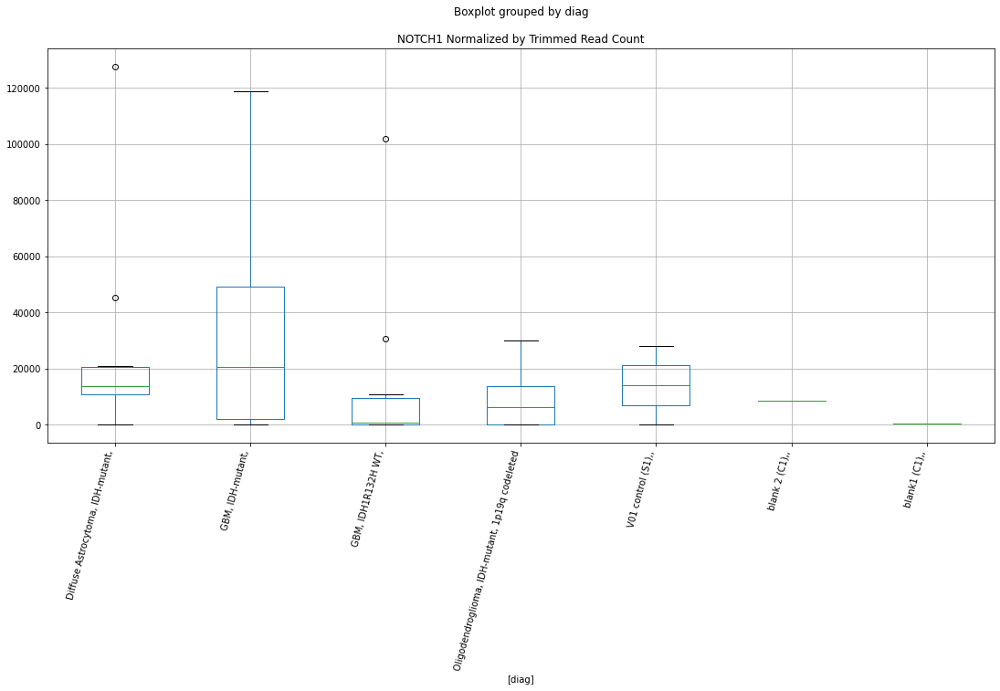

 p : 0.08716809345492967  ( t : 1.809105554324742 ) :  Lexogen  :  bbduk2  :  NOTCH1
Control and blanks
79         0.00
343    28450.12
Name: NOTCH1, dtype: float64
211    8745.8
Name: NOTCH1, dtype: float64
475    479.03
Name: NOTCH1, dtype: float64


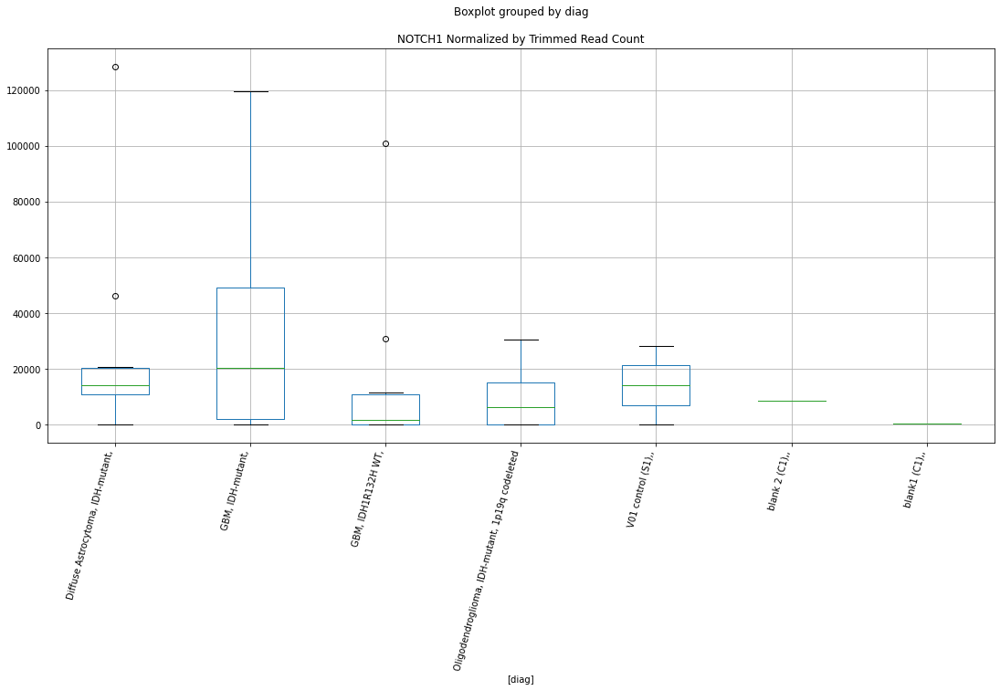

 p : 0.09008191140708462  ( t : 1.791259327015946 ) :  D-plex  :  bbduk2  :  NOTCH1
Control and blanks
73     12368.13
337    85455.10
Name: NOTCH1, dtype: float64
205    64651.83
Name: NOTCH1, dtype: float64
469    403421.63
Name: NOTCH1, dtype: float64


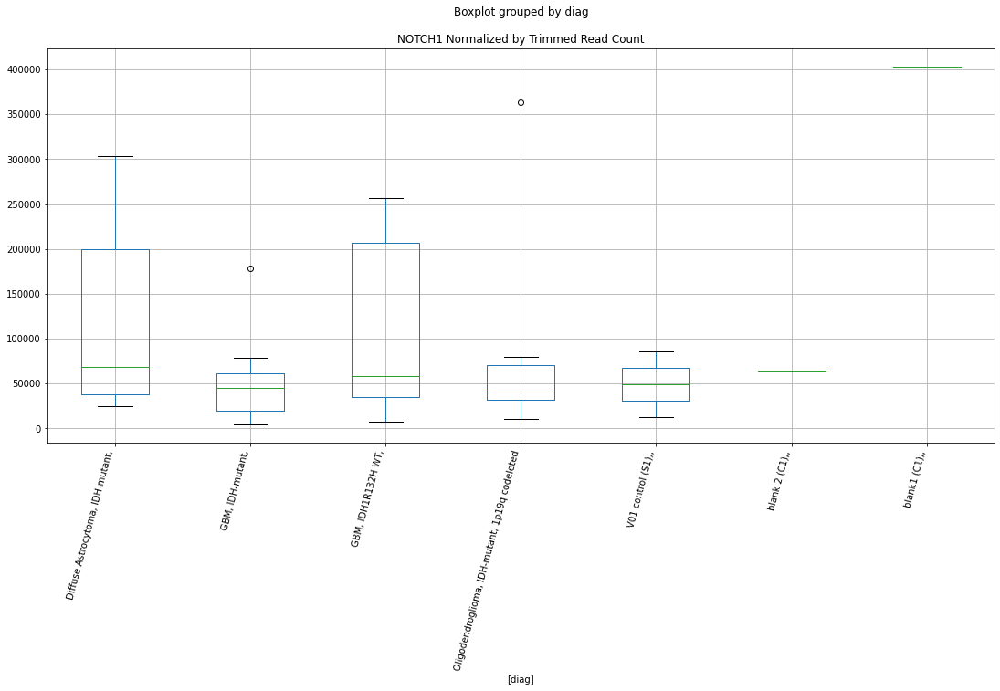

 p : 0.09338100118932555  ( t : 1.7716516052356617 ) :  D-plex  :  cutadapt2  :  NOTCH1
Control and blanks
76     12121.83
340    84550.28
Name: NOTCH1, dtype: float64
208    64371.48
Name: NOTCH1, dtype: float64
472    394165.88
Name: NOTCH1, dtype: float64


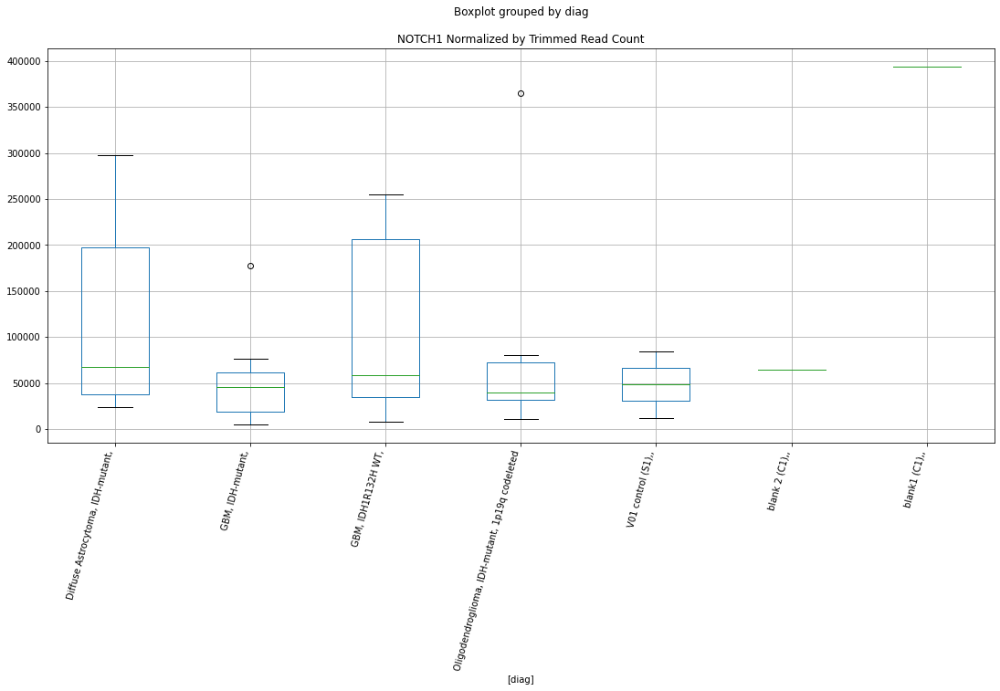

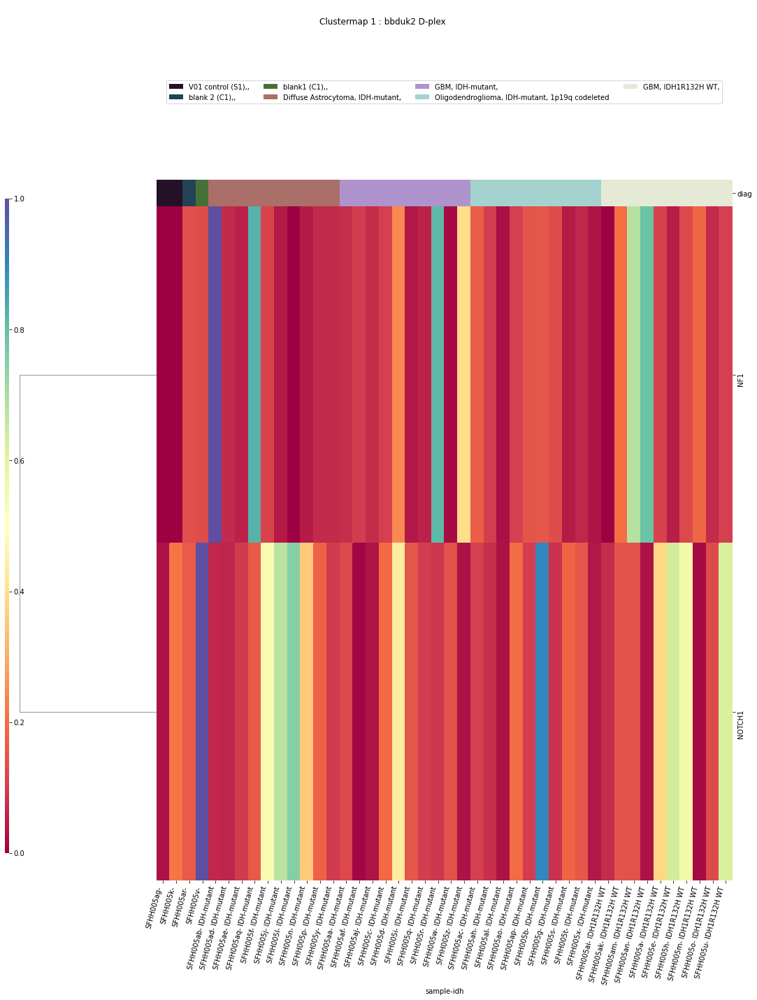

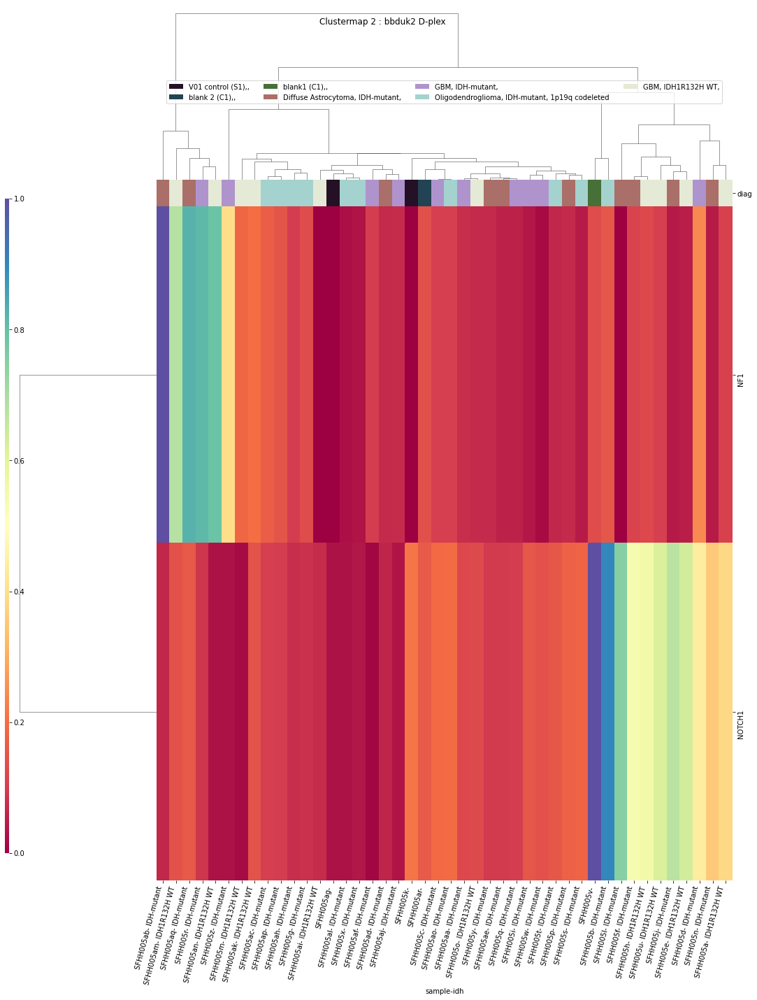

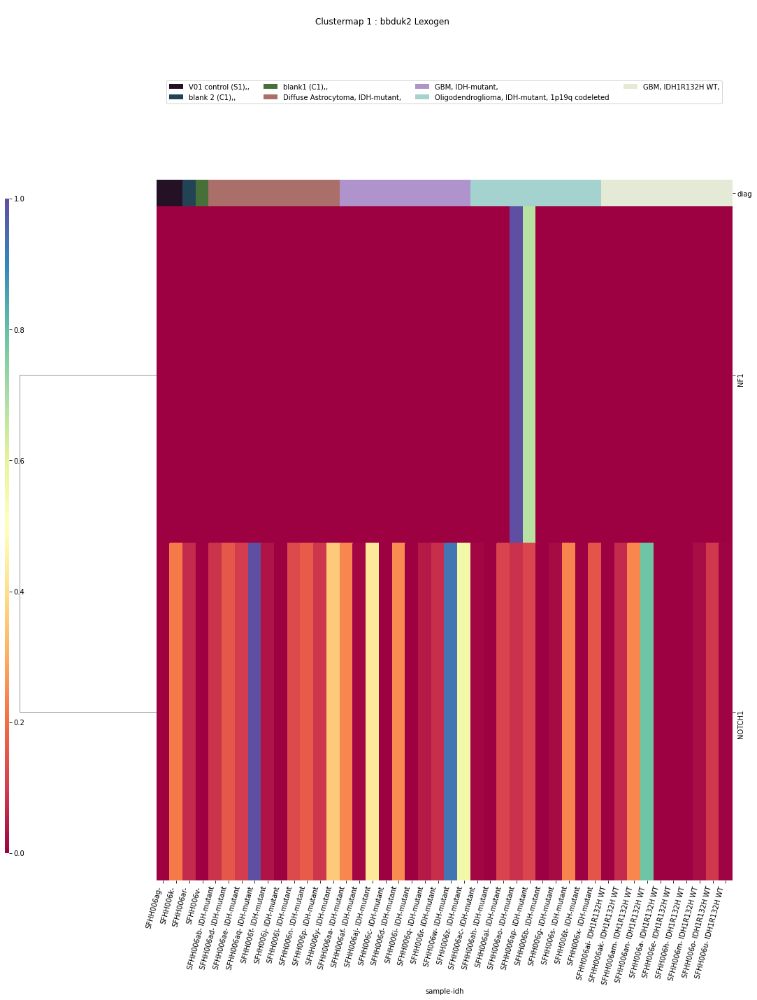

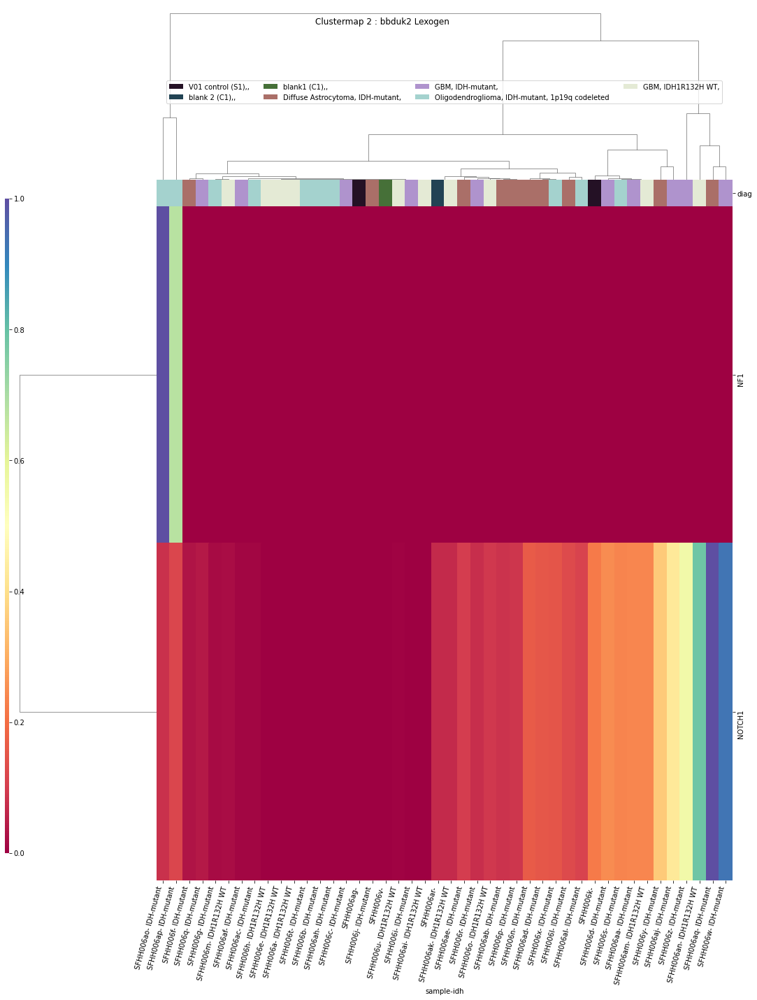

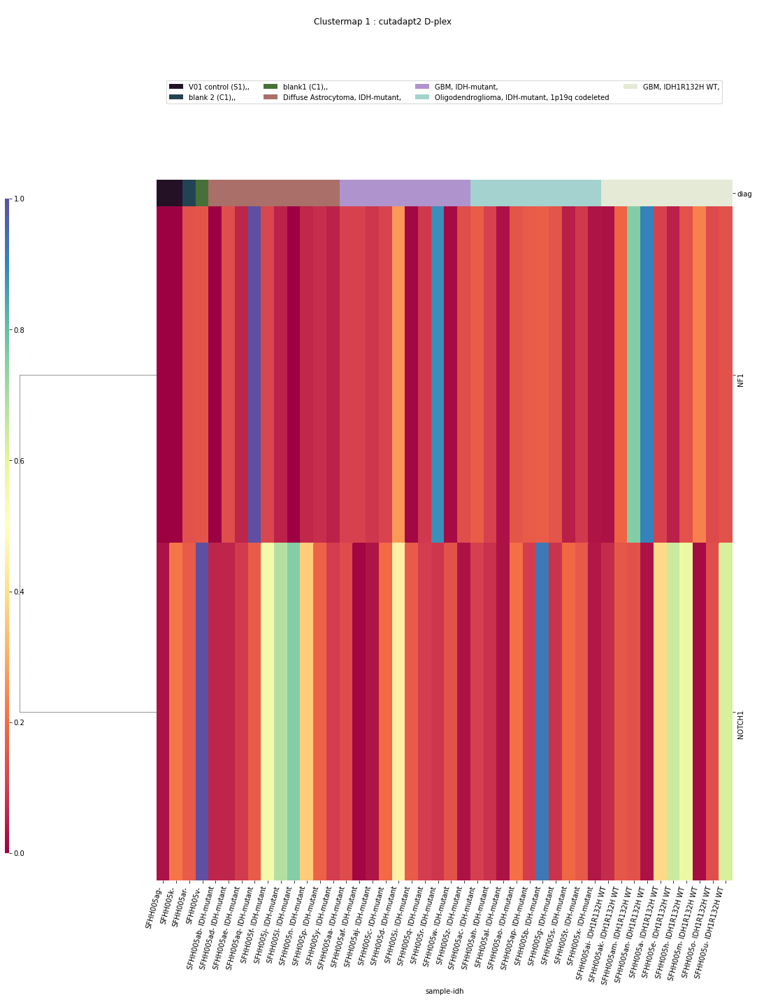

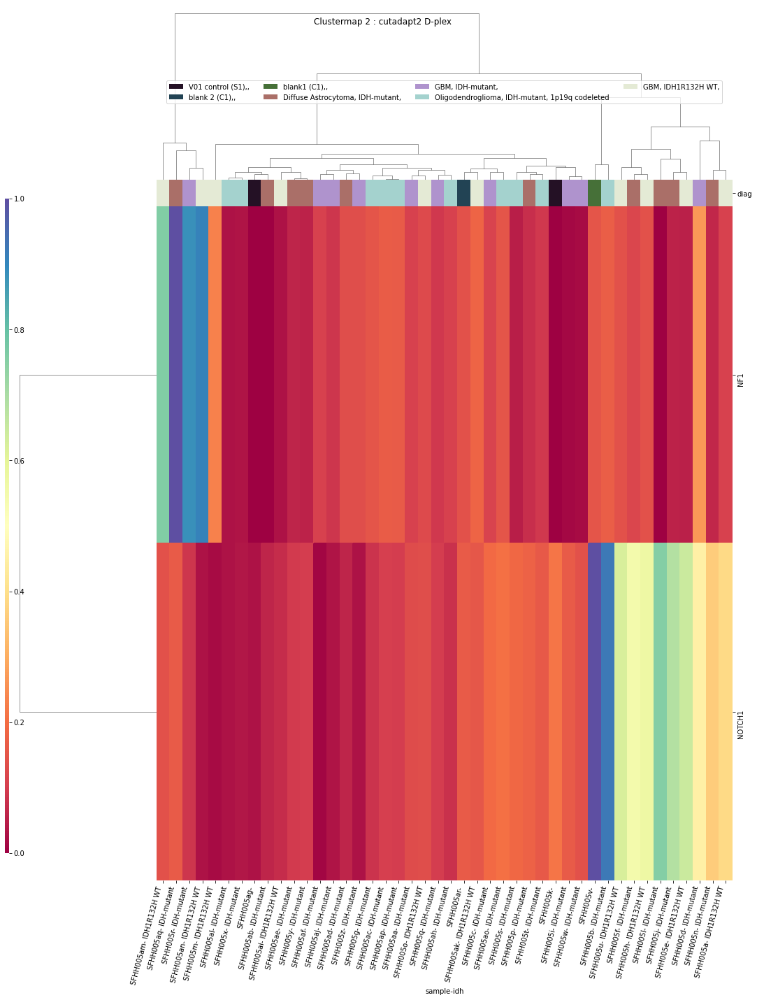

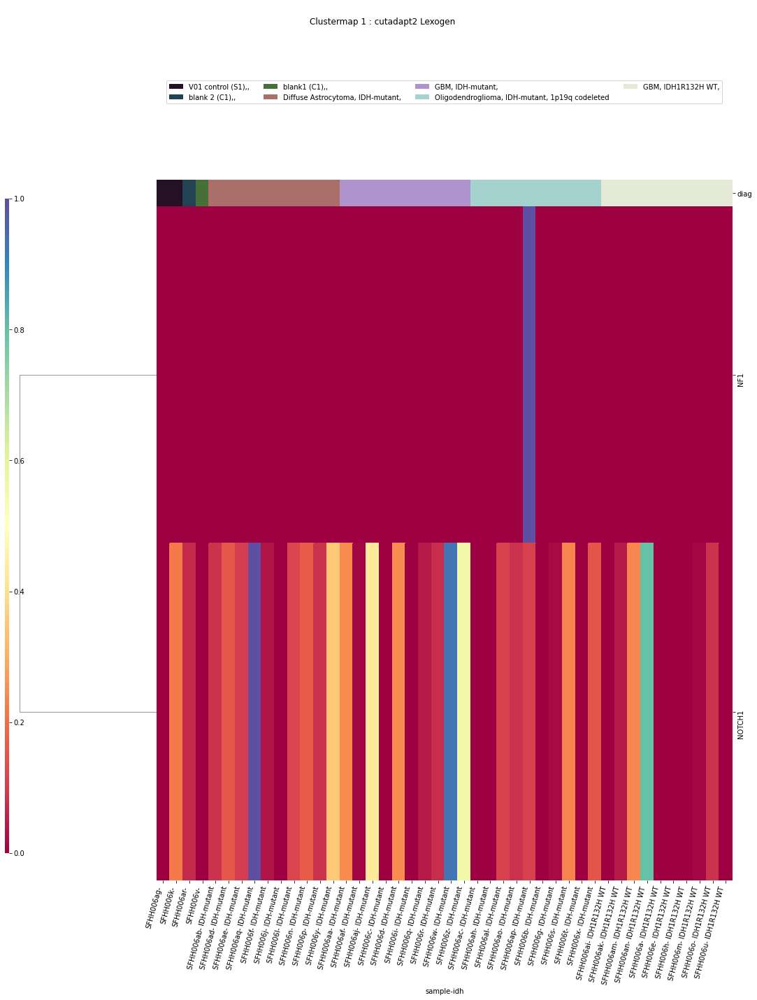

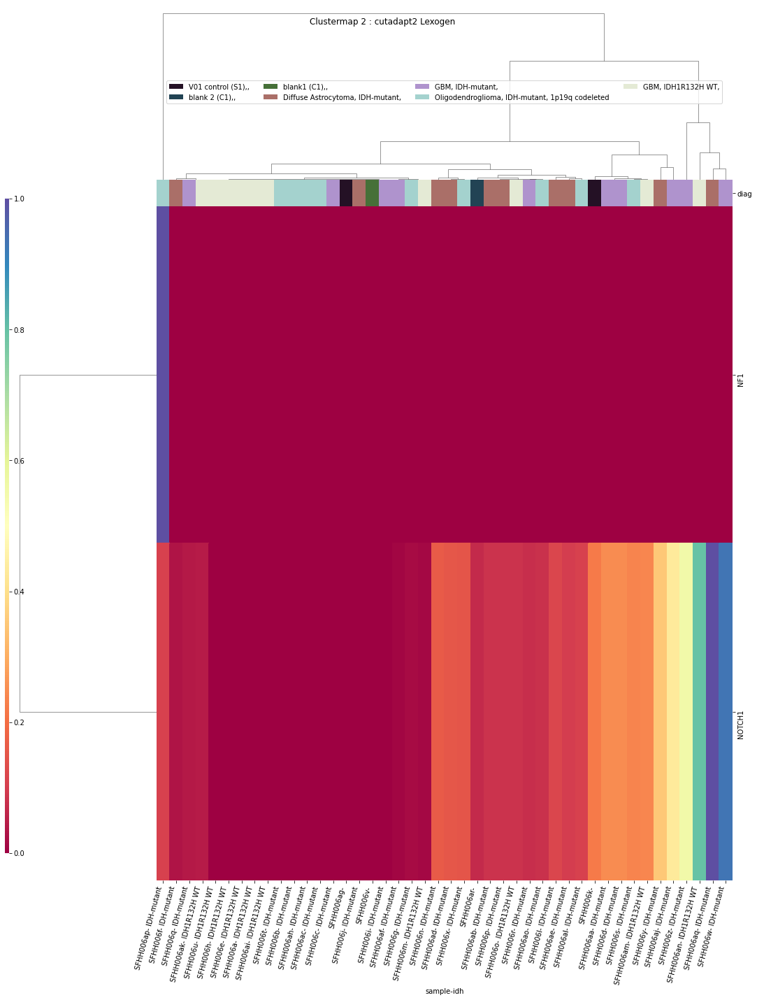

In [65]:
ttests_boxplots_and_heatmaps(dfn,['CDKN2A','CDKN2A-DT','CDKN2AIP','CDKN2AIPNL','CDKN2B','CDKN2B-AS1','EGFR',
                                  'EGFR-AS1','IDH1','IDH1-AS1','IDH2','IDH2-DT','NF1','NOTCH1','RB1','RB1CC1',
                                  'RB1-DT','TERT','TP53'],box_p=0.1,heat_p=0.2)

In [66]:
datetime.now().strftime("%H:%M:%S")

'10:49:39'

# Elements

 p : 0.0007165852070366561  ( t : 4.071279640053069 ) :  Lexogen  :  bbduk2  :  MAST1
Control and blanks
79     41487.36
343    15711.26
Name: MAST1, dtype: float64
211    20224.67
Name: MAST1, dtype: float64
475    45507.99
Name: MAST1, dtype: float64


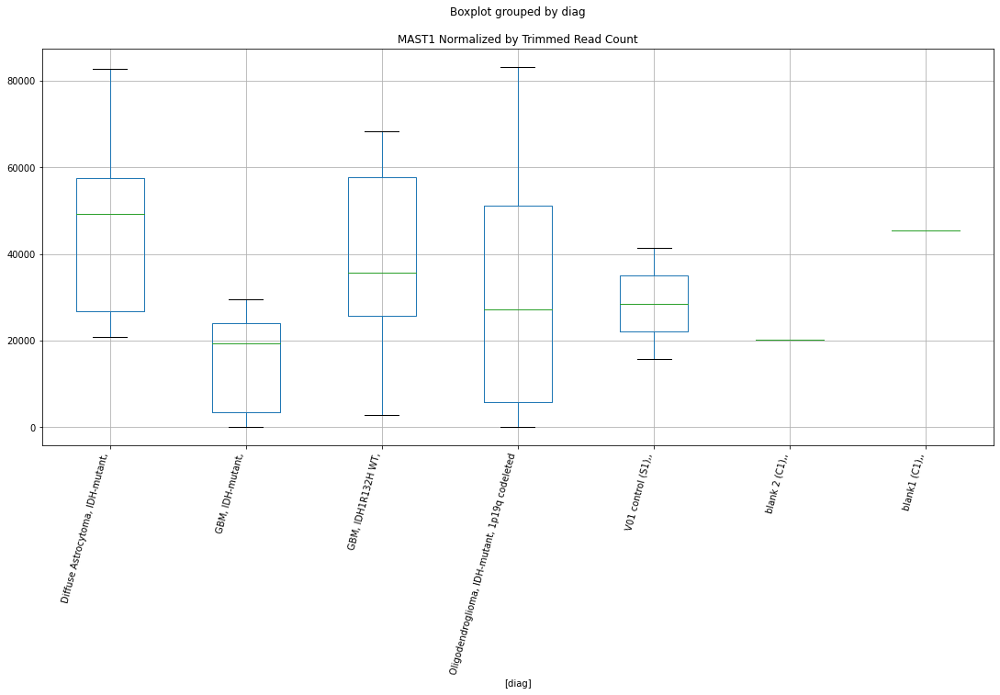

 p : 0.0007996878127283024  ( t : 4.021992549230216 ) :  Lexogen  :  cutadapt2  :  MAST1
Control and blanks
82     41181.48
346    15782.59
Name: MAST1, dtype: float64
214    20070.76
Name: MAST1, dtype: float64
478    45117.49
Name: MAST1, dtype: float64


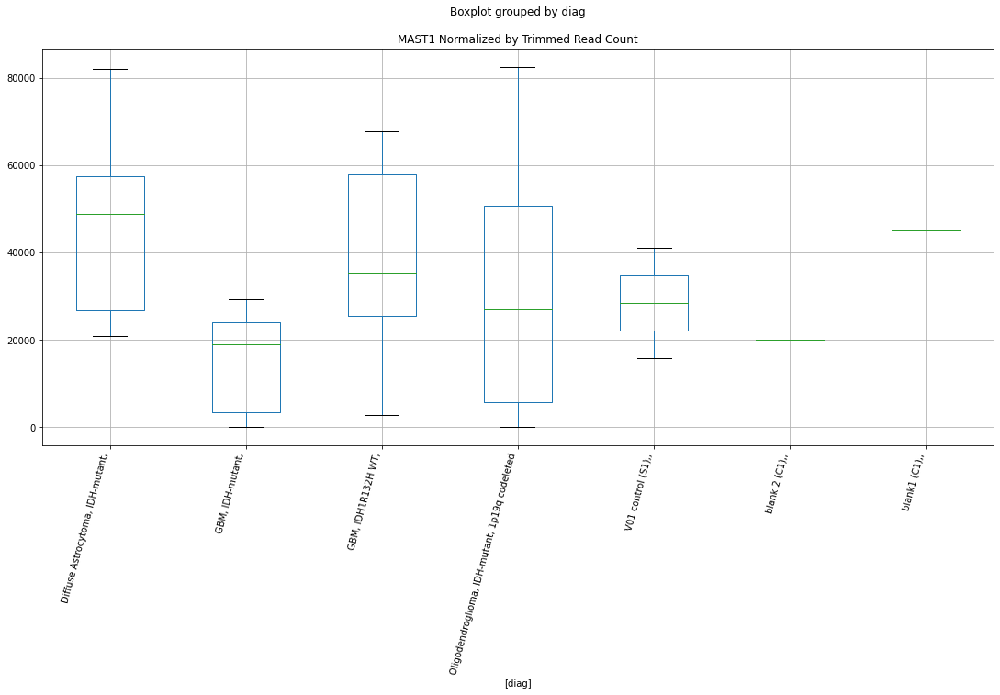

 p : 0.0017359321410301363  ( t : 3.6741045769108505 ) :  D-plex  :  bbduk2  :  MED12
Control and blanks
73     15460.17
337        0.00
Name: MED12, dtype: float64
205    895.45
Name: MED12, dtype: float64
469    1774.58
Name: MED12, dtype: float64


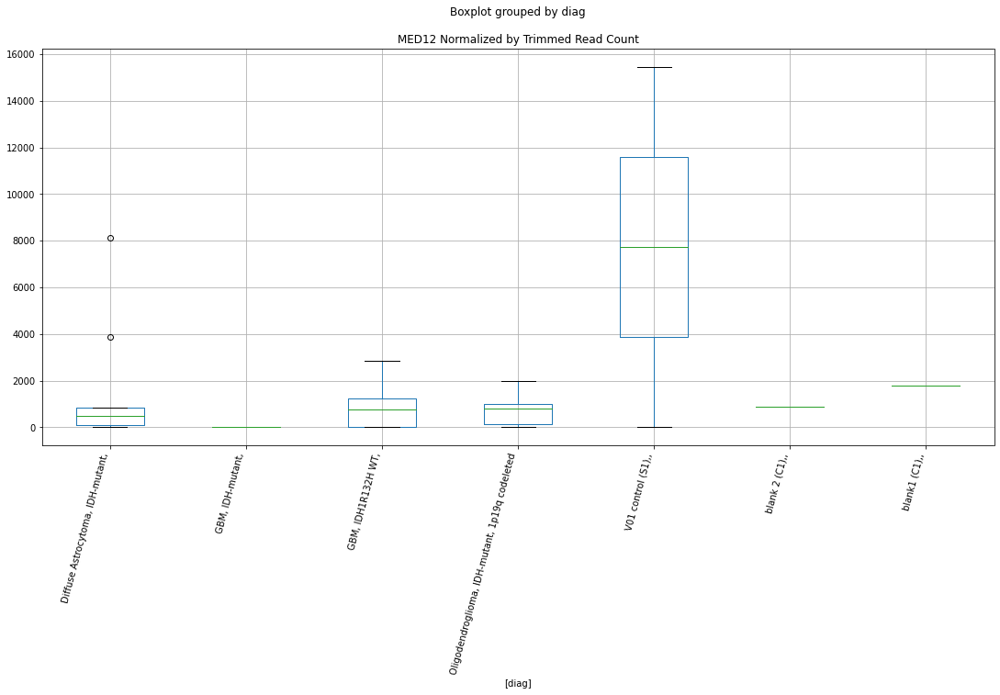

 p : 0.0027019887962629052  ( t : 3.4751051959793204 ) :  Lexogen  :  cutadapt2  :  MIR122
Control and blanks
82     0.0
346    0.0
Name: MIR122, dtype: float64
214    0.0
Name: MIR122, dtype: float64
478    0.0
Name: MIR122, dtype: float64


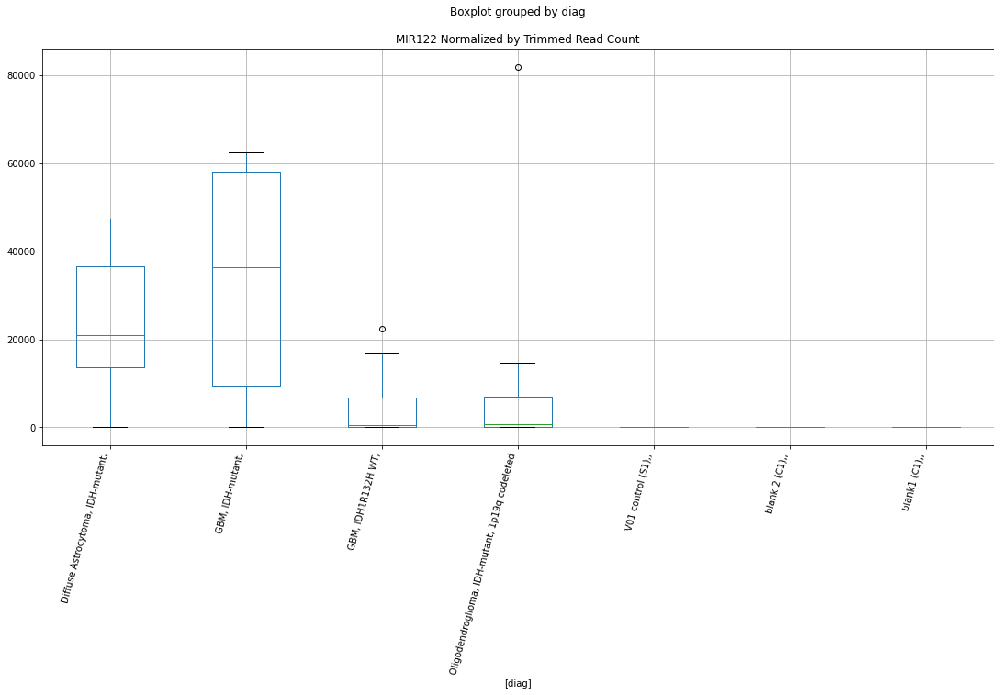

 p : 0.0027019887962629052  ( t : 3.4751051959793204 ) :  Lexogen  :  cutadapt2  :  MIR3591
Control and blanks
82     0.0
346    0.0
Name: MIR3591, dtype: float64
214    0.0
Name: MIR3591, dtype: float64
478    0.0
Name: MIR3591, dtype: float64


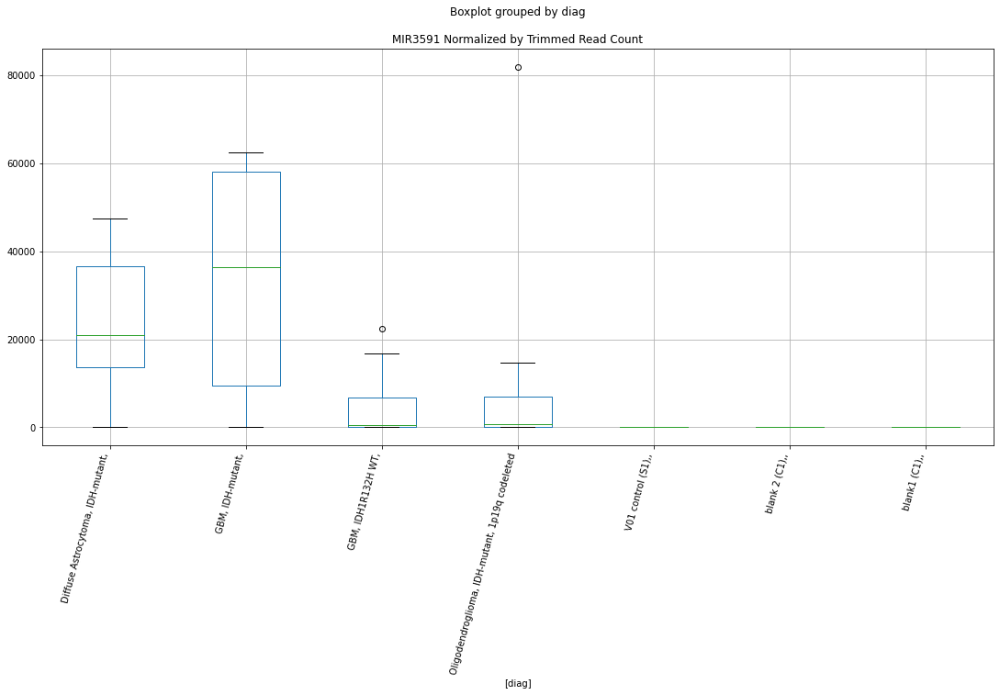

 p : 0.0028020332641484273  ( t : 3.4587181821440245 ) :  Lexogen  :  bbduk2  :  MIR3591
Control and blanks
79     0.0
343    0.0
Name: MIR3591, dtype: float64
211    0.0
Name: MIR3591, dtype: float64
475    0.0
Name: MIR3591, dtype: float64


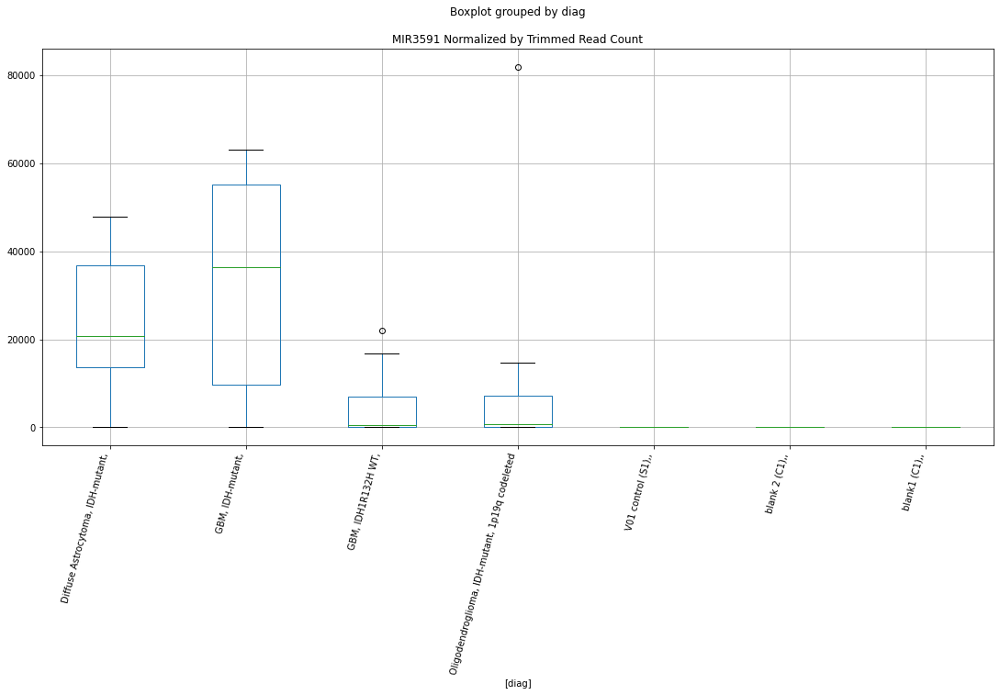

 p : 0.0028020332641484273  ( t : 3.4587181821440245 ) :  Lexogen  :  bbduk2  :  MIR122
Control and blanks
79     0.0
343    0.0
Name: MIR122, dtype: float64
211    0.0
Name: MIR122, dtype: float64
475    0.0
Name: MIR122, dtype: float64


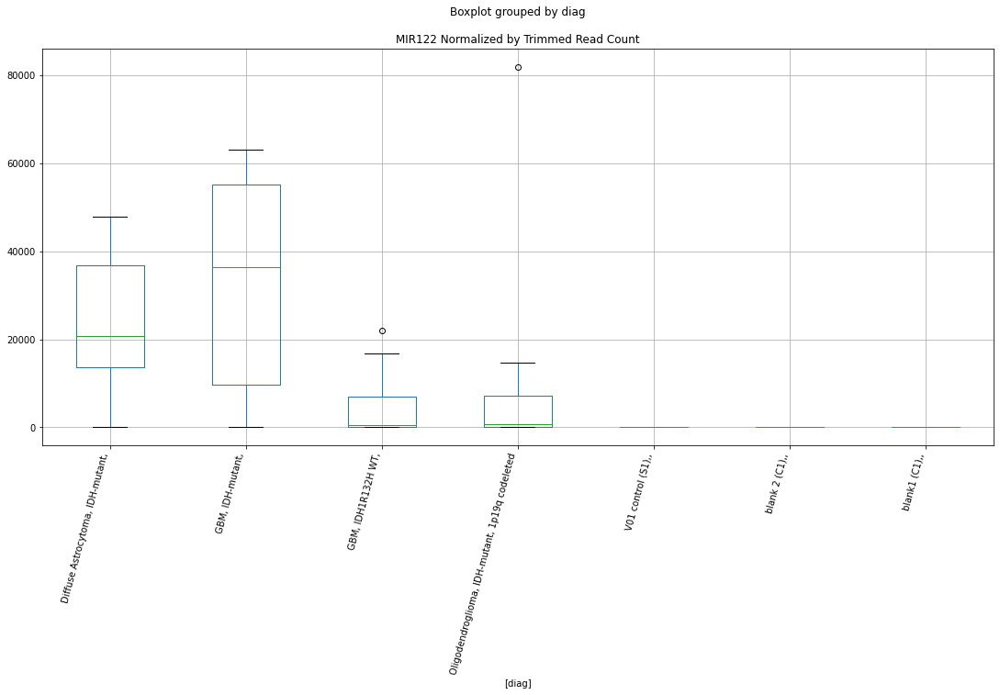

 p : 0.003806603085622255  ( t : 3.320321258304656 ) :  D-plex  :  bbduk2  :  MUC16
Control and blanks
73      10049.11
337    196724.76
Name: MUC16, dtype: float64
205    73248.2
Name: MUC16, dtype: float64
469    1.91e+06
Name: MUC16, dtype: float64


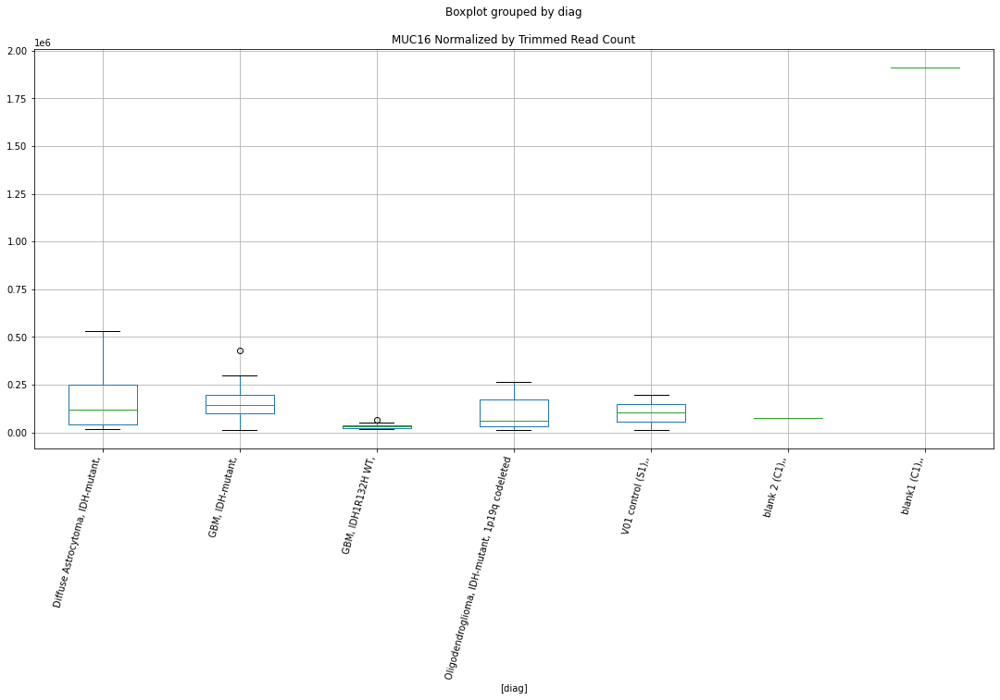

 p : 0.0042447211081530056  ( t : 3.2709602295544884 ) :  Lexogen  :  bbduk2  :  MIR3591
Control and blanks
79     0.0
343    0.0
Name: MIR3591, dtype: float64
211    0.0
Name: MIR3591, dtype: float64
475    0.0
Name: MIR3591, dtype: float64


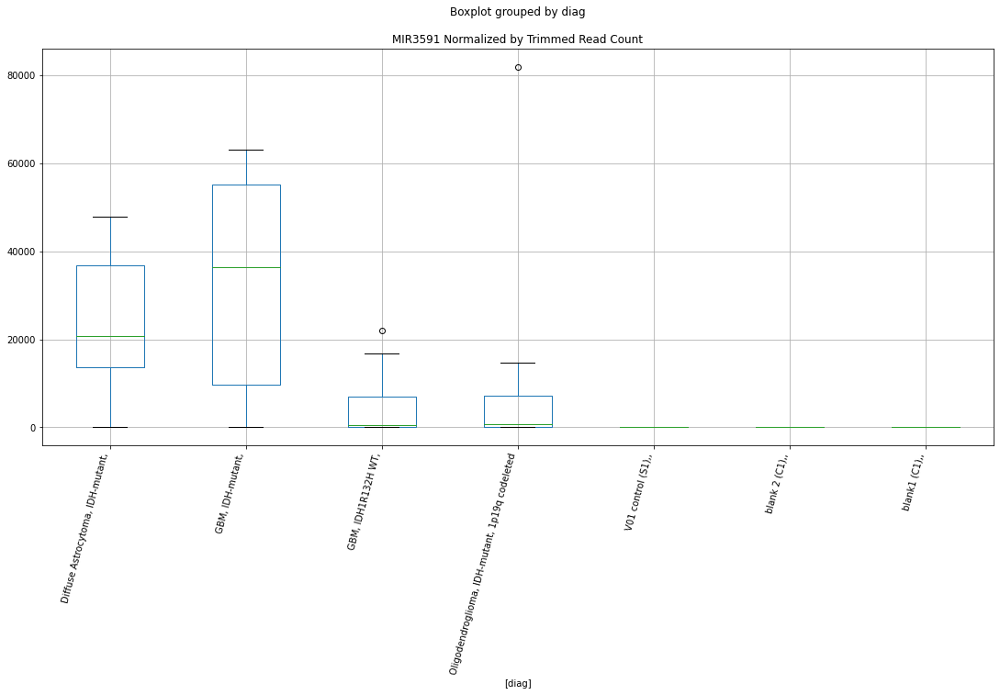

 p : 0.0042447211081530056  ( t : 3.2709602295544884 ) :  Lexogen  :  bbduk2  :  MIR122
Control and blanks
79     0.0
343    0.0
Name: MIR122, dtype: float64
211    0.0
Name: MIR122, dtype: float64
475    0.0
Name: MIR122, dtype: float64


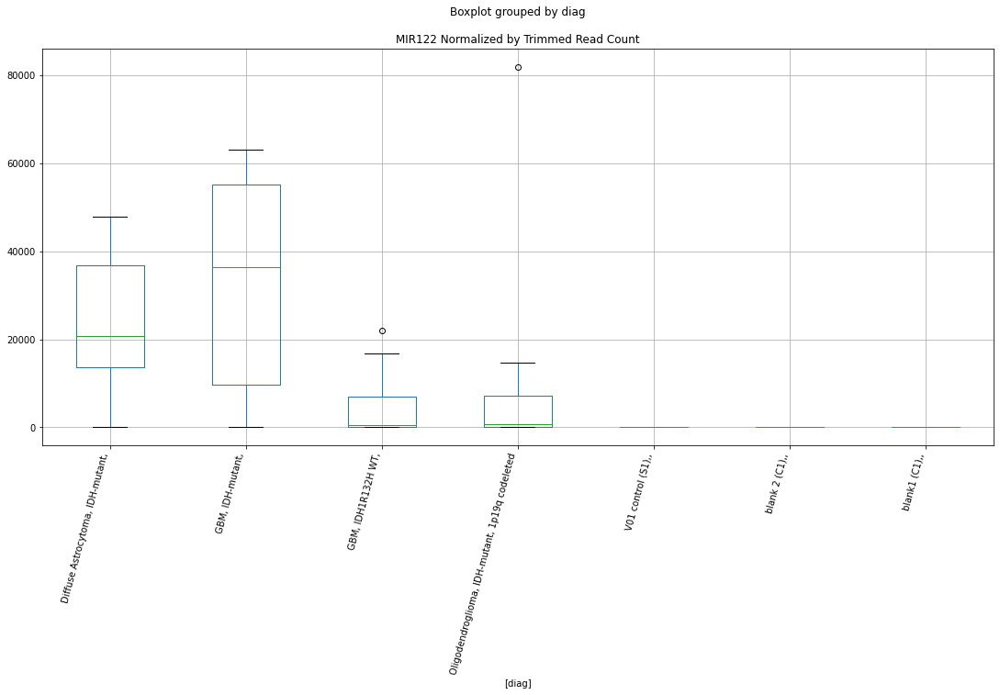

 p : 0.0043499962131949  ( t : 3.259846727025504 ) :  Lexogen  :  cutadapt2  :  MIR122
Control and blanks
82     0.0
346    0.0
Name: MIR122, dtype: float64
214    0.0
Name: MIR122, dtype: float64
478    0.0
Name: MIR122, dtype: float64


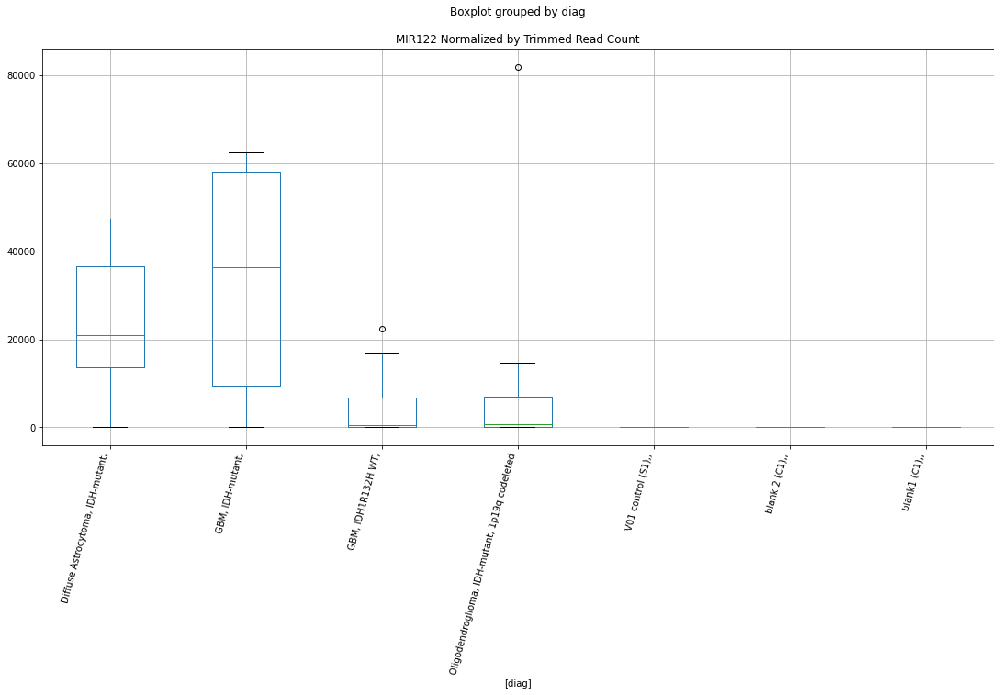

 p : 0.0043499962131949  ( t : 3.259846727025504 ) :  Lexogen  :  cutadapt2  :  MIR3591
Control and blanks
82     0.0
346    0.0
Name: MIR3591, dtype: float64
214    0.0
Name: MIR3591, dtype: float64
478    0.0
Name: MIR3591, dtype: float64


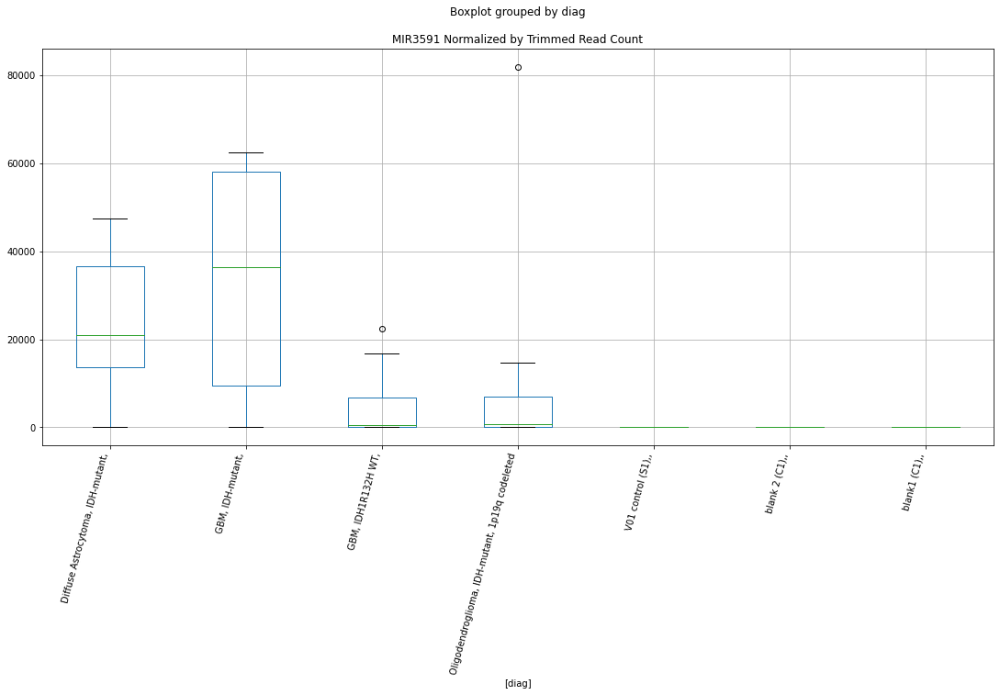

 p : 0.0047145277113498545  ( t : 3.2233054382017934 ) :  D-plex  :  bbduk2  :  NUPR1
Control and blanks
73     1546.02
337    7121.26
Name: NUPR1, dtype: float64
205    1790.91
Name: NUPR1, dtype: float64
469    2366.11
Name: NUPR1, dtype: float64


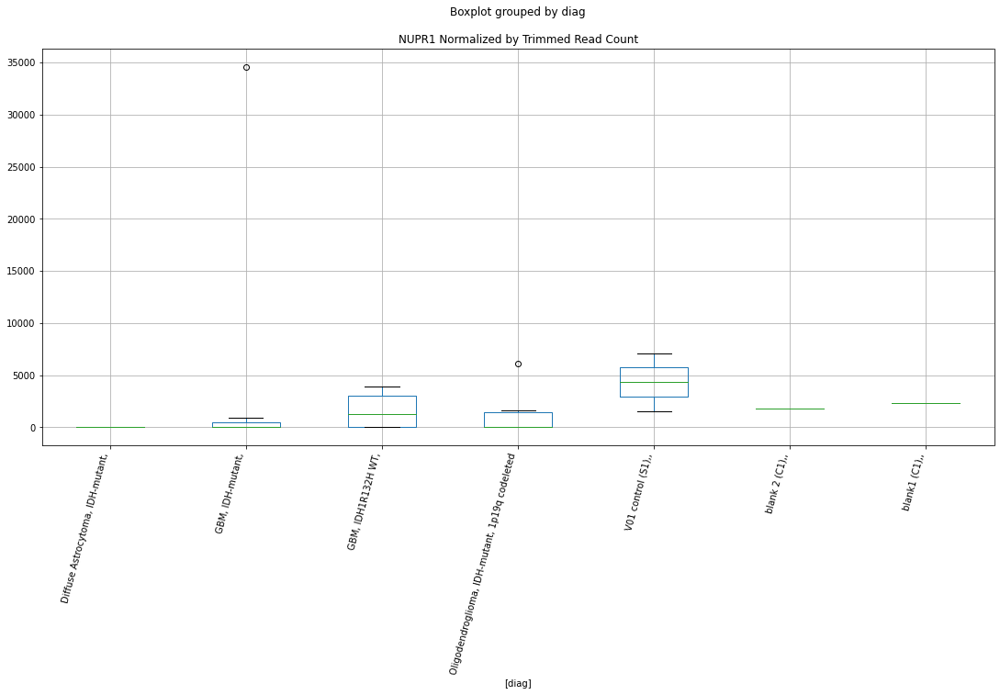

 p : 0.00520022113917785  ( t : 3.178703303581385 ) :  D-plex  :  cutadapt2  :  LOC112268020
Control and blanks
76         0.00
340    17614.64
Name: LOC112268020, dtype: float64
208    352.72
Name: LOC112268020, dtype: float64
472    1733.87
Name: LOC112268020, dtype: float64


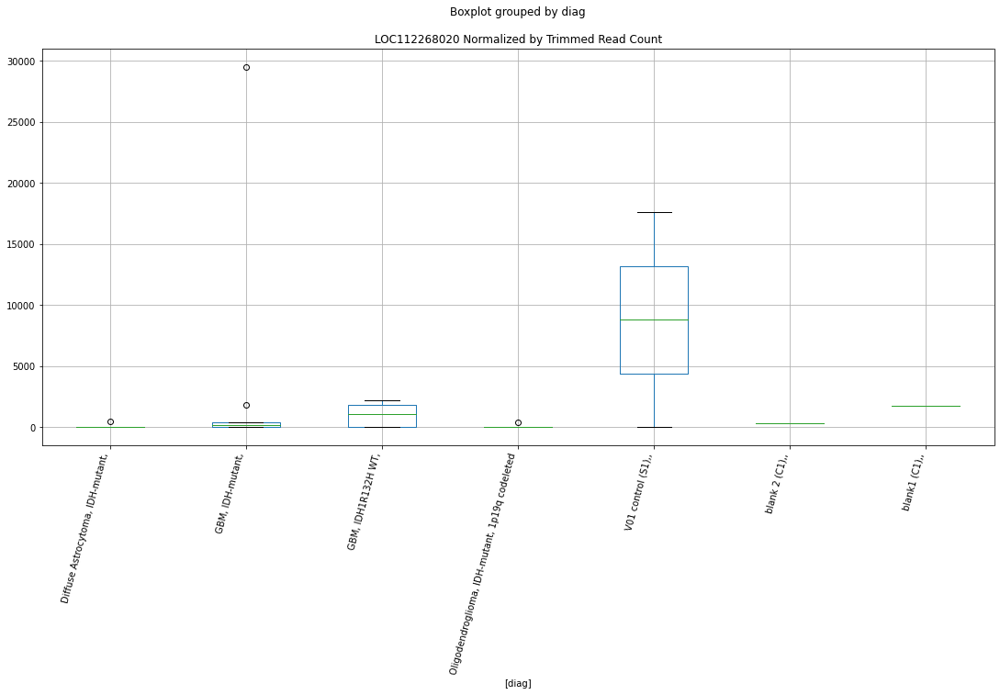

 p : 0.005355528850120216  ( t : 3.1652989662243627 ) :  D-plex  :  bbduk2  :  LOC112268020
Control and blanks
73         0.00
337    17803.15
Name: LOC112268020, dtype: float64
205    358.18
Name: LOC112268020, dtype: float64
469    1774.58
Name: LOC112268020, dtype: float64


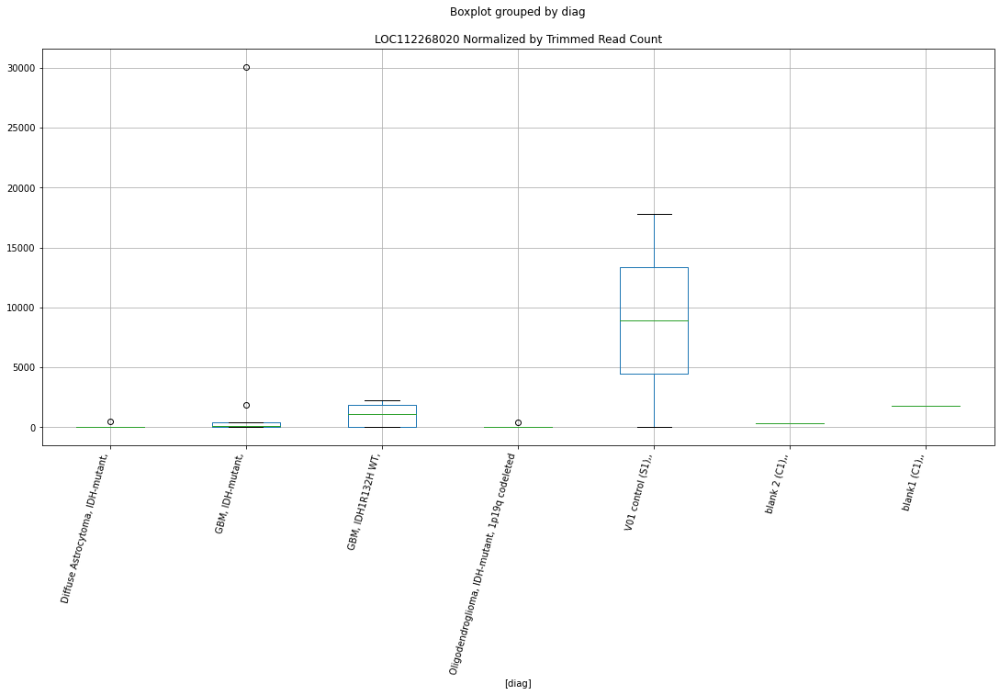

 p : 0.005720385482627487  ( t : 3.135247176447247 ) :  D-plex  :  cutadapt2  :  LOC112268020
Control and blanks
76         0.00
340    17614.64
Name: LOC112268020, dtype: float64
208    352.72
Name: LOC112268020, dtype: float64
472    1733.87
Name: LOC112268020, dtype: float64


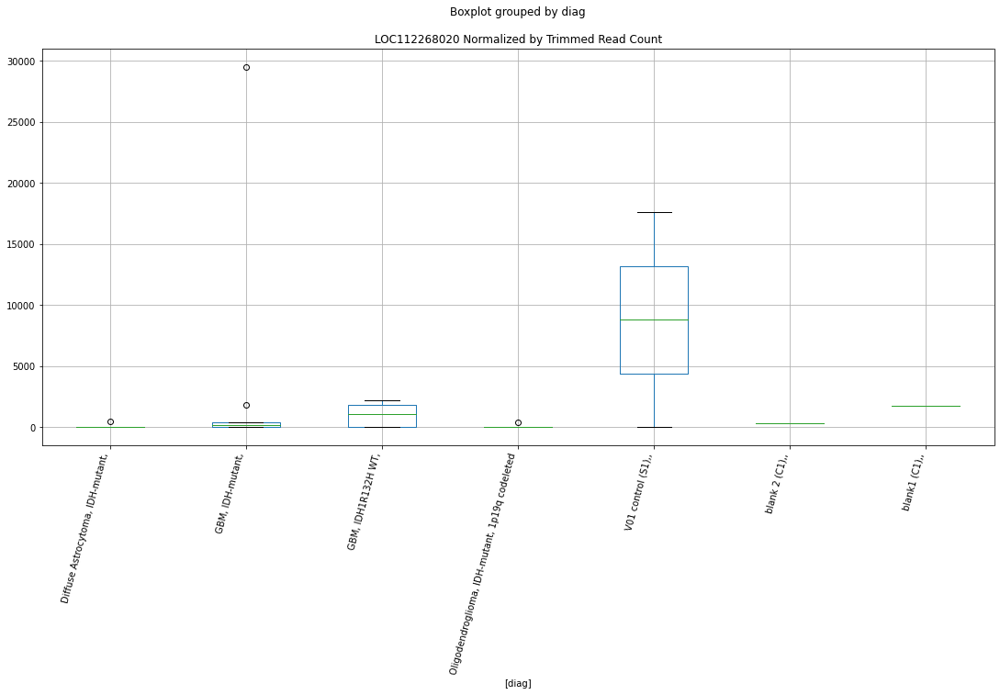

 p : 0.0059018852797736955  ( t : 3.120988578724177 ) :  D-plex  :  bbduk2  :  LOC112268020
Control and blanks
73         0.00
337    17803.15
Name: LOC112268020, dtype: float64
205    358.18
Name: LOC112268020, dtype: float64
469    1774.58
Name: LOC112268020, dtype: float64


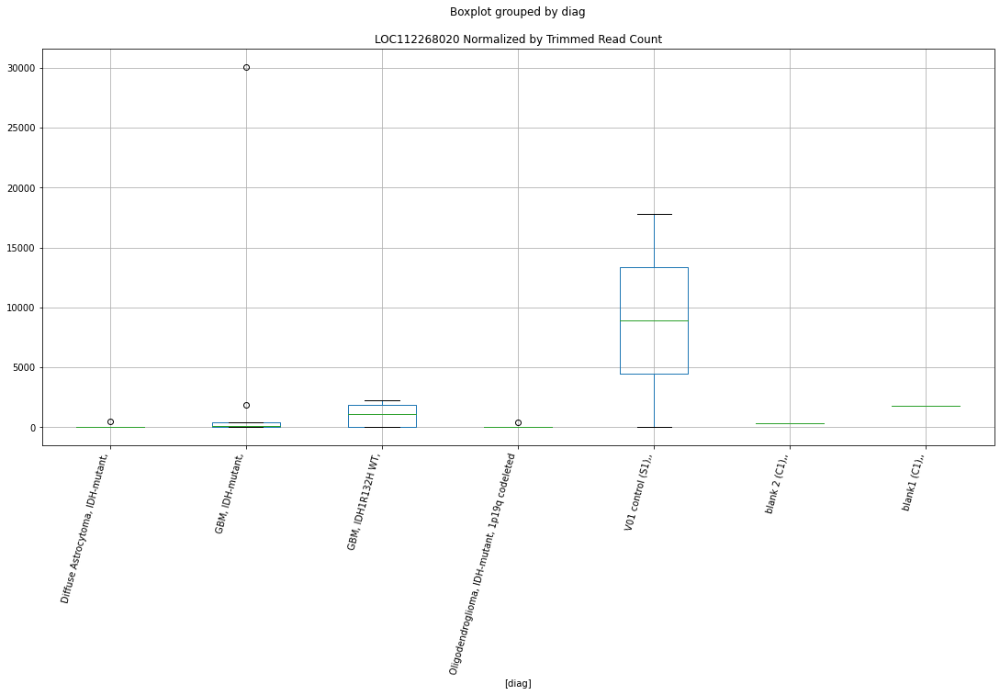

 p : 0.006560857278644601  ( t : 3.072589248015574 ) :  D-plex  :  cutadapt2  :  MUC16
Control and blanks
76       9848.98
340    160293.25
Name: MUC16, dtype: float64
208    61020.64
Name: MUC16, dtype: float64
472    1.86e+06
Name: MUC16, dtype: float64


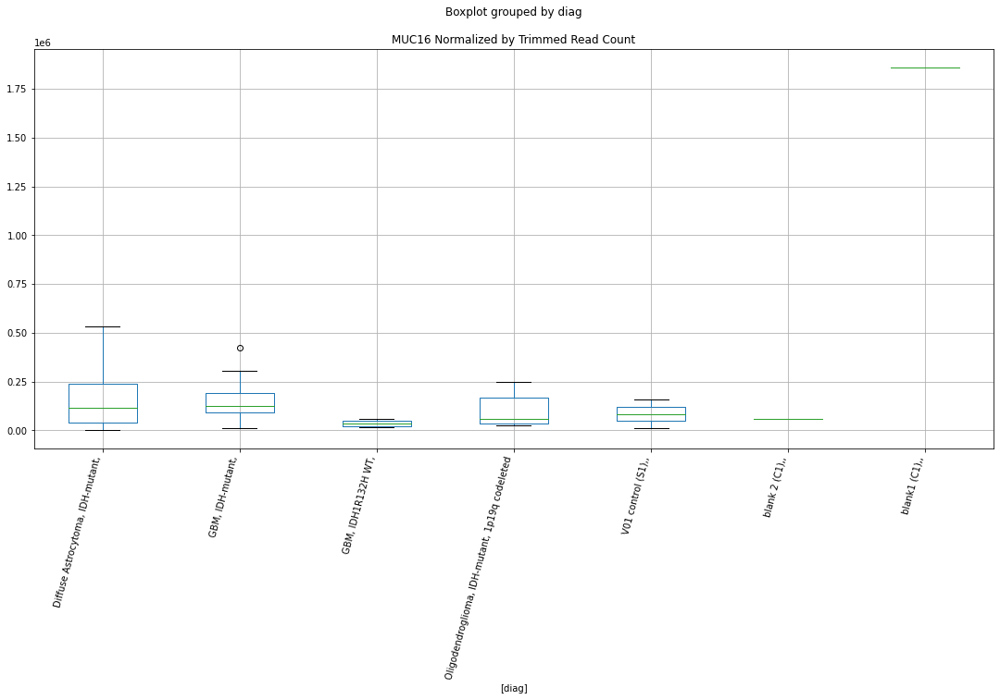

 p : 0.007140322904466106  ( t : 3.0337941904914487 ) :  D-plex  :  bbduk2  :  NCKAP1L
Control and blanks
73     1546.02
337       0.00
Name: NCKAP1L, dtype: float64
205    1432.73
Name: NCKAP1L, dtype: float64
469    2366.11
Name: NCKAP1L, dtype: float64


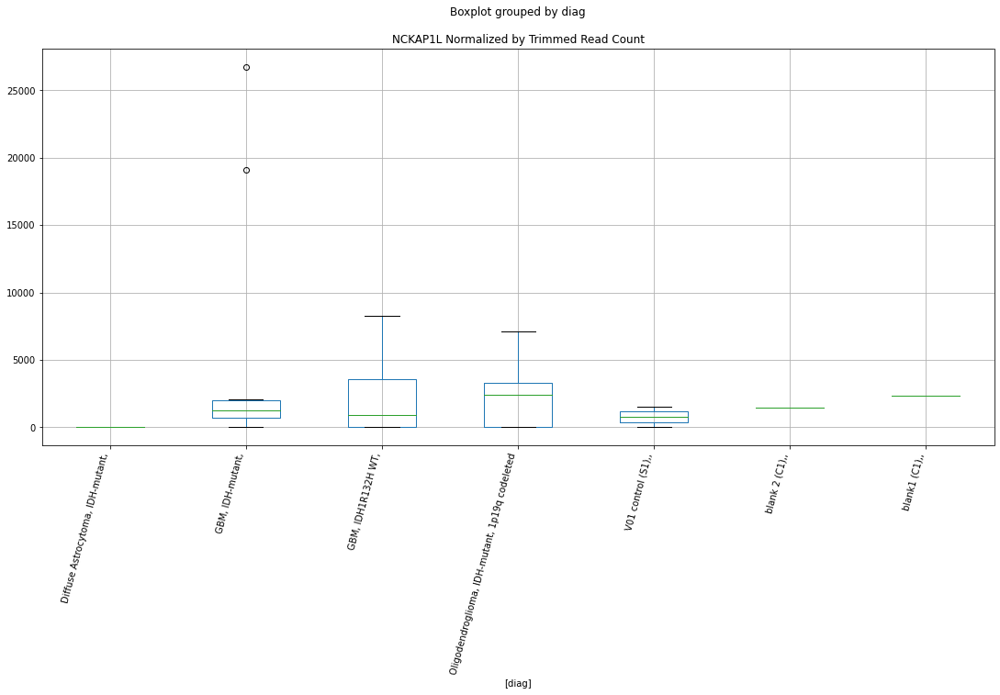

 p : 0.007406196635974806  ( t : 3.0170088100748433 ) :  Lexogen  :  bbduk2  :  MYO3A
Control and blanks
79     0.0
343    0.0
Name: MYO3A, dtype: float64
211    0.0
Name: MYO3A, dtype: float64
475    0.0
Name: MYO3A, dtype: float64


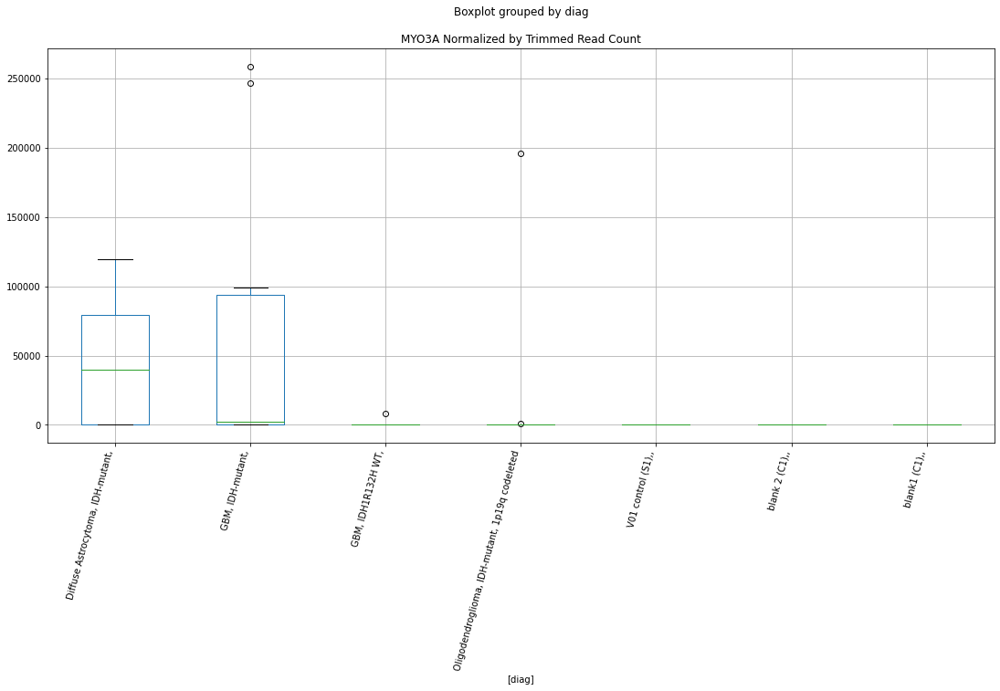

 p : 0.007440065199270884  ( t : 3.0149127748956044 ) :  D-plex  :  cutadapt2  :  MAFIP
Control and blanks
76     757.61
340      0.00
Name: MAFIP, dtype: float64
208    4585.37
Name: MAFIP, dtype: float64
472    4045.69
Name: MAFIP, dtype: float64


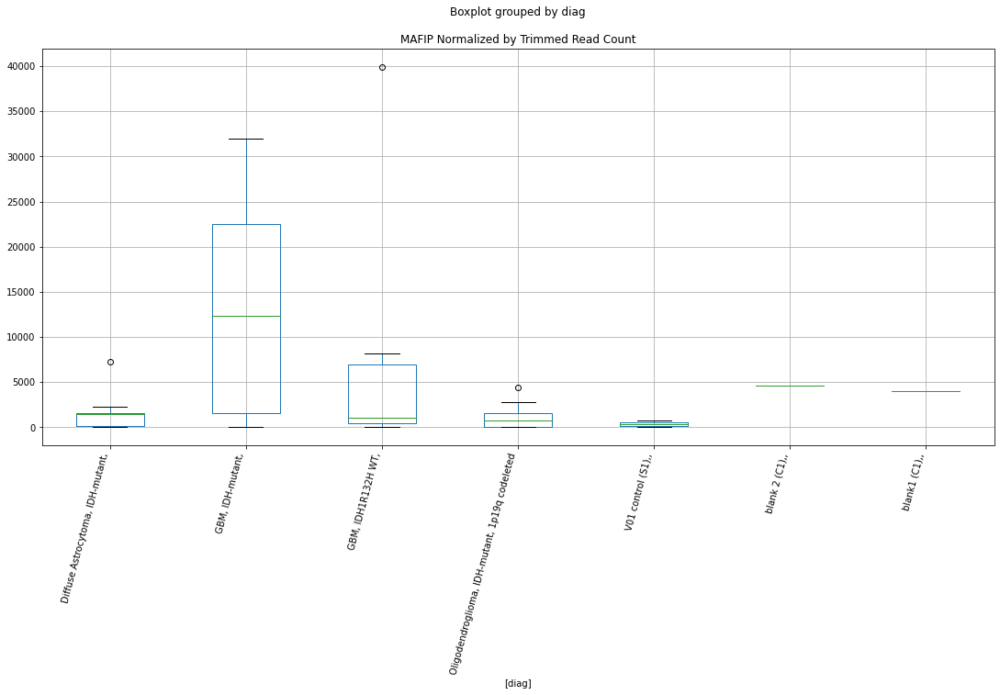

 p : 0.0075273588981610105  ( t : 3.0095528397882805 ) :  Lexogen  :  cutadapt2  :  MYO3A
Control and blanks
82     0.0
346    0.0
Name: MYO3A, dtype: float64
214    0.0
Name: MYO3A, dtype: float64
478    0.0
Name: MYO3A, dtype: float64


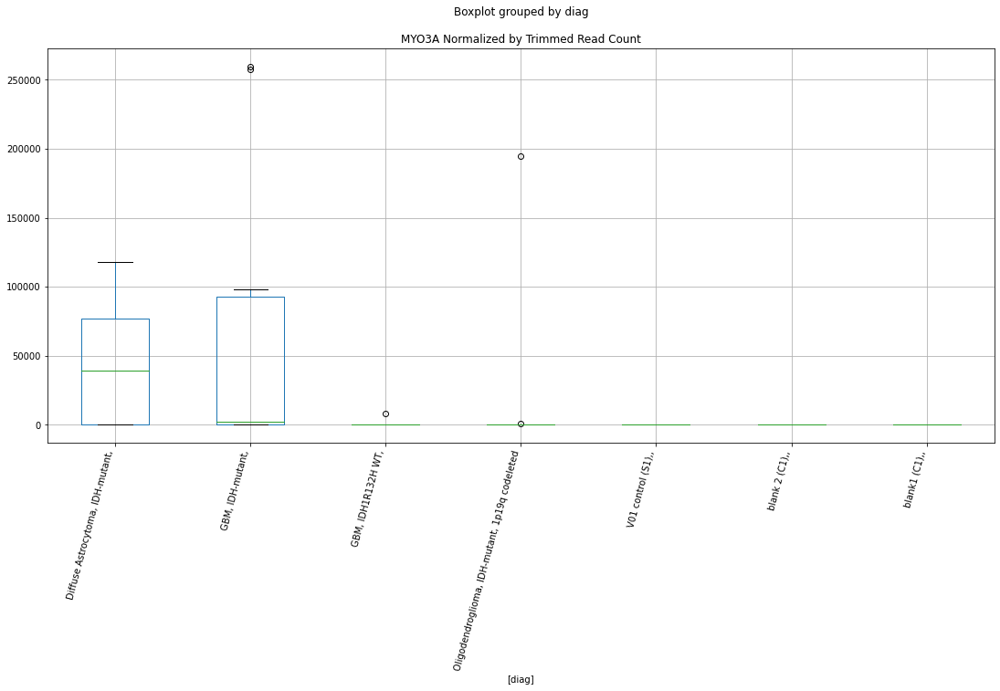

 p : 0.008290669422217536  ( t : 2.9651004348787233 ) :  Lexogen  :  bbduk2  :  LOC107986211
Control and blanks
79         0.00
343    38428.89
Name: LOC107986211, dtype: float64
211    12298.79
Name: LOC107986211, dtype: float64
475    239.52
Name: LOC107986211, dtype: float64


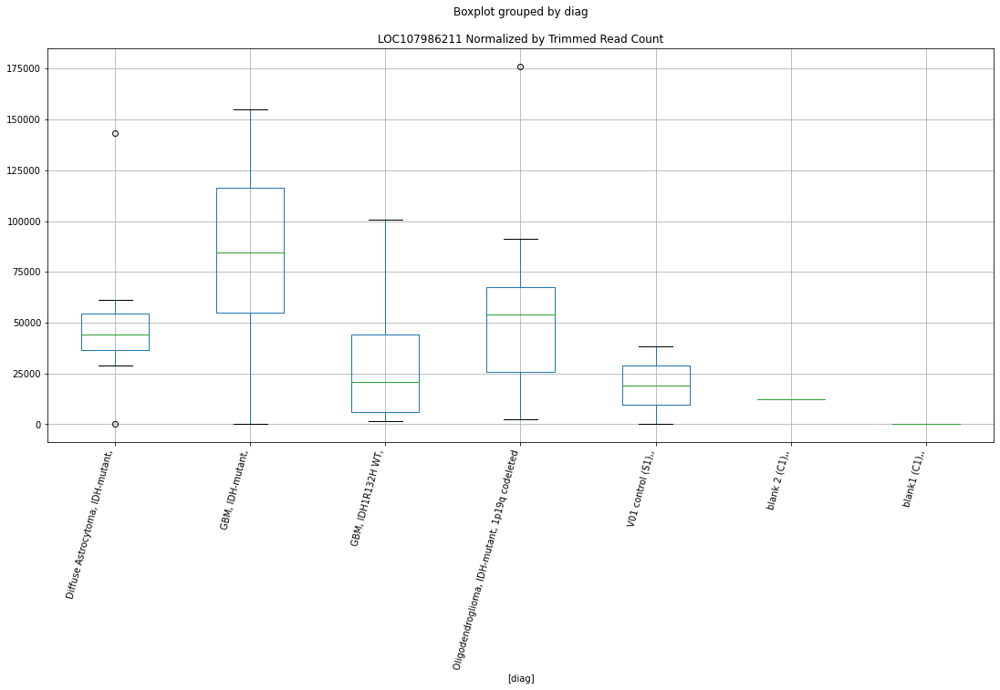

 p : 0.00852099075167219  ( t : 2.9524654122774168 ) :  Lexogen  :  cutadapt2  :  LOC107986211
Control and blanks
82         0.00
346    38088.65
Name: LOC107986211, dtype: float64
214    12205.19
Name: LOC107986211, dtype: float64
478    237.46
Name: LOC107986211, dtype: float64


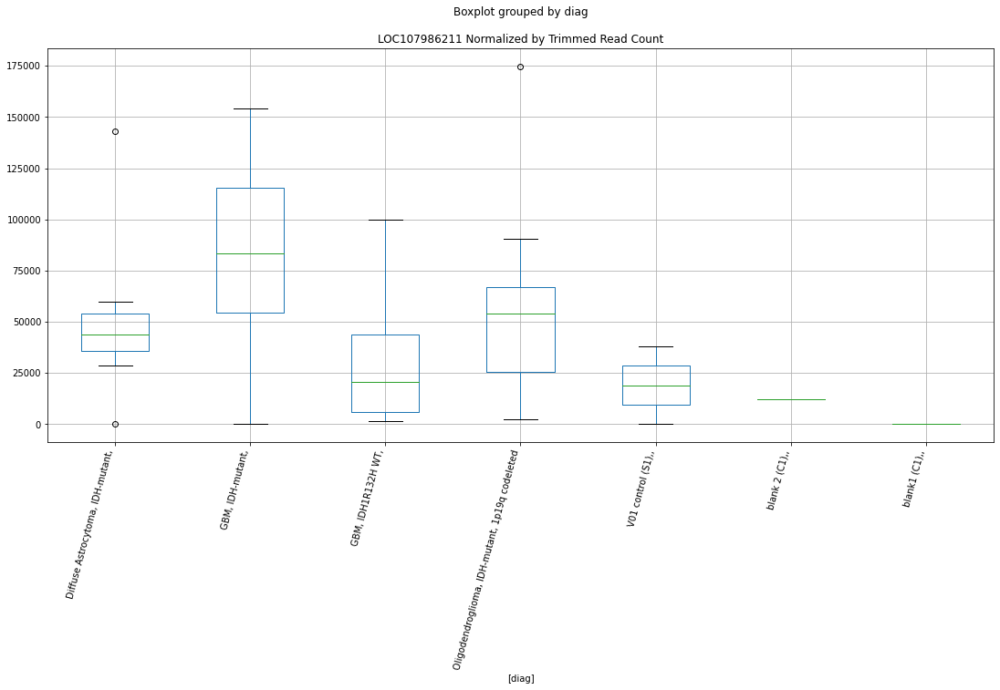

 p : 0.00859741634766151  ( t : 2.9483458550851385 ) :  Lexogen  :  cutadapt2  :  NRXN1
Control and blanks
82       0.00
346    841.74
Name: NRXN1, dtype: float64
214    0.0
Name: NRXN1, dtype: float64
478    0.0
Name: NRXN1, dtype: float64


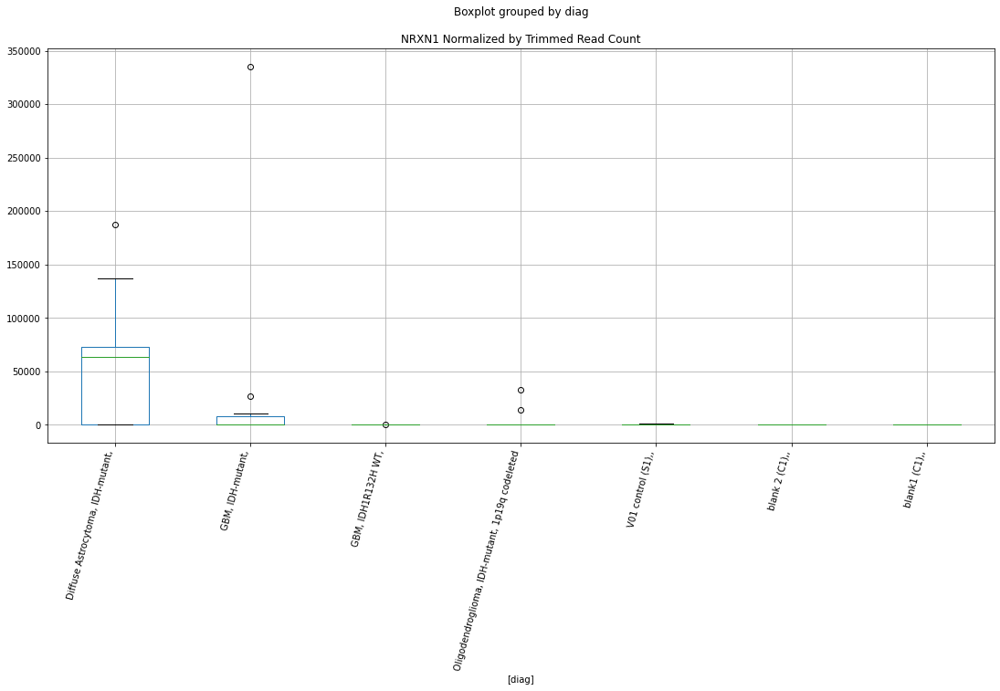

 p : 0.00887316846702945  ( t : 2.933771166089372 ) :  D-plex  :  cutadapt2  :  LRRC37A8P
Control and blanks
76     0.0
340    0.0
Name: LRRC37A8P, dtype: float64
208    705.44
Name: LRRC37A8P, dtype: float64
472    0.0
Name: LRRC37A8P, dtype: float64


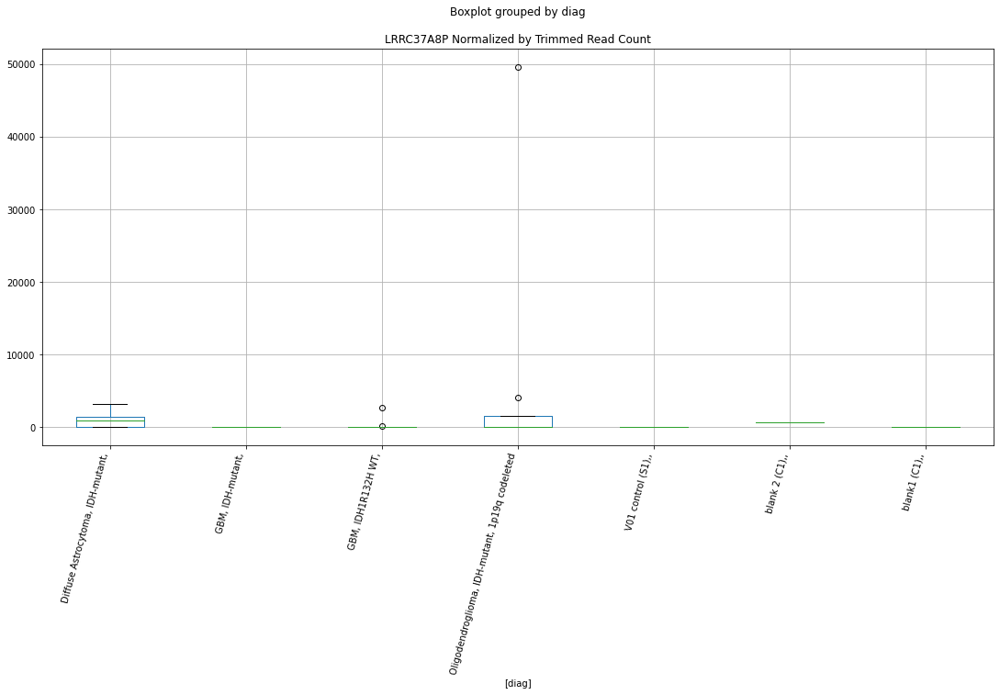

 p : 0.009018367913037652  ( t : 2.92627199791322 ) :  D-plex  :  bbduk2  :  LRRC37A8P
Control and blanks
73     0.0
337    0.0
Name: LRRC37A8P, dtype: float64
205    716.36
Name: LRRC37A8P, dtype: float64
469    0.0
Name: LRRC37A8P, dtype: float64


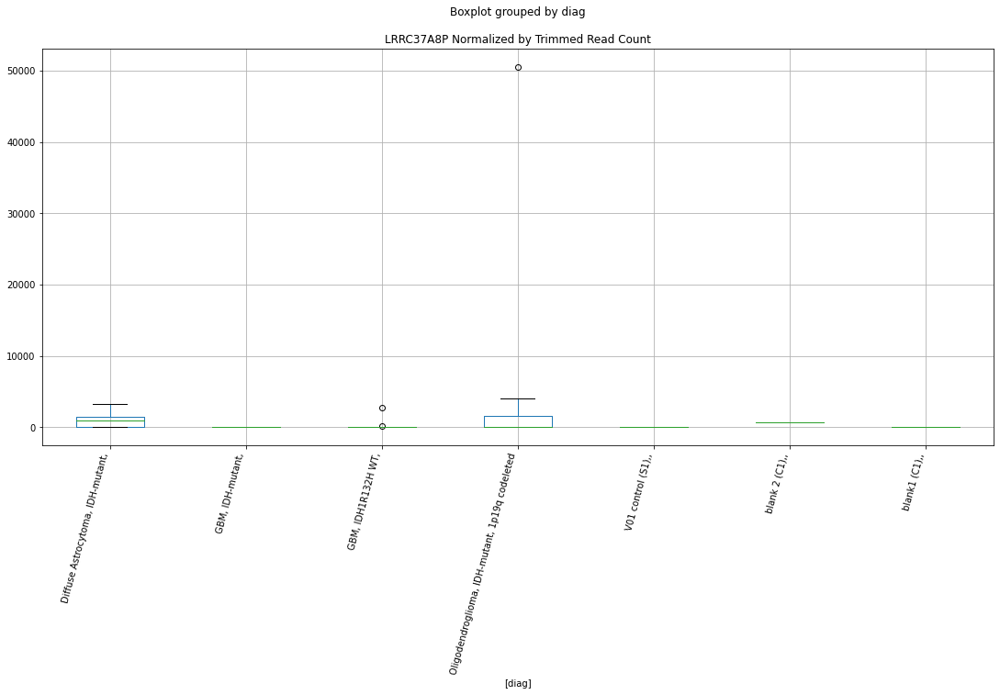

 p : 0.009330357292204544  ( t : 2.9105459263783637 ) :  D-plex  :  cutadapt2  :  LOC112268112
Control and blanks
76     0.0
340    0.0
Name: LOC112268112, dtype: float64
208    1058.16
Name: LOC112268112, dtype: float64
472    1155.91
Name: LOC112268112, dtype: float64


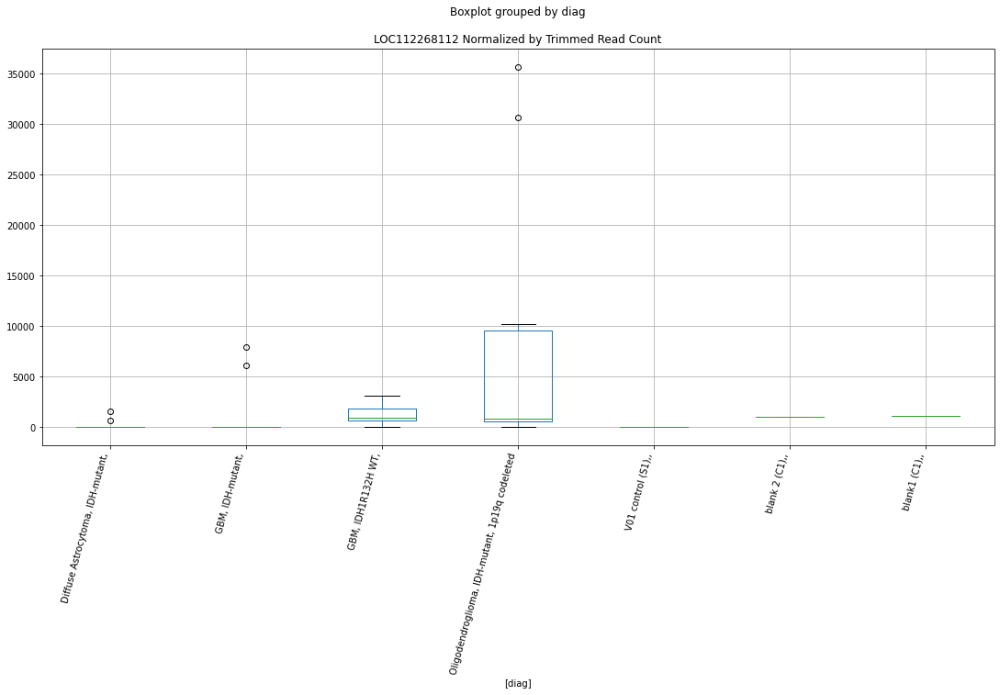

 p : 0.00947014062500278  ( t : 2.9036642813365185 ) :  Lexogen  :  cutadapt2  :  MIR10B
Control and blanks
82       1420.05
346    119947.68
Name: MIR10B, dtype: float64
214    5966.98
Name: MIR10B, dtype: float64
478    237.46
Name: MIR10B, dtype: float64


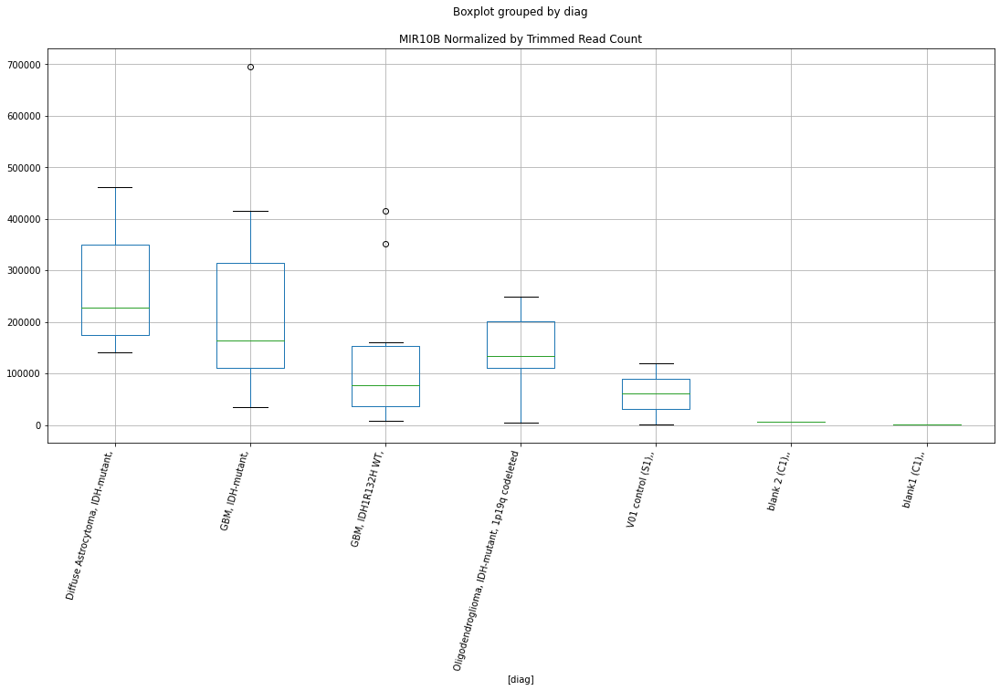

 p : 0.00952560236962854  ( t : 2.9009610173025577 ) :  Lexogen  :  bbduk2  :  MIR10B
Control and blanks
79       1430.60
343    121231.47
Name: MIR10B, dtype: float64
211    6012.74
Name: MIR10B, dtype: float64
475    239.52
Name: MIR10B, dtype: float64


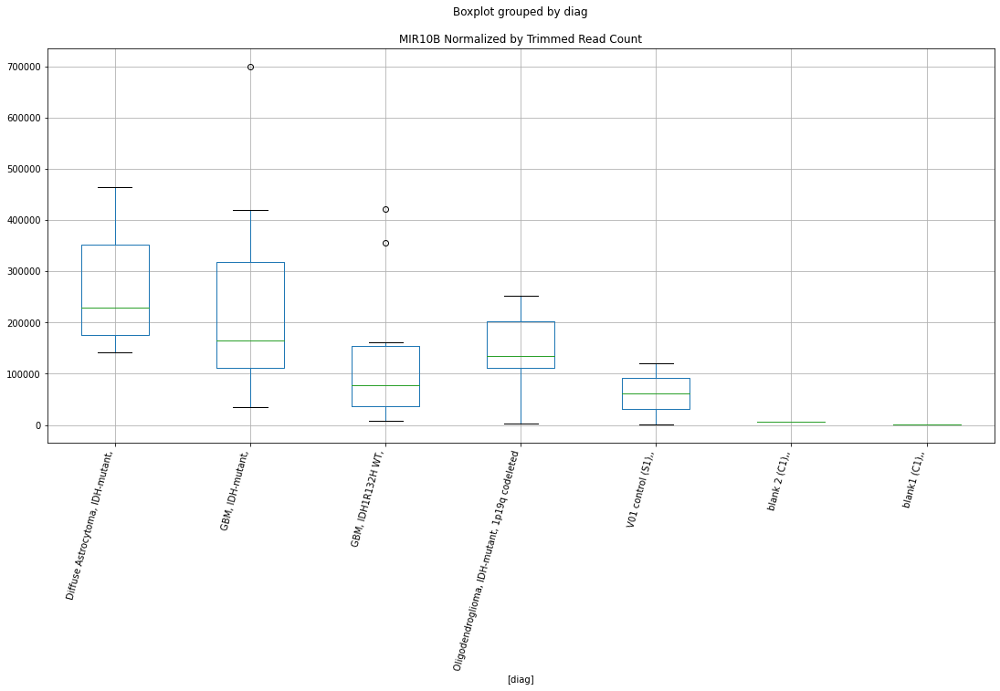

 p : 0.009761876942716447  ( t : 2.8896125322909043 ) :  D-plex  :  cutadapt2  :  MYO1C
Control and blanks
76     40911.17
340     5284.39
Name: MYO1C, dtype: float64
208    121688.55
Name: MYO1C, dtype: float64
472    55483.76
Name: MYO1C, dtype: float64


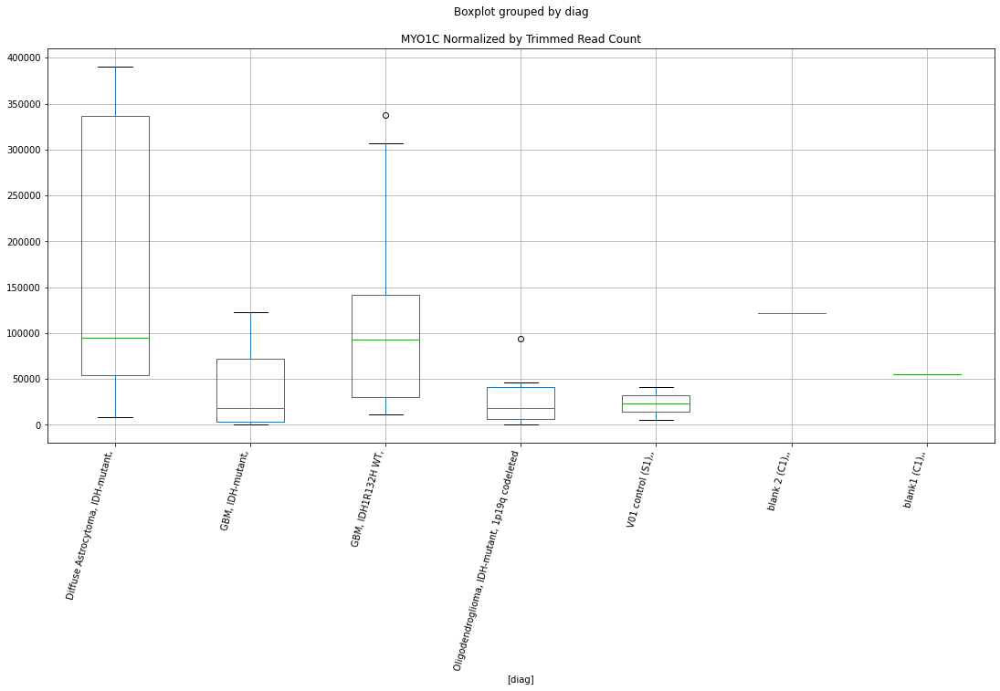

 p : 0.010076952838895535  ( t : 2.8748849040426467 ) :  D-plex  :  cutadapt2  :  MAFIP
Control and blanks
76     757.61
340      0.00
Name: MAFIP, dtype: float64
208    4585.37
Name: MAFIP, dtype: float64
472    4045.69
Name: MAFIP, dtype: float64


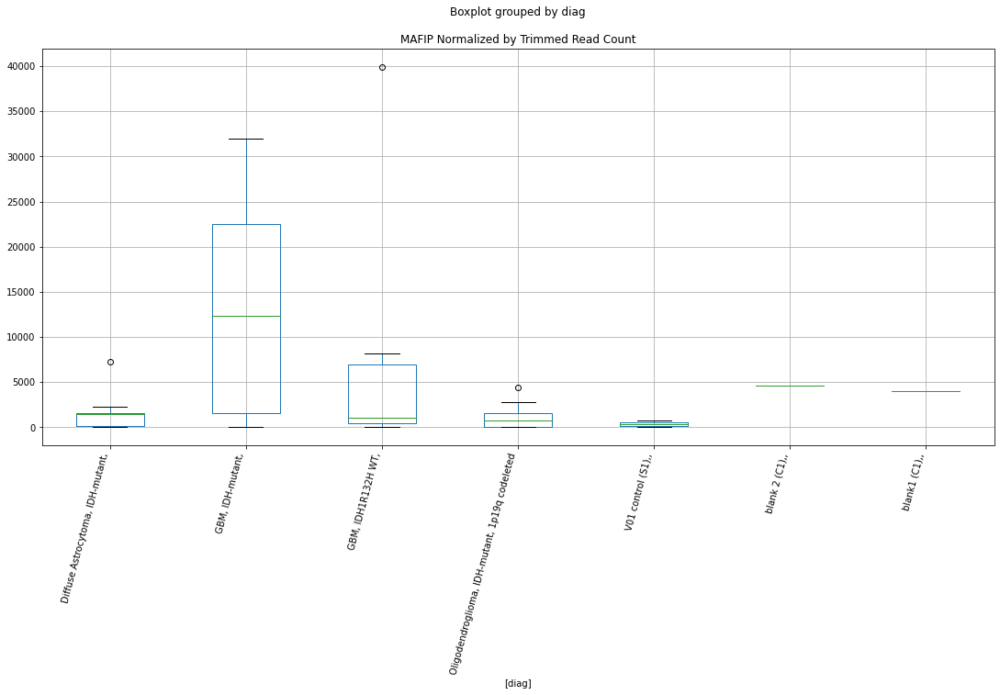

 p : 0.010078368989841952  ( t : 2.874819717252753 ) :  D-plex  :  bbduk2  :  MAFIP
Control and blanks
73     773.01
337      0.00
Name: MAFIP, dtype: float64
205    4835.46
Name: MAFIP, dtype: float64
469    4140.69
Name: MAFIP, dtype: float64


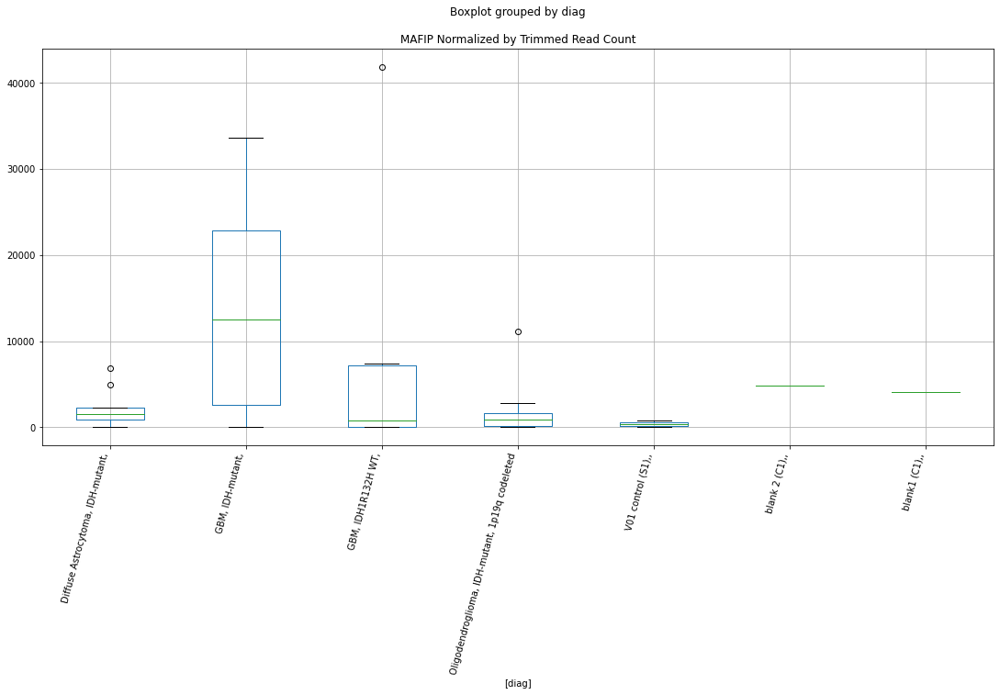

 p : 0.010207696762893749  ( t : 2.86890357429853 ) :  D-plex  :  bbduk2  :  MAFIP
Control and blanks
73     773.01
337      0.00
Name: MAFIP, dtype: float64
205    4835.46
Name: MAFIP, dtype: float64
469    4140.69
Name: MAFIP, dtype: float64


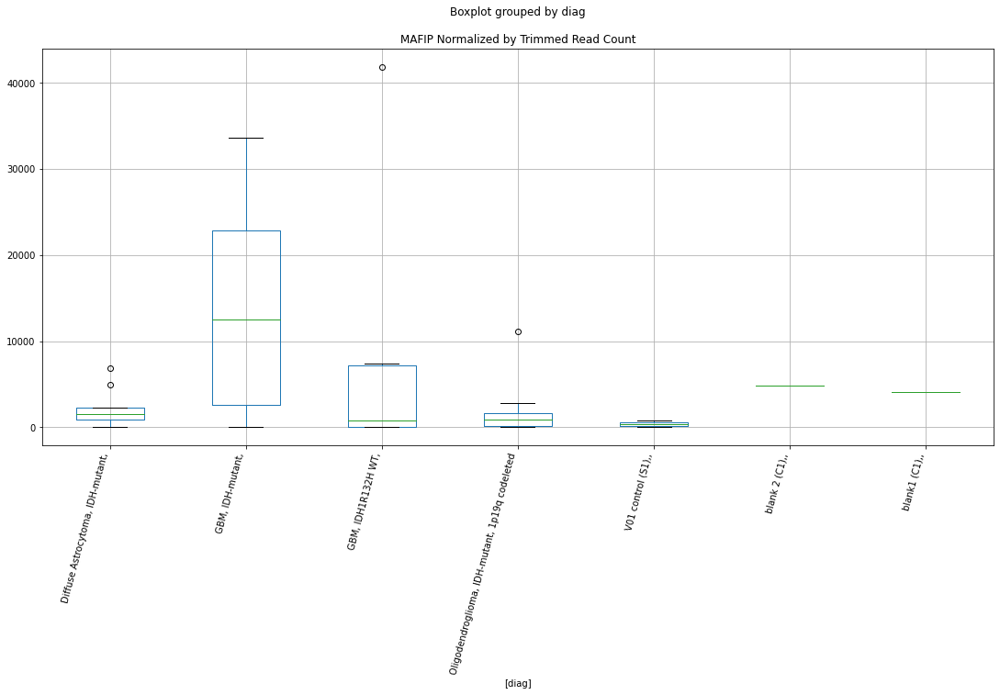

 p : 0.01074445237647954  ( t : 2.8450978950368575 ) :  Lexogen  :  cutadapt2  :  MIR25
Control and blanks
82     17040.61
346      420.87
Name: MIR25, dtype: float64
214    0.0
Name: MIR25, dtype: float64
478    474.92
Name: MIR25, dtype: float64


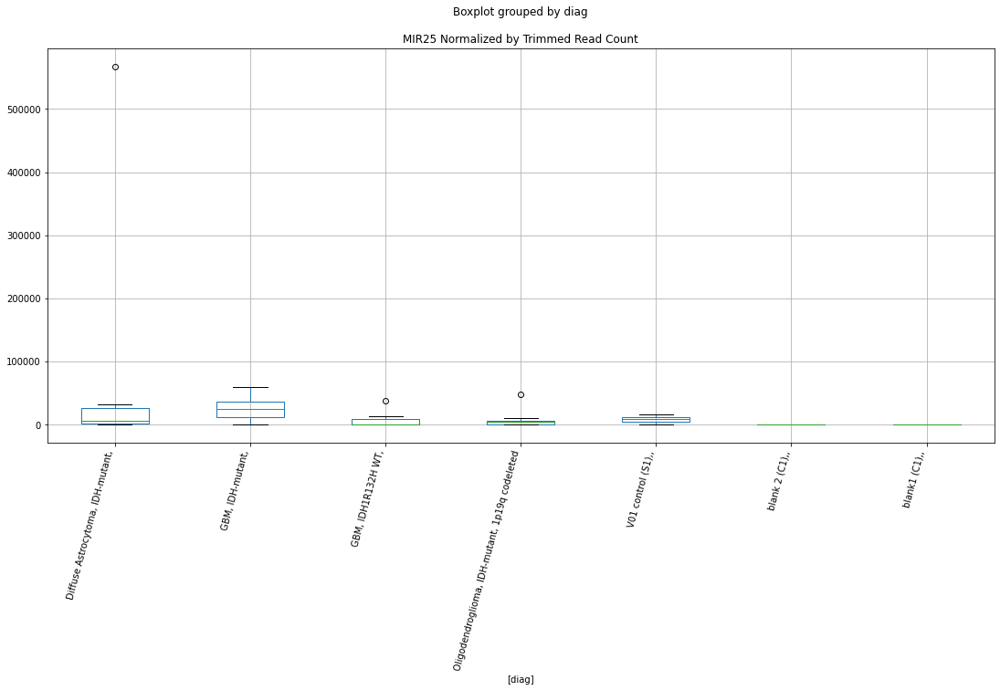

 p : 0.01082241183217519  ( t : 2.8417360008679955 ) :  D-plex  :  cutadapt2  :  NUPR1
Control and blanks
76     1515.23
340       0.00
Name: NUPR1, dtype: float64
208    1410.88
Name: NUPR1, dtype: float64
472    2311.82
Name: NUPR1, dtype: float64


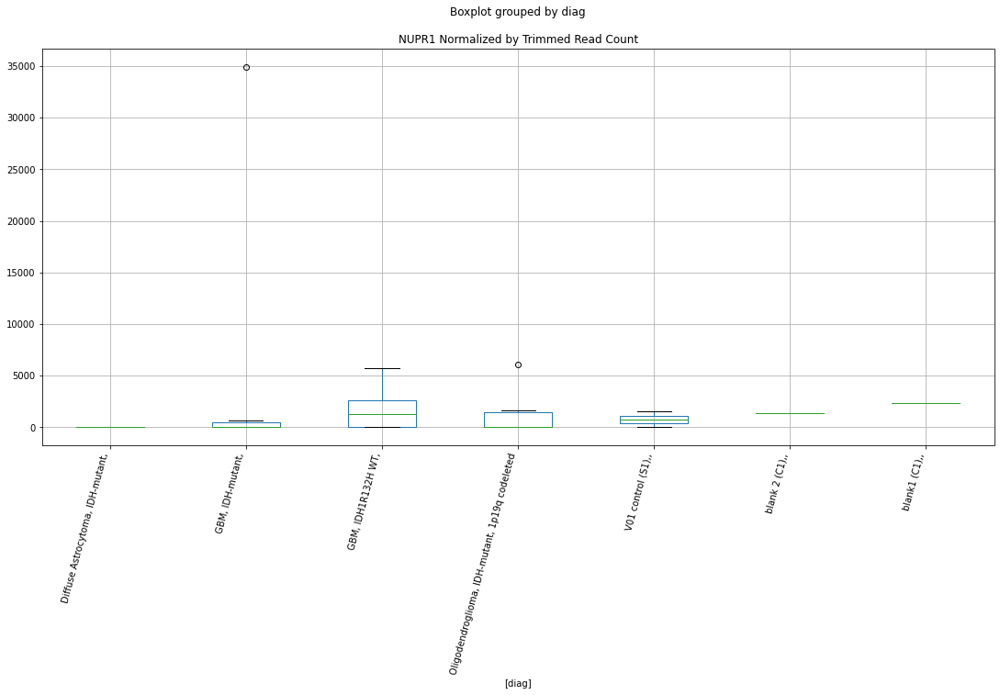

 p : 0.01116860946236133  ( t : 2.8270829671622106 ) :  D-plex  :  cutadapt2  :  NCKAP1L
Control and blanks
76     1515.23
340       0.00
Name: NCKAP1L, dtype: float64
208    1410.88
Name: NCKAP1L, dtype: float64
472    2311.82
Name: NCKAP1L, dtype: float64


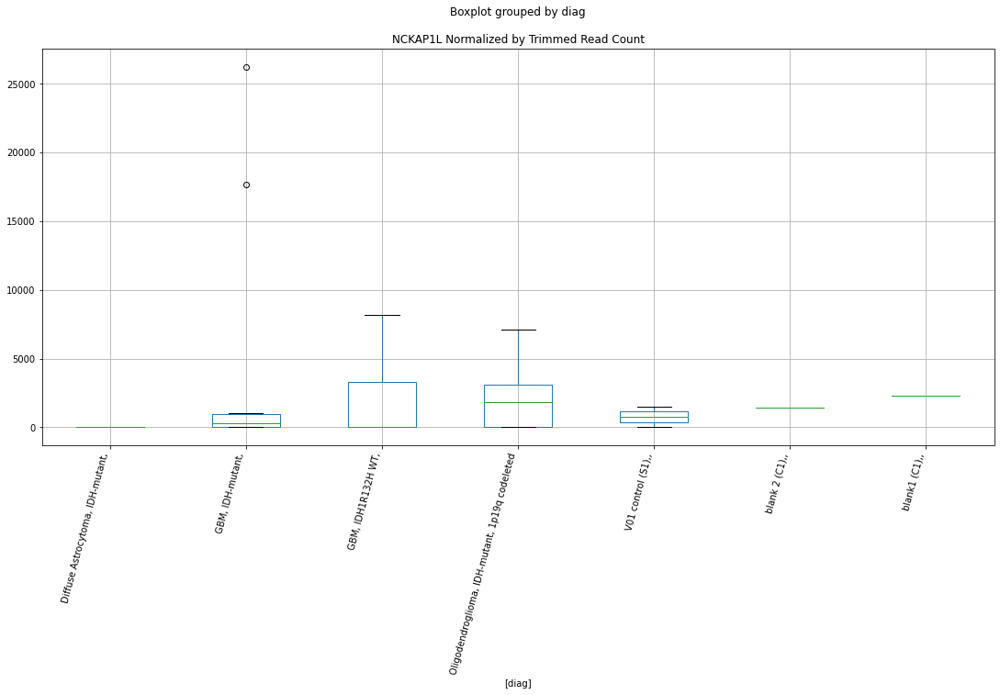

 p : 0.01131482706649241  ( t : 2.8210251050683883 ) :  D-plex  :  bbduk2  :  MYO1C
Control and blanks
73     47926.52
337     5340.94
Name: MYO1C, dtype: float64
205    123572.76
Name: MYO1C, dtype: float64
469    53237.46
Name: MYO1C, dtype: float64


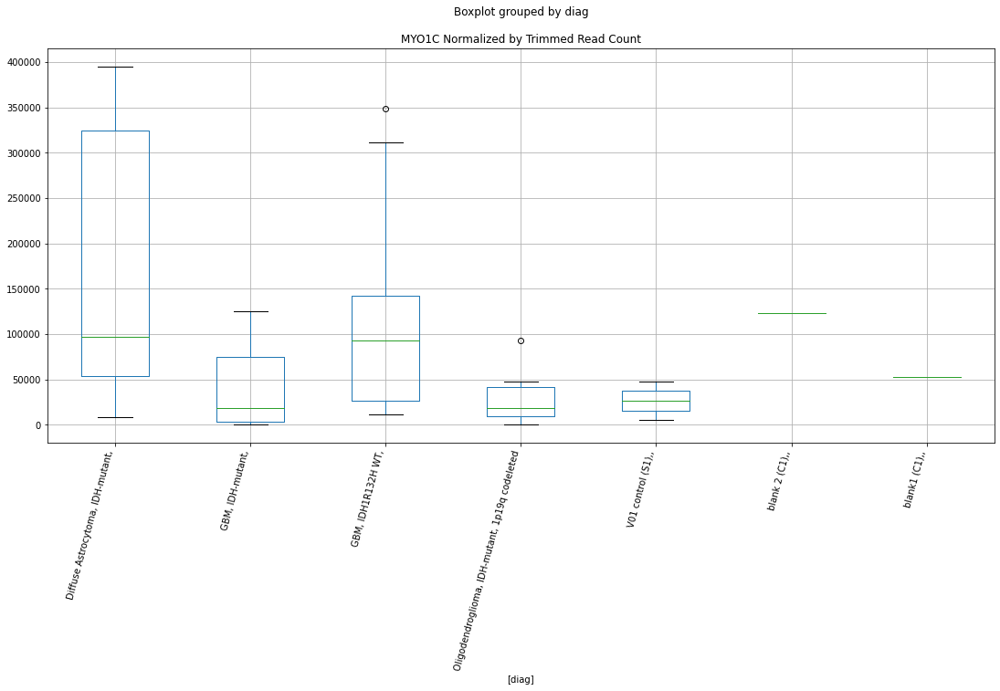

 p : 0.011347966291437167  ( t : 2.81966260370903 ) :  Lexogen  :  bbduk2  :  MRPL20-AS1
Control and blanks
79      1430.60
343    15286.63
Name: MRPL20-AS1, dtype: float64
211    2186.45
Name: MRPL20-AS1, dtype: float64
475    2634.67
Name: MRPL20-AS1, dtype: float64


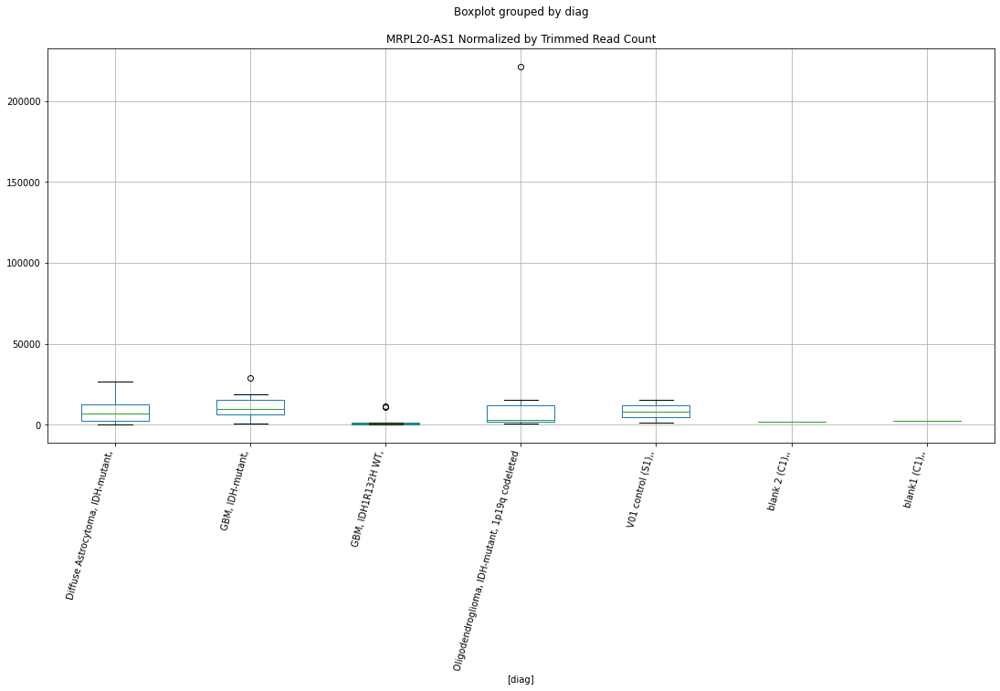

 p : 0.011358629758791235  ( t : 2.8192249947917167 ) :  Lexogen  :  bbduk2  :  MIR25
Control and blanks
79     17167.19
343      424.63
Name: MIR25, dtype: float64
211    0.0
Name: MIR25, dtype: float64
475    479.03
Name: MIR25, dtype: float64


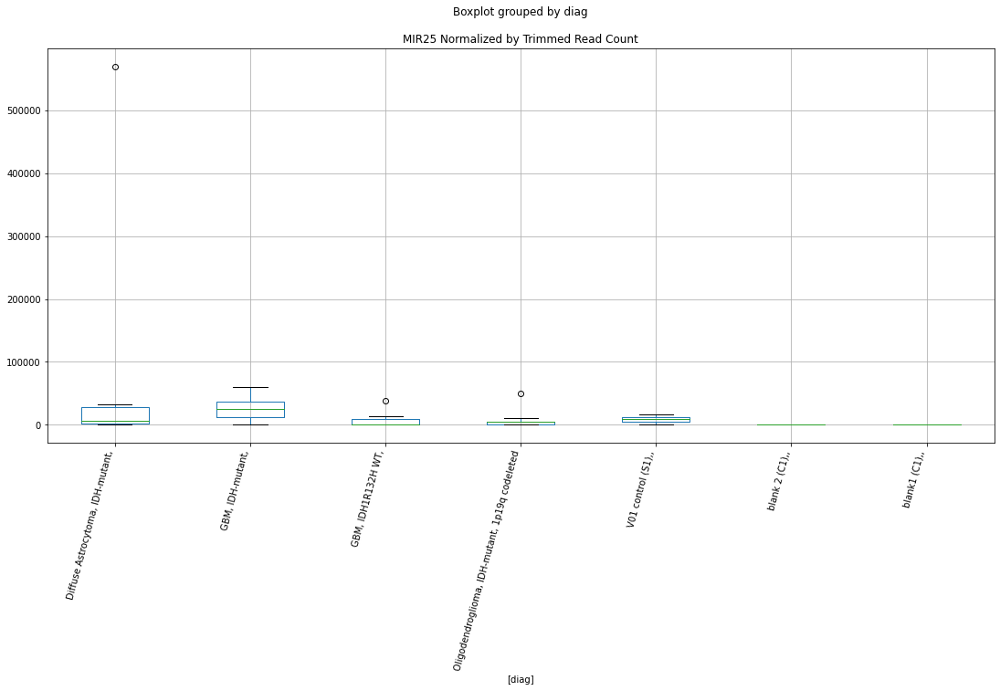

 p : 0.011391088028947083  ( t : 2.8178953953436348 ) :  D-plex  :  cutadapt2  :  MED12
Control and blanks
76     15909.9
340        0.0
Name: MED12, dtype: float64
208    881.8
Name: MED12, dtype: float64
472    1155.91
Name: MED12, dtype: float64


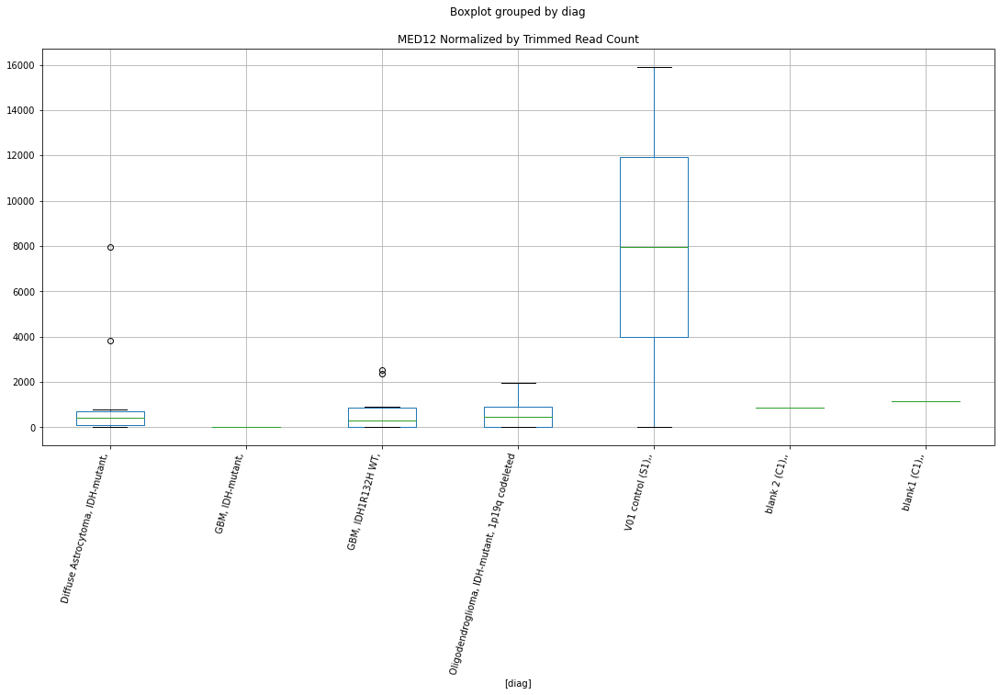

 p : 0.011422406988712679  ( t : 2.8166159154930397 ) :  Lexogen  :  bbduk2  :  MIR30C2
Control and blanks
79     17167.19
343    68577.52
Name: MIR30C2, dtype: float64
211    0.0
Name: MIR30C2, dtype: float64
475    0.0
Name: MIR30C2, dtype: float64


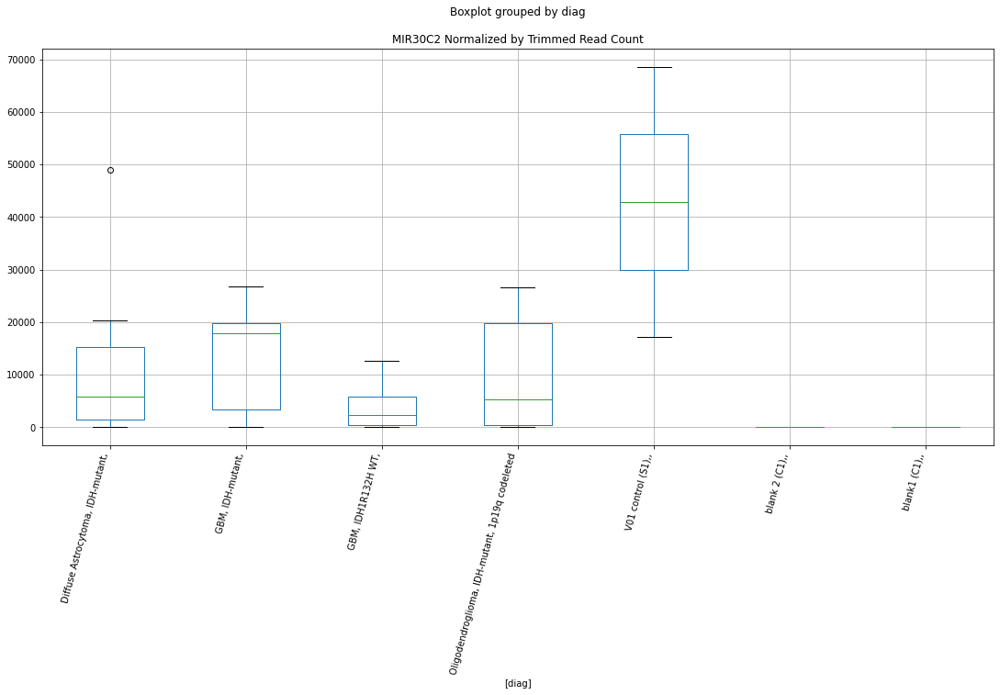

 p : 0.011422406988712679  ( t : 2.8166159154930397 ) :  Lexogen  :  bbduk2  :  MIR30C1
Control and blanks
79     17167.19
343    68577.52
Name: MIR30C1, dtype: float64
211    0.0
Name: MIR30C1, dtype: float64
475    0.0
Name: MIR30C1, dtype: float64


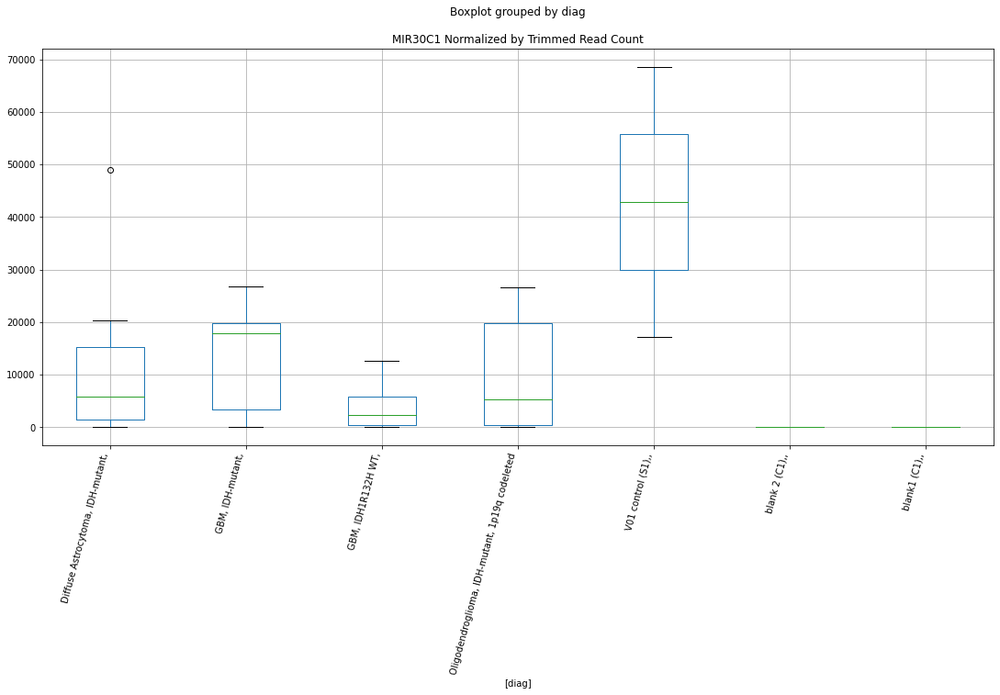

 p : 0.01150042878756598  ( t : 2.813443087595012 ) :  D-plex  :  cutadapt2  :  LOC112268313
Control and blanks
76     37880.71
340     2642.20
Name: LOC112268313, dtype: float64
208    6701.69
Name: LOC112268313, dtype: float64
472    7513.43
Name: LOC112268313, dtype: float64


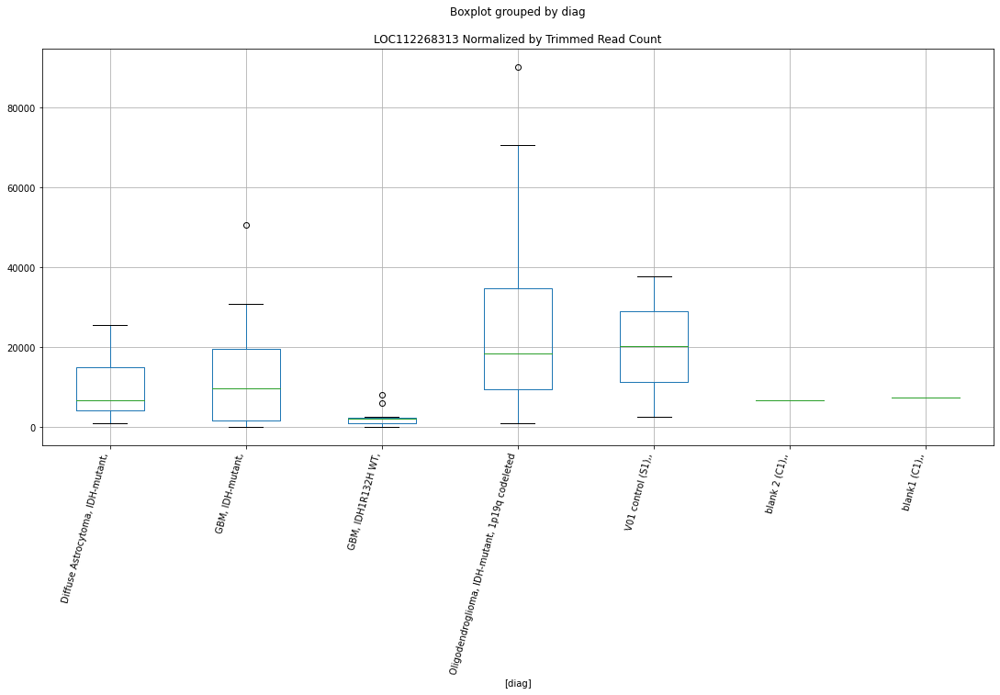

 p : 0.011521231103961724  ( t : 2.812600637247848 ) :  D-plex  :  bbduk2  :  LUC7L
Control and blanks
73     0.0
337    0.0
Name: LUC7L, dtype: float64
205    5910.0
Name: LUC7L, dtype: float64
469    0.0
Name: LUC7L, dtype: float64


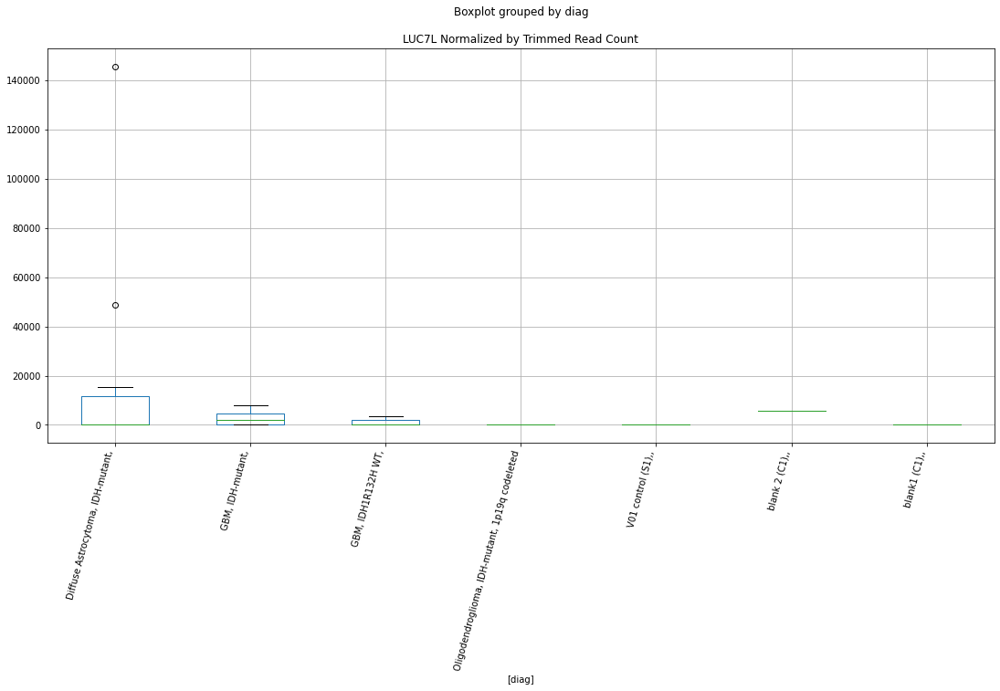

 p : 0.011587416281791867  ( t : 2.809929970916276 ) :  Lexogen  :  cutadapt2  :  MIR30C2
Control and blanks
82     17040.61
346    68180.79
Name: MIR30C2, dtype: float64
214    0.0
Name: MIR30C2, dtype: float64
478    0.0
Name: MIR30C2, dtype: float64


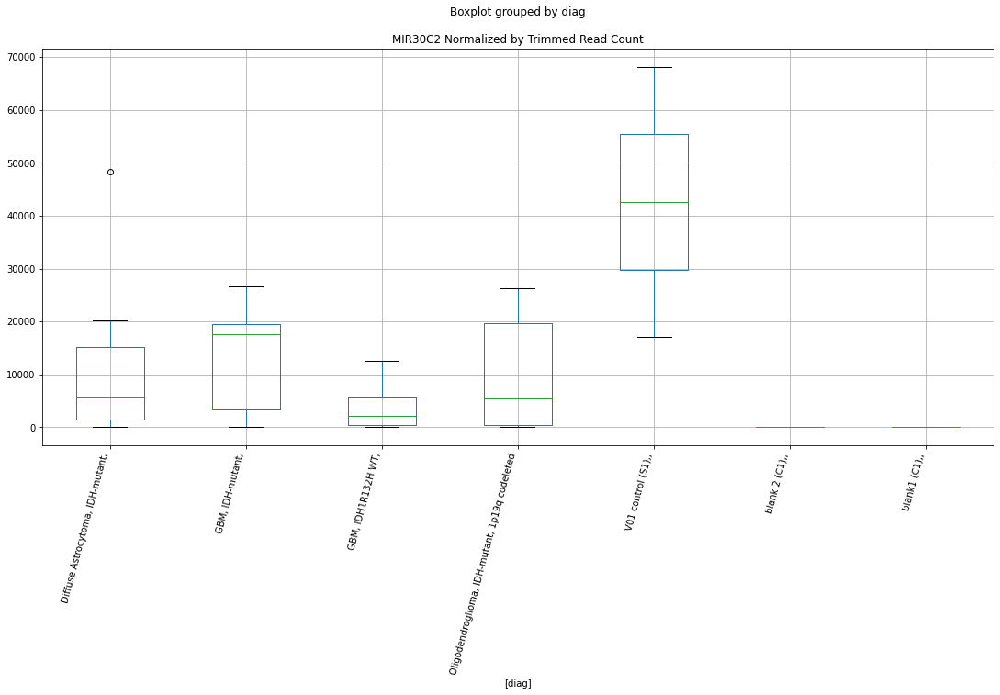

 p : 0.011587416281791867  ( t : 2.809929970916276 ) :  Lexogen  :  cutadapt2  :  MIR30C1
Control and blanks
82     17040.61
346    68180.79
Name: MIR30C1, dtype: float64
214    0.0
Name: MIR30C1, dtype: float64
478    0.0
Name: MIR30C1, dtype: float64


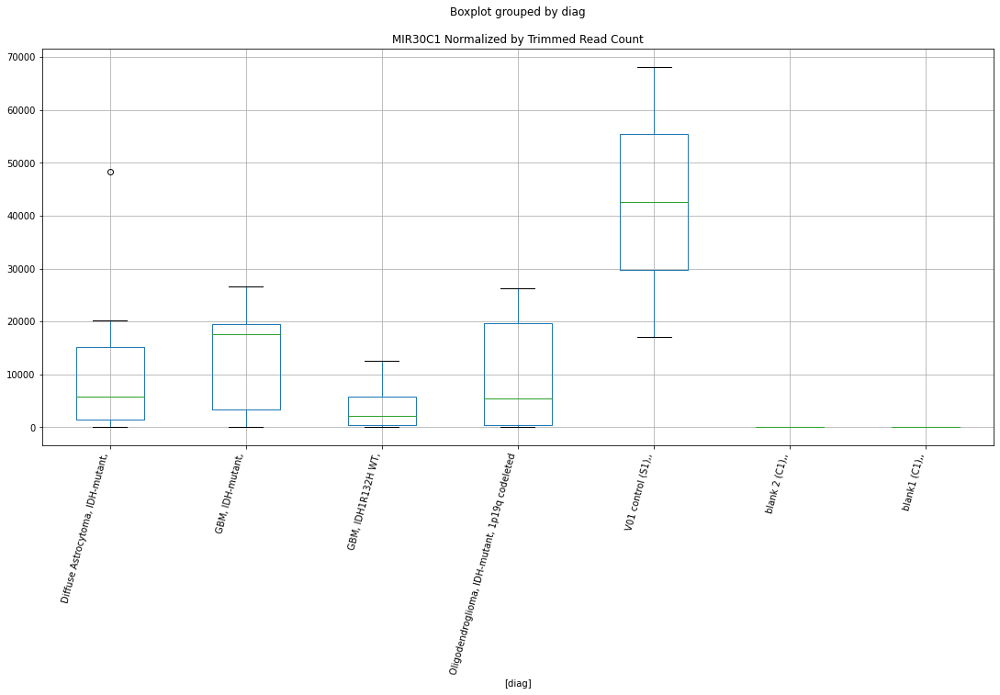

 p : 0.011636090629153491  ( t : 2.807975233274429 ) :  D-plex  :  cutadapt2  :  MCHR2
Control and blanks
76     0.0
340    0.0
Name: MCHR2, dtype: float64
208    529.08
Name: MCHR2, dtype: float64
472    1155.91
Name: MCHR2, dtype: float64


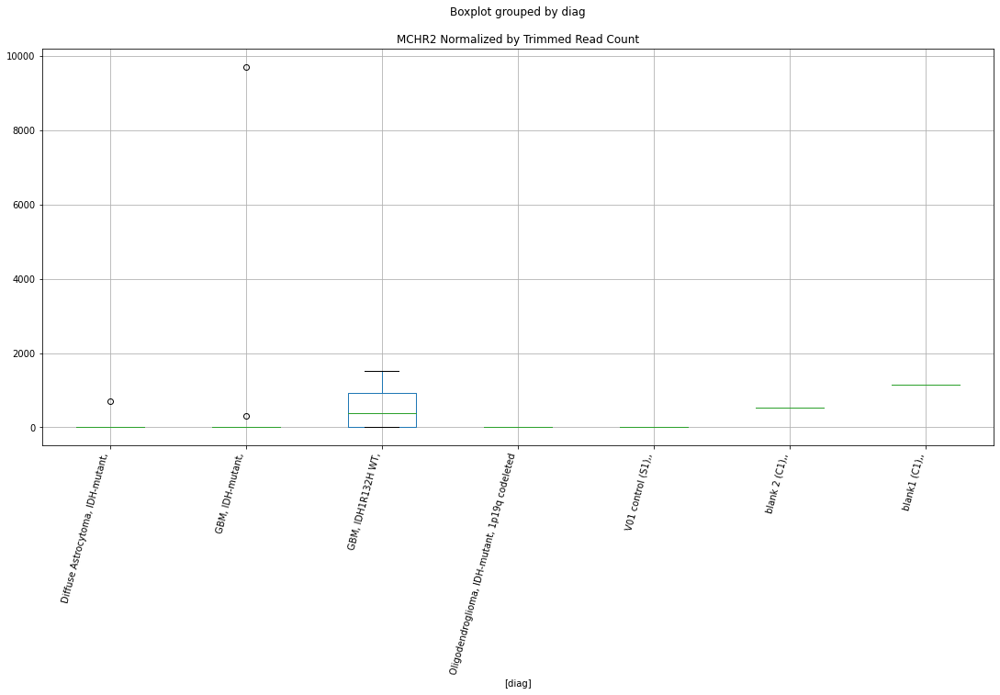

 p : 0.011837503050066209  ( t : 2.7999692783272985 ) :  Lexogen  :  bbduk2  :  LOC107986476
Control and blanks
79        0.00
343    2123.14
Name: LOC107986476, dtype: float64
211    0.0
Name: LOC107986476, dtype: float64
475    0.0
Name: LOC107986476, dtype: float64


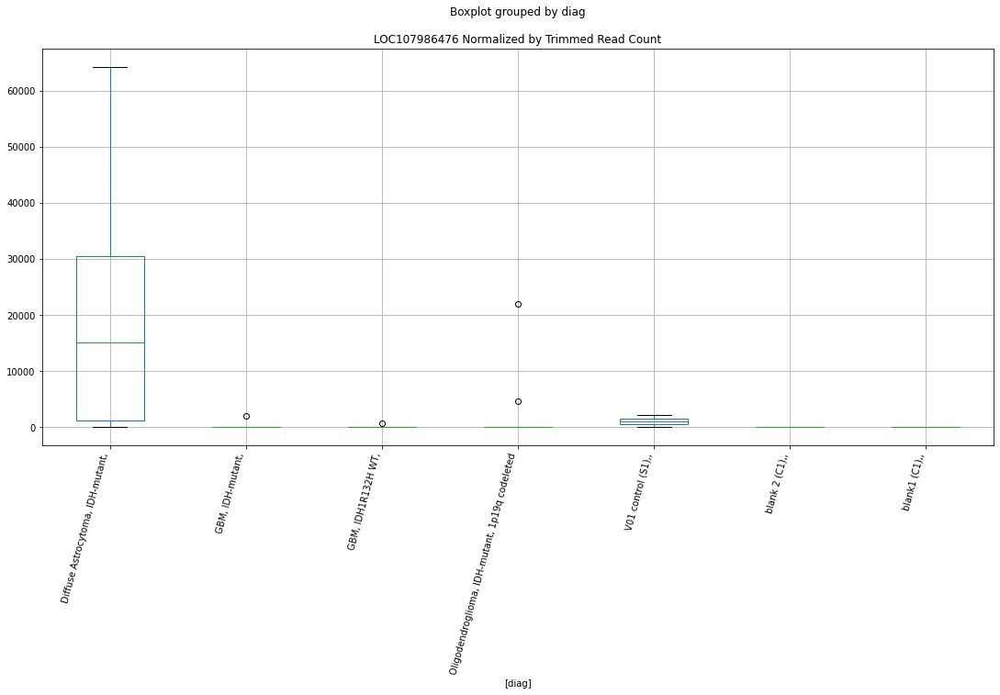

 p : 0.012063512430206043  ( t : 2.791139981142082 ) :  D-plex  :  cutadapt2  :  LUC7L
Control and blanks
76     0.0
340    0.0
Name: LUC7L, dtype: float64
208    5819.89
Name: LUC7L, dtype: float64
472    0.0
Name: LUC7L, dtype: float64


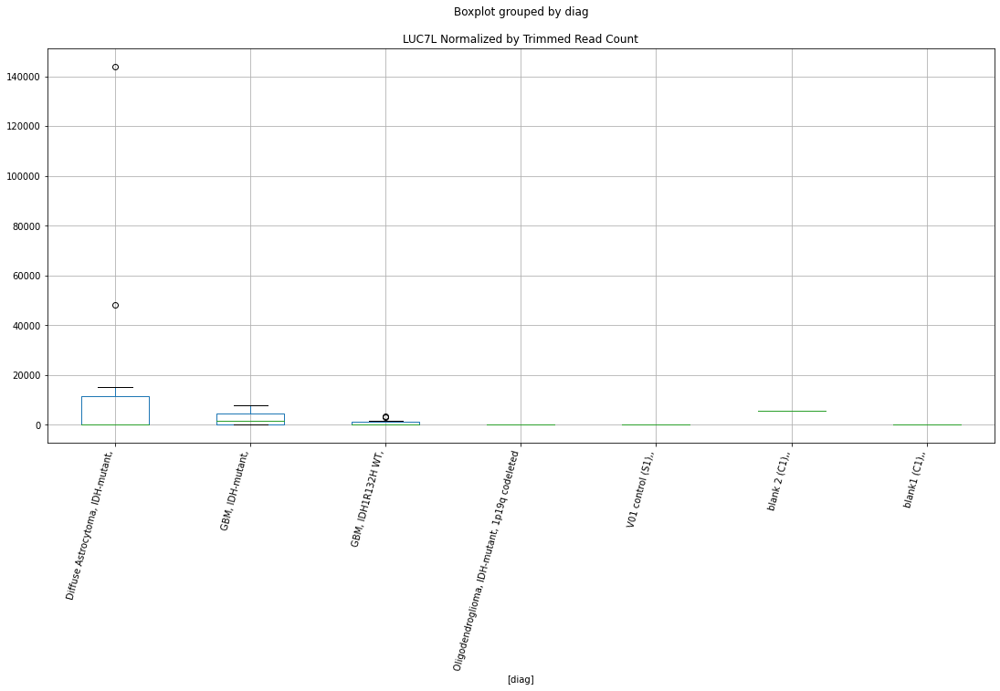

 p : 0.01232187760663181  ( t : 2.7812392011271676 ) :  Lexogen  :  bbduk2  :  LOC107986476
Control and blanks
79        0.00
343    2123.14
Name: LOC107986476, dtype: float64
211    0.0
Name: LOC107986476, dtype: float64
475    0.0
Name: LOC107986476, dtype: float64


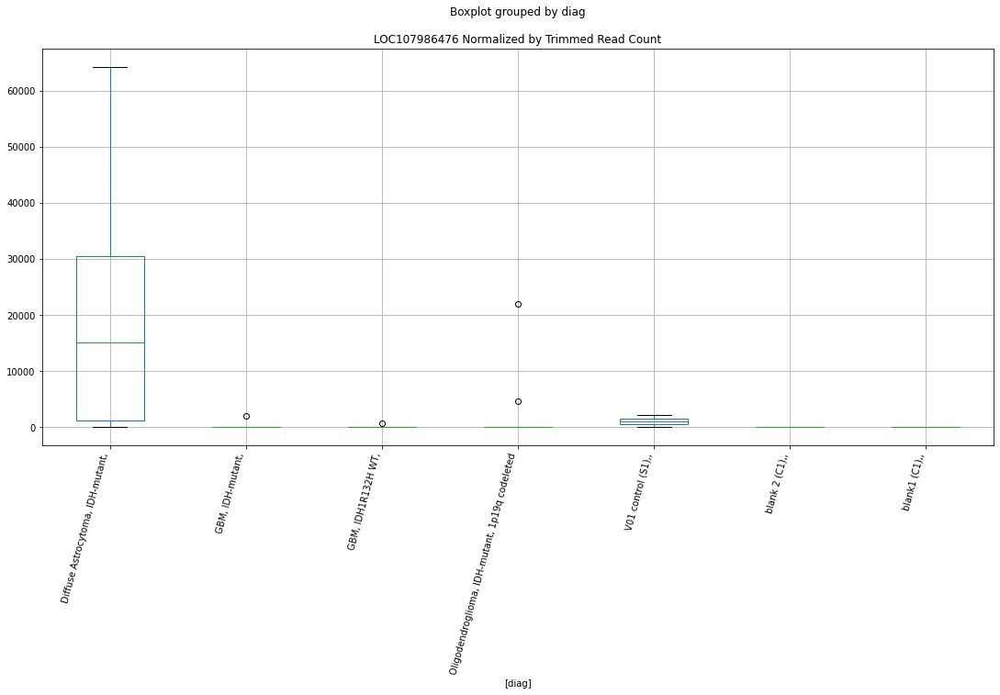

 p : 0.012631001260295323  ( t : 2.7696518383238873 ) :  Lexogen  :  cutadapt2  :  LRFN4
Control and blanks
82     0.0
346    0.0
Name: LRFN4, dtype: float64
214    4339.62
Name: LRFN4, dtype: float64
478    949.84
Name: LRFN4, dtype: float64


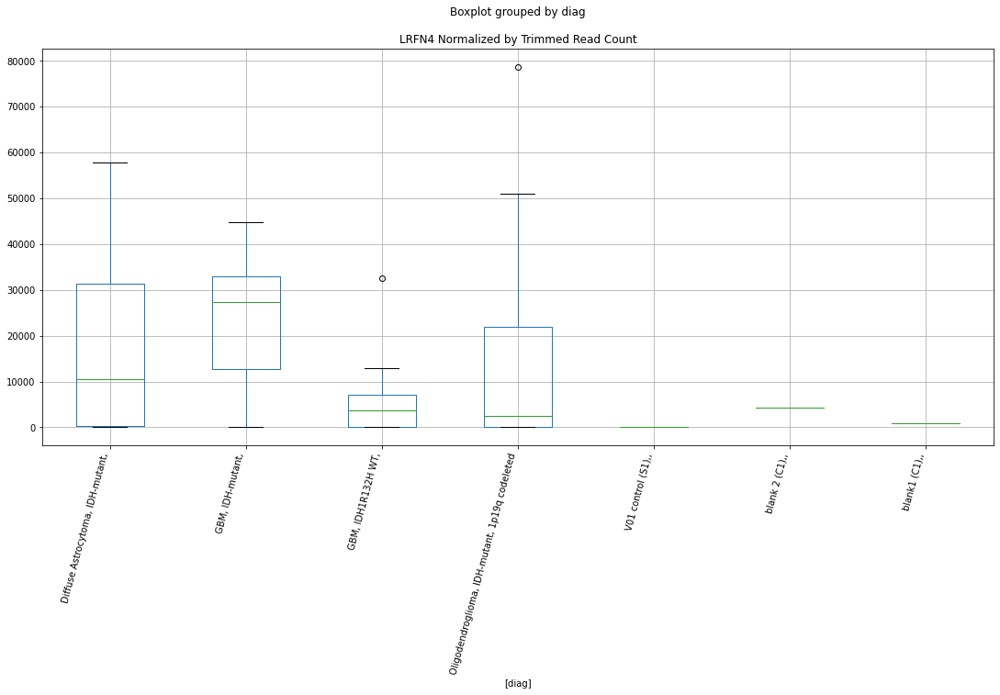

 p : 0.012683060373865651  ( t : 2.7677272331966947 ) :  D-plex  :  bbduk2  :  MED12
Control and blanks
73     15460.17
337        0.00
Name: MED12, dtype: float64
205    895.45
Name: MED12, dtype: float64
469    1774.58
Name: MED12, dtype: float64


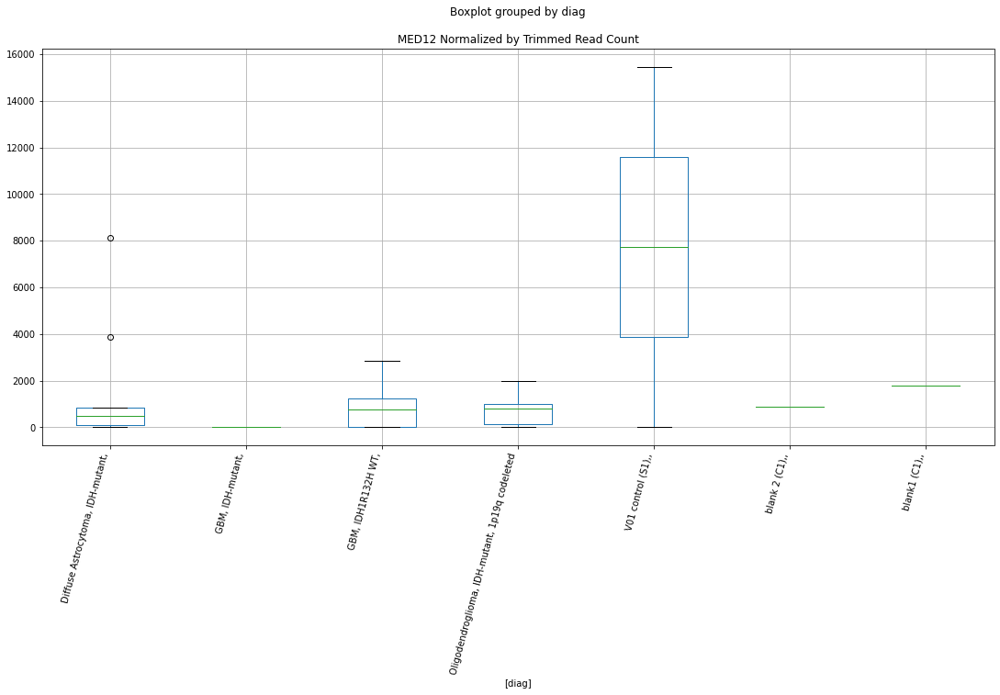

 p : 0.012739030137361428  ( t : 2.7656664856457853 ) :  D-plex  :  bbduk2  :  NID1
Control and blanks
73     1546.02
337       0.00
Name: NID1, dtype: float64
205    2149.09
Name: NID1, dtype: float64
469    9464.44
Name: NID1, dtype: float64


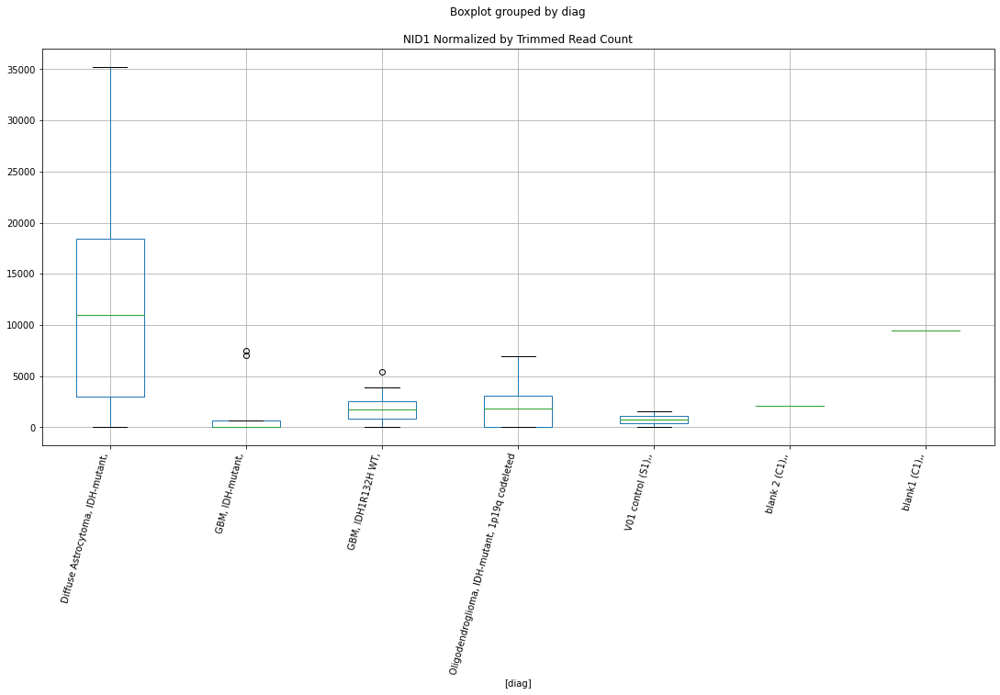

 p : 0.012872938371798101  ( t : 2.7607711447482766 ) :  D-plex  :  bbduk2  :  LOC107986930
Control and blanks
73     6184.07
337       0.00
Name: LOC107986930, dtype: float64
205    2328.18
Name: LOC107986930, dtype: float64
469    1774.58
Name: LOC107986930, dtype: float64


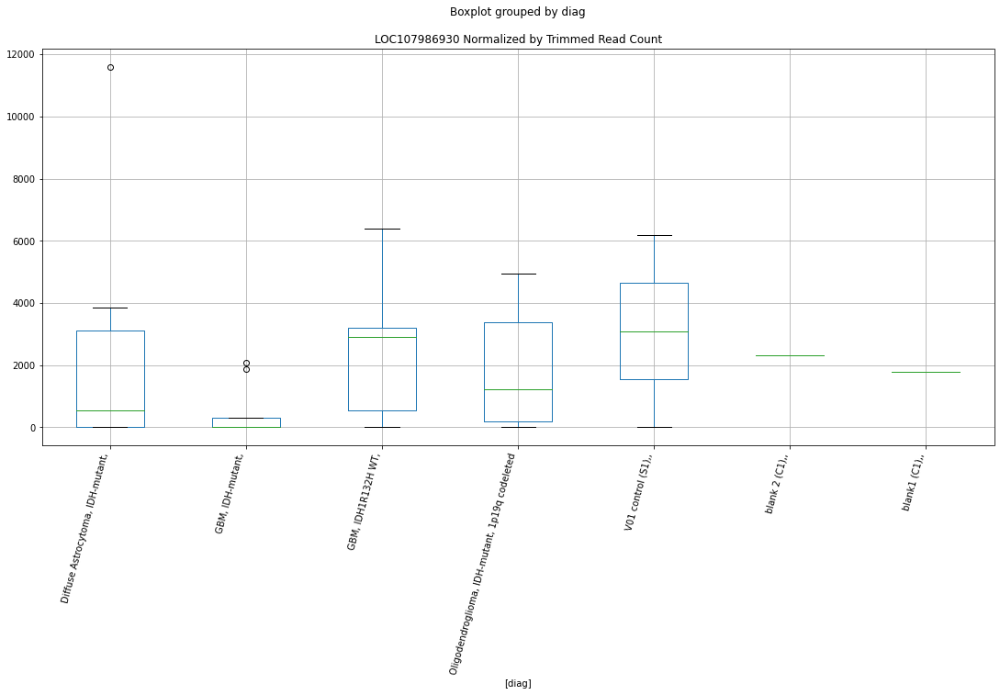

 p : 0.013569070678208665  ( t : 2.7360832212928665 ) :  D-plex  :  bbduk2  :  LOC112268313
Control and blanks
73     47153.51
337     2670.47
Name: LOC112268313, dtype: float64
205    7700.91
Name: LOC112268313, dtype: float64
469    7689.86
Name: LOC112268313, dtype: float64


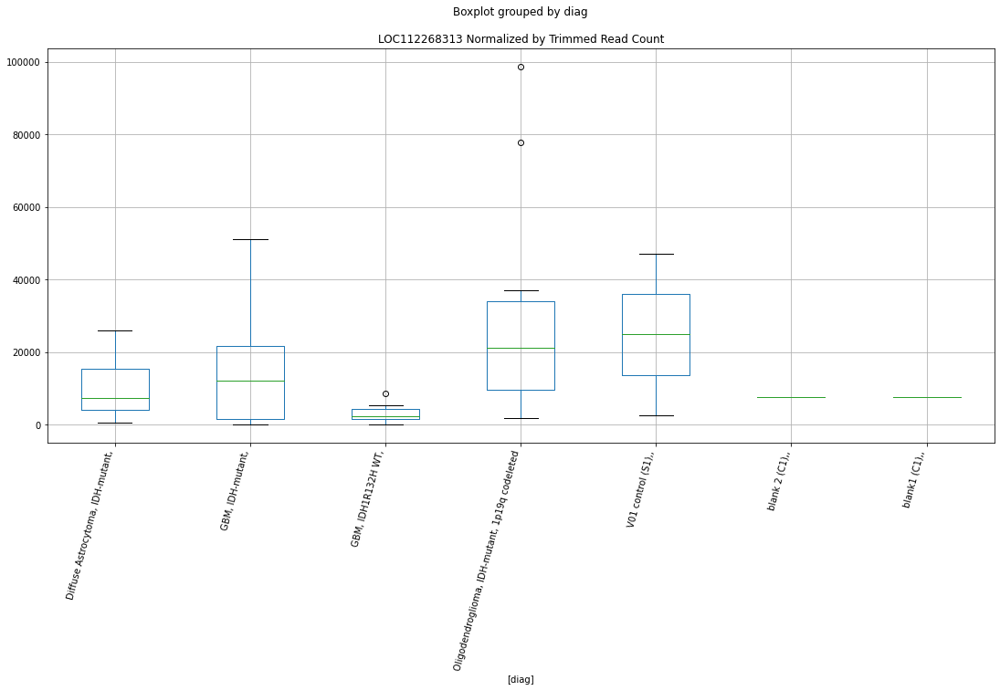

 p : 0.01400125048335611  ( t : 2.7213593575138595 ) :  Lexogen  :  bbduk2  :  LRFN4
Control and blanks
79     0.0
343    0.0
Name: LRFN4, dtype: float64
211    4372.9
Name: LRFN4, dtype: float64
475    958.06
Name: LRFN4, dtype: float64


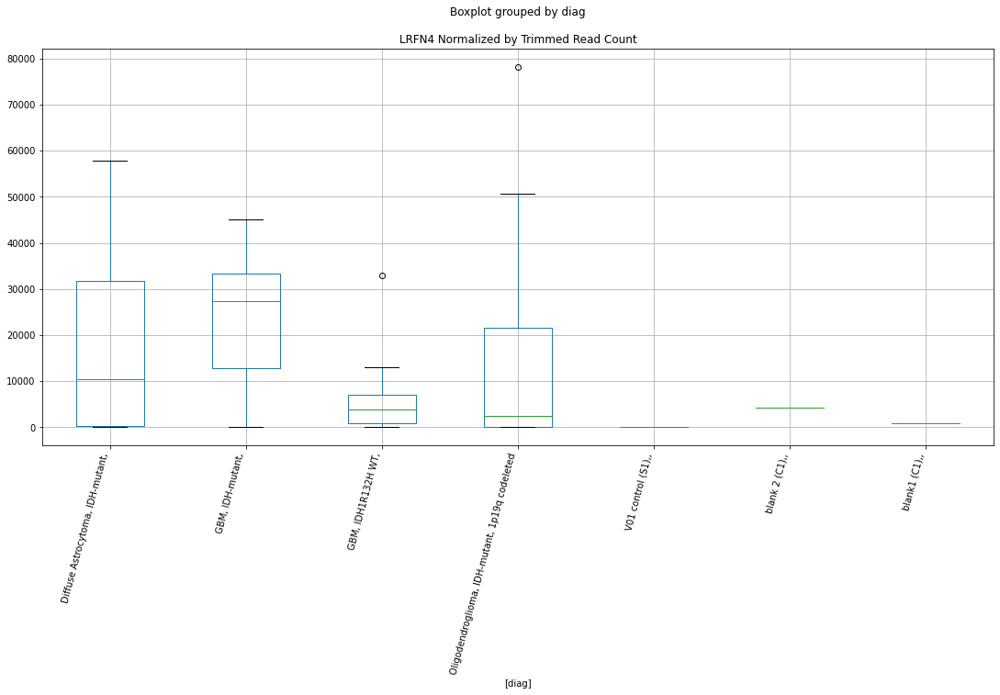

 p : 0.014107333455681584  ( t : 2.717811722859431 ) :  D-plex  :  bbduk2  :  NID1
Control and blanks
73     1546.02
337       0.00
Name: NID1, dtype: float64
205    2149.09
Name: NID1, dtype: float64
469    9464.44
Name: NID1, dtype: float64


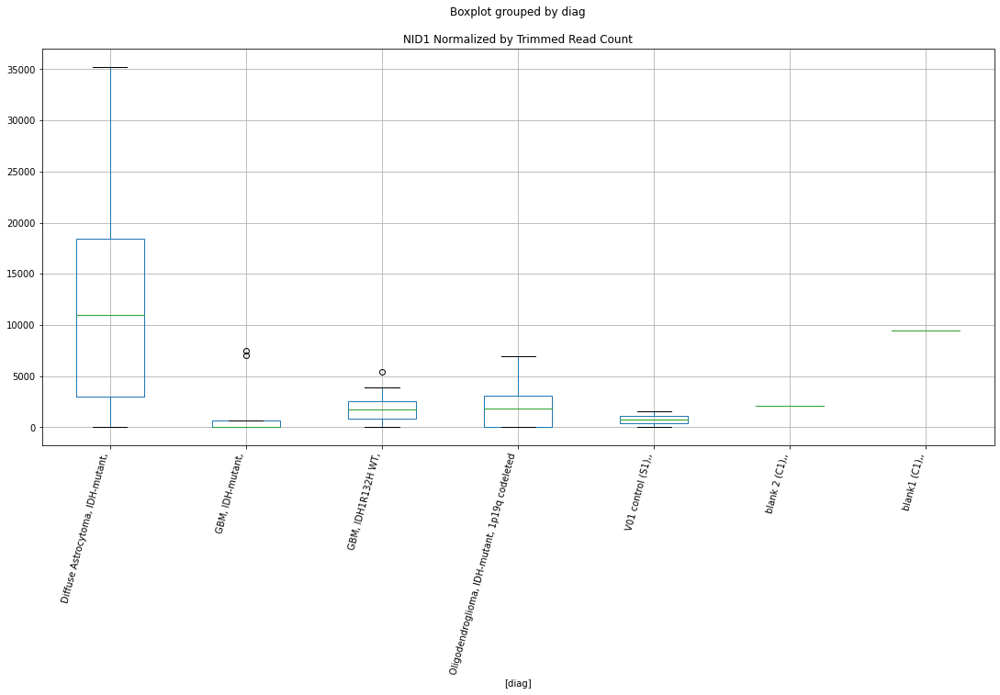

 p : 0.014283584558023902  ( t : 2.7119735326328764 ) :  Lexogen  :  cutadapt2  :  MRPL20-AS1
Control and blanks
82         0.00
346    13257.37
Name: MRPL20-AS1, dtype: float64
214    0.0
Name: MRPL20-AS1, dtype: float64
478    0.0
Name: MRPL20-AS1, dtype: float64


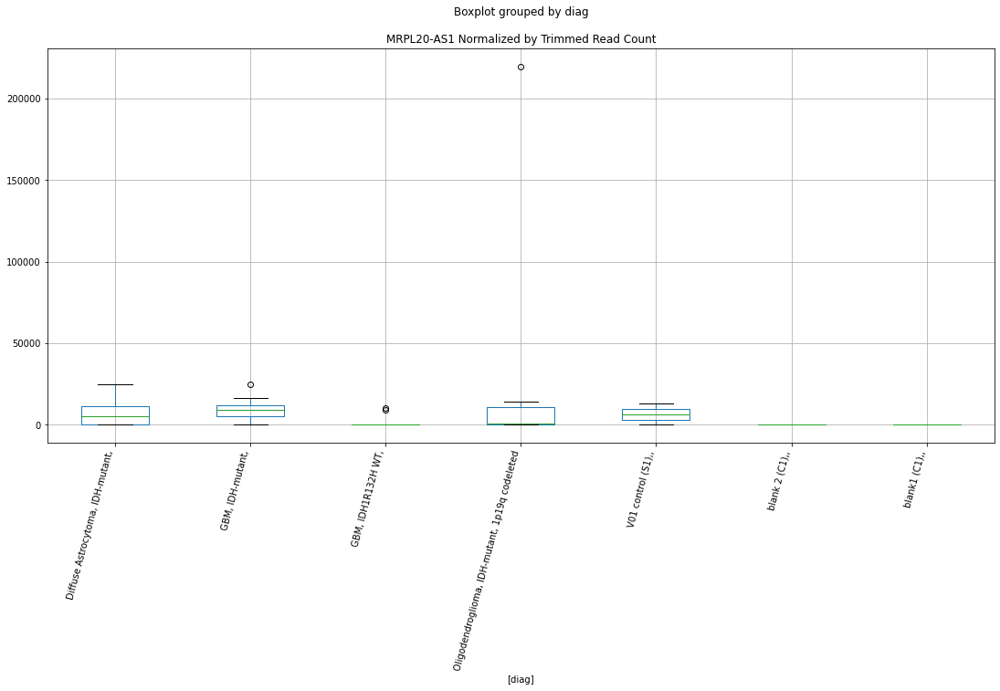

 p : 0.014325936418784019  ( t : 2.7105809222692057 ) :  Lexogen  :  bbduk2  :  MGAT1
Control and blanks
79     0.0
343    0.0
Name: MGAT1, dtype: float64
211    0.0
Name: MGAT1, dtype: float64
475    0.0
Name: MGAT1, dtype: float64


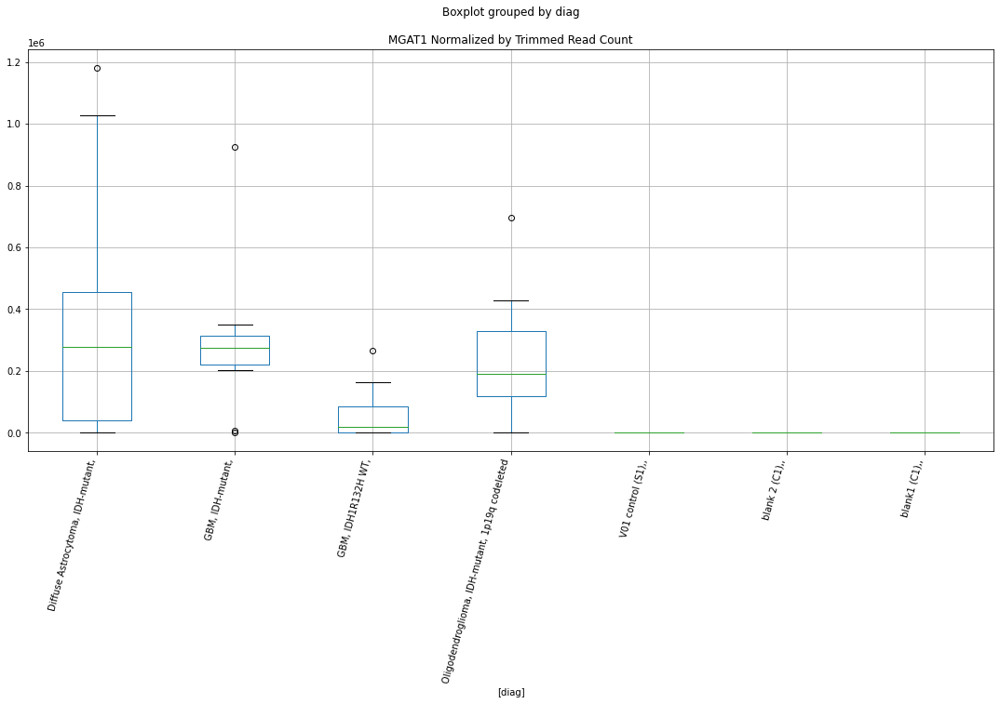

 p : 0.014329448642886192  ( t : 2.7104656103649294 ) :  D-plex  :  cutadapt2  :  LOC112268313
Control and blanks
76     37880.71
340     2642.20
Name: LOC112268313, dtype: float64
208    6701.69
Name: LOC112268313, dtype: float64
472    7513.43
Name: LOC112268313, dtype: float64


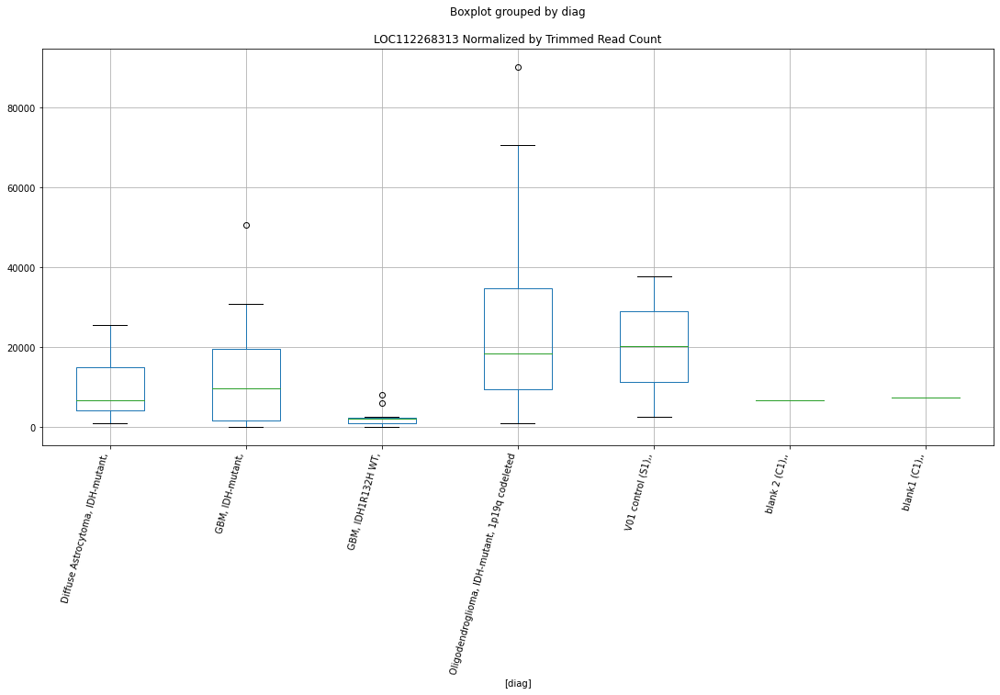

 p : 0.014512918721686694  ( t : 2.704479244158613 ) :  D-plex  :  bbduk2  :  NEPRO
Control and blanks
73     0.0
337    0.0
Name: NEPRO, dtype: float64
205    55876.38
Name: NEPRO, dtype: float64
469    2366.11
Name: NEPRO, dtype: float64


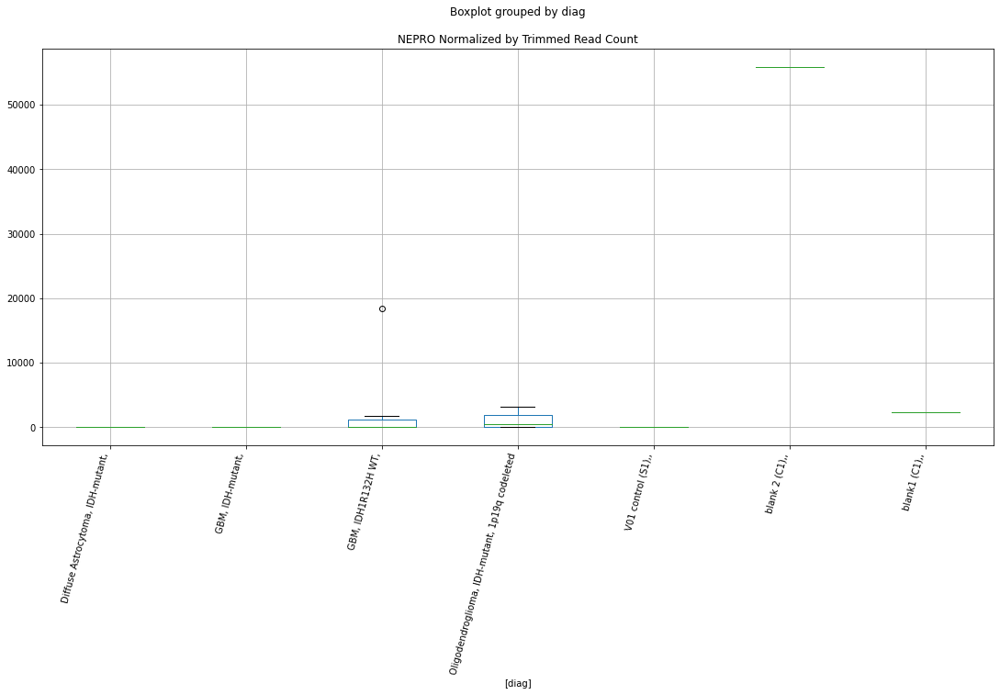

 p : 0.014586435505900268  ( t : 2.7021007669411907 ) :  D-plex  :  cutadapt2  :  NID1
Control and blanks
76     0.0
340    0.0
Name: NID1, dtype: float64
208    2116.32
Name: NID1, dtype: float64
472    9247.29
Name: NID1, dtype: float64


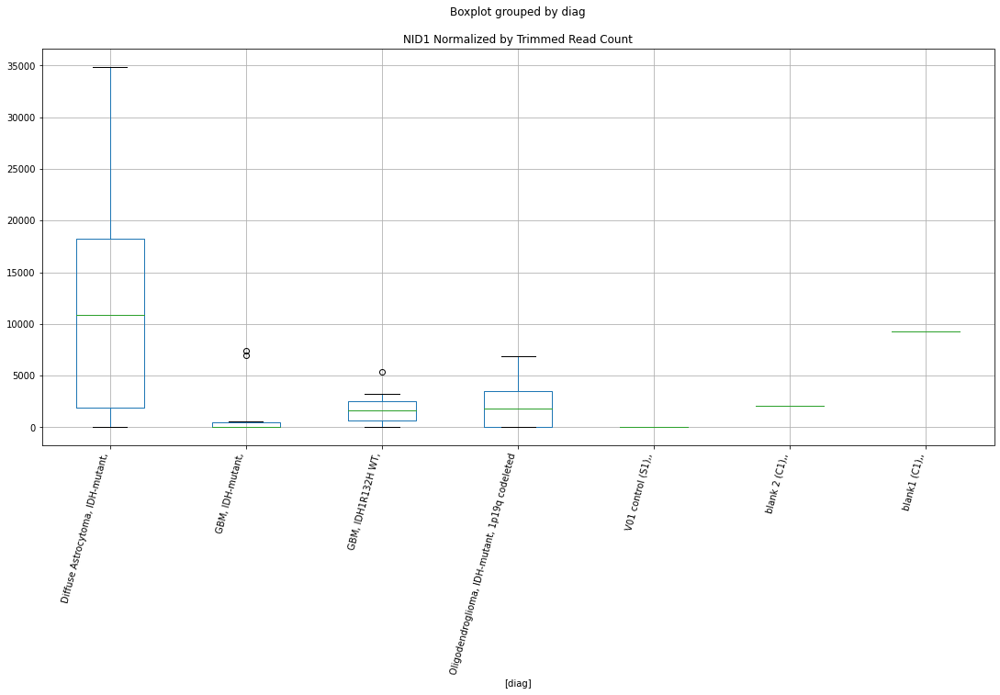

 p : 0.014752013314518963  ( t : 2.6967855200500885 ) :  Lexogen  :  cutadapt2  :  MGAT1
Control and blanks
82     0.0
346    0.0
Name: MGAT1, dtype: float64
214    0.0
Name: MGAT1, dtype: float64
478    0.0
Name: MGAT1, dtype: float64


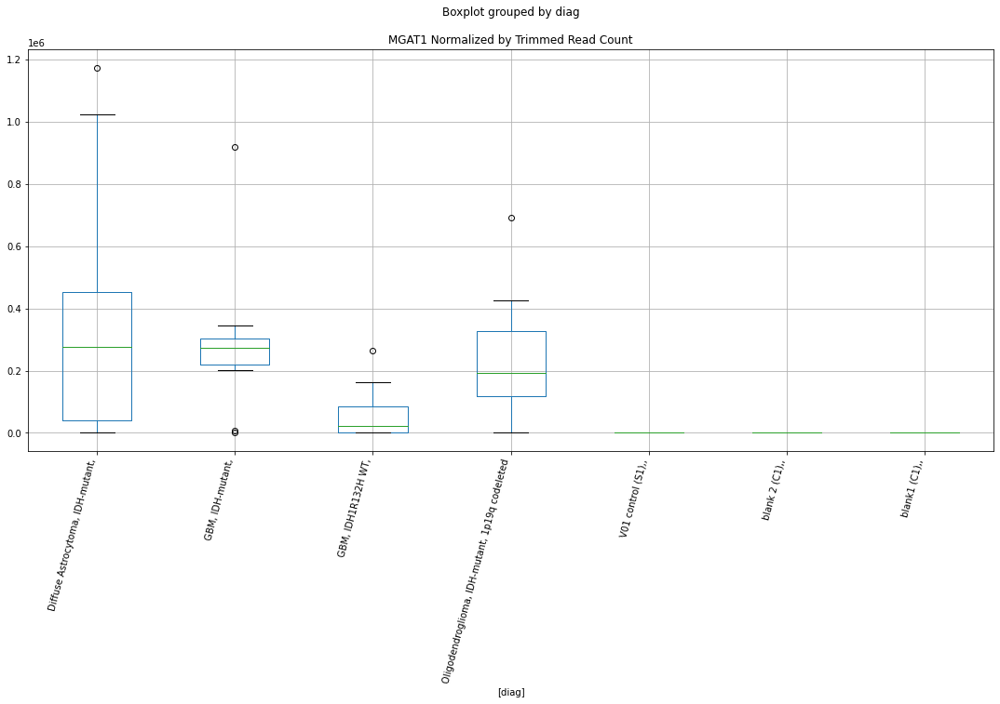

 p : 0.014756928088283265  ( t : 2.6966286221401314 ) :  Lexogen  :  cutadapt2  :  NAXD
Control and blanks
82     39761.43
346        0.00
Name: NAXD, dtype: float64
214    0.0
Name: NAXD, dtype: float64
478    0.0
Name: NAXD, dtype: float64


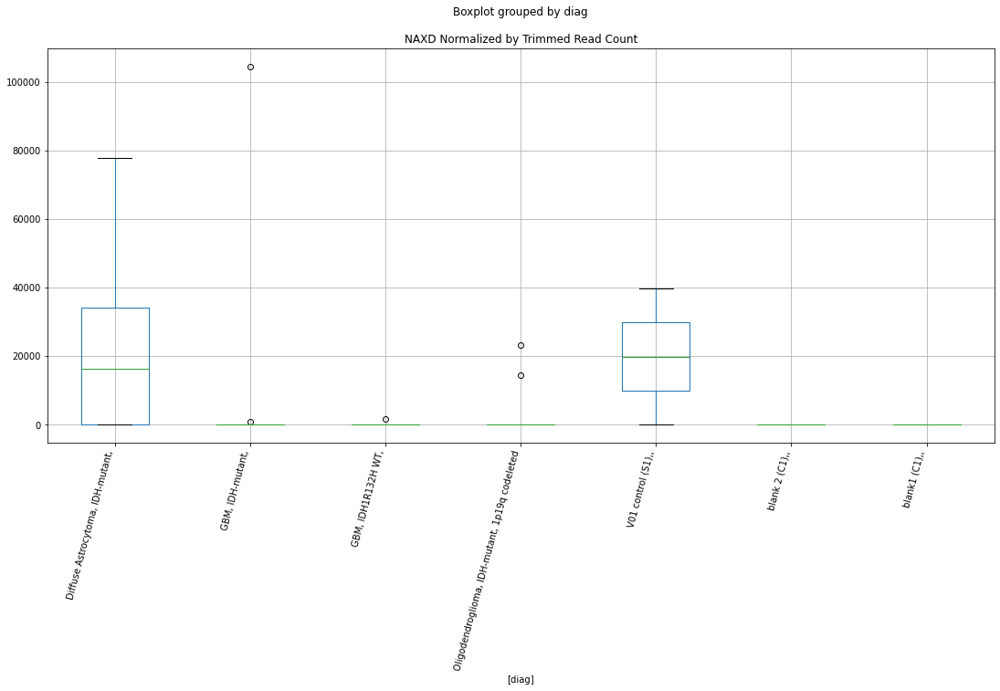

 p : 0.01481932443426325  ( t : 2.694641024449142 ) :  Lexogen  :  bbduk2  :  NAXD
Control and blanks
79     40056.77
343        0.00
Name: NAXD, dtype: float64
211    0.0
Name: NAXD, dtype: float64
475    0.0
Name: NAXD, dtype: float64


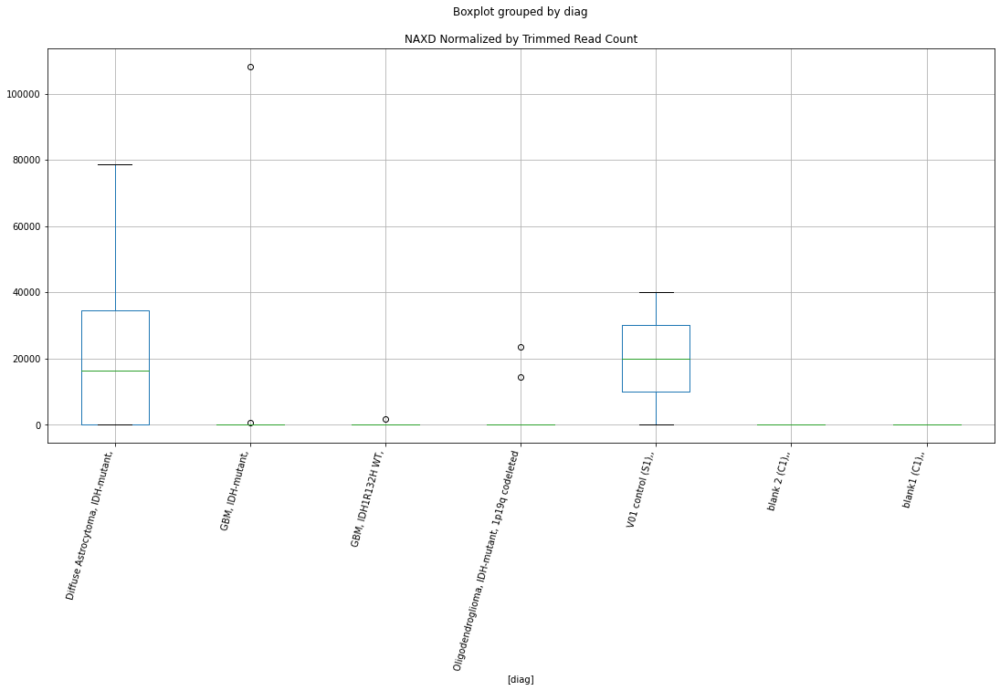

 p : 0.015223774316458128  ( t : 2.681948003134671 ) :  D-plex  :  cutadapt2  :  NID1
Control and blanks
76     0.0
340    0.0
Name: NID1, dtype: float64
208    2116.32
Name: NID1, dtype: float64
472    9247.29
Name: NID1, dtype: float64


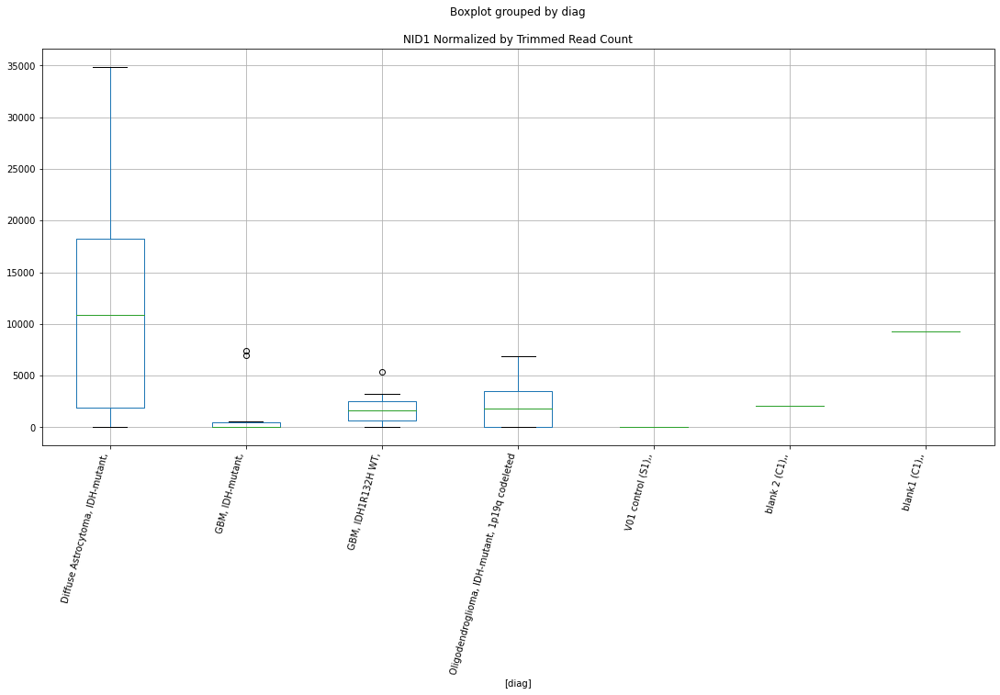

 p : 0.015231181865306736  ( t : 2.681718543018631 ) :  Lexogen  :  cutadapt2  :  MIR146B
Control and blanks
82          0.0
346    135940.7
Name: MIR146B, dtype: float64
214    0.0
Name: MIR146B, dtype: float64
478    0.0
Name: MIR146B, dtype: float64


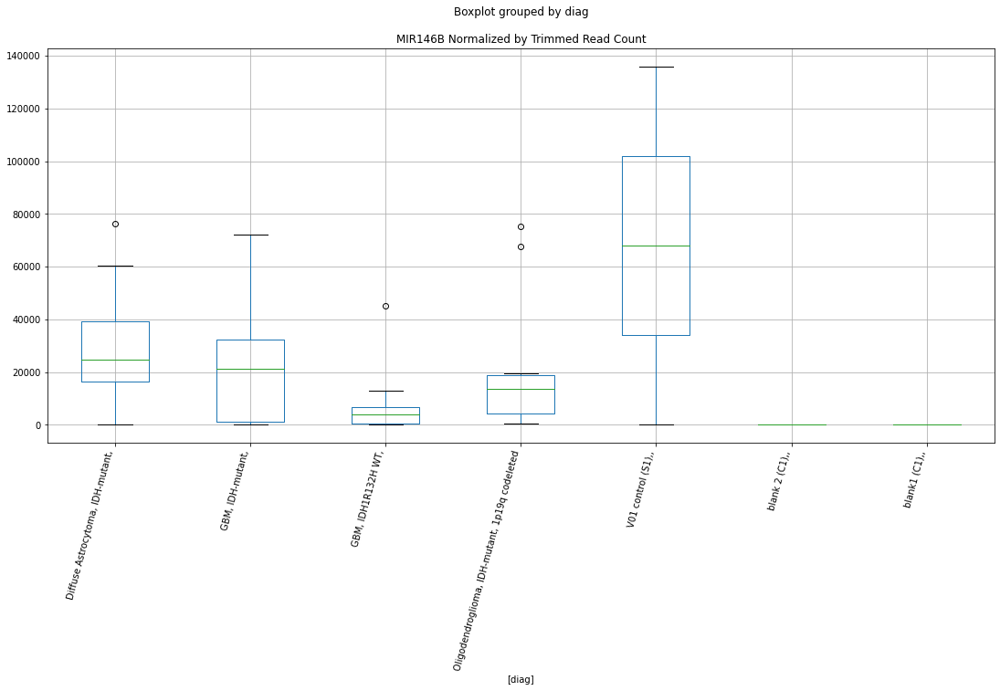

 p : 0.015262970824714017  ( t : 2.68073503883206 ) :  Lexogen  :  cutadapt2  :  NRXN1
Control and blanks
82       0.00
346    841.74
Name: NRXN1, dtype: float64
214    0.0
Name: NRXN1, dtype: float64
478    0.0
Name: NRXN1, dtype: float64


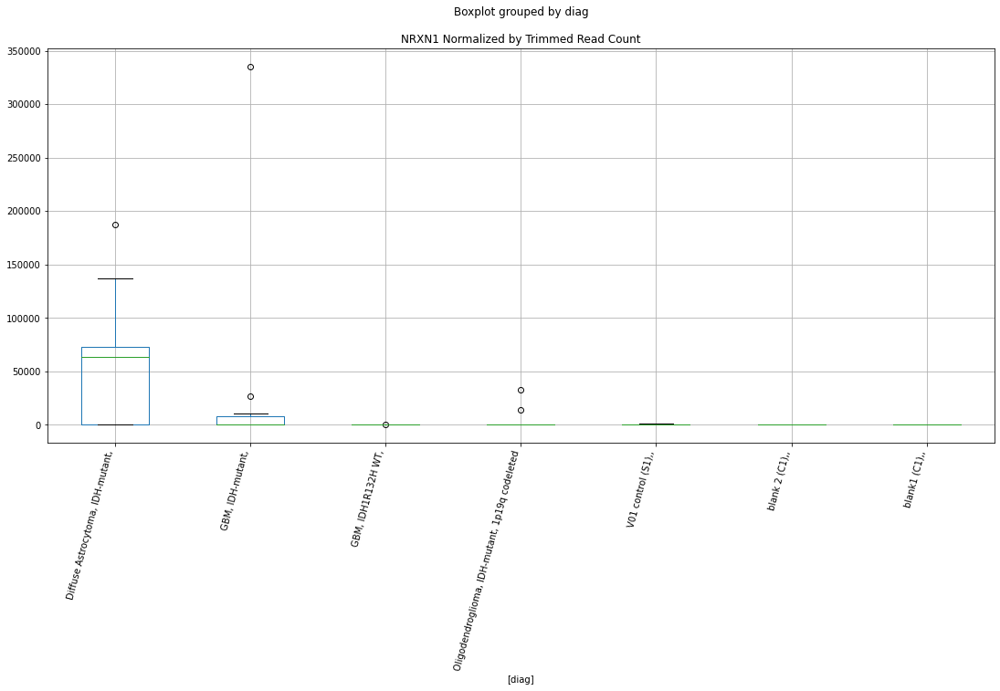

 p : 0.015313847850252195  ( t : 2.679165036823957 ) :  D-plex  :  bbduk2  :  NID1
Control and blanks
73     1546.02
337       0.00
Name: NID1, dtype: float64
205    2149.09
Name: NID1, dtype: float64
469    9464.44
Name: NID1, dtype: float64


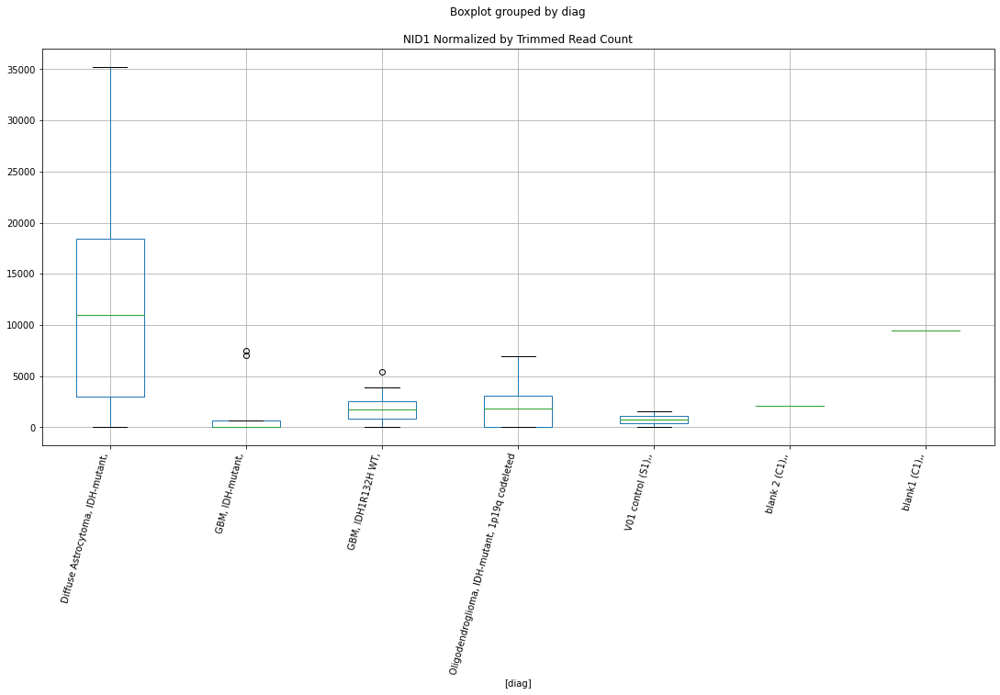

 p : 0.01538058622950196  ( t : 2.6771131001783153 ) :  D-plex  :  bbduk2  :  MUC16
Control and blanks
73      10049.11
337    196724.76
Name: MUC16, dtype: float64
205    73248.2
Name: MUC16, dtype: float64
469    1.91e+06
Name: MUC16, dtype: float64


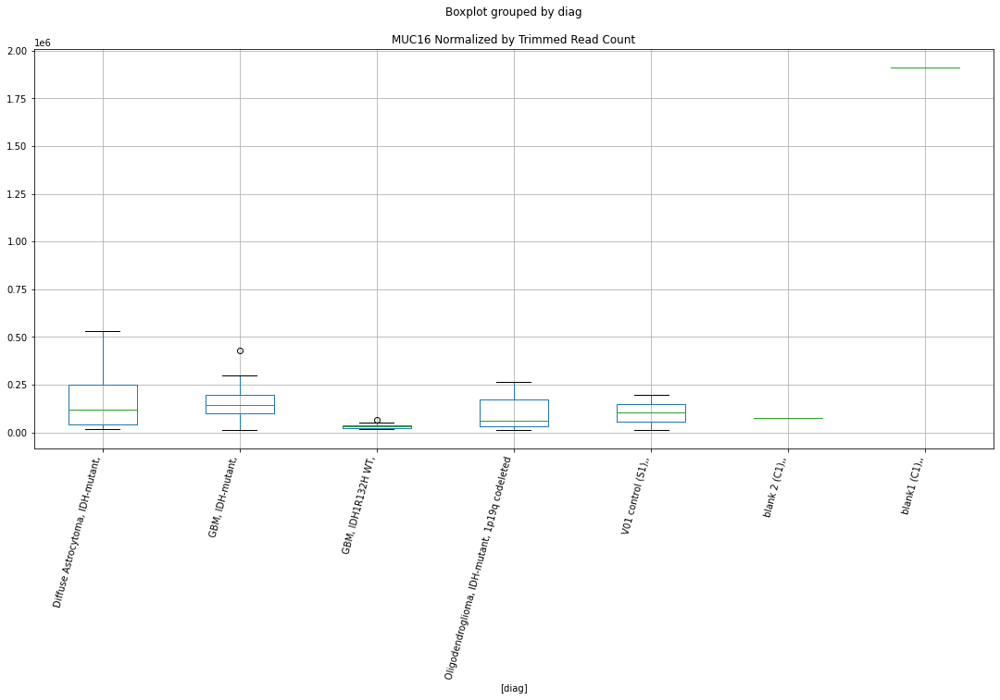

 p : 0.015524830271727914  ( t : 2.672707032814837 ) :  D-plex  :  bbduk2  :  LPP-AS2
Control and blanks
73     0.0
337    0.0
Name: LPP-AS2, dtype: float64
205    0.0
Name: LPP-AS2, dtype: float64
469    0.0
Name: LPP-AS2, dtype: float64


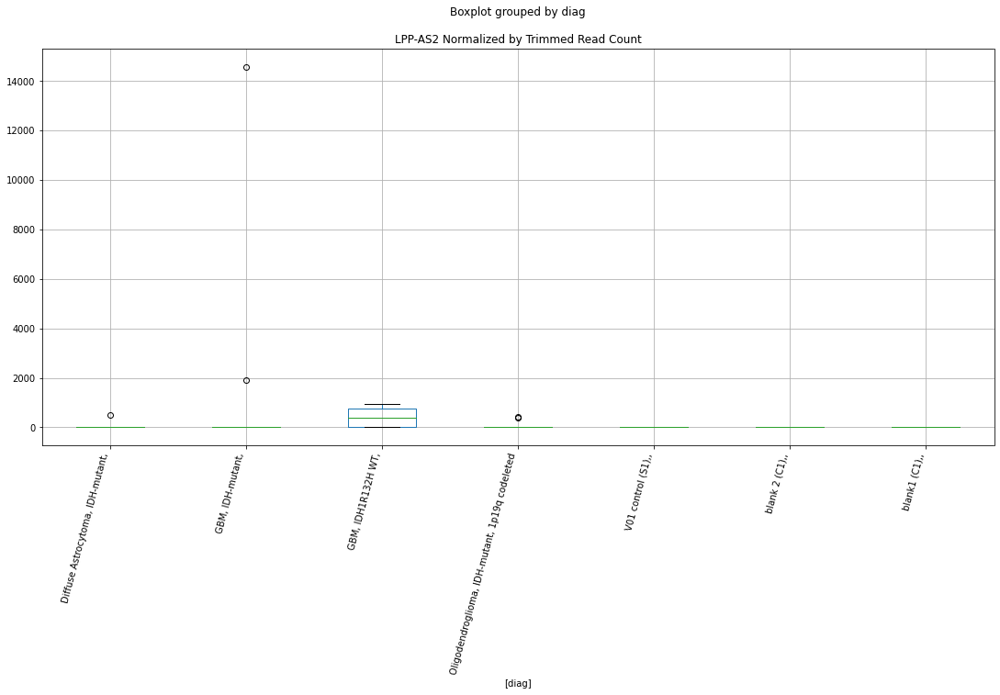

 p : 0.015557434862449345  ( t : 2.6717165061749593 ) :  D-plex  :  cutadapt2  :  LPP-AS2
Control and blanks
76     0.0
340    0.0
Name: LPP-AS2, dtype: float64
208    0.0
Name: LPP-AS2, dtype: float64
472    0.0
Name: LPP-AS2, dtype: float64


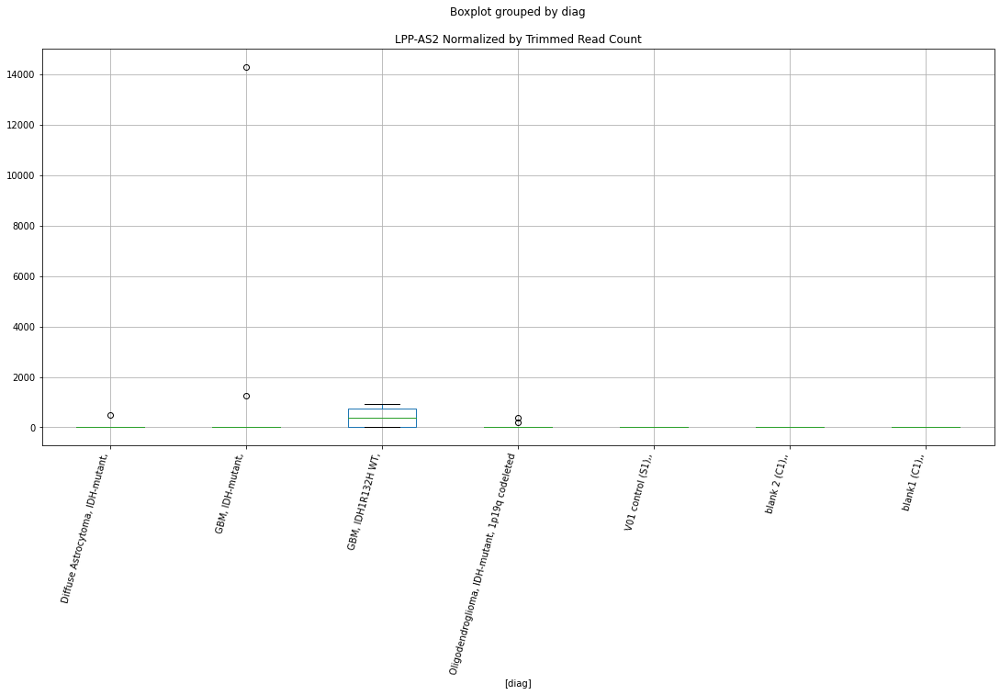

 p : 0.015564793842105846  ( t : 2.6714932143614742 ) :  Lexogen  :  cutadapt2  :  LRRFIP2
Control and blanks
82     0.0
346    0.0
Name: LRRFIP2, dtype: float64
214    0.0
Name: LRRFIP2, dtype: float64
478    0.0
Name: LRRFIP2, dtype: float64


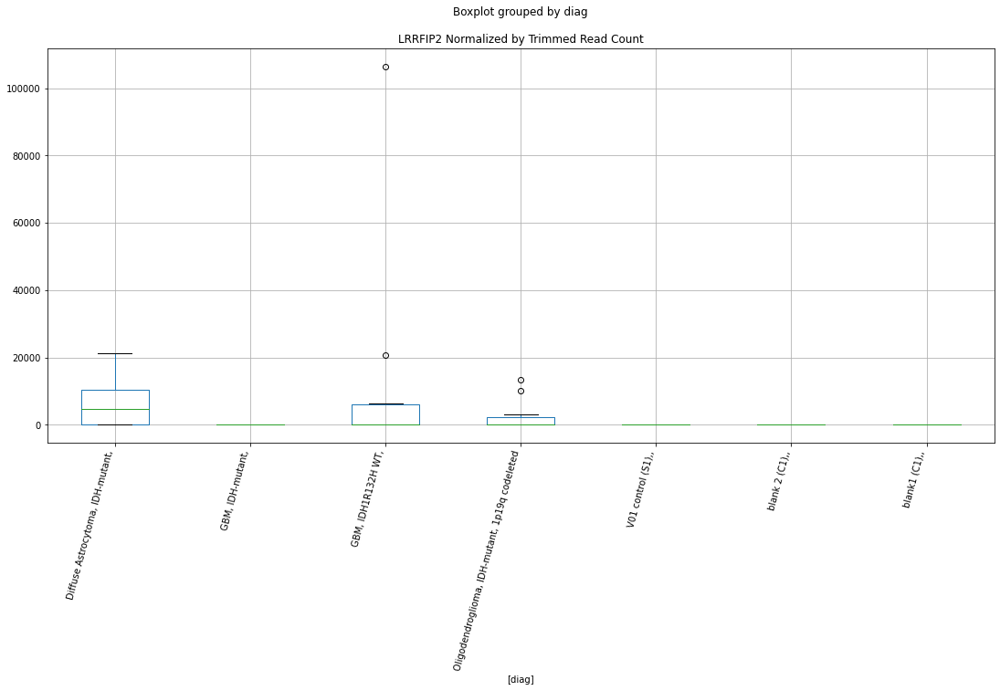

 p : 0.015602125505024591  ( t : 2.670362016553611 ) :  D-plex  :  cutadapt2  :  LPIN3
Control and blanks
76     0.0
340    0.0
Name: LPIN3, dtype: float64
208    6878.05
Name: LPIN3, dtype: float64
472    30631.66
Name: LPIN3, dtype: float64


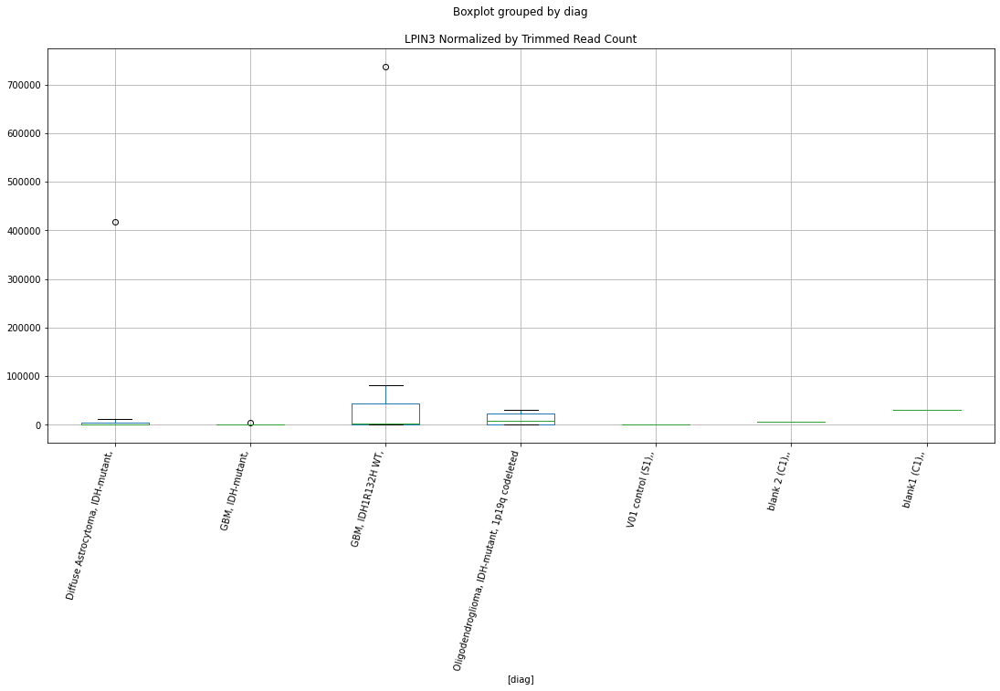

 p : 0.01569881621361443  ( t : 2.6674441160910423 ) :  Lexogen  :  bbduk2  :  MIR146B
Control and blanks
79          0.0
343    136518.1
Name: MIR146B, dtype: float64
211    0.0
Name: MIR146B, dtype: float64
475    0.0
Name: MIR146B, dtype: float64


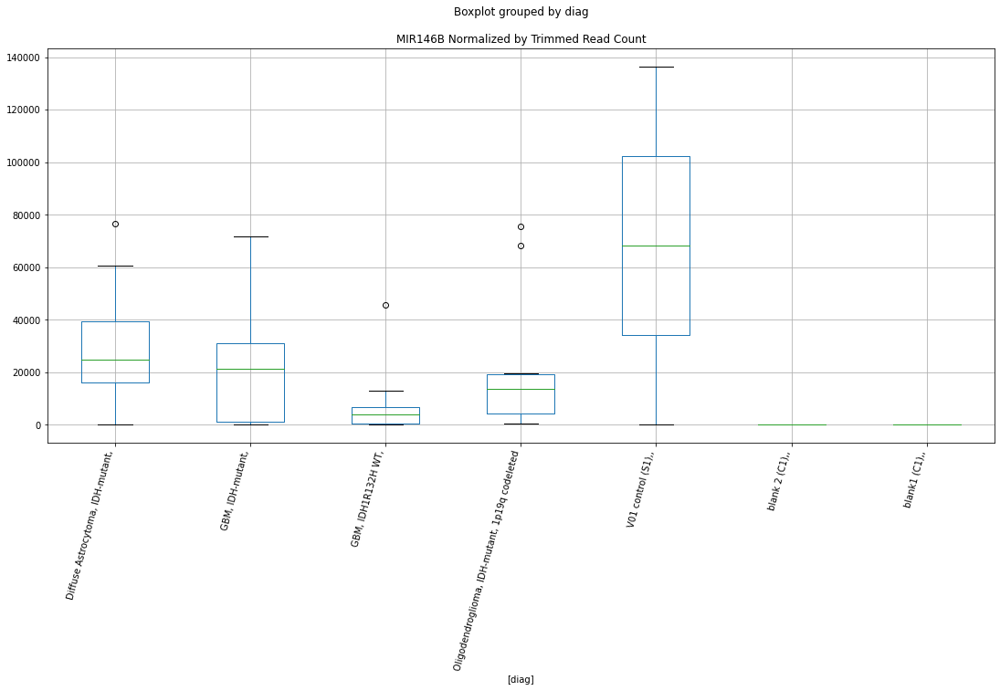

 p : 0.016019343232212695  ( t : 2.6578923836398642 ) :  D-plex  :  bbduk2  :  MYBPC3
Control and blanks
73     0.0
337    0.0
Name: MYBPC3, dtype: float64
205    537.27
Name: MYBPC3, dtype: float64
469    1183.05
Name: MYBPC3, dtype: float64


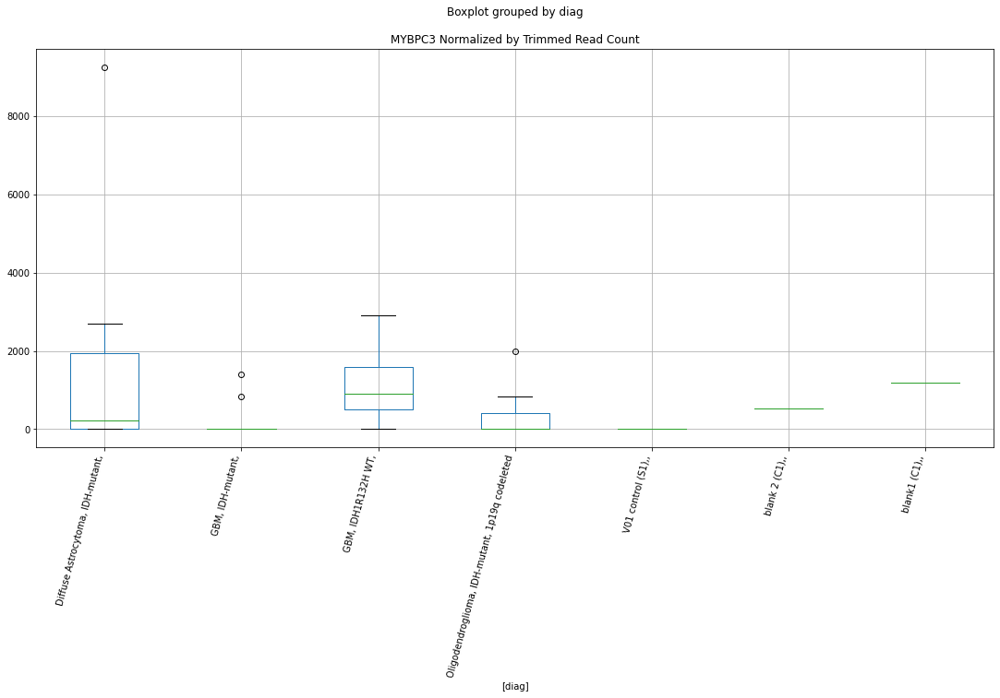

 p : 0.016086575944086794  ( t : 2.6559119648413336 ) :  D-plex  :  bbduk2  :  LRATD1
Control and blanks
73     773.01
337      0.00
Name: LRATD1, dtype: float64
205    2328.18
Name: LRATD1, dtype: float64
469    8872.91
Name: LRATD1, dtype: float64


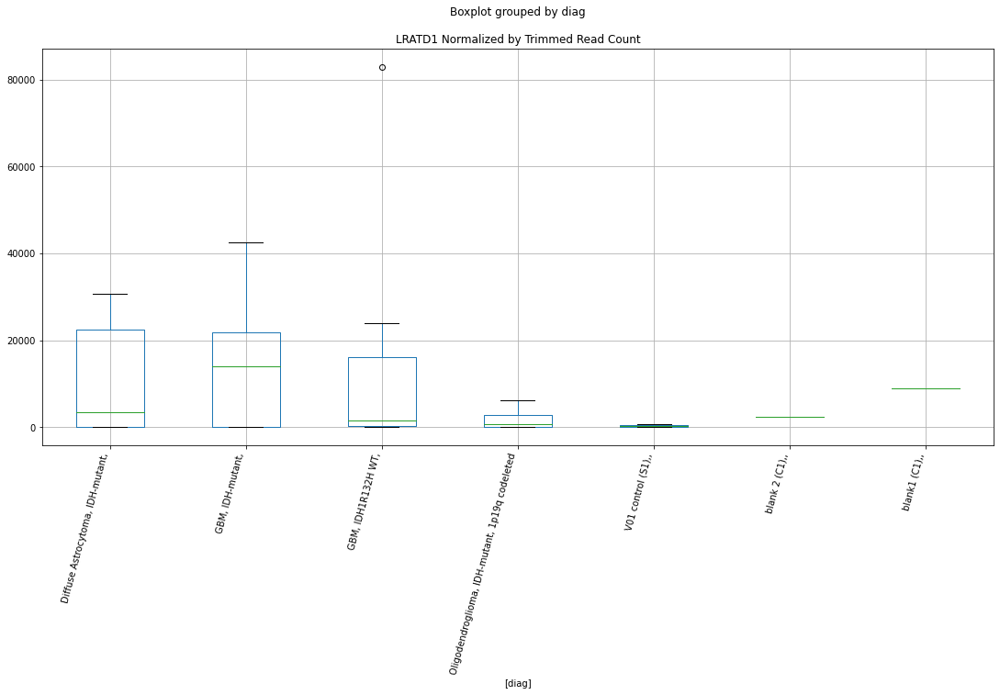

 p : 0.016100395045234174  ( t : 2.6555058838933494 ) :  Lexogen  :  bbduk2  :  MAST1
Control and blanks
79     41487.36
343    15711.26
Name: MAST1, dtype: float64
211    20224.67
Name: MAST1, dtype: float64
475    45507.99
Name: MAST1, dtype: float64


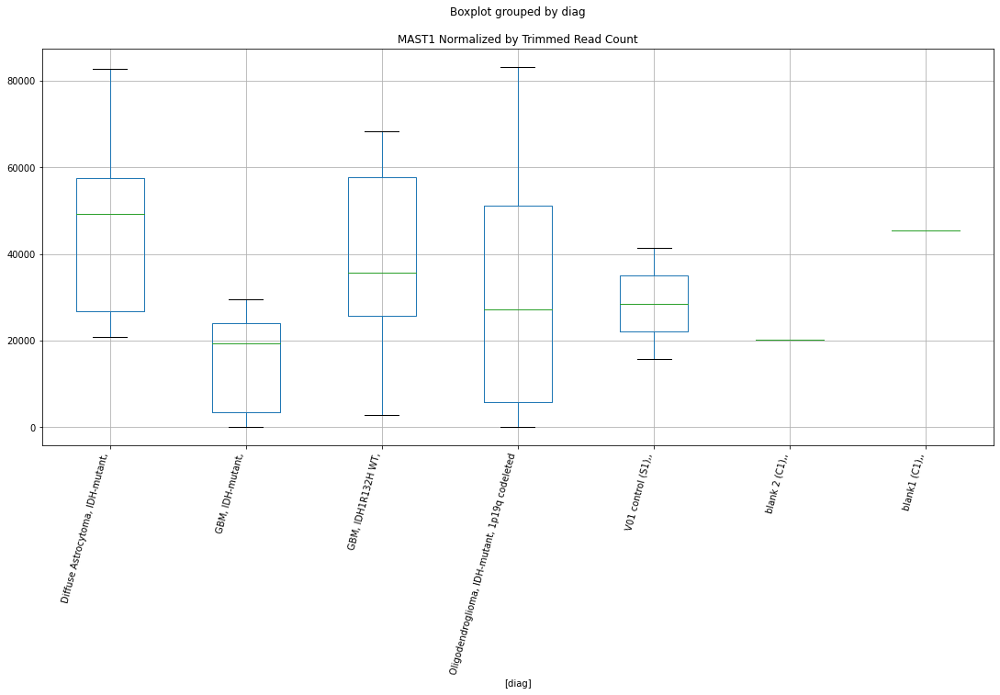

 p : 0.016240742497977075  ( t : 2.6514004085104563 ) :  D-plex  :  bbduk2  :  MLKL
Control and blanks
73        0.00
337    9791.73
Name: MLKL, dtype: float64
205    1790.91
Name: MLKL, dtype: float64
469    5915.27
Name: MLKL, dtype: float64


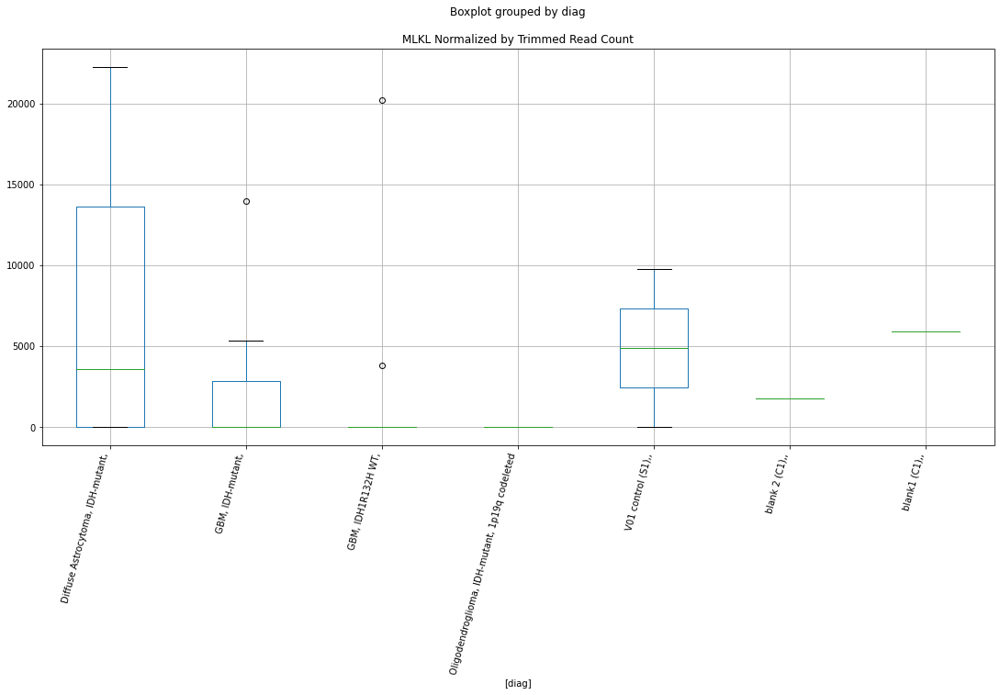

 p : 0.01694040328356534  ( t : 2.6314246509001555 ) :  D-plex  :  cutadapt2  :  LPP-AS2
Control and blanks
76     0.0
340    0.0
Name: LPP-AS2, dtype: float64
208    0.0
Name: LPP-AS2, dtype: float64
472    0.0
Name: LPP-AS2, dtype: float64


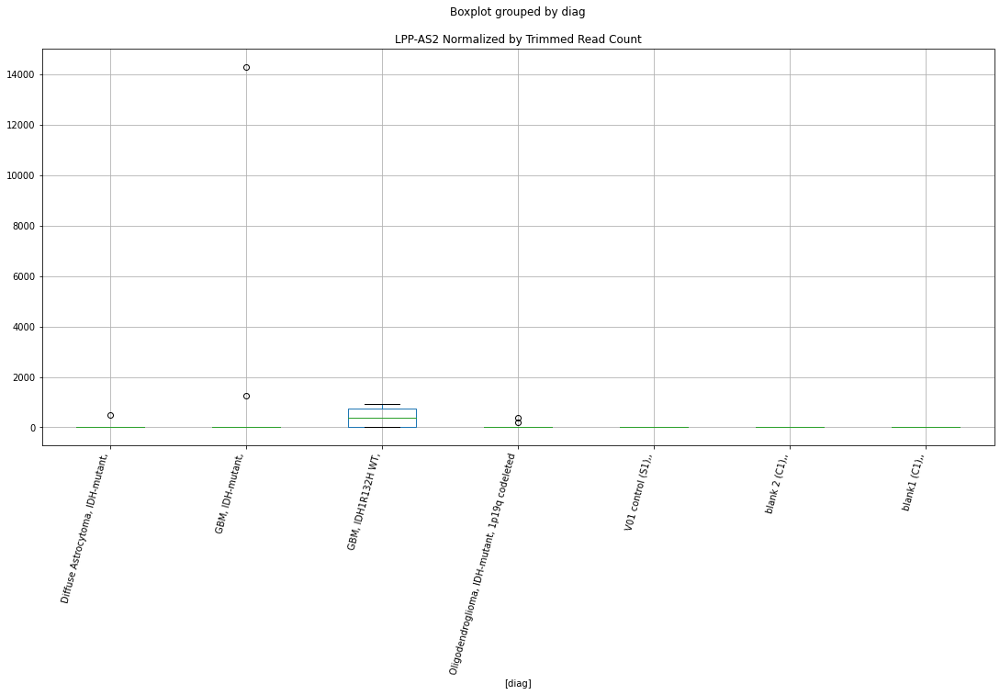

 p : 0.01749956370089044  ( t : 2.616016608683996 ) :  D-plex  :  bbduk2  :  NSUN7
Control and blanks
73     0.0
337    0.0
Name: NSUN7, dtype: float64
205    3581.82
Name: NSUN7, dtype: float64
469    4732.22
Name: NSUN7, dtype: float64


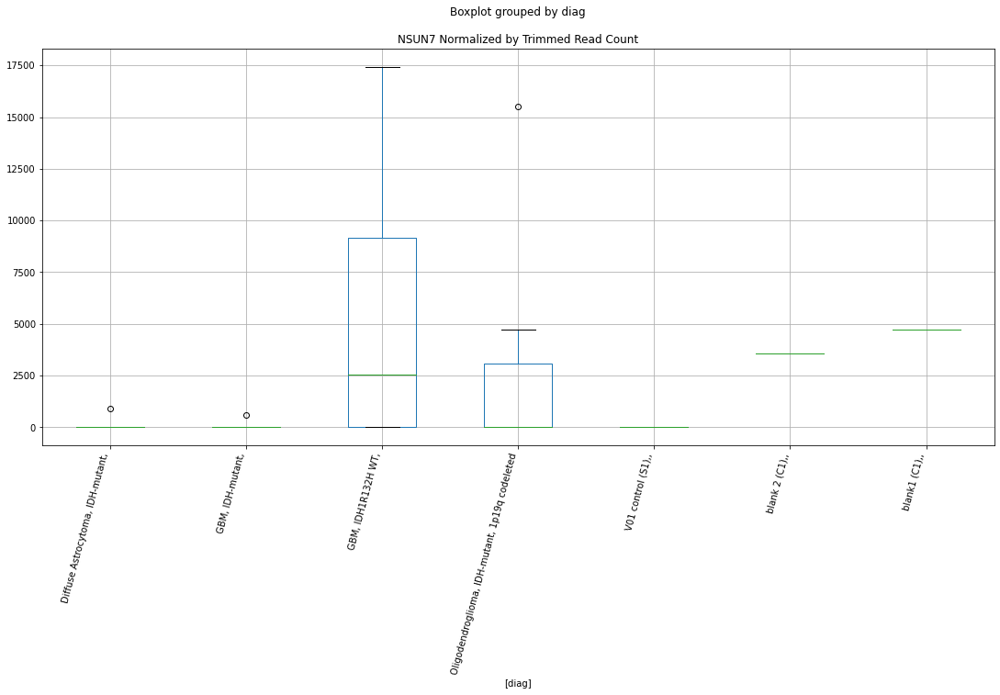

 p : 0.01750336169402984  ( t : 2.61591356108961 ) :  D-plex  :  bbduk2  :  OPN1MW
Control and blanks
73     0.0
337    0.0
Name: OPN1MW, dtype: float64
205    179.09
Name: OPN1MW, dtype: float64
469    0.0
Name: OPN1MW, dtype: float64


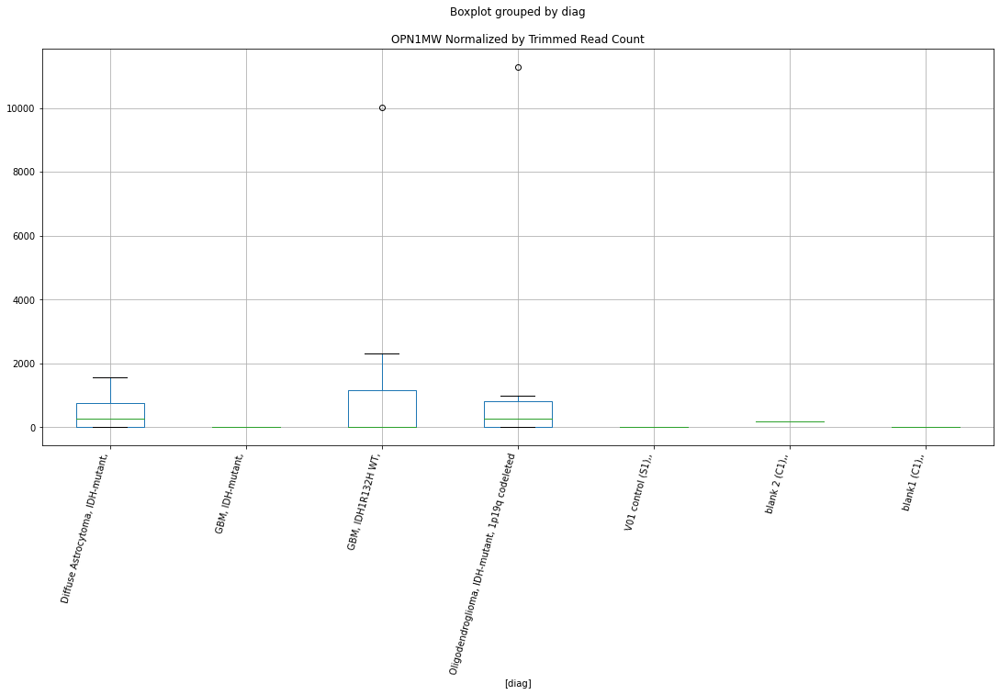

 p : 0.017657022554168286  ( t : 2.61176213013609 ) :  Lexogen  :  cutadapt2  :  MAST1
Control and blanks
82     41181.48
346    15782.59
Name: MAST1, dtype: float64
214    20070.76
Name: MAST1, dtype: float64
478    45117.49
Name: MAST1, dtype: float64


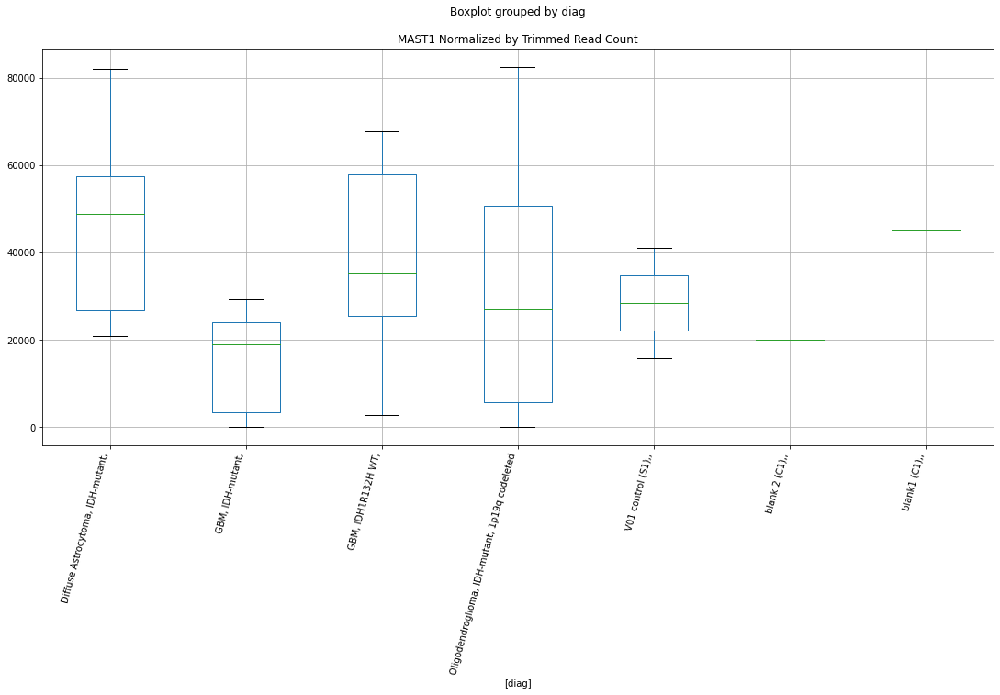

 p : 0.017716967776315203  ( t : 2.610151897837889 ) :  Lexogen  :  bbduk2  :  MPPED1
Control and blanks
79     0.0
343    0.0
Name: MPPED1, dtype: float64
211    0.0
Name: MPPED1, dtype: float64
475    0.0
Name: MPPED1, dtype: float64


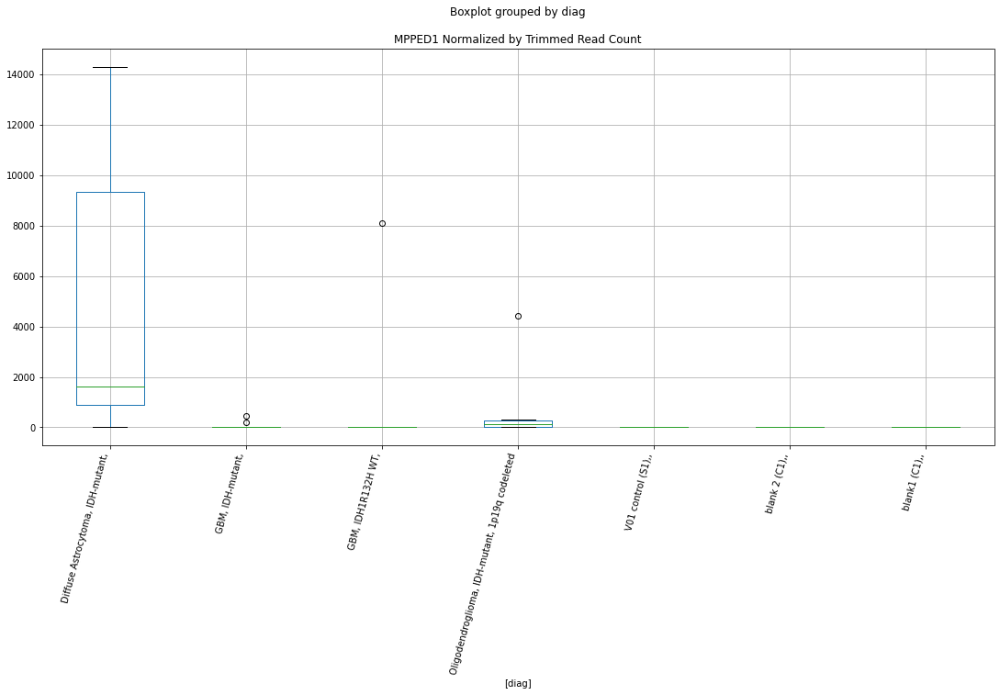

 p : 0.017739230594256687  ( t : 2.6095551973720092 ) :  D-plex  :  bbduk2  :  LOC112268317
Control and blanks
73     0.0
337    0.0
Name: LOC112268317, dtype: float64
205    5014.55
Name: LOC112268317, dtype: float64
469    7689.86
Name: LOC112268317, dtype: float64


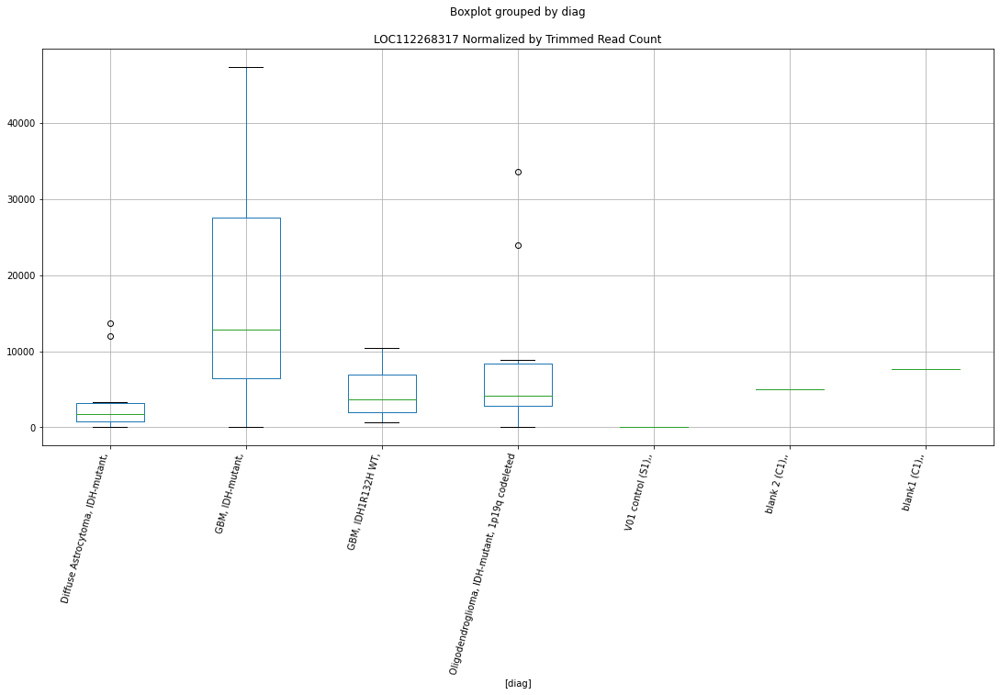

 p : 0.01775151971359744  ( t : 2.6092261220884194 ) :  D-plex  :  cutadapt2  :  OPN1MW
Control and blanks
76     0.0
340    0.0
Name: OPN1MW, dtype: float64
208    176.36
Name: OPN1MW, dtype: float64
472    0.0
Name: OPN1MW, dtype: float64


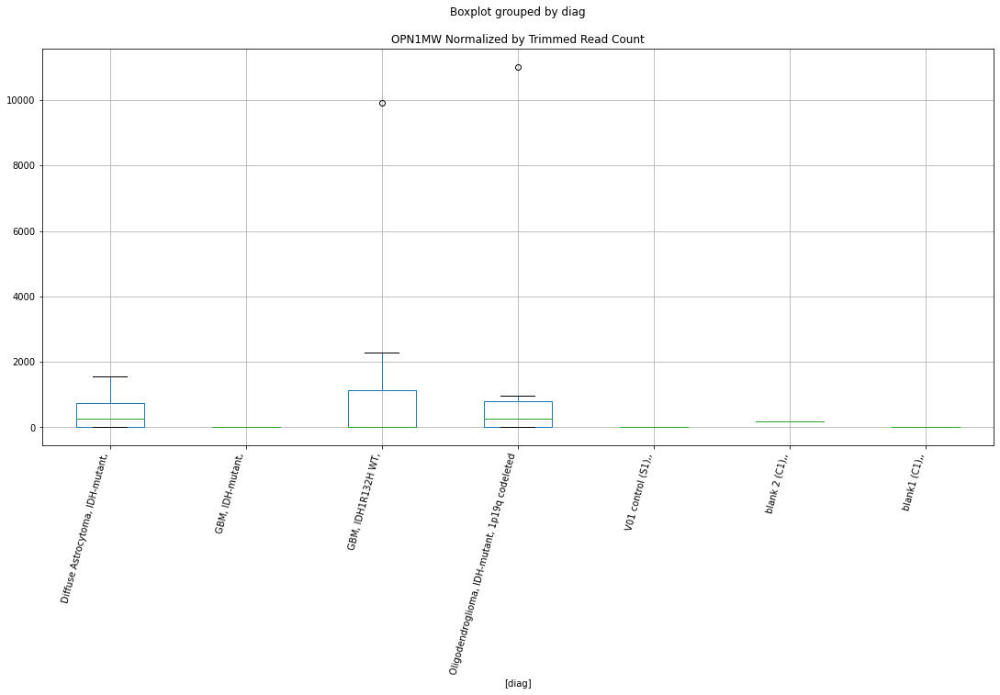

 p : 0.01777299974244769  ( t : 2.60865145386335 ) :  D-plex  :  cutadapt2  :  MAPT-IT1
Control and blanks
76     0.0
340    0.0
Name: MAPT-IT1, dtype: float64
208    529.08
Name: MAPT-IT1, dtype: float64
472    1155.91
Name: MAPT-IT1, dtype: float64


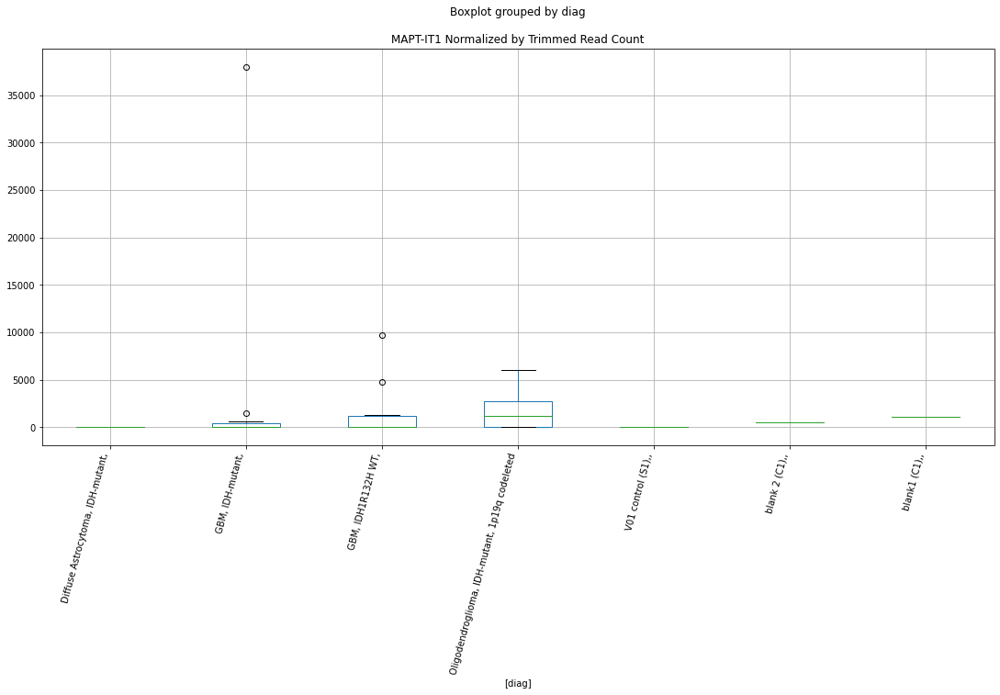

 p : 0.017896300932784572  ( t : 2.6053654054478104 ) :  D-plex  :  cutadapt2  :  MLKL
Control and blanks
76     0.0
340    0.0
Name: MLKL, dtype: float64
208    1763.6
Name: MLKL, dtype: float64
472    5779.56
Name: MLKL, dtype: float64


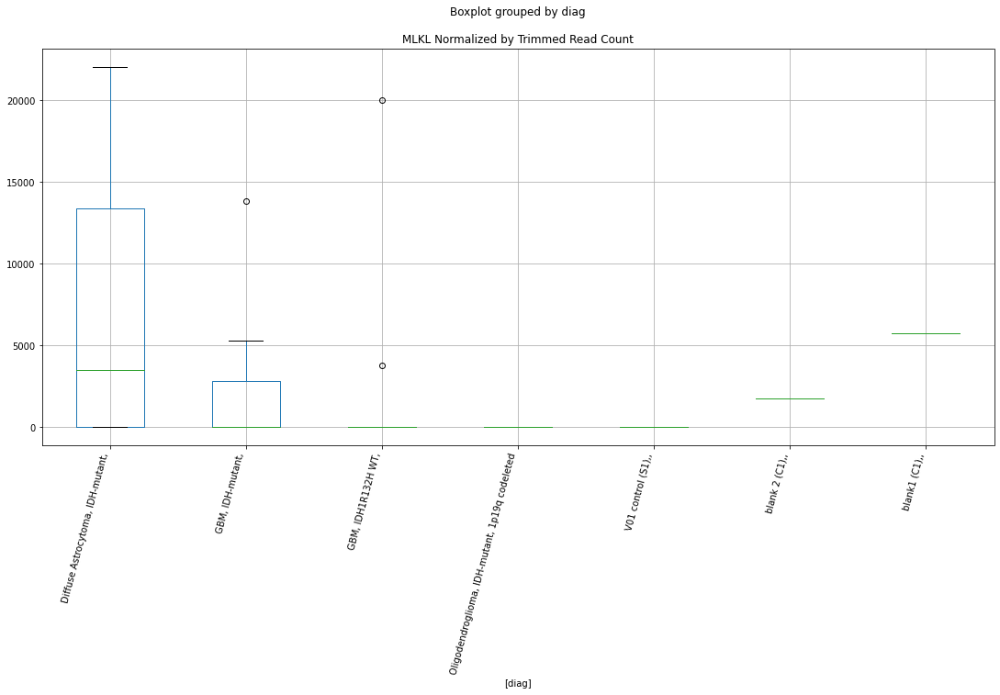

 p : 0.018216952586518963  ( t : 2.5969194307028456 ) :  D-plex  :  bbduk2  :  NSUN7
Control and blanks
73     0.0
337    0.0
Name: NSUN7, dtype: float64
205    3581.82
Name: NSUN7, dtype: float64
469    4732.22
Name: NSUN7, dtype: float64


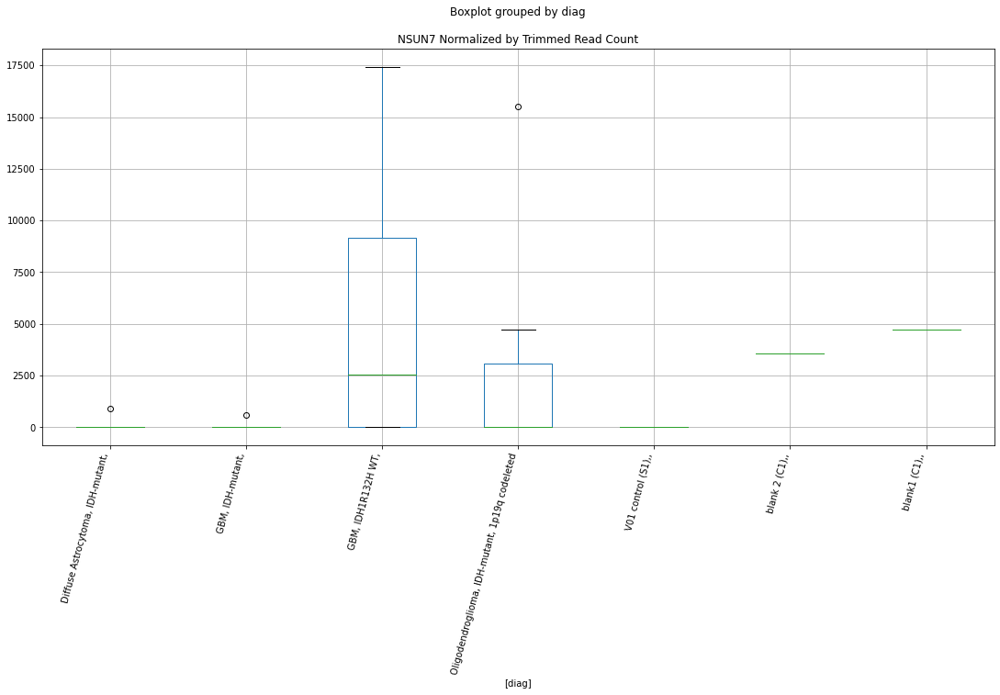

 p : 0.018306398684041433  ( t : 2.5945885807370037 ) :  D-plex  :  cutadapt2  :  LOC107986613
Control and blanks
76       0.00
340    880.73
Name: LOC107986613, dtype: float64
208    352.72
Name: LOC107986613, dtype: float64
472    0.0
Name: LOC107986613, dtype: float64


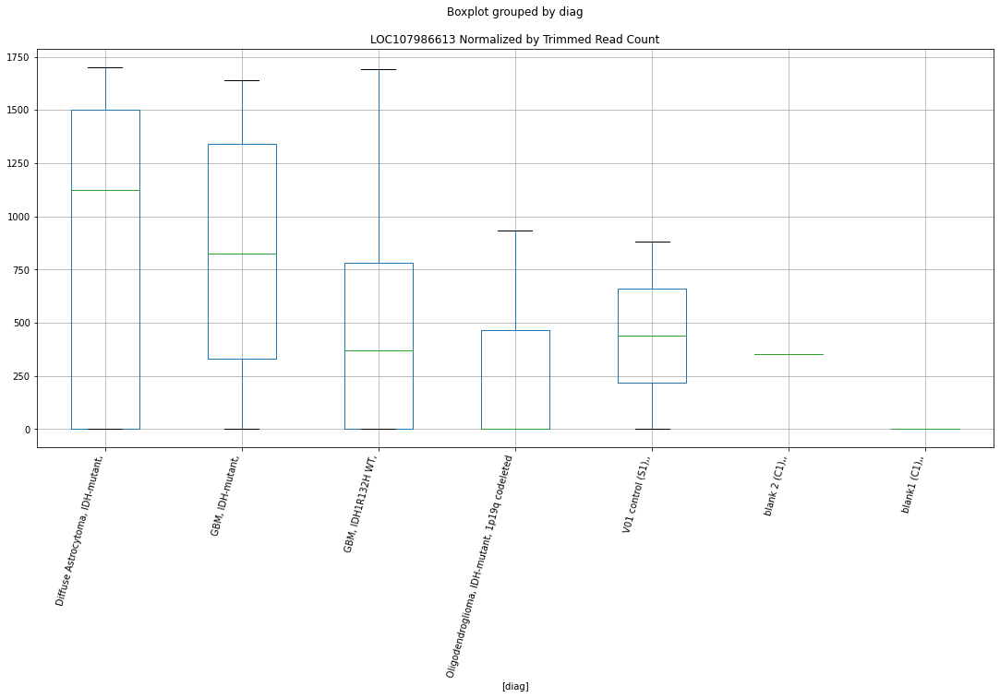

 p : 0.018380334322750526  ( t : 2.5926700552706996 ) :  D-plex  :  bbduk2  :  LOC107986990
Control and blanks
73       773.01
337    38276.76
Name: LOC107986990, dtype: float64
205    895.45
Name: LOC107986990, dtype: float64
469    1183.05
Name: LOC107986990, dtype: float64


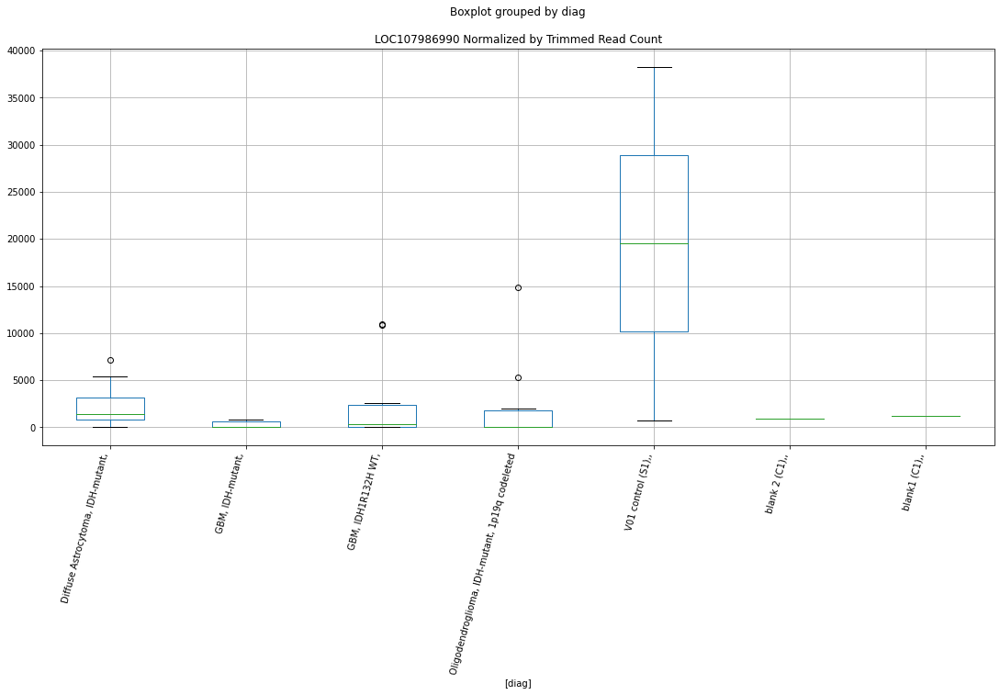

 p : 0.018469112571735367  ( t : 2.590376033517624 ) :  D-plex  :  bbduk2  :  LOC107986613
Control and blanks
73       0.00
337    890.16
Name: LOC107986613, dtype: float64
205    358.18
Name: LOC107986613, dtype: float64
469    0.0
Name: LOC107986613, dtype: float64


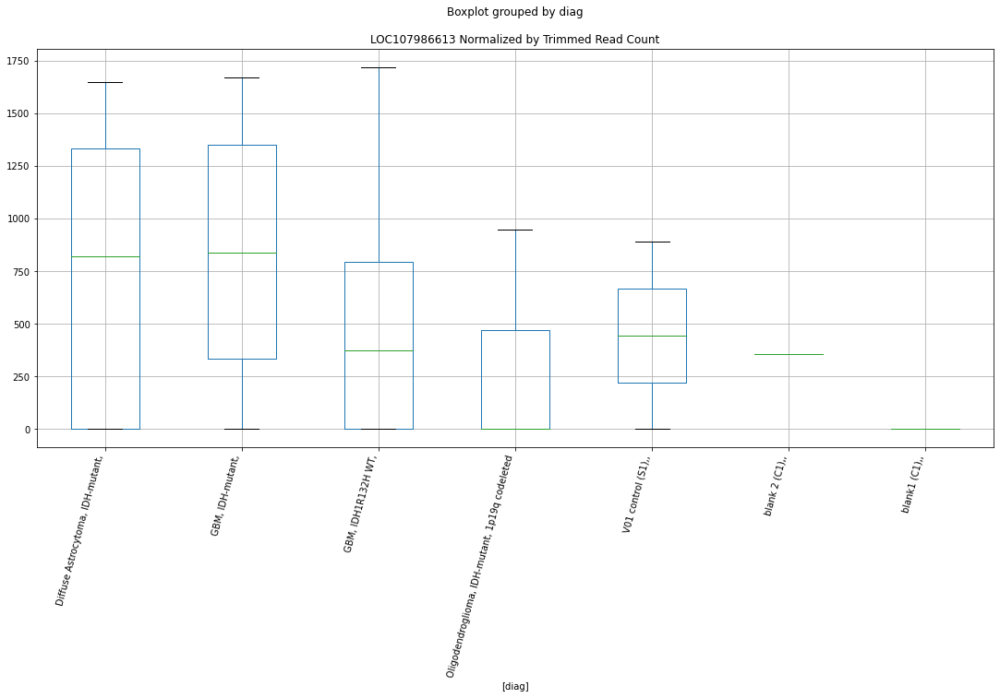

 p : 0.01851886776189623  ( t : 2.589094932914407 ) :  Lexogen  :  cutadapt2  :  LOC107986476
Control and blanks
82     0.0
346    0.0
Name: LOC107986476, dtype: float64
214    0.0
Name: LOC107986476, dtype: float64
478    0.0
Name: LOC107986476, dtype: float64


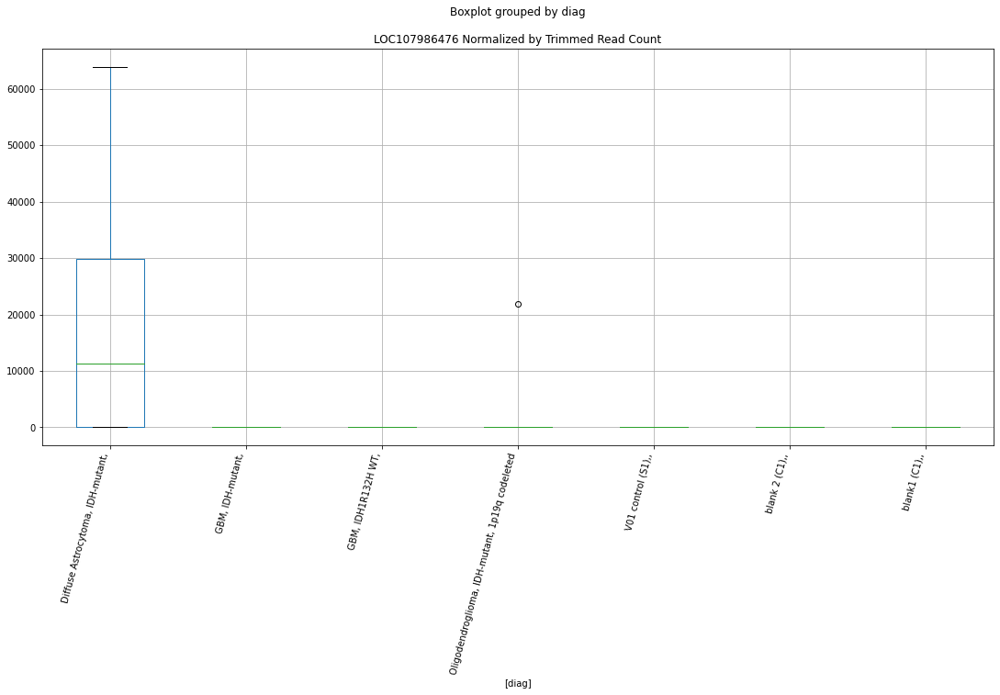

 p : 0.018576110103865  ( t : 2.587625084093558 ) :  D-plex  :  bbduk2  :  MSI2
Control and blanks
73     13914.15
337    37386.61
Name: MSI2, dtype: float64
205    23460.91
Name: MSI2, dtype: float64
469    39632.33
Name: MSI2, dtype: float64


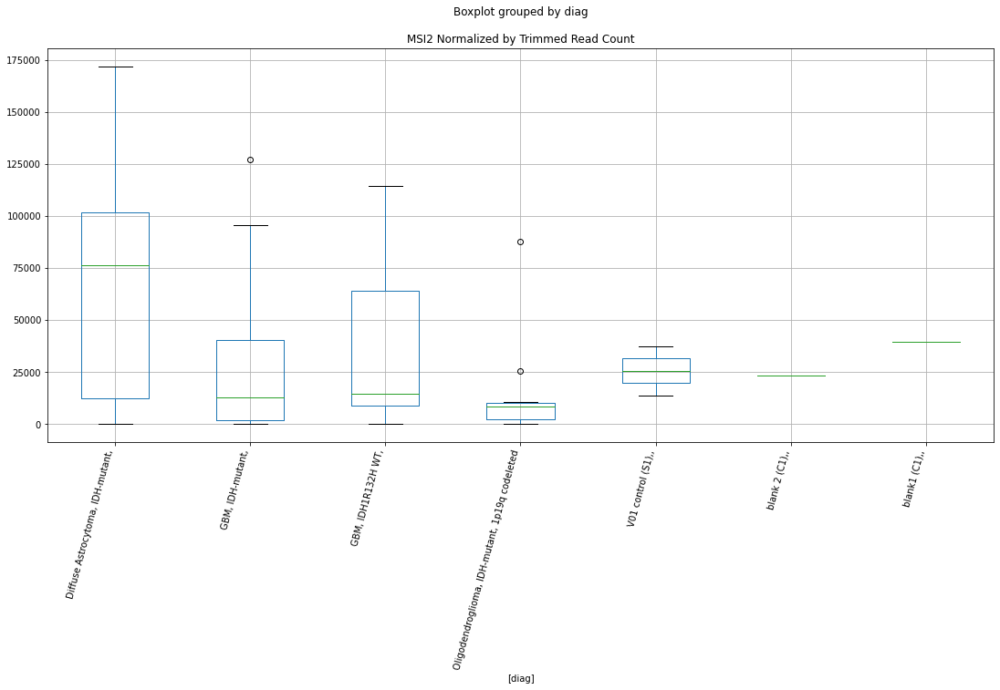

 p : 0.018700733535627154  ( t : 2.584439843710494 ) :  D-plex  :  bbduk2  :  LOC112268261
Control and blanks
73     773.01
337      0.00
Name: LOC112268261, dtype: float64
205    537.27
Name: LOC112268261, dtype: float64
469    0.0
Name: LOC112268261, dtype: float64


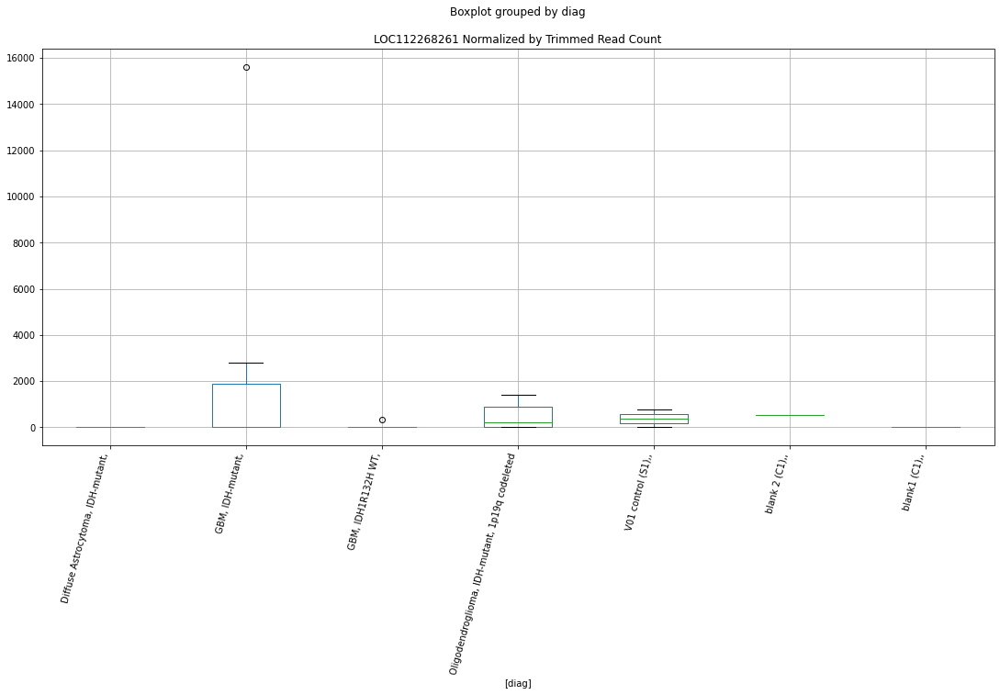

 p : 0.018759046502571666  ( t : 2.582956332454687 ) :  D-plex  :  cutadapt2  :  MYO1C
Control and blanks
76     40911.17
340     5284.39
Name: MYO1C, dtype: float64
208    121688.55
Name: MYO1C, dtype: float64
472    55483.76
Name: MYO1C, dtype: float64


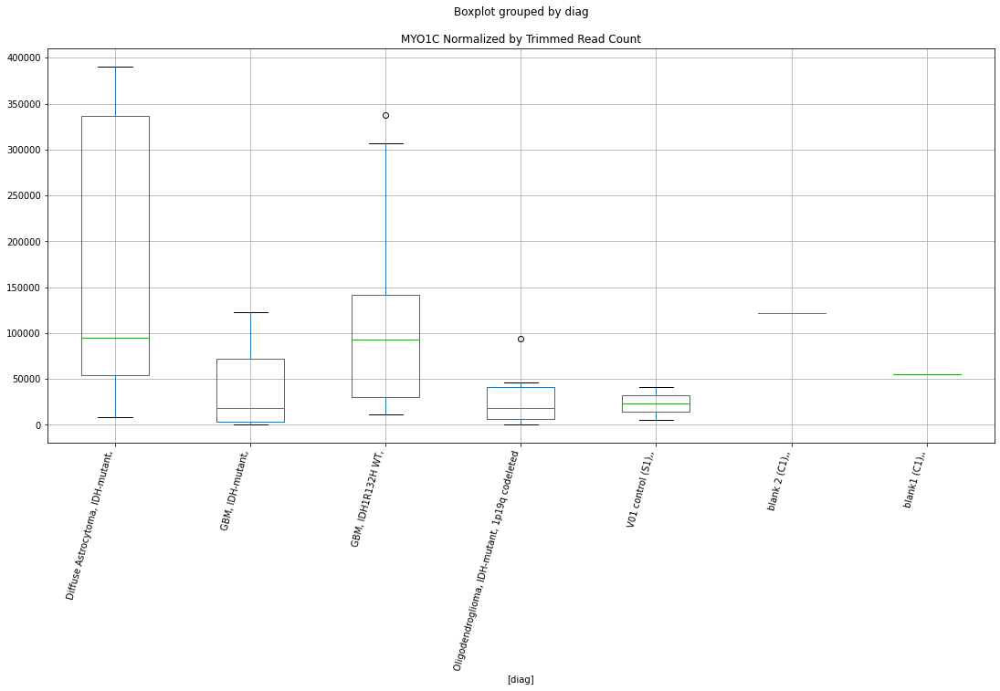

 p : 0.018886740958931777  ( t : 2.5797229287425574 ) :  Lexogen  :  bbduk2  :  MIR101-2
Control and blanks
79     0.0
343    0.0
Name: MIR101-2, dtype: float64
211    0.0
Name: MIR101-2, dtype: float64
475    0.0
Name: MIR101-2, dtype: float64


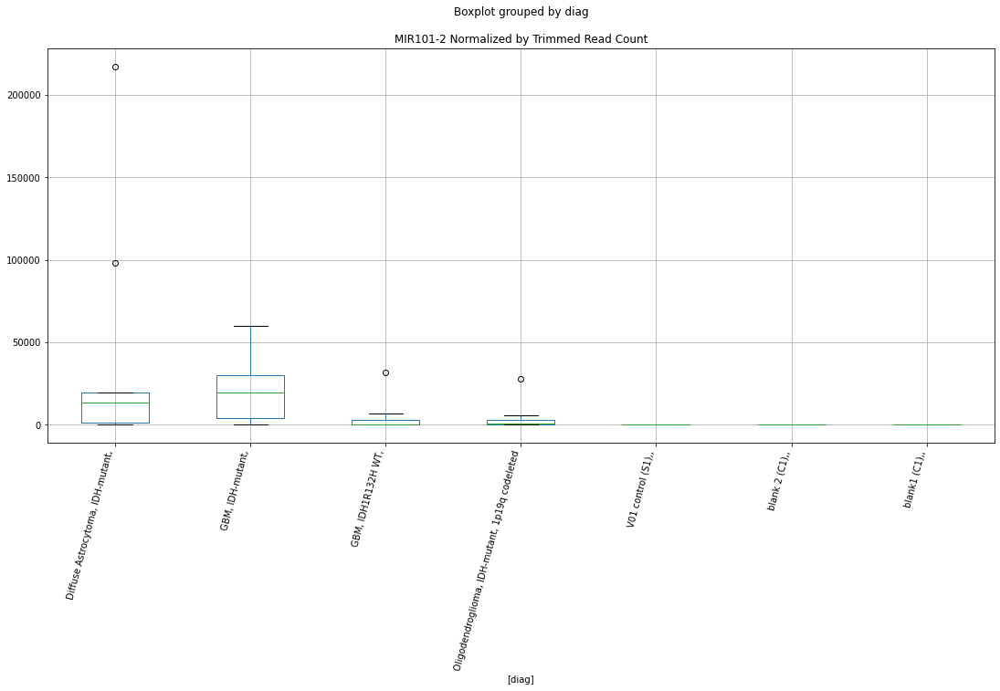

 p : 0.018994064443815527  ( t : 2.577021330945379 ) :  Lexogen  :  cutadapt2  :  MIR101-2
Control and blanks
82     0.0
346    0.0
Name: MIR101-2, dtype: float64
214    0.0
Name: MIR101-2, dtype: float64
478    0.0
Name: MIR101-2, dtype: float64


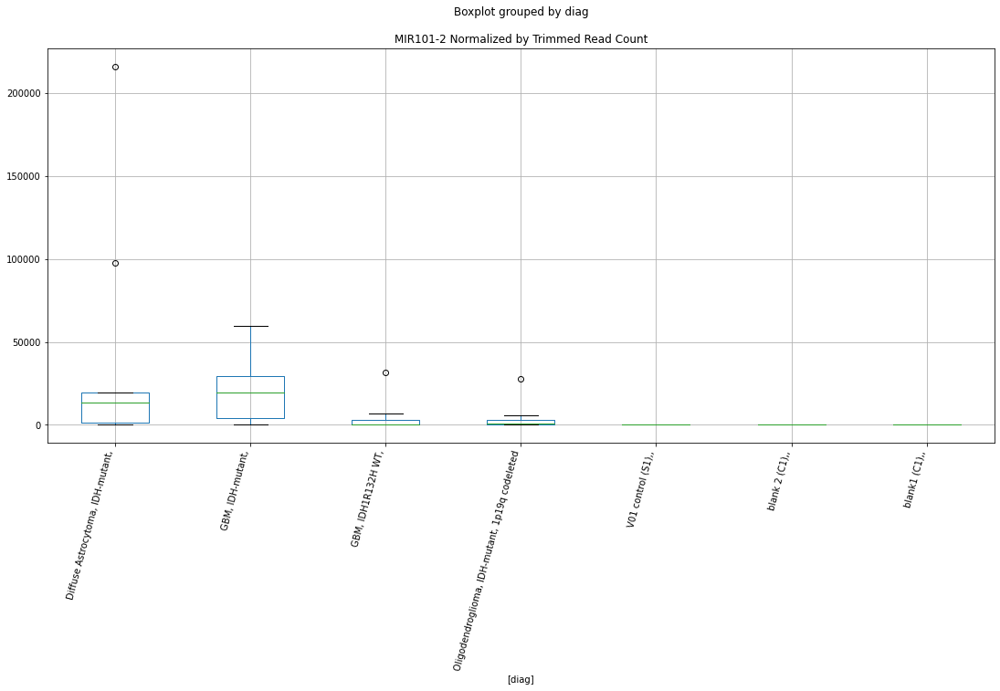

 p : 0.01901300413488351  ( t : 2.57654607410875 ) :  D-plex  :  bbduk2  :  MPPED2
Control and blanks
73     1546.02
337     890.16
Name: MPPED2, dtype: float64
205    6089.09
Name: MPPED2, dtype: float64
469    14788.18
Name: MPPED2, dtype: float64


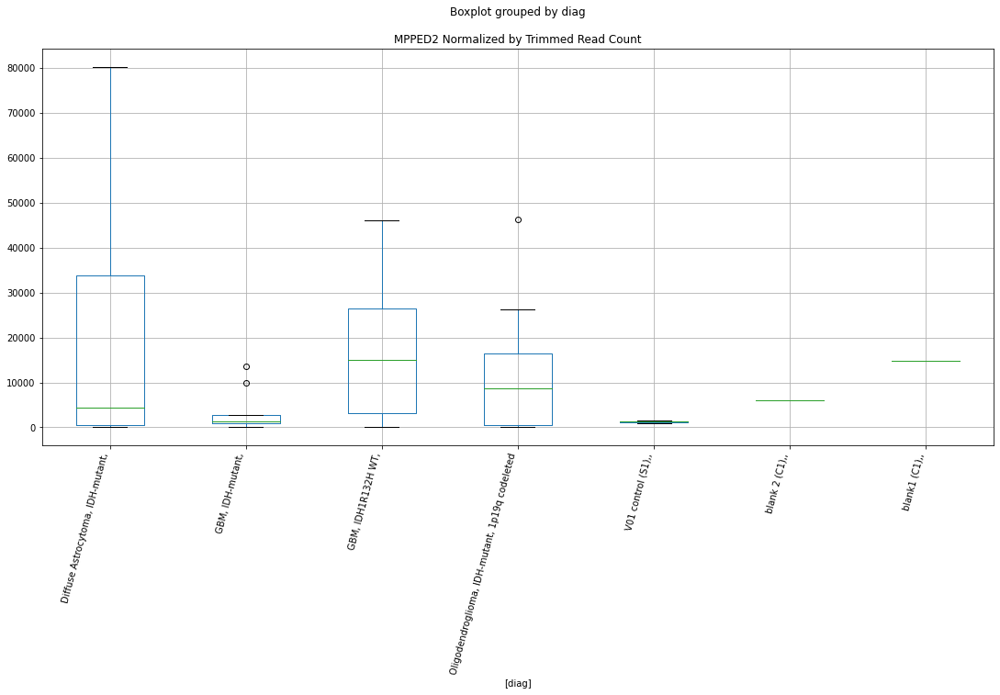

 p : 0.019221600106415628  ( t : 2.5713412088863685 ) :  Lexogen  :  bbduk2  :  MIR185
Control and blanks
79     1430.6
343       0.0
Name: MIR185, dtype: float64
211    0.0
Name: MIR185, dtype: float64
475    9580.63
Name: MIR185, dtype: float64


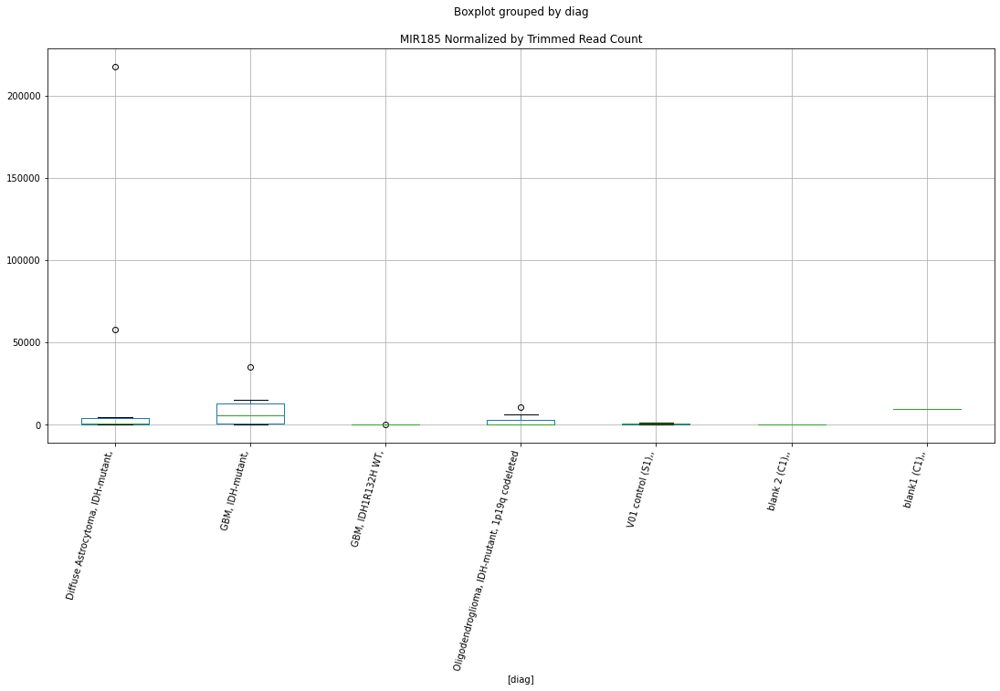

 p : 0.019302666562995934  ( t : 2.569332871905852 ) :  D-plex  :  cutadapt2  :  NID1
Control and blanks
76     0.0
340    0.0
Name: NID1, dtype: float64
208    2116.32
Name: NID1, dtype: float64
472    9247.29
Name: NID1, dtype: float64


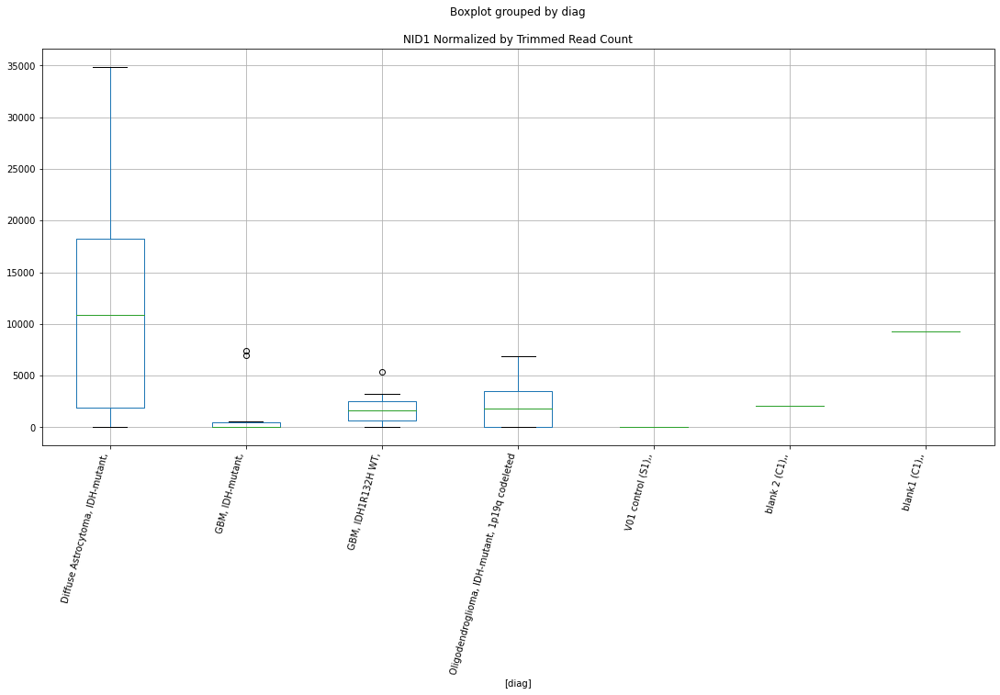

 p : 0.019673174064170074  ( t : 2.5602544227638453 ) :  D-plex  :  cutadapt2  :  LOC389834
Control and blanks
76      3030.46
340    13210.98
Name: LOC389834, dtype: float64
208    26454.03
Name: LOC389834, dtype: float64
472    29475.75
Name: LOC389834, dtype: float64


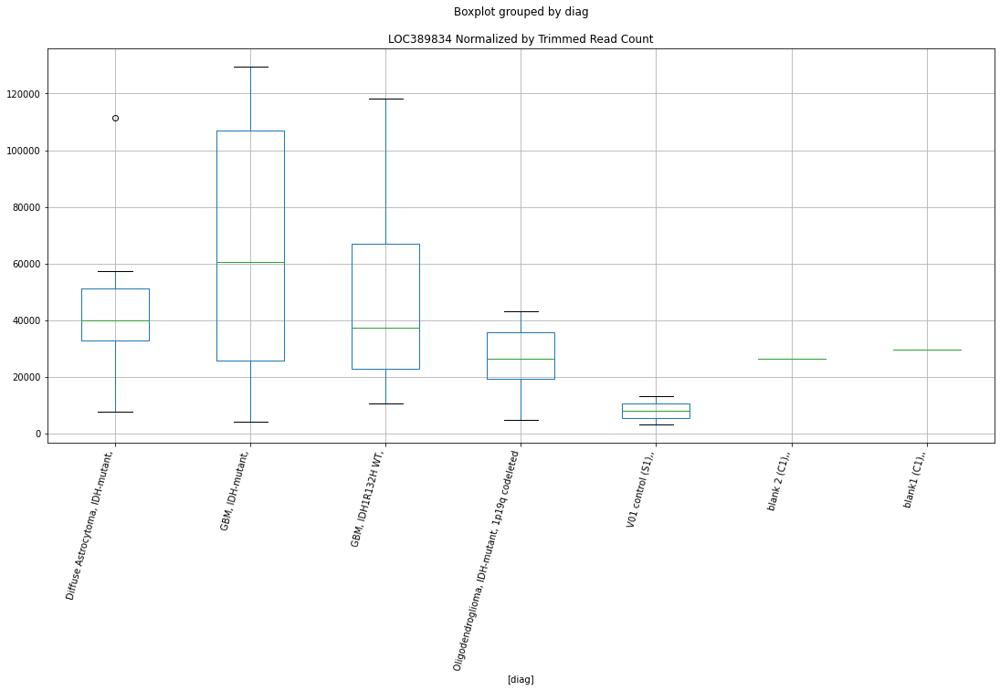

 p : 0.019690972269426635  ( t : 2.5598224032736723 ) :  D-plex  :  cutadapt2  :  LOC107987080
Control and blanks
76     0.0
340    0.0
Name: LOC107987080, dtype: float64
208    0.0
Name: LOC107987080, dtype: float64
472    577.96
Name: LOC107987080, dtype: float64


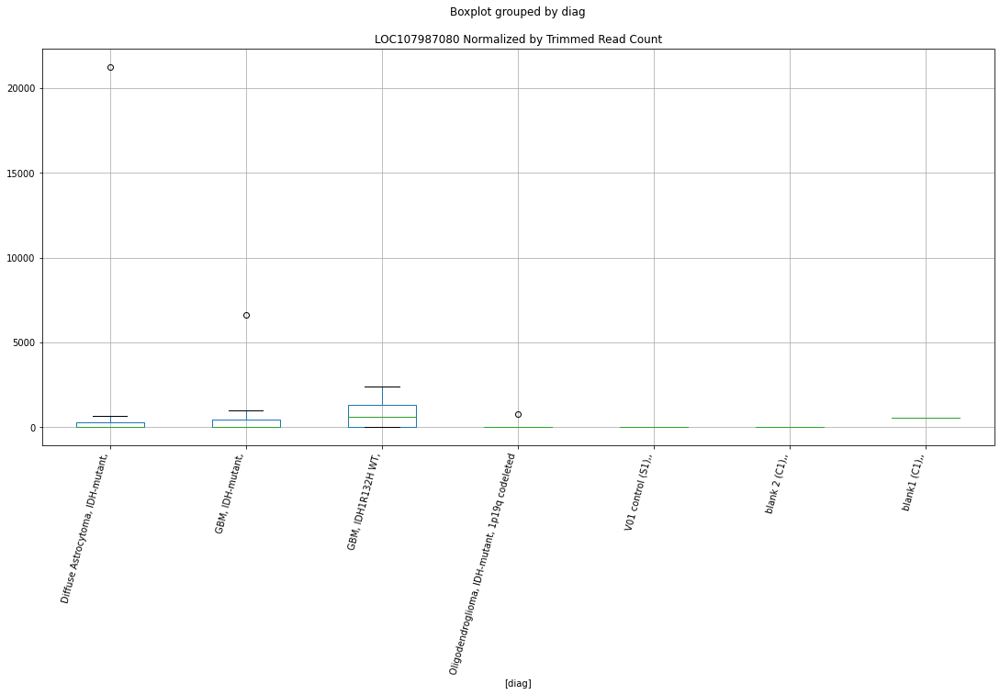

 p : 0.019765708935277928  ( t : 2.5580123294988835 ) :  D-plex  :  cutadapt2  :  NOL4L
Control and blanks
76     148492.39
340         0.00
Name: NOL4L, dtype: float64
208    79538.46
Name: NOL4L, dtype: float64
472    102298.18
Name: NOL4L, dtype: float64


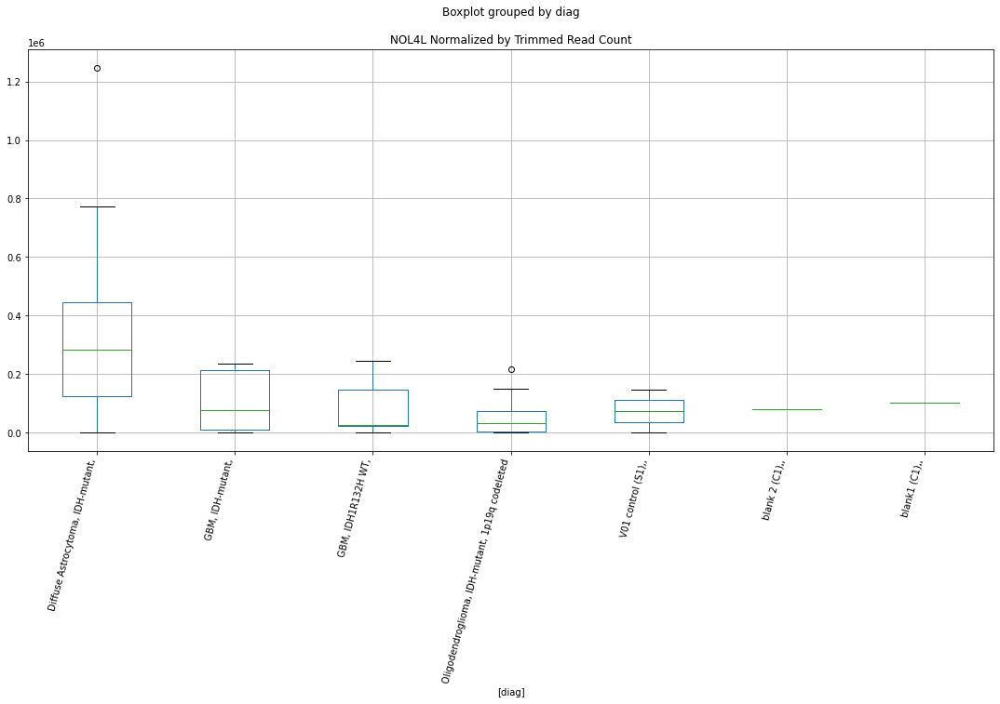

 p : 0.019768306949198886  ( t : 2.5579495238327 ) :  D-plex  :  bbduk2  :  LOC112268313
Control and blanks
73     47153.51
337     2670.47
Name: LOC112268313, dtype: float64
205    7700.91
Name: LOC112268313, dtype: float64
469    7689.86
Name: LOC112268313, dtype: float64


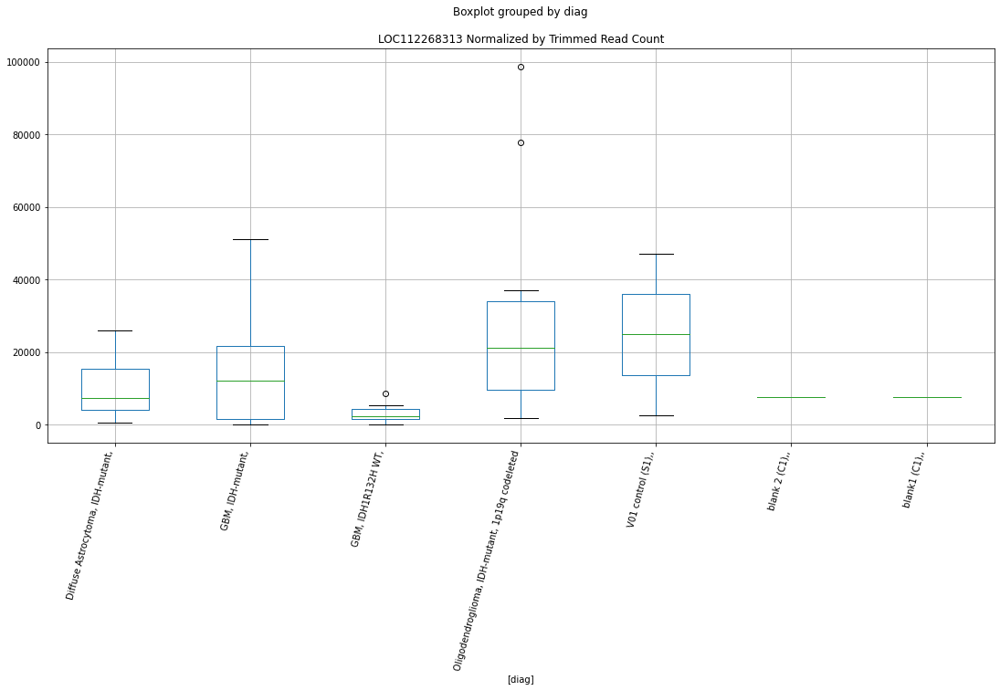

 p : 0.0200639919898477  ( t : 2.5508520220521893 ) :  D-plex  :  bbduk2  :  LOC107986124
Control and blanks
73     0.0
337    0.0
Name: LOC107986124, dtype: float64
205    358.18
Name: LOC107986124, dtype: float64
469    1183.05
Name: LOC107986124, dtype: float64


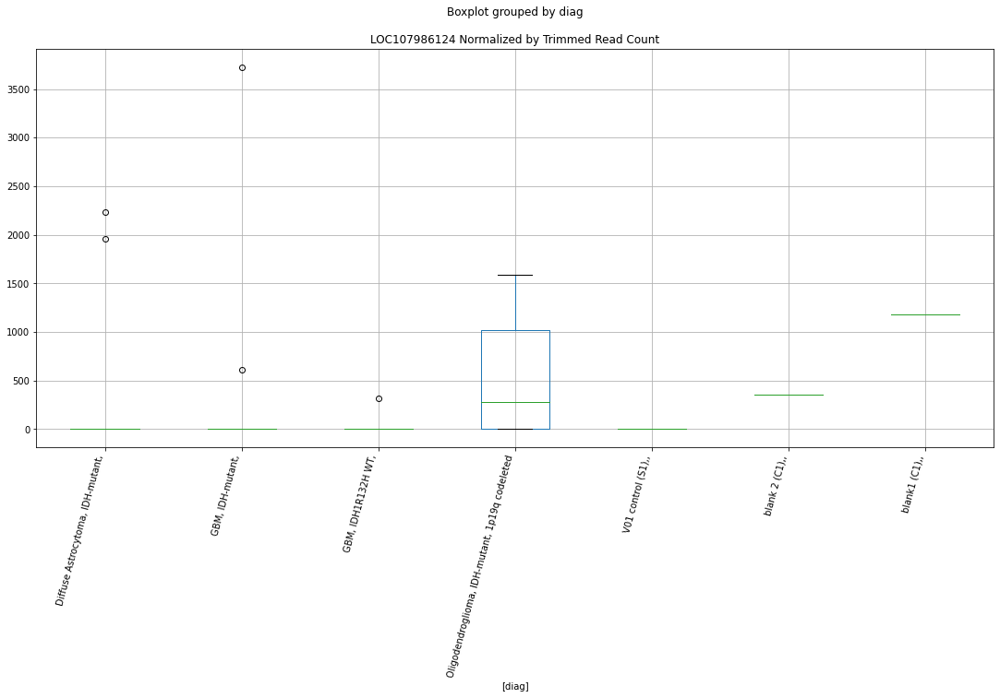

 p : 0.020110295112902705  ( t : 2.549749550960257 ) :  D-plex  :  cutadapt2  :  NCAM2
Control and blanks
76     0.0
340    0.0
Name: NCAM2, dtype: float64
208    2821.76
Name: NCAM2, dtype: float64
472    1155.91
Name: NCAM2, dtype: float64


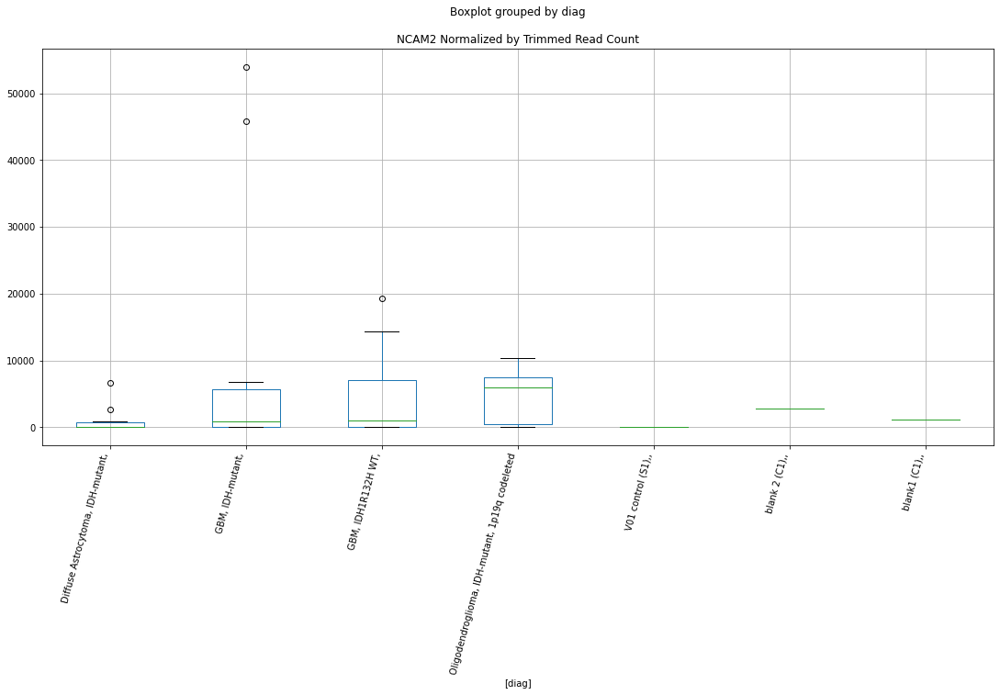

 p : 0.020158874337347893  ( t : 2.548595463742149 ) :  D-plex  :  bbduk2  :  MIEF2
Control and blanks
73     0.0
337    0.0
Name: MIEF2, dtype: float64
205    3760.91
Name: MIEF2, dtype: float64
469    2366.11
Name: MIEF2, dtype: float64


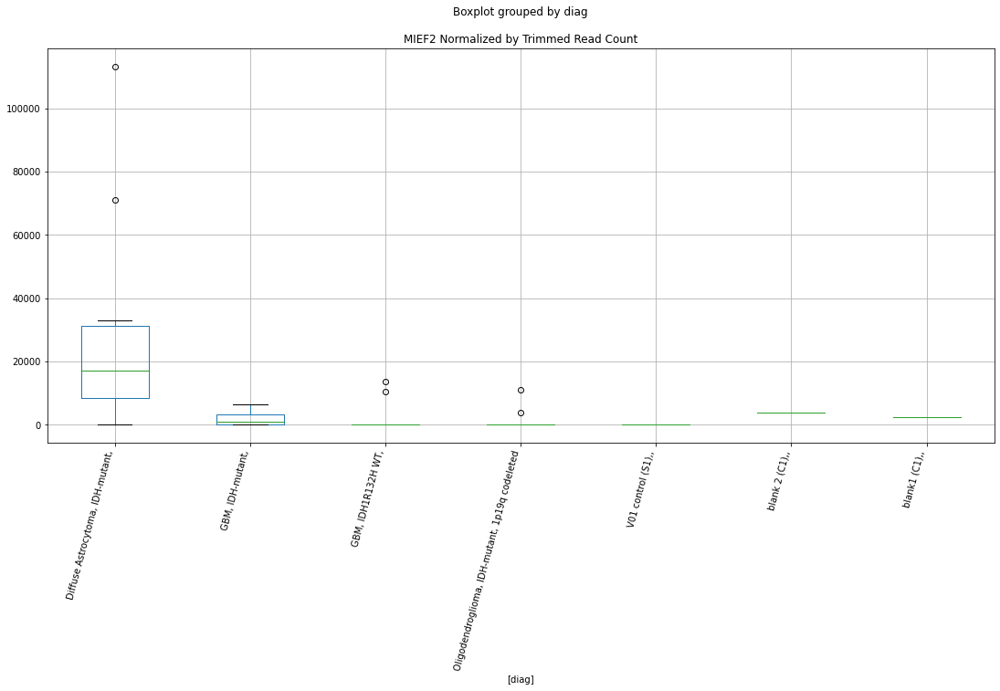

 p : 0.020255806525577978  ( t : 2.5463005025747143 ) :  D-plex  :  bbduk2  :  LOC107987080
Control and blanks
73     0.0
337    0.0
Name: LOC107987080, dtype: float64
205    0.0
Name: LOC107987080, dtype: float64
469    0.0
Name: LOC107987080, dtype: float64


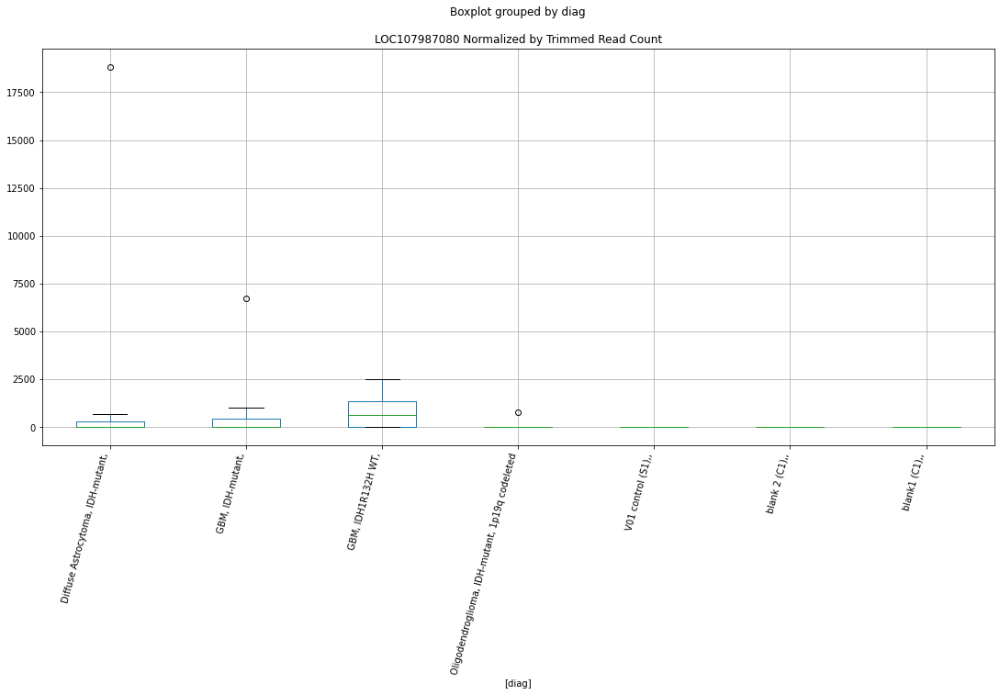

 p : 0.020260337684205897  ( t : 2.5461934773443122 ) :  D-plex  :  bbduk2  :  MRPL23
Control and blanks
73     0.0
337    0.0
Name: MRPL23, dtype: float64
205    358.18
Name: MRPL23, dtype: float64
469    0.0
Name: MRPL23, dtype: float64


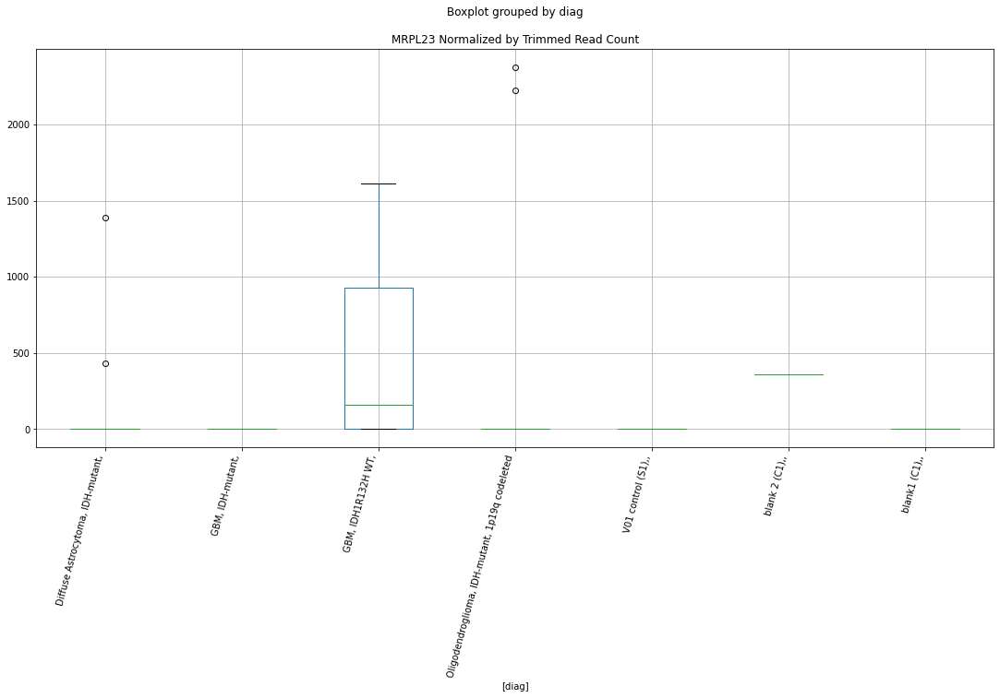

 p : 0.020344790279608015  ( t : 2.544202851297836 ) :  D-plex  :  bbduk2  :  OPCML
Control and blanks
73     7730.08
337       0.00
Name: OPCML, dtype: float64
205    9670.91
Name: OPCML, dtype: float64
469    10647.49
Name: OPCML, dtype: float64


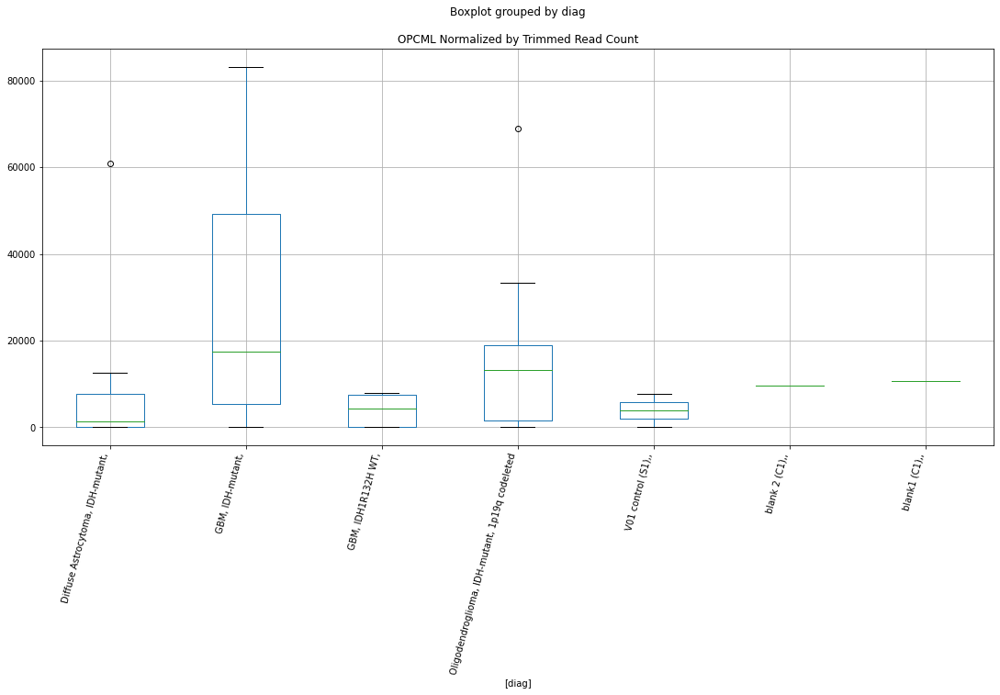

 p : 0.020637767714924333  ( t : 2.537357134765686 ) :  D-plex  :  bbduk2  :  LOC112268061
Control and blanks
73     0.0
337    0.0
Name: LOC112268061, dtype: float64
205    1074.55
Name: LOC112268061, dtype: float64
469    2366.11
Name: LOC112268061, dtype: float64


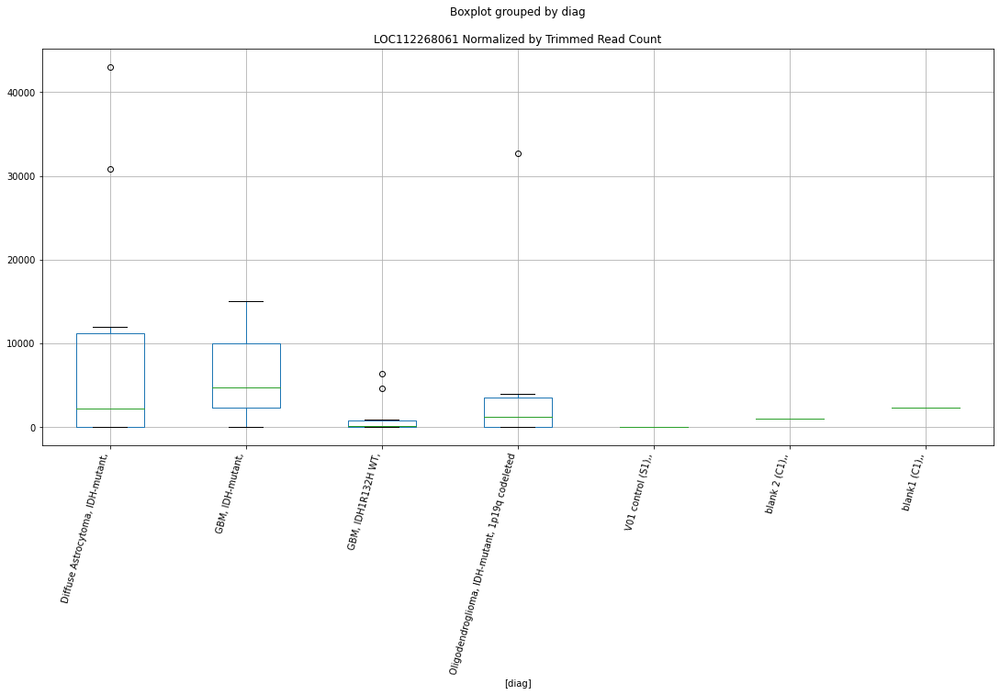

 p : 0.020648037611523177  ( t : 2.5371188379296403 ) :  D-plex  :  bbduk2  :  LOC389834
Control and blanks
73      3865.04
337    14242.52
Name: LOC389834, dtype: float64
205    27221.82
Name: LOC389834, dtype: float64
469    30759.42
Name: LOC389834, dtype: float64


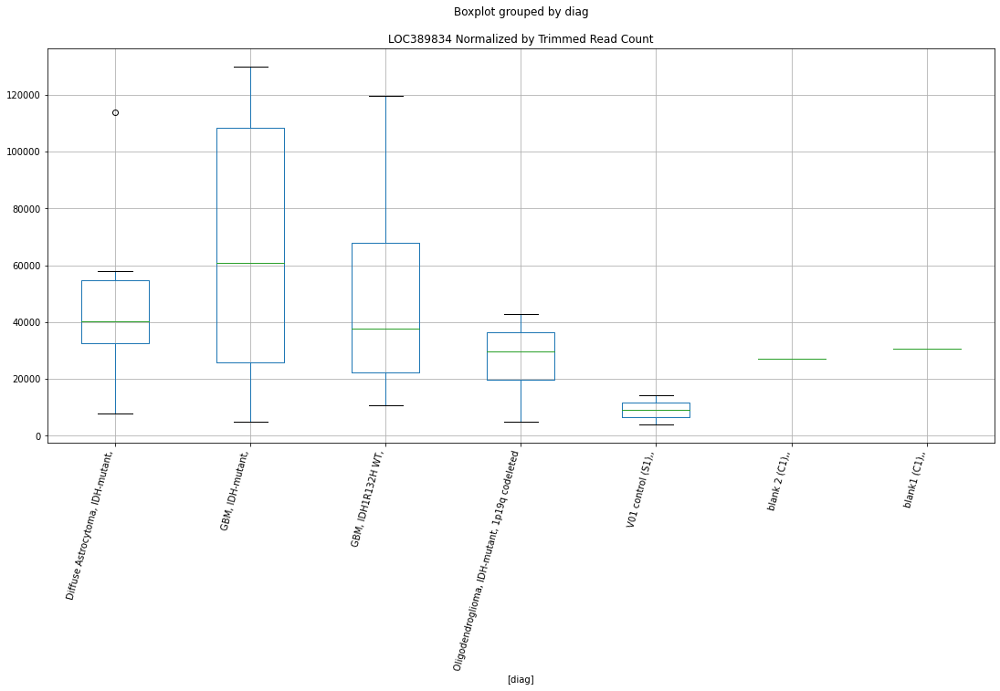

 p : 0.020848511750757606  ( t : 2.532489439723236 ) :  Lexogen  :  bbduk2  :  NRXN1
Control and blanks
79        0.0
343    5944.8
Name: NRXN1, dtype: float64
211    4919.51
Name: NRXN1, dtype: float64
475    4311.28
Name: NRXN1, dtype: float64


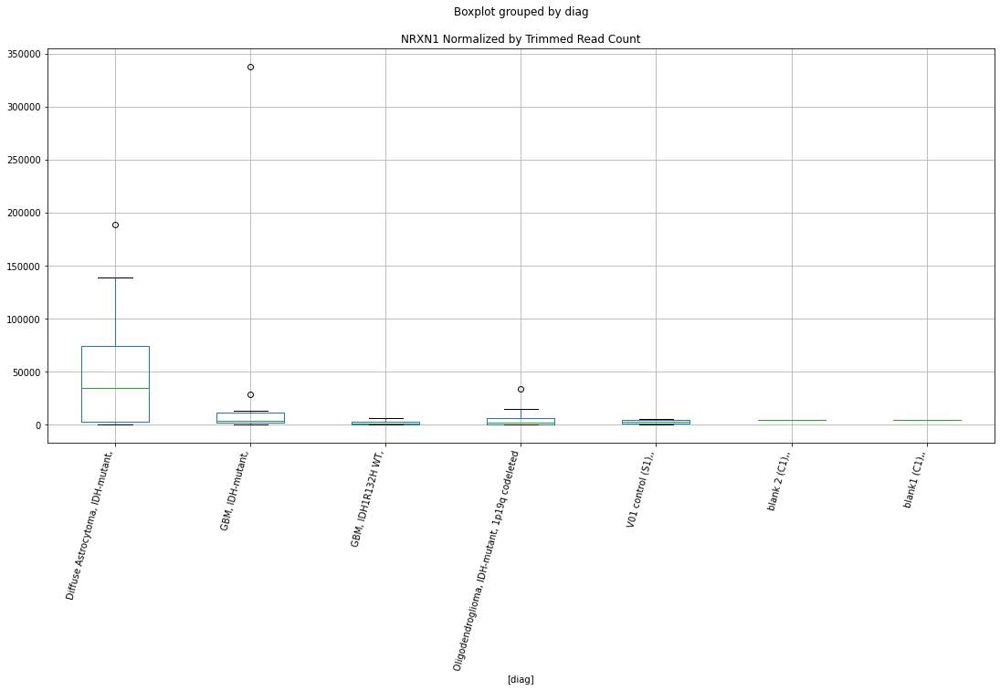

 p : 0.020953873355141706  ( t : 2.530073234343817 ) :  Lexogen  :  cutadapt2  :  MTSS2
Control and blanks
82     0.0
346    0.0
Name: MTSS2, dtype: float64
214    24410.38
Name: MTSS2, dtype: float64
478    0.0
Name: MTSS2, dtype: float64


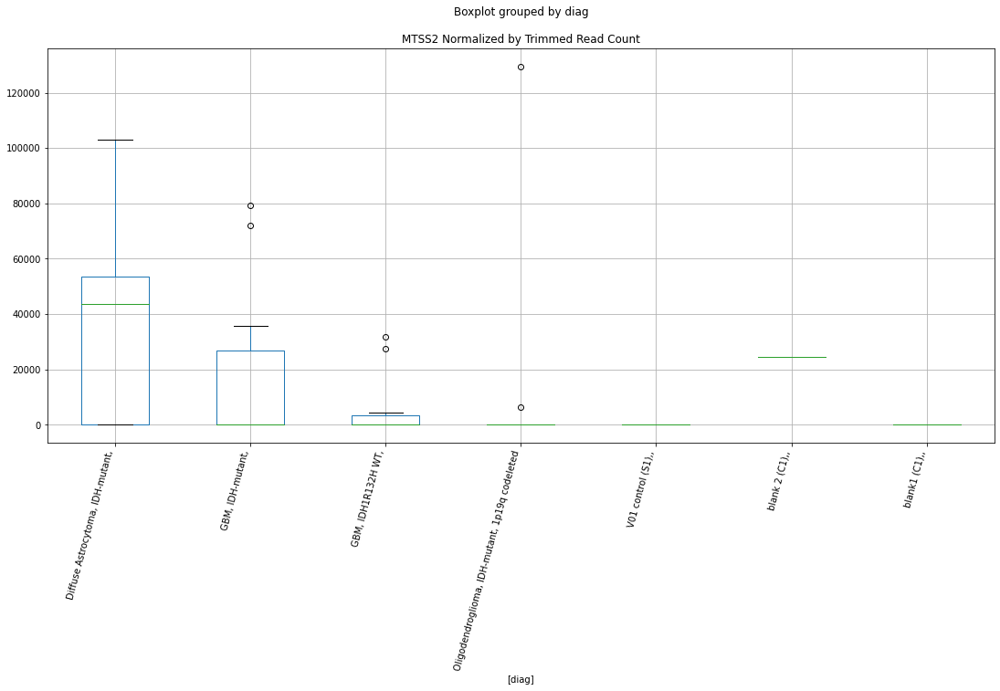

 p : 0.021067992363705126  ( t : 2.527469109598072 ) :  D-plex  :  cutadapt2  :  MCM2
Control and blanks
76     109096.45
340    226348.16
Name: MCM2, dtype: float64
208    21868.67
Name: MCM2, dtype: float64
472    356598.75
Name: MCM2, dtype: float64


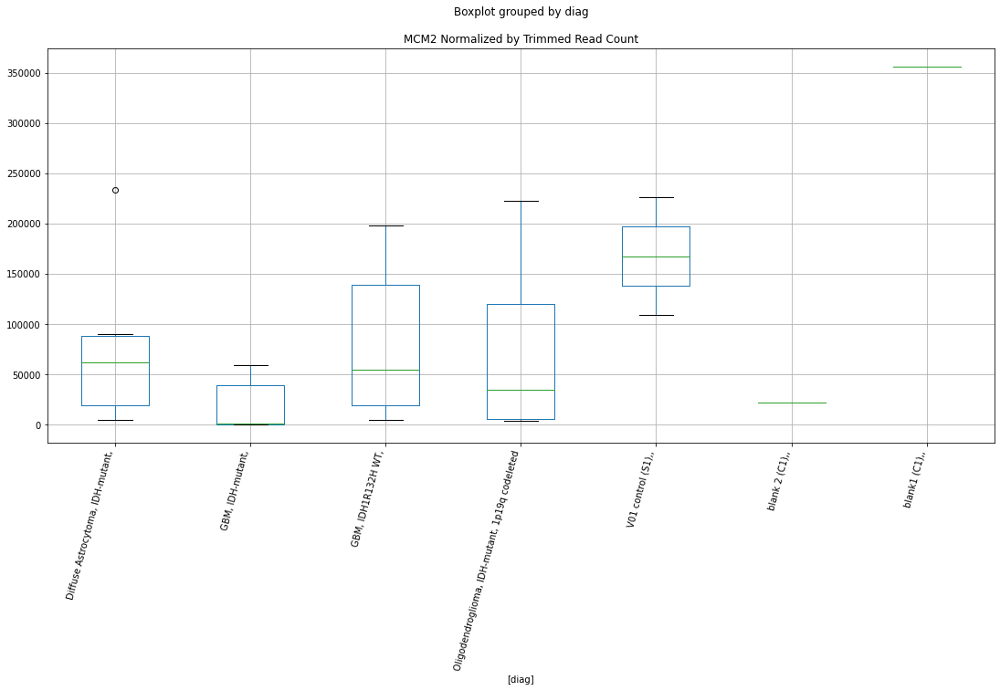

 p : 0.021213289344768176  ( t : 2.5241727295208616 ) :  D-plex  :  cutadapt2  :  MSI2
Control and blanks
76      6818.53
340    36990.75
Name: MSI2, dtype: float64
208    21868.67
Name: MSI2, dtype: float64
472    38145.09
Name: MSI2, dtype: float64


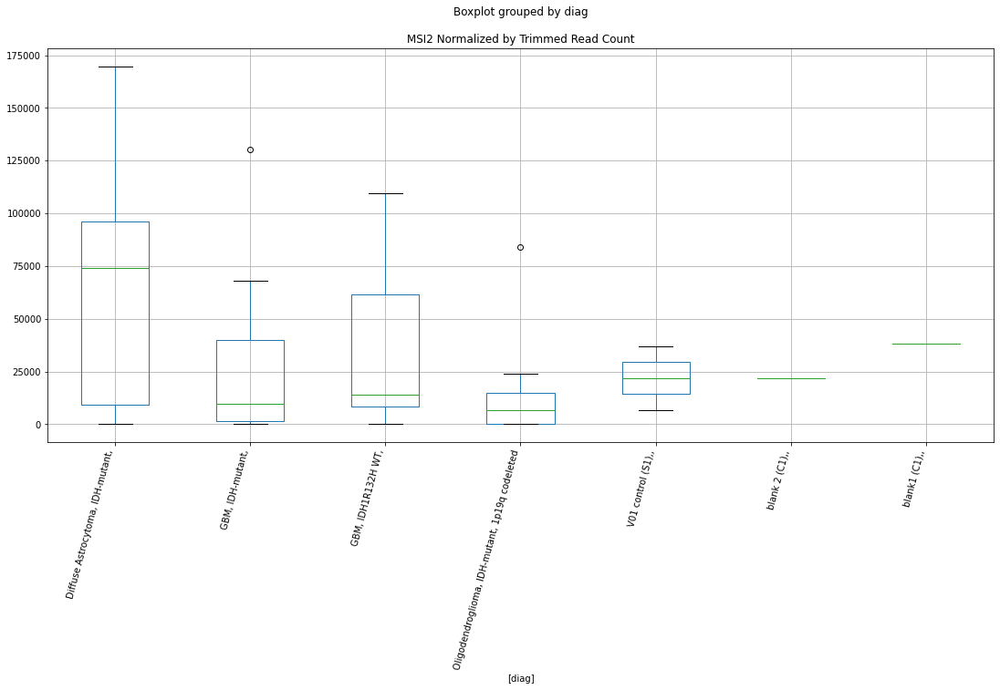

 p : 0.021282662002164193  ( t : 2.5226063699146035 ) :  D-plex  :  bbduk2  :  MCM2
Control and blanks
73     106675.16
337    225209.79
Name: MCM2, dtype: float64
205    22207.28
Name: MCM2, dtype: float64
469    363789.3
Name: MCM2, dtype: float64


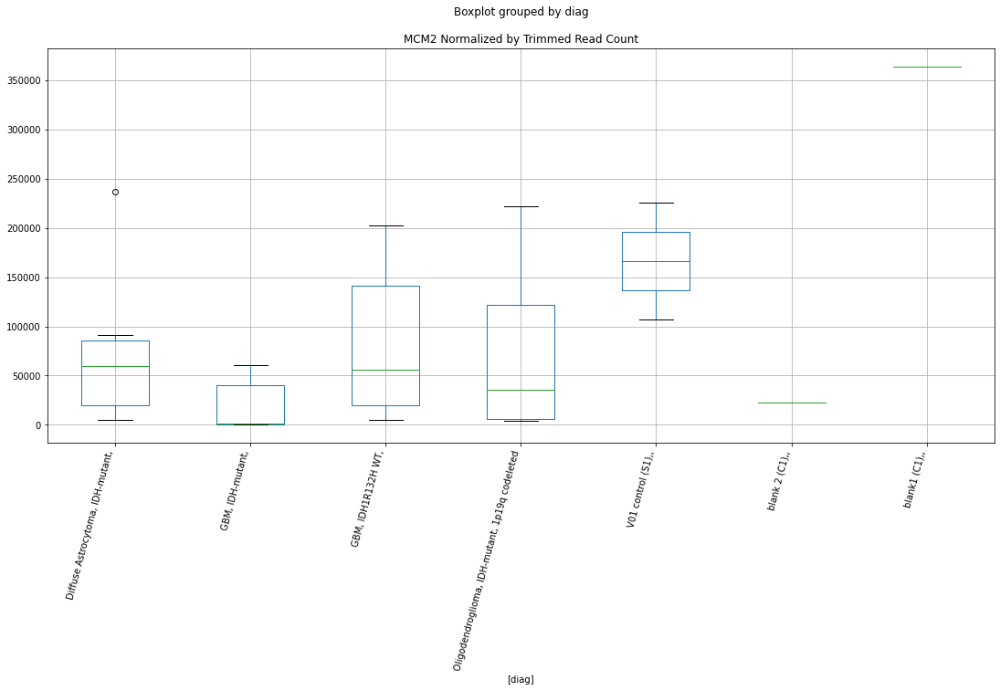

 p : 0.021375790328892478  ( t : 2.52051119298321 ) :  Lexogen  :  bbduk2  :  MTSS2
Control and blanks
79     0.0
343    0.0
Name: MTSS2, dtype: float64
211    24597.57
Name: MTSS2, dtype: float64
475    0.0
Name: MTSS2, dtype: float64


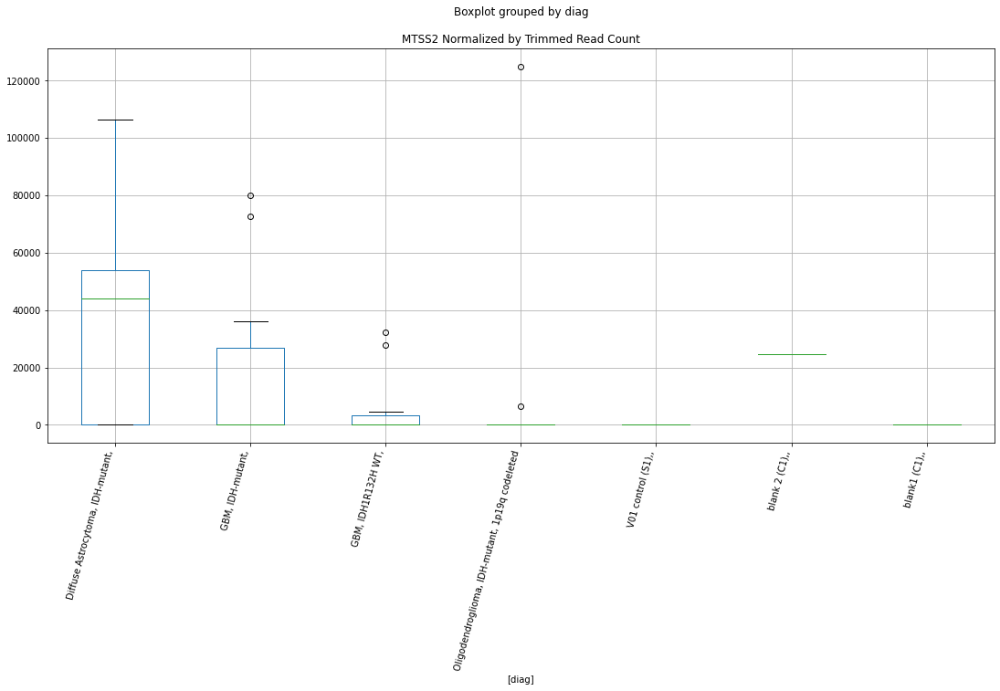

 p : 0.02141718665259367  ( t : 2.51958263368097 ) :  D-plex  :  cutadapt2  :  LOC107986454
Control and blanks
76        0.00
340    3522.93
Name: LOC107986454, dtype: float64
208    1234.52
Name: LOC107986454, dtype: float64
472    577.96
Name: LOC107986454, dtype: float64


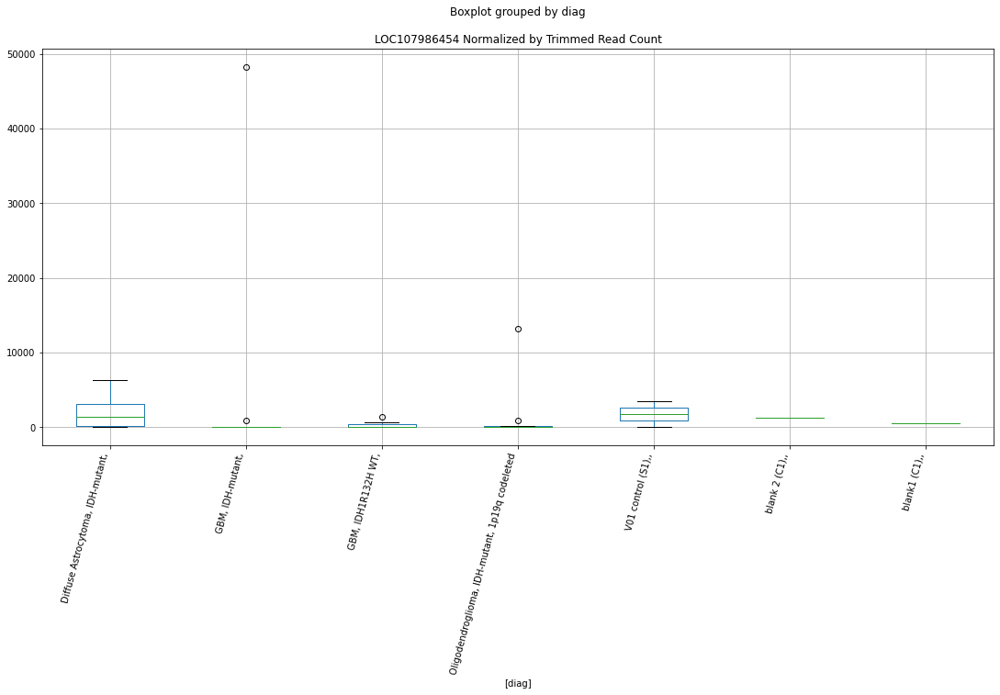

 p : 0.021442299096761354  ( t : 2.5190201624732755 ) :  Lexogen  :  bbduk2  :  MCF2L2
Control and blanks
79        0.00
343    1273.89
Name: MCF2L2, dtype: float64
211    0.0
Name: MCF2L2, dtype: float64
475    0.0
Name: MCF2L2, dtype: float64


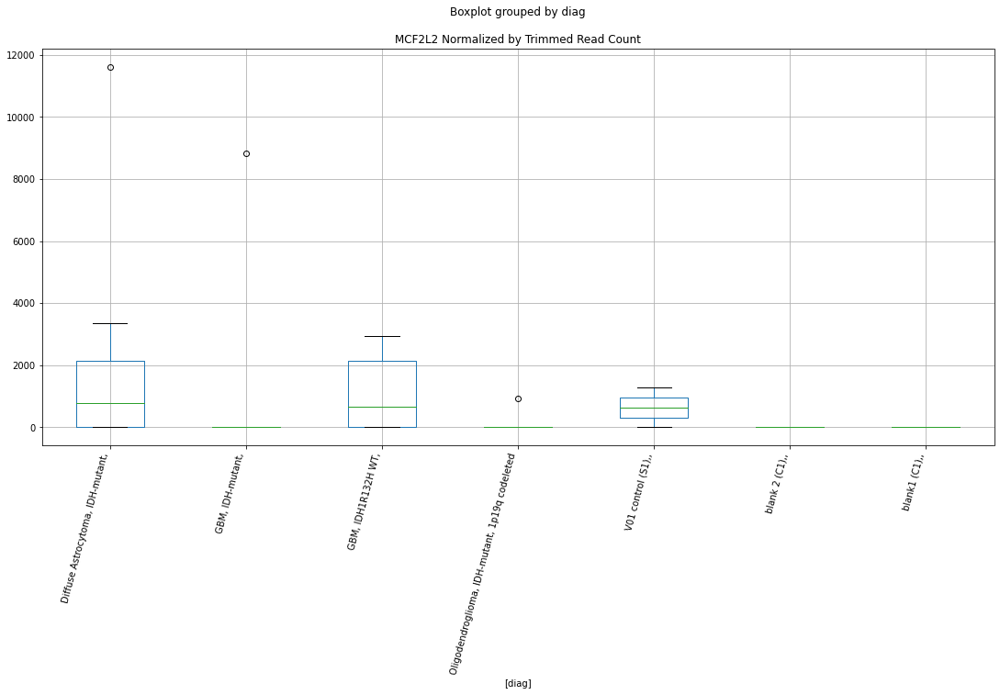

 p : 0.021594242478298324  ( t : 2.515630118666654 ) :  D-plex  :  bbduk2  :  LOC107986454
Control and blanks
73        0.00
337    3560.63
Name: LOC107986454, dtype: float64
205    1074.55
Name: LOC107986454, dtype: float64
469    591.53
Name: LOC107986454, dtype: float64


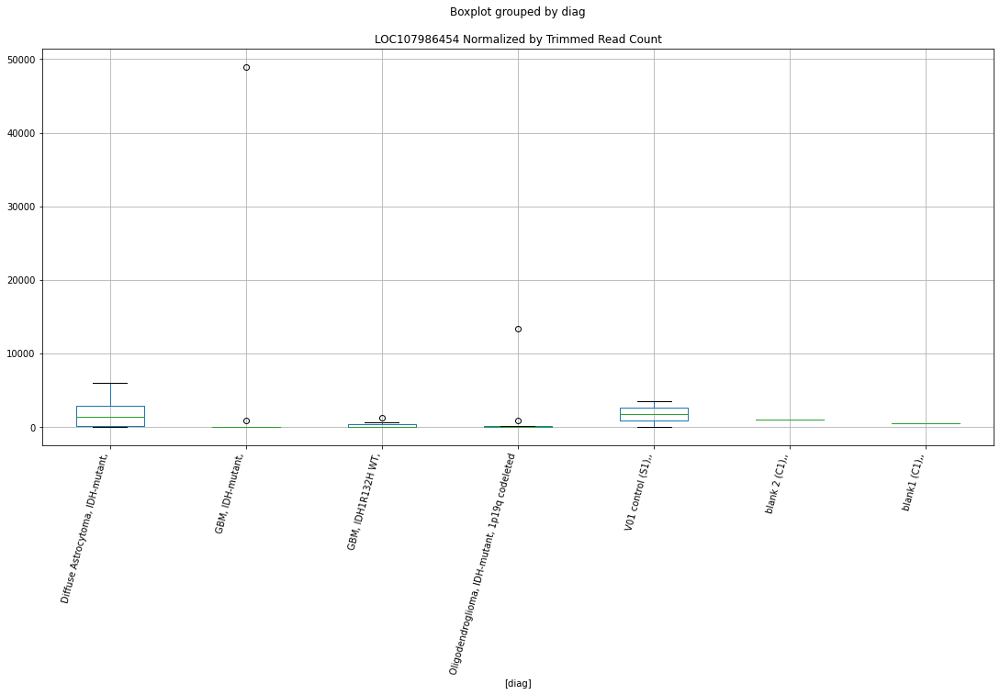

 p : 0.021627987887735078  ( t : 2.5148802718845196 ) :  D-plex  :  bbduk2  :  MIEF2
Control and blanks
73     0.0
337    0.0
Name: MIEF2, dtype: float64
205    3760.91
Name: MIEF2, dtype: float64
469    2366.11
Name: MIEF2, dtype: float64


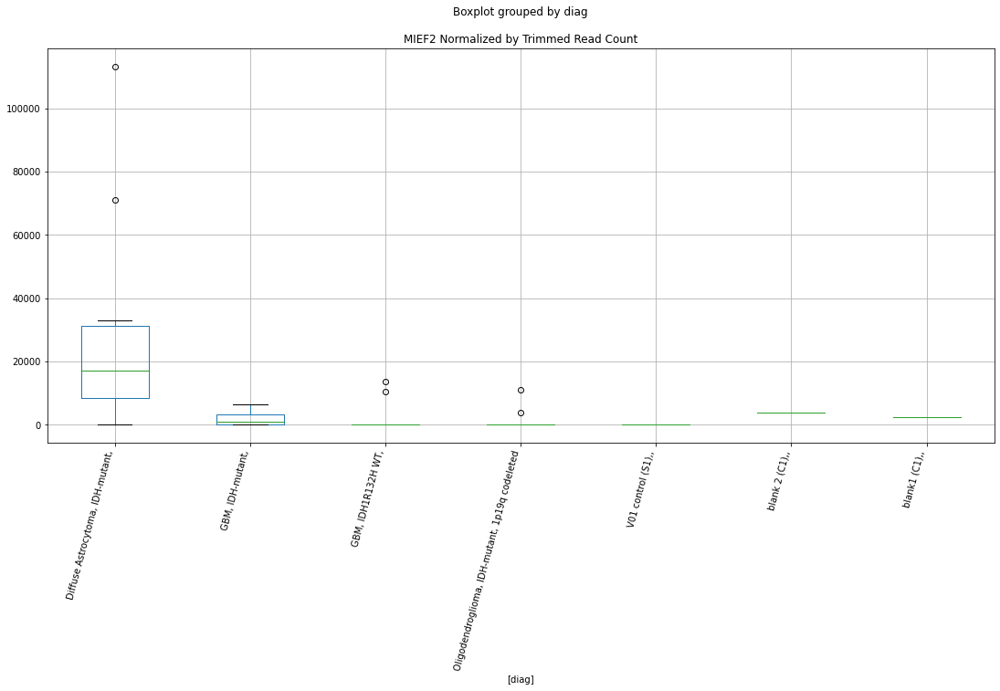

 p : 0.02164715228057717  ( t : 2.5144549168100605 ) :  Lexogen  :  cutadapt2  :  MIR143
Control and blanks
82         0.00
346    43559.95
Name: MIR143, dtype: float64
214    0.0
Name: MIR143, dtype: float64
478    13535.25
Name: MIR143, dtype: float64


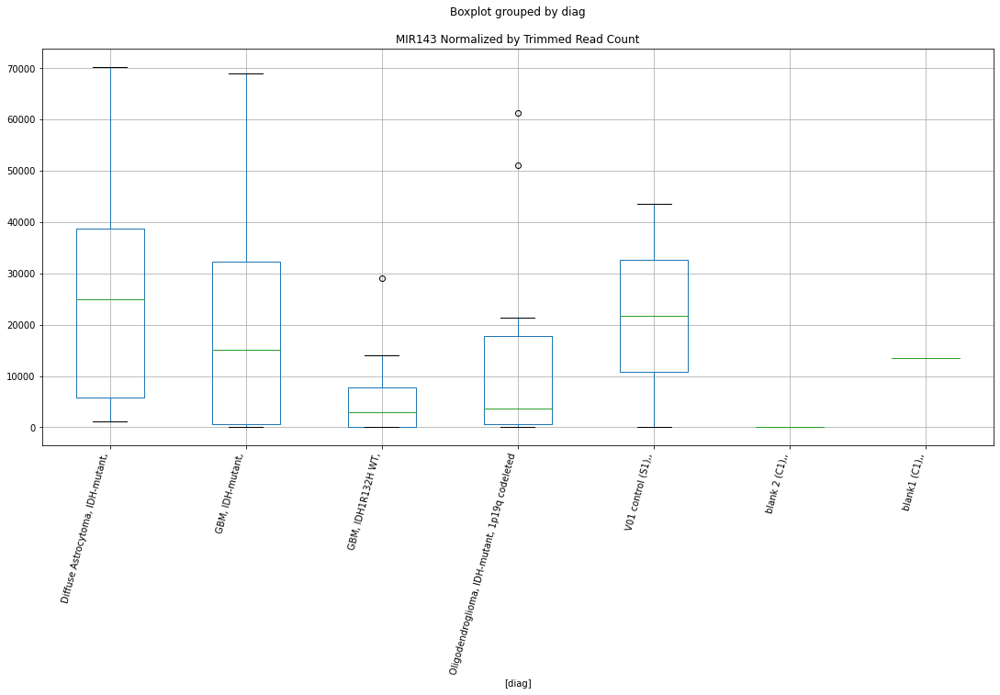

 p : 0.02166034655130022  ( t : 2.514162275450714 ) :  Lexogen  :  cutadapt2  :  LOC727751
Control and blanks
82      22720.82
346    657818.32
Name: LOC727751, dtype: float64
214    97099.07
Name: LOC727751, dtype: float64
478    110656.59
Name: LOC727751, dtype: float64


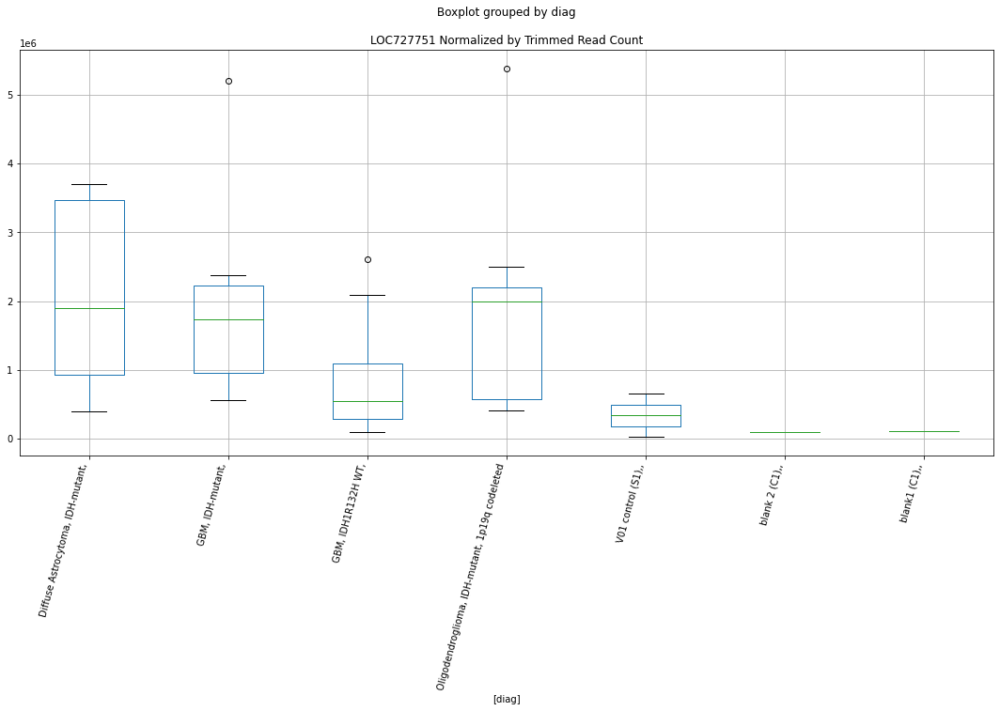

 p : 0.02166034655130022  ( t : 2.514162275450714 ) :  Lexogen  :  cutadapt2  :  LOC440300
Control and blanks
82      11360.41
346    328909.16
Name: LOC440300, dtype: float64
214    48549.54
Name: LOC440300, dtype: float64
478    55328.29
Name: LOC440300, dtype: float64


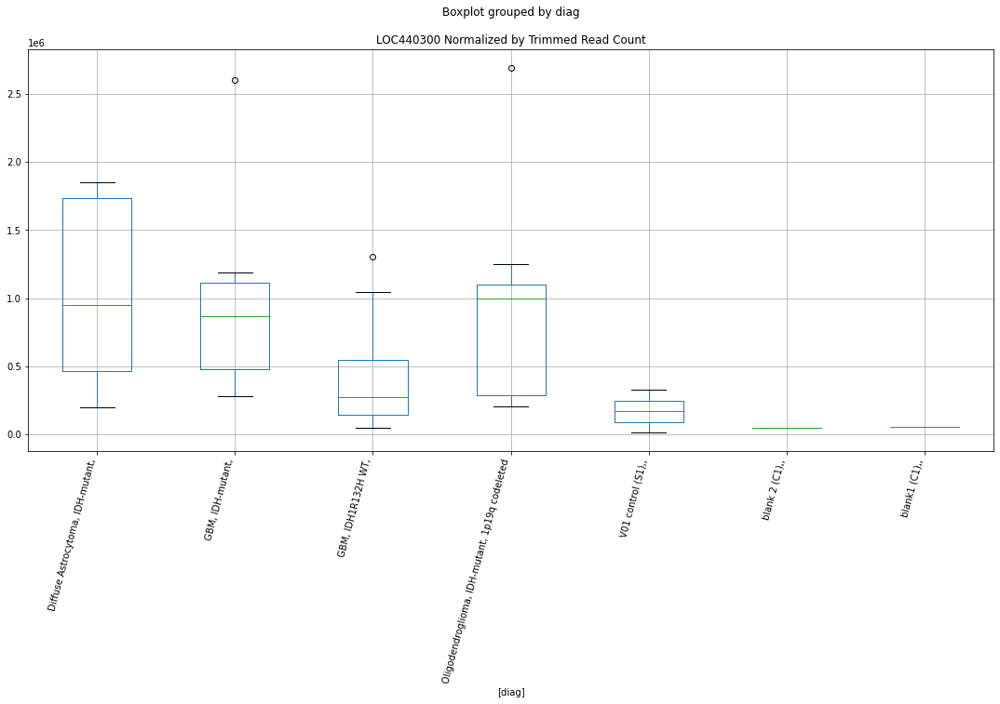

 p : 0.021706081856383244  ( t : 2.513149192601875 ) :  D-plex  :  bbduk2  :  LOC112268317
Control and blanks
73     0.0
337    0.0
Name: LOC112268317, dtype: float64
205    5014.55
Name: LOC112268317, dtype: float64
469    7689.86
Name: LOC112268317, dtype: float64


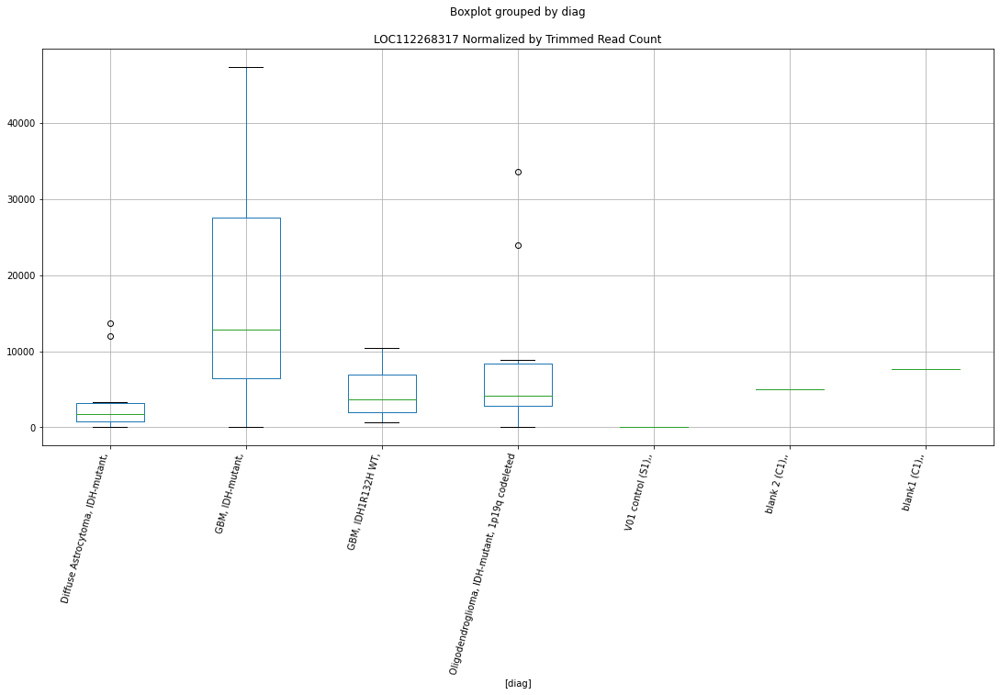

 p : 0.021712901708709893  ( t : 2.512998298572641 ) :  Lexogen  :  bbduk2  :  LOC727751
Control and blanks
79      20028.38
343    660722.15
Name: LOC727751, dtype: float64
211    97297.06
Name: LOC727751, dtype: float64
475    111614.33
Name: LOC727751, dtype: float64


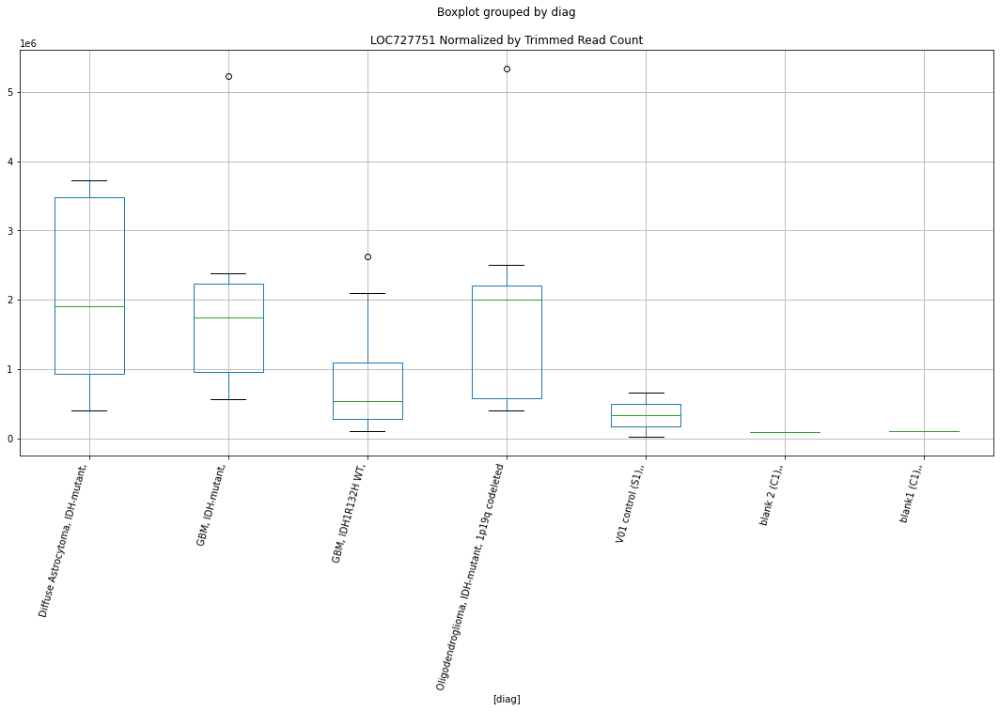

 p : 0.021712901708709893  ( t : 2.512998298572641 ) :  Lexogen  :  bbduk2  :  LOC440300
Control and blanks
79      10014.19
343    330361.07
Name: LOC440300, dtype: float64
211    48648.53
Name: LOC440300, dtype: float64
475    55807.17
Name: LOC440300, dtype: float64


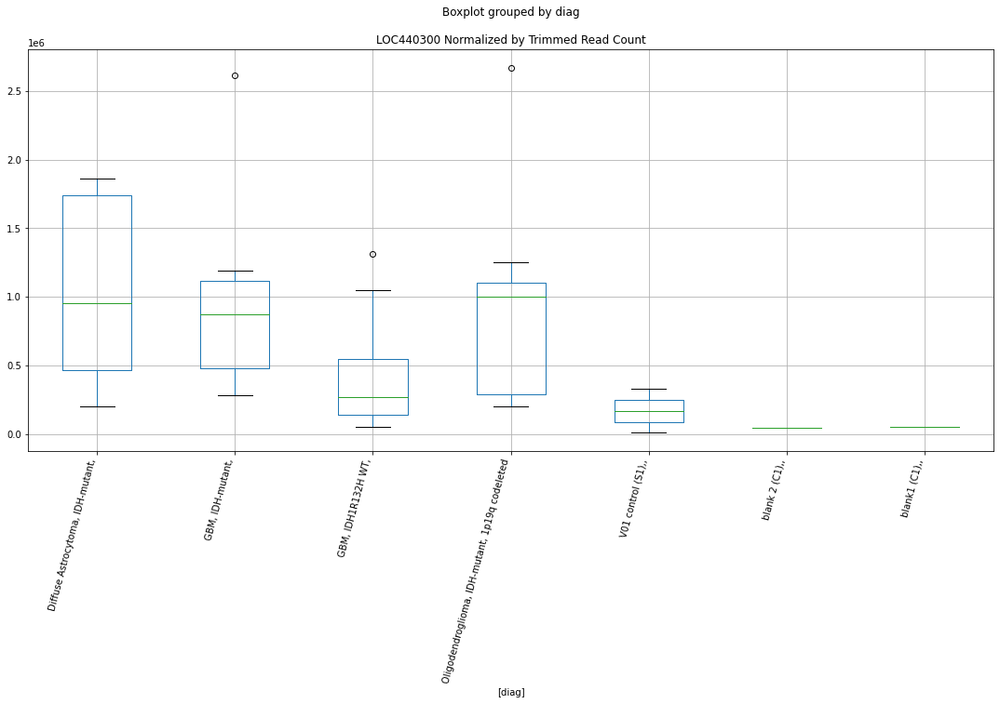

 p : 0.02183492457436929  ( t : 2.5103059850199334 ) :  Lexogen  :  bbduk2  :  LOXL1-AS1
Control and blanks
79     0.0
343    0.0
Name: LOXL1-AS1, dtype: float64
211    0.0
Name: LOXL1-AS1, dtype: float64
475    0.0
Name: LOXL1-AS1, dtype: float64


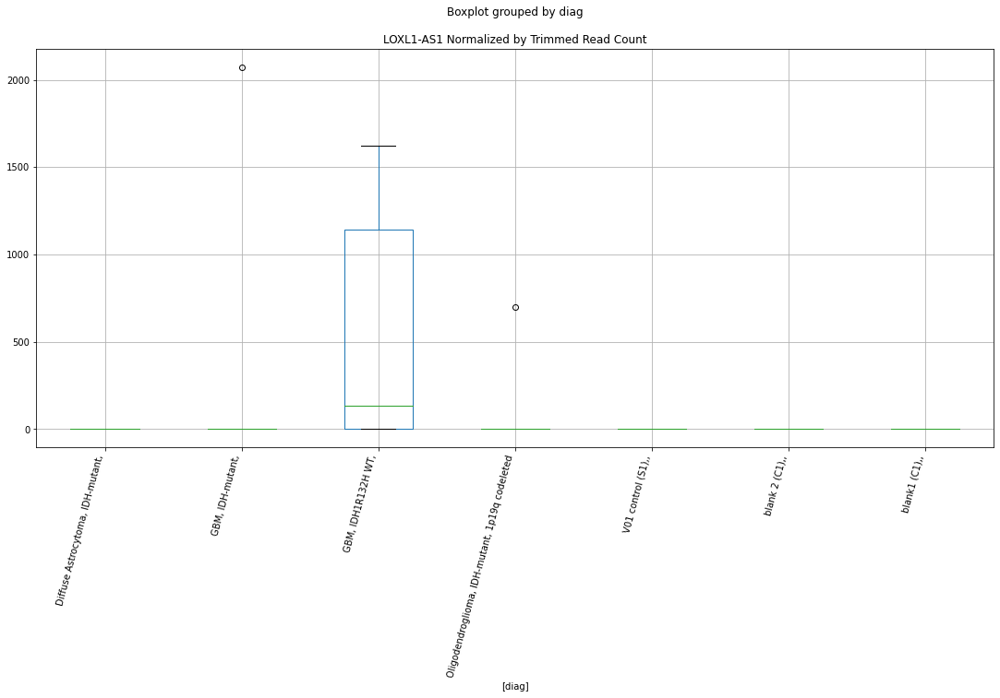

 p : 0.02187657871263792  ( t : 2.509390175585614 ) :  D-plex  :  bbduk2  :  MCHR2
Control and blanks
73     0.0
337    0.0
Name: MCHR2, dtype: float64
205    537.27
Name: MCHR2, dtype: float64
469    1183.05
Name: MCHR2, dtype: float64


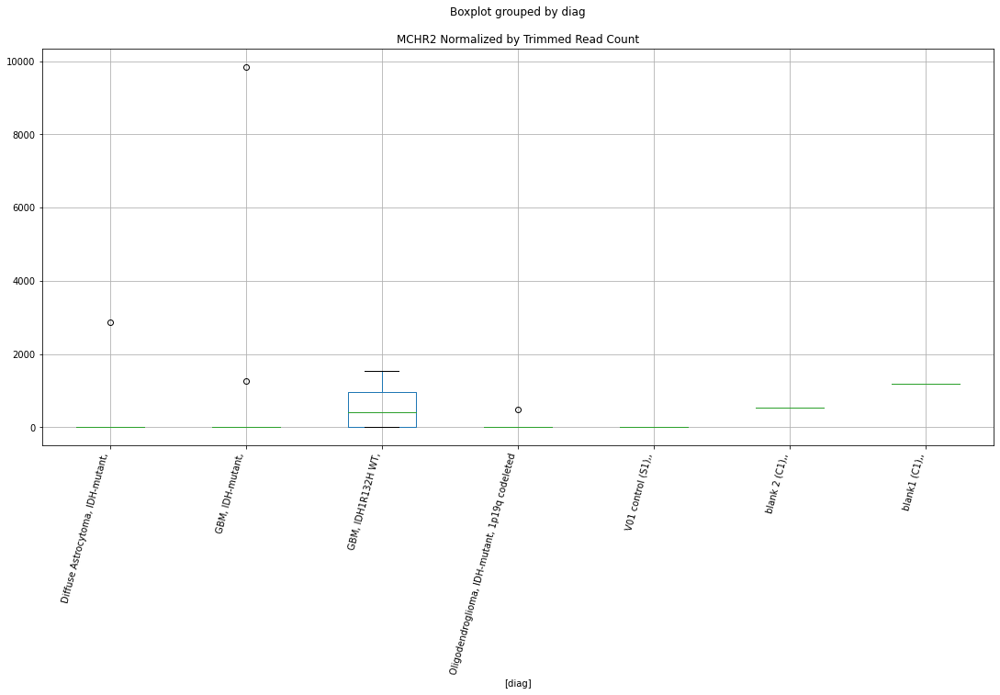

 p : 0.021958745063671473  ( t : 2.507588473853711 ) :  Lexogen  :  bbduk2  :  MIR143
Control and blanks
79         0.00
343    43949.06
Name: MIR143, dtype: float64
211    0.0
Name: MIR143, dtype: float64
475    13652.4
Name: MIR143, dtype: float64


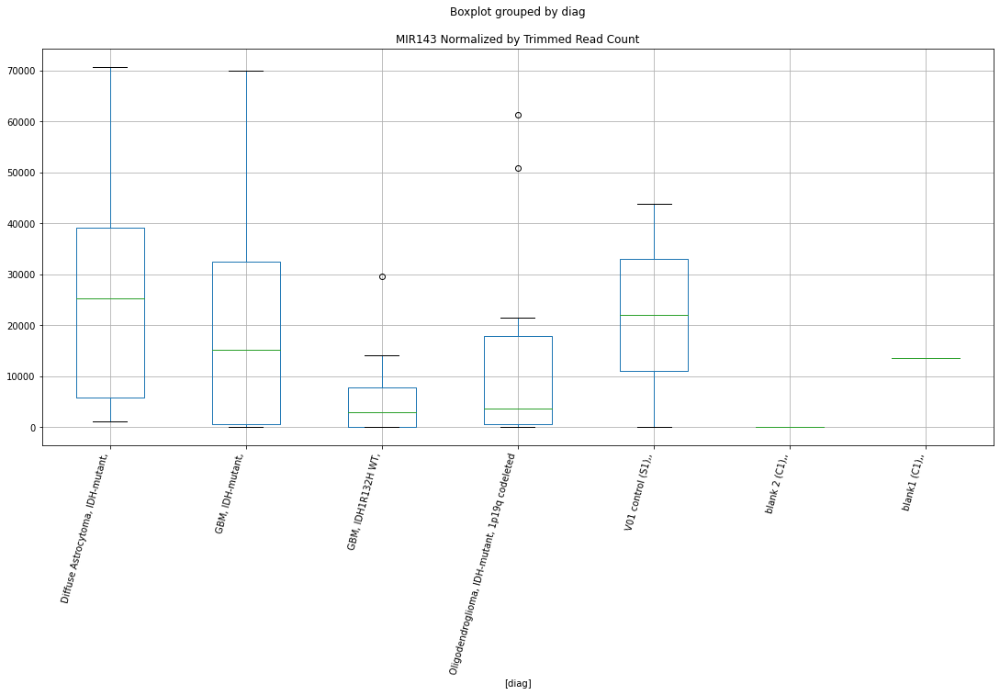

 p : 0.02196340375391457  ( t : 2.5074865110014075 ) :  D-plex  :  bbduk2  :  MYLK4
Control and blanks
73     0.0
337    0.0
Name: MYLK4, dtype: float64
205    4477.27
Name: MYLK4, dtype: float64
469    2366.11
Name: MYLK4, dtype: float64


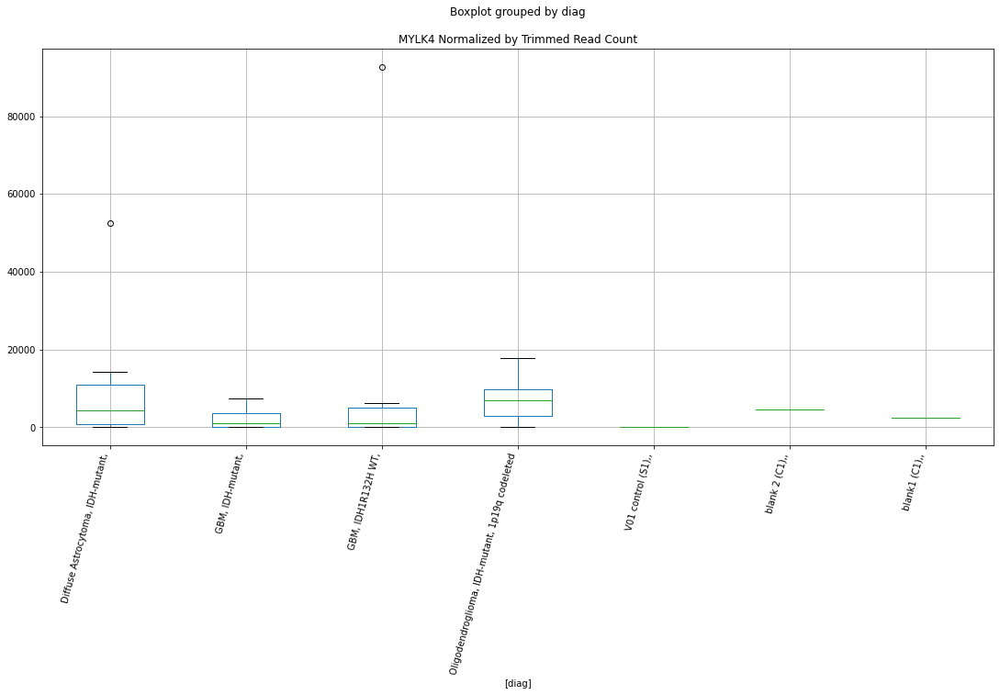

 p : 0.021997857296396604  ( t : 2.5067330727989074 ) :  D-plex  :  bbduk2  :  NOL4L
Control and blanks
73     128319.39
337         0.00
Name: NOL4L, dtype: float64
205    80770.02
Name: NOL4L, dtype: float64
469    104700.34
Name: NOL4L, dtype: float64


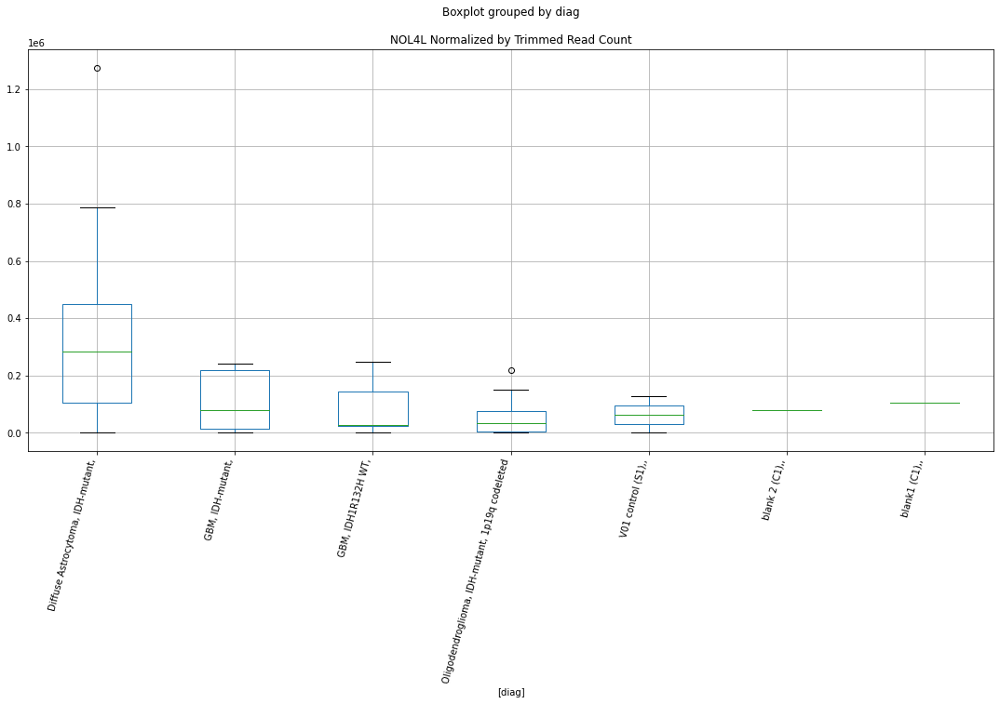

 p : 0.022074987919939962  ( t : 2.50505038722188 ) :  D-plex  :  bbduk2  :  MYO1C
Control and blanks
73     47926.52
337     5340.94
Name: MYO1C, dtype: float64
205    123572.76
Name: MYO1C, dtype: float64
469    53237.46
Name: MYO1C, dtype: float64


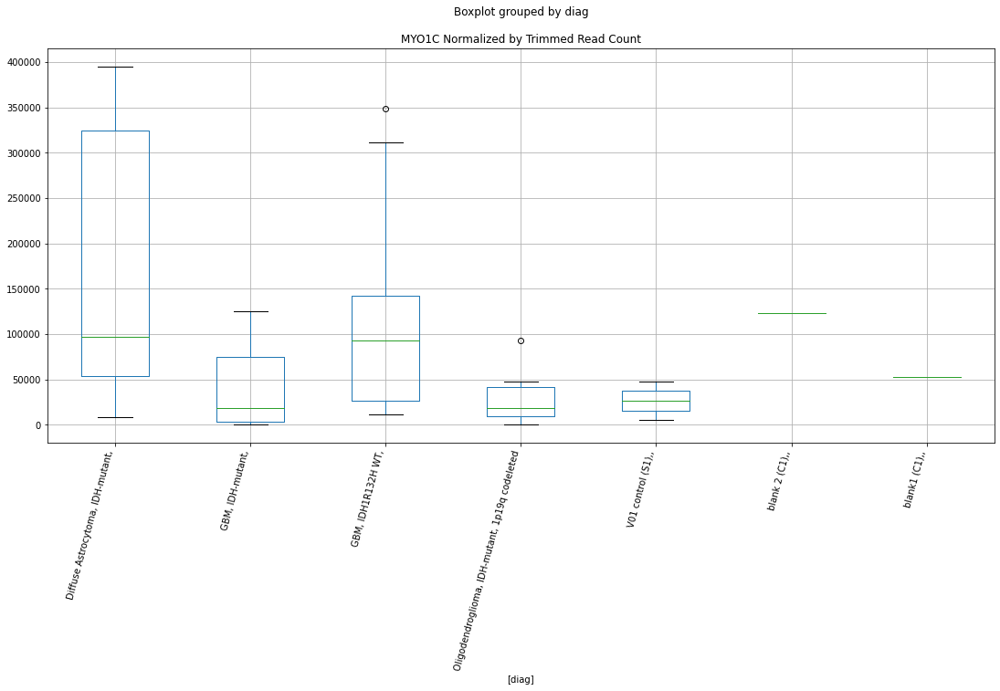

 p : 0.02240648429037896  ( t : 2.4978809670554742 ) :  D-plex  :  cutadapt2  :  MYLK4
Control and blanks
76     0.0
340    0.0
Name: MYLK4, dtype: float64
208    4409.01
Name: MYLK4, dtype: float64
472    2311.82
Name: MYLK4, dtype: float64


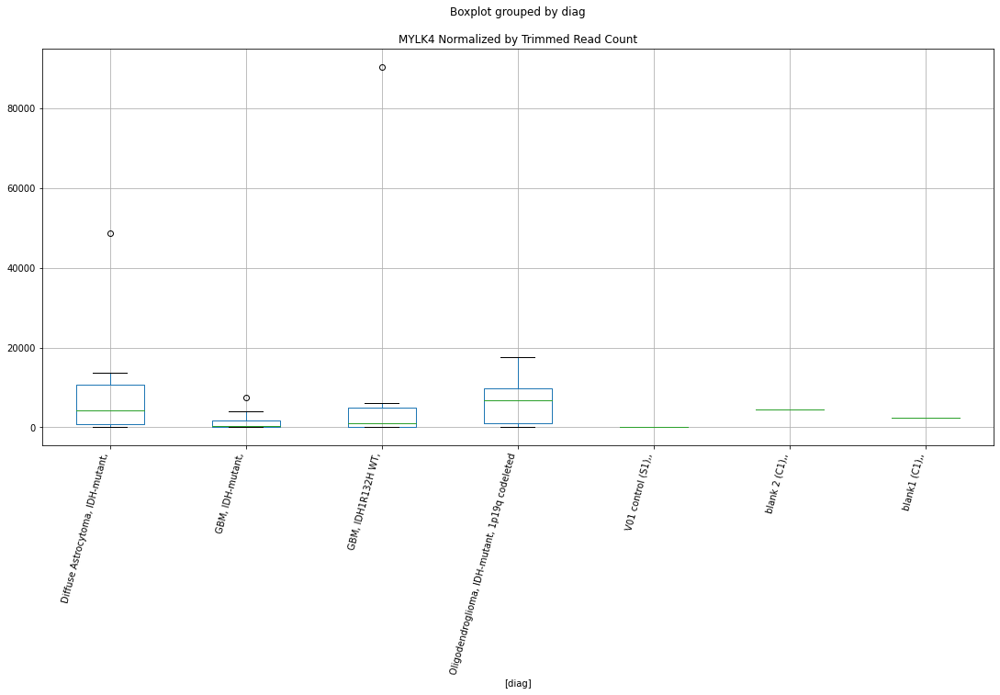

 p : 0.022418445333081592  ( t : 2.497624152830543 ) :  Lexogen  :  cutadapt2  :  MUC6
Control and blanks
82     0.0
346    0.0
Name: MUC6, dtype: float64
214    13018.87
Name: MUC6, dtype: float64
478    0.0
Name: MUC6, dtype: float64


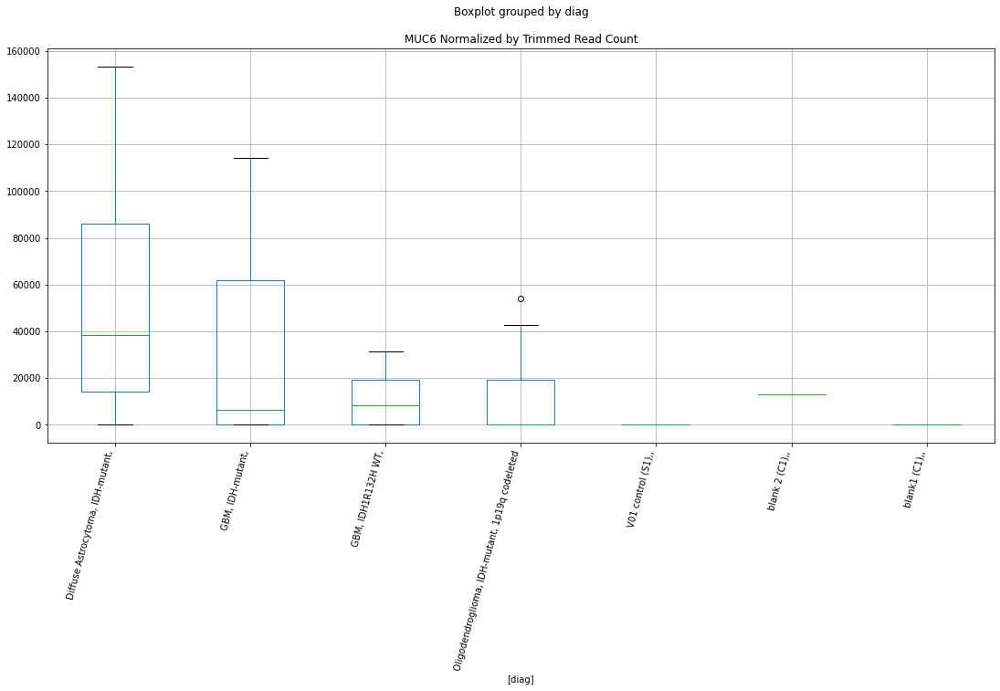

 p : 0.022475567151110747  ( t : 2.4963994741756985 ) :  Lexogen  :  bbduk2  :  NT5DC2
Control and blanks
79     0.0
343    0.0
Name: NT5DC2, dtype: float64
211    0.0
Name: NT5DC2, dtype: float64
475    0.0
Name: NT5DC2, dtype: float64


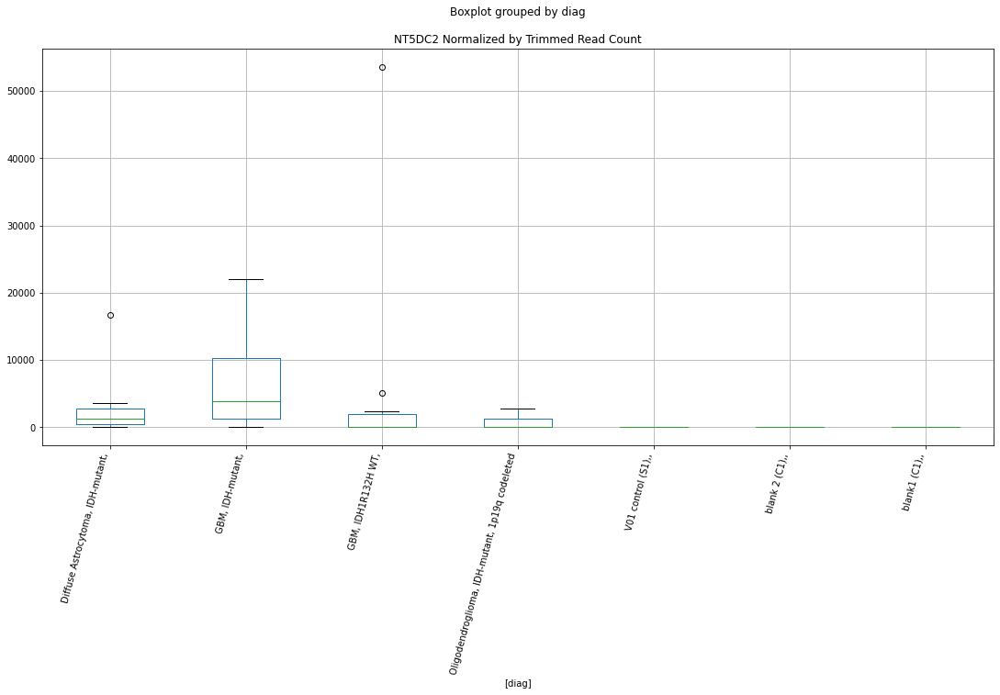

 p : 0.02249856218294503  ( t : 2.4959072936153484 ) :  D-plex  :  cutadapt2  :  OPCML
Control and blanks
76     6060.91
340       0.00
Name: OPCML, dtype: float64
208    10228.89
Name: OPCML, dtype: float64
472    4623.65
Name: OPCML, dtype: float64


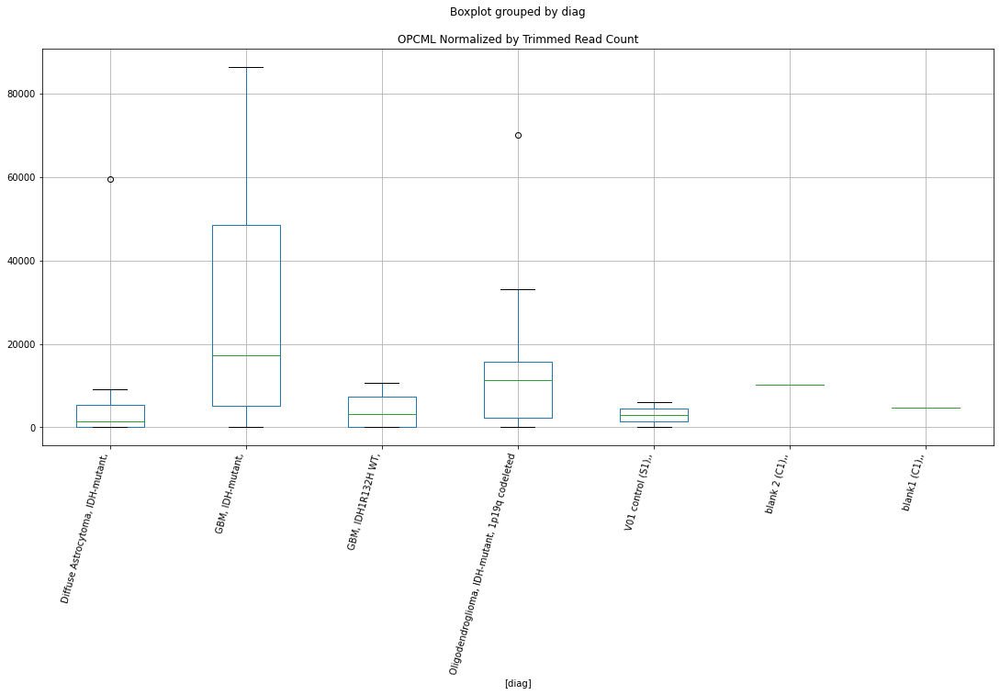

 p : 0.02289290733384725  ( t : 2.4875397373953785 ) :  D-plex  :  cutadapt2  :  MICOS13
Control and blanks
76      1515.23
340    36990.75
Name: MICOS13, dtype: float64
208    1410.88
Name: MICOS13, dtype: float64
472    0.0
Name: MICOS13, dtype: float64


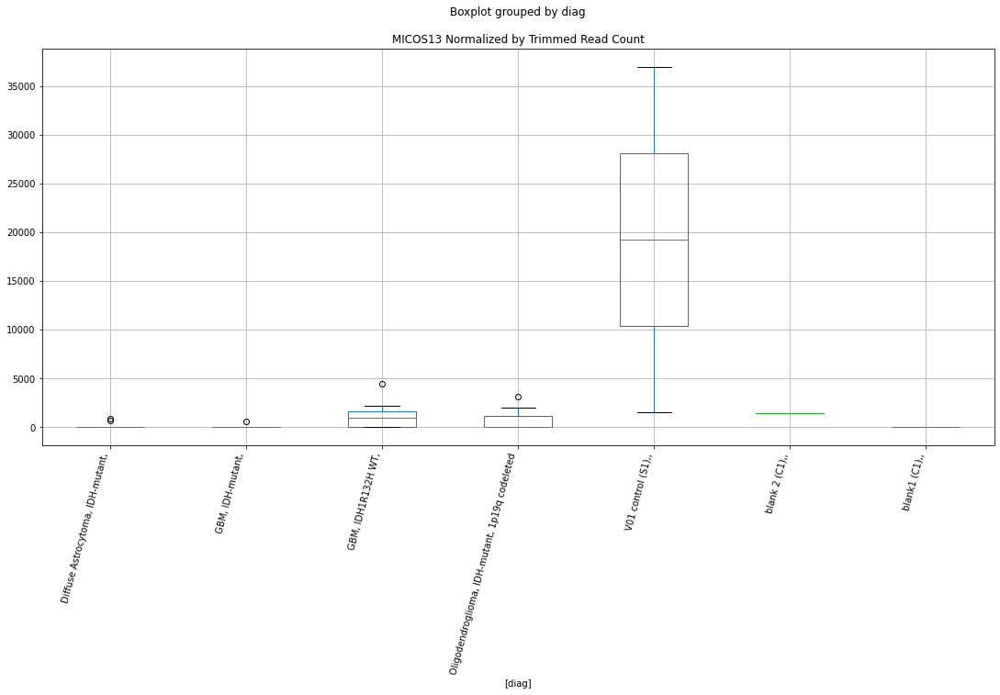

 p : 0.022913995318536138  ( t : 2.487096106834182 ) :  D-plex  :  bbduk2  :  NCR3LG1
Control and blanks
73     316933.44
337       890.16
Name: NCR3LG1, dtype: float64
205    12715.46
Name: NCR3LG1, dtype: float64
469    243709.25
Name: NCR3LG1, dtype: float64


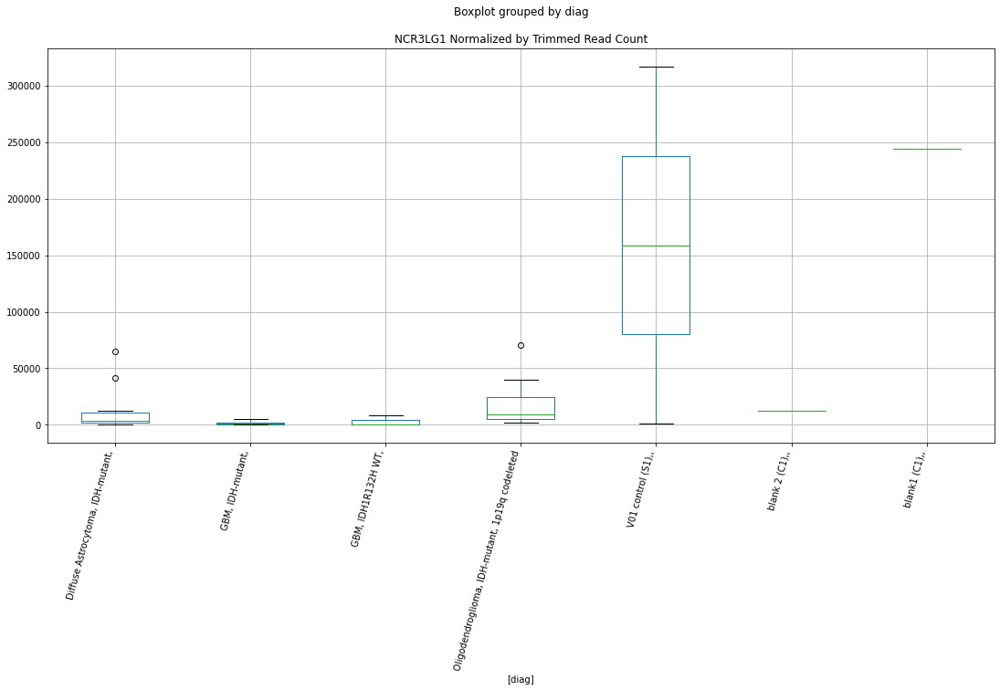

 p : 0.022966336238312457  ( t : 2.485996663105104 ) :  D-plex  :  cutadapt2  :  MLST8
Control and blanks
76     0.0
340    0.0
Name: MLST8, dtype: float64
208    167718.57
Name: MLST8, dtype: float64
472    16182.76
Name: MLST8, dtype: float64


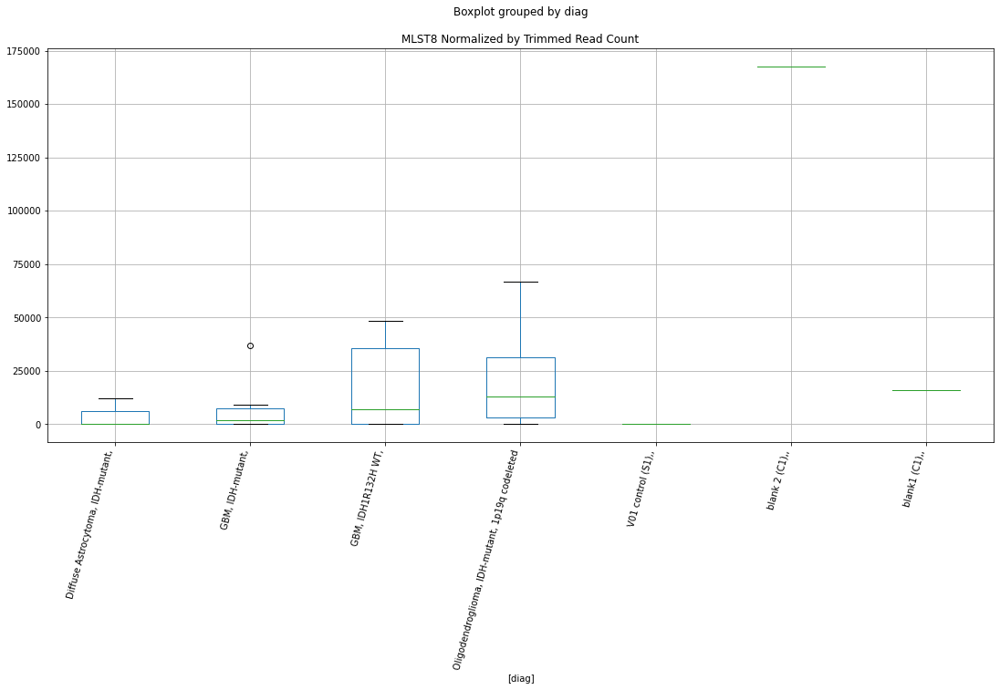

 p : 0.023275346179553902  ( t : 2.479553442334332 ) :  D-plex  :  bbduk2  :  OBSCN
Control and blanks
73     2319.03
337       0.00
Name: OBSCN, dtype: float64
205    7700.91
Name: OBSCN, dtype: float64
469    6506.8
Name: OBSCN, dtype: float64


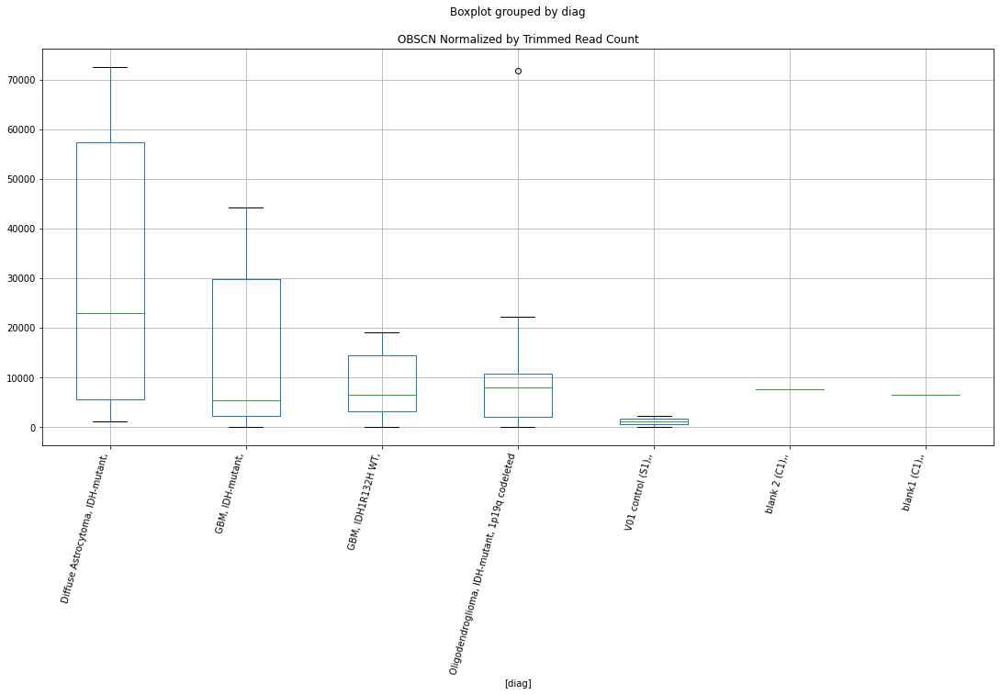

 p : 0.023663333746039048  ( t : 2.4715764622782848 ) :  Lexogen  :  bbduk2  :  NRIP3
Control and blanks
79       0.00
343    212.31
Name: NRIP3, dtype: float64
211    0.0
Name: NRIP3, dtype: float64
475    479.03
Name: NRIP3, dtype: float64


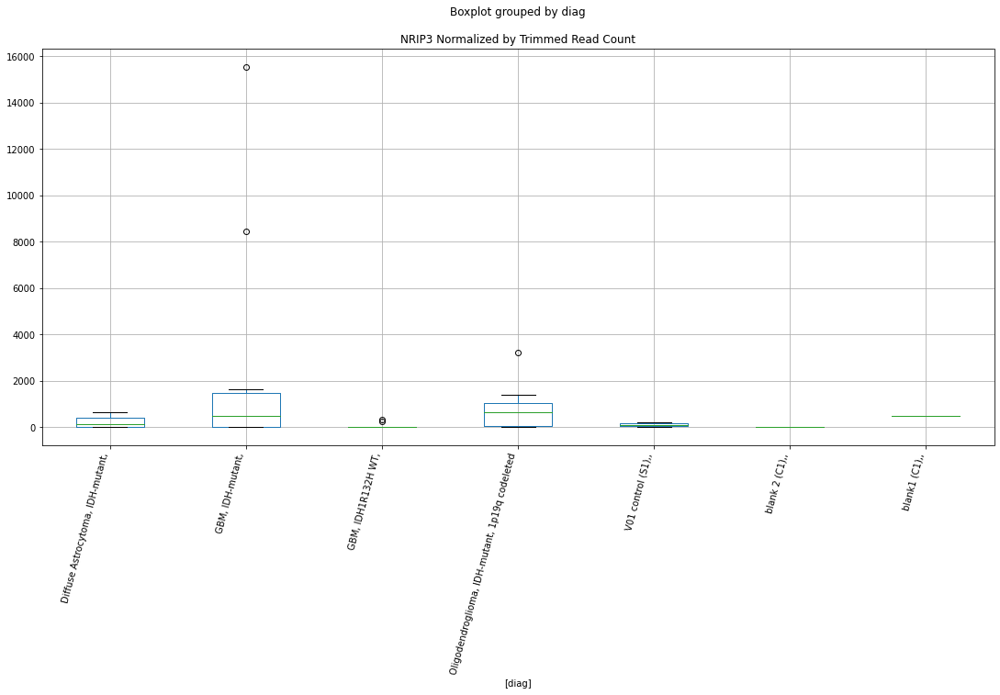

 p : 0.023684652990283914  ( t : 2.4711417146863477 ) :  Lexogen  :  cutadapt2  :  MIR25
Control and blanks
82     17040.61
346      420.87
Name: MIR25, dtype: float64
214    0.0
Name: MIR25, dtype: float64
478    474.92
Name: MIR25, dtype: float64


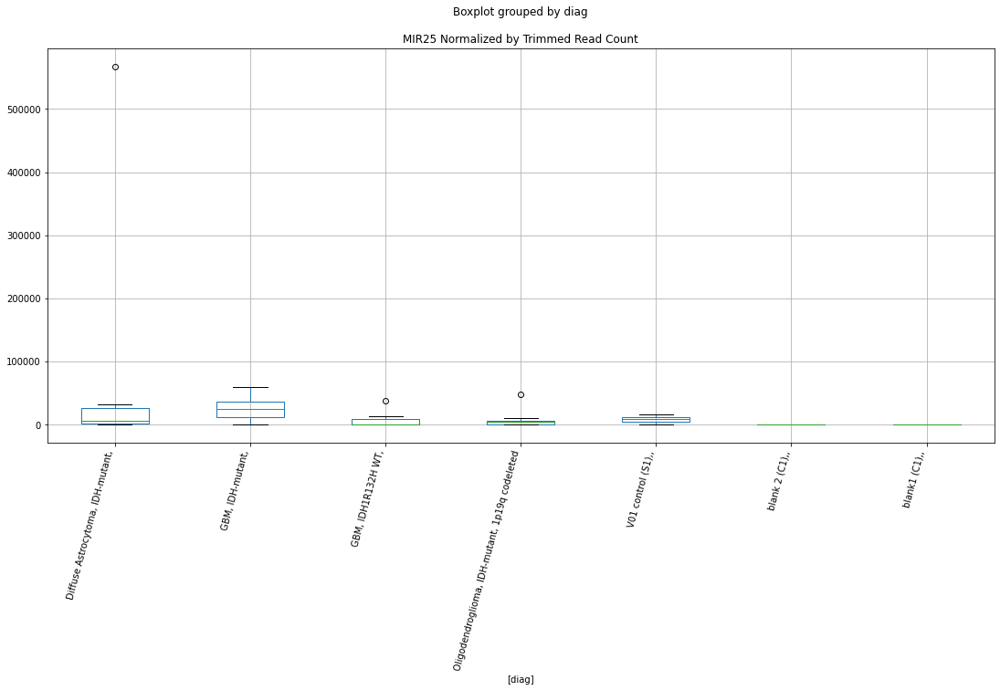

 p : 0.02371849541999205  ( t : 2.470452346116104 ) :  Lexogen  :  bbduk2  :  LRRIQ1
Control and blanks
79     0.0
343    0.0
Name: LRRIQ1, dtype: float64
211    2459.76
Name: LRRIQ1, dtype: float64
475    0.0
Name: LRRIQ1, dtype: float64


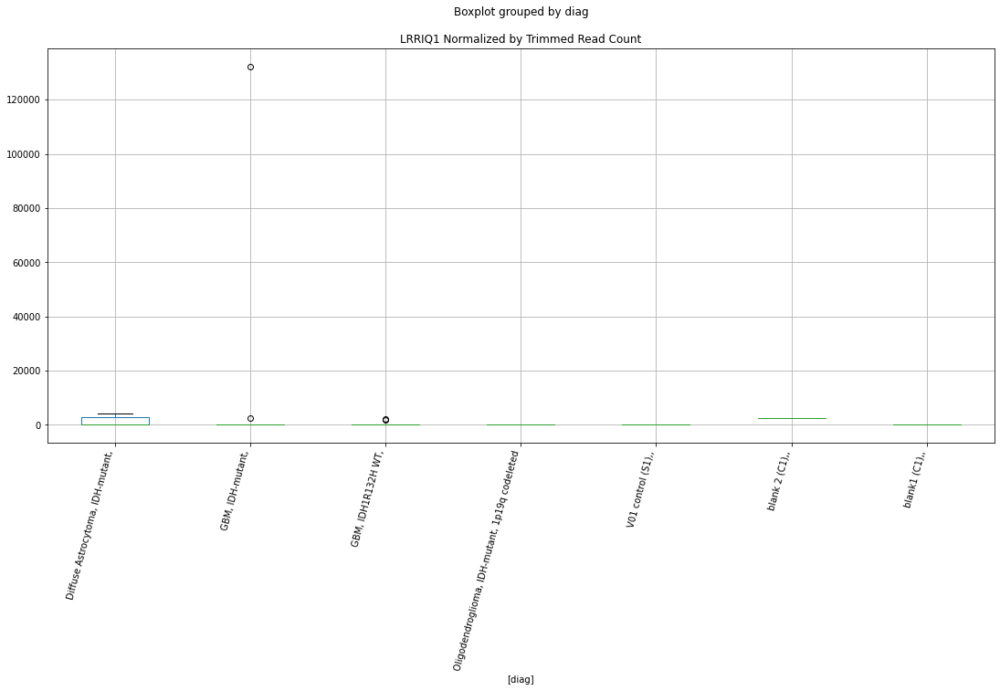

 p : 0.023789422033406355  ( t : 2.4690105697672813 ) :  Lexogen  :  cutadapt2  :  NRIP3
Control and blanks
82       0.00
346    210.43
Name: NRIP3, dtype: float64
214    0.0
Name: NRIP3, dtype: float64
478    474.92
Name: NRIP3, dtype: float64


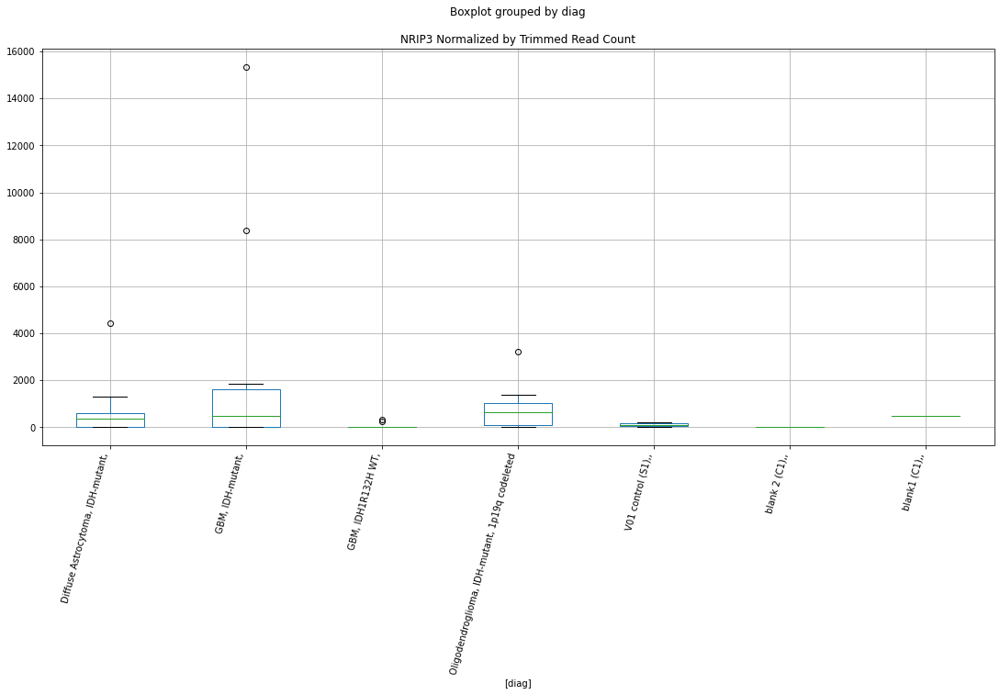

 p : 0.02397583405201358  ( t : 2.4652404188007058 ) :  Lexogen  :  cutadapt2  :  MIR101-1
Control and blanks
82     0.0
346    0.0
Name: MIR101-1, dtype: float64
214    0.0
Name: MIR101-1, dtype: float64
478    0.0
Name: MIR101-1, dtype: float64


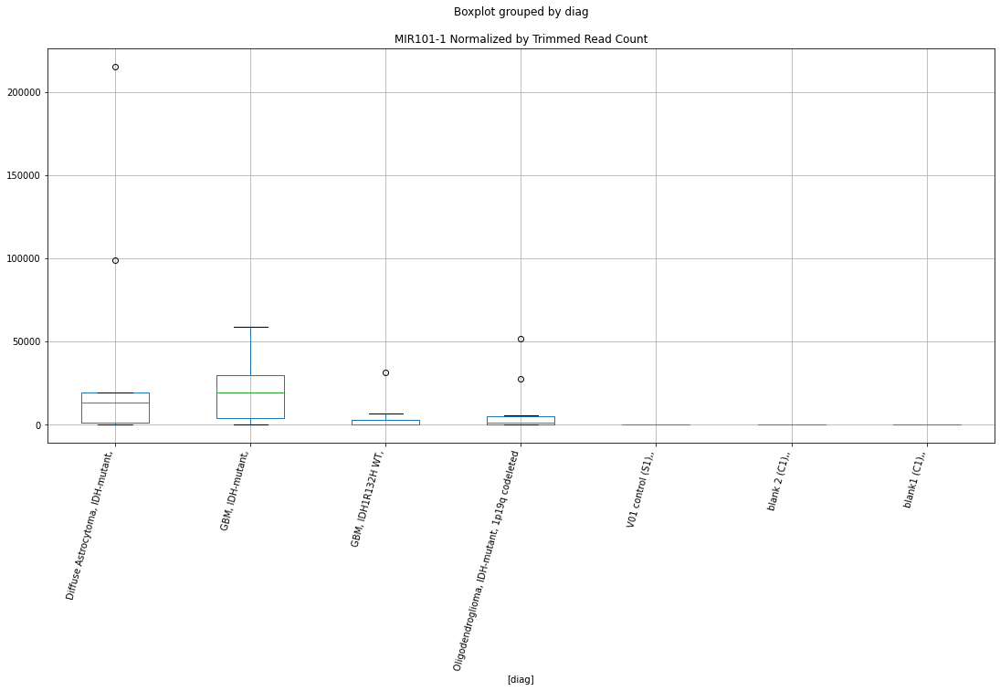

 p : 0.02405668057855987  ( t : 2.463613870658917 ) :  Lexogen  :  bbduk2  :  MIR101-2
Control and blanks
79     0.0
343    0.0
Name: MIR101-2, dtype: float64
211    0.0
Name: MIR101-2, dtype: float64
475    0.0
Name: MIR101-2, dtype: float64


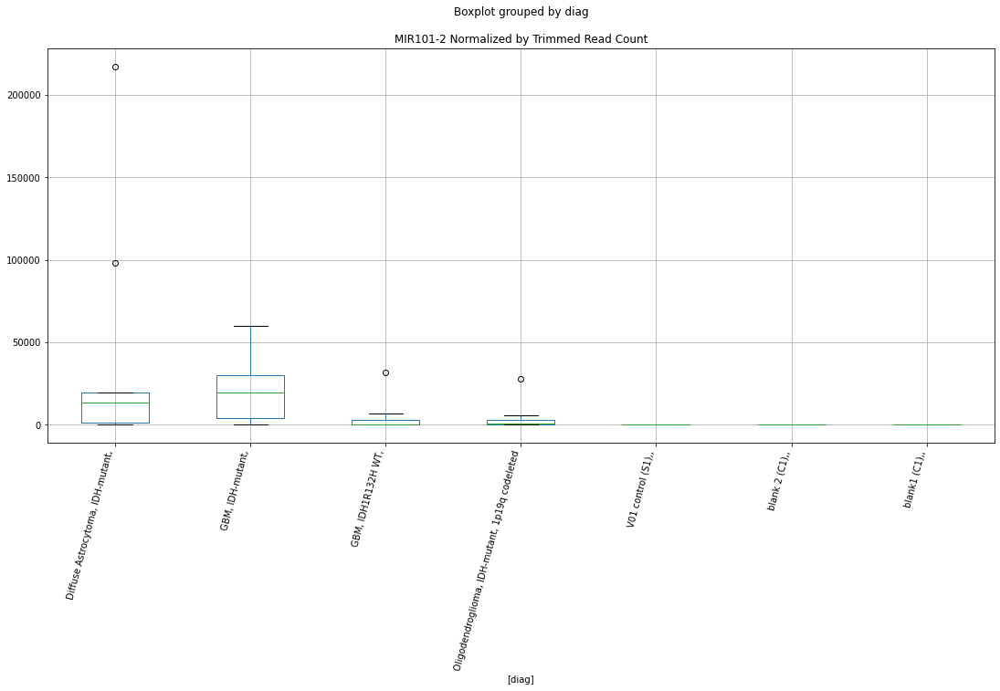

 p : 0.02405668057855987  ( t : 2.463613870658917 ) :  Lexogen  :  bbduk2  :  MIR101-1
Control and blanks
79     0.0
343    0.0
Name: MIR101-1, dtype: float64
211    0.0
Name: MIR101-1, dtype: float64
475    0.0
Name: MIR101-1, dtype: float64


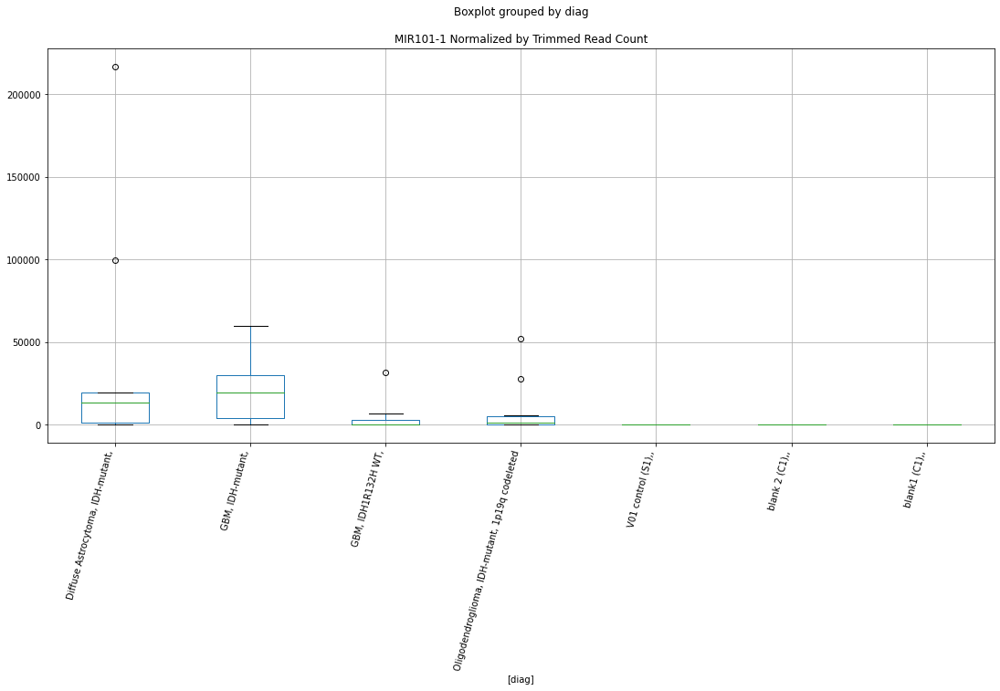

 p : 0.024102154092255055  ( t : 2.462701246705308 ) :  Lexogen  :  cutadapt2  :  MIR101-2
Control and blanks
82     0.0
346    0.0
Name: MIR101-2, dtype: float64
214    0.0
Name: MIR101-2, dtype: float64
478    0.0
Name: MIR101-2, dtype: float64


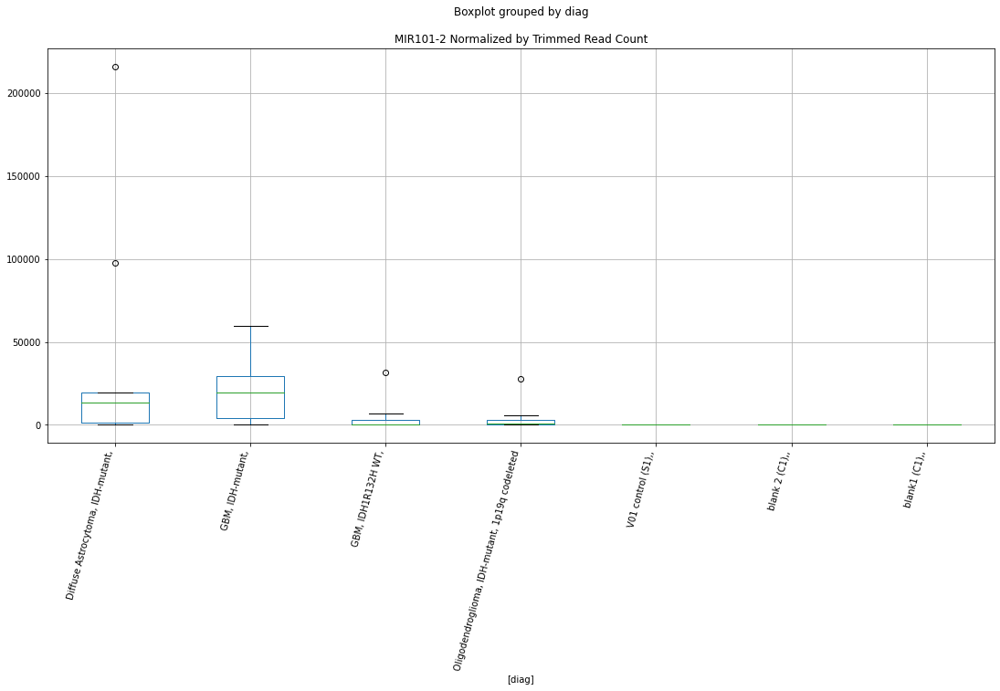

 p : 0.02438832925186275  ( t : 2.456994753386955 ) :  D-plex  :  bbduk2  :  LRCH3
Control and blanks
73     0.0
337    0.0
Name: LRCH3, dtype: float64
205    6268.18
Name: LRCH3, dtype: float64
469    0.0
Name: LRCH3, dtype: float64


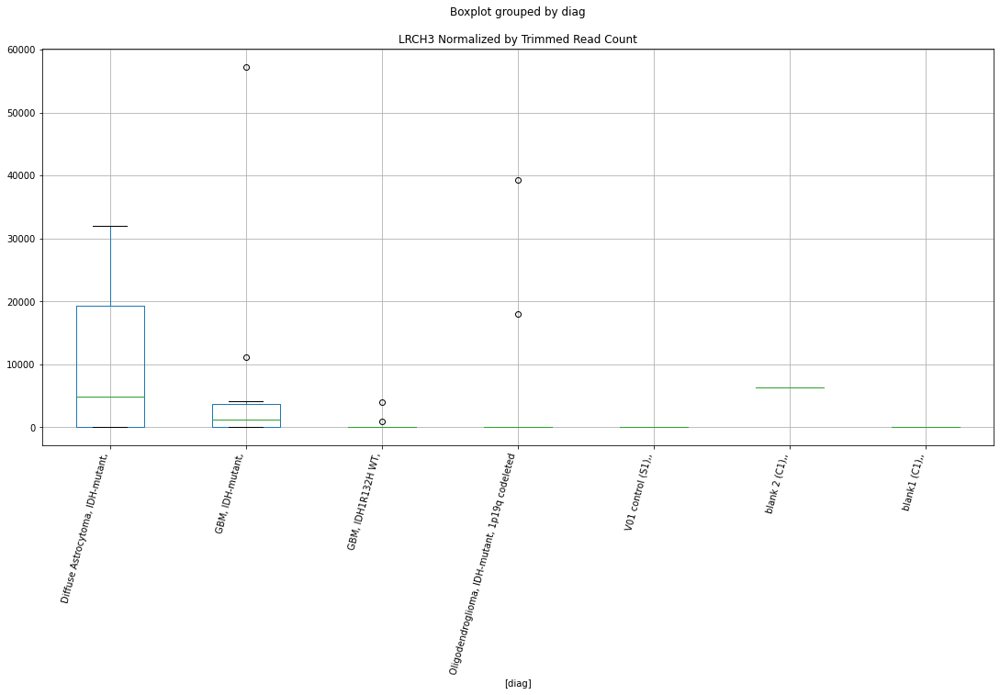

 p : 0.02443785956608835  ( t : 2.456013481654253 ) :  Lexogen  :  bbduk2  :  NEIL2
Control and blanks
79     0.0
343    0.0
Name: NEIL2, dtype: float64
211    0.0
Name: NEIL2, dtype: float64
475    0.0
Name: NEIL2, dtype: float64


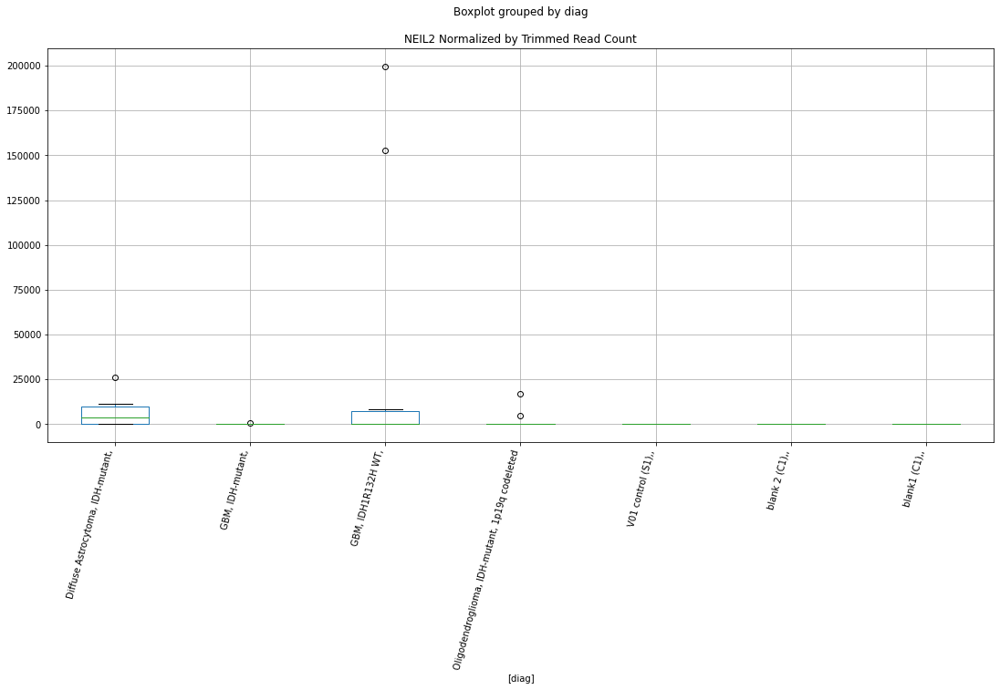

 p : 0.024441734825688972  ( t : 2.4559367856116734 ) :  Lexogen  :  bbduk2  :  MIR137HG
Control and blanks
79         0.00
343    16560.52
Name: MIR137HG, dtype: float64
211    0.0
Name: MIR137HG, dtype: float64
475    0.0
Name: MIR137HG, dtype: float64


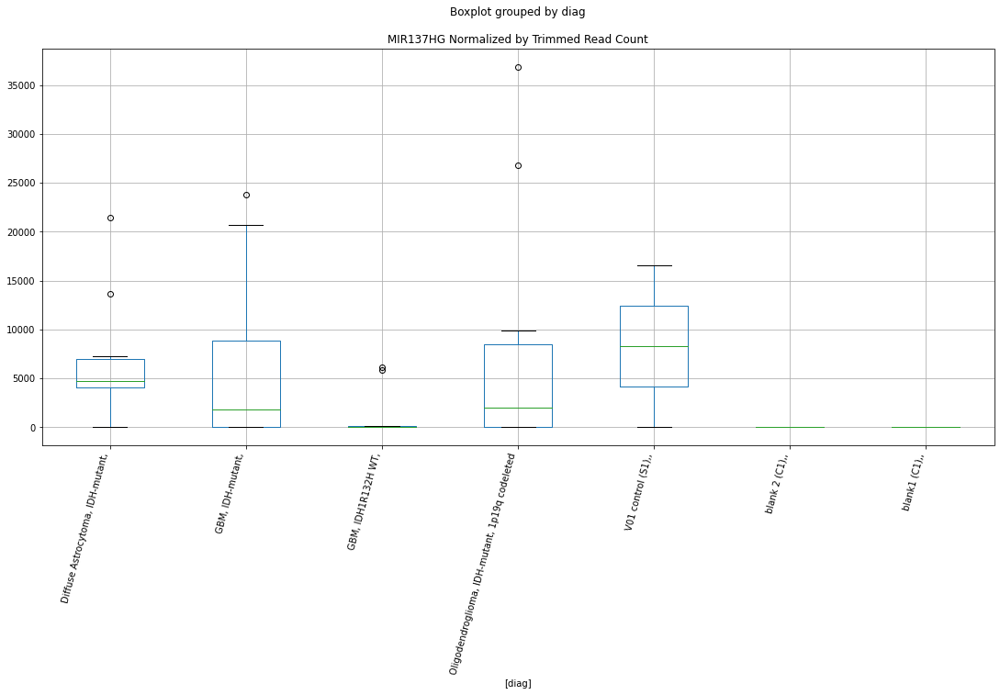

 p : 0.024441734825688972  ( t : 2.4559367856116734 ) :  Lexogen  :  bbduk2  :  MIR137
Control and blanks
79         0.00
343    16560.52
Name: MIR137, dtype: float64
211    0.0
Name: MIR137, dtype: float64
475    0.0
Name: MIR137, dtype: float64


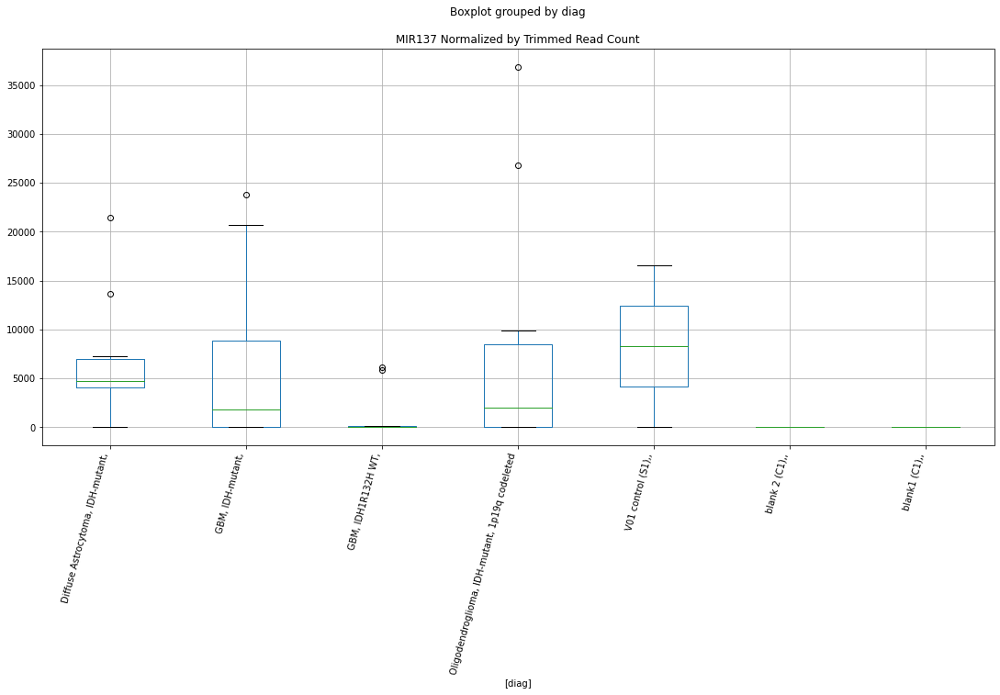

 p : 0.02454624928329971  ( t : 2.45387261456857 ) :  D-plex  :  bbduk2  :  MIEF2
Control and blanks
73     0.0
337    0.0
Name: MIEF2, dtype: float64
205    3760.91
Name: MIEF2, dtype: float64
469    2366.11
Name: MIEF2, dtype: float64


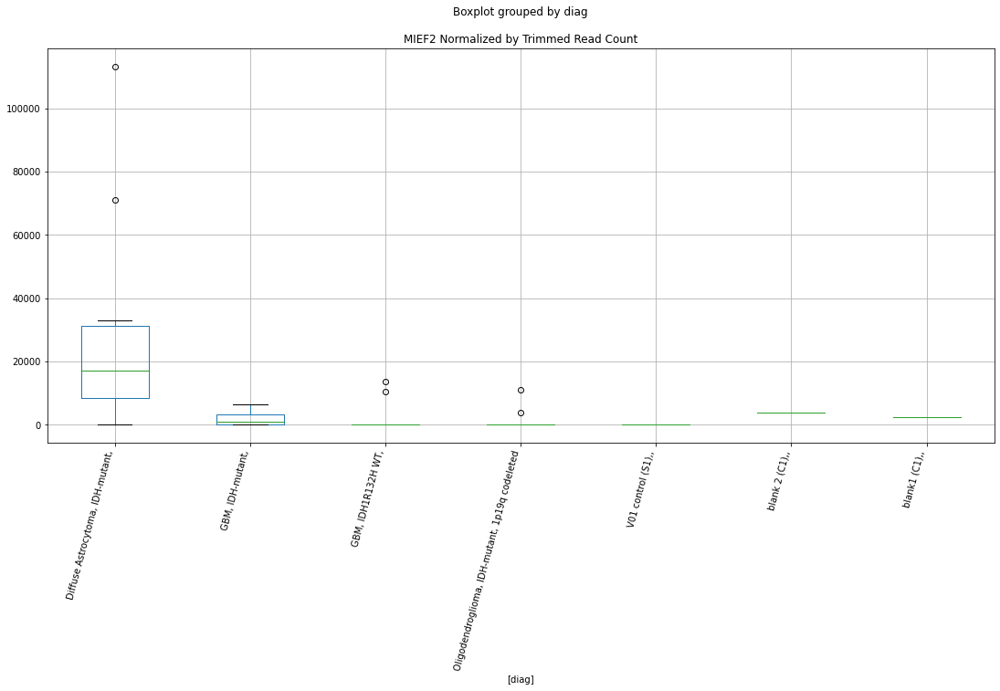

 p : 0.02457886280382419  ( t : 2.453230183684448 ) :  D-plex  :  bbduk2  :  MAPT-IT1
Control and blanks
73     0.0
337    0.0
Name: MAPT-IT1, dtype: float64
205    537.27
Name: MAPT-IT1, dtype: float64
469    1183.05
Name: MAPT-IT1, dtype: float64


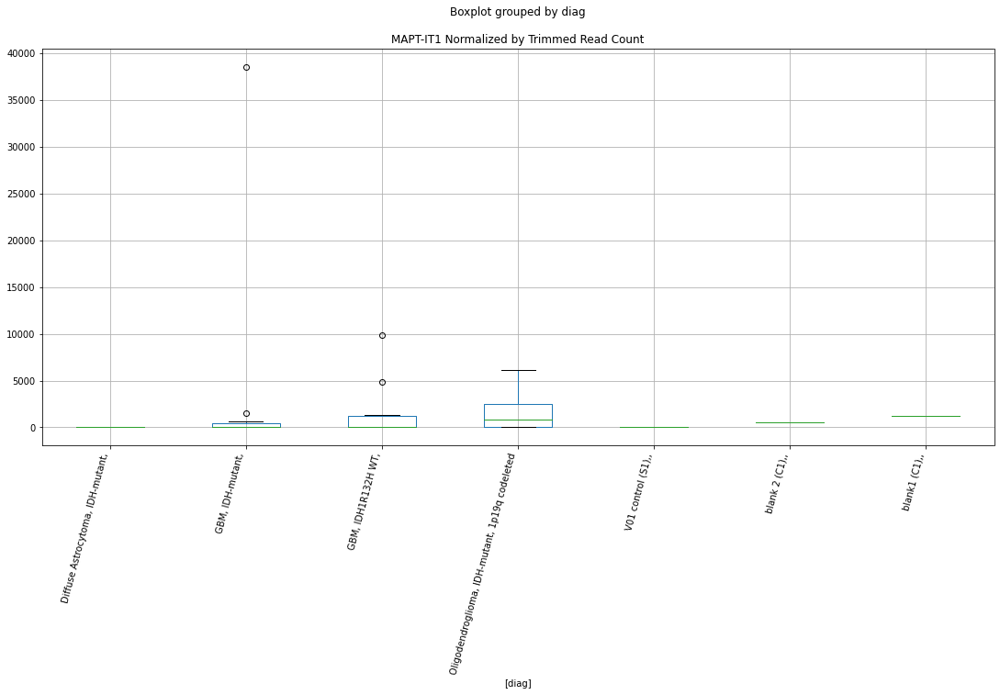

 p : 0.024736590201842424  ( t : 2.45013447403151 ) :  Lexogen  :  bbduk2  :  MUC6
Control and blanks
79     0.0
343    0.0
Name: MUC6, dtype: float64
211    13118.7
Name: MUC6, dtype: float64
475    0.0
Name: MUC6, dtype: float64


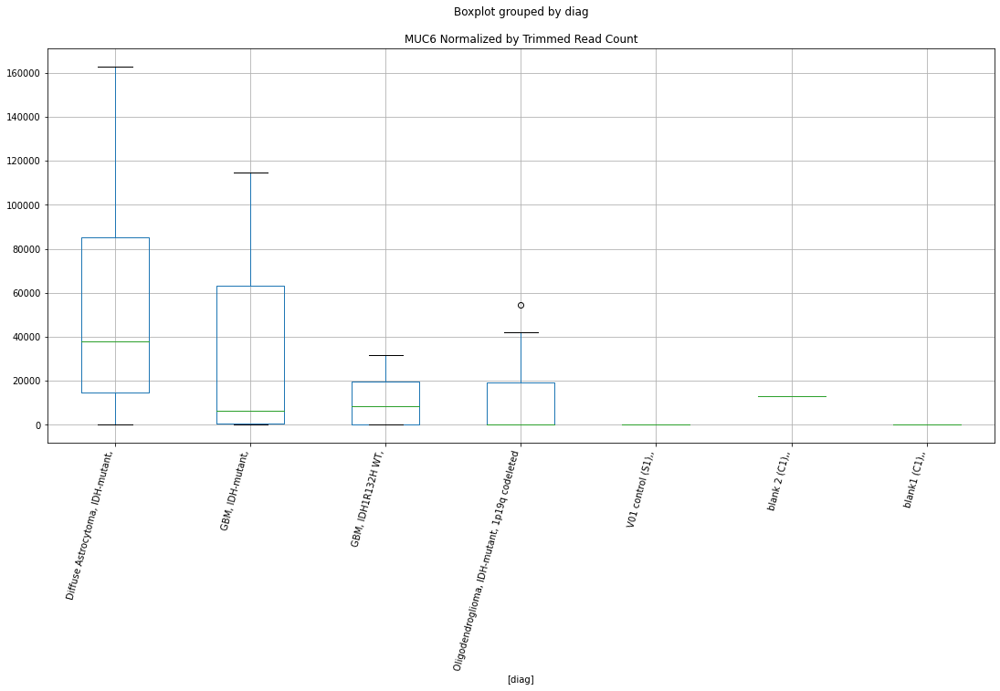

 p : 0.024760090773121007  ( t : 2.449674816315566 ) :  Lexogen  :  cutadapt2  :  MIR137
Control and blanks
82         0.00
346    16413.89
Name: MIR137, dtype: float64
214    0.0
Name: MIR137, dtype: float64
478    0.0
Name: MIR137, dtype: float64


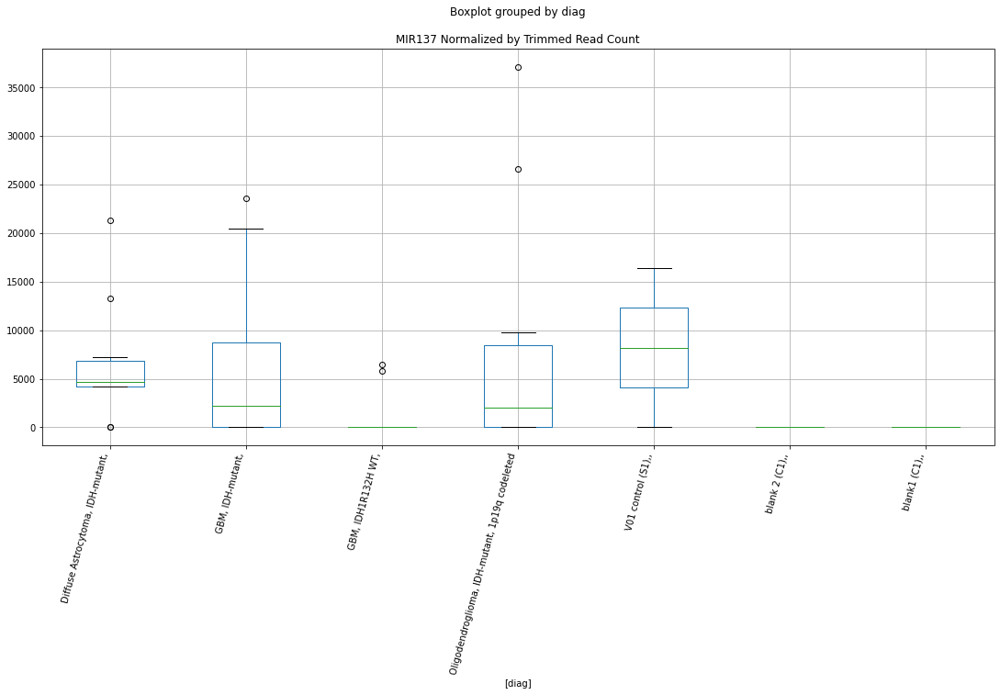

 p : 0.024760090773121007  ( t : 2.449674816315566 ) :  Lexogen  :  cutadapt2  :  MIR137HG
Control and blanks
82         0.00
346    16413.89
Name: MIR137HG, dtype: float64
214    0.0
Name: MIR137HG, dtype: float64
478    0.0
Name: MIR137HG, dtype: float64


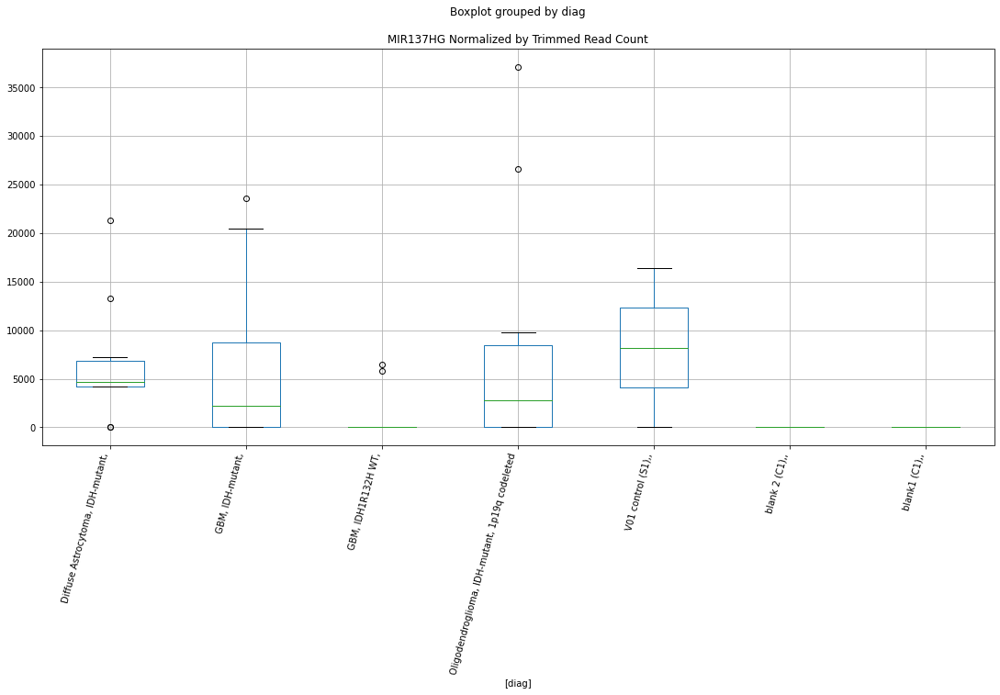

 p : 0.024845708874328958  ( t : 2.4480036321166923 ) :  D-plex  :  cutadapt2  :  LOC574538
Control and blanks
76     36365.48
340    17614.64
Name: LOC574538, dtype: float64
208    9523.45
Name: LOC574538, dtype: float64
472    6935.47
Name: LOC574538, dtype: float64


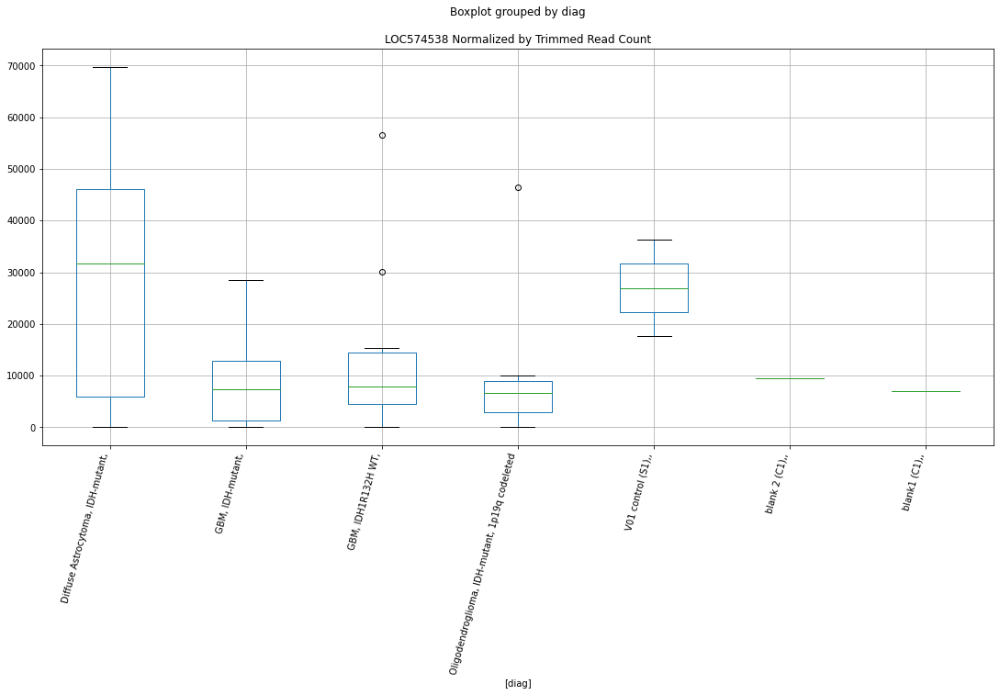

 p : 0.02490977718823847  ( t : 2.4467566115224315 ) :  Lexogen  :  bbduk2  :  MIR25
Control and blanks
79     17167.19
343      424.63
Name: MIR25, dtype: float64
211    0.0
Name: MIR25, dtype: float64
475    479.03
Name: MIR25, dtype: float64


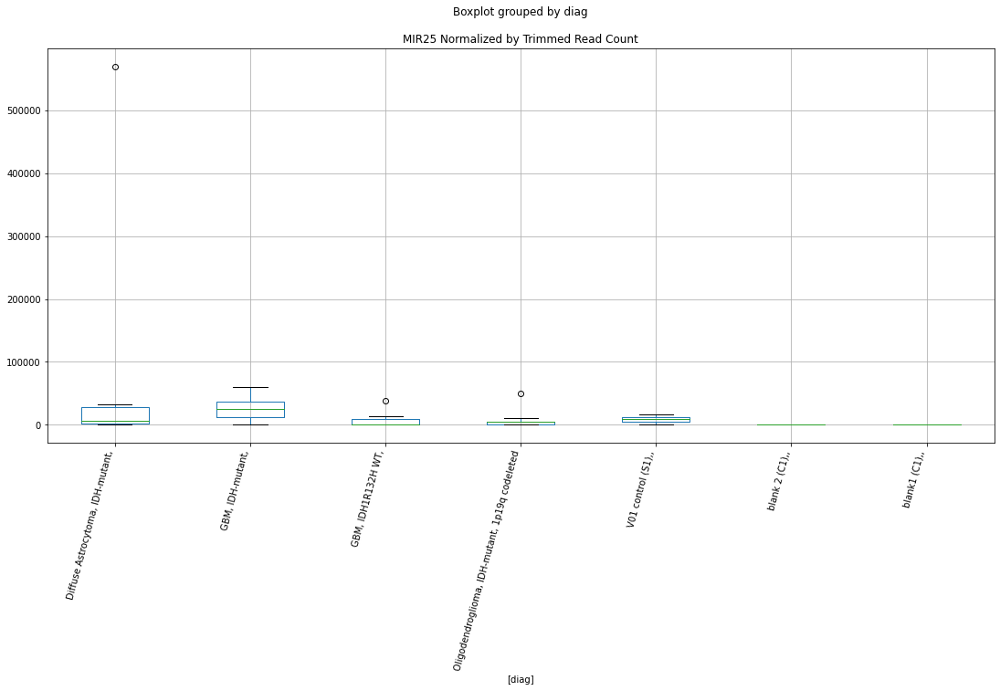

 p : 0.024981364694372198  ( t : 2.445366793848087 ) :  D-plex  :  cutadapt2  :  NIM1K
Control and blanks
76     0.0
340    0.0
Name: NIM1K, dtype: float64
208    881.8
Name: NIM1K, dtype: float64
472    0.0
Name: NIM1K, dtype: float64


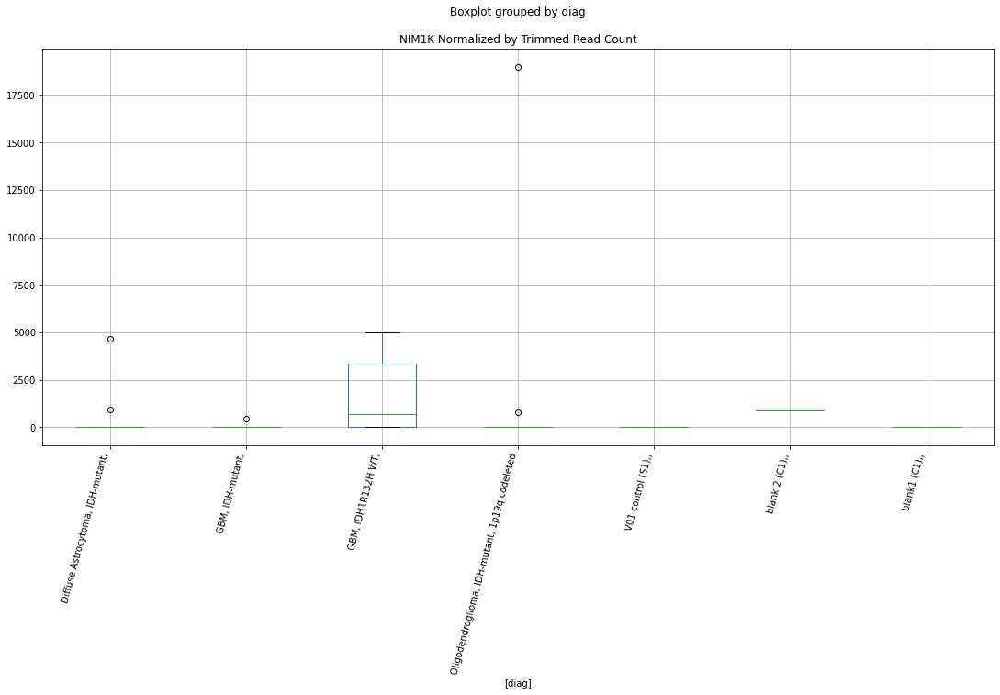

 p : 0.025017670397208997  ( t : 2.4446633736916388 ) :  D-plex  :  bbduk2  :  LYSMD3
Control and blanks
73     0.0
337    0.0
Name: LYSMD3, dtype: float64
205    537.27
Name: LYSMD3, dtype: float64
469    0.0
Name: LYSMD3, dtype: float64


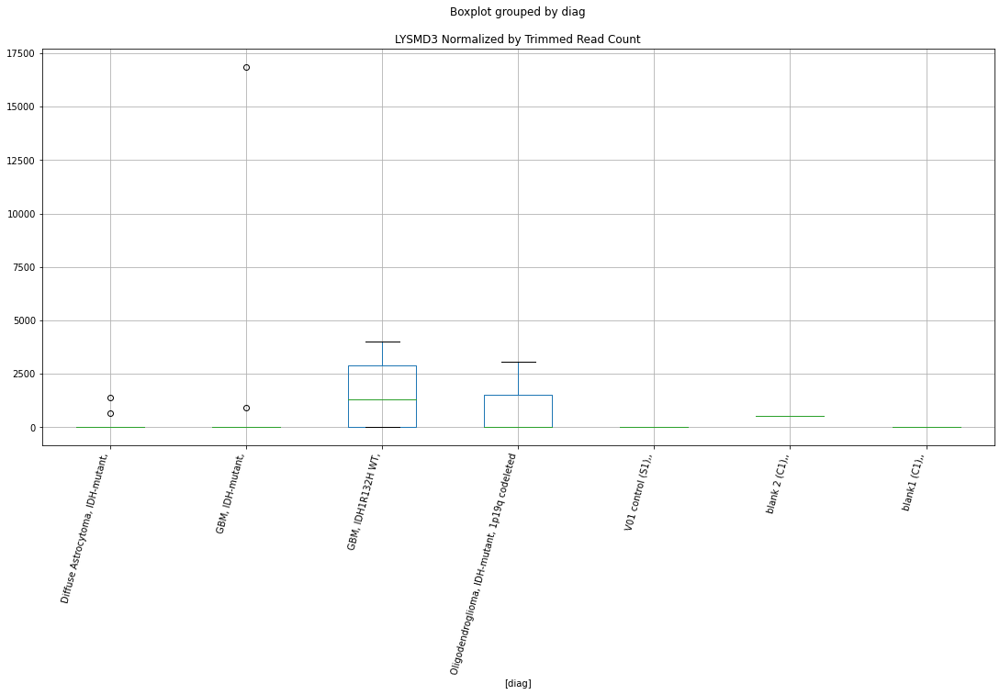

 p : 0.02511175275248309  ( t : 2.4428449830957364 ) :  D-plex  :  bbduk2  :  LOC574538
Control and blanks
73     37104.40
337    17803.15
Name: LOC574538, dtype: float64
205    10029.09
Name: LOC574538, dtype: float64
469    7098.33
Name: LOC574538, dtype: float64


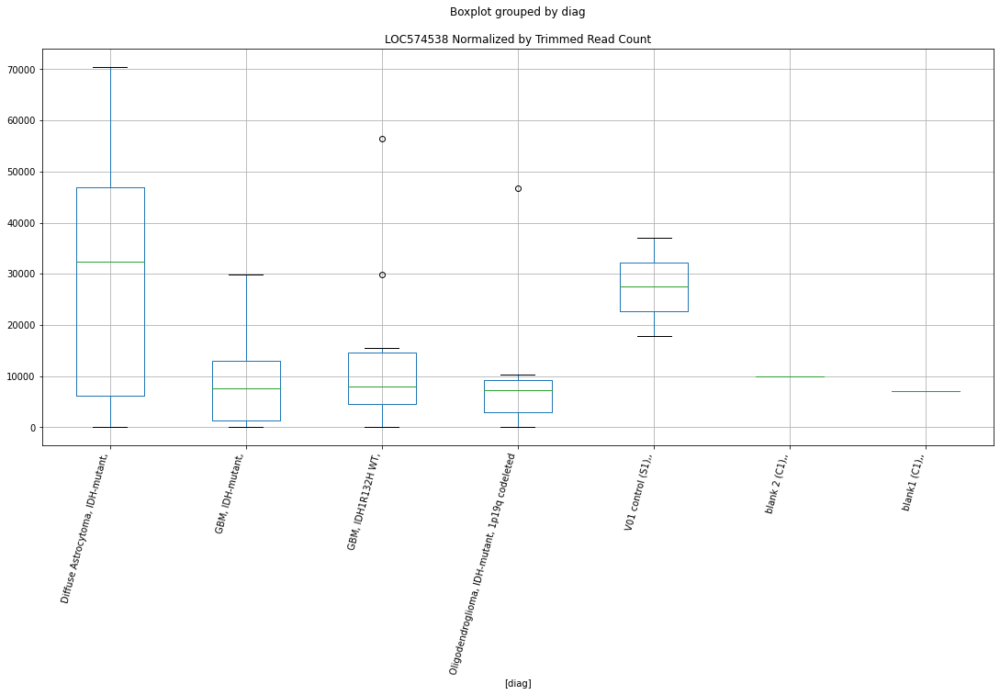

 p : 0.025150013178414147  ( t : 2.442107326807988 ) :  D-plex  :  bbduk2  :  NUP210P1
Control and blanks
73     0.0
337    0.0
Name: NUP210P1, dtype: float64
205    179.09
Name: NUP210P1, dtype: float64
469    0.0
Name: NUP210P1, dtype: float64


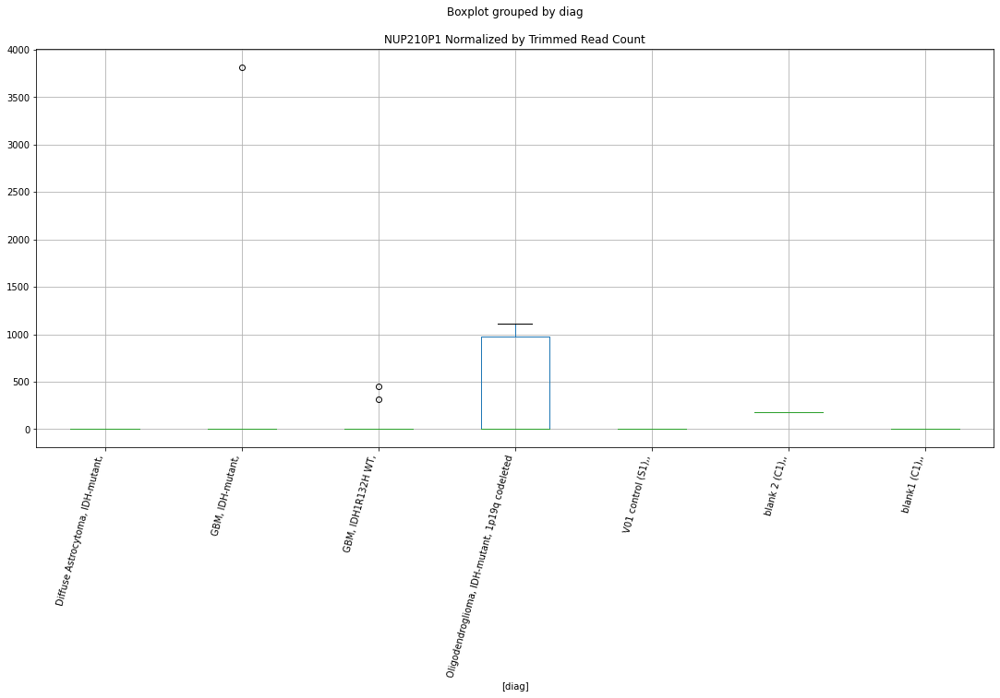

 p : 0.02515670507251903  ( t : 2.441978416104108 ) :  D-plex  :  cutadapt2  :  NUP210P1
Control and blanks
76     0.0
340    0.0
Name: NUP210P1, dtype: float64
208    176.36
Name: NUP210P1, dtype: float64
472    0.0
Name: NUP210P1, dtype: float64


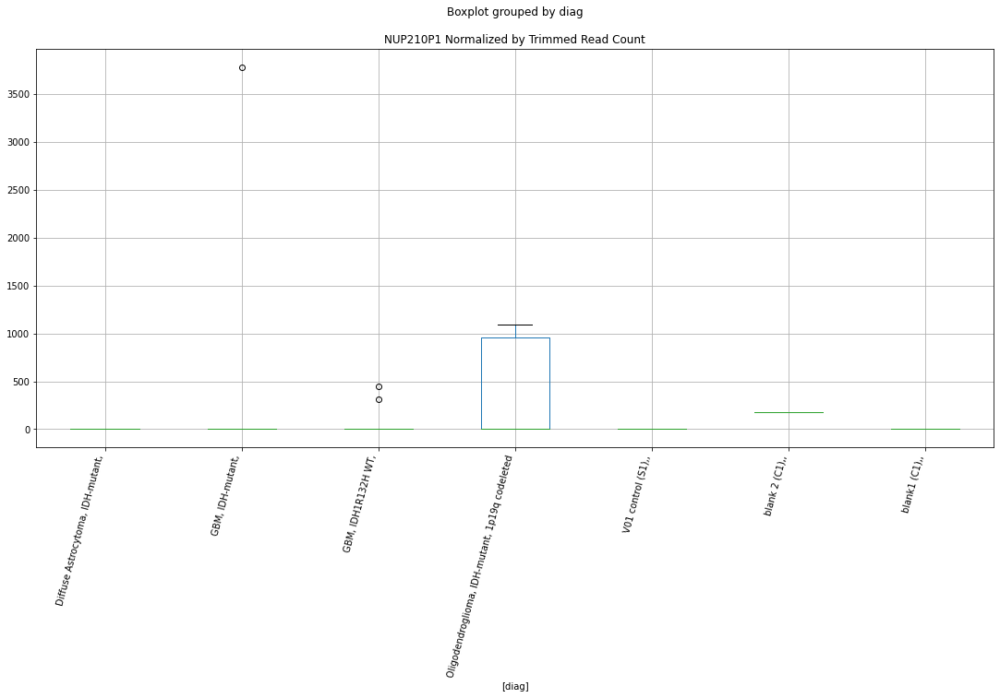

 p : 0.02544721434498987  ( t : 2.436412911386619 ) :  D-plex  :  bbduk2  :  MEOX2
Control and blanks
73     0.0
337    0.0
Name: MEOX2, dtype: float64
205    0.0
Name: MEOX2, dtype: float64
469    1183.05
Name: MEOX2, dtype: float64


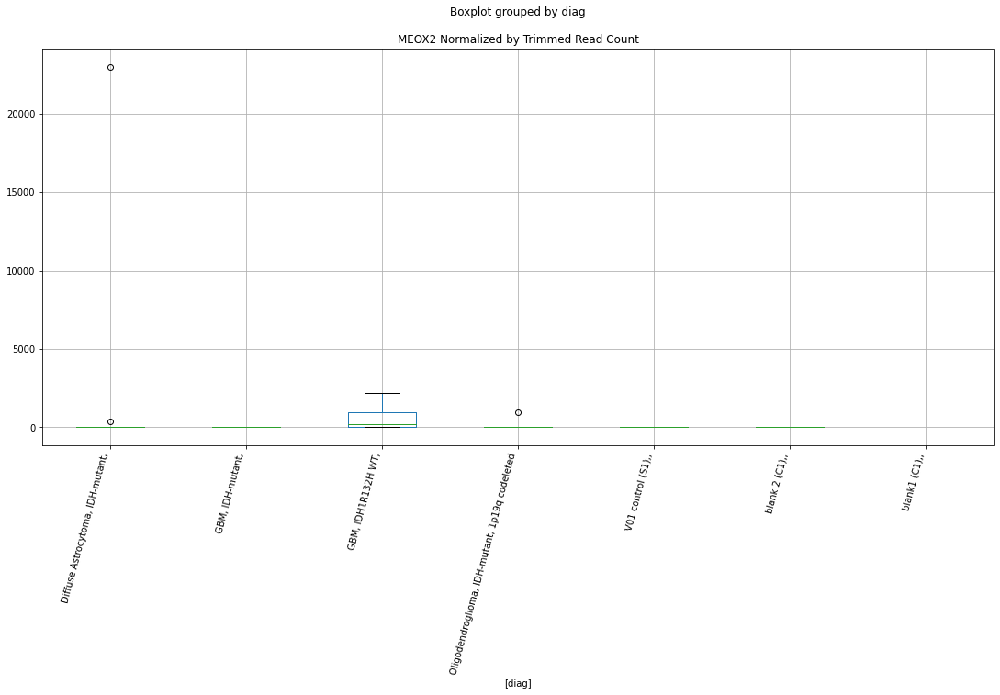

 p : 0.02549697792971369  ( t : 2.435465535668447 ) :  D-plex  :  bbduk2  :  LOC653160
Control and blanks
73     0.0
337    0.0
Name: LOC653160, dtype: float64
205    179.09
Name: LOC653160, dtype: float64
469    0.0
Name: LOC653160, dtype: float64


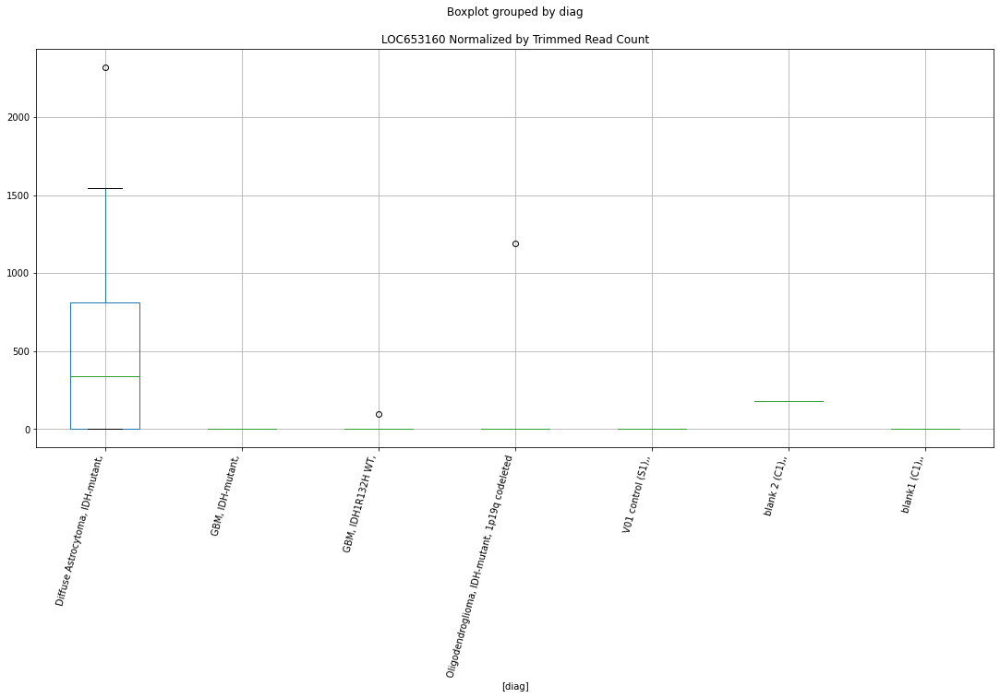

 p : 0.025527595532977402  ( t : 2.4348835133363456 ) :  D-plex  :  cutadapt2  :  MIEF2
Control and blanks
76     0.0
340    0.0
Name: MIEF2, dtype: float64
208    6172.61
Name: MIEF2, dtype: float64
472    2311.82
Name: MIEF2, dtype: float64


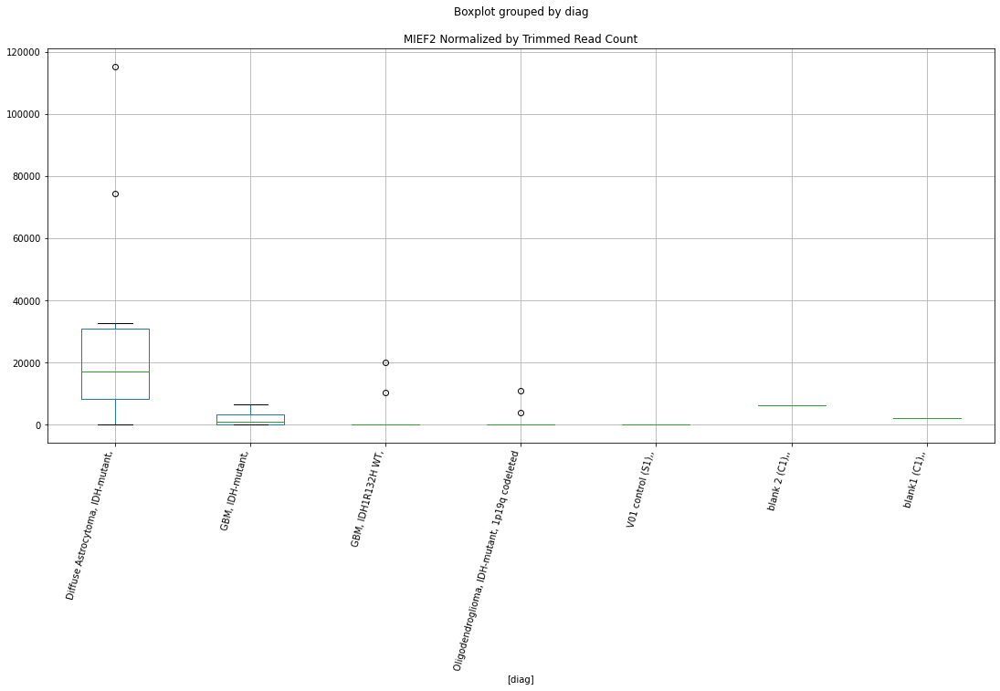

 p : 0.02562937856888379  ( t : 2.432953372231954 ) :  D-plex  :  cutadapt2  :  LOC112268061
Control and blanks
76     0.0
340    0.0
Name: LOC112268061, dtype: float64
208    705.44
Name: LOC112268061, dtype: float64
472    2311.82
Name: LOC112268061, dtype: float64


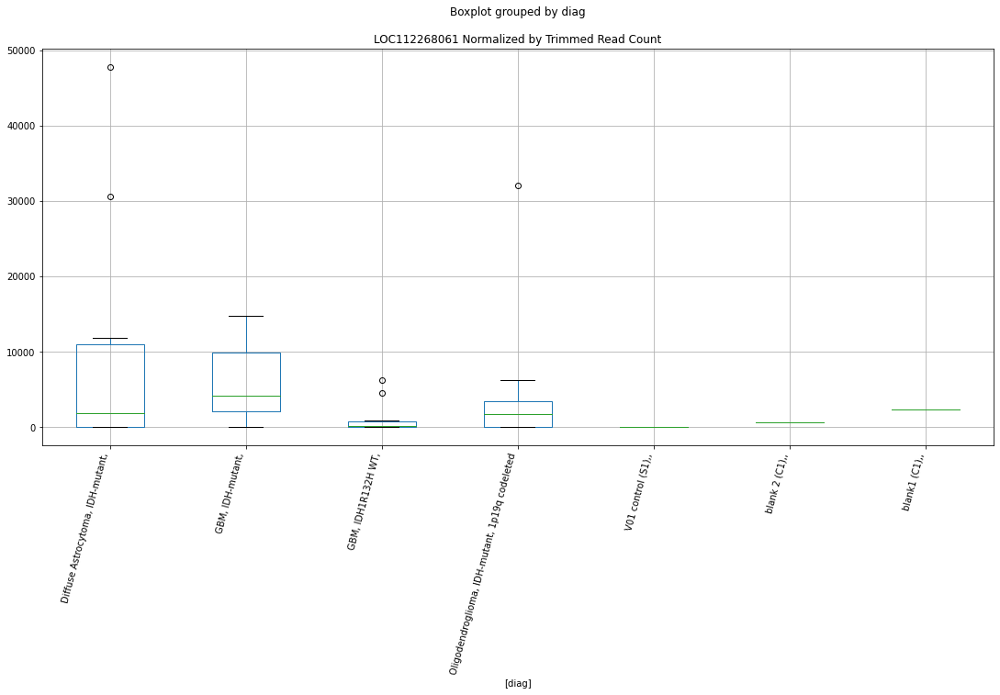

 p : 0.02565966117067088  ( t : 2.4323805015843076 ) :  Lexogen  :  bbduk2  :  LOC112268057
Control and blanks
79     0.0
343    0.0
Name: LOC112268057, dtype: float64
211    0.0
Name: LOC112268057, dtype: float64
475    0.0
Name: LOC112268057, dtype: float64


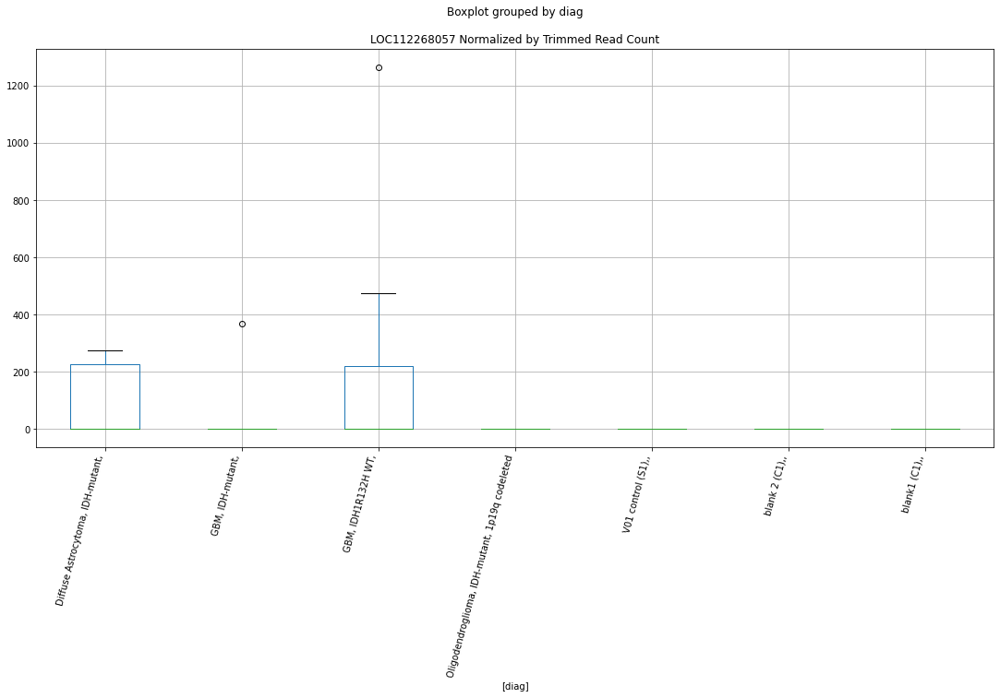

 p : 0.02574206775123776  ( t : 2.4308247794644906 ) :  D-plex  :  bbduk2  :  LSM6
Control and blanks
73       0.00
337    890.16
Name: LSM6, dtype: float64
205    179.09
Name: LSM6, dtype: float64
469    591.53
Name: LSM6, dtype: float64


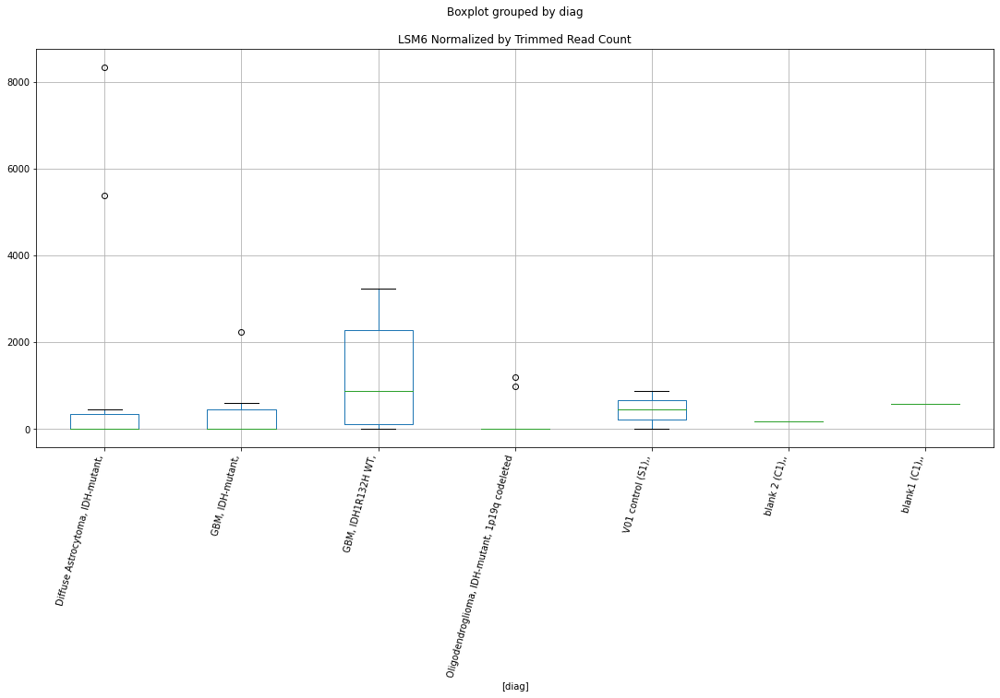

 p : 0.025834598372181893  ( t : 2.429083483540956 ) :  D-plex  :  cutadapt2  :  MYO1C
Control and blanks
76     40911.17
340     5284.39
Name: MYO1C, dtype: float64
208    121688.55
Name: MYO1C, dtype: float64
472    55483.76
Name: MYO1C, dtype: float64


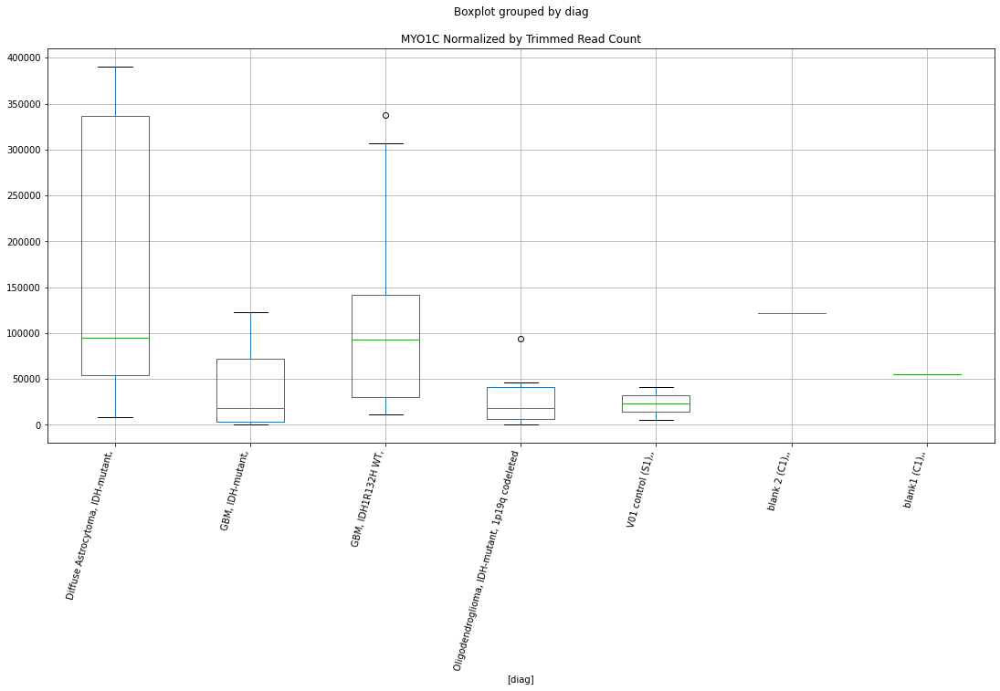

 p : 0.025882381719077422  ( t : 2.428186555707487 ) :  D-plex  :  cutadapt2  :  LSM6
Control and blanks
76       0.00
340    880.73
Name: LSM6, dtype: float64
208    176.36
Name: LSM6, dtype: float64
472    577.96
Name: LSM6, dtype: float64


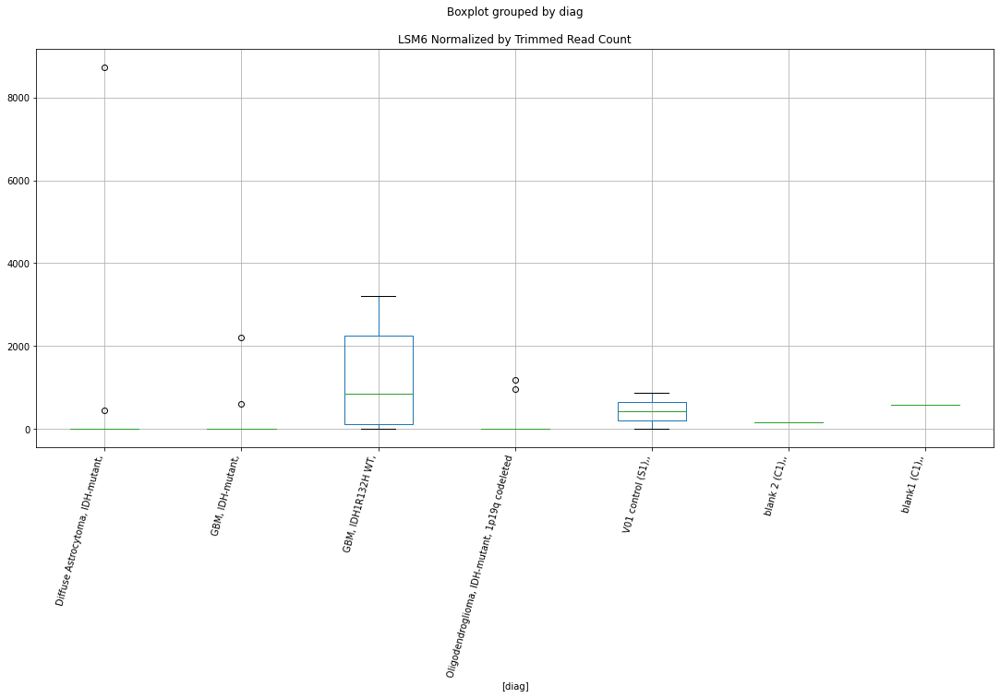

 p : 0.025993151084639718  ( t : 2.426113288663198 ) :  D-plex  :  cutadapt2  :  NCR3LG1
Control and blanks
76     310621.83
340       880.73
Name: NCR3LG1, dtype: float64
208    12521.58
Name: NCR3LG1, dtype: float64
472    238117.81
Name: NCR3LG1, dtype: float64


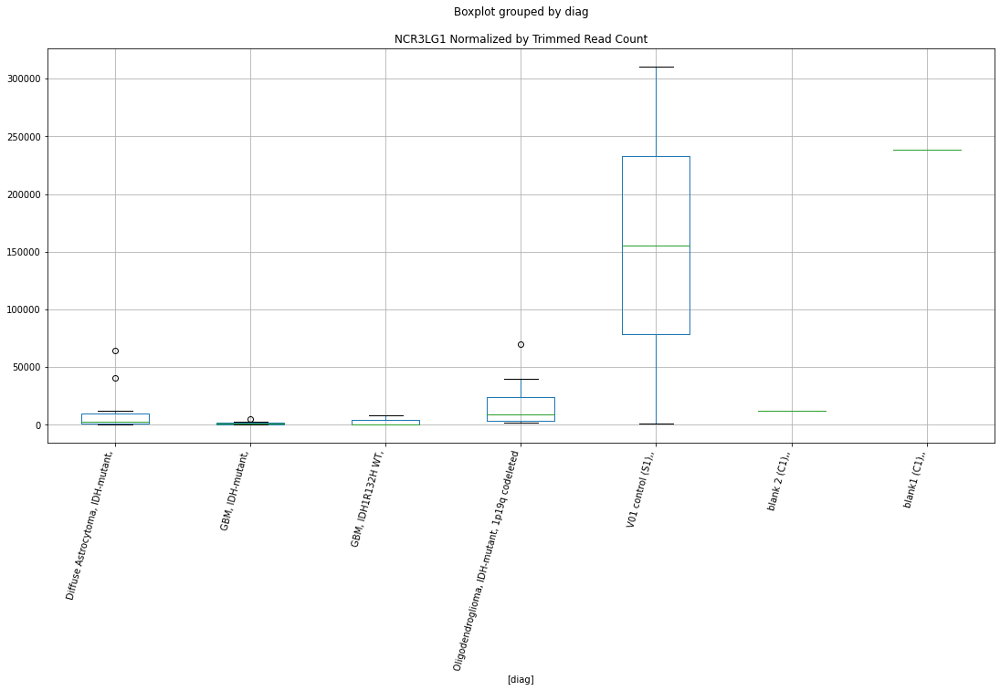

 p : 0.02605878399938771  ( t : 2.4248887418384193 ) :  D-plex  :  cutadapt2  :  MISP
Control and blanks
76     13637.06
340     2642.20
Name: MISP, dtype: float64
208    11992.49
Name: MISP, dtype: float64
472    10403.21
Name: MISP, dtype: float64


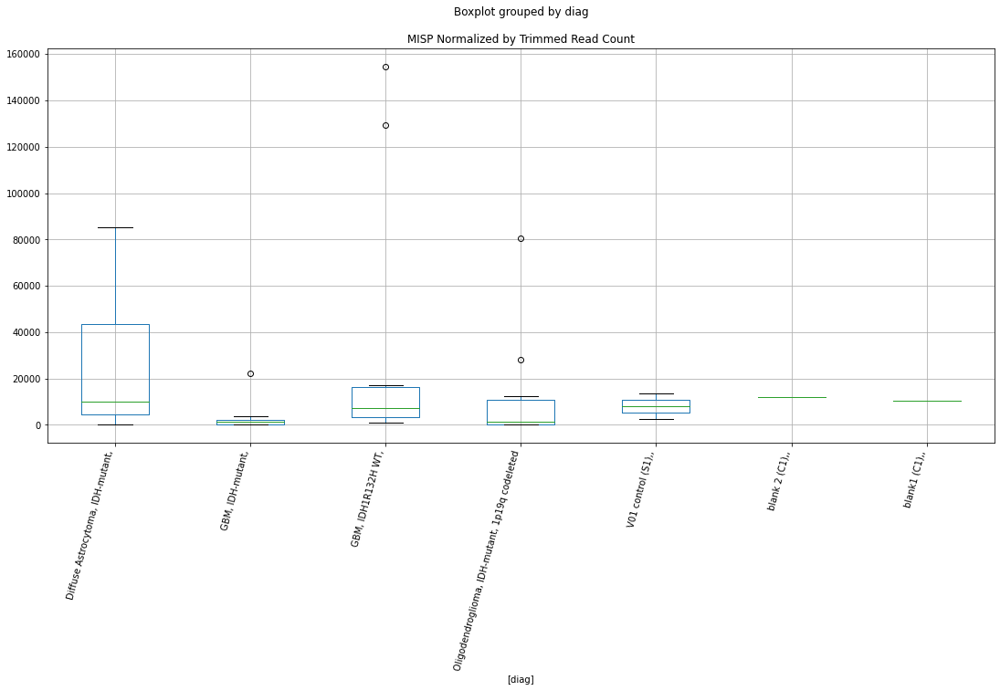

 p : 0.026136844939777228  ( t : 2.4234360756177176 ) :  D-plex  :  bbduk2  :  MIXL1
Control and blanks
73     0.0
337    0.0
Name: MIXL1, dtype: float64
205    51578.19
Name: MIXL1, dtype: float64
469    0.0
Name: MIXL1, dtype: float64


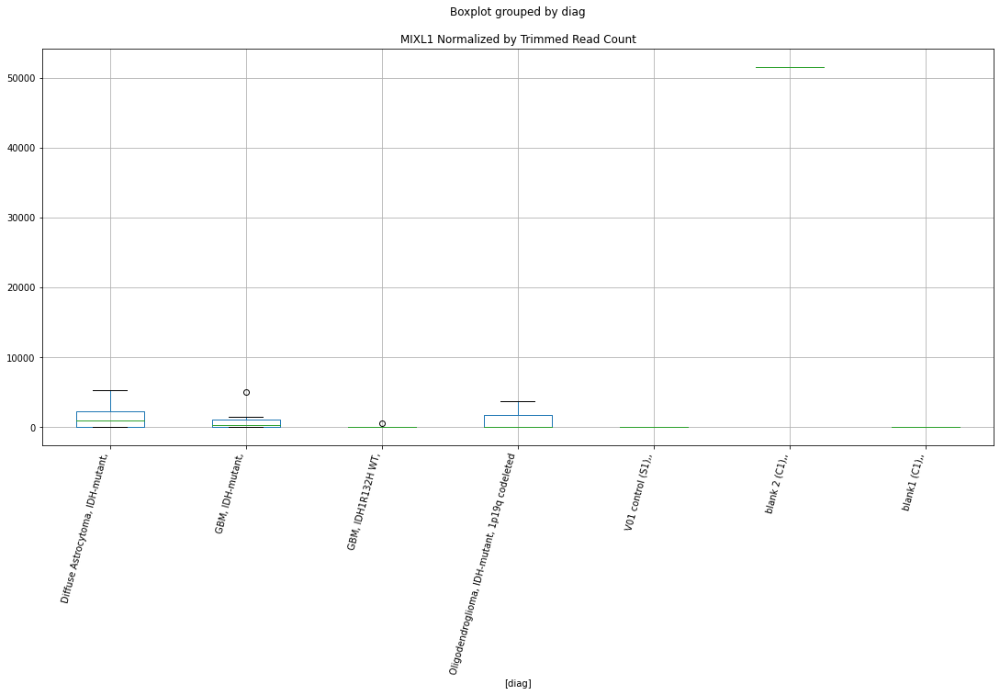

 p : 0.02614905953036427  ( t : 2.423209137424315 ) :  Lexogen  :  cutadapt2  :  MIR185
Control and blanks
82     1420.05
346       0.00
Name: MIR185, dtype: float64
214    0.0
Name: MIR185, dtype: float64
478    9498.42
Name: MIR185, dtype: float64


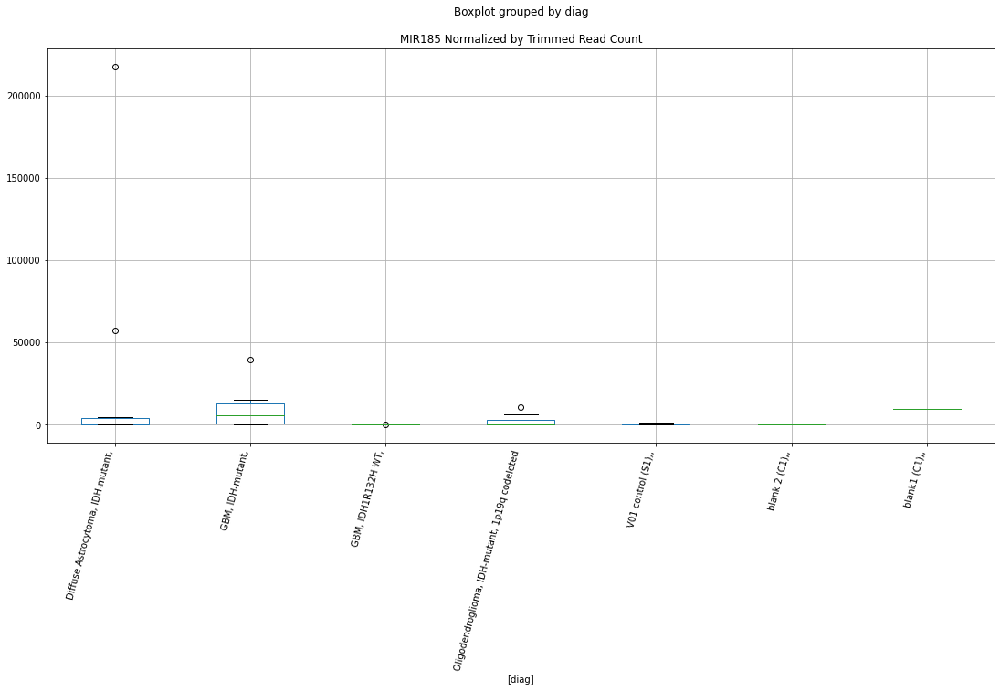

 p : 0.02630233536483248  ( t : 2.420369794213539 ) :  Lexogen  :  cutadapt2  :  MON1B
Control and blanks
82     0.0
346    0.0
Name: MON1B, dtype: float64
214    5695.76
Name: MON1B, dtype: float64
478    20659.06
Name: MON1B, dtype: float64


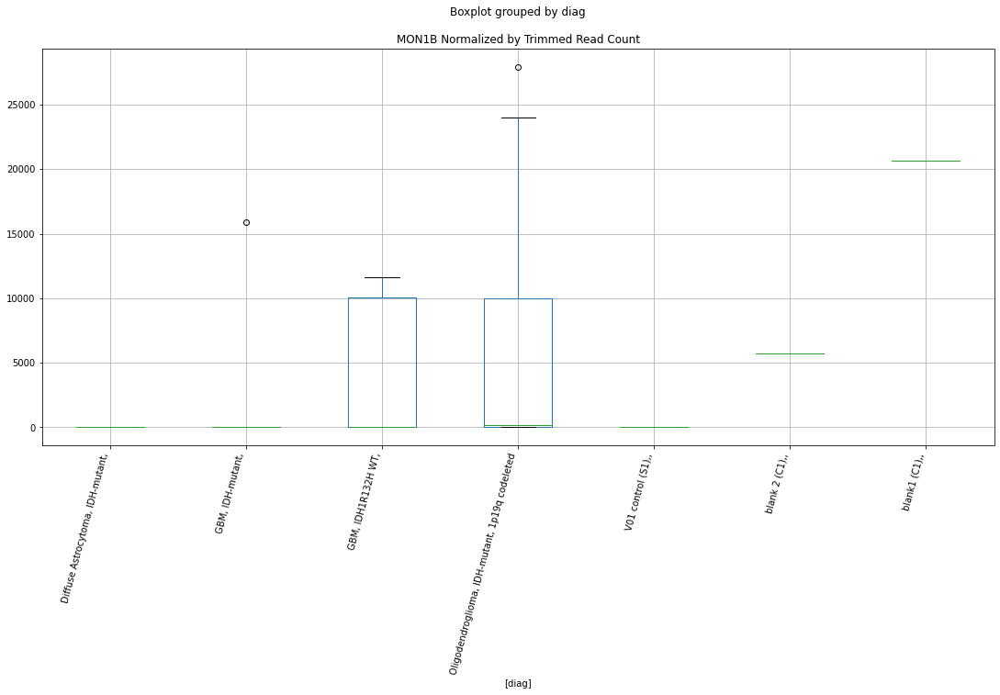

 p : 0.026350574209195697  ( t : 2.4194794042079173 ) :  Lexogen  :  bbduk2  :  MON1B
Control and blanks
79     0.0
343    0.0
Name: MON1B, dtype: float64
211    5739.43
Name: MON1B, dtype: float64
475    20837.87
Name: MON1B, dtype: float64


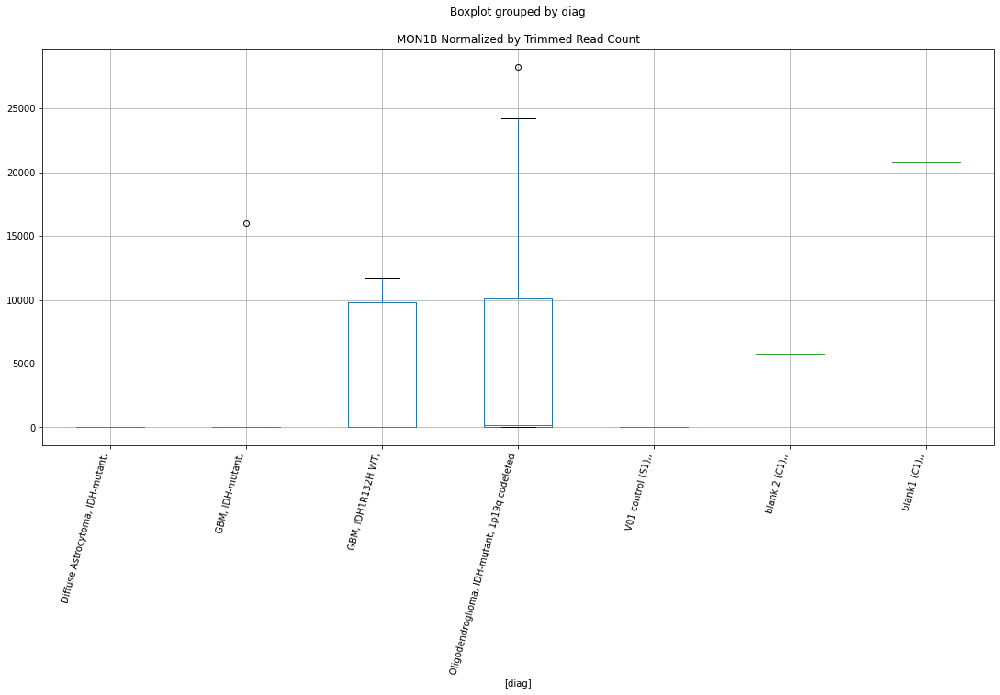

 p : 0.026523439488985973  ( t : 2.4163011533440257 ) :  D-plex  :  bbduk2  :  MST1L
Control and blanks
73     0.0
337    0.0
Name: MST1L, dtype: float64
205    537.27
Name: MST1L, dtype: float64
469    1183.05
Name: MST1L, dtype: float64


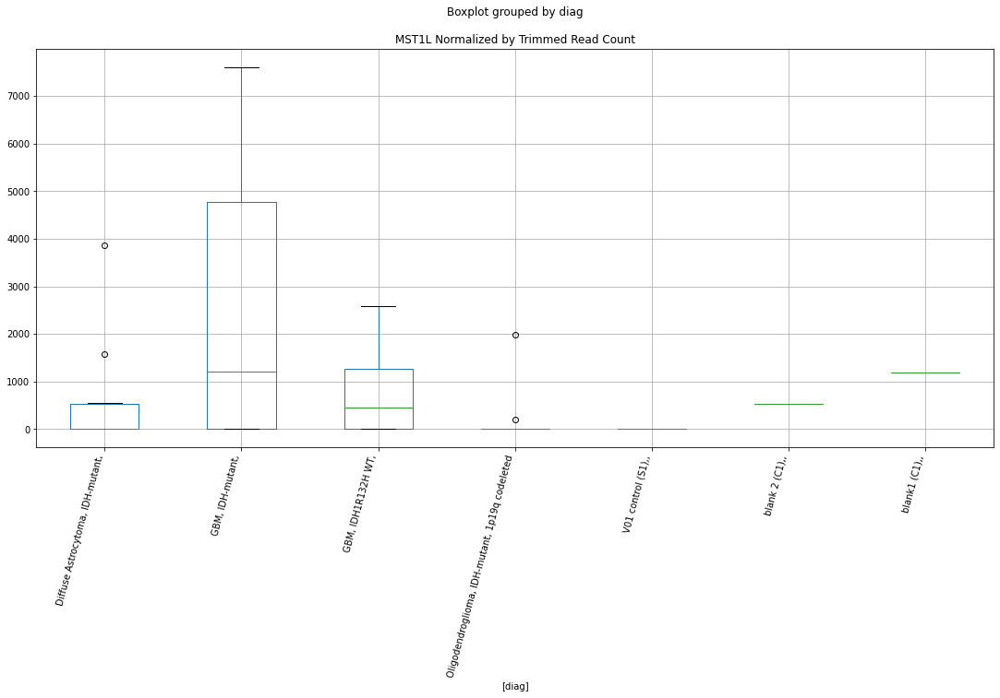

 p : 0.02653645426695229  ( t : 2.416062653185908 ) :  D-plex  :  bbduk2  :  MAPK1
Control and blanks
73     398099.33
337    195834.60
Name: MAPK1, dtype: float64
205    234967.33
Name: MAPK1, dtype: float64
469    3.89e+06
Name: MAPK1, dtype: float64


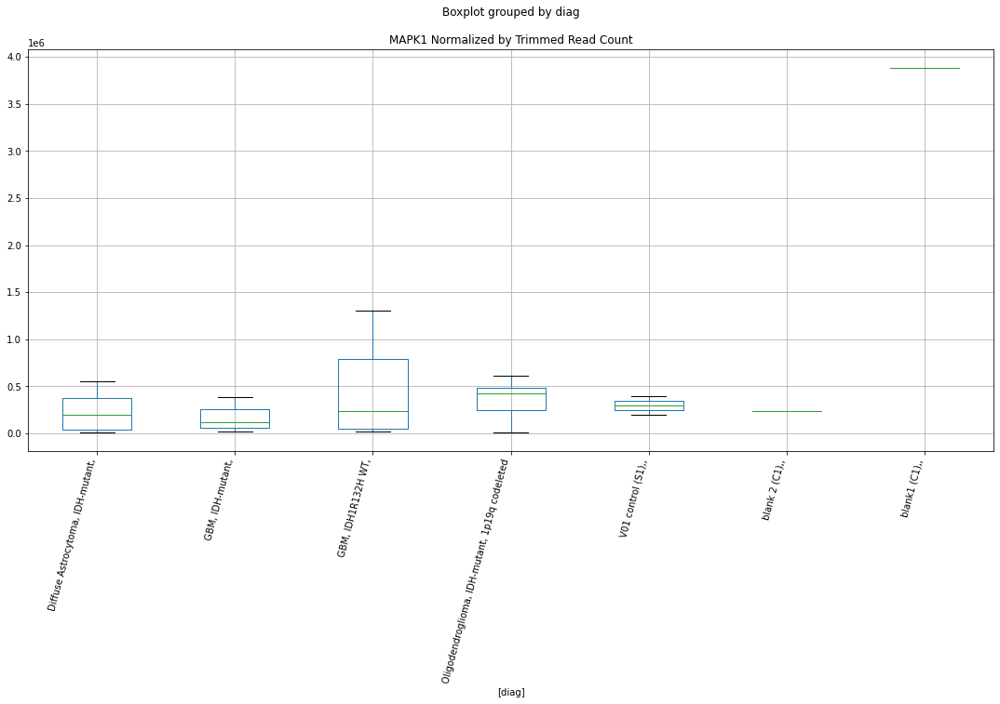

 p : 0.026548405771672935  ( t : 2.415843734307507 ) :  D-plex  :  bbduk2  :  LOC112267875
Control and blanks
73     0.0
337    0.0
Name: LOC112267875, dtype: float64
205    2328.18
Name: LOC112267875, dtype: float64
469    1774.58
Name: LOC112267875, dtype: float64


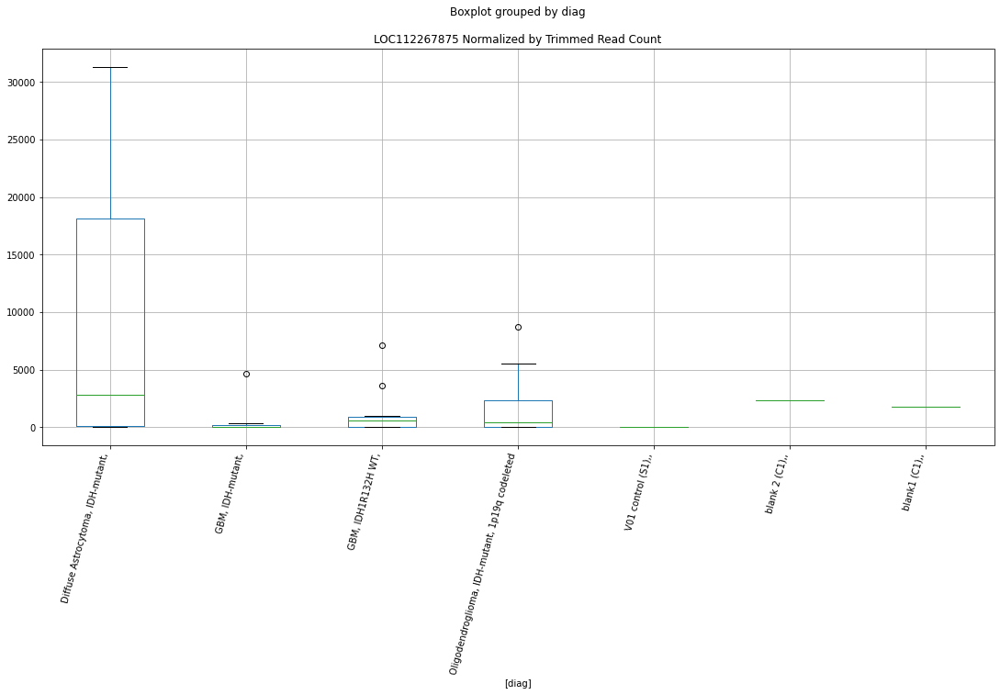

 p : 0.02671864451200712  ( t : 2.4127354026304584 ) :  Lexogen  :  cutadapt2  :  NES
Control and blanks
82     0.0
346    0.0
Name: NES, dtype: float64
214    1356.13
Name: NES, dtype: float64
478    0.0
Name: NES, dtype: float64


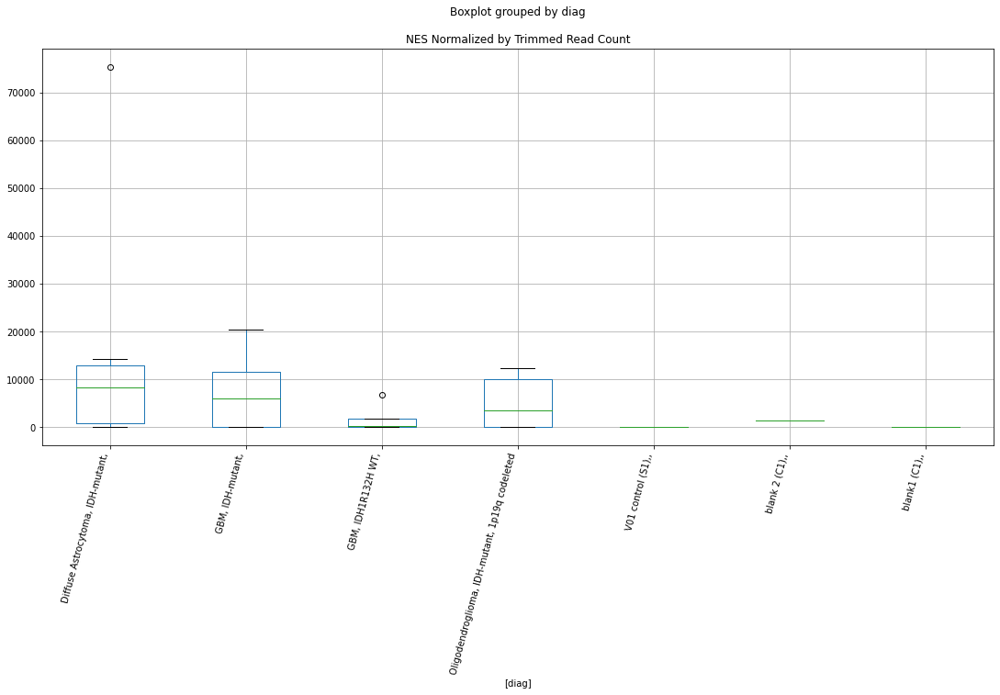

 p : 0.02680697201578307  ( t : 2.411129957805988 ) :  Lexogen  :  bbduk2  :  NEU2
Control and blanks
79     0.0
343    0.0
Name: NEU2, dtype: float64
211    0.0
Name: NEU2, dtype: float64
475    0.0
Name: NEU2, dtype: float64


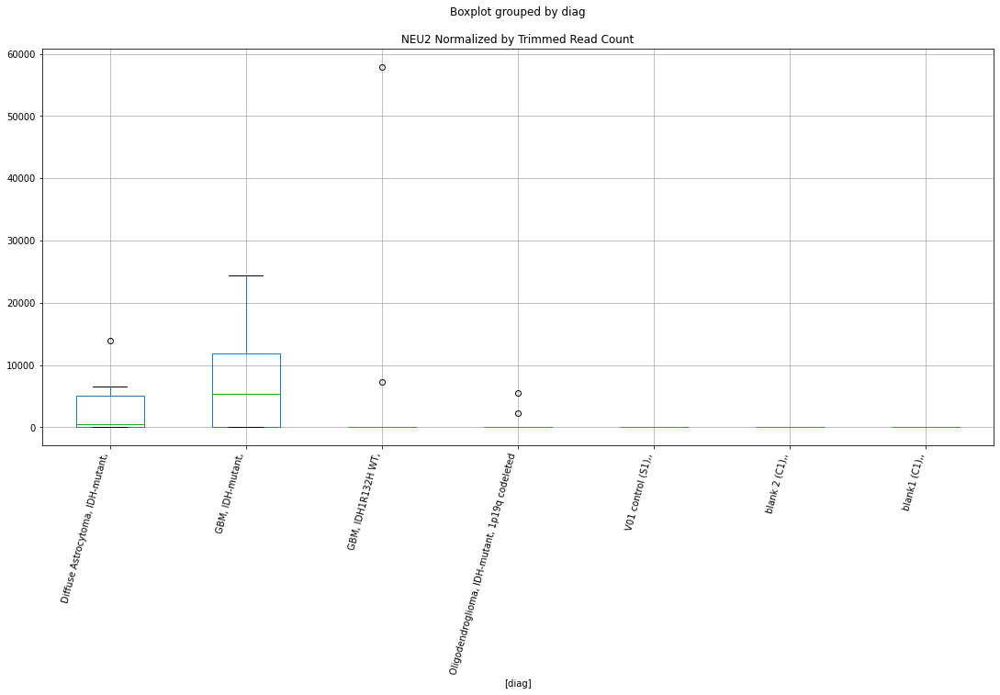

 p : 0.02688675523370519  ( t : 2.4096840642129336 ) :  Lexogen  :  cutadapt2  :  NEU2
Control and blanks
82     0.0
346    0.0
Name: NEU2, dtype: float64
214    0.0
Name: NEU2, dtype: float64
478    0.0
Name: NEU2, dtype: float64


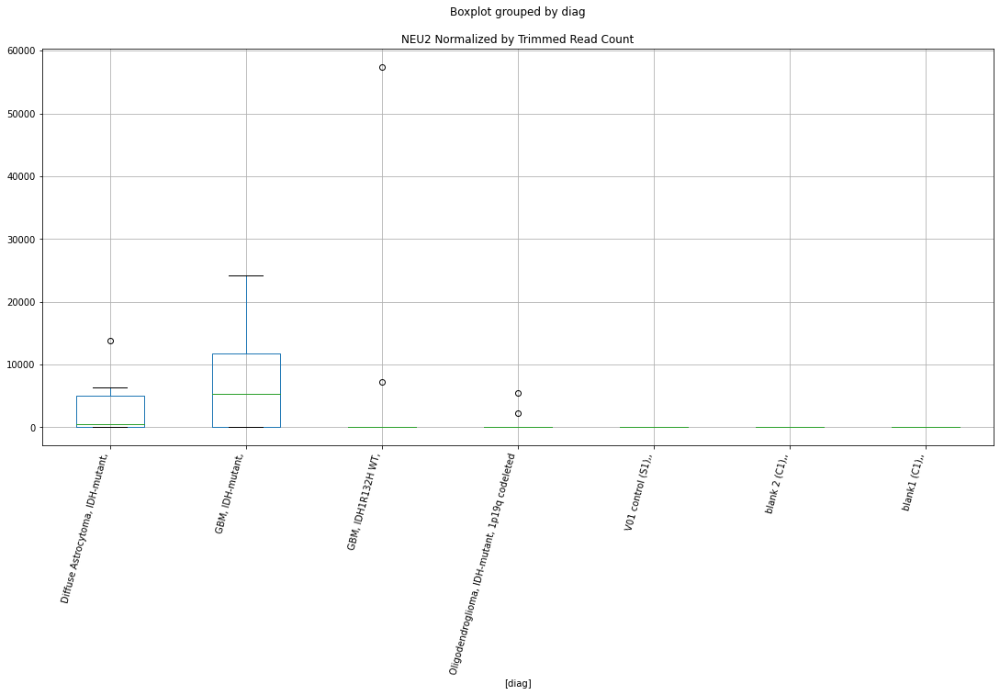

 p : 0.02695181709370158  ( t : 2.4085079315776383 ) :  D-plex  :  cutadapt2  :  LOC107986399
Control and blanks
76     0.0
340    0.0
Name: LOC107986399, dtype: float64
208    352.72
Name: LOC107986399, dtype: float64
472    0.0
Name: LOC107986399, dtype: float64


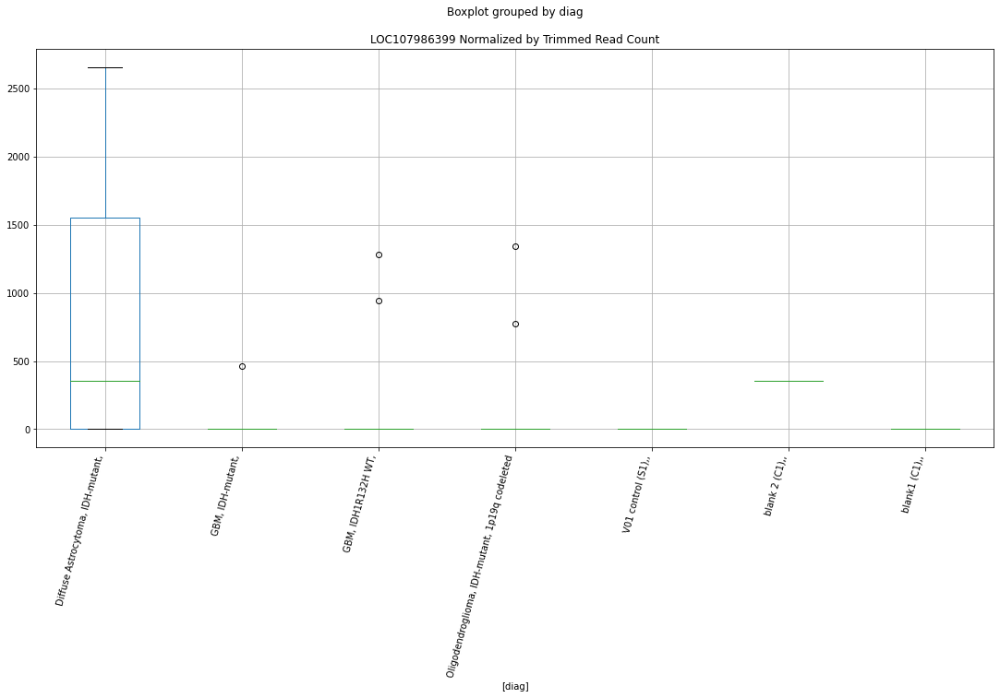

 p : 0.026991805317464652  ( t : 2.4077863761856917 ) :  D-plex  :  bbduk2  :  LPP-AS2
Control and blanks
73     0.0
337    0.0
Name: LPP-AS2, dtype: float64
205    0.0
Name: LPP-AS2, dtype: float64
469    0.0
Name: LPP-AS2, dtype: float64


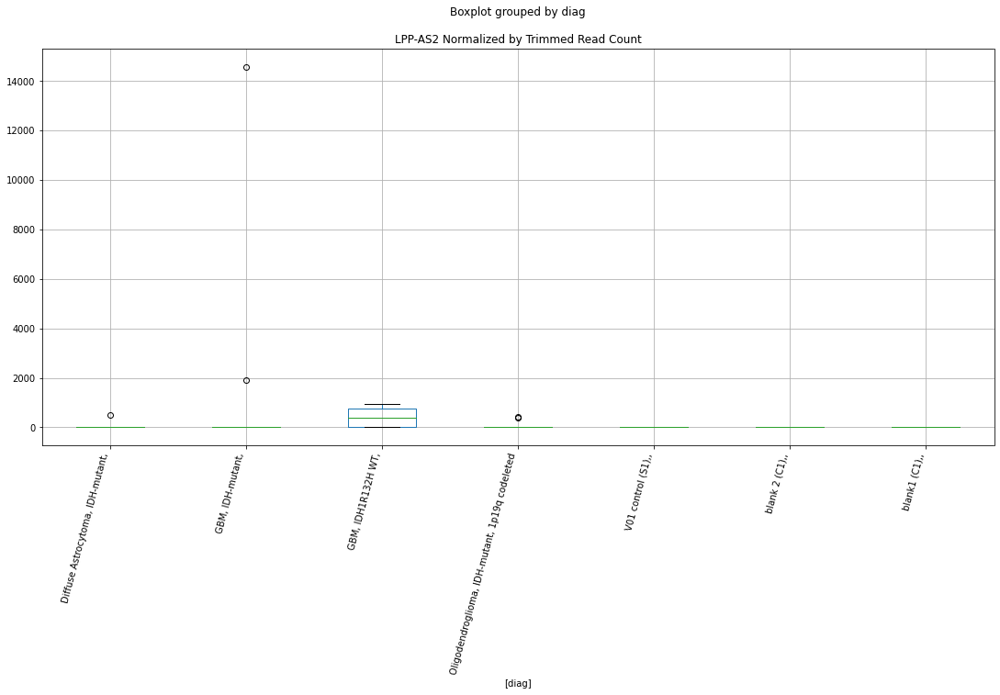

 p : 0.027057376009834207  ( t : 2.406605367503564 ) :  Lexogen  :  bbduk2  :  LY9
Control and blanks
79          0.00
343    108492.62
Name: LY9, dtype: float64
211    41542.56
Name: LY9, dtype: float64
475    0.0
Name: LY9, dtype: float64


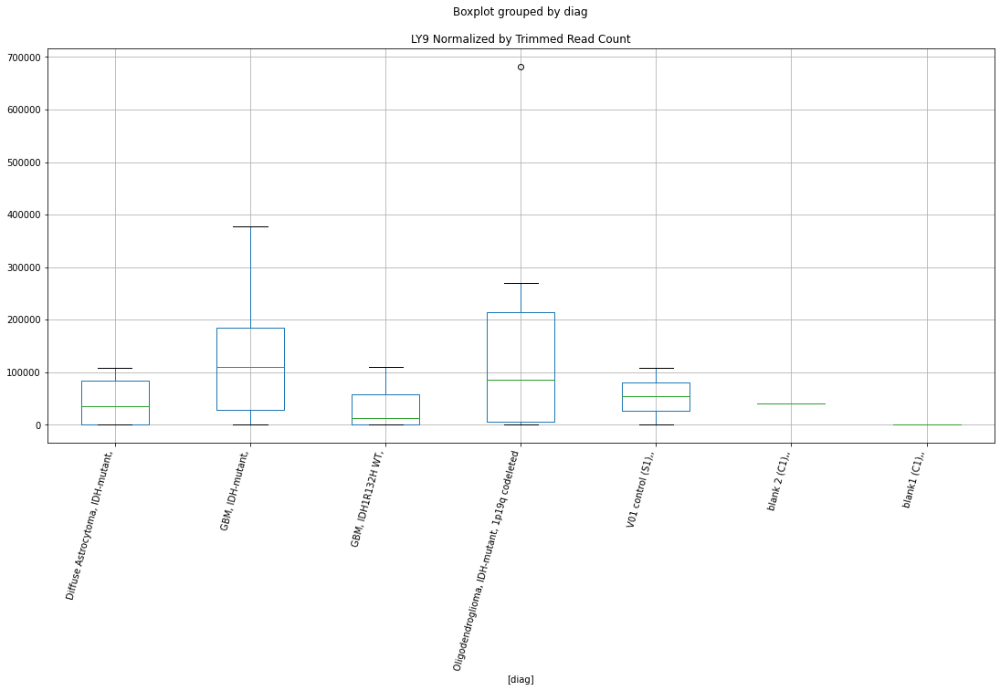

 p : 0.027148513093835612  ( t : 2.4049683160770132 ) :  D-plex  :  bbduk2  :  MISP
Control and blanks
73     11595.13
337     2670.47
Name: MISP, dtype: float64
205    12178.18
Name: MISP, dtype: float64
469    10647.49
Name: MISP, dtype: float64


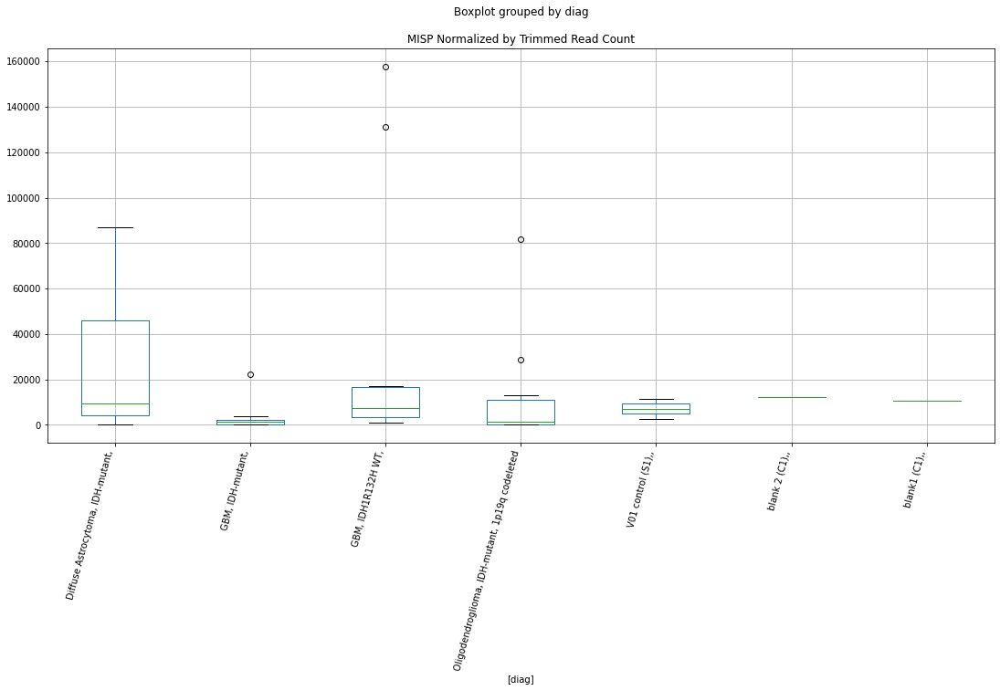

 p : 0.027279373349811033  ( t : 2.40262670376066 ) :  D-plex  :  cutadapt2  :  MIEF2
Control and blanks
76     0.0
340    0.0
Name: MIEF2, dtype: float64
208    6172.61
Name: MIEF2, dtype: float64
472    2311.82
Name: MIEF2, dtype: float64


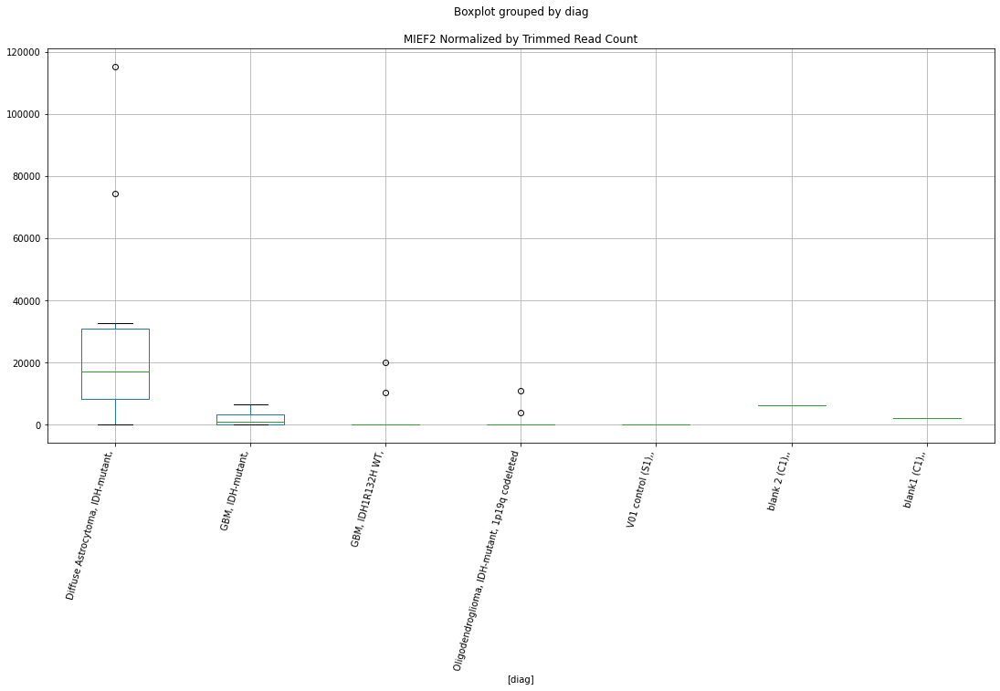

 p : 0.027431042979328597  ( t : 2.39992583696898 ) :  D-plex  :  cutadapt2  :  LOC112267875
Control and blanks
76     0.0
340    0.0
Name: LOC112267875, dtype: float64
208    1939.96
Name: LOC112267875, dtype: float64
472    1733.87
Name: LOC112267875, dtype: float64


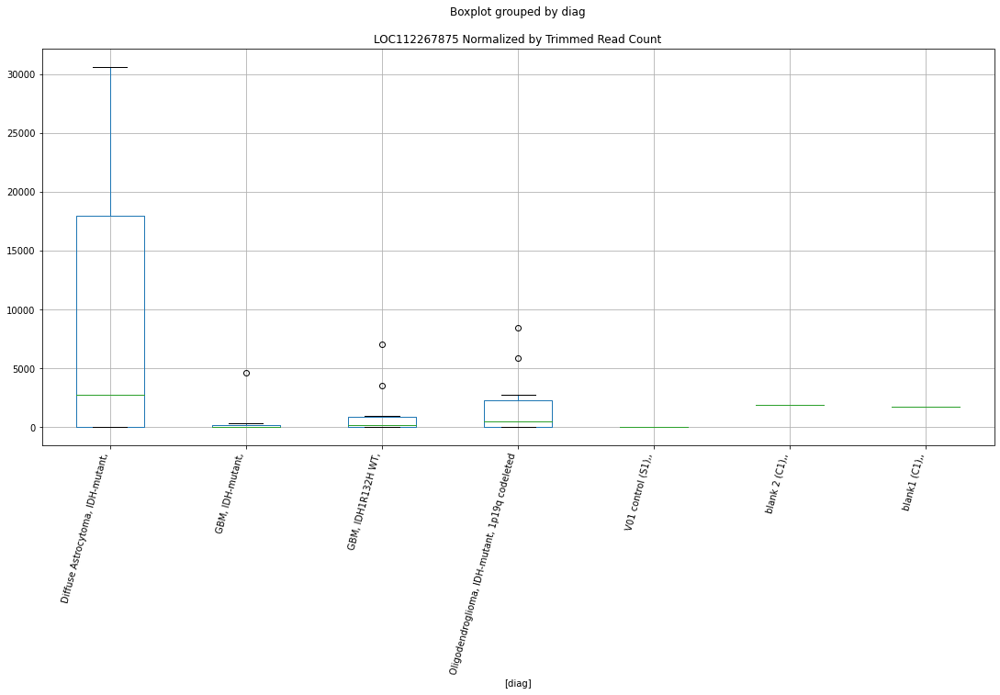

 p : 0.027444161424730027  ( t : 2.399692885991376 ) :  D-plex  :  cutadapt2  :  MEIOB
Control and blanks
76     90913.71
340     1761.46
Name: MEIOB, dtype: float64
208    17636.02
Name: MEIOB, dtype: float64
472    18494.59
Name: MEIOB, dtype: float64


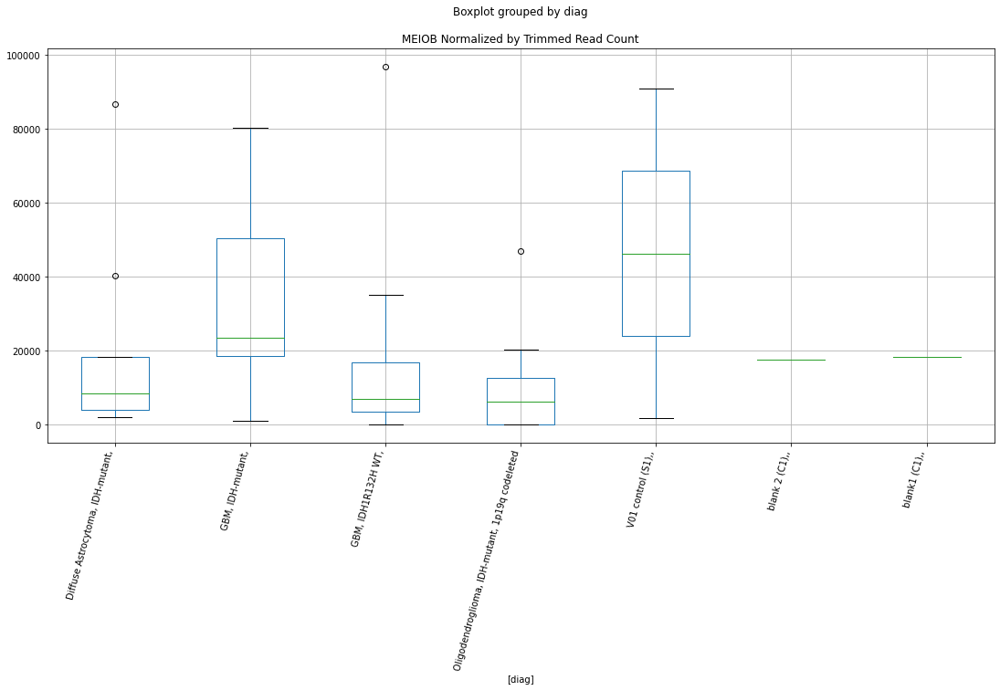

 p : 0.027535736984745197  ( t : 2.398069625816995 ) :  D-plex  :  cutadapt2  :  OR2M3
Control and blanks
76     0.0
340    0.0
Name: OR2M3, dtype: float64
208    705.44
Name: OR2M3, dtype: float64
472    0.0
Name: OR2M3, dtype: float64


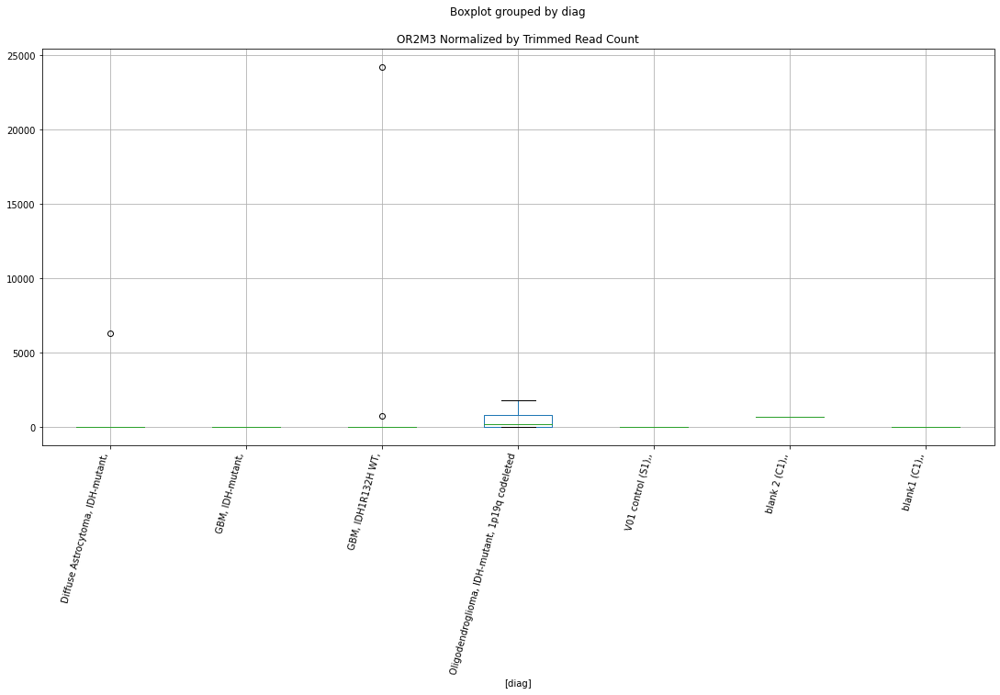

 p : 0.02760731735978228  ( t : 2.396804309085549 ) :  D-plex  :  bbduk2  :  MYO1E
Control and blanks
73     773.01
337      0.00
Name: MYO1E, dtype: float64
205    0.0
Name: MYO1E, dtype: float64
469    1774.58
Name: MYO1E, dtype: float64


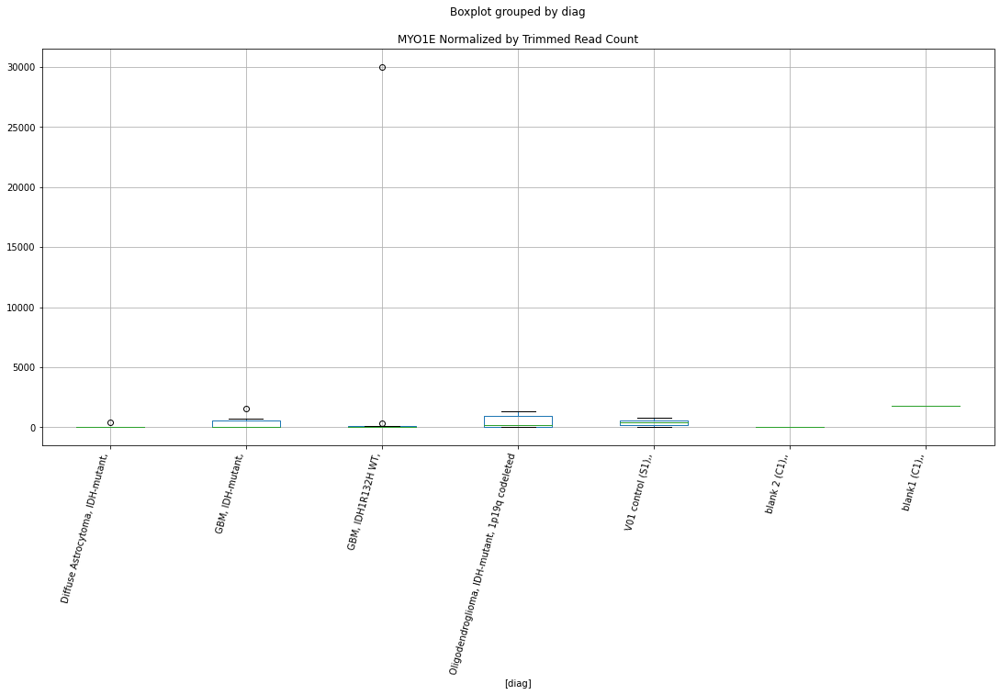

 p : 0.0277492059943117  ( t : 2.394305201316263 ) :  Lexogen  :  bbduk2  :  NLGN2
Control and blanks
79     0.0
343    0.0
Name: NLGN2, dtype: float64
211    9839.03
Name: NLGN2, dtype: float64
475    0.0
Name: NLGN2, dtype: float64


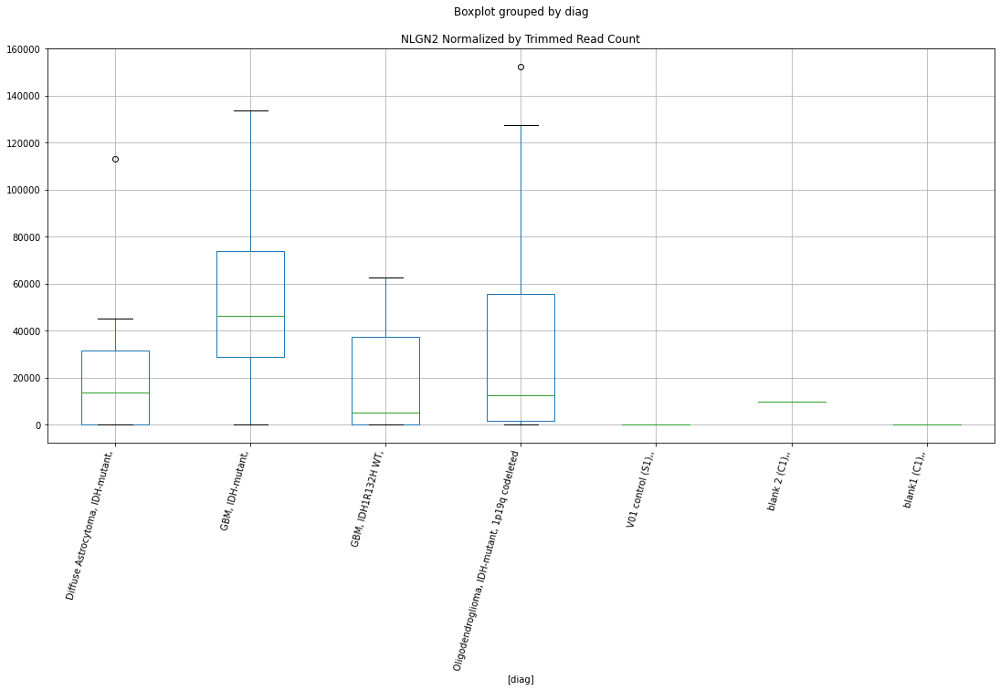

 p : 0.02777191081761579  ( t : 2.3939064064938256 ) :  D-plex  :  bbduk2  :  LOC653160
Control and blanks
73     0.0
337    0.0
Name: LOC653160, dtype: float64
205    179.09
Name: LOC653160, dtype: float64
469    0.0
Name: LOC653160, dtype: float64


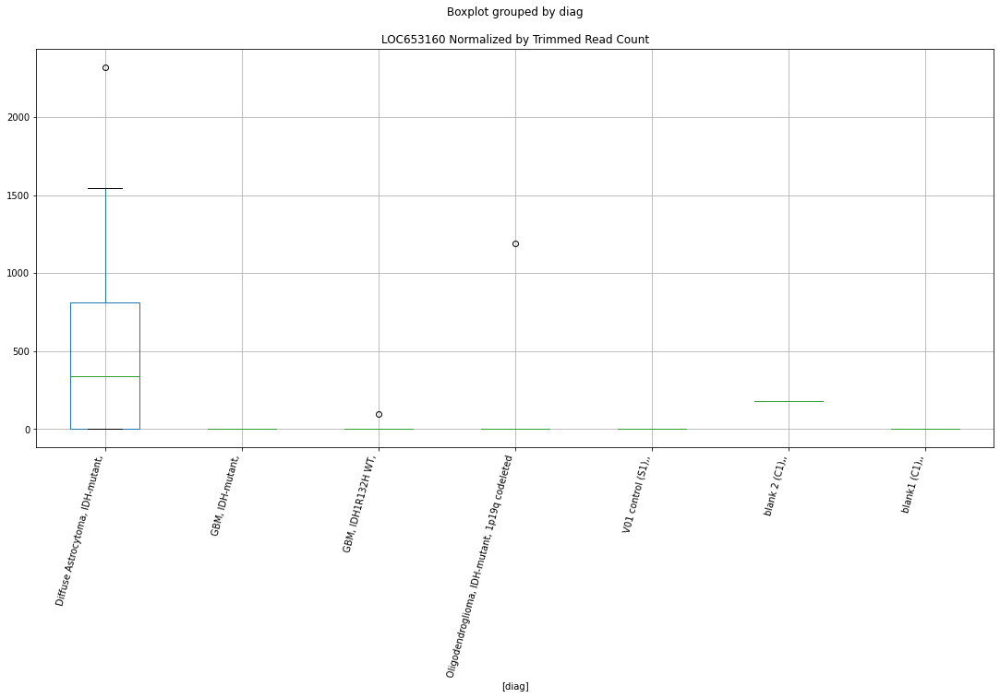

 p : 0.027772886096033088  ( t : 2.3938892832161796 ) :  D-plex  :  cutadapt2  :  MAPK1
Control and blanks
76     391686.55
340    193761.07
Name: MAPK1, dtype: float64
208    233324.57
Name: MAPK1, dtype: float64
472    3.82e+06
Name: MAPK1, dtype: float64


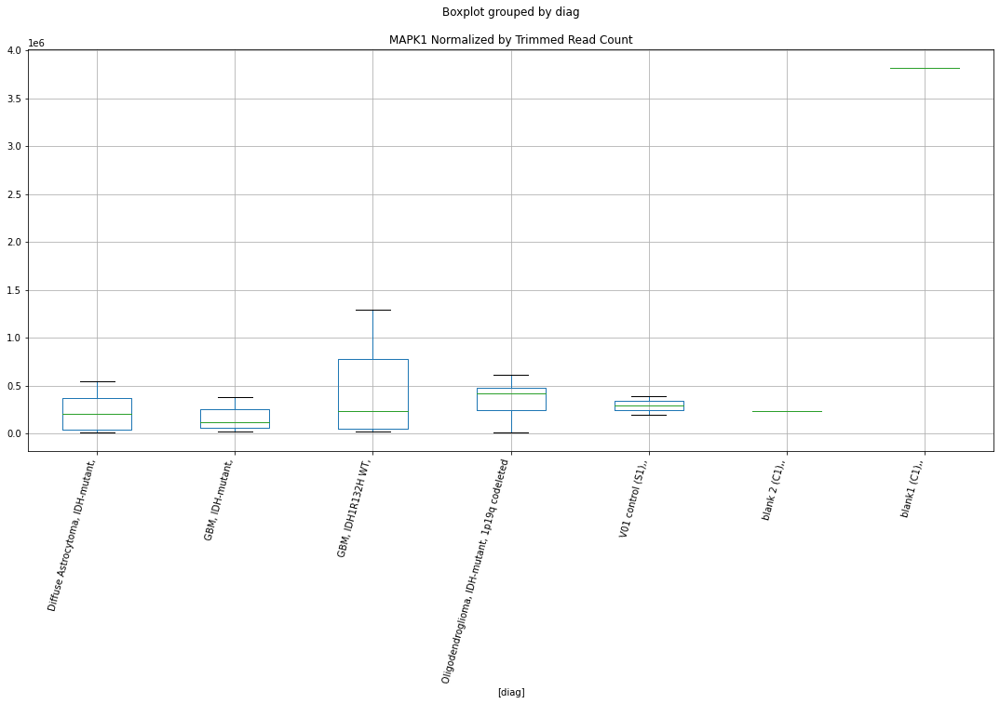

 p : 0.02779328627155506  ( t : 2.393531239512988 ) :  Lexogen  :  cutadapt2  :  LY9
Control and blanks
82          0.00
346    107532.04
Name: LY9, dtype: float64
214    47735.86
Name: LY9, dtype: float64
478    0.0
Name: LY9, dtype: float64


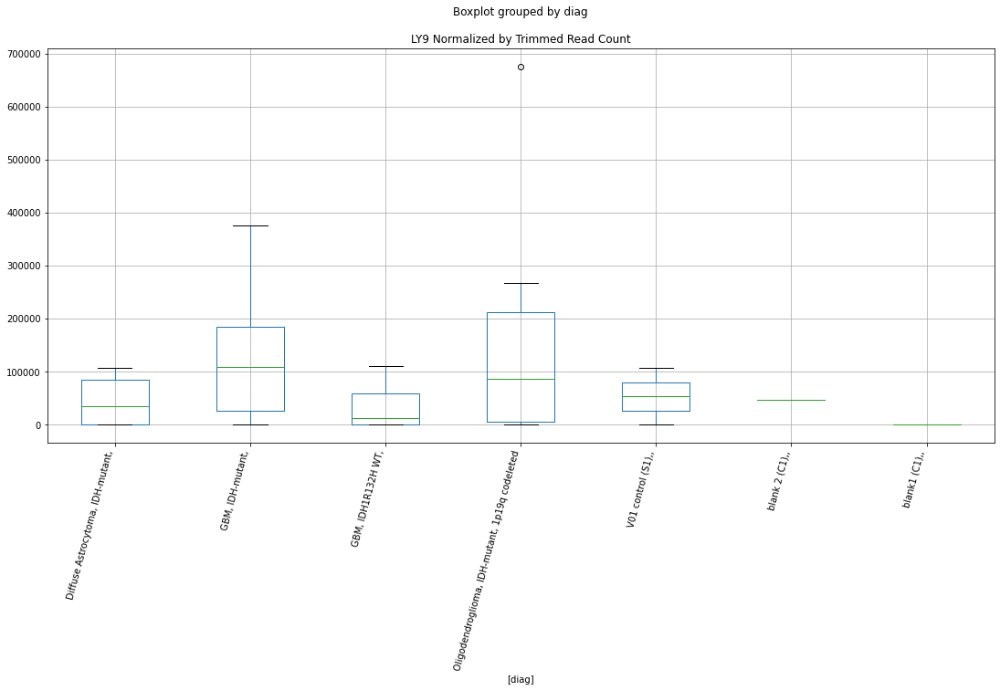

 p : 0.027812441282262085  ( t : 2.3931952732166635 ) :  Lexogen  :  cutadapt2  :  NLGN2
Control and blanks
82     0.0
346    0.0
Name: NLGN2, dtype: float64
214    9764.15
Name: NLGN2, dtype: float64
478    0.0
Name: NLGN2, dtype: float64


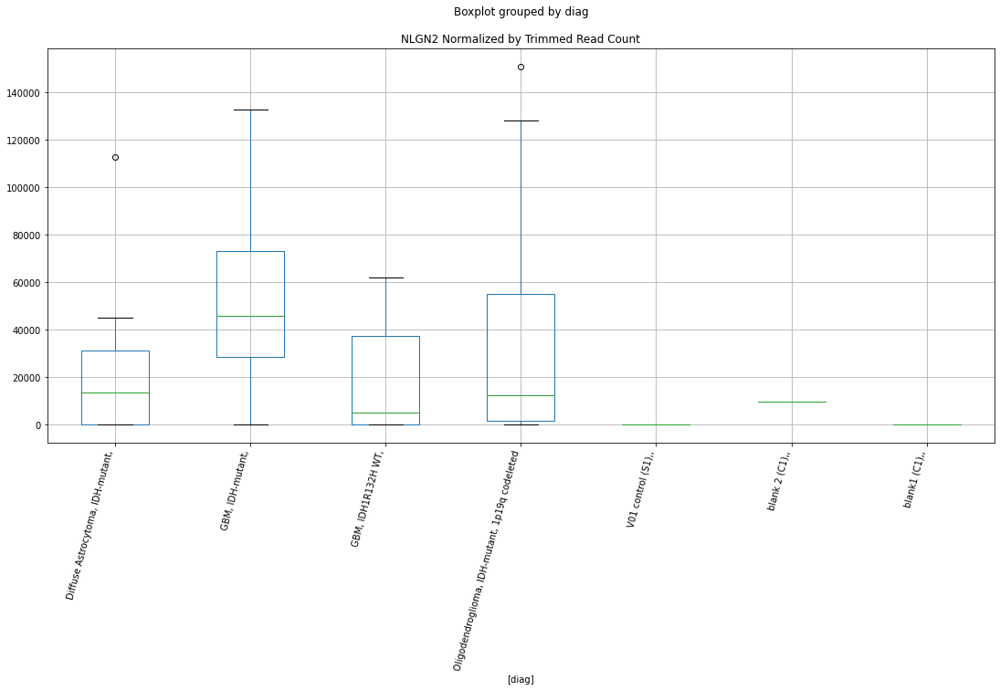

 p : 0.027857154491667358  ( t : 2.3924118736470983 ) :  D-plex  :  bbduk2  :  MUC16
Control and blanks
73      10049.11
337    196724.76
Name: MUC16, dtype: float64
205    73248.2
Name: MUC16, dtype: float64
469    1.91e+06
Name: MUC16, dtype: float64


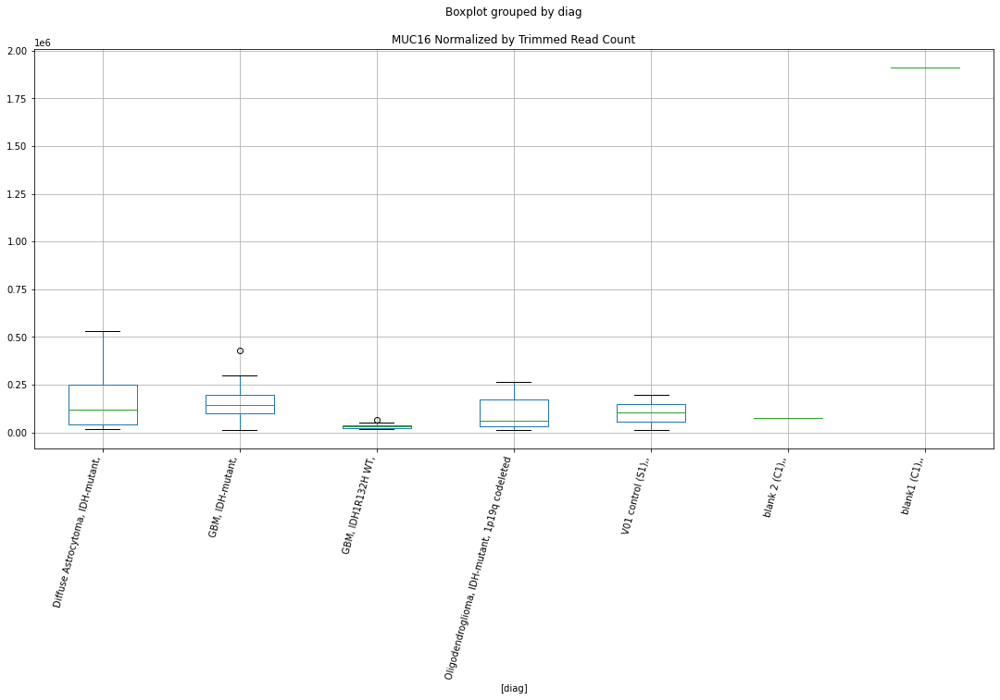

 p : 0.027858953171497117  ( t : 2.3923803843965805 ) :  D-plex  :  cutadapt2  :  MIXL1
Control and blanks
76     0.0
340    0.0
Name: MIXL1, dtype: float64
208    52555.34
Name: MIXL1, dtype: float64
472    0.0
Name: MIXL1, dtype: float64


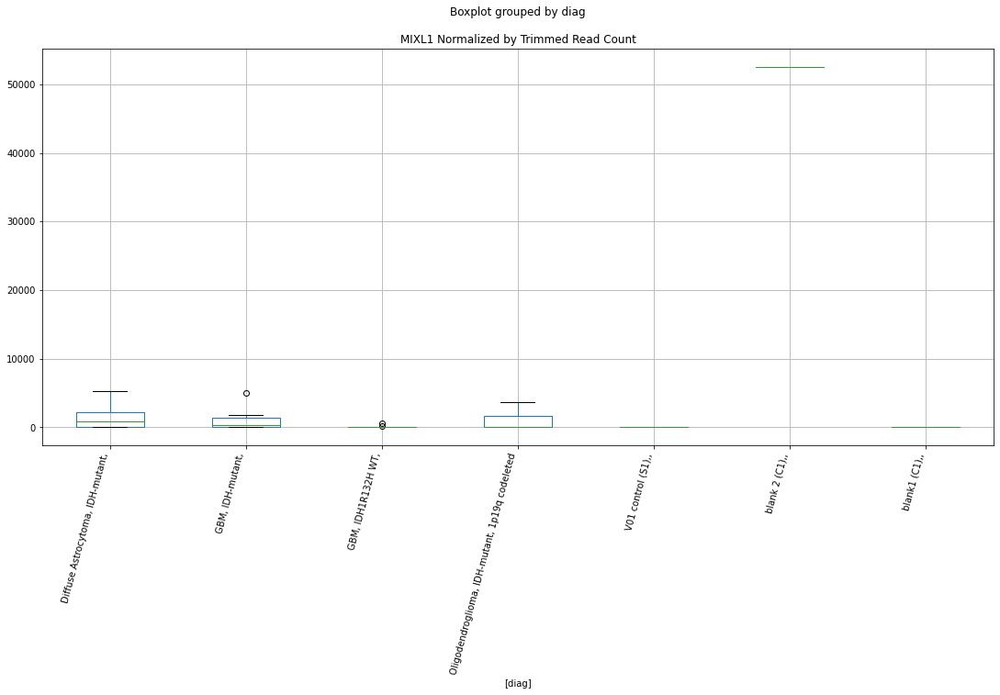

 p : 0.02789744707486576  ( t : 2.391706931703264 ) :  D-plex  :  cutadapt2  :  MUC16
Control and blanks
76       9848.98
340    160293.25
Name: MUC16, dtype: float64
208    61020.64
Name: MUC16, dtype: float64
472    1.86e+06
Name: MUC16, dtype: float64


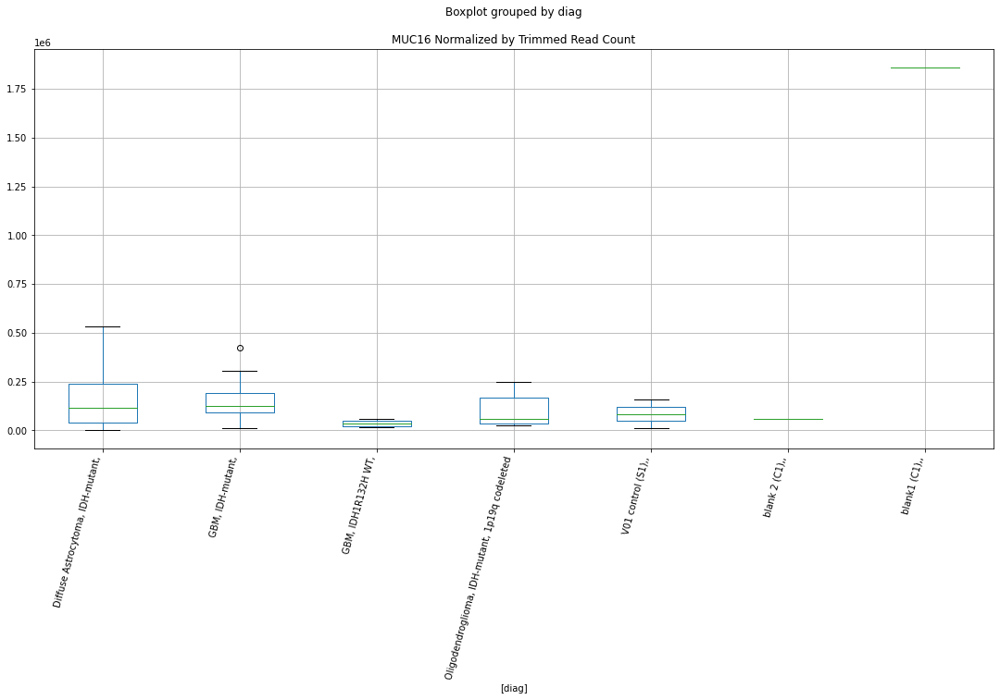

 p : 0.027927386994908005  ( t : 2.3911837314158078 ) :  D-plex  :  bbduk2  :  NDC1
Control and blanks
73     0.0
337    0.0
Name: NDC1, dtype: float64
205    7163.64
Name: NDC1, dtype: float64
469    2366.11
Name: NDC1, dtype: float64


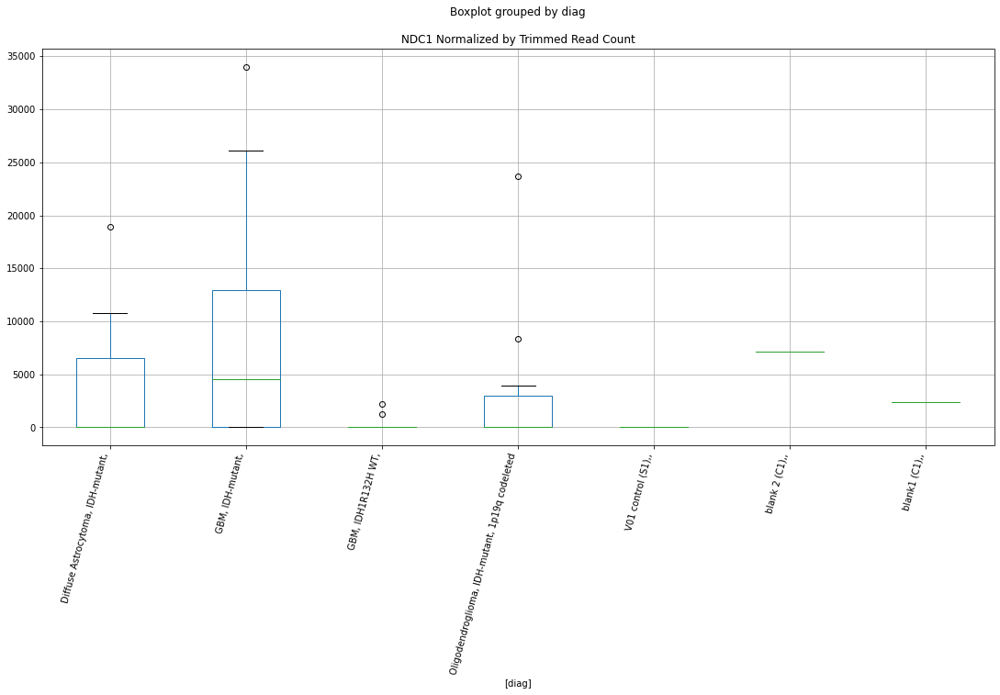

 p : 0.027997437474666622  ( t : 2.3899616435143227 ) :  D-plex  :  bbduk2  :  MPEG1
Control and blanks
73         0.00
337    37386.61
Name: MPEG1, dtype: float64
205    4119.09
Name: MPEG1, dtype: float64
469    5323.75
Name: MPEG1, dtype: float64


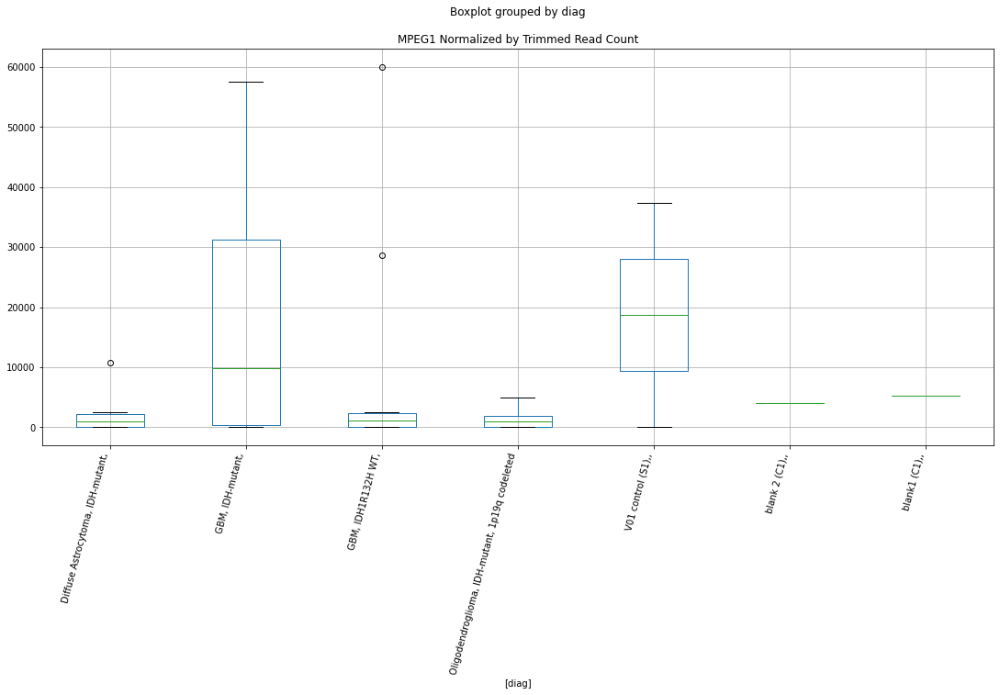

 p : 0.028096117548339555  ( t : 2.3882449267276344 ) :  Lexogen  :  bbduk2  :  NES
Control and blanks
79     0.0
343    0.0
Name: NES, dtype: float64
211    1366.53
Name: NES, dtype: float64
475    0.0
Name: NES, dtype: float64


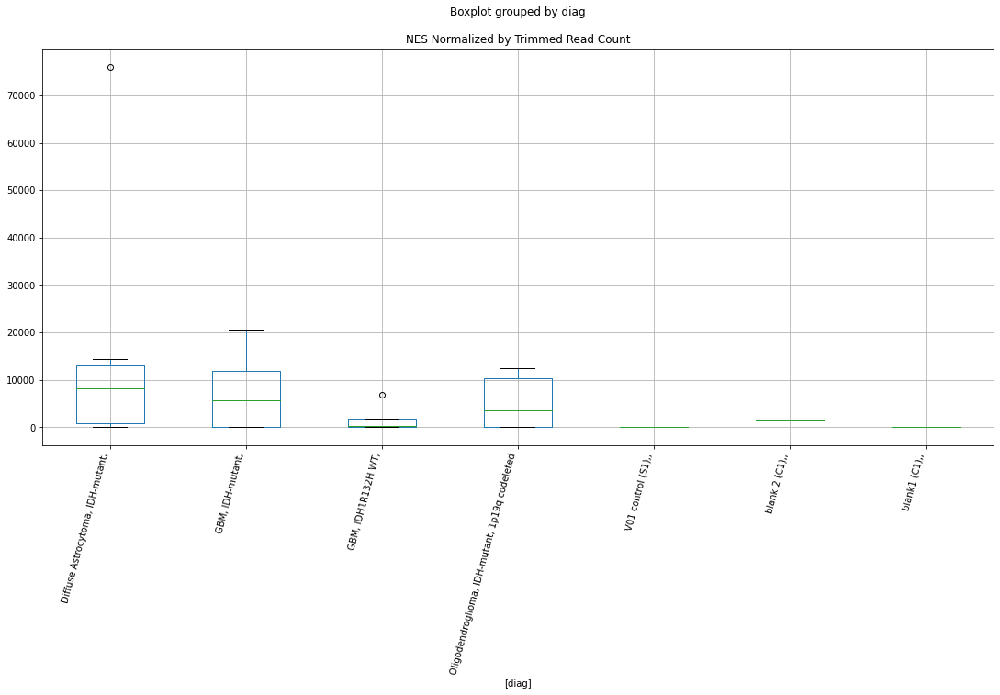

 p : 0.028209991971093154  ( t : 2.386270863221934 ) :  D-plex  :  cutadapt2  :  MPEG1
Control and blanks
76         0.00
340    36990.75
Name: MPEG1, dtype: float64
208    4056.29
Name: MPEG1, dtype: float64
472    4623.65
Name: MPEG1, dtype: float64


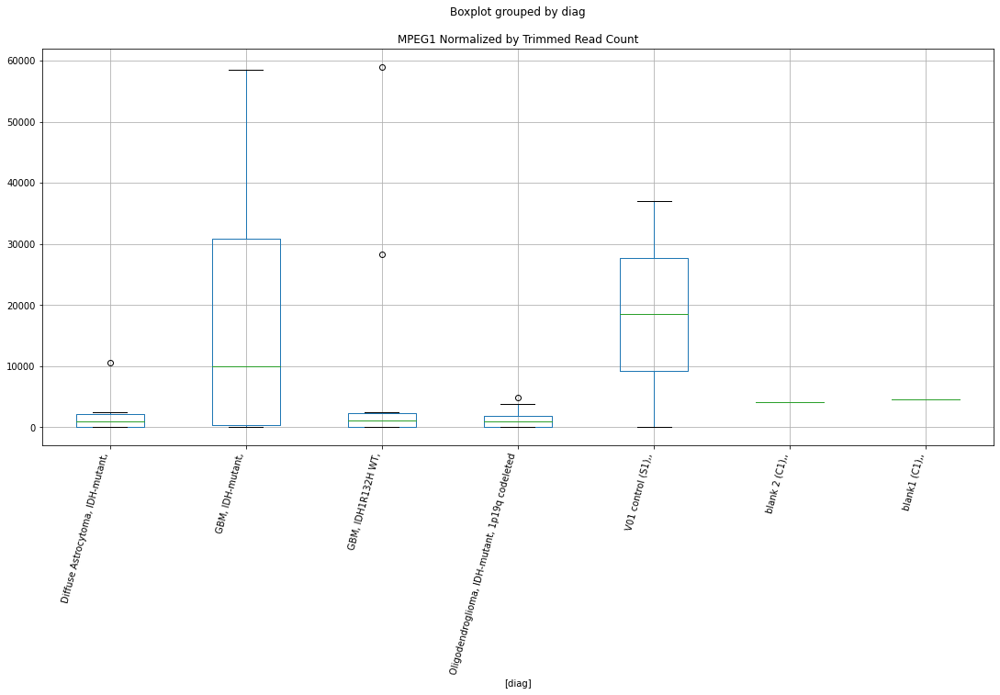

 p : 0.028236500384336897  ( t : 2.3858123962543454 ) :  D-plex  :  bbduk2  :  NRSN2
Control and blanks
73     773.01
337      0.00
Name: NRSN2, dtype: float64
205    1611.82
Name: NRSN2, dtype: float64
469    10055.96
Name: NRSN2, dtype: float64


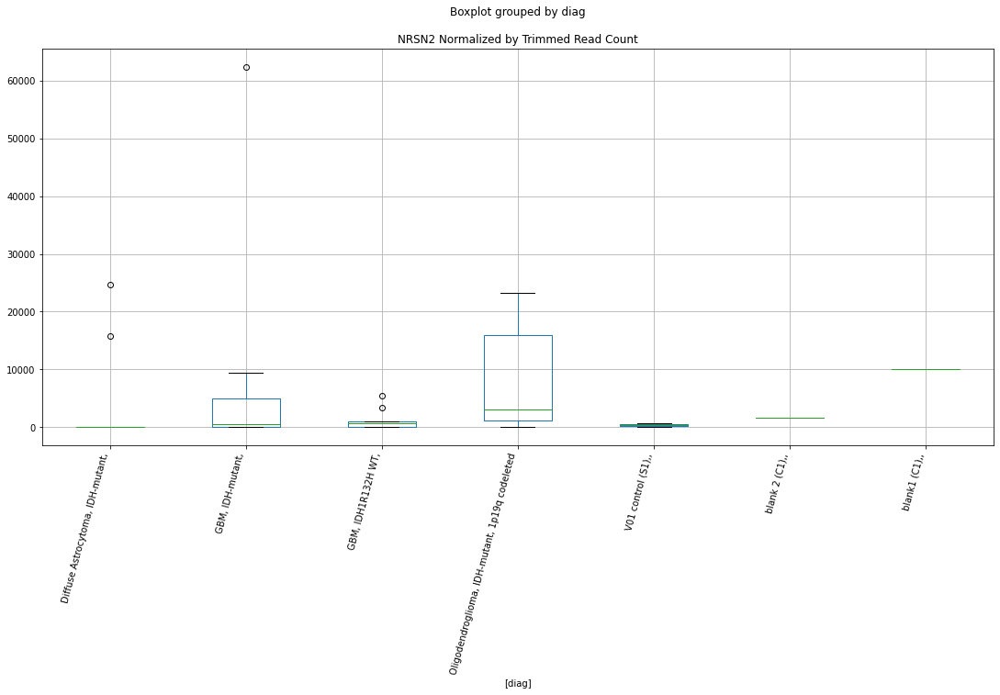

 p : 0.02838594266882323  ( t : 2.3832352659263 ) :  D-plex  :  cutadapt2  :  MRPL23-AS1
Control and blanks
76     0.0
340    0.0
Name: MRPL23-AS1, dtype: float64
208    176.36
Name: MRPL23-AS1, dtype: float64
472    0.0
Name: MRPL23-AS1, dtype: float64


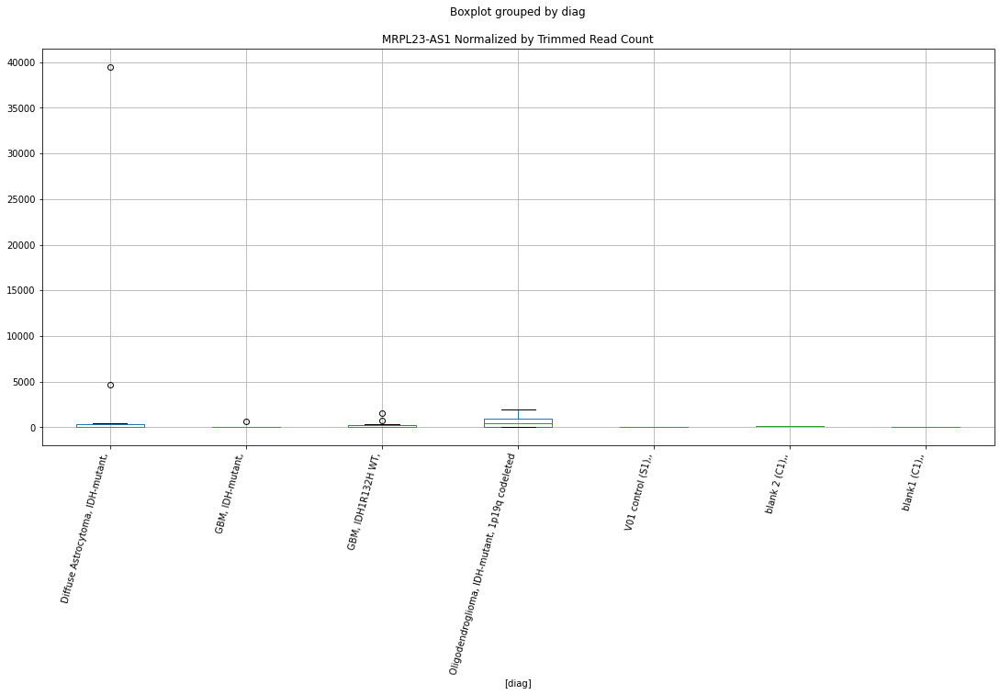

 p : 0.028460484045689342  ( t : 2.381954533088484 ) :  D-plex  :  bbduk2  :  LOC107986522
Control and blanks
73     0.0
337    0.0
Name: LOC107986522, dtype: float64
205    0.0
Name: LOC107986522, dtype: float64
469    591.53
Name: LOC107986522, dtype: float64


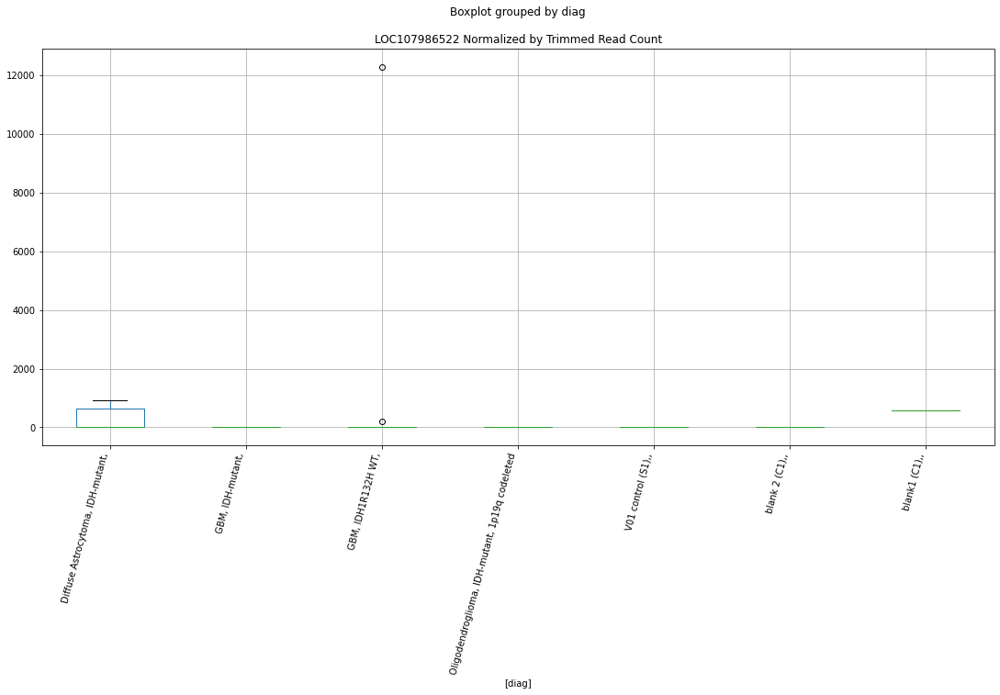

 p : 0.028480368757152905  ( t : 2.3816134130618085 ) :  D-plex  :  cutadapt2  :  NOL4L
Control and blanks
76     148492.39
340         0.00
Name: NOL4L, dtype: float64
208    79538.46
Name: NOL4L, dtype: float64
472    102298.18
Name: NOL4L, dtype: float64


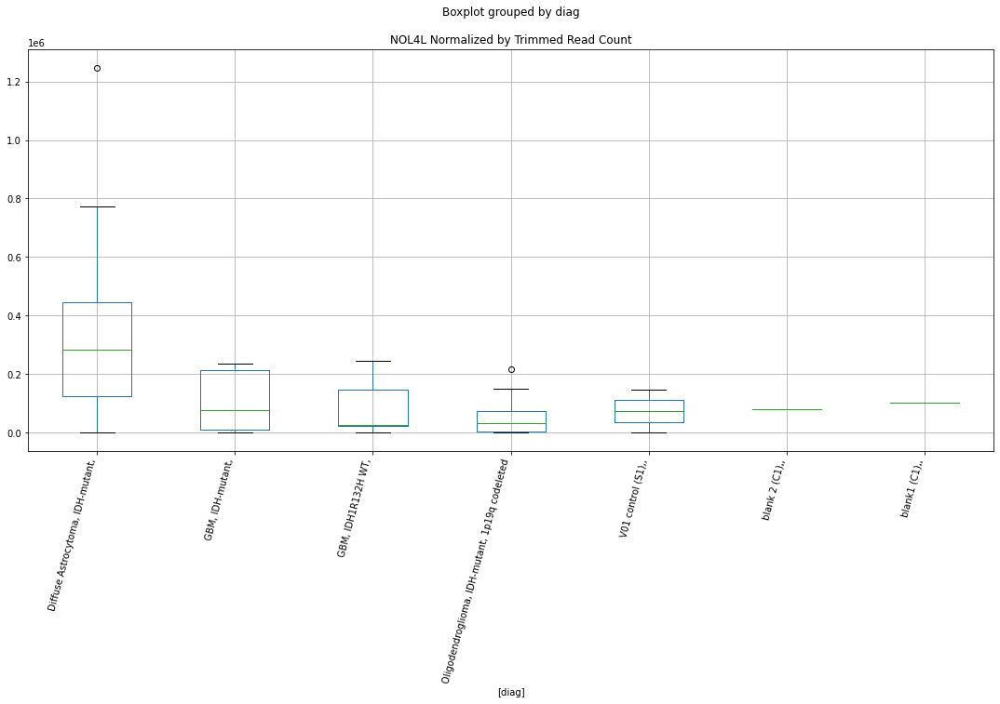

 p : 0.02853723555387728  ( t : 2.380639095269762 ) :  Lexogen  :  bbduk2  :  LOC112267857
Control and blanks
79     28611.98
343    35244.18
Name: LOC112267857, dtype: float64
211    30610.31
Name: LOC112267857, dtype: float64
475    479.03
Name: LOC112267857, dtype: float64


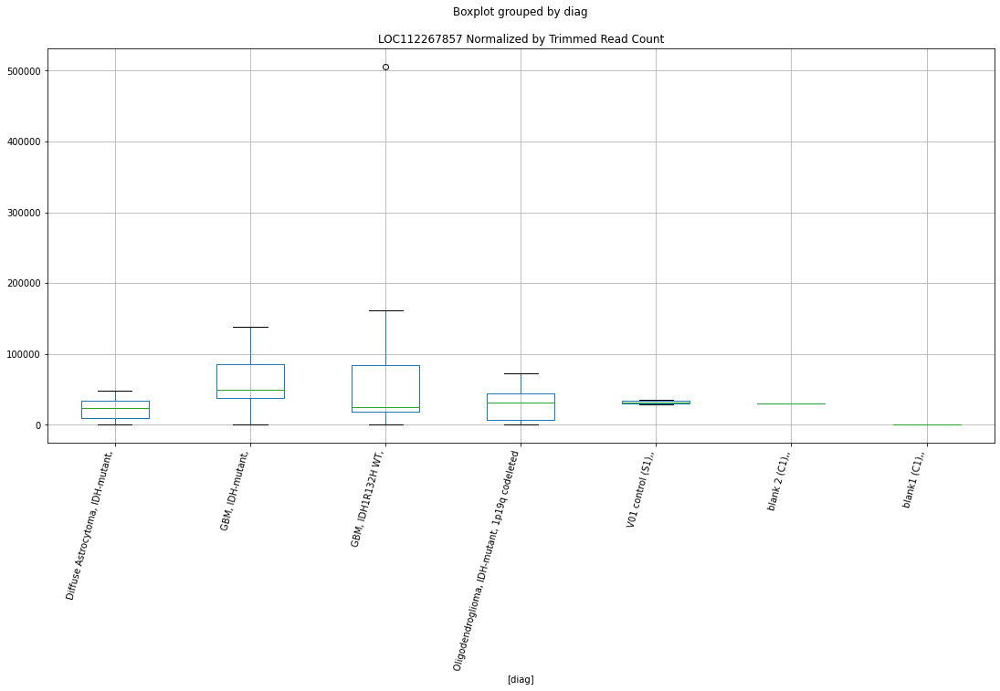

 p : 0.028620582525253537  ( t : 2.3792143538890493 ) :  D-plex  :  cutadapt2  :  LOC107986522
Control and blanks
76     0.0
340    0.0
Name: LOC107986522, dtype: float64
208    0.0
Name: LOC107986522, dtype: float64
472    577.96
Name: LOC107986522, dtype: float64


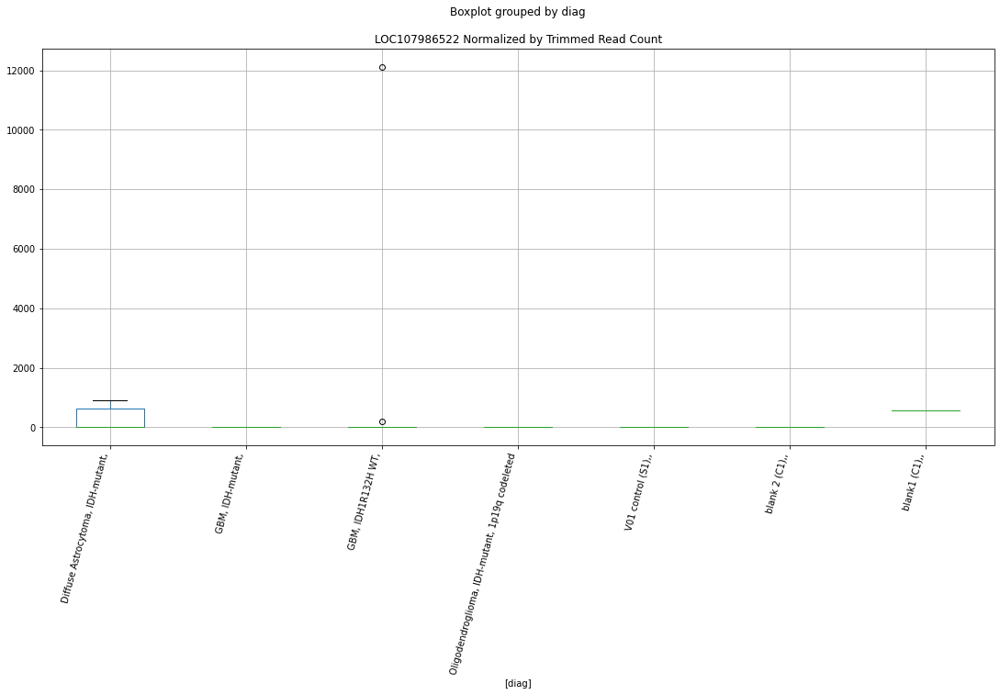

 p : 0.028707935802134057  ( t : 2.377725278973885 ) :  D-plex  :  bbduk2  :  MRPL23-AS1
Control and blanks
73     0.0
337    0.0
Name: MRPL23-AS1, dtype: float64
205    358.18
Name: MRPL23-AS1, dtype: float64
469    0.0
Name: MRPL23-AS1, dtype: float64


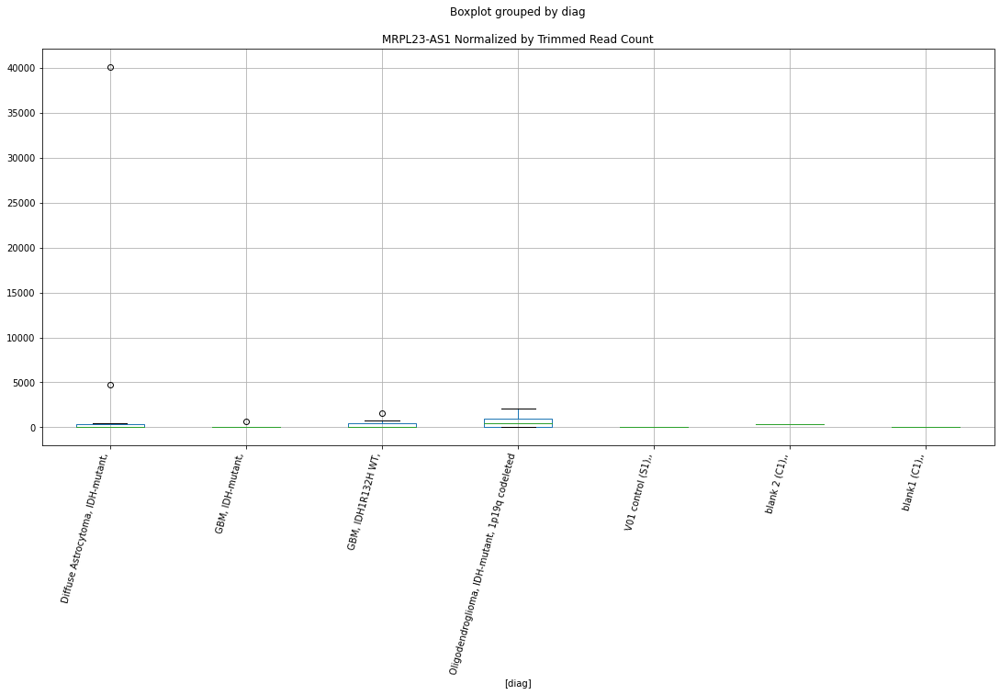

 p : 0.02873839378735864  ( t : 2.377207068612687 ) :  D-plex  :  cutadapt2  :  MIR4435-2HG
Control and blanks
76     0.0
340    0.0
Name: MIR4435-2HG, dtype: float64
208    529.08
Name: MIR4435-2HG, dtype: float64
472    0.0
Name: MIR4435-2HG, dtype: float64


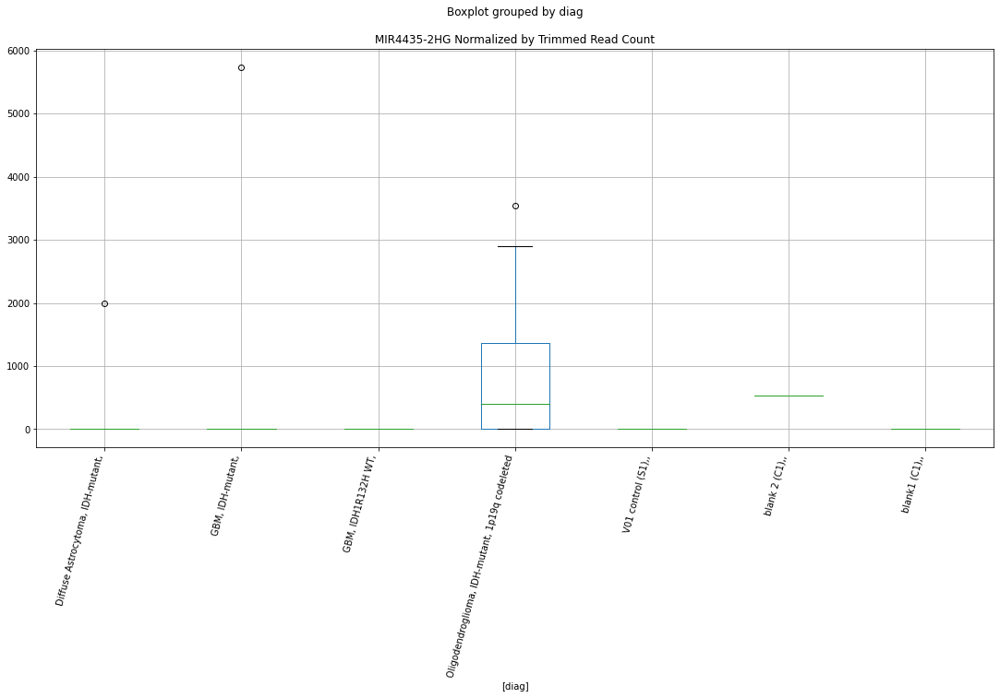

 p : 0.028743214832314172  ( t : 2.3771250906315027 ) :  D-plex  :  bbduk2  :  NCKAP1L
Control and blanks
73     1546.02
337       0.00
Name: NCKAP1L, dtype: float64
205    1432.73
Name: NCKAP1L, dtype: float64
469    2366.11
Name: NCKAP1L, dtype: float64


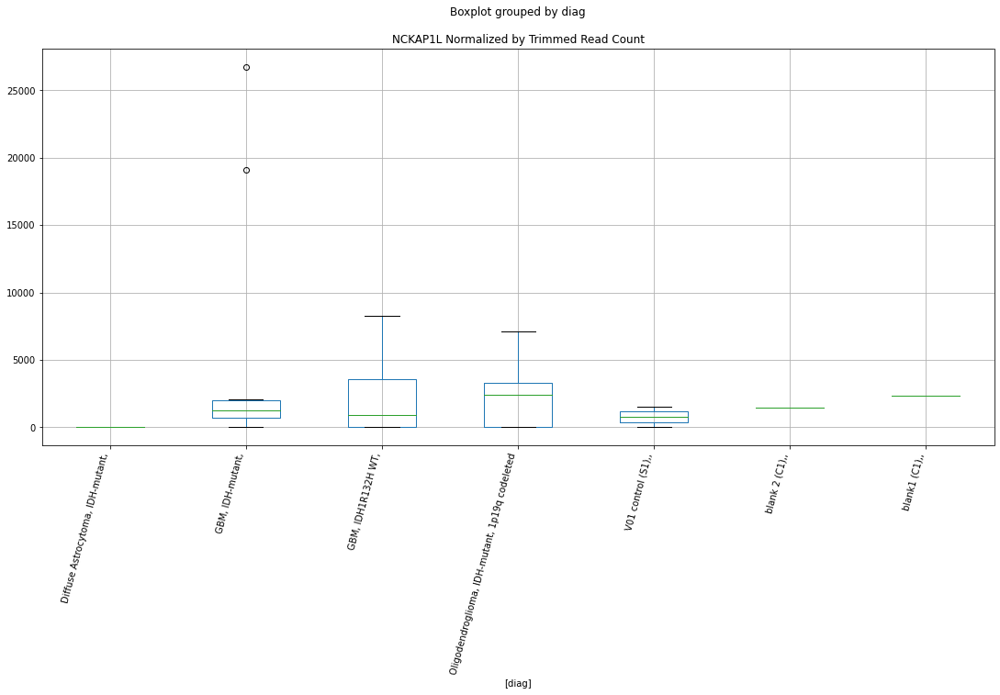

 p : 0.028844843621812978  ( t : 2.3753999547563067 ) :  D-plex  :  bbduk2  :  MYO1C
Control and blanks
73     47926.52
337     5340.94
Name: MYO1C, dtype: float64
205    123572.76
Name: MYO1C, dtype: float64
469    53237.46
Name: MYO1C, dtype: float64


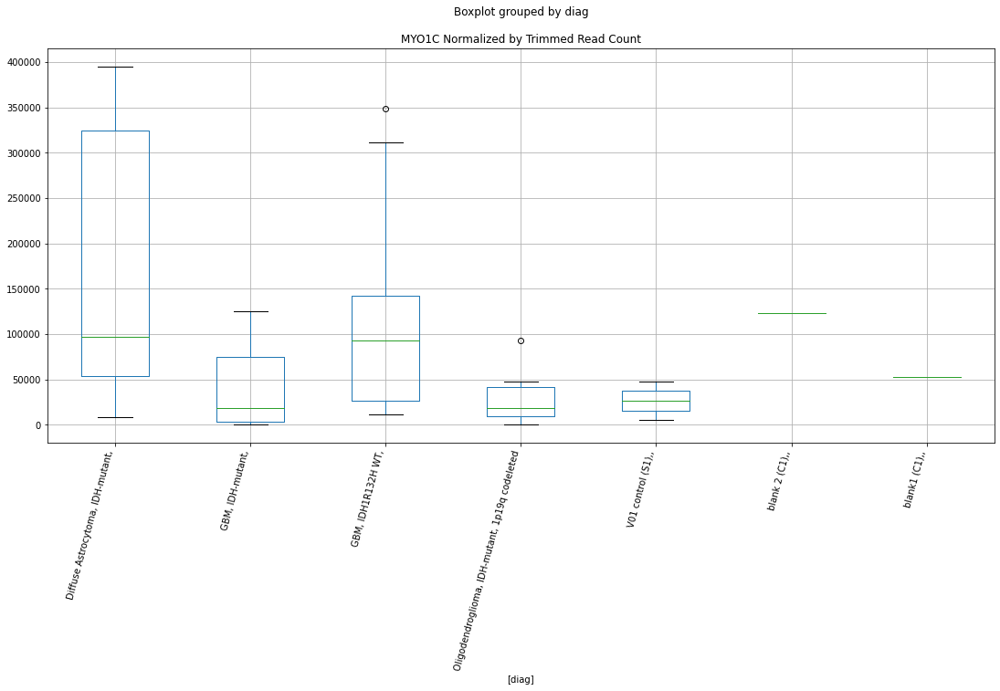

 p : 0.028848657338651638  ( t : 2.37533532787444 ) :  D-plex  :  bbduk2  :  LOC107986674
Control and blanks
73     0.0
337    0.0
Name: LOC107986674, dtype: float64
205    1074.55
Name: LOC107986674, dtype: float64
469    1183.05
Name: LOC107986674, dtype: float64


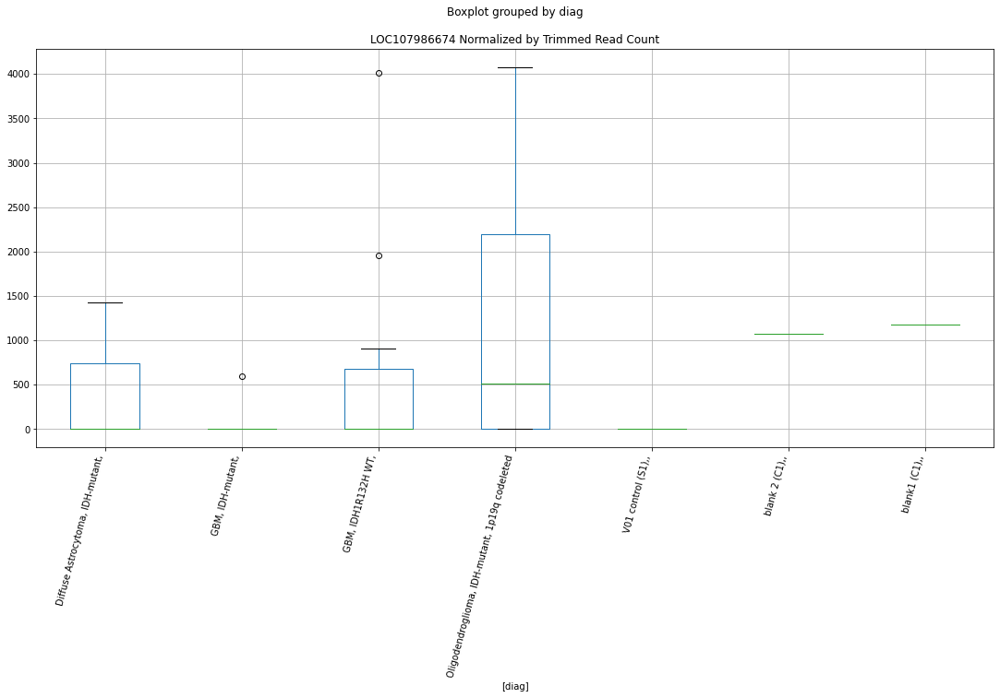

 p : 0.028965903880873386  ( t : 2.3733523590128 ) :  D-plex  :  cutadapt2  :  MUC16
Control and blanks
76       9848.98
340    160293.25
Name: MUC16, dtype: float64
208    61020.64
Name: MUC16, dtype: float64
472    1.86e+06
Name: MUC16, dtype: float64


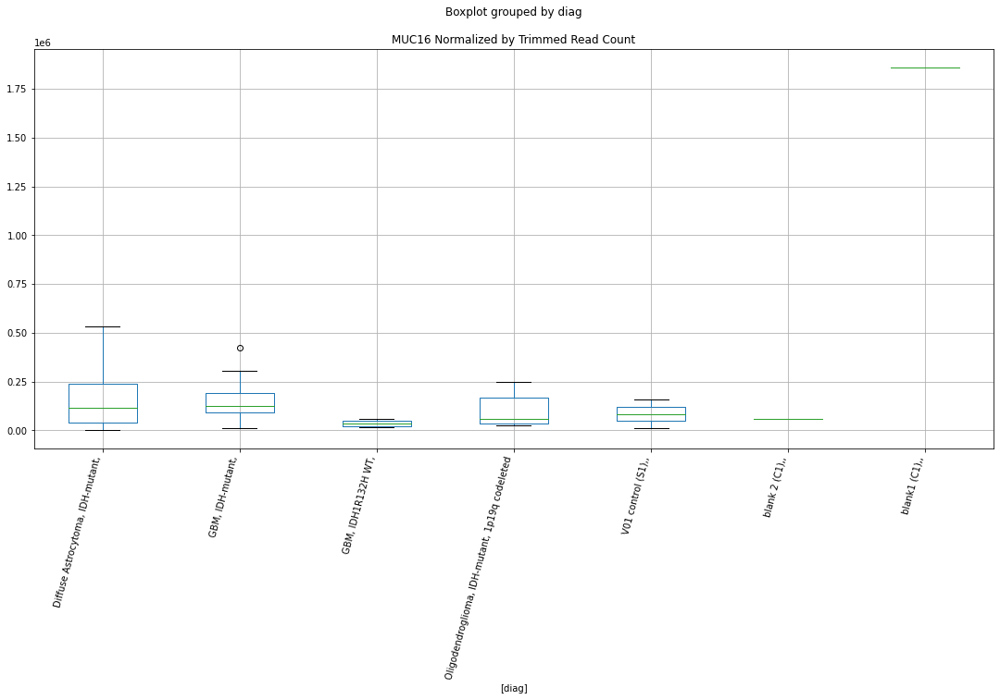

 p : 0.02901417920749906  ( t : 2.372538063251056 ) :  Lexogen  :  cutadapt2  :  MGAT1
Control and blanks
82     0.0
346    0.0
Name: MGAT1, dtype: float64
214    0.0
Name: MGAT1, dtype: float64
478    0.0
Name: MGAT1, dtype: float64


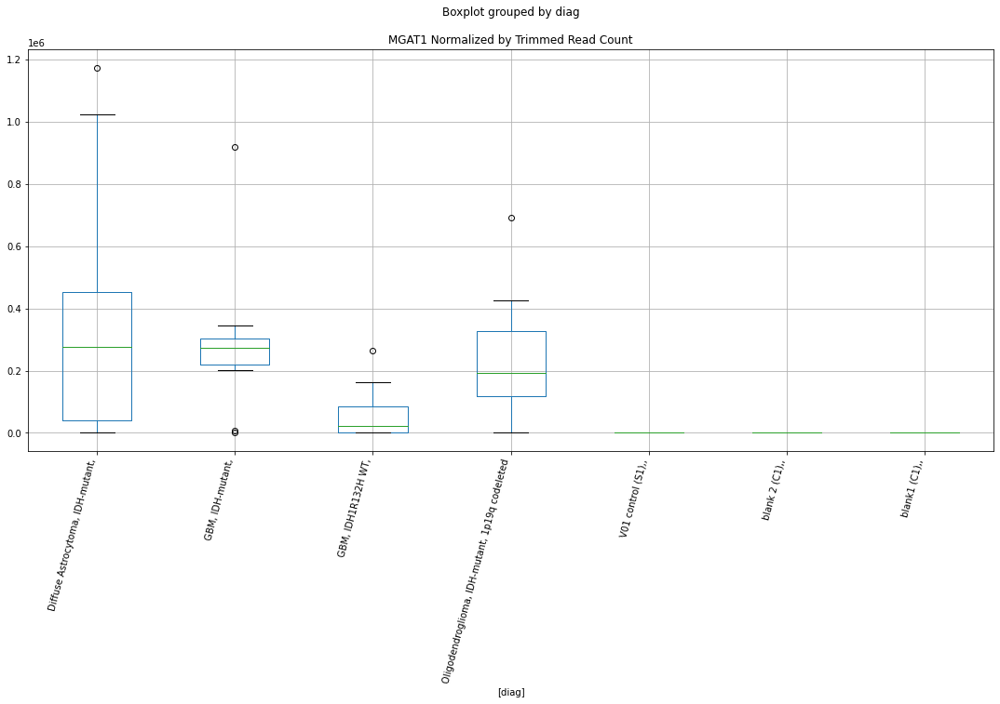

 p : 0.0290217915578647  ( t : 2.372409775477754 ) :  D-plex  :  cutadapt2  :  LOC107986674
Control and blanks
76        0.00
340    1761.46
Name: LOC107986674, dtype: float64
208    1058.16
Name: LOC107986674, dtype: float64
472    1155.91
Name: LOC107986674, dtype: float64


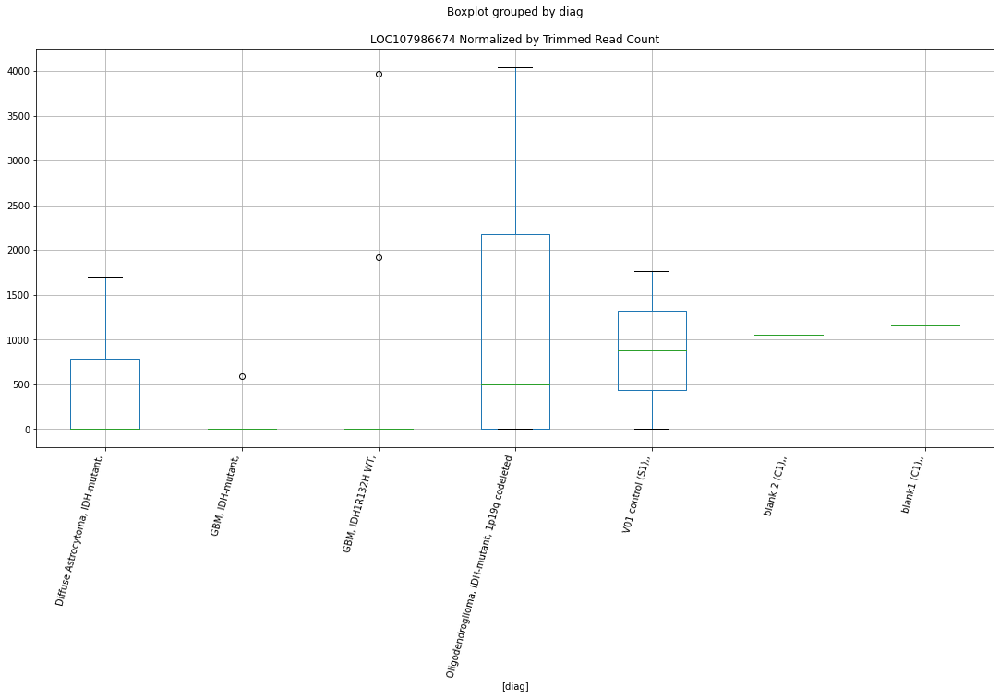

 p : 0.0290388655856978  ( t : 2.3721221481229473 ) :  Lexogen  :  bbduk2  :  MGAT1
Control and blanks
79     0.0
343    0.0
Name: MGAT1, dtype: float64
211    0.0
Name: MGAT1, dtype: float64
475    0.0
Name: MGAT1, dtype: float64


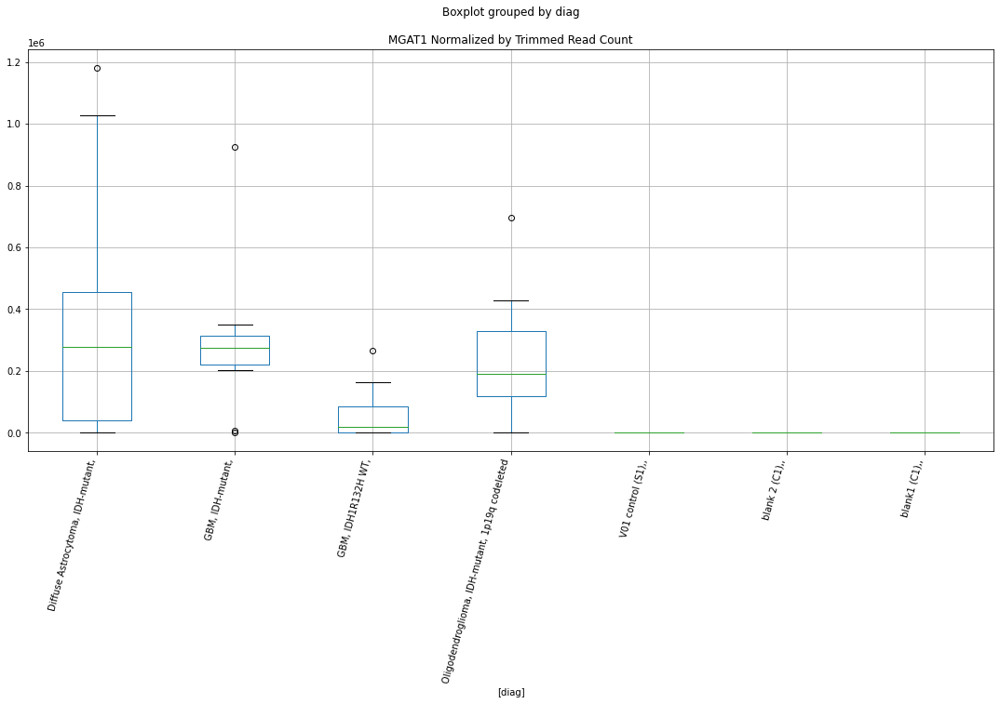

 p : 0.029087494278598865  ( t : 2.3713038177670436 ) :  Lexogen  :  cutadapt2  :  ODF3L1
Control and blanks
82        0.00
346    9890.42
Name: ODF3L1, dtype: float64
214    0.0
Name: ODF3L1, dtype: float64
478    0.0
Name: ODF3L1, dtype: float64


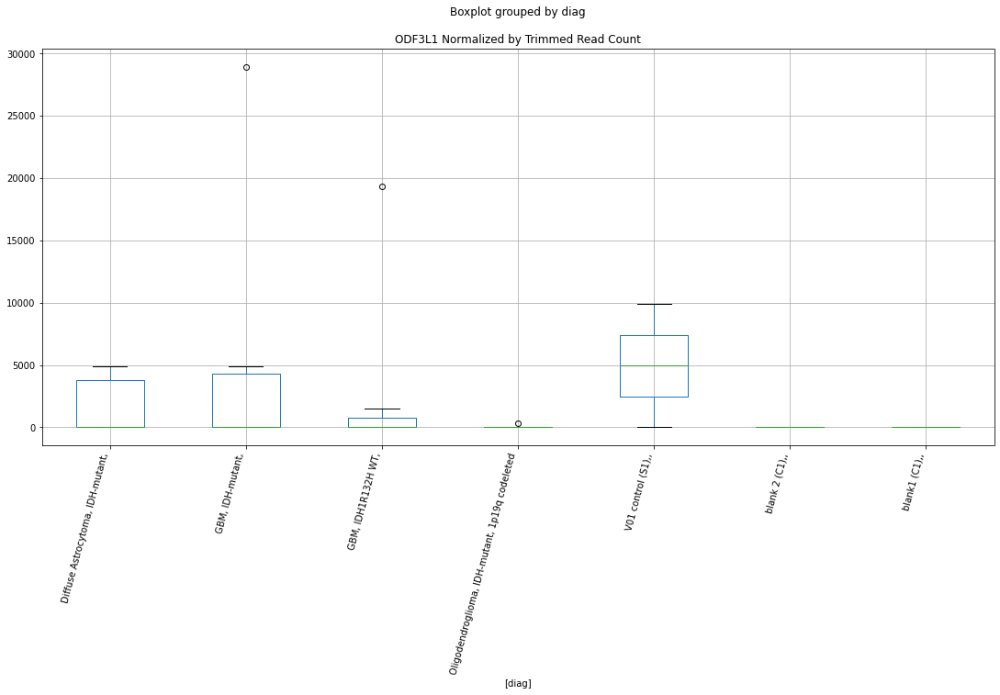

 p : 0.029247274301592085  ( t : 2.36862397358429 ) :  D-plex  :  bbduk2  :  MBTPS2
Control and blanks
73       0.00
337    890.16
Name: MBTPS2, dtype: float64
205    1790.91
Name: MBTPS2, dtype: float64
469    1183.05
Name: MBTPS2, dtype: float64


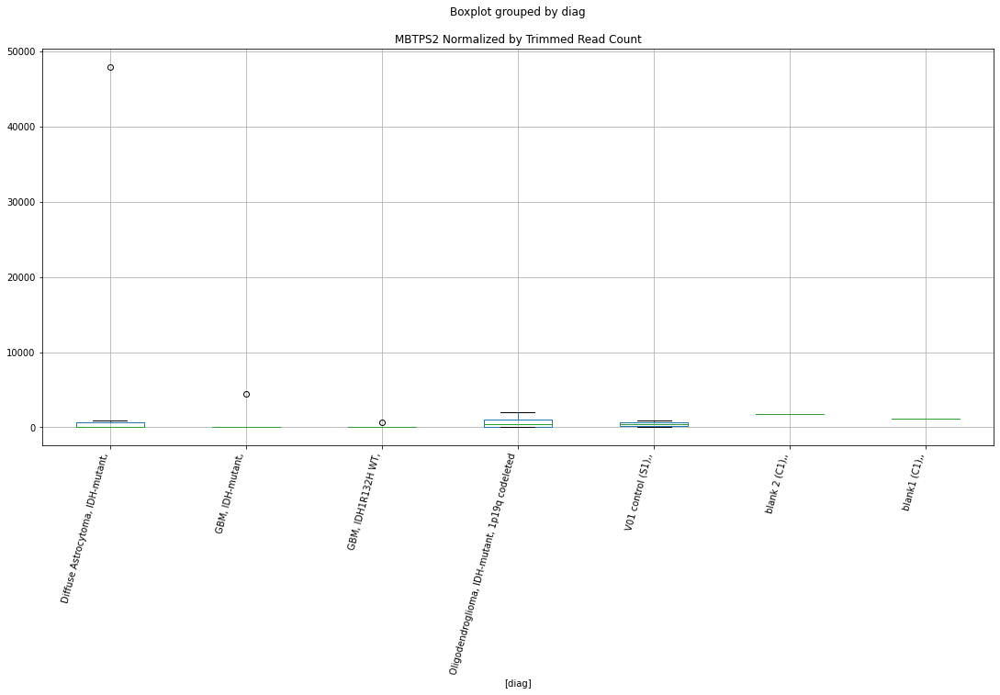

 p : 0.029383433569896582  ( t : 2.3663510524438904 ) :  D-plex  :  cutadapt2  :  MBTPS2
Control and blanks
76       0.00
340    880.73
Name: MBTPS2, dtype: float64
208    1234.52
Name: MBTPS2, dtype: float64
472    577.96
Name: MBTPS2, dtype: float64


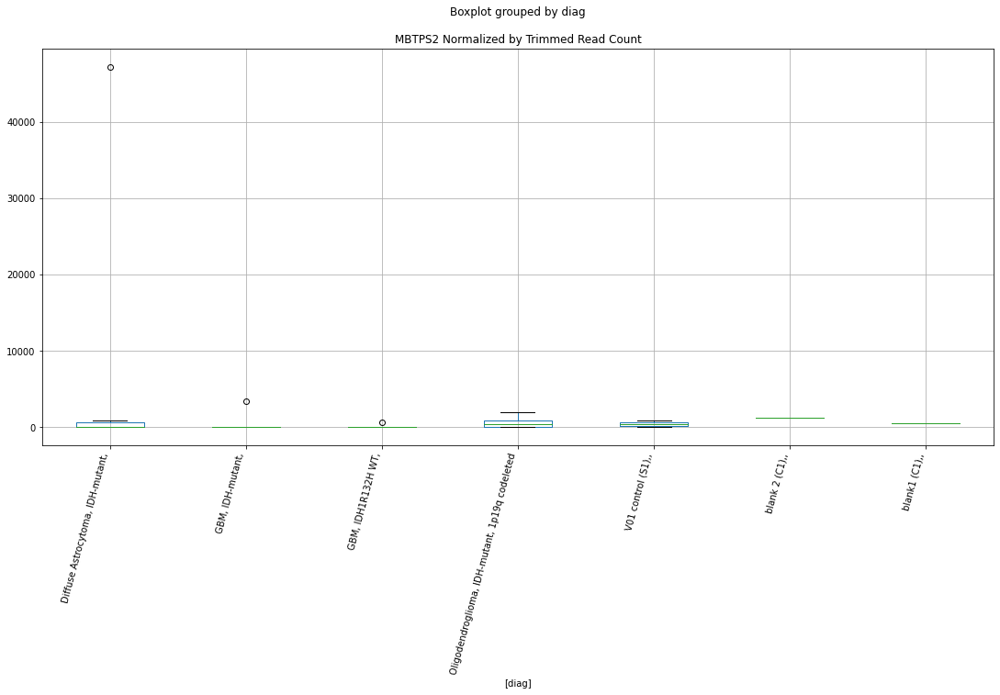

 p : 0.02951598344027732  ( t : 2.3641477977785743 ) :  D-plex  :  cutadapt2  :  MVB12A
Control and blanks
76     0.0
340    0.0
Name: MVB12A, dtype: float64
208    176.36
Name: MVB12A, dtype: float64
472    0.0
Name: MVB12A, dtype: float64


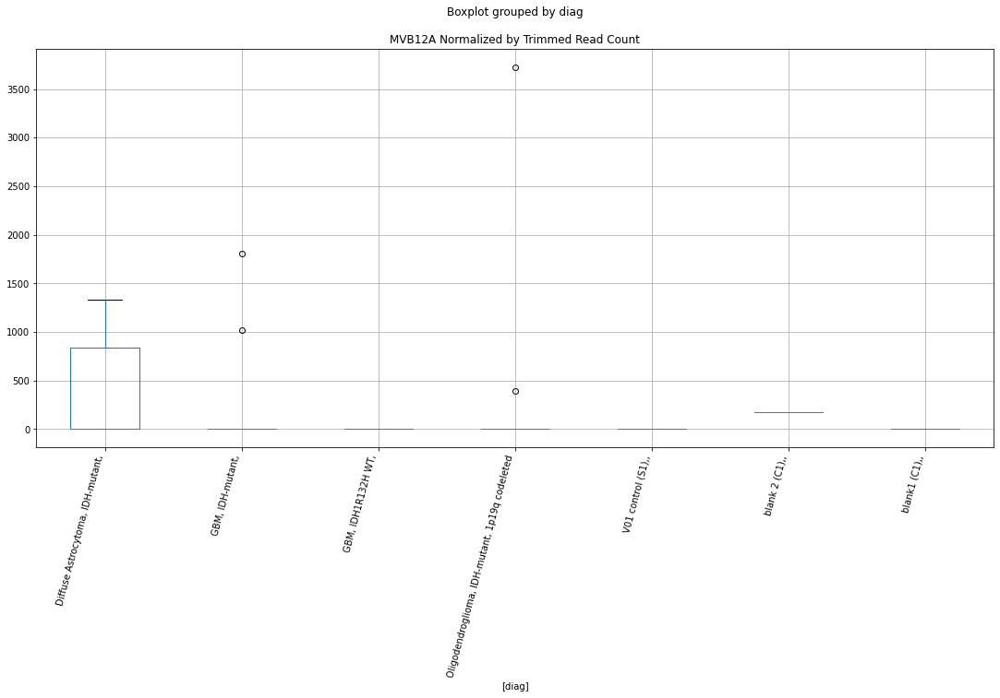

 p : 0.02965546129486244  ( t : 2.361839323395162 ) :  D-plex  :  bbduk2  :  LOC112268022
Control and blanks
73       0.00
337    890.16
Name: LOC112268022, dtype: float64
205    1253.64
Name: LOC112268022, dtype: float64
469    4732.22
Name: LOC112268022, dtype: float64


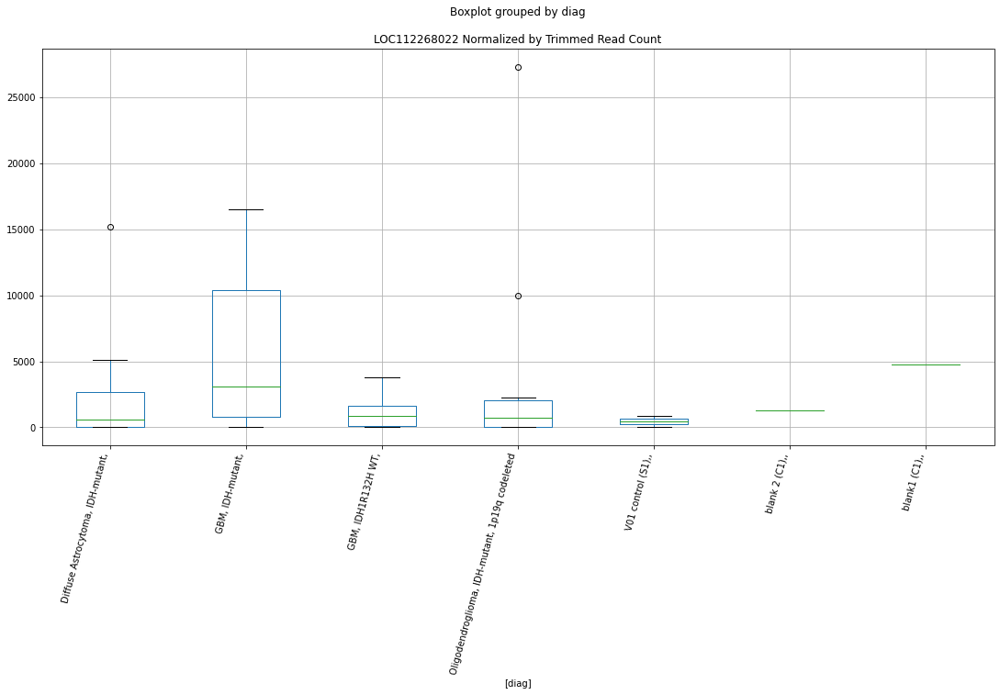

 p : 0.029868180170332537  ( t : 2.358338062021495 ) :  D-plex  :  bbduk2  :  LOC107986785
Control and blanks
73     0.0
337    0.0
Name: LOC107986785, dtype: float64
205    0.0
Name: LOC107986785, dtype: float64
469    1183.05
Name: LOC107986785, dtype: float64


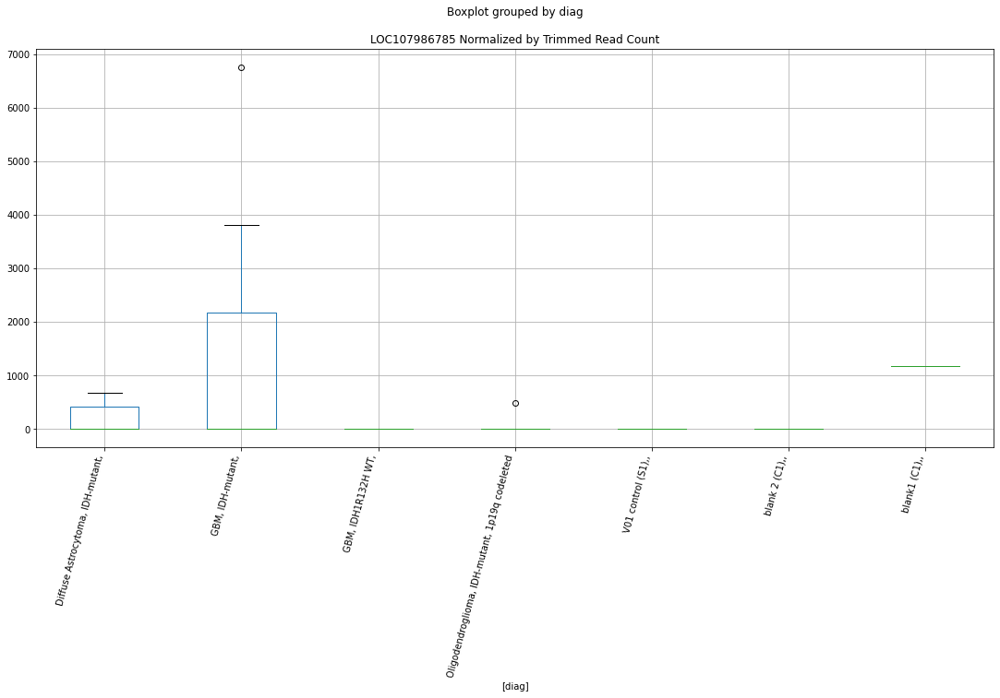

 p : 0.029921039788908595  ( t : 2.35747162051427 ) :  D-plex  :  bbduk2  :  LOC112268261
Control and blanks
73     773.01
337      0.00
Name: LOC112268261, dtype: float64
205    537.27
Name: LOC112268261, dtype: float64
469    0.0
Name: LOC112268261, dtype: float64


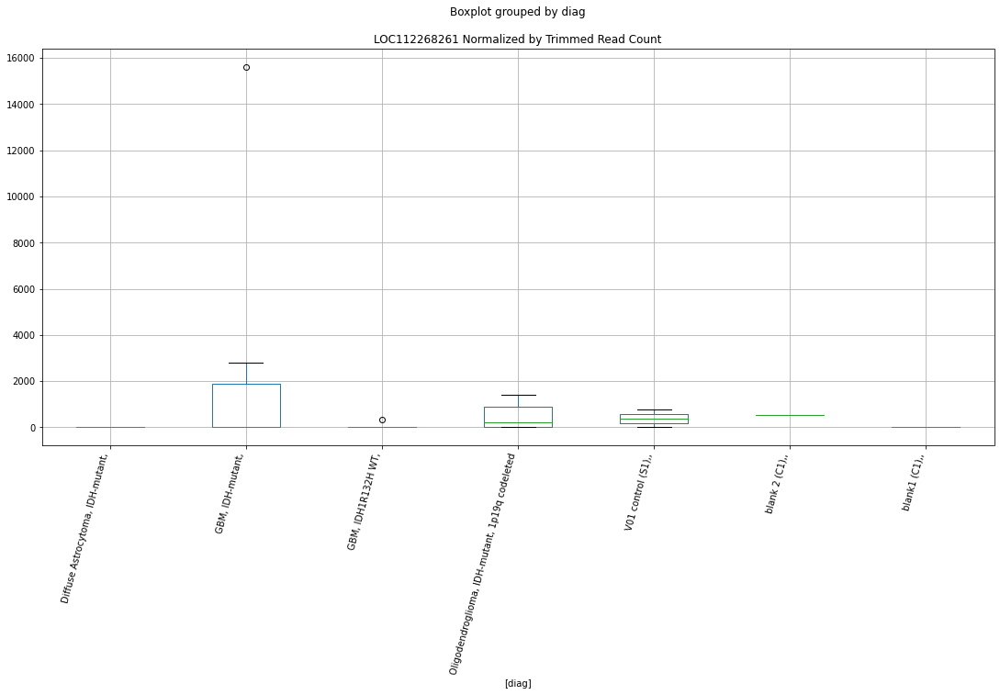

 p : 0.029943309264350217  ( t : 2.3571070202639612 ) :  D-plex  :  cutadapt2  :  LOC646588
Control and blanks
76     0.0
340    0.0
Name: LOC646588, dtype: float64
208    1234.52
Name: LOC646588, dtype: float64
472    0.0
Name: LOC646588, dtype: float64


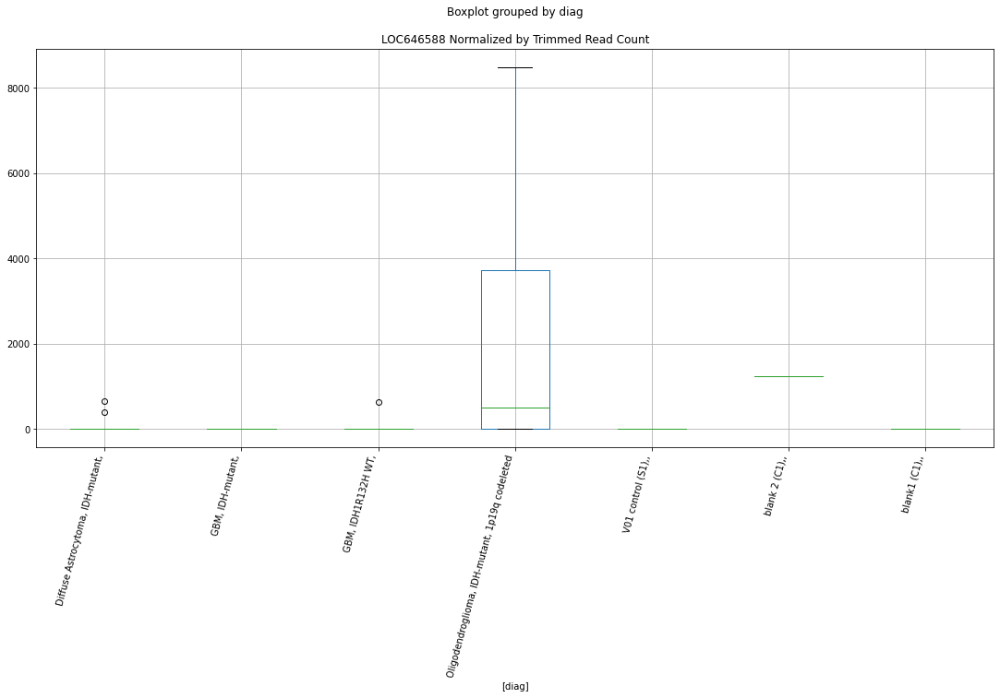

 p : 0.03007644700009003  ( t : 2.35493251867731 ) :  Lexogen  :  cutadapt2  :  MIR10B
Control and blanks
82       1420.05
346    119947.68
Name: MIR10B, dtype: float64
214    5966.98
Name: MIR10B, dtype: float64
478    237.46
Name: MIR10B, dtype: float64


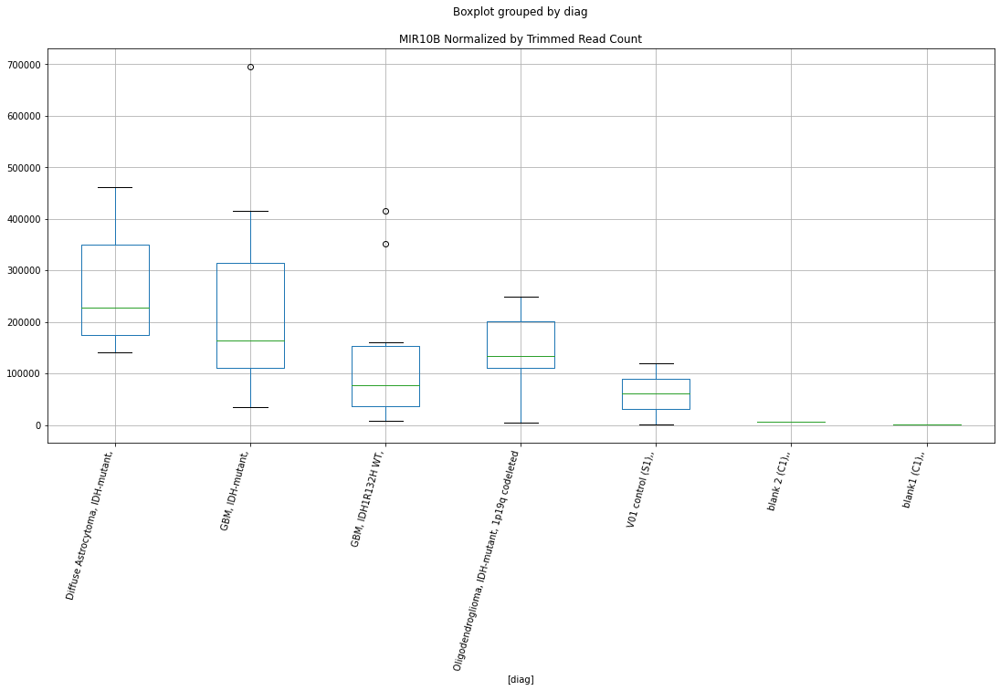

 p : 0.030115493239529625  ( t : 2.3542964878325674 ) :  D-plex  :  cutadapt2  :  LOC112268317
Control and blanks
76     0.0
340    0.0
Name: LOC112268317, dtype: float64
208    4232.65
Name: LOC112268317, dtype: float64
472    6935.47
Name: LOC112268317, dtype: float64


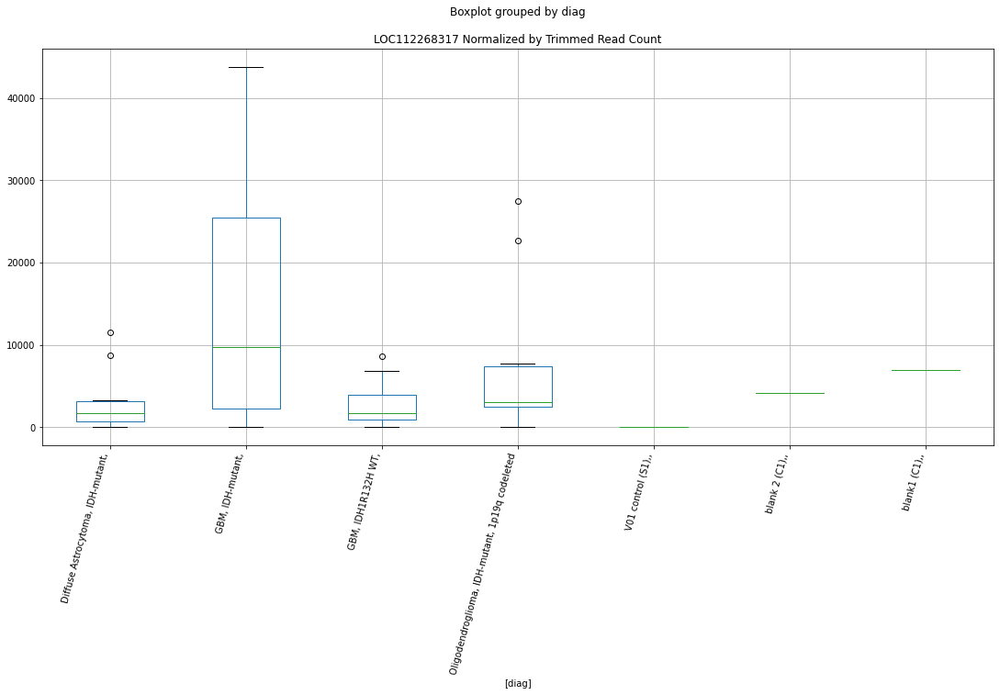

 p : 0.030206602435457003  ( t : 2.3528153767981115 ) :  D-plex  :  bbduk2  :  MEIOB
Control and blanks
73     86576.94
337     1780.31
Name: MEIOB, dtype: float64
205    18267.28
Name: MEIOB, dtype: float64
469    18928.87
Name: MEIOB, dtype: float64


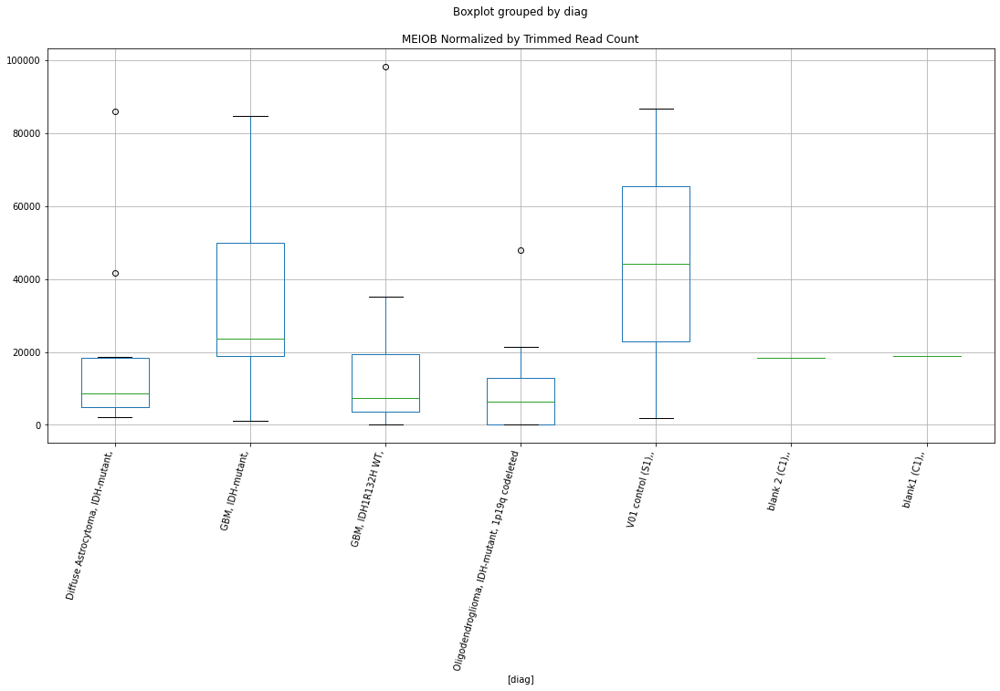

 p : 0.030283619082325717  ( t : 2.3515666020748847 ) :  D-plex  :  cutadapt2  :  MED12
Control and blanks
76     15909.9
340        0.0
Name: MED12, dtype: float64
208    881.8
Name: MED12, dtype: float64
472    1155.91
Name: MED12, dtype: float64


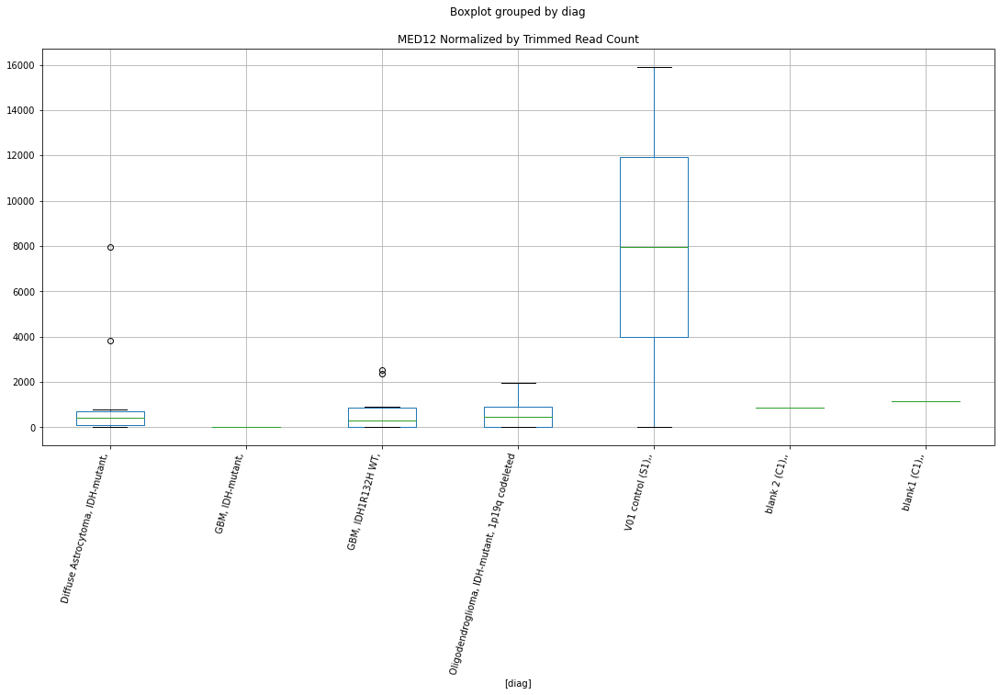

 p : 0.03028452736654884  ( t : 2.3515518924924805 ) :  Lexogen  :  cutadapt2  :  MUC5B
Control and blanks
82        0.00
346    1052.17
Name: MUC5B, dtype: float64
214    0.0
Name: MUC5B, dtype: float64
478    0.0
Name: MUC5B, dtype: float64


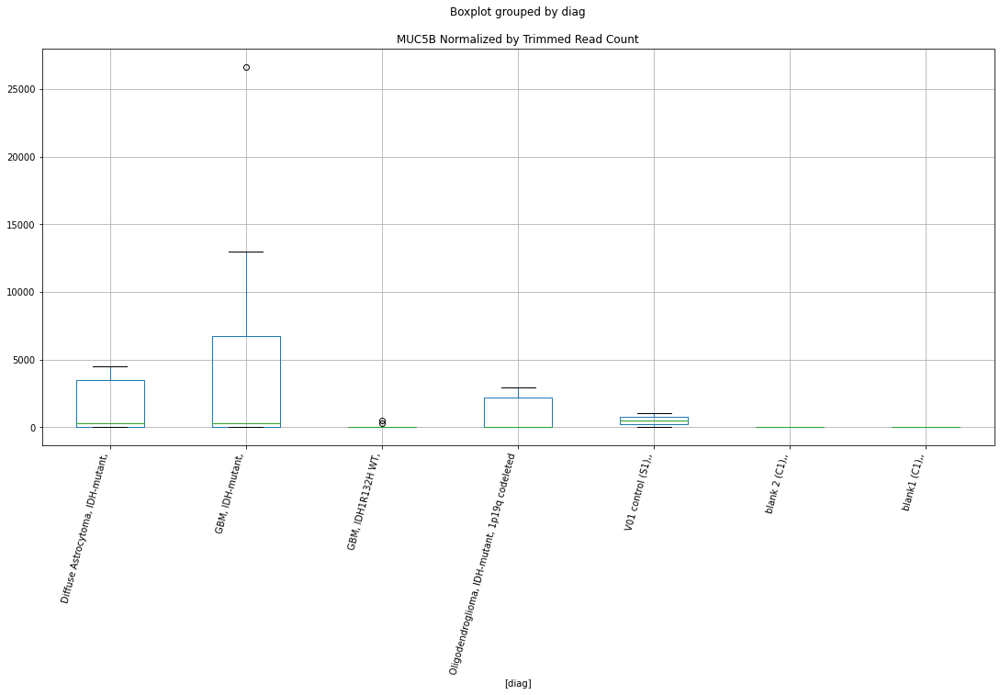

 p : 0.03031149903214509  ( t : 2.351115275897995 ) :  D-plex  :  bbduk2  :  LPIN1
Control and blanks
73         0.00
337    23144.09
Name: LPIN1, dtype: float64
205    4477.27
Name: LPIN1, dtype: float64
469    32534.0
Name: LPIN1, dtype: float64


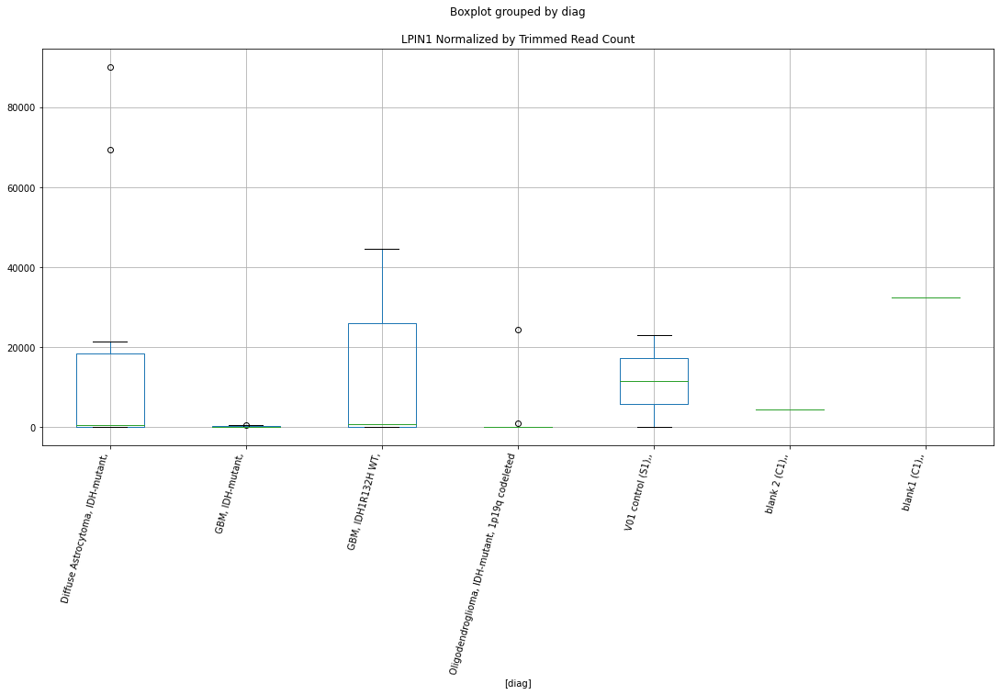

 p : 0.030377749400122705  ( t : 2.350044350567971 ) :  Lexogen  :  cutadapt2  :  MLX
Control and blanks
82     2840.10
346     420.87
Name: MLX, dtype: float64
214    271.23
Name: MLX, dtype: float64
478    18996.84
Name: MLX, dtype: float64


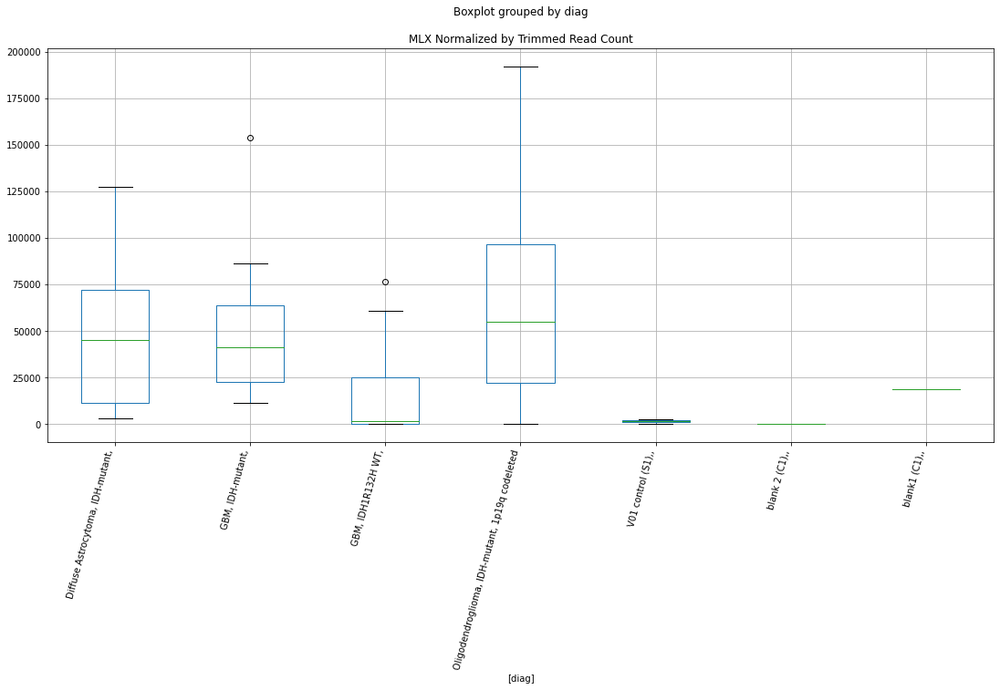

 p : 0.030730865119588793  ( t : 2.3443727232867624 ) :  Lexogen  :  bbduk2  :  MIR10B
Control and blanks
79       1430.60
343    121231.47
Name: MIR10B, dtype: float64
211    6012.74
Name: MIR10B, dtype: float64
475    239.52
Name: MIR10B, dtype: float64


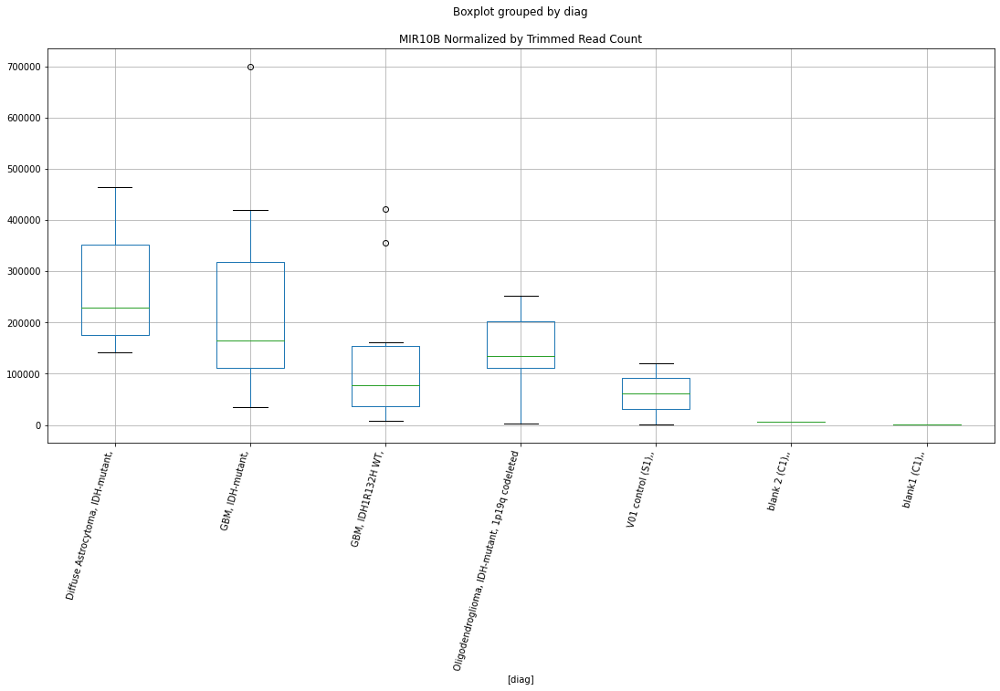

 p : 0.030761681386185145  ( t : 2.343880644791285 ) :  D-plex  :  cutadapt2  :  MST1L
Control and blanks
76     0.0
340    0.0
Name: MST1L, dtype: float64
208    176.36
Name: MST1L, dtype: float64
472    1155.91
Name: MST1L, dtype: float64


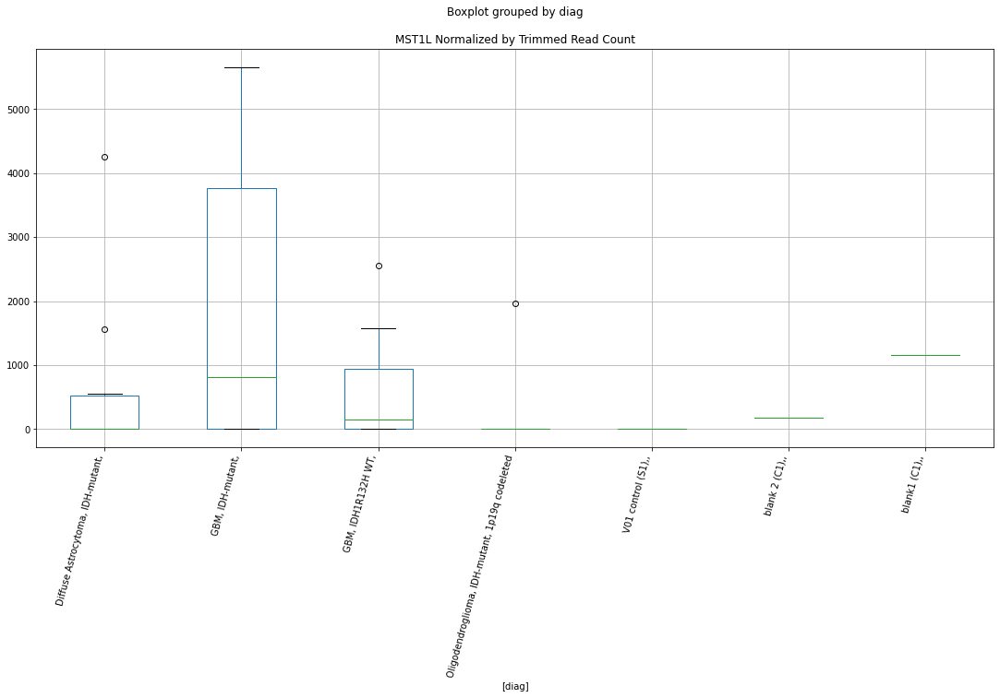

 p : 0.03077255728470064  ( t : 2.343707086433772 ) :  Lexogen  :  cutadapt2  :  LOC112267857
Control and blanks
82     28401.02
346    34932.13
Name: LOC112267857, dtype: float64
214    30377.36
Name: LOC112267857, dtype: float64
478    0.0
Name: LOC112267857, dtype: float64


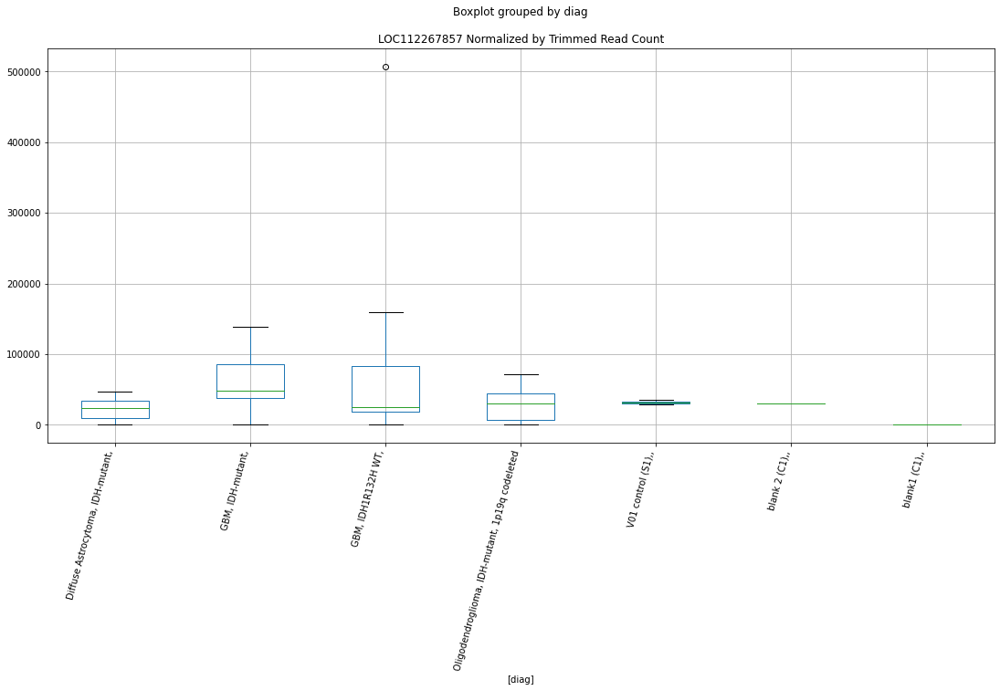

 p : 0.030930211200460224  ( t : 2.3411976245186077 ) :  Lexogen  :  bbduk2  :  MLX
Control and blanks
79     2861.20
343     424.63
Name: MLX, dtype: float64
211    273.31
Name: MLX, dtype: float64
475    18921.74
Name: MLX, dtype: float64


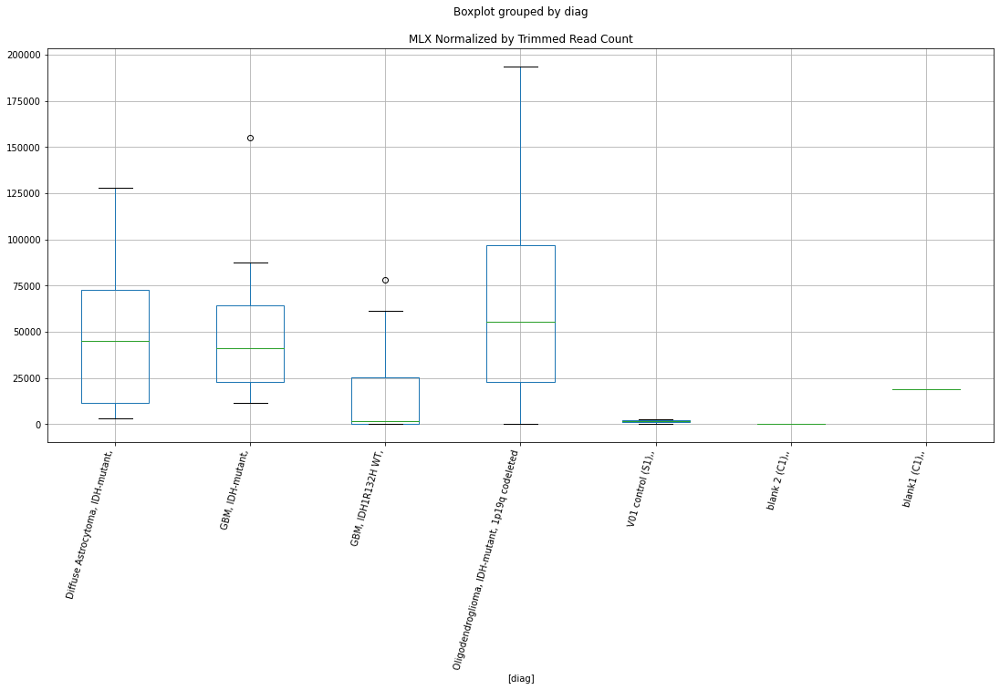

 p : 0.031023713986621567  ( t : 2.339714907401017 ) :  Lexogen  :  bbduk2  :  MYO9B
Control and blanks
79     0.0
343    0.0
Name: MYO9B, dtype: float64
211    3826.29
Name: MYO9B, dtype: float64
475    9101.6
Name: MYO9B, dtype: float64


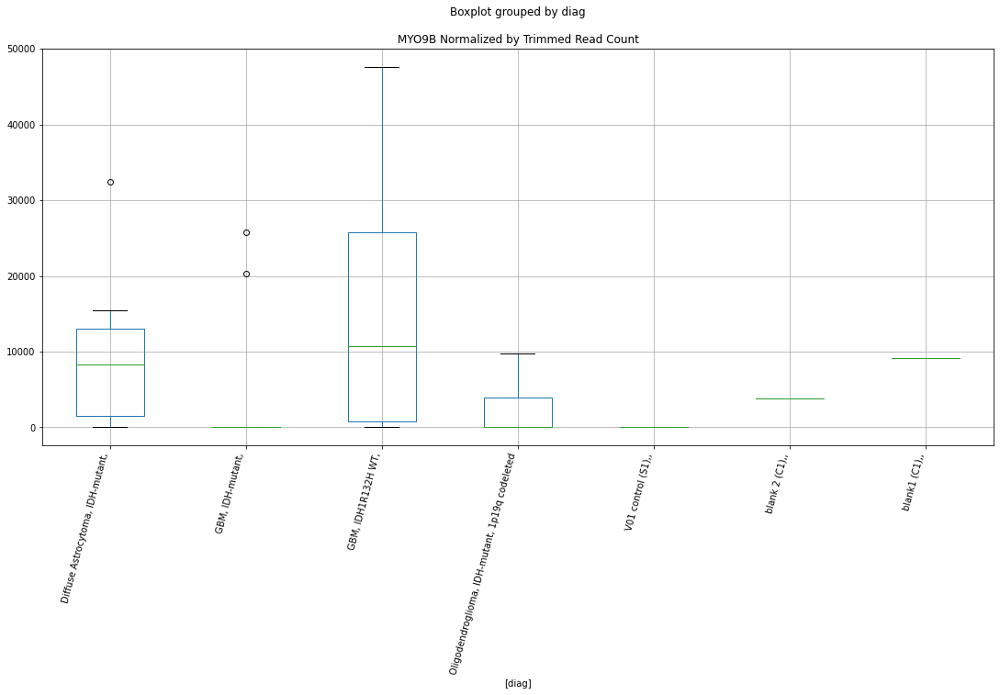

 p : 0.031088507393645052  ( t : 2.3386898849885562 ) :  D-plex  :  cutadapt2  :  LOC107986613
Control and blanks
76       0.00
340    880.73
Name: LOC107986613, dtype: float64
208    352.72
Name: LOC107986613, dtype: float64
472    0.0
Name: LOC107986613, dtype: float64


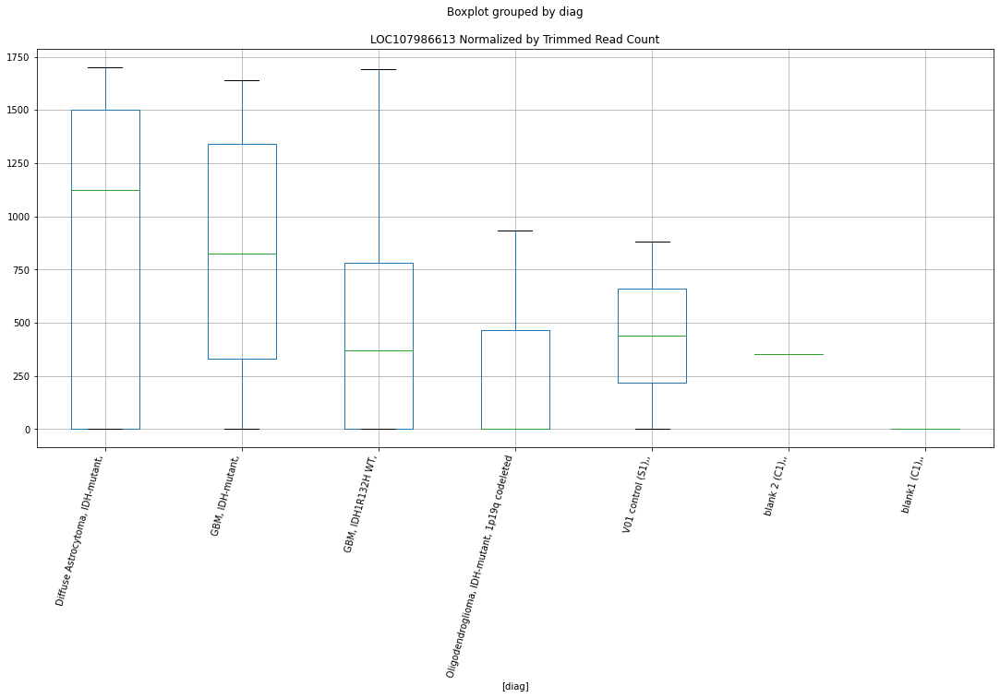

 p : 0.031120761900660494  ( t : 2.3381803639918255 ) :  Lexogen  :  cutadapt2  :  OGA
Control and blanks
82     1420.05
346       0.00
Name: OGA, dtype: float64
214    0.0
Name: OGA, dtype: float64
478    0.0
Name: OGA, dtype: float64


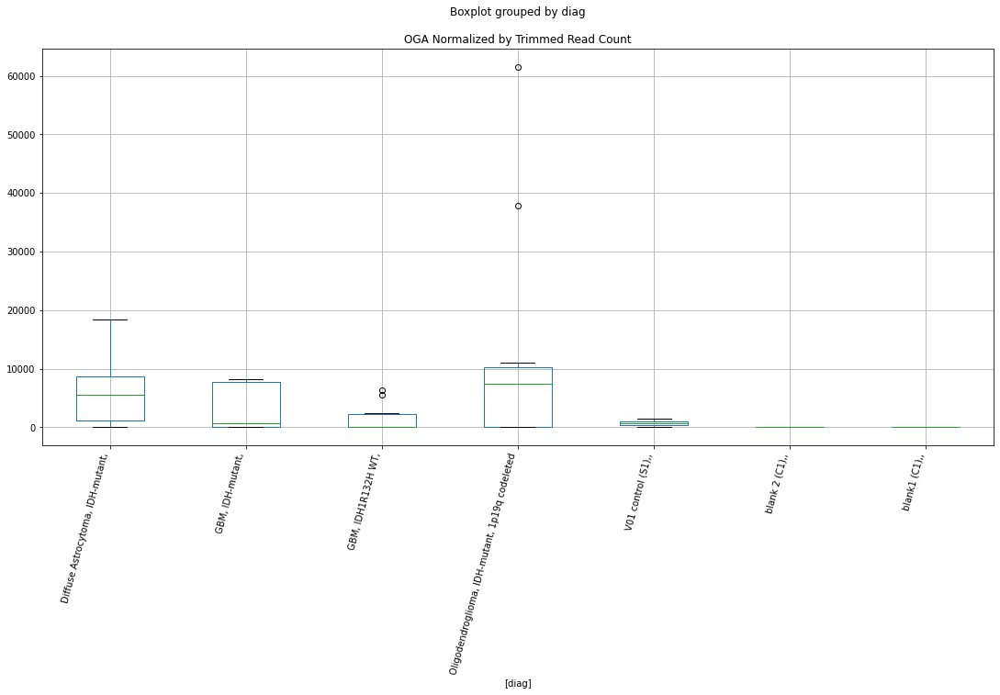

 p : 0.0311766564472757  ( t : 2.3372985659025343 ) :  D-plex  :  bbduk2  :  LRRC27
Control and blanks
73        0.00
337    1780.31
Name: LRRC27, dtype: float64
205    1253.64
Name: LRRC27, dtype: float64
469    5915.27
Name: LRRC27, dtype: float64


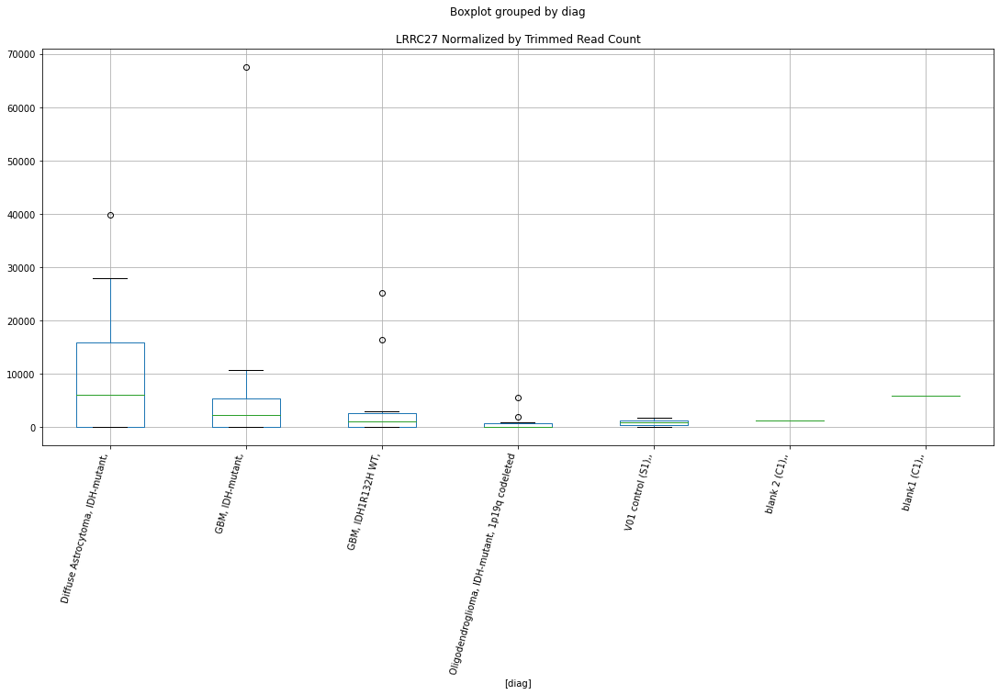

 p : 0.031246971718830934  ( t : 2.3361913511093353 ) :  D-plex  :  cutadapt2  :  LRRC27
Control and blanks
76        0.00
340    1761.46
Name: LRRC27, dtype: float64
208    1763.6
Name: LRRC27, dtype: float64
472    5779.56
Name: LRRC27, dtype: float64


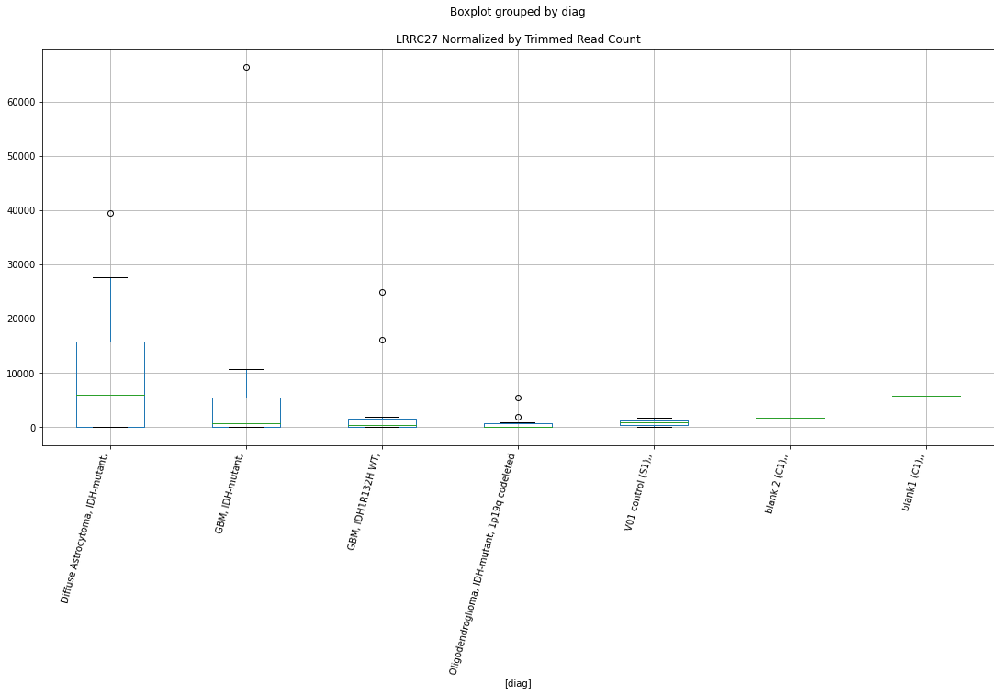

 p : 0.031286734296651096  ( t : 2.335566257603201 ) :  D-plex  :  bbduk2  :  NOB1
Control and blanks
73     0.0
337    0.0
Name: NOB1, dtype: float64
205    1074.55
Name: NOB1, dtype: float64
469    1183.05
Name: NOB1, dtype: float64


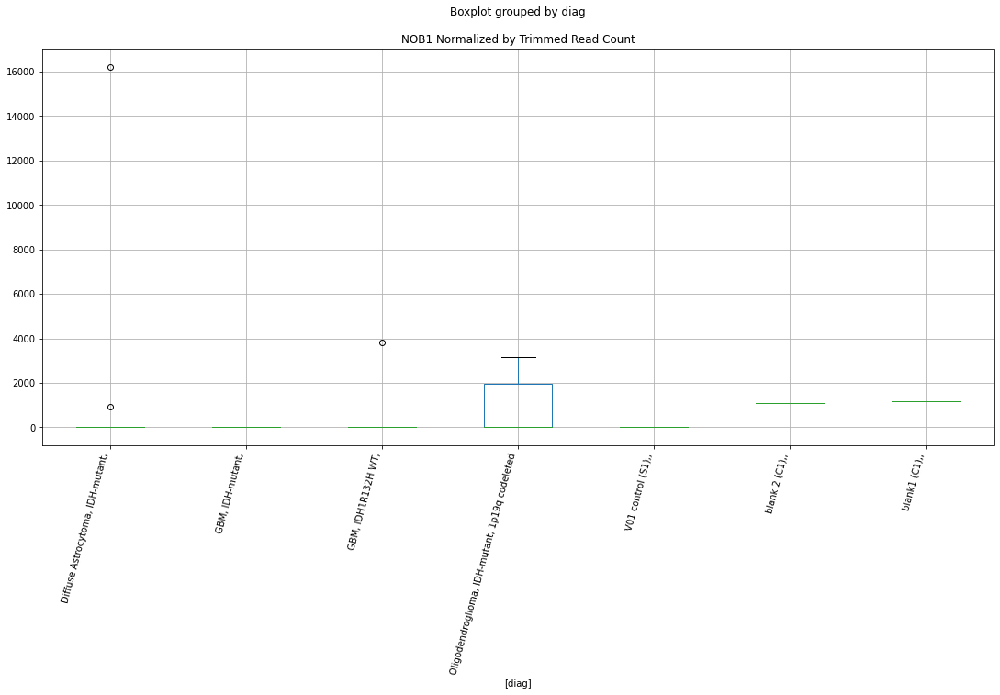

 p : 0.03132138403312879  ( t : 2.3350221434242306 ) :  D-plex  :  bbduk2  :  NOL4L
Control and blanks
73     128319.39
337         0.00
Name: NOL4L, dtype: float64
205    80770.02
Name: NOL4L, dtype: float64
469    104700.34
Name: NOL4L, dtype: float64


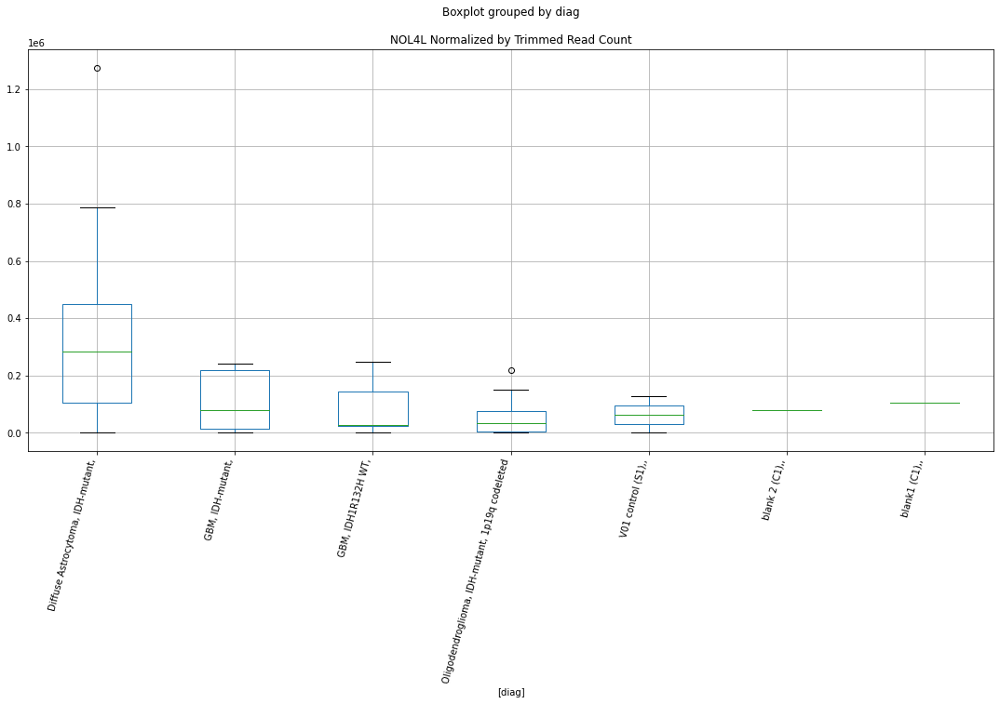

 p : 0.03148455392680153  ( t : 2.3324673431898995 ) :  Lexogen  :  bbduk2  :  OGA
Control and blanks
79     1430.6
343       0.0
Name: OGA, dtype: float64
211    0.0
Name: OGA, dtype: float64
475    0.0
Name: OGA, dtype: float64


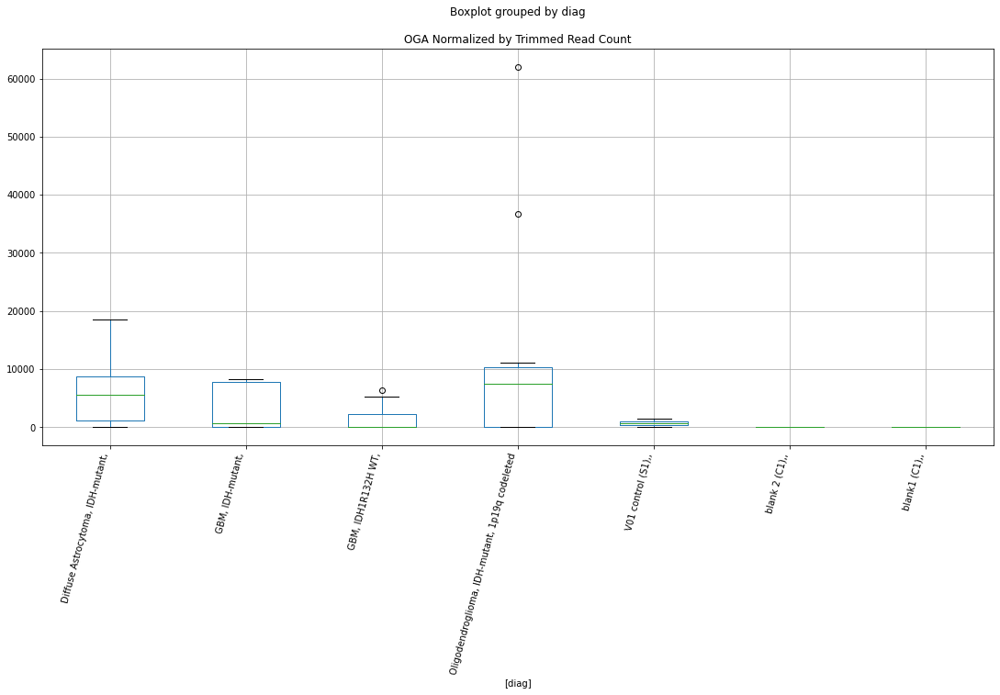

 p : 0.03148762234630049  ( t : 2.332419418055674 ) :  D-plex  :  cutadapt2  :  LOC112268022
Control and blanks
76     0.0
340    0.0
Name: LOC112268022, dtype: float64
208    1410.88
Name: LOC112268022, dtype: float64
472    3467.74
Name: LOC112268022, dtype: float64


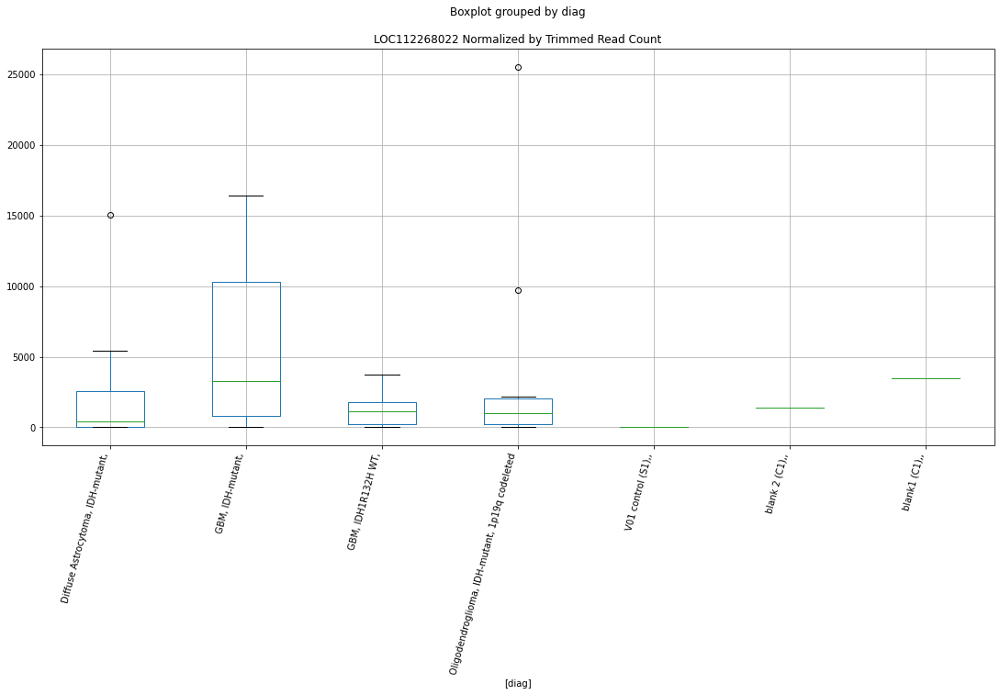

 p : 0.03161705506034738  ( t : 2.3304017740953795 ) :  D-plex  :  cutadapt2  :  NOB1
Control and blanks
76     0.0
340    0.0
Name: NOB1, dtype: float64
208    1058.16
Name: NOB1, dtype: float64
472    1155.91
Name: NOB1, dtype: float64


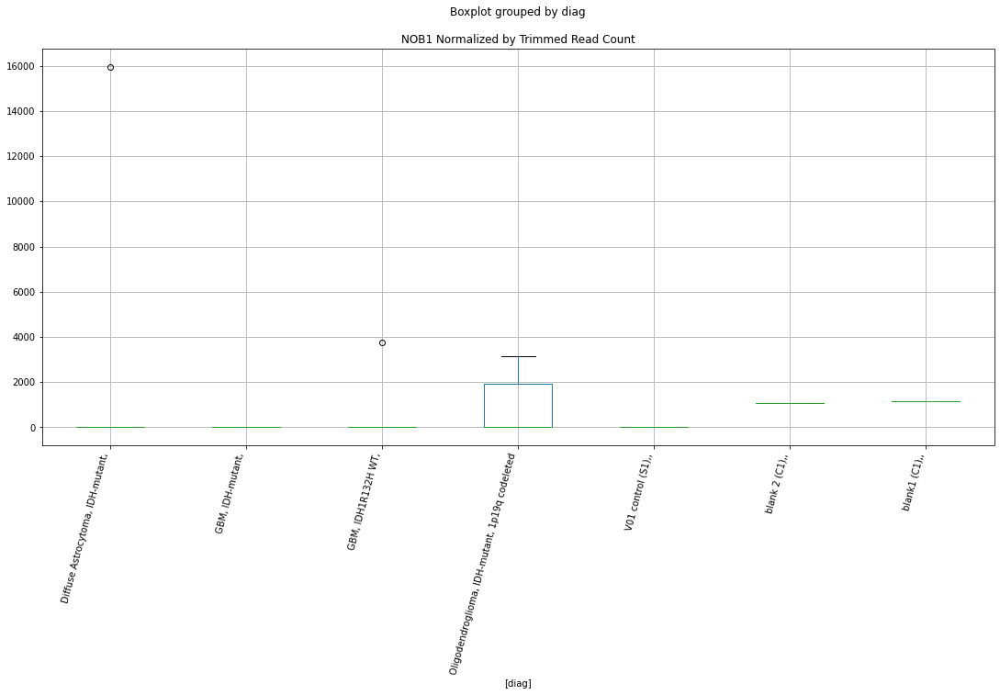

 p : 0.03183236881192611  ( t : 2.32706233336172 ) :  D-plex  :  cutadapt2  :  NAT9
Control and blanks
76         0.00
340    29944.89
Name: NAT9, dtype: float64
208    0.0
Name: NAT9, dtype: float64
472    0.0
Name: NAT9, dtype: float64


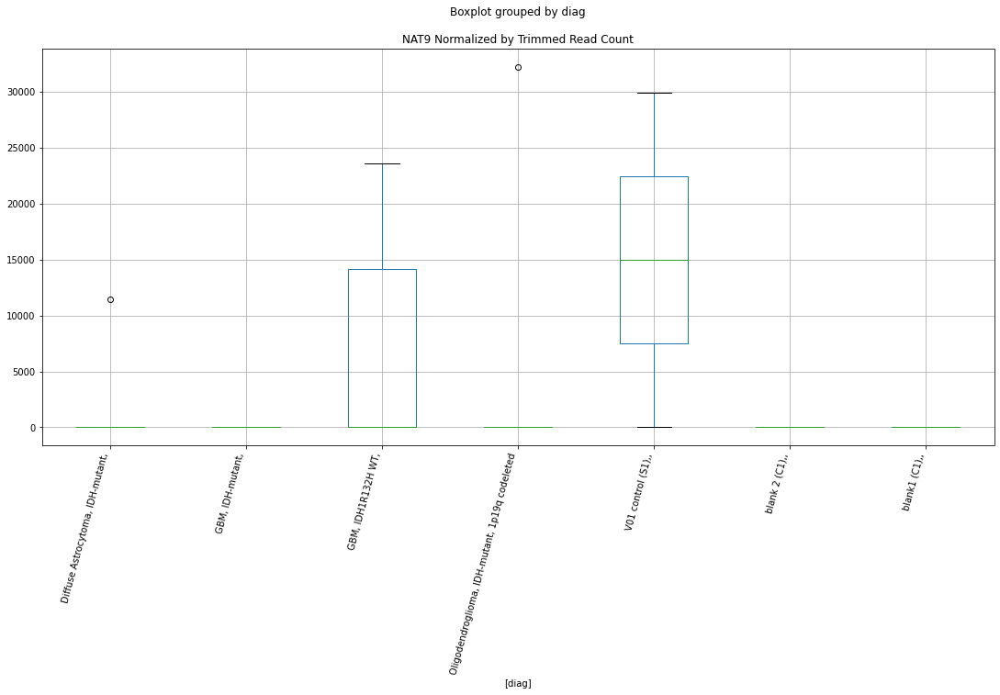

 p : 0.03184990631675775  ( t : 2.326791258206673 ) :  D-plex  :  bbduk2  :  MSL3
Control and blanks
73     0.0
337    0.0
Name: MSL3, dtype: float64
205    179.09
Name: MSL3, dtype: float64
469    0.0
Name: MSL3, dtype: float64


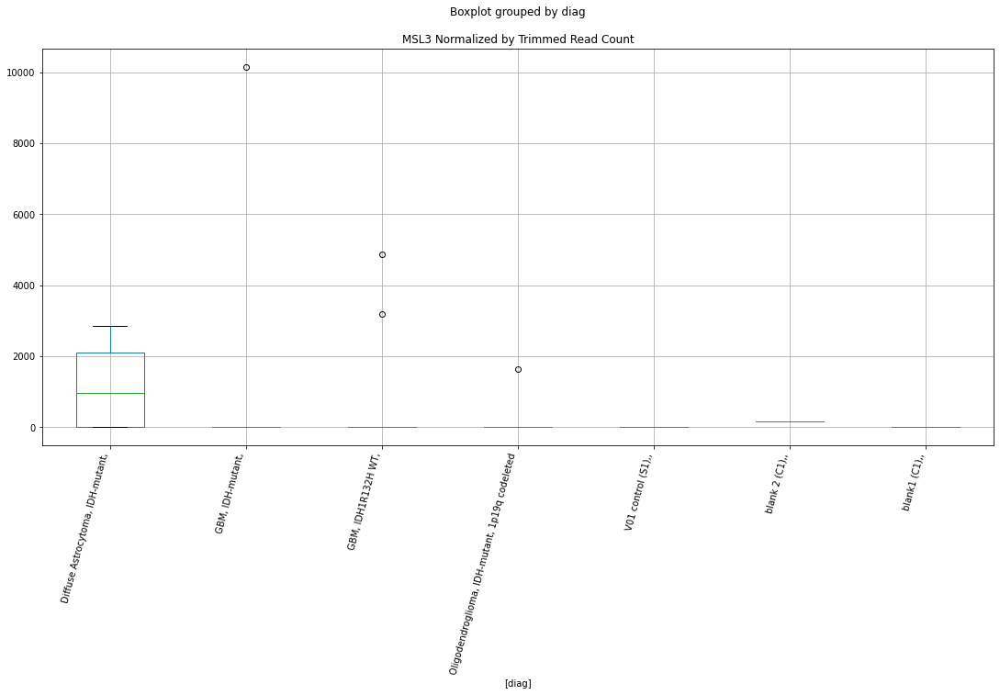

 p : 0.03192743260511865  ( t : 2.3255946028754817 ) :  Lexogen  :  bbduk2  :  NFATC2
Control and blanks
79          0.0
343    198726.2
Name: NFATC2, dtype: float64
211    0.0
Name: NFATC2, dtype: float64
475    0.0
Name: NFATC2, dtype: float64


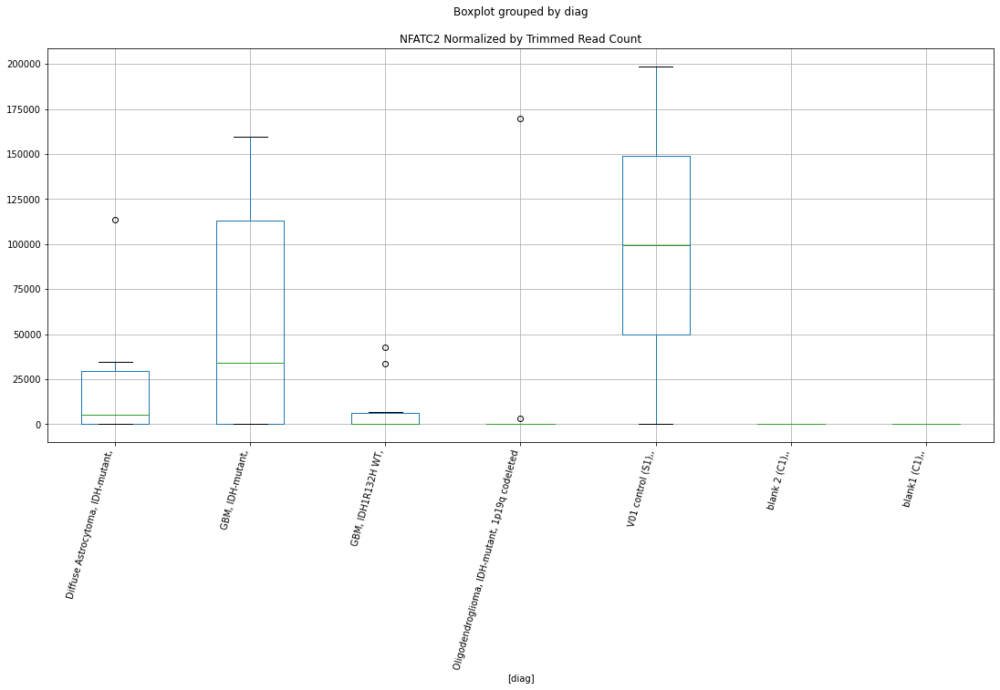

 p : 0.03194849769082658  ( t : 2.325269919706566 ) :  D-plex  :  cutadapt2  :  NUB1
Control and blanks
76     0.0
340    0.0
Name: NUB1, dtype: float64
208    705.44
Name: NUB1, dtype: float64
472    0.0
Name: NUB1, dtype: float64


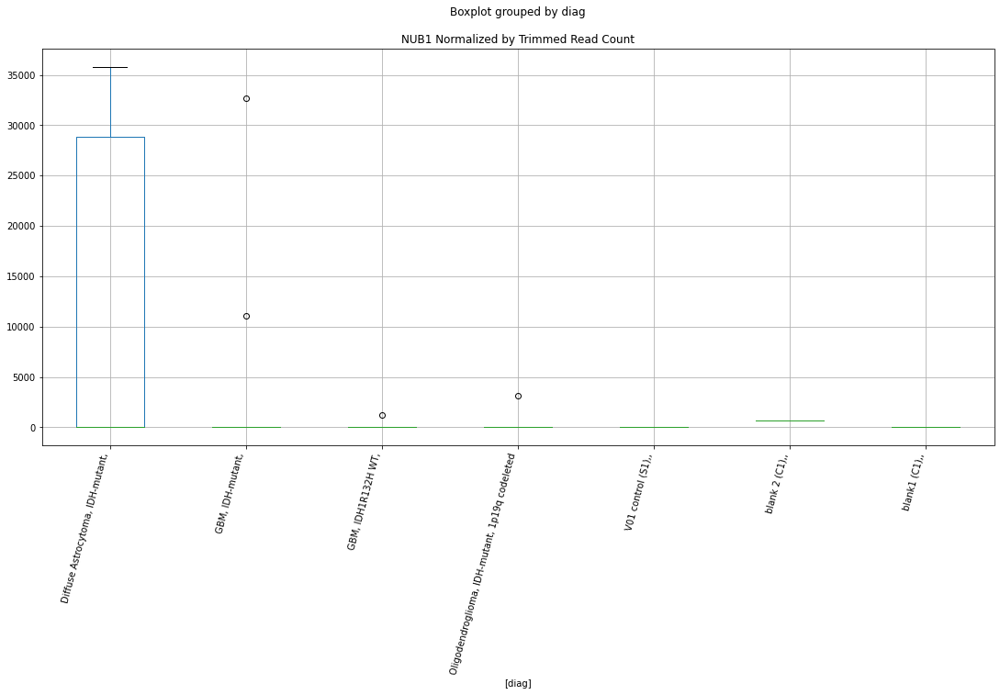

 p : 0.031954588534704204  ( t : 2.3251760765779204 ) :  D-plex  :  cutadapt2  :  MIR128-2
Control and blanks
76     27274.11
340        0.00
Name: MIR128-2, dtype: float64
208    529.08
Name: MIR128-2, dtype: float64
472    0.0
Name: MIR128-2, dtype: float64


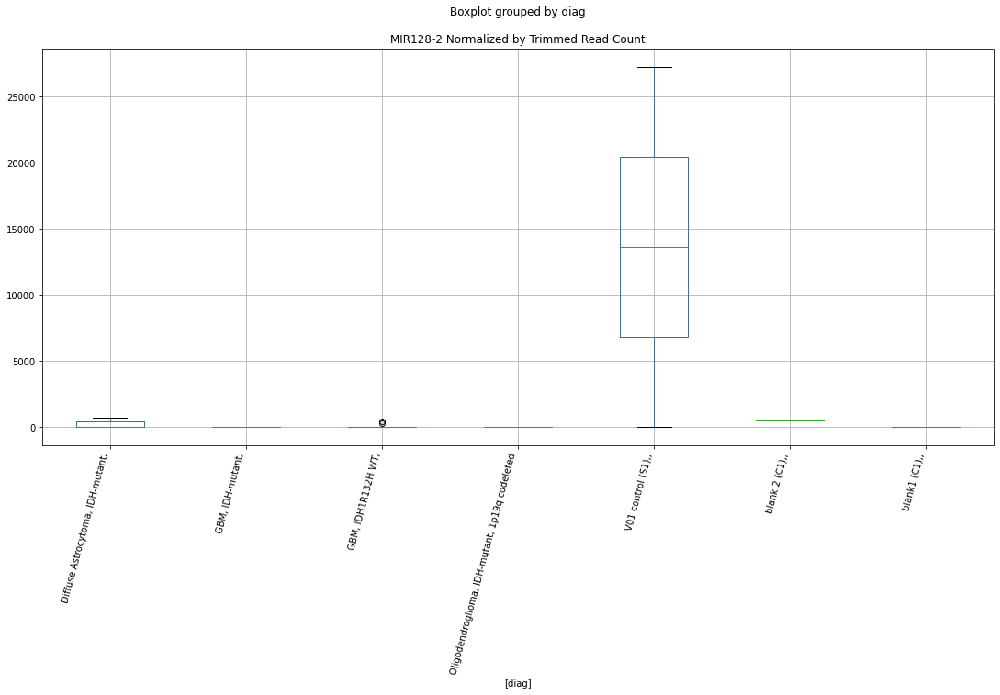

 p : 0.031989694229564505  ( t : 2.3246355182488068 ) :  D-plex  :  bbduk2  :  NCR3LG1
Control and blanks
73     316933.44
337       890.16
Name: NCR3LG1, dtype: float64
205    12715.46
Name: NCR3LG1, dtype: float64
469    243709.25
Name: NCR3LG1, dtype: float64


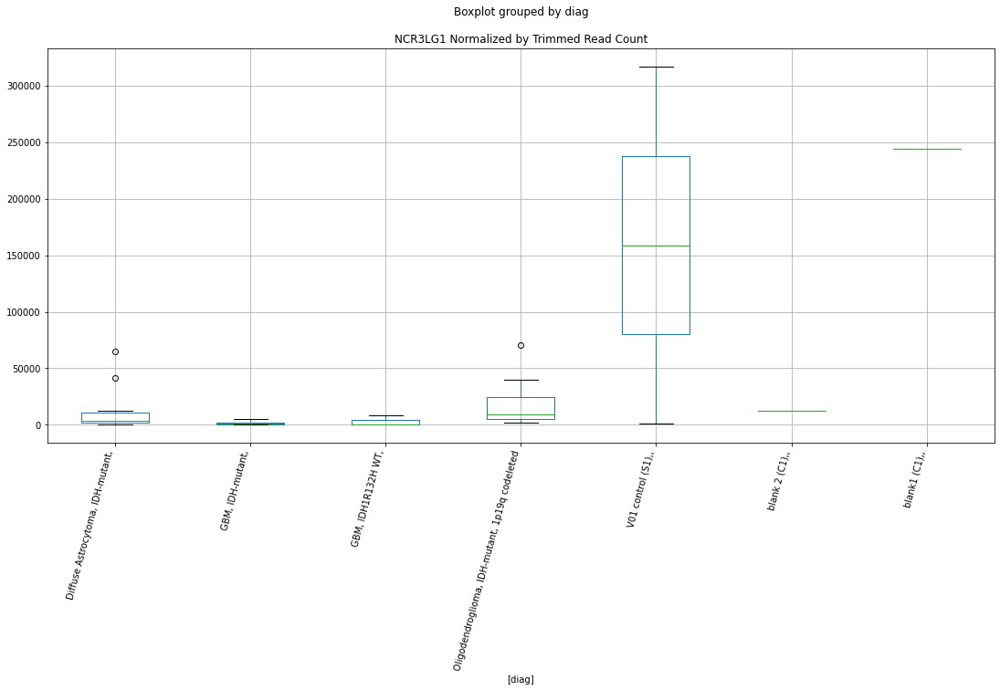

 p : 0.032041220780500534  ( t : 2.3238431085202467 ) :  D-plex  :  cutadapt2  :  NBN
Control and blanks
76     6060.91
340       0.00
Name: NBN, dtype: float64
208    21163.23
Name: NBN, dtype: float64
472    725912.53
Name: NBN, dtype: float64


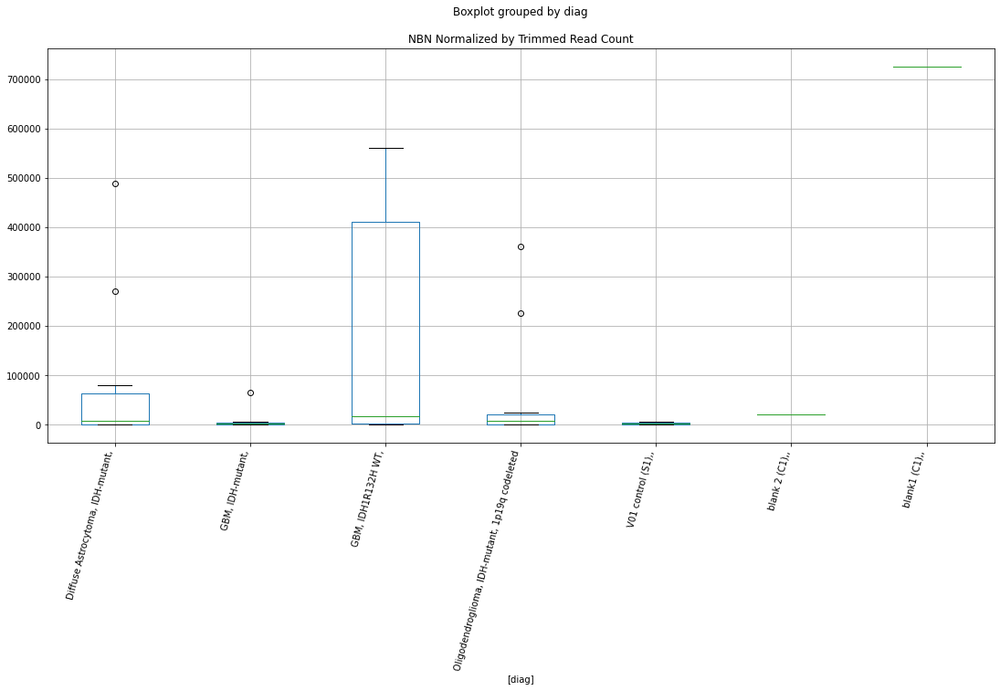

 p : 0.032068612792586625  ( t : 2.323422337711285 ) :  Lexogen  :  cutadapt2  :  NFKB2
Control and blanks
82        0.00
346    2314.78
Name: NFKB2, dtype: float64
214    5966.98
Name: NFKB2, dtype: float64
478    2612.07
Name: NFKB2, dtype: float64


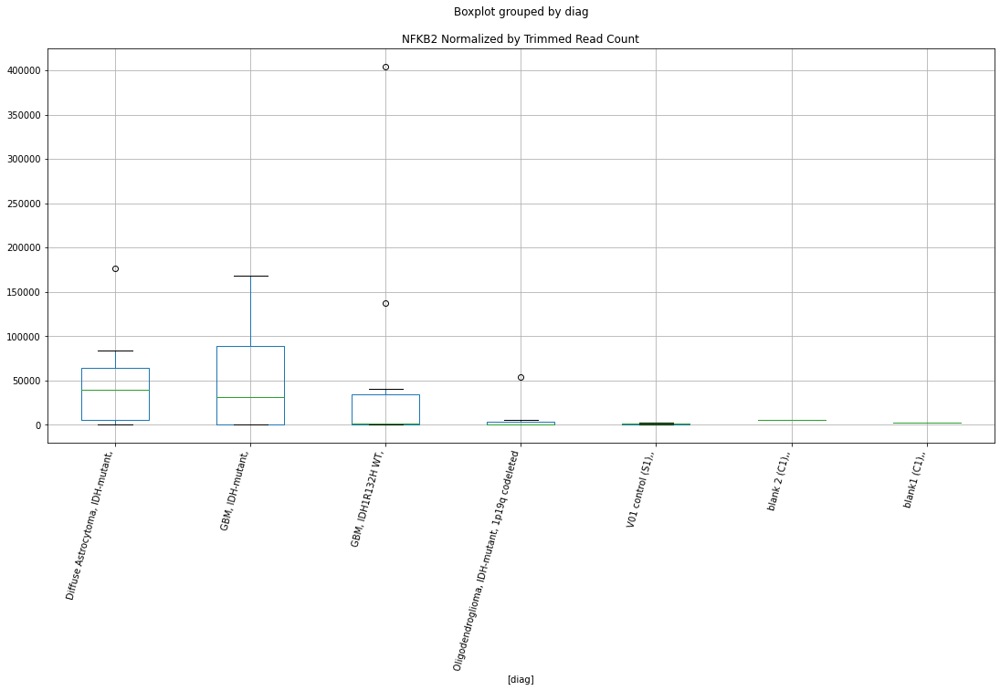

 p : 0.03212461757738259  ( t : 2.322563082108128 ) :  D-plex  :  bbduk2  :  MIR128-2
Control and blanks
73     27828.3
337        0.0
Name: MIR128-2, dtype: float64
205    358.18
Name: MIR128-2, dtype: float64
469    0.0
Name: MIR128-2, dtype: float64


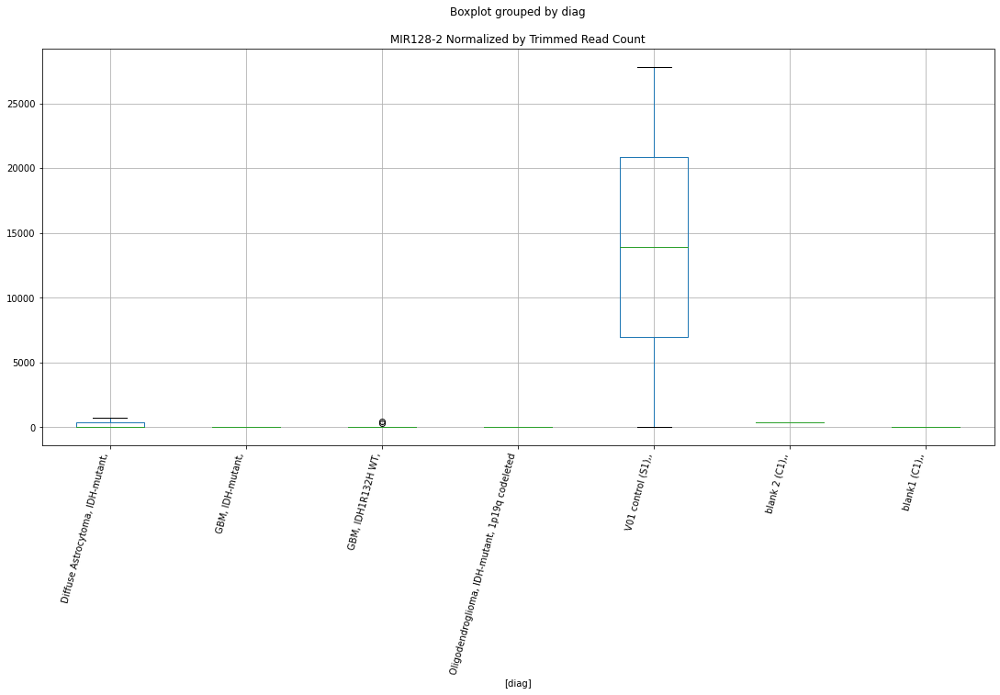

 p : 0.0322401788901642  ( t : 2.3207944673703214 ) :  Lexogen  :  cutadapt2  :  MAF
Control and blanks
82          0.00
346    139307.65
Name: MAF, dtype: float64
214    10849.06
Name: MAF, dtype: float64
478    5936.51
Name: MAF, dtype: float64


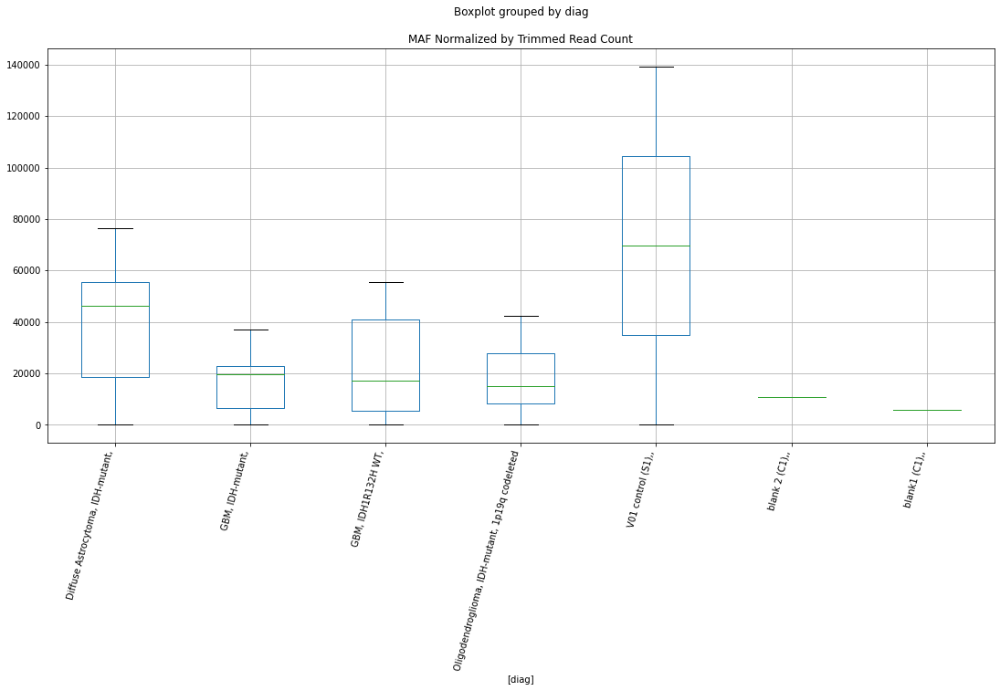

 p : 0.03234964904117799  ( t : 2.3191244975688776 ) :  D-plex  :  bbduk2  :  MYH15
Control and blanks
73     2319.03
337       0.00
Name: MYH15, dtype: float64
205    1611.82
Name: MYH15, dtype: float64
469    0.0
Name: MYH15, dtype: float64


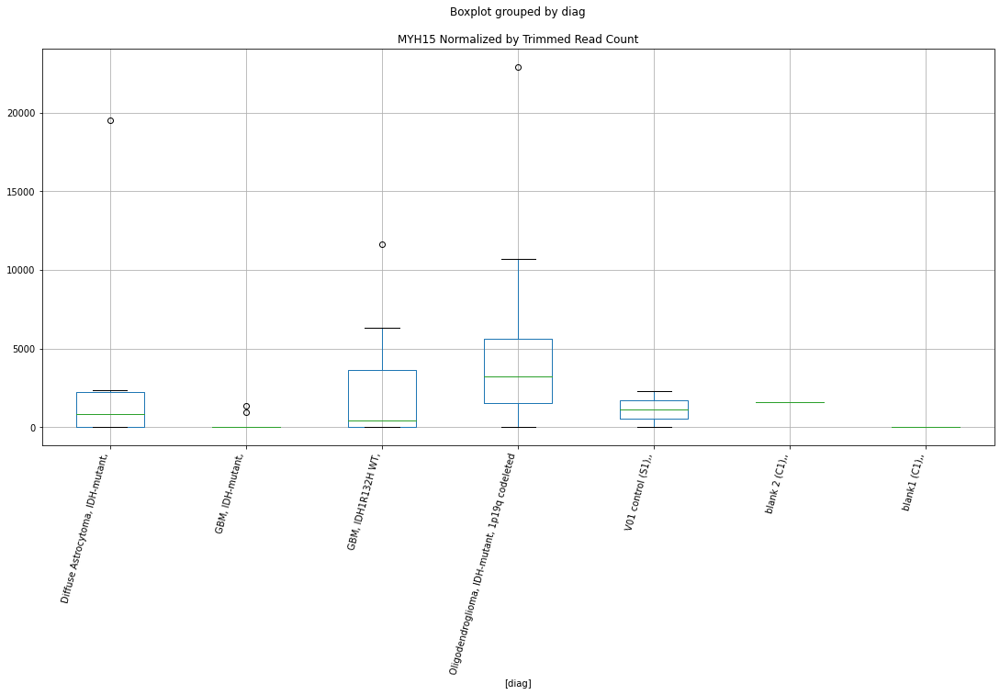

 p : 0.0323590114871255  ( t : 2.318981916956001 ) :  Lexogen  :  bbduk2  :  NFKB2
Control and blanks
79        0.00
343    2335.46
Name: NFKB2, dtype: float64
211    6012.74
Name: NFKB2, dtype: float64
475    2634.67
Name: NFKB2, dtype: float64


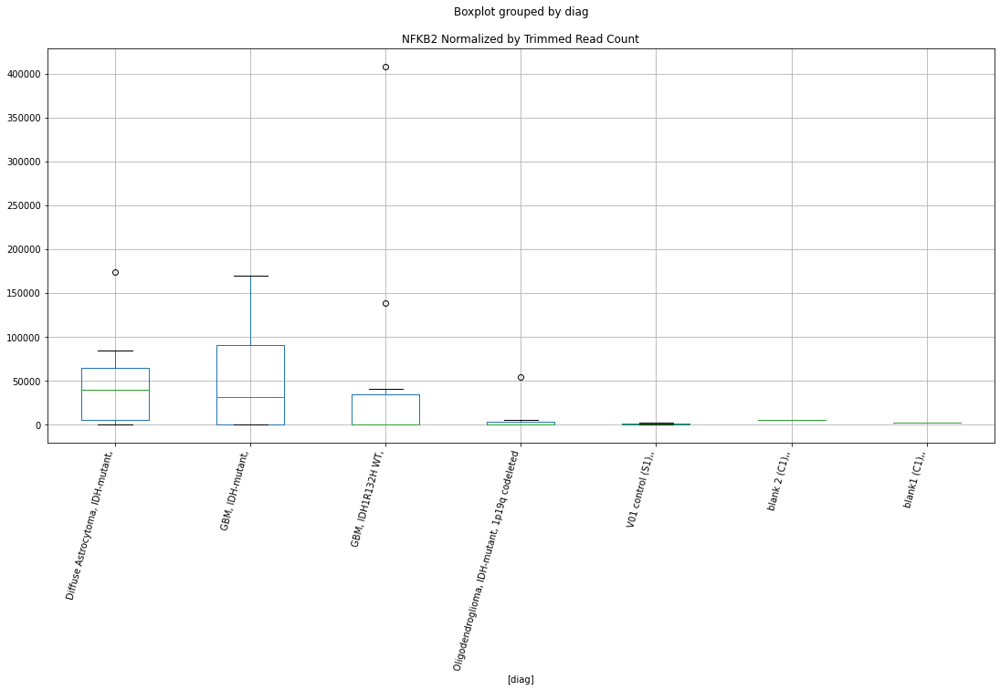

 p : 0.03236779840677955  ( t : 2.3188481358739845 ) :  D-plex  :  bbduk2  :  NBN
Control and blanks
73     9276.1
337       0.0
Name: NBN, dtype: float64
205    21670.01
Name: NBN, dtype: float64
469    742958.31
Name: NBN, dtype: float64


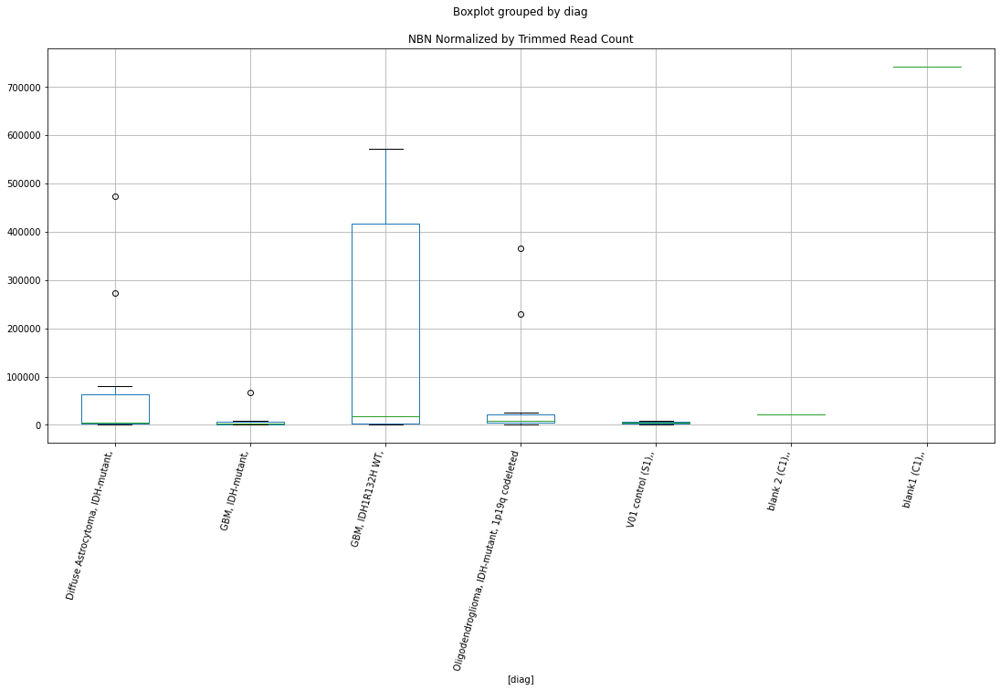

 p : 0.03248345664469874  ( t : 2.3170903725323404 ) :  Lexogen  :  bbduk2  :  MTX3
Control and blanks
79     108725.51
343         0.00
Name: MTX3, dtype: float64
211    9839.03
Name: MTX3, dtype: float64
475    0.0
Name: MTX3, dtype: float64


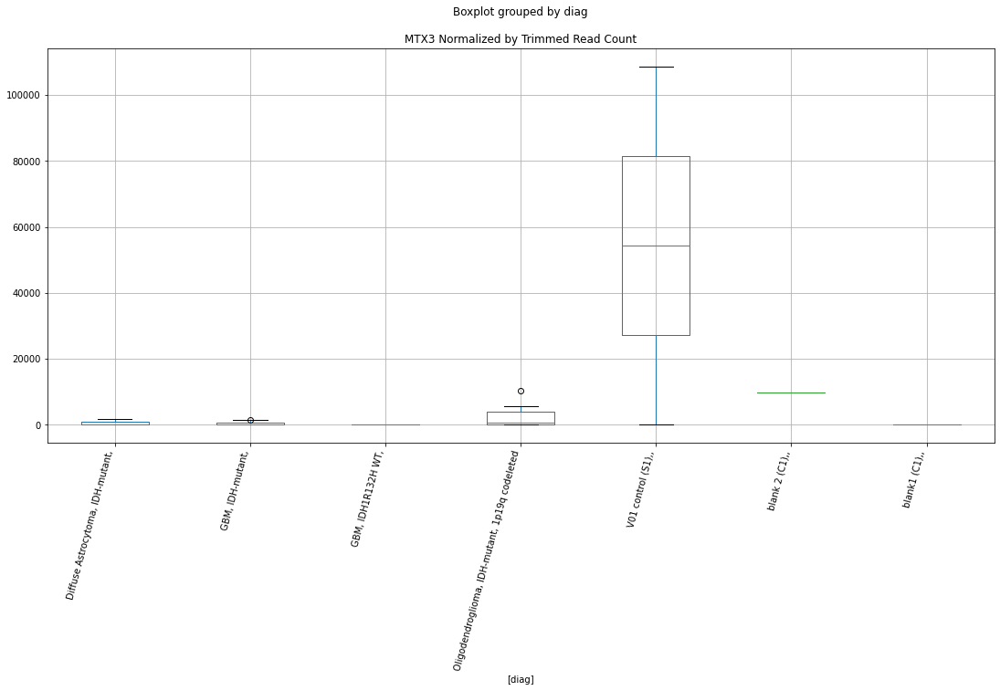

 p : 0.03248856662173619  ( t : 2.3170128456905736 ) :  D-plex  :  bbduk2  :  OR2M3
Control and blanks
73     0.0
337    0.0
Name: OR2M3, dtype: float64
205    716.36
Name: OR2M3, dtype: float64
469    0.0
Name: OR2M3, dtype: float64


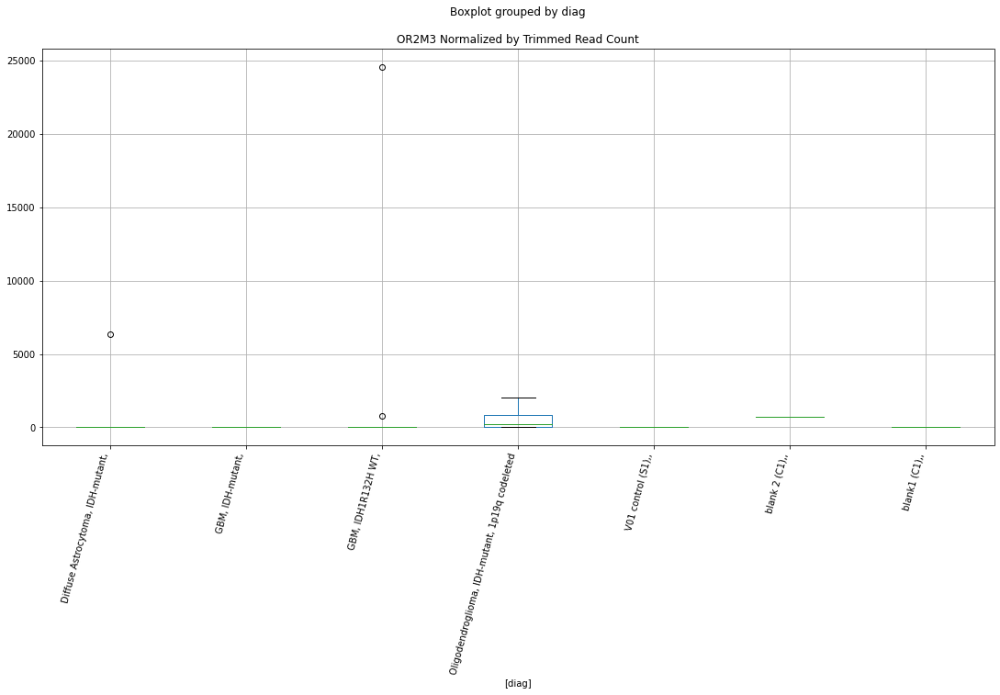

 p : 0.03252402721164601  ( t : 2.3164751613080803 ) :  Lexogen  :  cutadapt2  :  MYO9B
Control and blanks
82     0.0
346    0.0
Name: MYO9B, dtype: float64
214    3254.72
Name: MYO9B, dtype: float64
478    9023.5
Name: MYO9B, dtype: float64


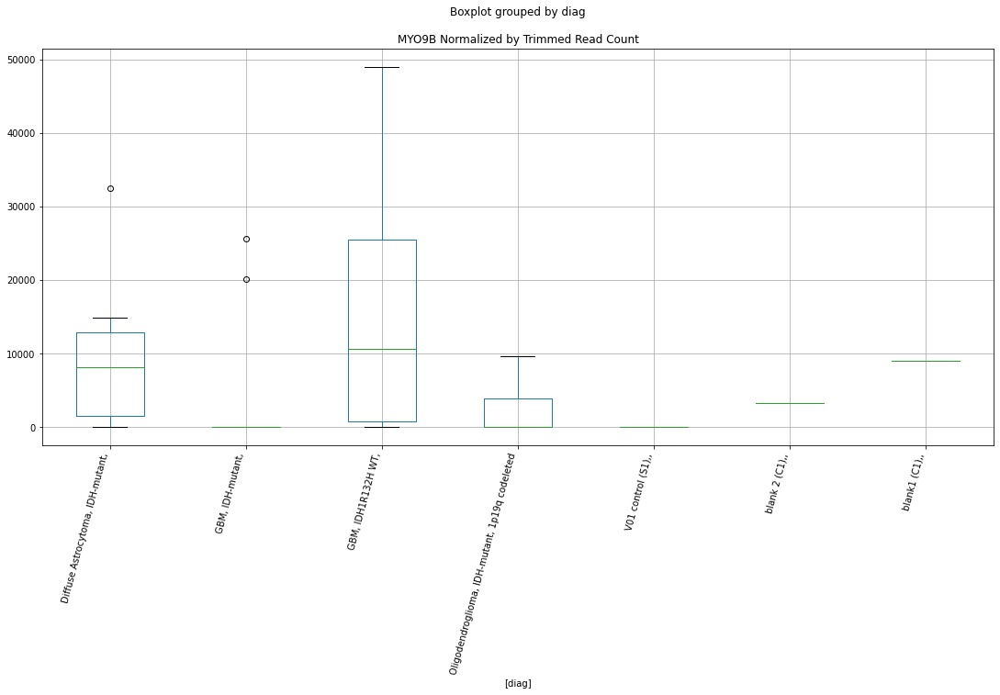

 p : 0.03252849643388931  ( t : 2.3164074336906277 ) :  Lexogen  :  bbduk2  :  MIR16-1
Control and blanks
79          0.00
343    171337.65
Name: MIR16-1, dtype: float64
211    819.92
Name: MIR16-1, dtype: float64
475    479.03
Name: MIR16-1, dtype: float64


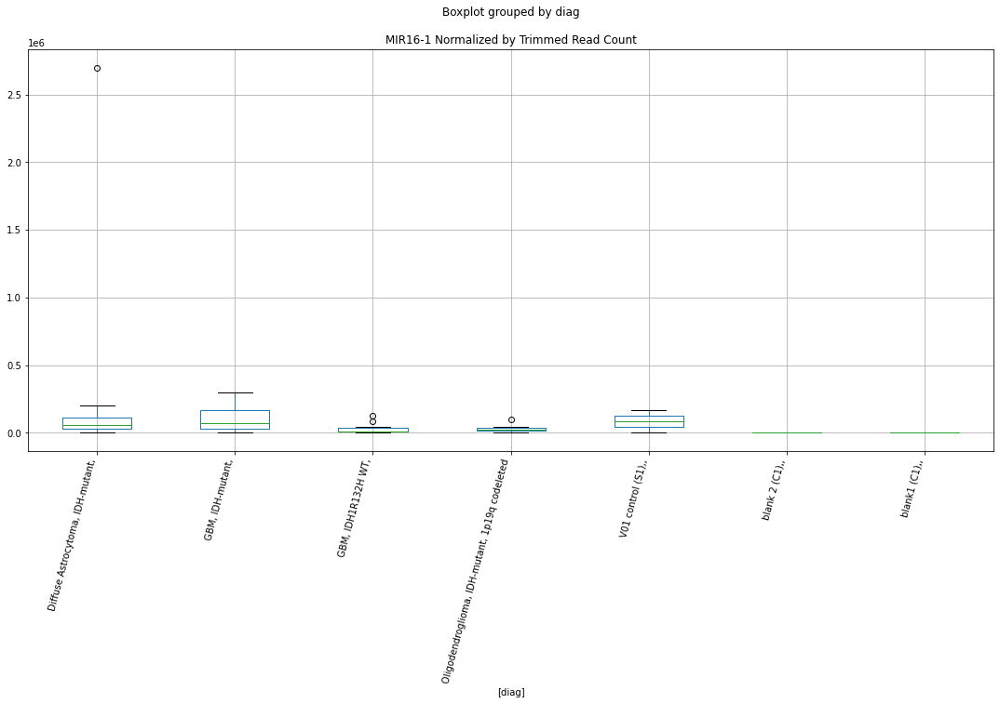

 p : 0.032578479807856935  ( t : 2.3156505622466144 ) :  Lexogen  :  cutadapt2  :  MIR16-1
Control and blanks
82          0.00
346    170451.96
Name: MIR16-1, dtype: float64
214    813.68
Name: MIR16-1, dtype: float64
478    474.92
Name: MIR16-1, dtype: float64


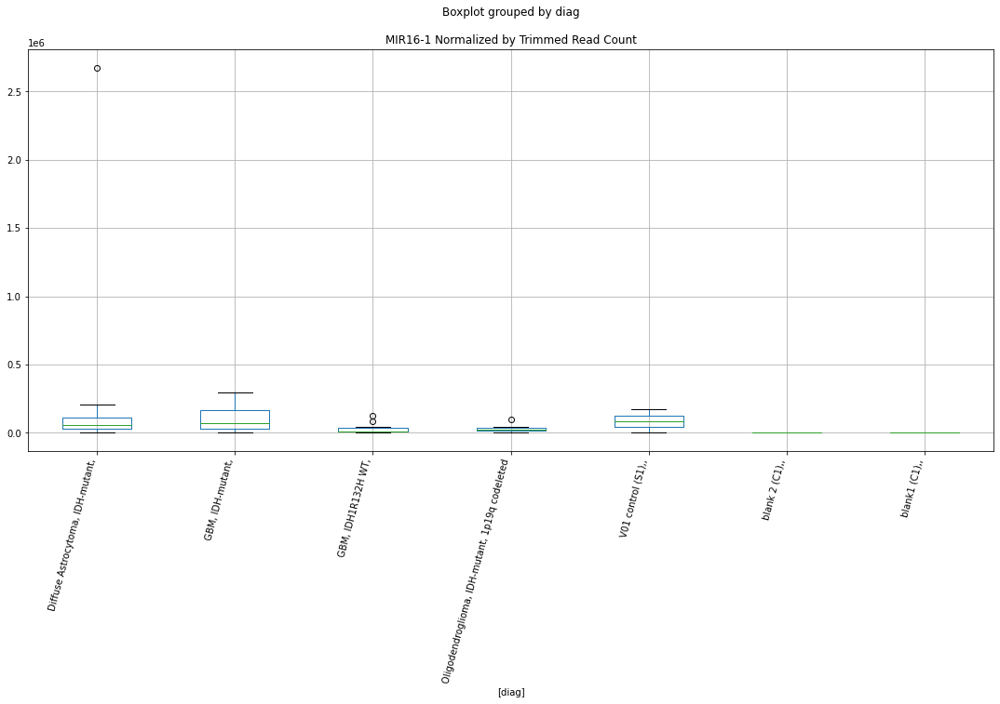

 p : 0.032626671167543315  ( t : 2.314921846411269 ) :  Lexogen  :  bbduk2  :  NFKB2
Control and blanks
79        0.00
343    2335.46
Name: NFKB2, dtype: float64
211    6012.74
Name: NFKB2, dtype: float64
475    2634.67
Name: NFKB2, dtype: float64


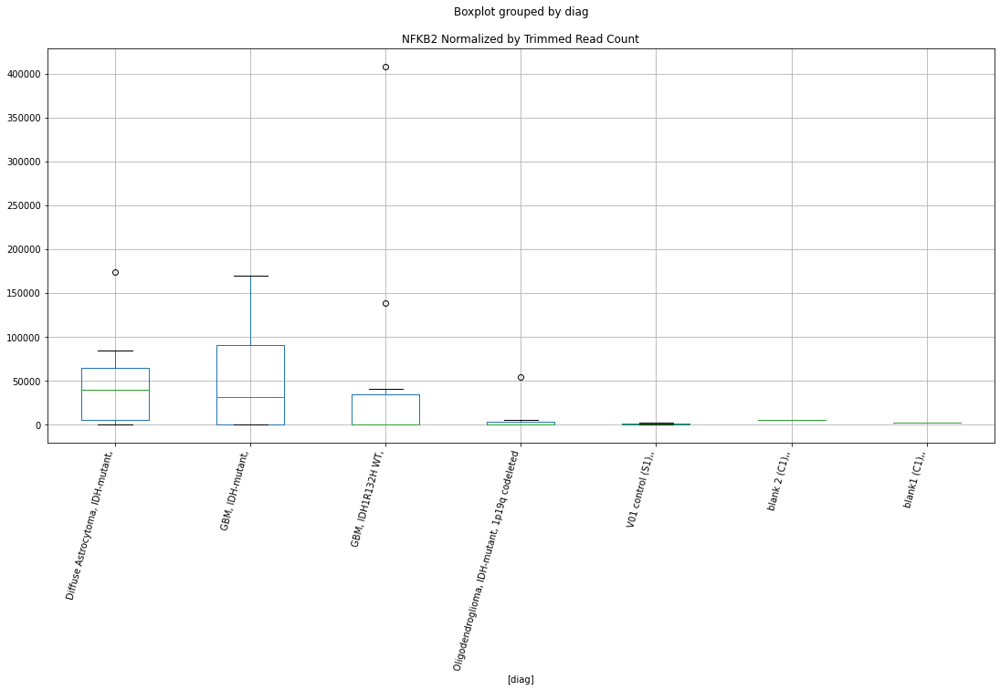

 p : 0.03264847980434006  ( t : 2.3145923999078146 ) :  Lexogen  :  bbduk2  :  NKPD1
Control and blanks
79     0.0
343    0.0
Name: NKPD1, dtype: float64
211    0.0
Name: NKPD1, dtype: float64
475    0.0
Name: NKPD1, dtype: float64


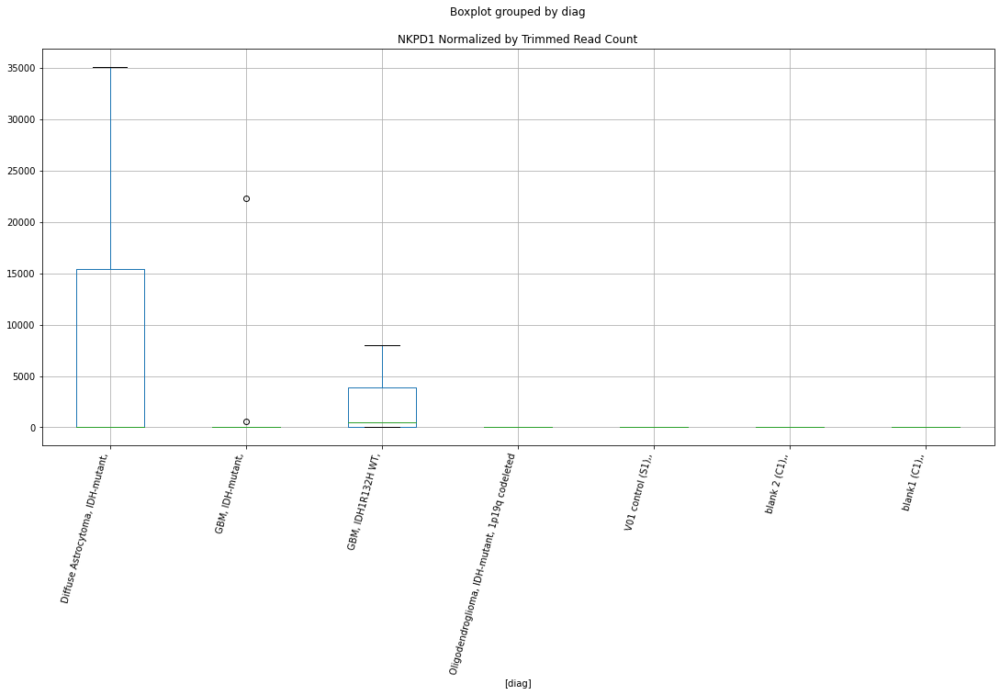

 p : 0.03275701671645507  ( t : 2.312955847294312 ) :  Lexogen  :  bbduk2  :  MGAT1
Control and blanks
79     0.0
343    0.0
Name: MGAT1, dtype: float64
211    0.0
Name: MGAT1, dtype: float64
475    0.0
Name: MGAT1, dtype: float64


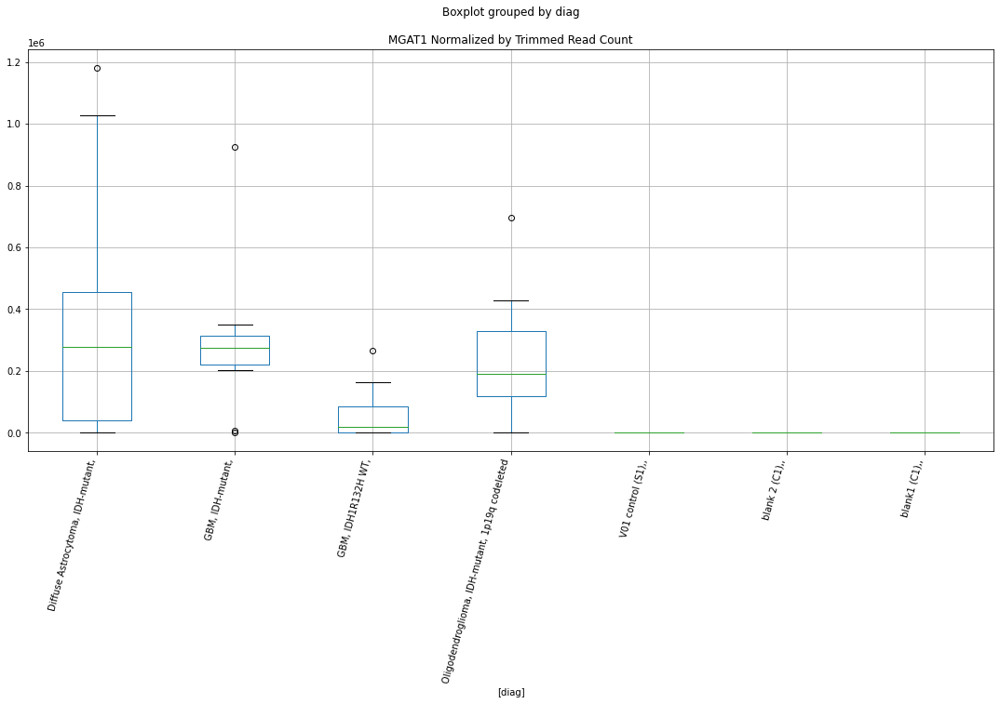

 p : 0.03291481051922394  ( t : 2.3105855392004053 ) :  Lexogen  :  bbduk2  :  ODF3L1
Control and blanks
79        0.00
343    9978.77
Name: ODF3L1, dtype: float64
211    0.0
Name: ODF3L1, dtype: float64
475    0.0
Name: ODF3L1, dtype: float64


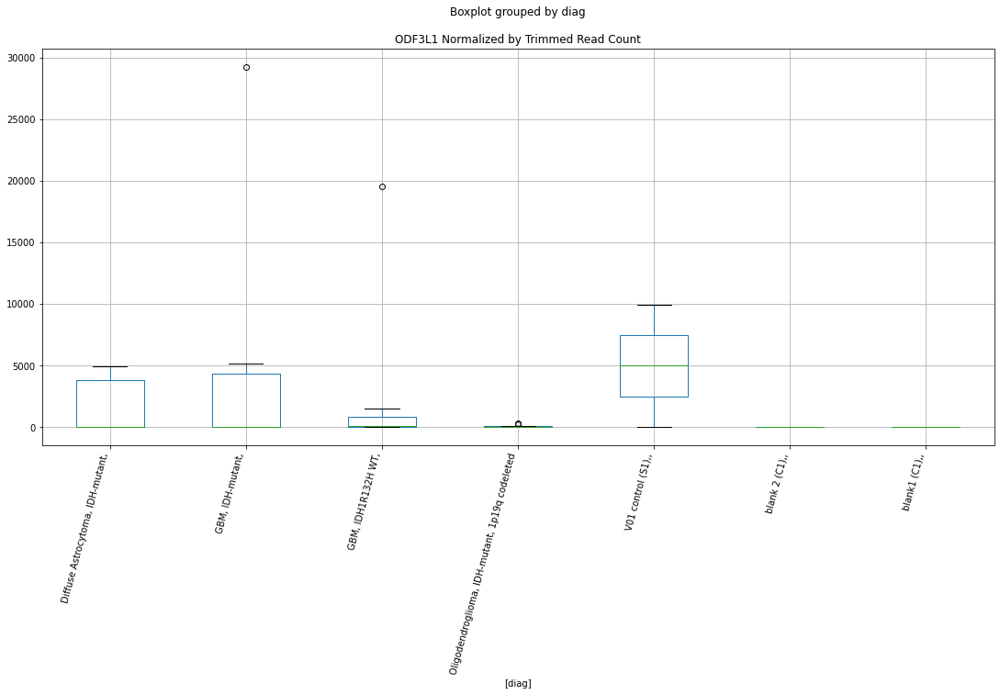

 p : 0.03292461675241505  ( t : 2.3104385826168676 ) :  Lexogen  :  cutadapt2  :  MGAT1
Control and blanks
82     0.0
346    0.0
Name: MGAT1, dtype: float64
214    0.0
Name: MGAT1, dtype: float64
478    0.0
Name: MGAT1, dtype: float64


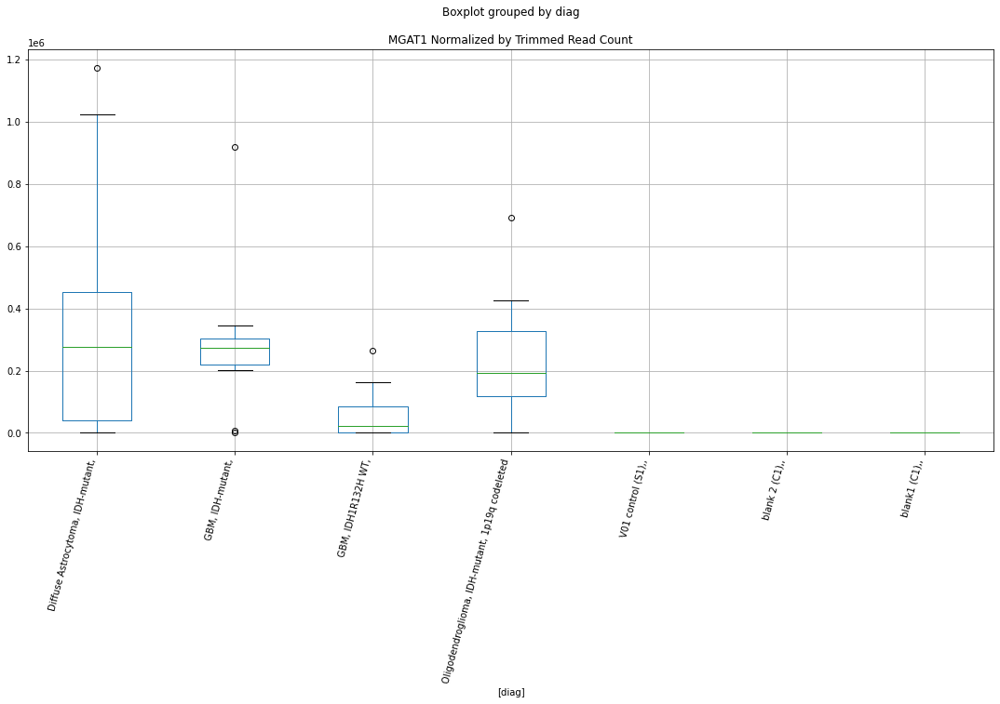

 p : 0.032937533481814385  ( t : 2.3102450739909624 ) :  D-plex  :  bbduk2  :  LOC730668
Control and blanks
73      61067.66
337    128182.65
Name: LOC730668, dtype: float64
205    54264.56
Name: LOC730668, dtype: float64
469    41998.44
Name: LOC730668, dtype: float64


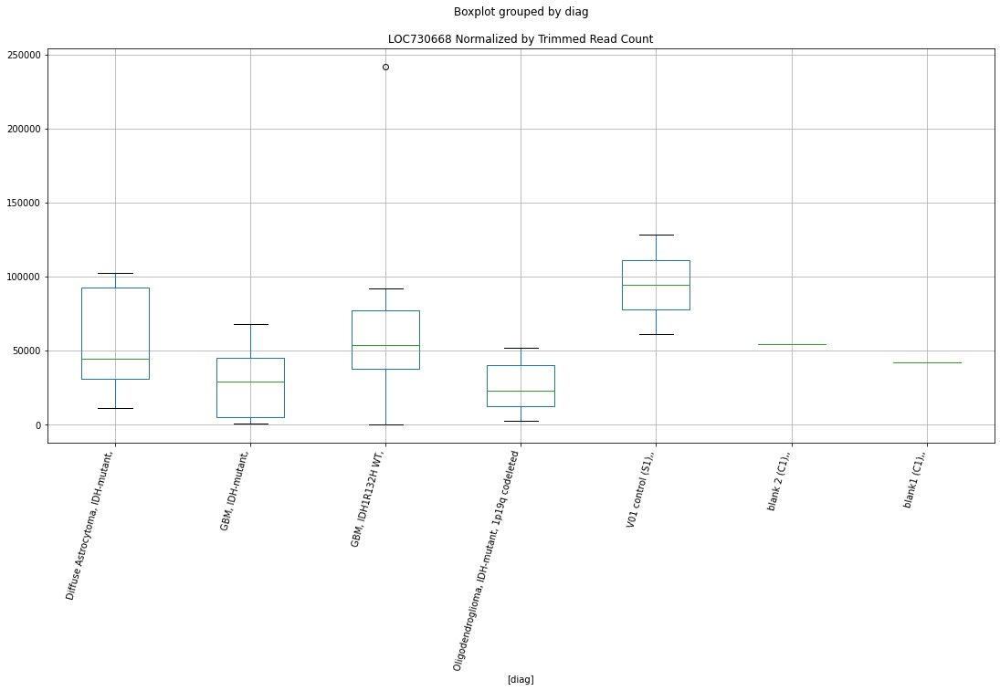

 p : 0.0331382752140569  ( t : 2.307246729677466 ) :  D-plex  :  cutadapt2  :  LRATD1
Control and blanks
76     757.61
340      0.00
Name: LRATD1, dtype: float64
208    2292.68
Name: LRATD1, dtype: float64
472    8669.34
Name: LRATD1, dtype: float64


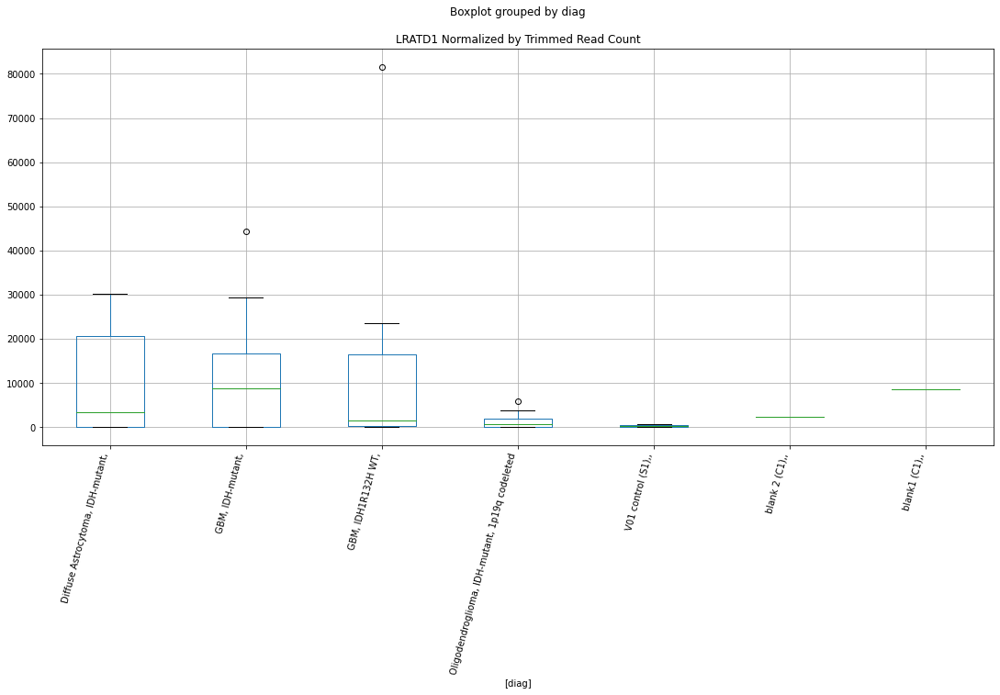

 p : 0.03314358687857386  ( t : 2.307167621983352 ) :  Lexogen  :  cutadapt2  :  NDUFC1
Control and blanks
82          0.00
346    103112.92
Name: NDUFC1, dtype: float64
214    0.0
Name: NDUFC1, dtype: float64
478    1662.22
Name: NDUFC1, dtype: float64


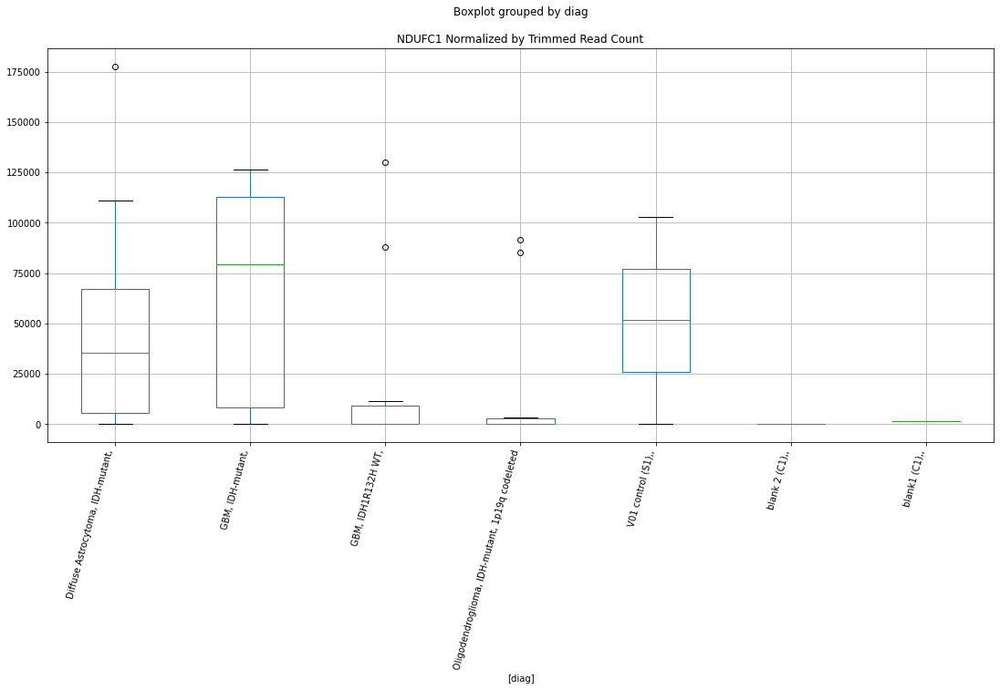

 p : 0.033194603150995684  ( t : 2.306408424686983 ) :  D-plex  :  cutadapt2  :  NTN3
Control and blanks
76     0.0
340    0.0
Name: NTN3, dtype: float64
208    881.8
Name: NTN3, dtype: float64
472    577.96
Name: NTN3, dtype: float64


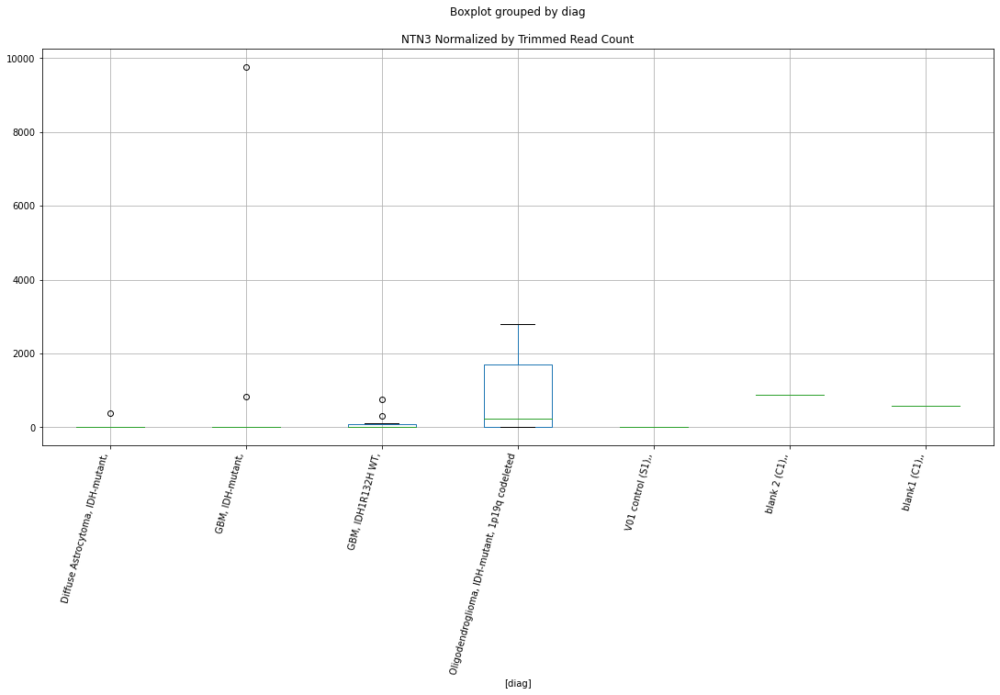

 p : 0.03329403868997536  ( t : 2.304931782902972 ) :  D-plex  :  cutadapt2  :  MRPL23
Control and blanks
76     0.0
340    0.0
Name: MRPL23, dtype: float64
208    352.72
Name: MRPL23, dtype: float64
472    0.0
Name: MRPL23, dtype: float64


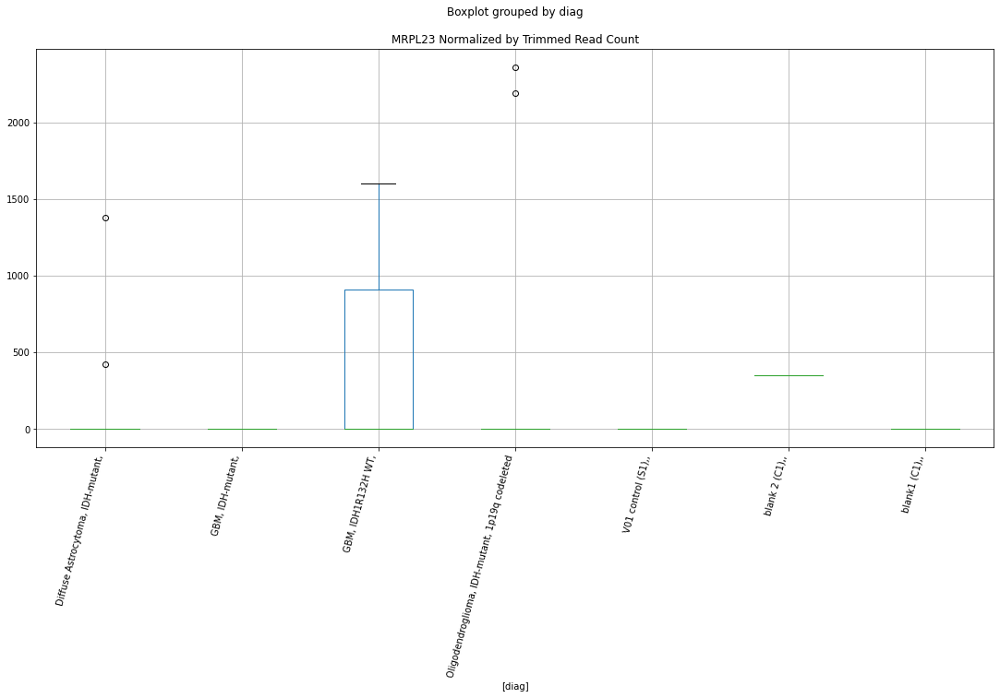

 p : 0.03345628962379141  ( t : 2.302531076937748 ) :  D-plex  :  cutadapt2  :  LOC730668
Control and blanks
76      60609.14
340    128586.89
Name: LOC730668, dtype: float64
208    53437.15
Name: LOC730668, dtype: float64
472    41034.86
Name: LOC730668, dtype: float64


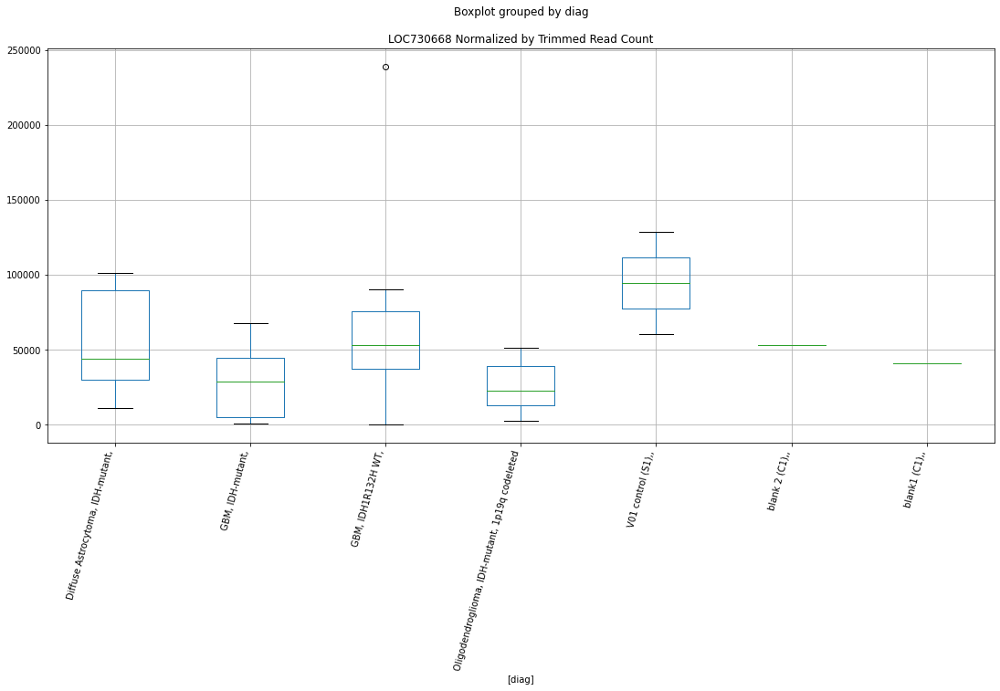

 p : 0.03352144733959517  ( t : 2.301570024187108 ) :  D-plex  :  cutadapt2  :  NEURL1B
Control and blanks
76     1515.23
340       0.00
Name: NEURL1B, dtype: float64
208    1939.96
Name: NEURL1B, dtype: float64
472    4623.65
Name: NEURL1B, dtype: float64


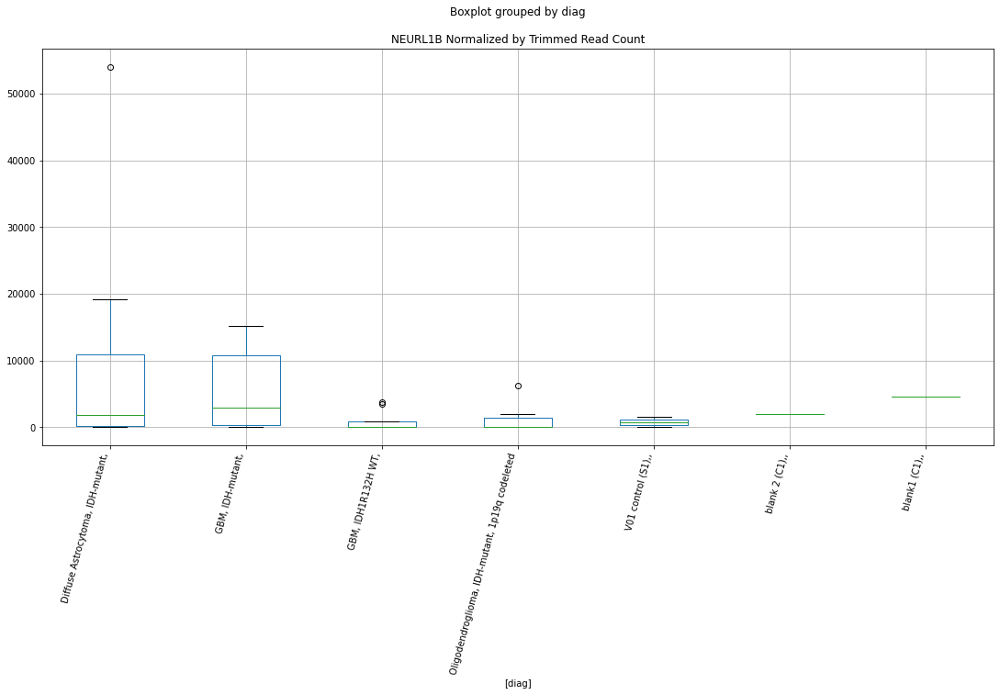

 p : 0.03369546422422925  ( t : 2.2990118026450106 ) :  D-plex  :  bbduk2  :  MPEG1
Control and blanks
73         0.00
337    37386.61
Name: MPEG1, dtype: float64
205    4119.09
Name: MPEG1, dtype: float64
469    5323.75
Name: MPEG1, dtype: float64


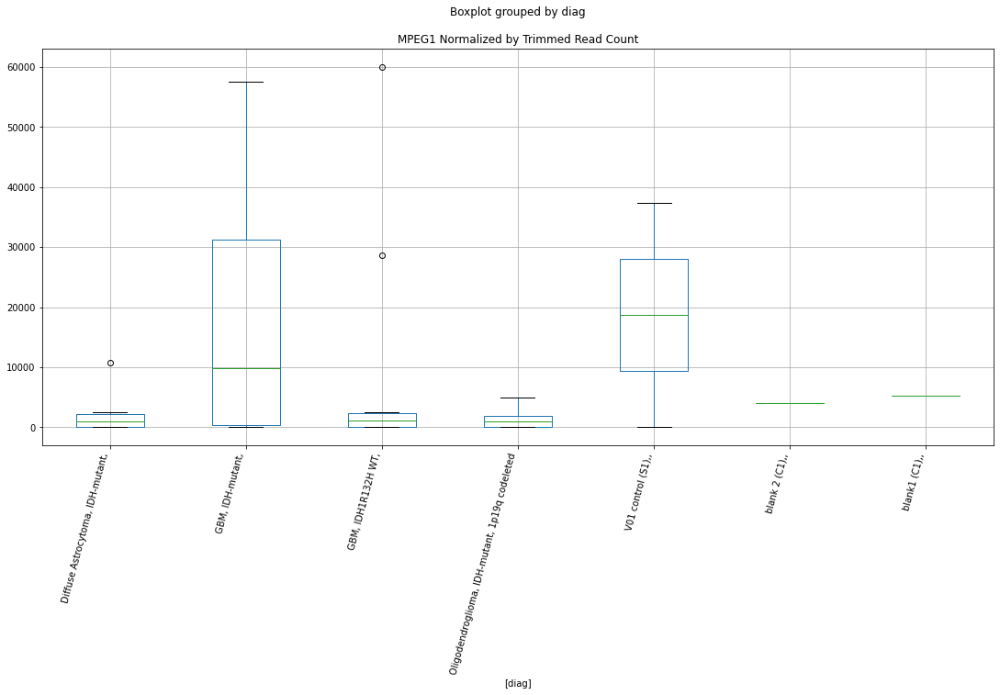

 p : 0.033709370124723394  ( t : 2.2988079009001576 ) :  Lexogen  :  cutadapt2  :  NFKB2
Control and blanks
82        0.00
346    2314.78
Name: NFKB2, dtype: float64
214    5966.98
Name: NFKB2, dtype: float64
478    2612.07
Name: NFKB2, dtype: float64


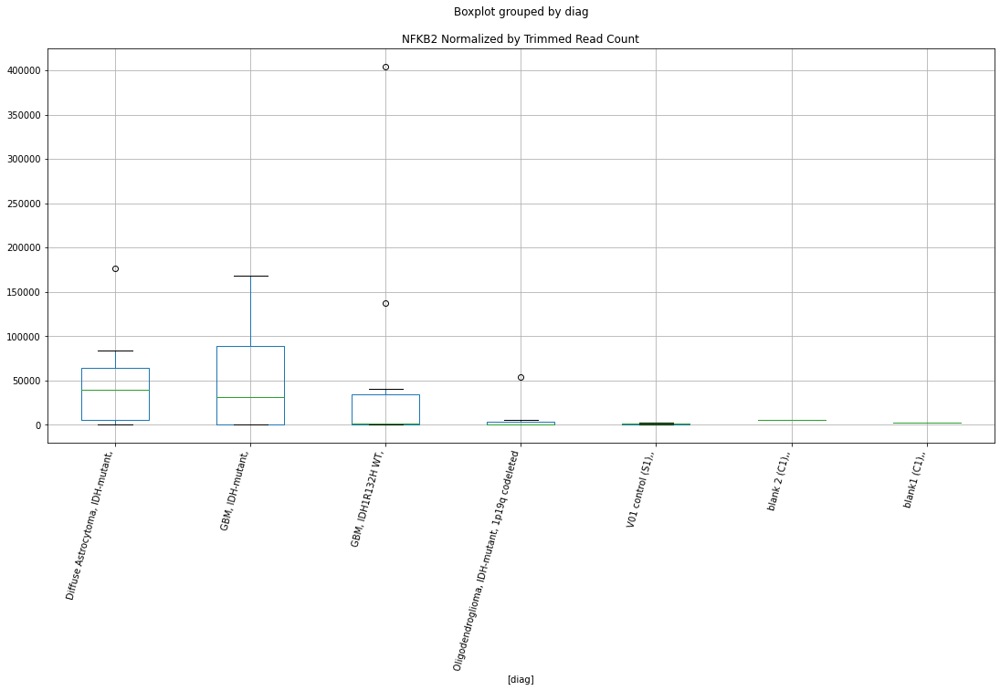

 p : 0.033829337891640214  ( t : 2.297052048347987 ) :  D-plex  :  cutadapt2  :  NUP85
Control and blanks
76     721248.73
340    850787.24
Name: NUP85, dtype: float64
208    328735.45
Name: NUP85, dtype: float64
472    485482.91
Name: NUP85, dtype: float64


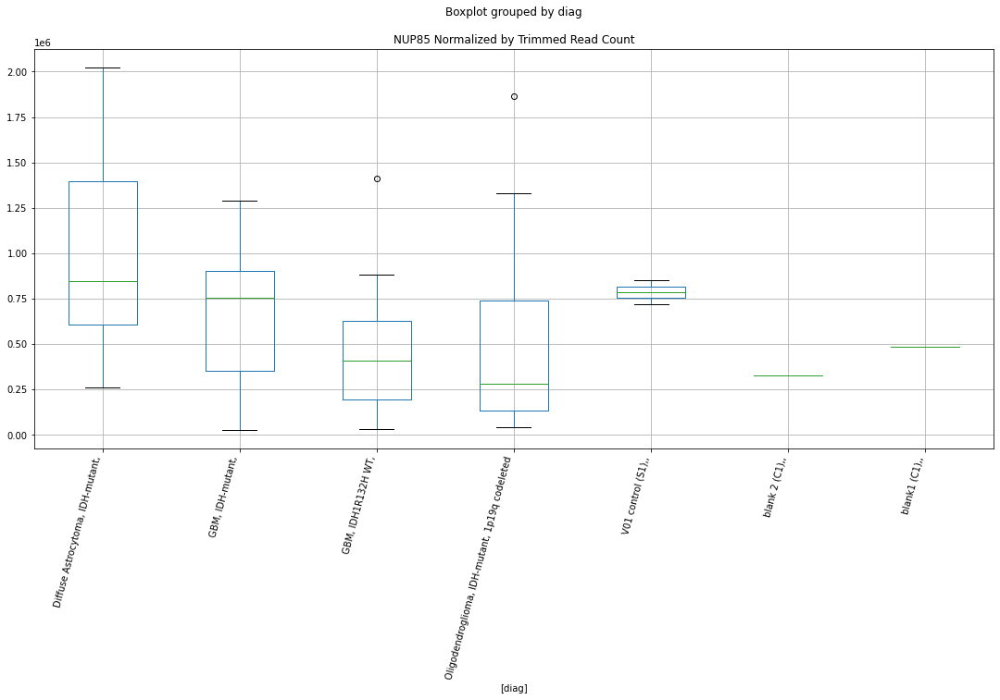

 p : 0.03388626290459721  ( t : 2.296220909906471 ) :  D-plex  :  cutadapt2  :  MPEG1
Control and blanks
76         0.00
340    36990.75
Name: MPEG1, dtype: float64
208    4056.29
Name: MPEG1, dtype: float64
472    4623.65
Name: MPEG1, dtype: float64


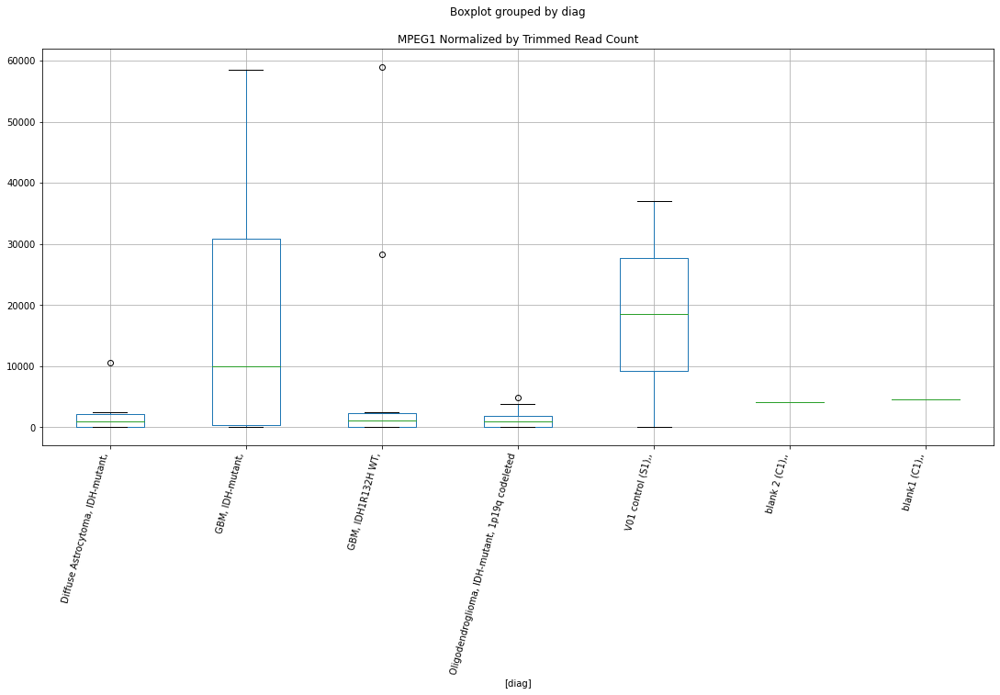

 p : 0.03397058039972277  ( t : 2.294992199925665 ) :  D-plex  :  bbduk2  :  NUMA1
Control and blanks
73     30920.34
337    81894.47
Name: NUMA1, dtype: float64
205    151331.85
Name: NUMA1, dtype: float64
469    191063.32
Name: NUMA1, dtype: float64


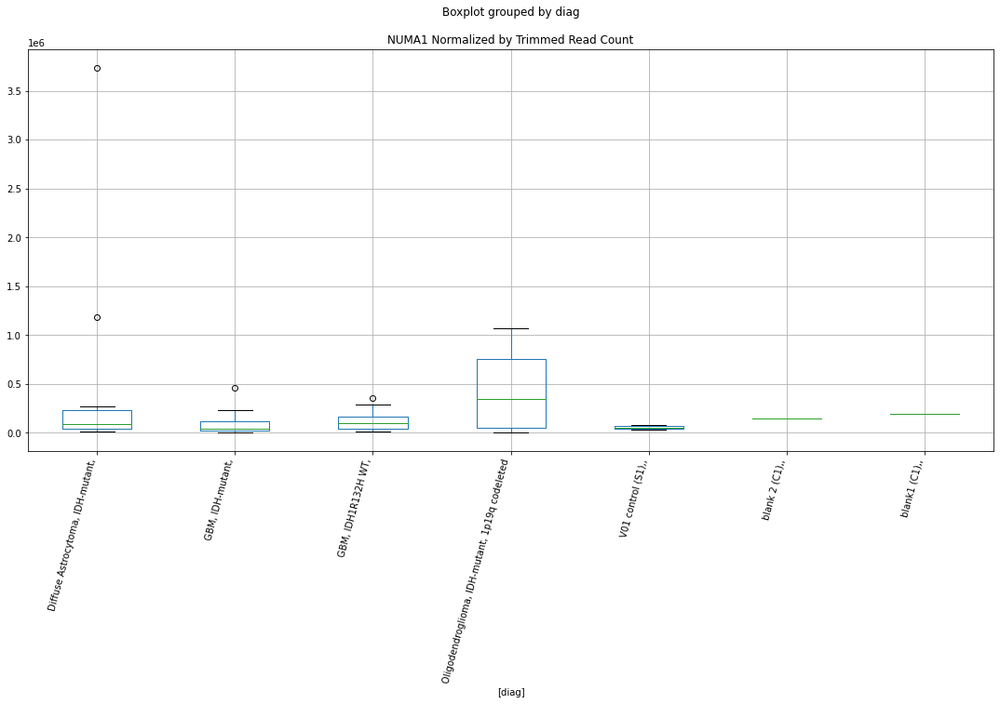

 p : 0.034073782490617786  ( t : 2.2934921363401184 ) :  D-plex  :  cutadapt2  :  NOX1
Control and blanks
76     0.0
340    0.0
Name: NOX1, dtype: float64
208    705.44
Name: NOX1, dtype: float64
472    0.0
Name: NOX1, dtype: float64


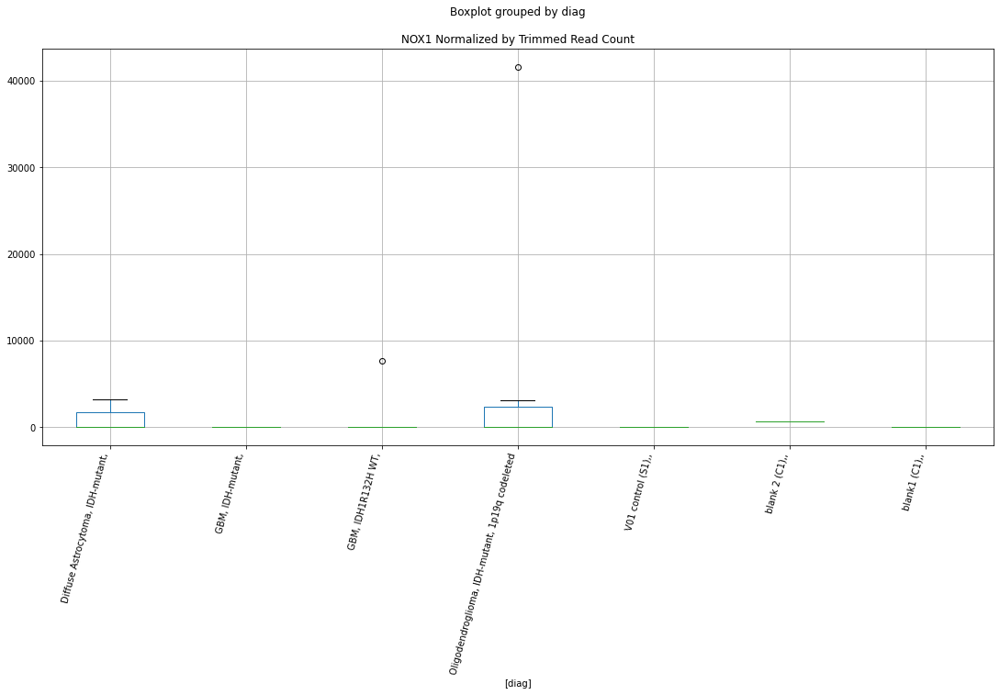

 p : 0.03411168029522515  ( t : 2.2929423405899625 ) :  D-plex  :  bbduk2  :  MCM10
Control and blanks
73     2319.03
337       0.00
Name: MCM10, dtype: float64
205    1074.55
Name: MCM10, dtype: float64
469    0.0
Name: MCM10, dtype: float64


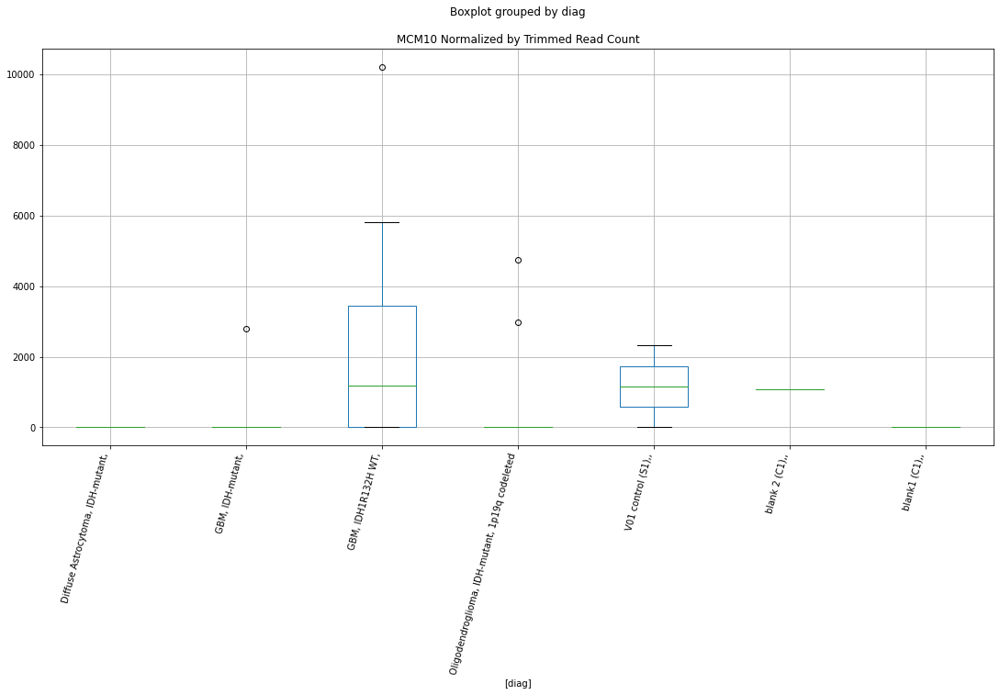

 p : 0.03411533309160126  ( t : 2.2928893781942463 ) :  Lexogen  :  bbduk2  :  NDUFC1
Control and blanks
79          0.00
343    104034.01
Name: NDUFC1, dtype: float64
211    0.0
Name: NDUFC1, dtype: float64
475    1676.61
Name: NDUFC1, dtype: float64


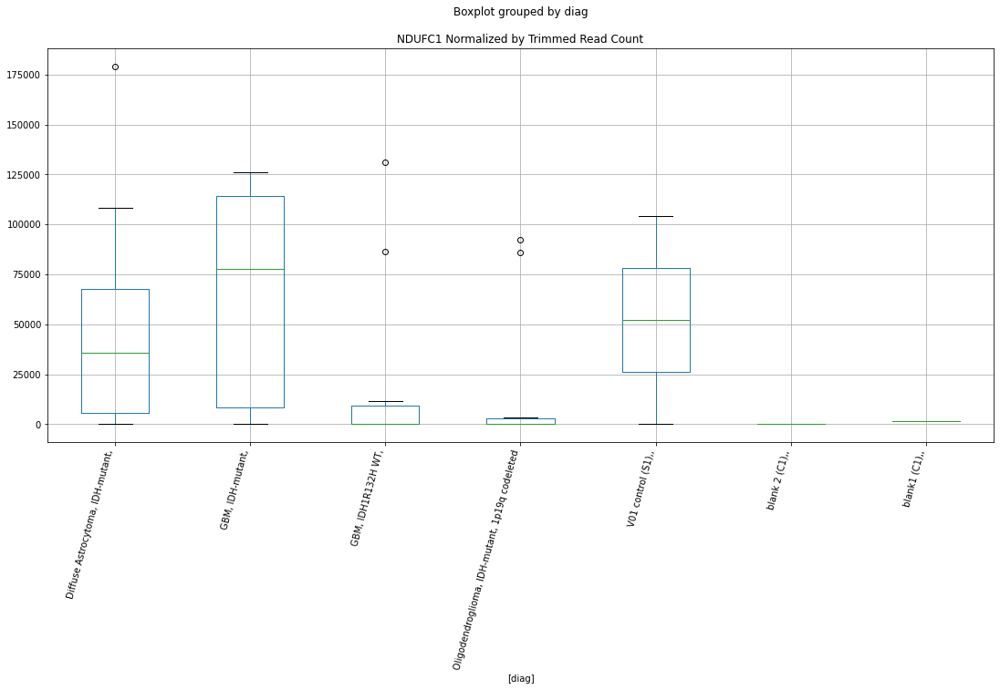

 p : 0.03415985061902426  ( t : 2.2922443343064502 ) :  Lexogen  :  bbduk2  :  LOC107986476
Control and blanks
79        0.00
343    2123.14
Name: LOC107986476, dtype: float64
211    0.0
Name: LOC107986476, dtype: float64
475    0.0
Name: LOC107986476, dtype: float64


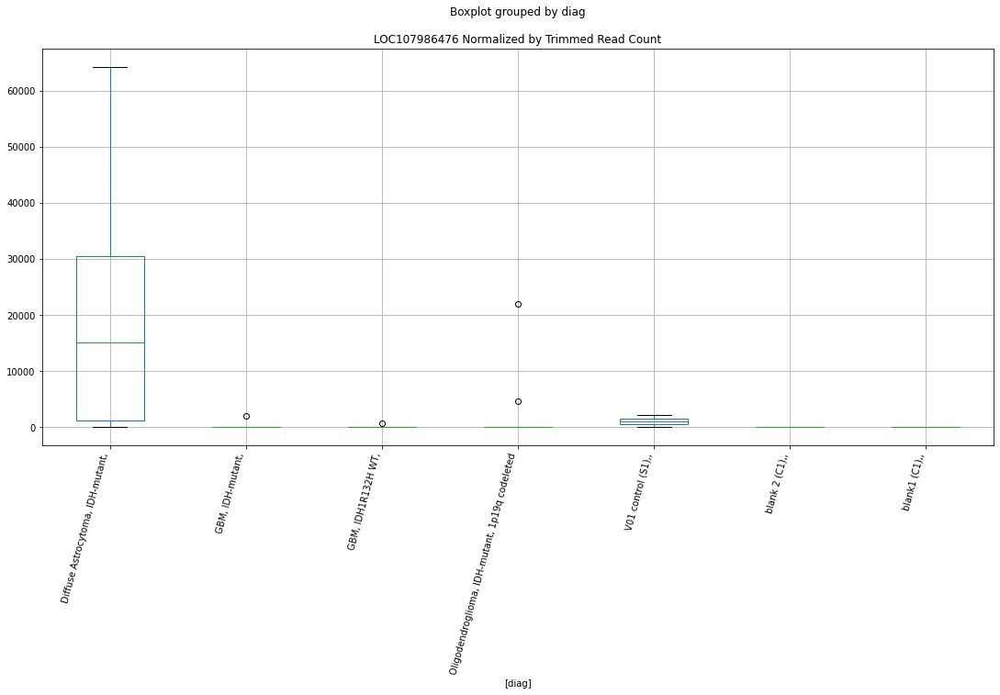

 p : 0.034308664929292  ( t : 2.290093703707435 ) :  D-plex  :  cutadapt2  :  LOC112268317
Control and blanks
76     0.0
340    0.0
Name: LOC112268317, dtype: float64
208    4232.65
Name: LOC112268317, dtype: float64
472    6935.47
Name: LOC112268317, dtype: float64


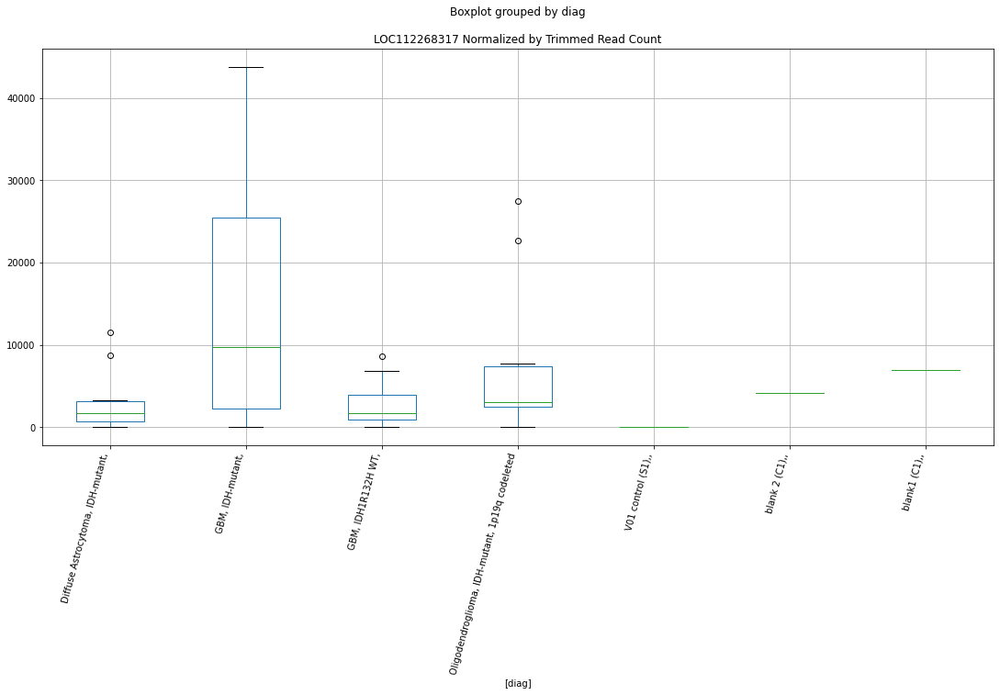

 p : 0.03431789020446861  ( t : 2.2899606667422847 ) :  Lexogen  :  cutadapt2  :  OPA3
Control and blanks
82     0.0
346    0.0
Name: OPA3, dtype: float64
214    0.0
Name: OPA3, dtype: float64
478    0.0
Name: OPA3, dtype: float64


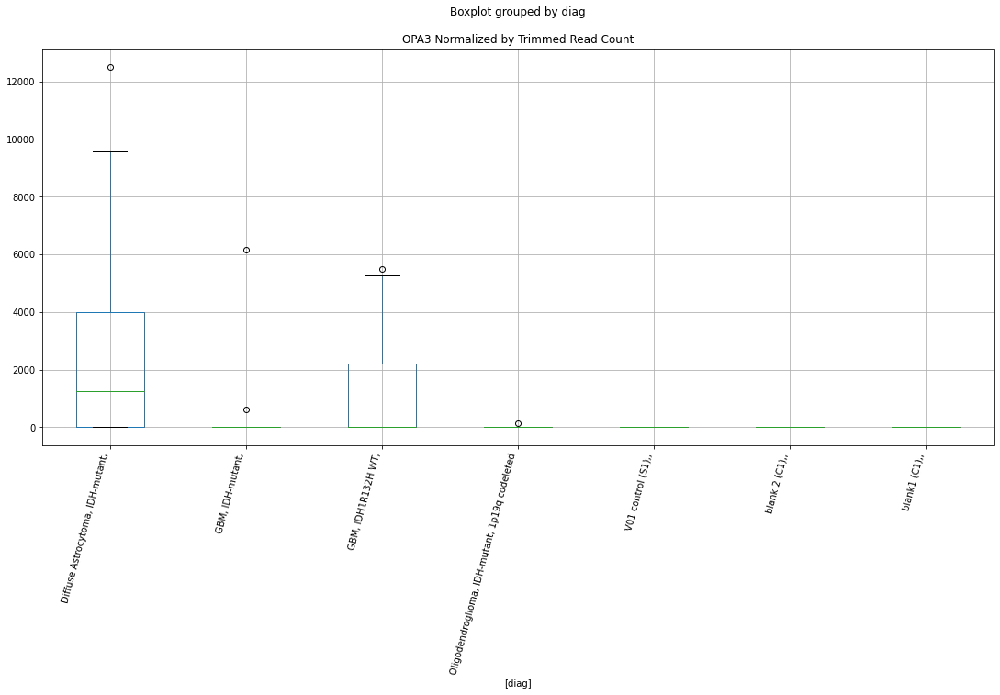

 p : 0.03432021941950106  ( t : 2.2899270825538185 ) :  D-plex  :  bbduk2  :  MAP1S
Control and blanks
73     3092.03
337       0.00
Name: MAP1S, dtype: float64
205    6805.46
Name: MAP1S, dtype: float64
469    1183.05
Name: MAP1S, dtype: float64


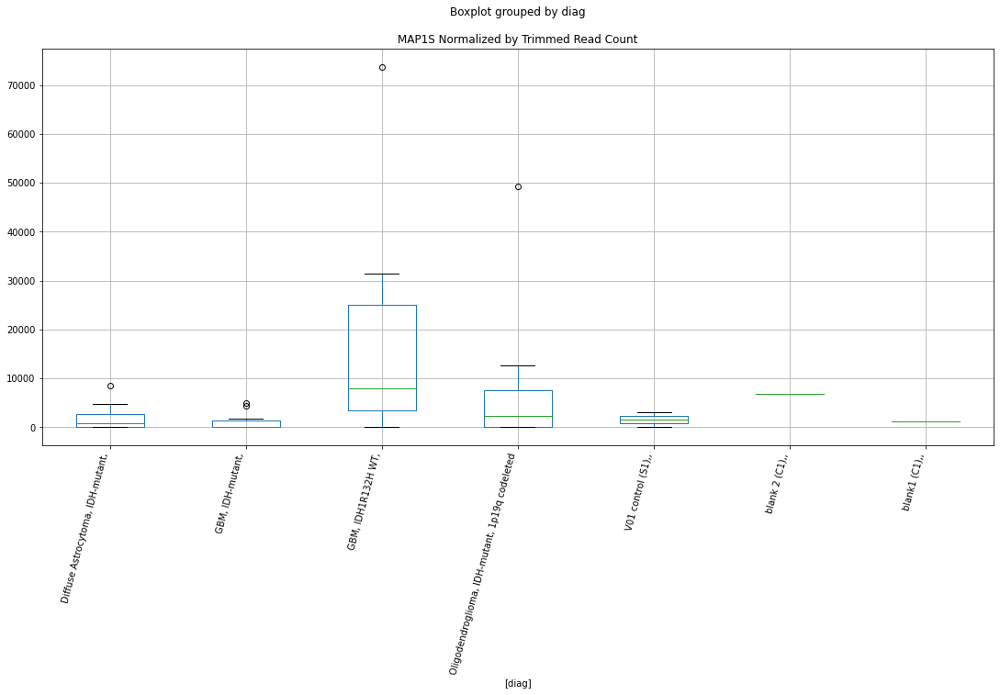

 p : 0.03439043869091382  ( t : 2.288915603764626 ) :  D-plex  :  bbduk2  :  LRRC70
Control and blanks
73     0.0
337    0.0
Name: LRRC70, dtype: float64
205    9133.64
Name: LRRC70, dtype: float64
469    591.53
Name: LRRC70, dtype: float64


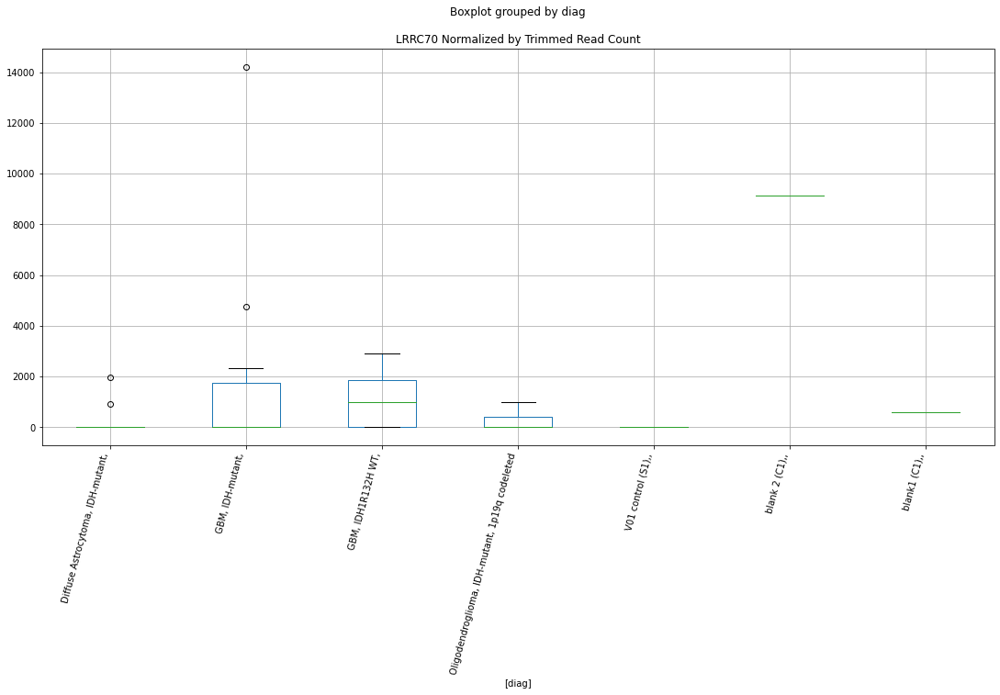

 p : 0.03447444589725974  ( t : 2.2877080256317597 ) :  D-plex  :  bbduk2  :  MRPL48
Control and blanks
73     1546.02
337    1780.31
Name: MRPL48, dtype: float64
205    5910.0
Name: MRPL48, dtype: float64
469    1774.58
Name: MRPL48, dtype: float64


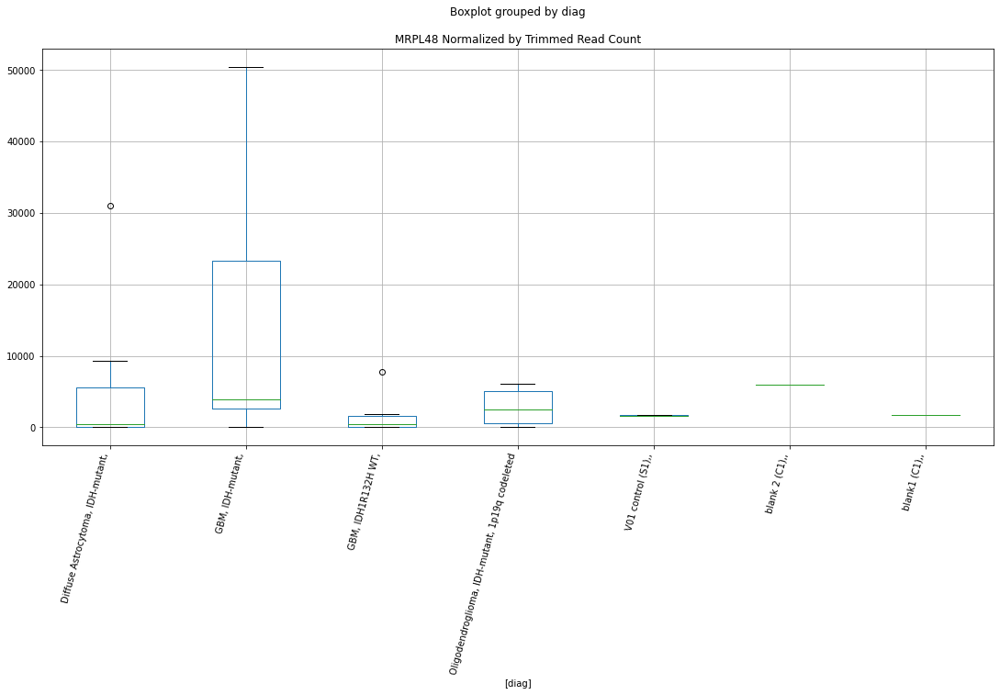

 p : 0.03448254645543823  ( t : 2.287591726662828 ) :  D-plex  :  cutadapt2  :  NR2E3
Control and blanks
76     0.0
340    0.0
Name: NR2E3, dtype: float64
208    1410.88
Name: NR2E3, dtype: float64
472    577.96
Name: NR2E3, dtype: float64


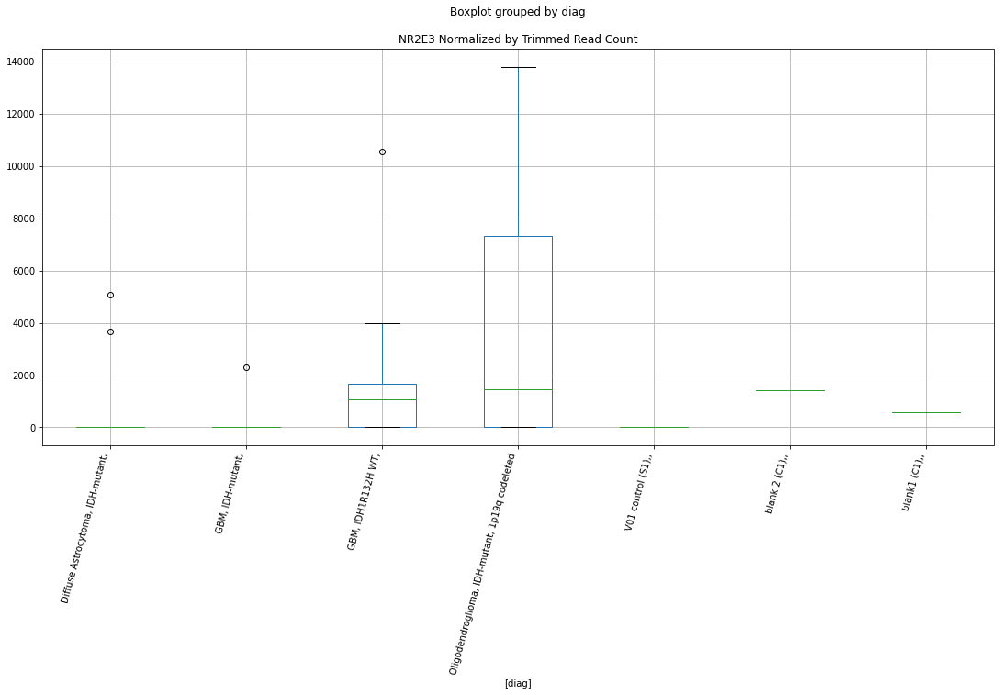

 p : 0.03452982660942688  ( t : 2.2869134341942154 ) :  Lexogen  :  cutadapt2  :  LRRC70
Control and blanks
82     0.0
346    0.0
Name: LRRC70, dtype: float64
214    2441.04
Name: LRRC70, dtype: float64
478    0.0
Name: LRRC70, dtype: float64


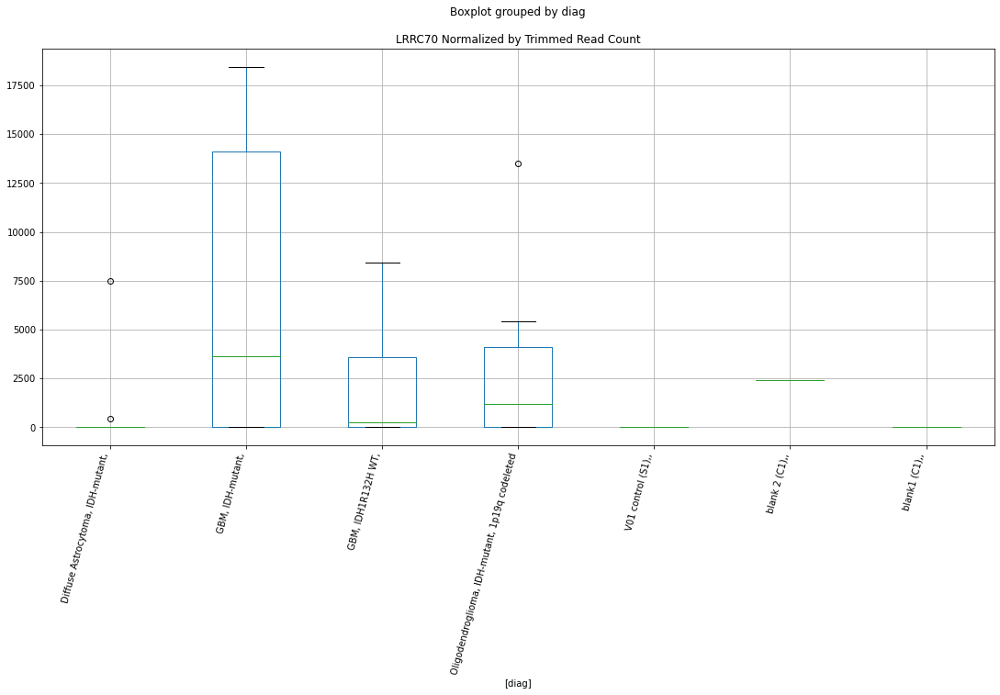

 p : 0.03453482471802444  ( t : 2.286841780397337 ) :  D-plex  :  cutadapt2  :  LOC646588
Control and blanks
76     0.0
340    0.0
Name: LOC646588, dtype: float64
208    1234.52
Name: LOC646588, dtype: float64
472    0.0
Name: LOC646588, dtype: float64


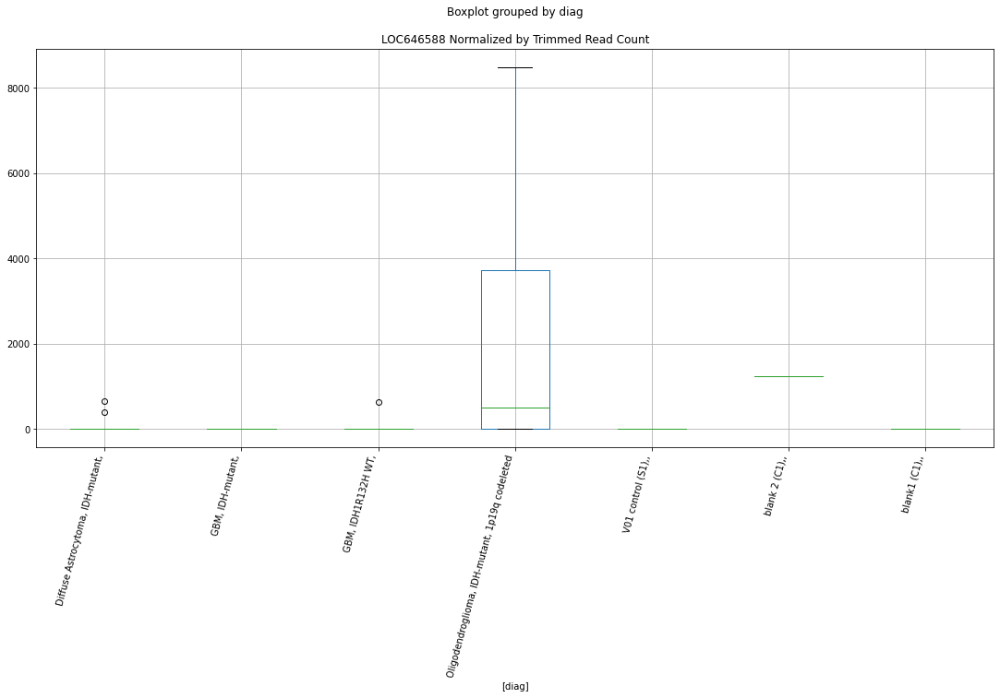

 p : 0.034555841075878765  ( t : 2.2865405910989463 ) :  D-plex  :  bbduk2  :  NR2E3
Control and blanks
73     0.0
337    0.0
Name: NR2E3, dtype: float64
205    1432.73
Name: NR2E3, dtype: float64
469    591.53
Name: NR2E3, dtype: float64


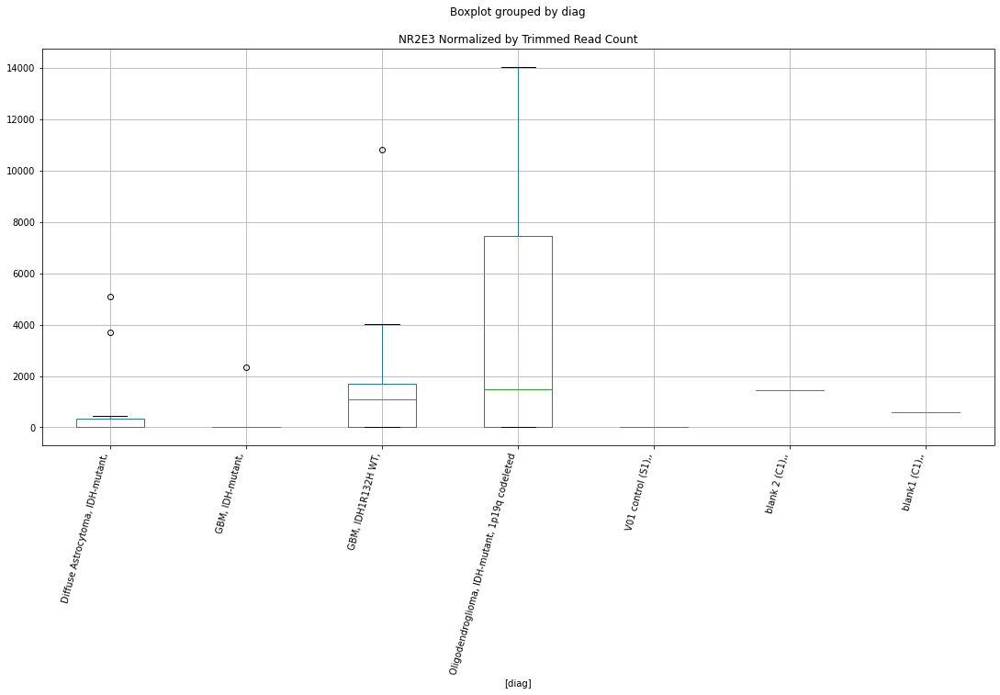

 p : 0.03457957002840472  ( t : 2.286200730908562 ) :  D-plex  :  bbduk2  :  LOC107986399
Control and blanks
73     0.0
337    0.0
Name: LOC107986399, dtype: float64
205    358.18
Name: LOC107986399, dtype: float64
469    0.0
Name: LOC107986399, dtype: float64


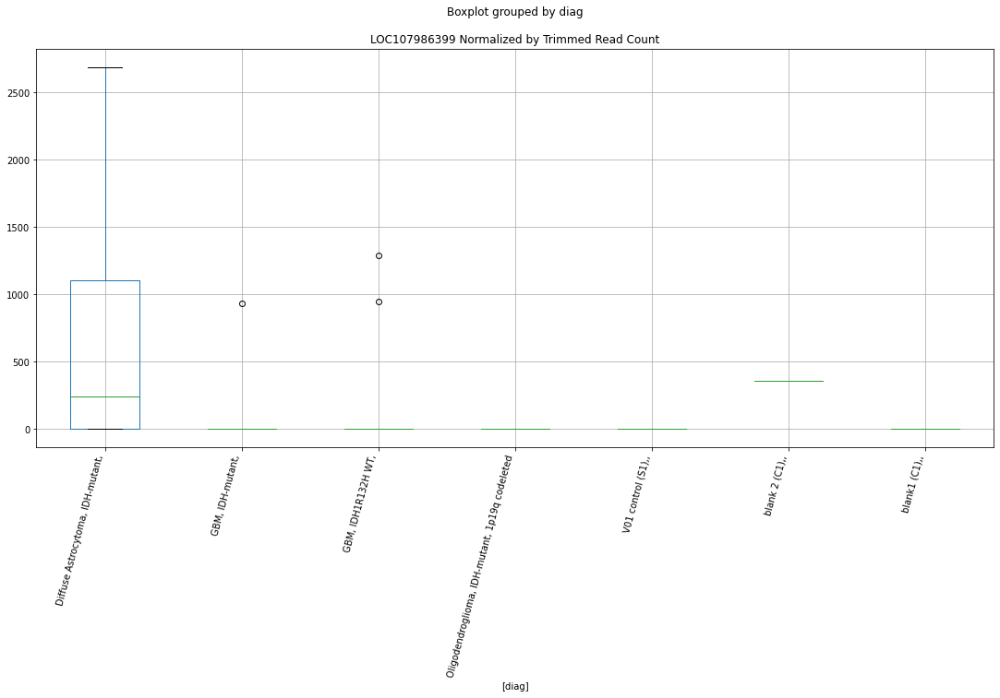

 p : 0.034590336033276006  ( t : 2.2860466049838526 ) :  D-plex  :  bbduk2  :  MROH2B
Control and blanks
73     0.0
337    0.0
Name: MROH2B, dtype: float64
205    1611.82
Name: MROH2B, dtype: float64
469    0.0
Name: MROH2B, dtype: float64


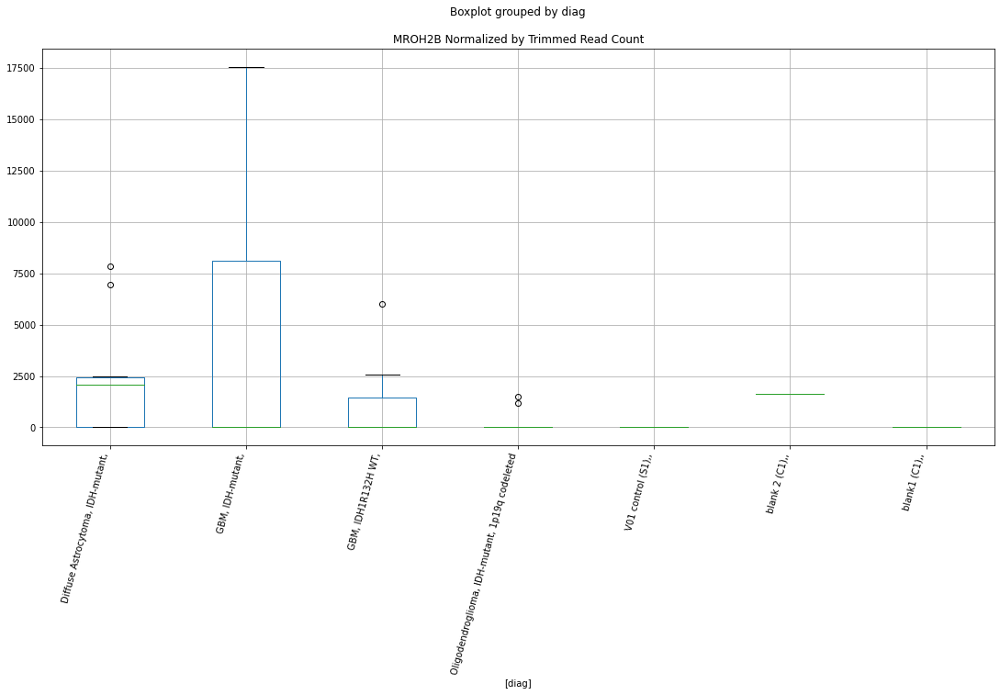

 p : 0.03464890605734163  ( t : 2.285208894918127 ) :  D-plex  :  cutadapt2  :  NUB1
Control and blanks
76     0.0
340    0.0
Name: NUB1, dtype: float64
208    705.44
Name: NUB1, dtype: float64
472    0.0
Name: NUB1, dtype: float64


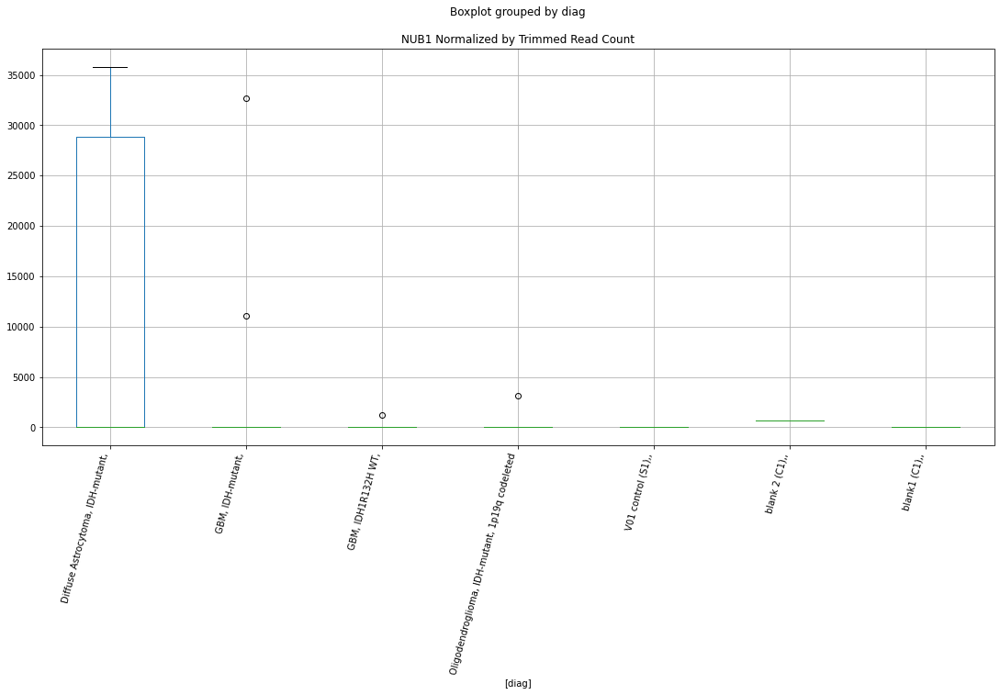

 p : 0.03470154894571959  ( t : 2.284457076969073 ) :  Lexogen  :  cutadapt2  :  MAP6
Control and blanks
82       0.00
346    210.43
Name: MAP6, dtype: float64
214    0.0
Name: MAP6, dtype: float64
478    237.46
Name: MAP6, dtype: float64


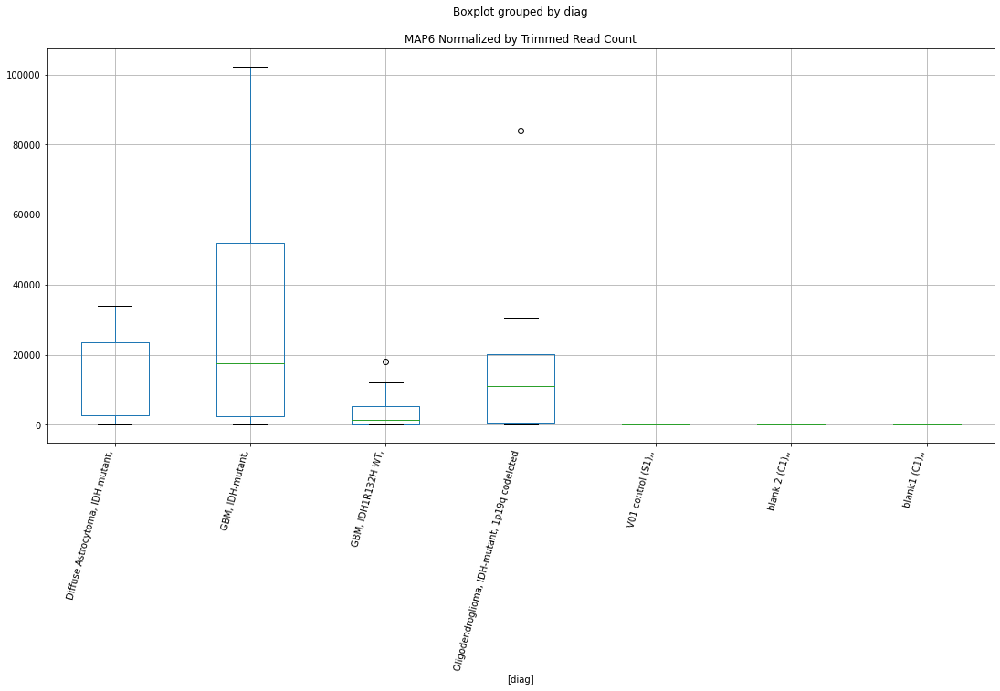

 p : 0.03482948249201986  ( t : 2.2826343892692584 ) :  Lexogen  :  bbduk2  :  MMP24
Control and blanks
79        0.00
343    1698.51
Name: MMP24, dtype: float64
211    0.0
Name: MMP24, dtype: float64
475    0.0
Name: MMP24, dtype: float64


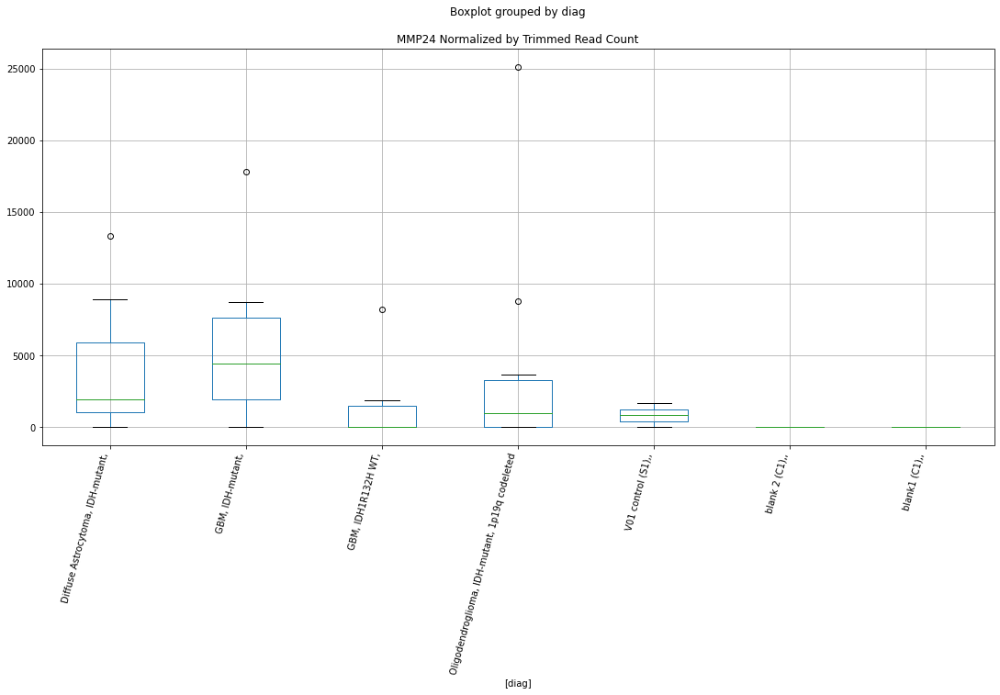

 p : 0.034846667473739545  ( t : 2.2823900246721927 ) :  D-plex  :  cutadapt2  :  LOC107986397
Control and blanks
76     757.61
340    880.73
Name: LOC107986397, dtype: float64
208    1587.24
Name: LOC107986397, dtype: float64
472    1155.91
Name: LOC107986397, dtype: float64


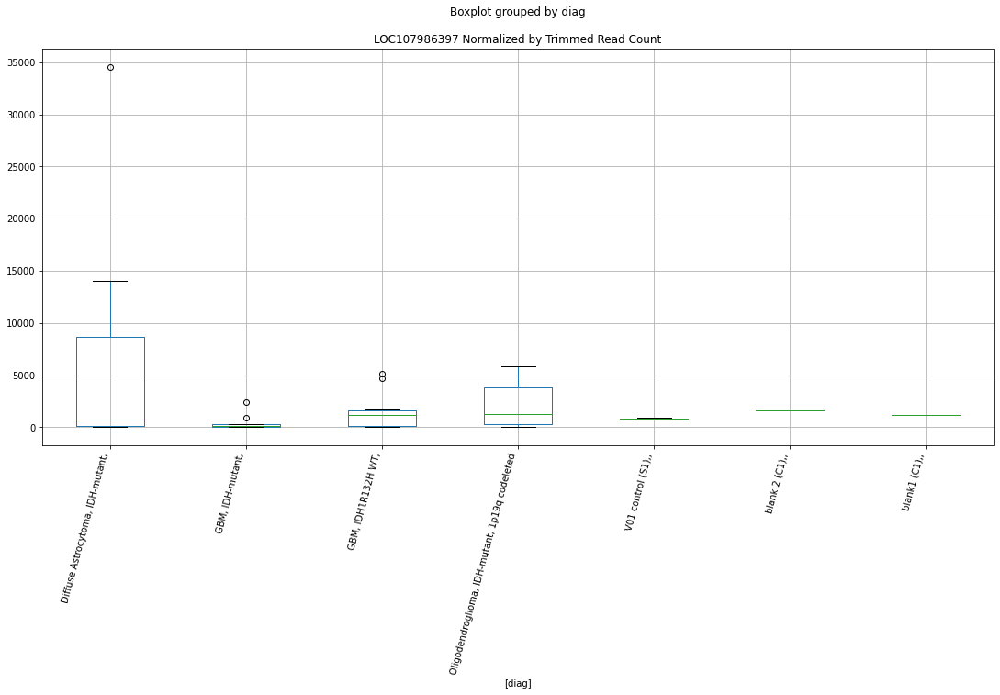

 p : 0.034950162466116624  ( t : 2.280920715470232 ) :  Lexogen  :  bbduk2  :  MAP6
Control and blanks
79       0.00
343    212.31
Name: MAP6, dtype: float64
211    0.0
Name: MAP6, dtype: float64
475    479.03
Name: MAP6, dtype: float64


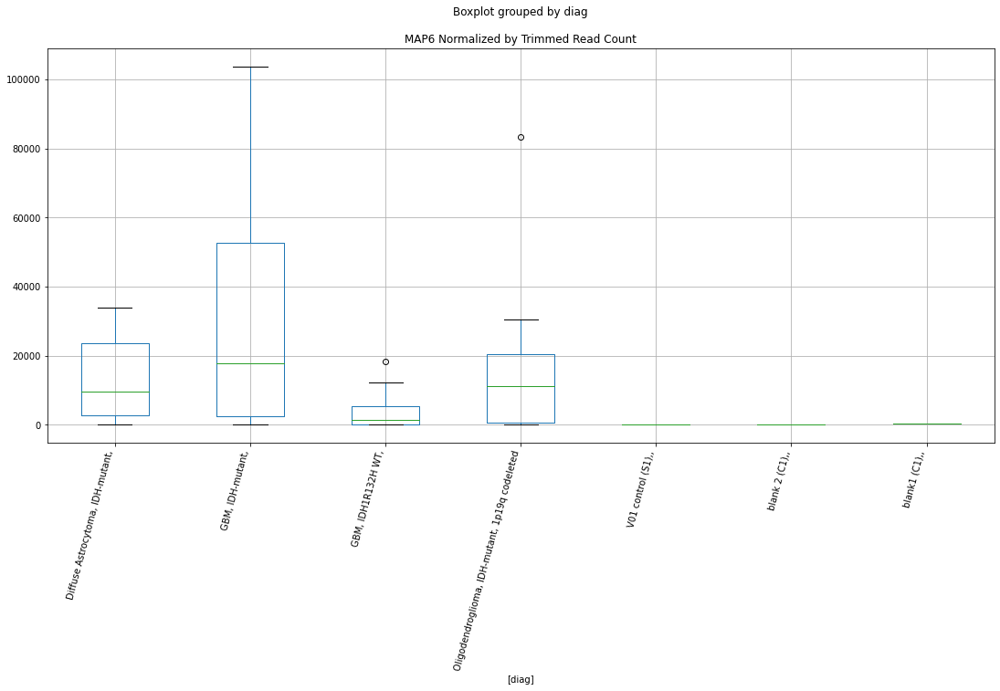

 p : 0.03501442299441187  ( t : 2.2800104395157974 ) :  D-plex  :  cutadapt2  :  MAPK7
Control and blanks
76     0.0
340    0.0
Name: MAPK7, dtype: float64
208    10581.61
Name: MAPK7, dtype: float64
472    0.0
Name: MAPK7, dtype: float64


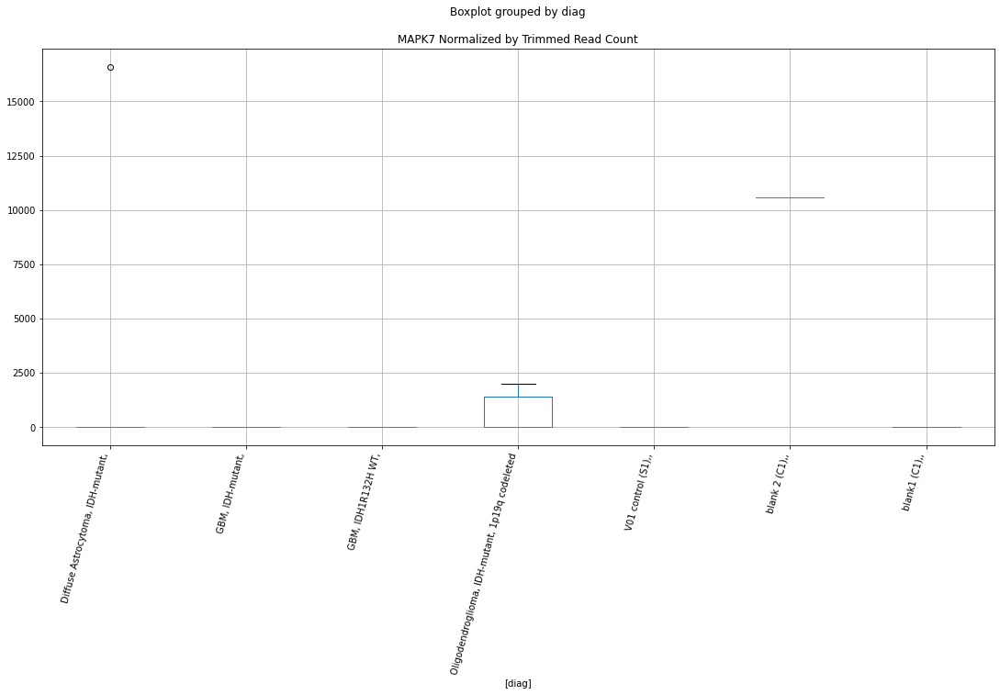

 p : 0.03515782961060708  ( t : 2.277984589529486 ) :  Lexogen  :  bbduk2  :  NRXN1
Control and blanks
79        0.0
343    5944.8
Name: NRXN1, dtype: float64
211    4919.51
Name: NRXN1, dtype: float64
475    4311.28
Name: NRXN1, dtype: float64


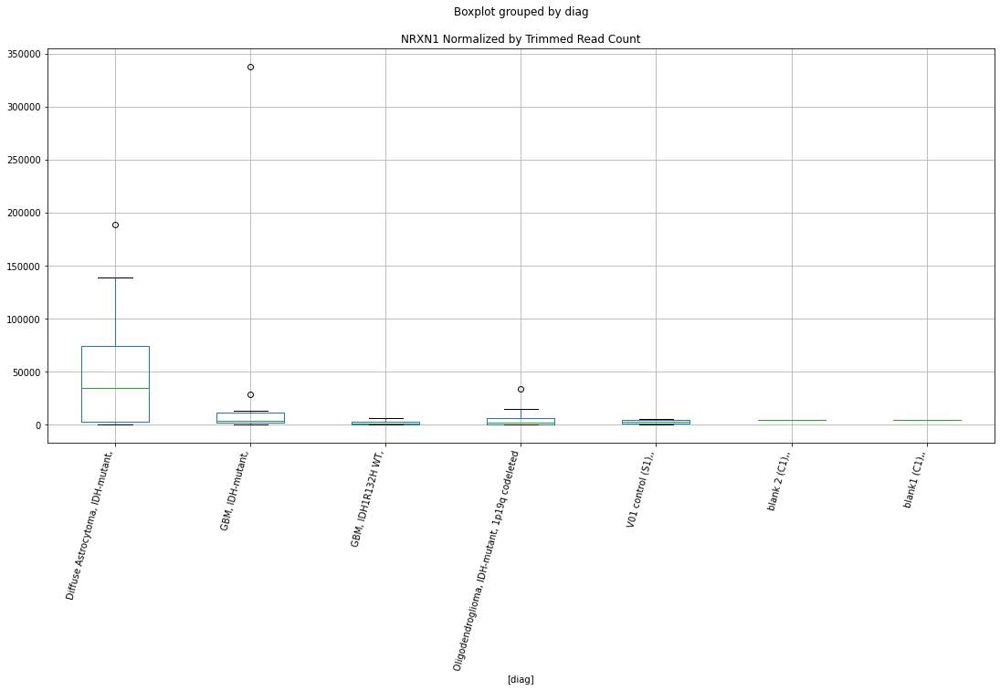

 p : 0.03521056007565603  ( t : 2.2772416087024245 ) :  D-plex  :  cutadapt2  :  NUMA1
Control and blanks
76     30304.57
340    81027.36
Name: NUMA1, dtype: float64
208    149024.38
Name: NUMA1, dtype: float64
472    186679.74
Name: NUMA1, dtype: float64


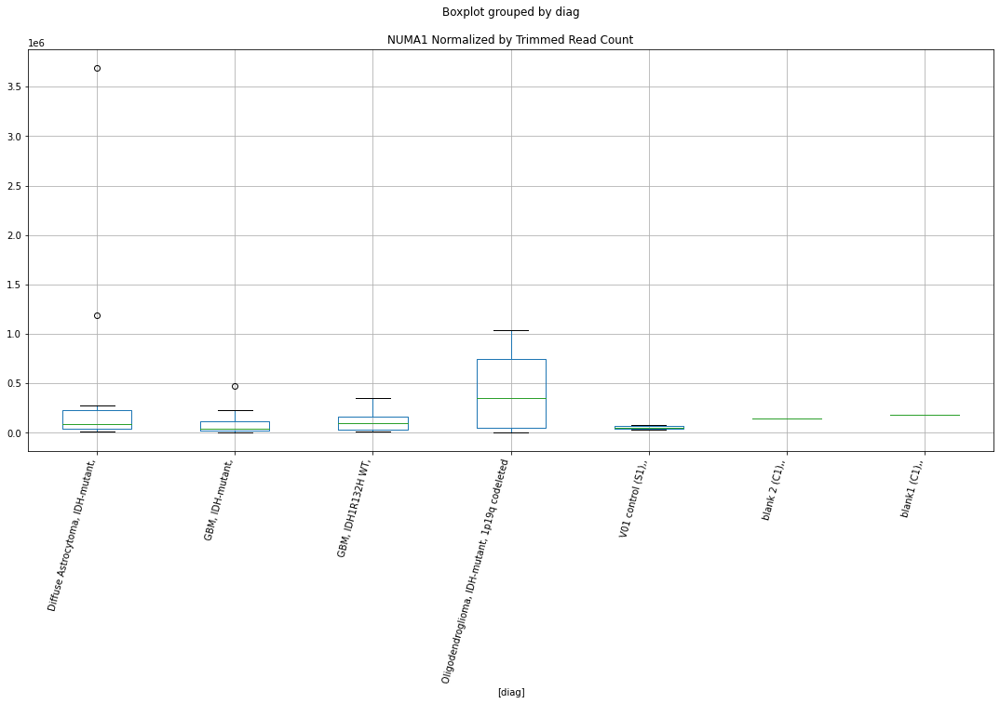

 p : 0.035498686084629784  ( t : 2.273199954553127 ) :  D-plex  :  bbduk2  :  NLRC5
Control and blanks
73     17779.19
337        0.00
Name: NLRC5, dtype: float64
205    34206.37
Name: NLRC5, dtype: float64
469    13013.6
Name: NLRC5, dtype: float64


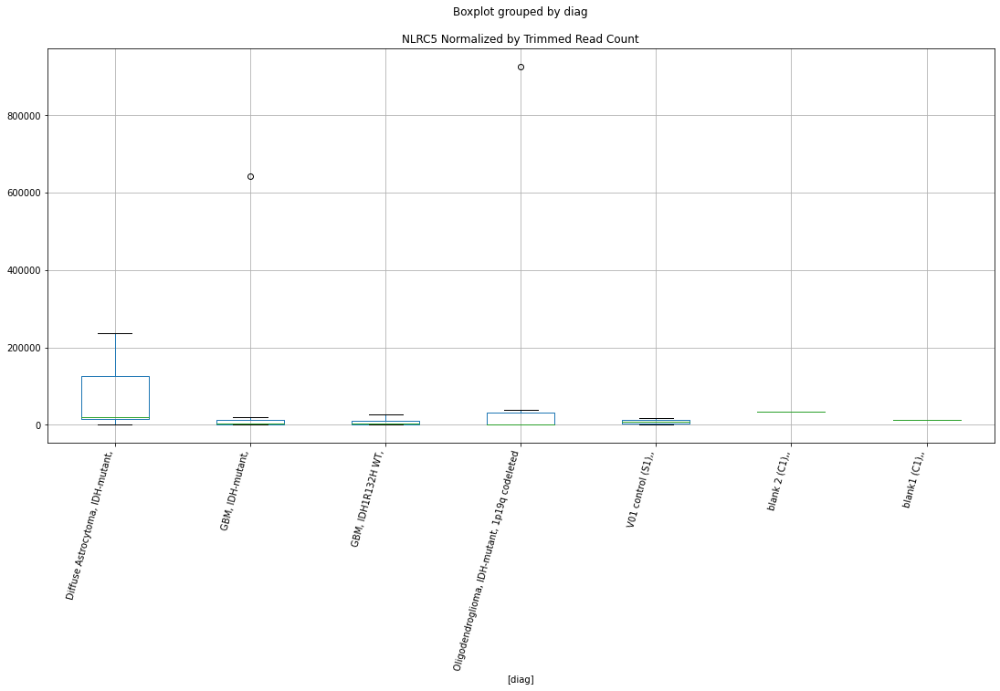

 p : 0.03551214136410355  ( t : 2.2730119546494736 ) :  D-plex  :  cutadapt2  :  MIEF2
Control and blanks
76     0.0
340    0.0
Name: MIEF2, dtype: float64
208    6172.61
Name: MIEF2, dtype: float64
472    2311.82
Name: MIEF2, dtype: float64


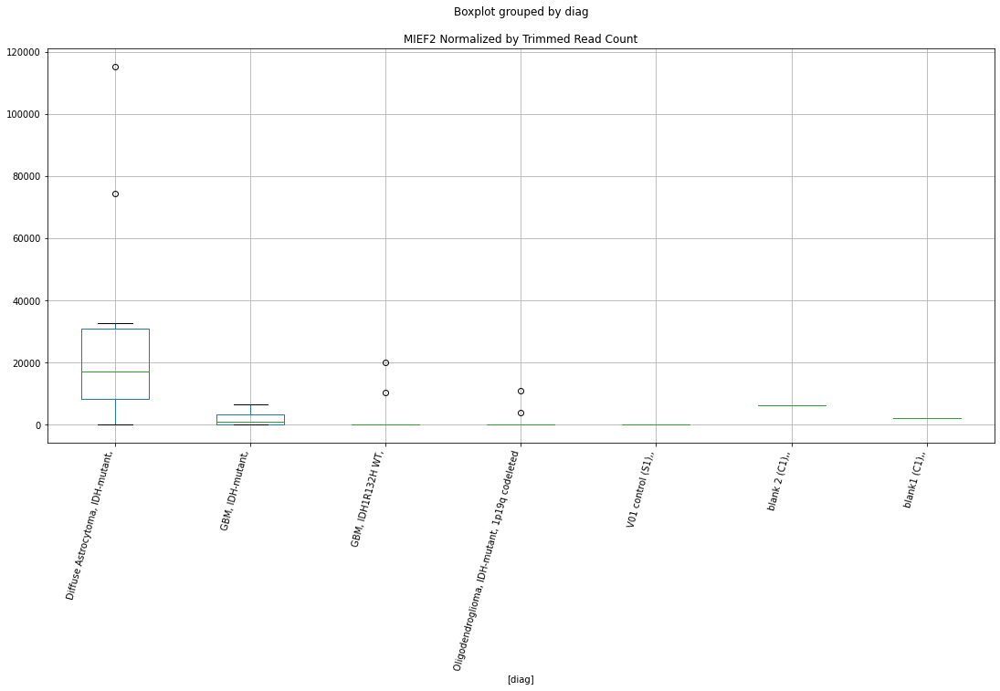

 p : 0.03558000951318032  ( t : 2.272064690021317 ) :  D-plex  :  bbduk2  :  LOC441242
Control and blanks
73     0.0
337    0.0
Name: LOC441242, dtype: float64
205    537.27
Name: LOC441242, dtype: float64
469    0.0
Name: LOC441242, dtype: float64


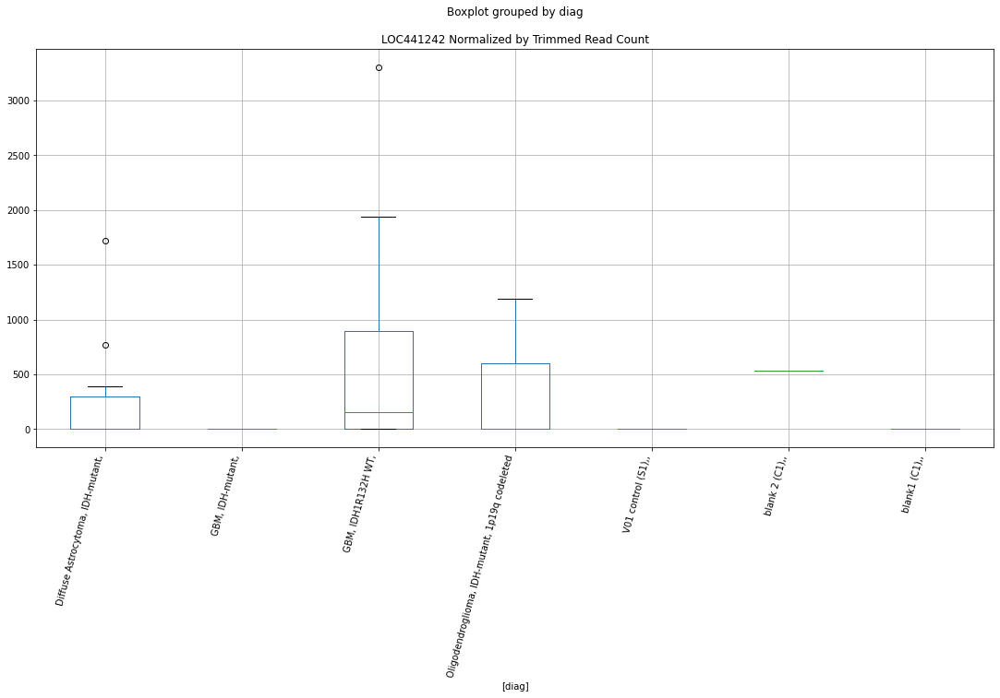

 p : 0.03567141956492668  ( t : 2.270791478403951 ) :  D-plex  :  bbduk2  :  LUC7L3
Control and blanks
73     0.0
337    0.0
Name: LUC7L3, dtype: float64
205    3581.82
Name: LUC7L3, dtype: float64
469    4732.22
Name: LUC7L3, dtype: float64


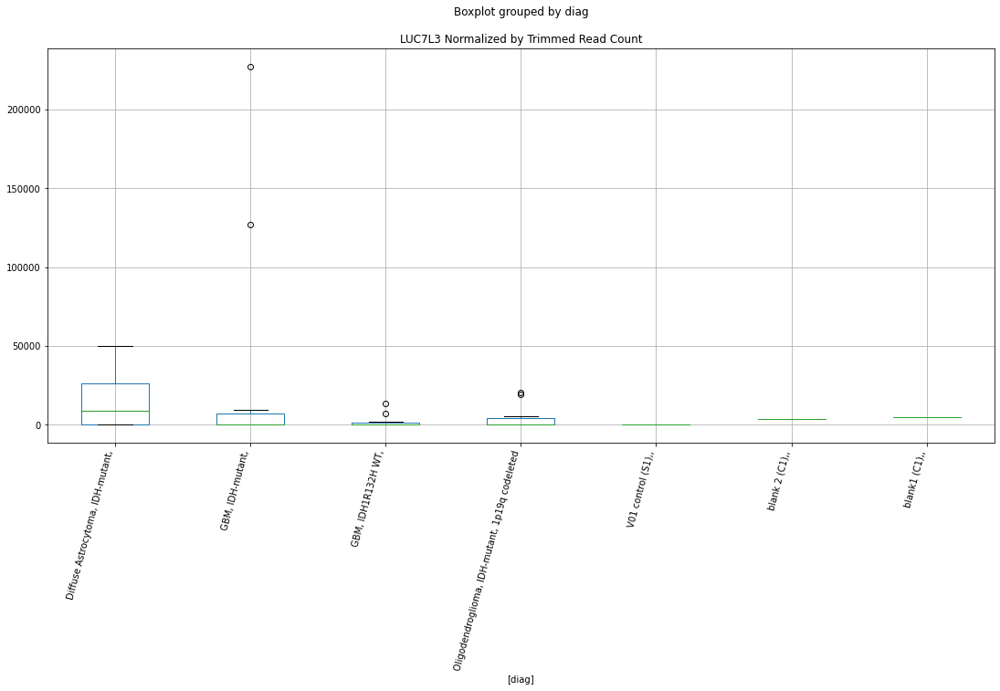

 p : 0.03567525398125081  ( t : 2.2707381364101886 ) :  D-plex  :  bbduk2  :  LOC112268313
Control and blanks
73     47153.51
337     2670.47
Name: LOC112268313, dtype: float64
205    7700.91
Name: LOC112268313, dtype: float64
469    7689.86
Name: LOC112268313, dtype: float64


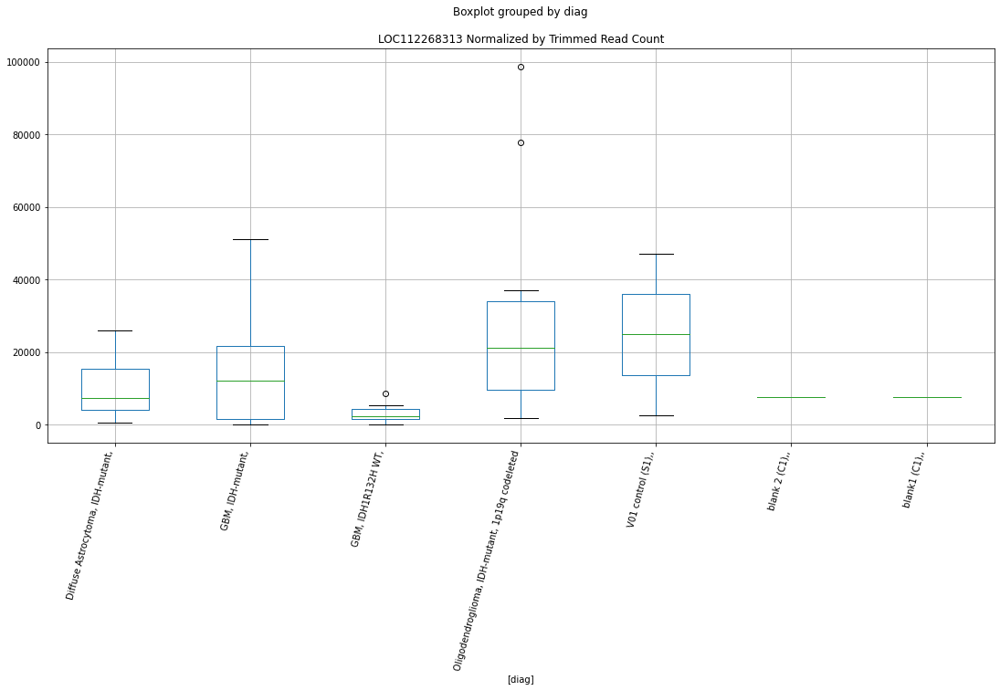

 p : 0.03572331298372288  ( t : 2.2700700189388843 ) :  D-plex  :  cutadapt2  :  MCHR2
Control and blanks
76     0.0
340    0.0
Name: MCHR2, dtype: float64
208    529.08
Name: MCHR2, dtype: float64
472    1155.91
Name: MCHR2, dtype: float64


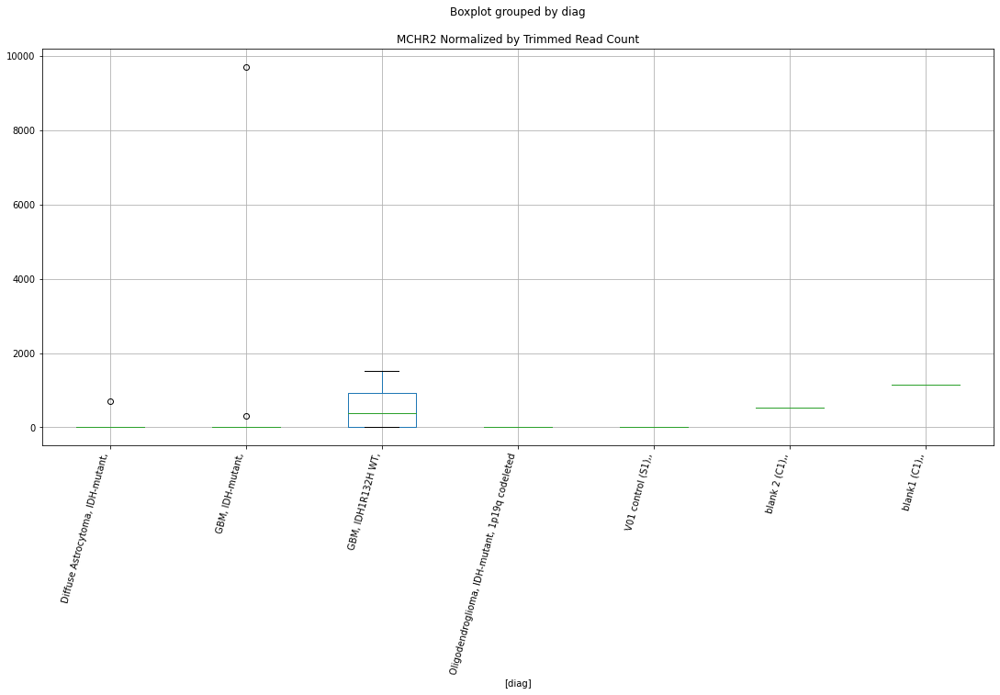

 p : 0.035846942638642416  ( t : 2.2683551272575575 ) :  Lexogen  :  bbduk2  :  MPPED1
Control and blanks
79     0.0
343    0.0
Name: MPPED1, dtype: float64
211    0.0
Name: MPPED1, dtype: float64
475    0.0
Name: MPPED1, dtype: float64


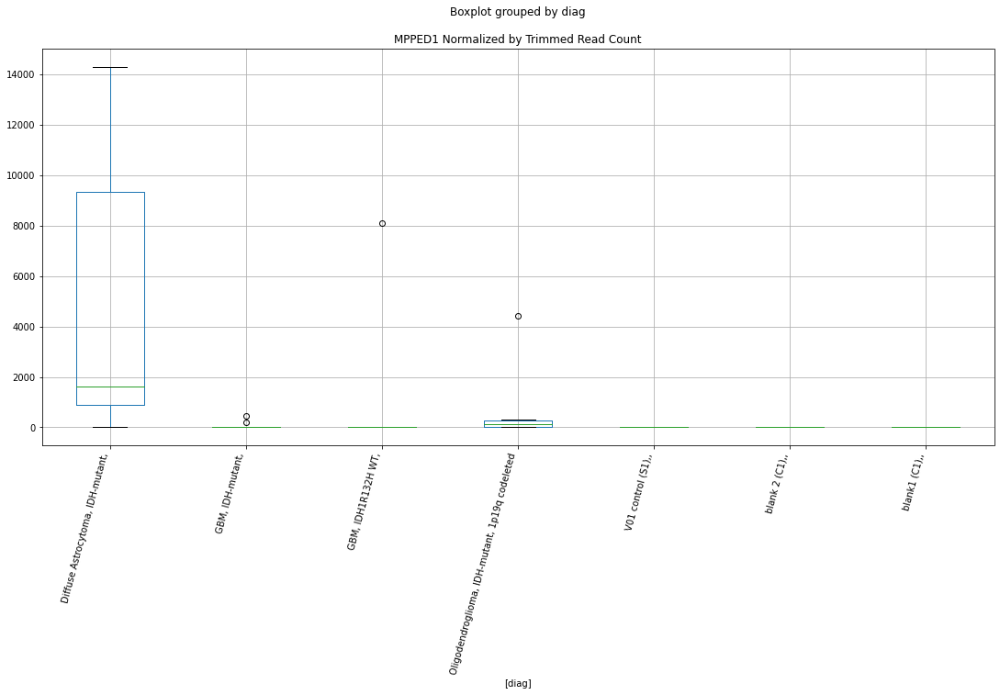

 p : 0.035971039622731  ( t : 2.2666392427950504 ) :  D-plex  :  bbduk2  :  NUP85
Control and blanks
73     746726.12
337    859891.92
Name: NUP85, dtype: float64
205    333825.53
Name: NUP85, dtype: float64
469    488601.56
Name: NUP85, dtype: float64


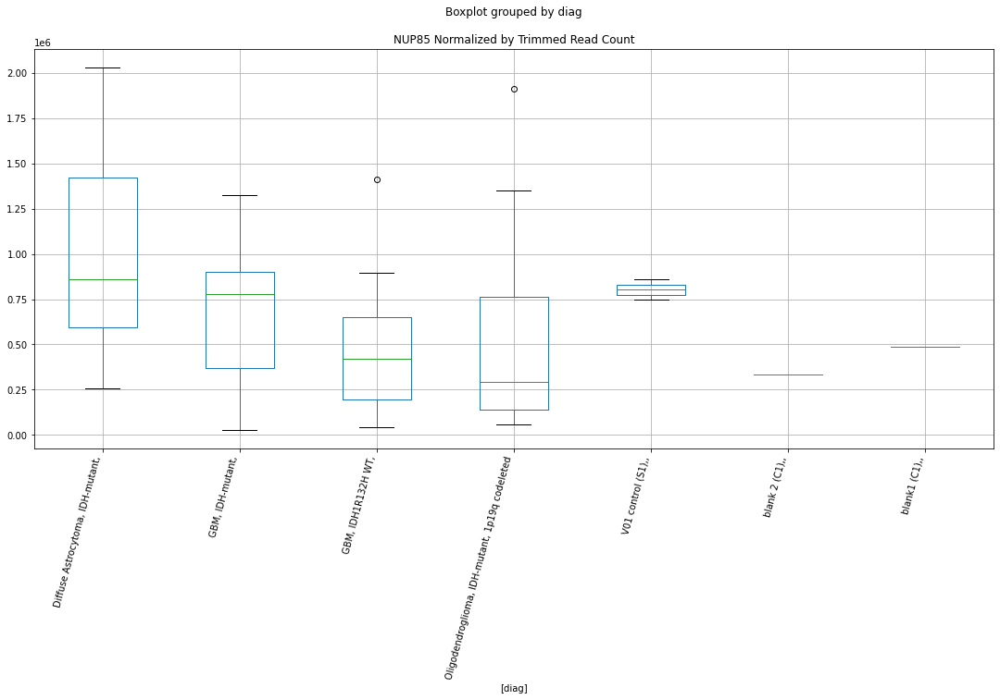

 p : 0.03631168048022779  ( t : 2.261957181524855 ) :  Lexogen  :  cutadapt2  :  MUC6
Control and blanks
82     0.0
346    0.0
Name: MUC6, dtype: float64
214    13018.87
Name: MUC6, dtype: float64
478    0.0
Name: MUC6, dtype: float64


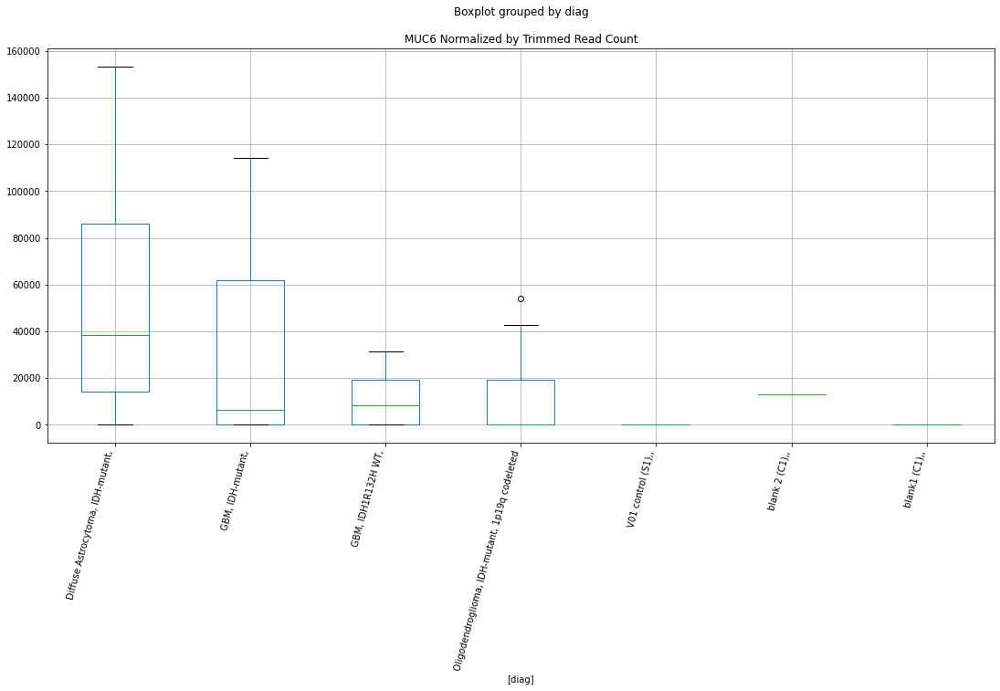

 p : 0.036369651440318375  ( t : 2.261164422438886 ) :  D-plex  :  bbduk2  :  LOC644189
Control and blanks
73     0.0
337    0.0
Name: LOC644189, dtype: float64
205    0.0
Name: LOC644189, dtype: float64
469    0.0
Name: LOC644189, dtype: float64


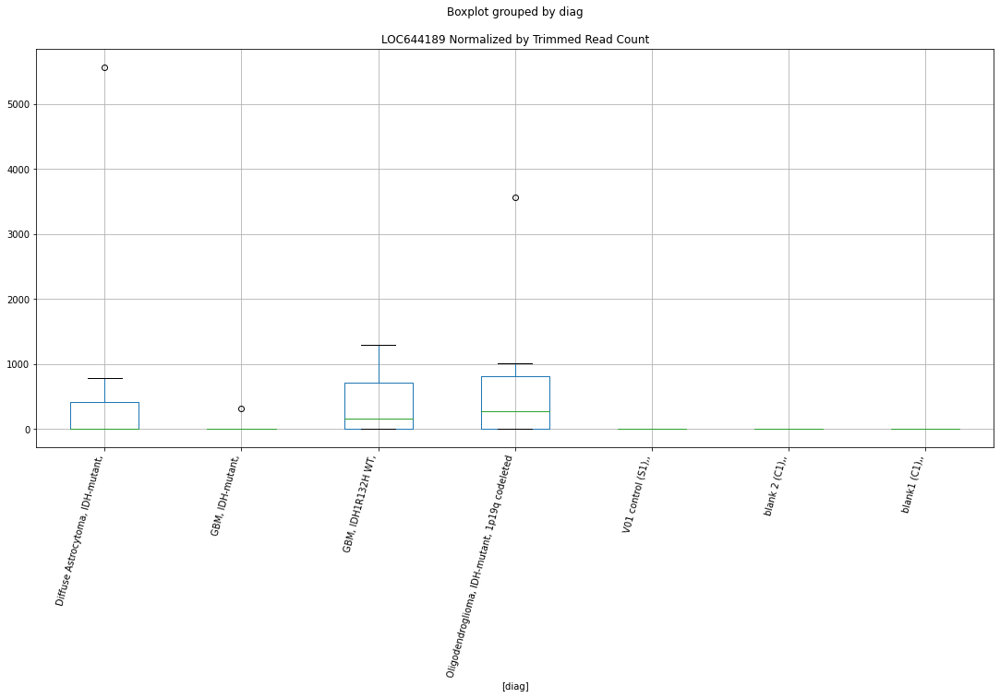

 p : 0.036493095395158534  ( t : 2.25948019512987 ) :  D-plex  :  bbduk2  :  MYPOP
Control and blanks
73      6957.08
337    26704.72
Name: MYPOP, dtype: float64
205    10387.28
Name: MYPOP, dtype: float64
469    11239.02
Name: MYPOP, dtype: float64


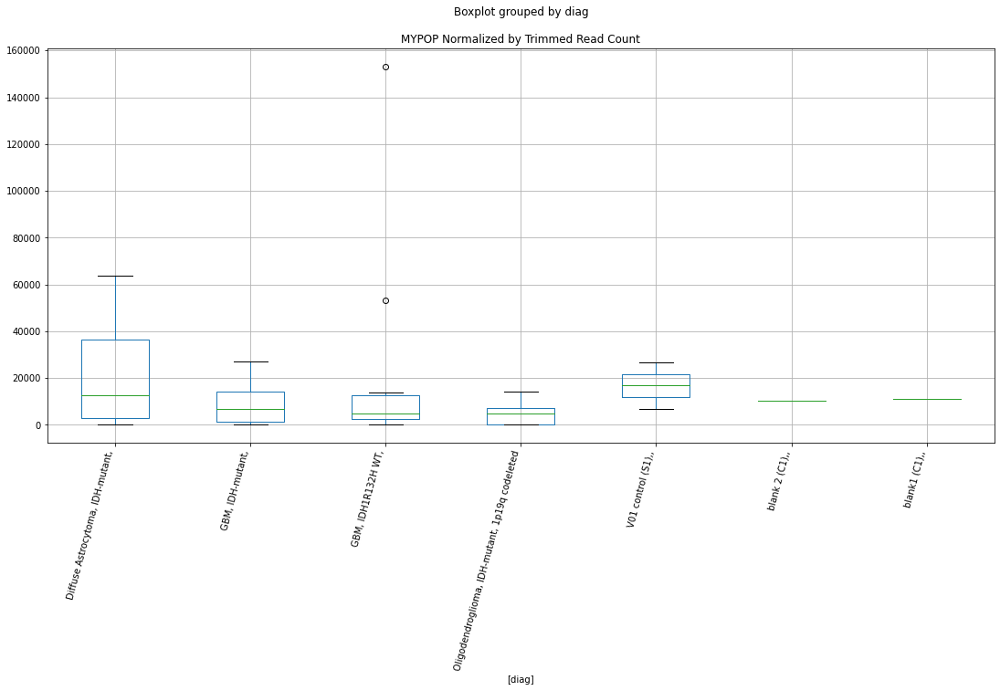

 p : 0.0366141296342293  ( t : 2.25783394661603 ) :  D-plex  :  cutadapt2  :  MLLT10
Control and blanks
76     21213.20
340    17614.64
Name: MLLT10, dtype: float64
208    10228.89
Name: MLLT10, dtype: float64
472    31209.62
Name: MLLT10, dtype: float64


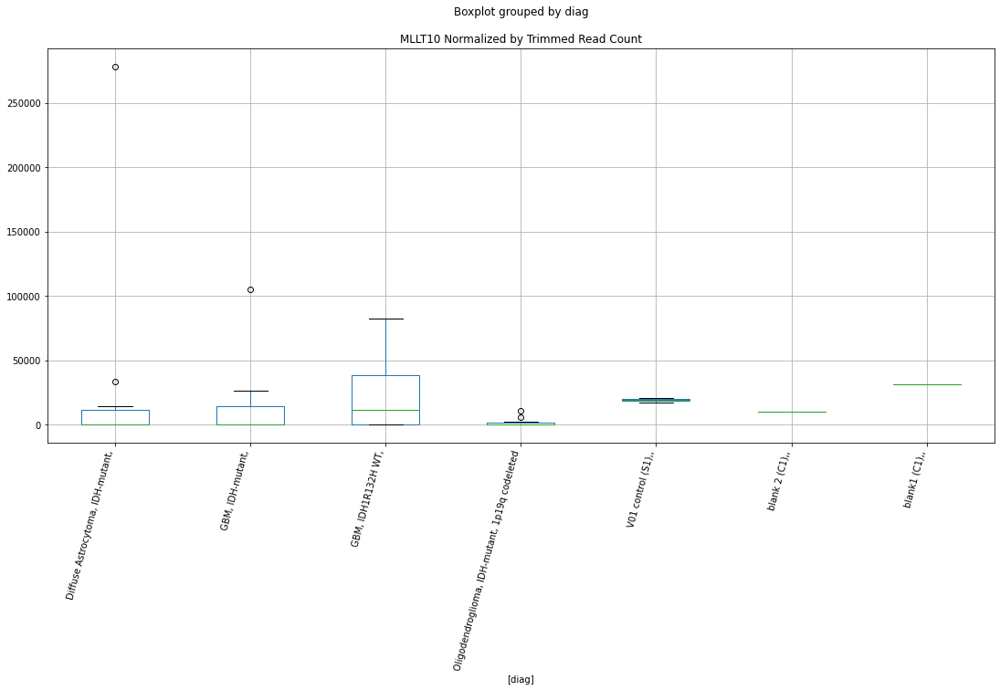

 p : 0.036697951118104415  ( t : 2.2566967907686006 ) :  D-plex  :  bbduk2  :  MIR600HG
Control and blanks
73     0.0
337    0.0
Name: MIR600HG, dtype: float64
205    537.27
Name: MIR600HG, dtype: float64
469    0.0
Name: MIR600HG, dtype: float64


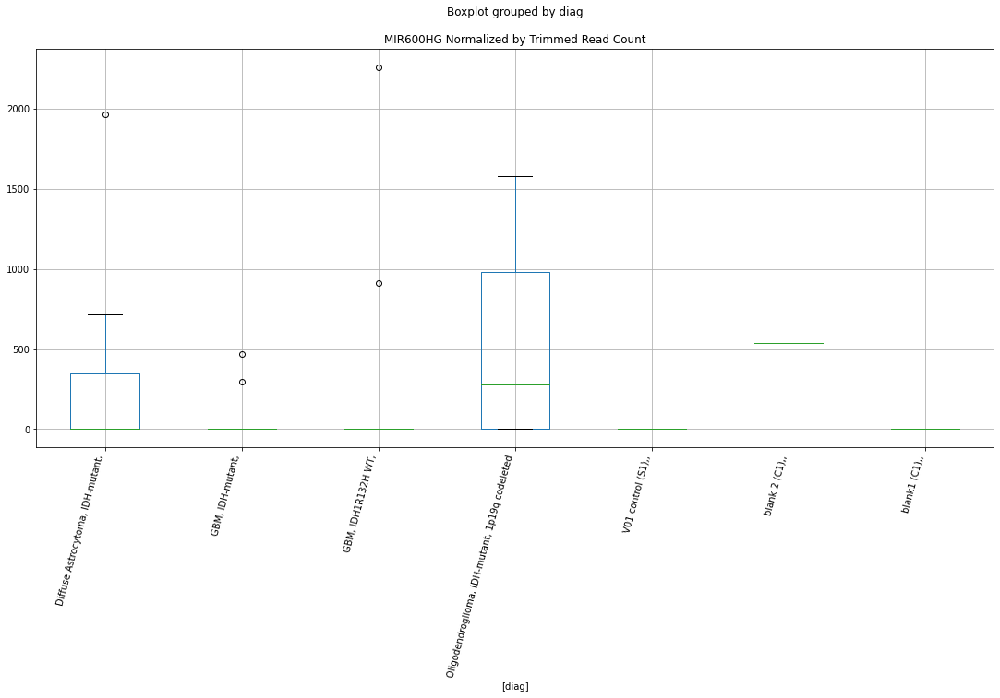

 p : 0.036727177377021226  ( t : 2.256300859516387 ) :  D-plex  :  cutadapt2  :  LOC107987077
Control and blanks
76     0.0
340    0.0
Name: LOC107987077, dtype: float64
208    0.0
Name: LOC107987077, dtype: float64
472    0.0
Name: LOC107987077, dtype: float64


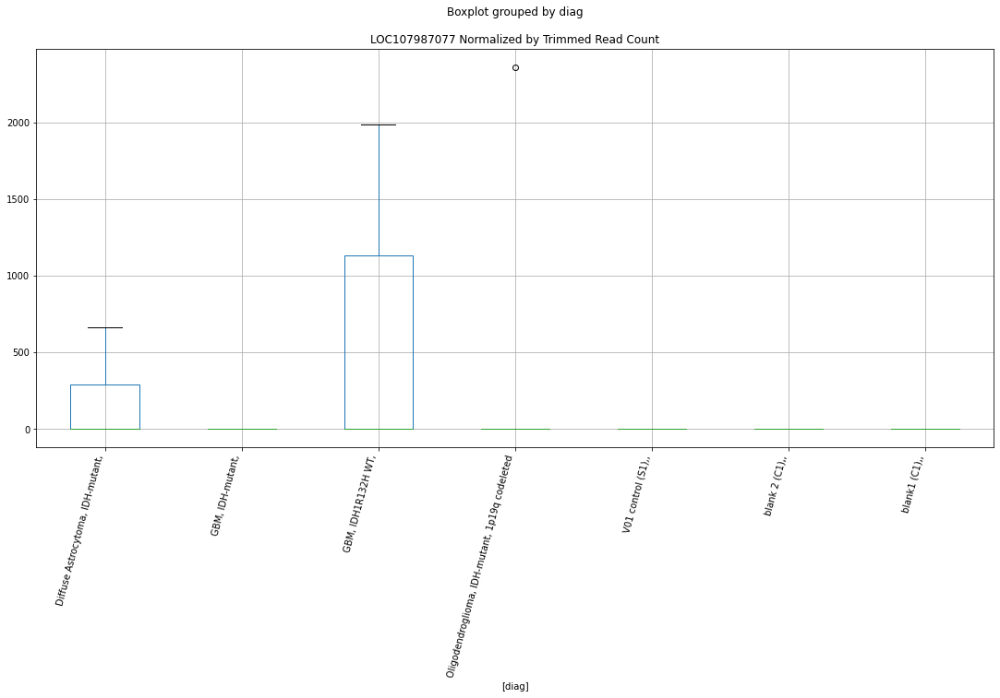

 p : 0.03690516818106928  ( t : 2.253895861240515 ) :  D-plex  :  bbduk2  :  MCF2L
Control and blanks
73     5411.06
337       0.00
Name: MCF2L, dtype: float64
205    21132.73
Name: MCF2L, dtype: float64
469    12422.07
Name: MCF2L, dtype: float64


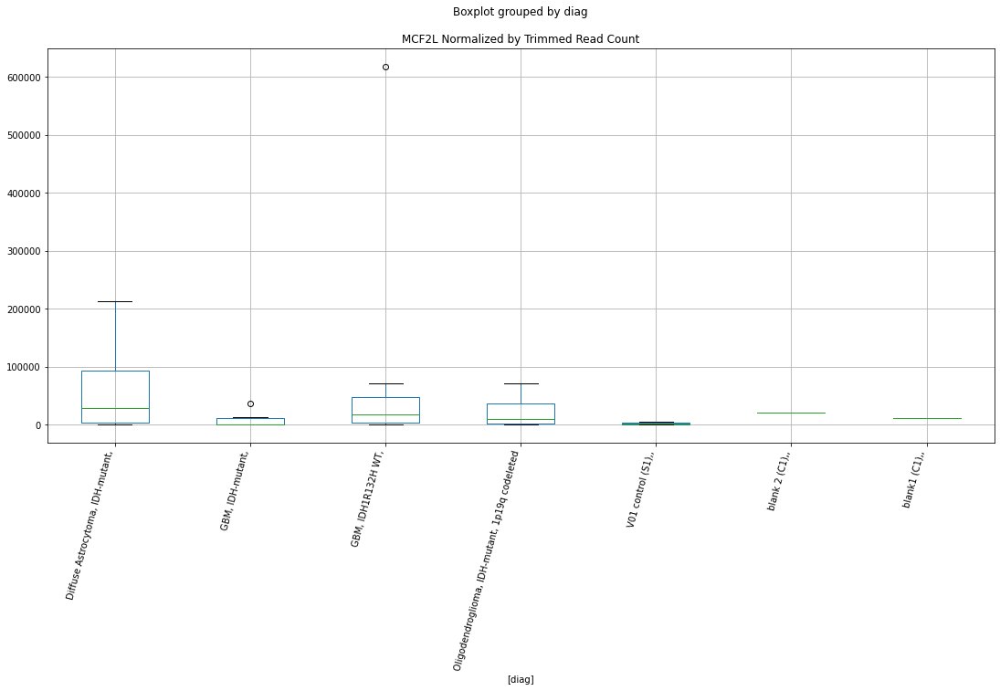

 p : 0.03692410977767621  ( t : 2.2536405546079146 ) :  D-plex  :  bbduk2  :  NEURL1B
Control and blanks
73     1546.02
337       0.00
Name: NEURL1B, dtype: float64
205    1970.0
Name: NEURL1B, dtype: float64
469    4732.22
Name: NEURL1B, dtype: float64


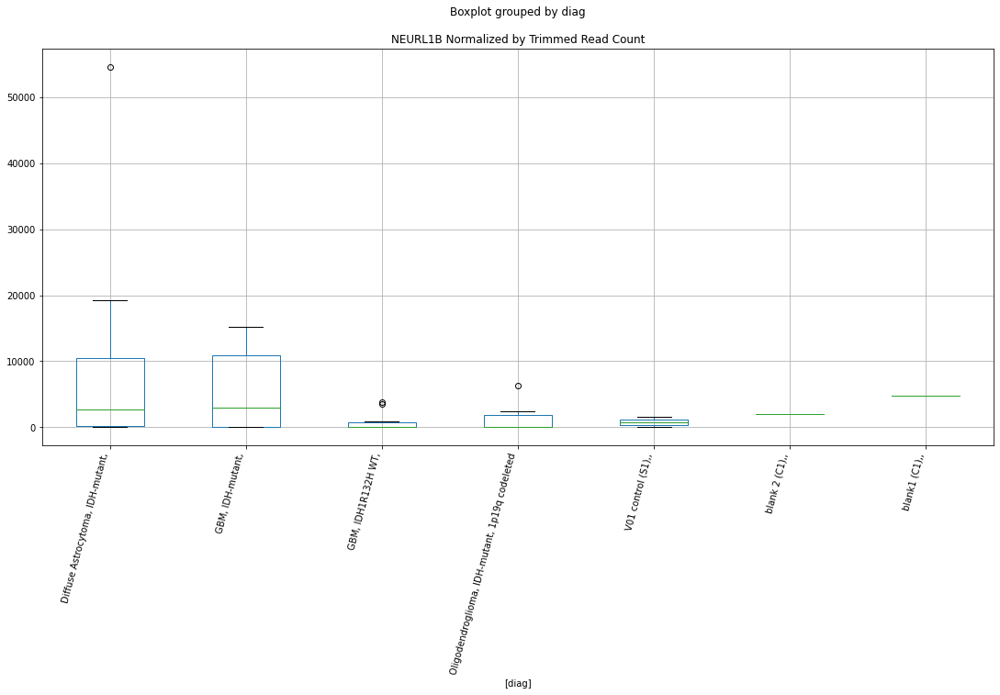

 p : 0.03692927294372089  ( t : 2.253570983211509 ) :  Lexogen  :  cutadapt2  :  MPPED1
Control and blanks
82     0.0
346    0.0
Name: MPPED1, dtype: float64
214    0.0
Name: MPPED1, dtype: float64
478    237.46
Name: MPPED1, dtype: float64


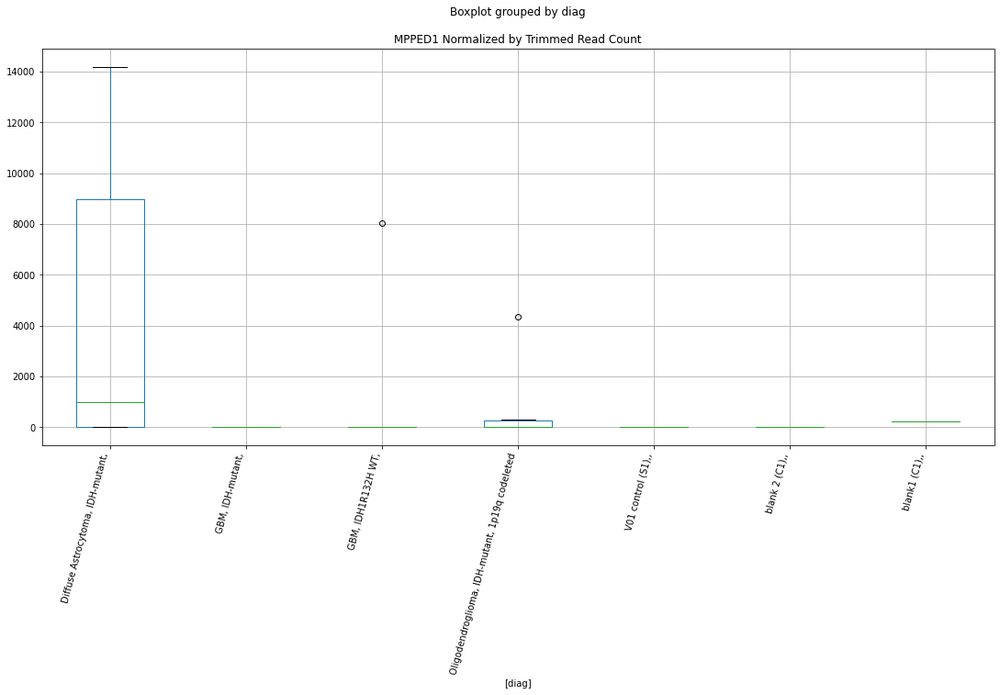

 p : 0.03698793073859958  ( t : 2.2527812250168466 ) :  D-plex  :  cutadapt2  :  NCR3LG1
Control and blanks
76     310621.83
340       880.73
Name: NCR3LG1, dtype: float64
208    12521.58
Name: NCR3LG1, dtype: float64
472    238117.81
Name: NCR3LG1, dtype: float64


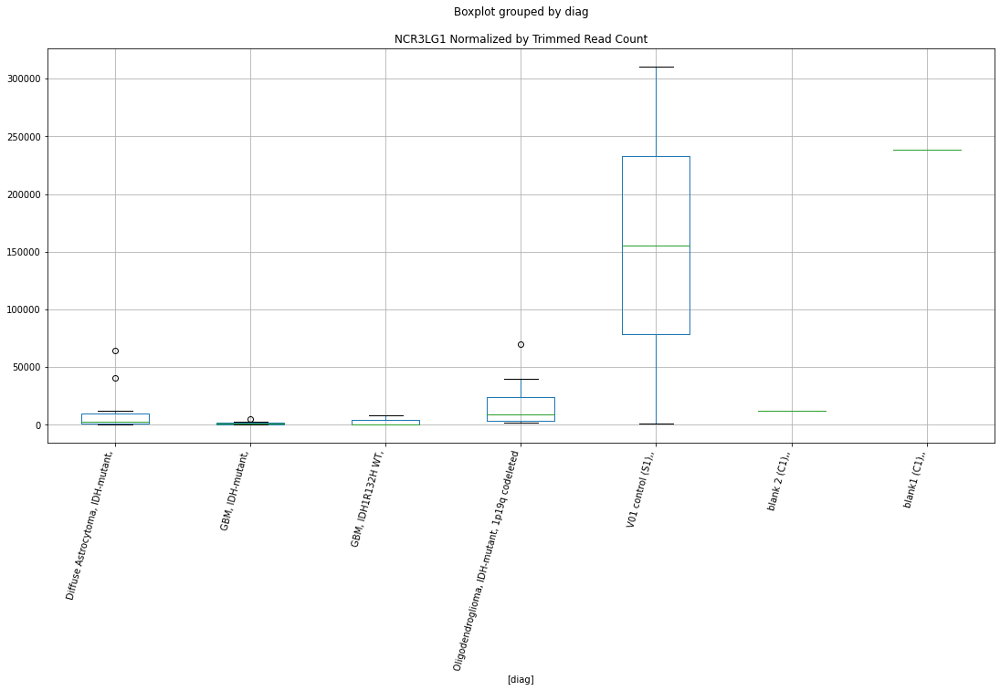

 p : 0.03703223732279544  ( t : 2.2521854550574445 ) :  D-plex  :  cutadapt2  :  LOC112267914
Control and blanks
76     0.0
340    0.0
Name: LOC112267914, dtype: float64
208    352.72
Name: LOC112267914, dtype: float64
472    0.0
Name: LOC112267914, dtype: float64


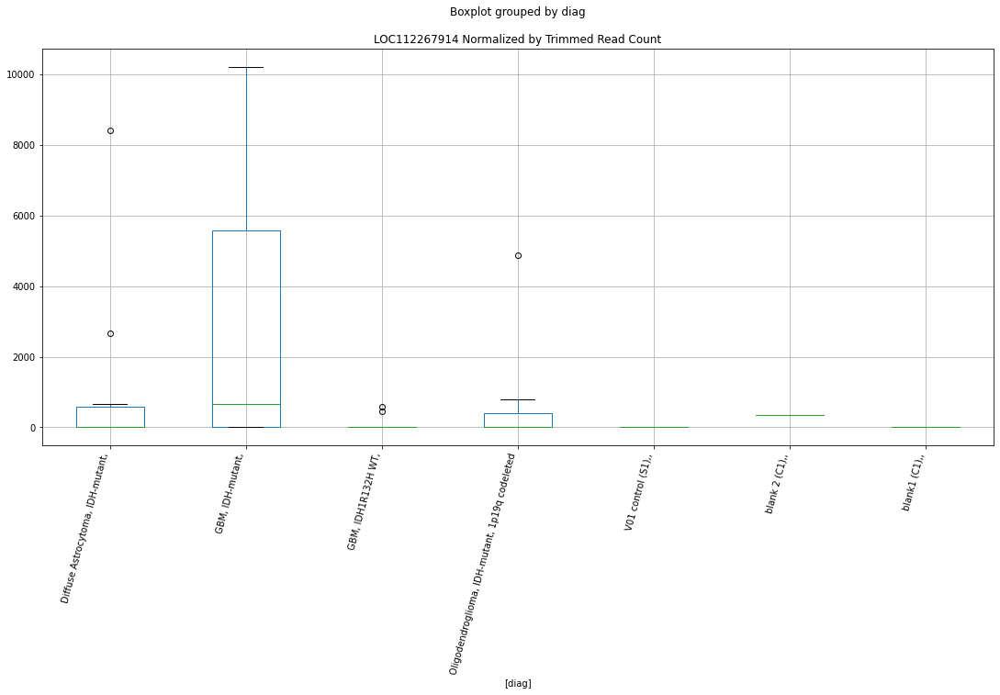

 p : 0.03704147054458106  ( t : 2.252061383080408 ) :  Lexogen  :  cutadapt2  :  MAP7D1
Control and blanks
82     0.0
346    0.0
Name: MAP7D1, dtype: float64
214    0.0
Name: MAP7D1, dtype: float64
478    0.0
Name: MAP7D1, dtype: float64


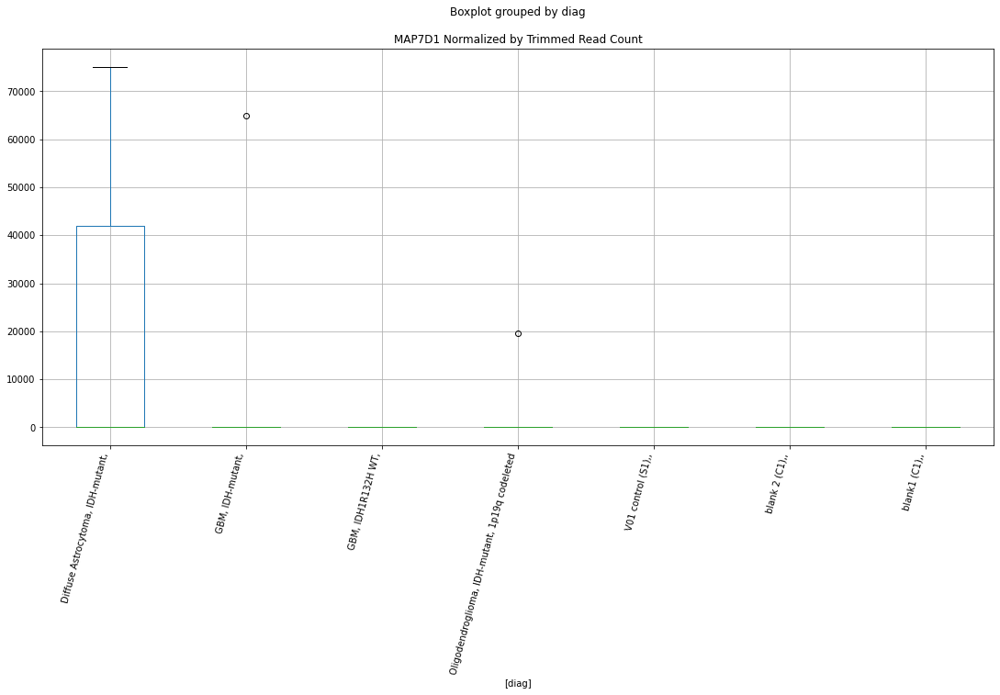

 p : 0.037053657123090736  ( t : 2.2518976688891406 ) :  D-plex  :  bbduk2  :  LOC574538
Control and blanks
73     37104.40
337    17803.15
Name: LOC574538, dtype: float64
205    10029.09
Name: LOC574538, dtype: float64
469    7098.33
Name: LOC574538, dtype: float64


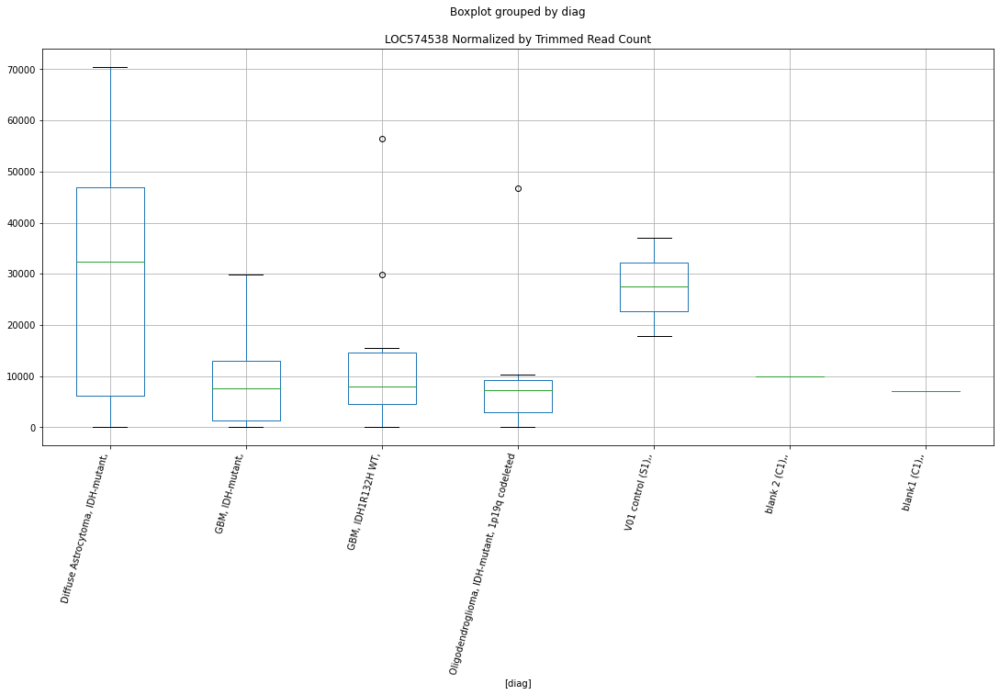

 p : 0.03732738763330568  ( t : 2.248233412894081 ) :  D-plex  :  cutadapt2  :  LOC574538
Control and blanks
76     36365.48
340    17614.64
Name: LOC574538, dtype: float64
208    9523.45
Name: LOC574538, dtype: float64
472    6935.47
Name: LOC574538, dtype: float64


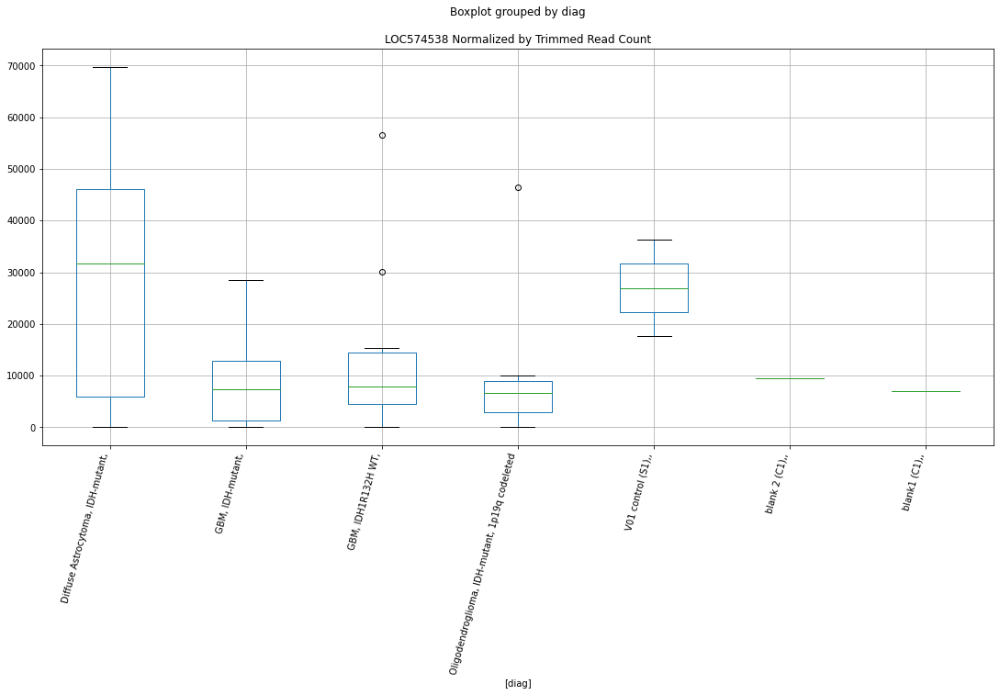

 p : 0.03735674813979192  ( t : 2.247841856147834 ) :  Lexogen  :  bbduk2  :  MUC6
Control and blanks
79     0.0
343    0.0
Name: MUC6, dtype: float64
211    13118.7
Name: MUC6, dtype: float64
475    0.0
Name: MUC6, dtype: float64


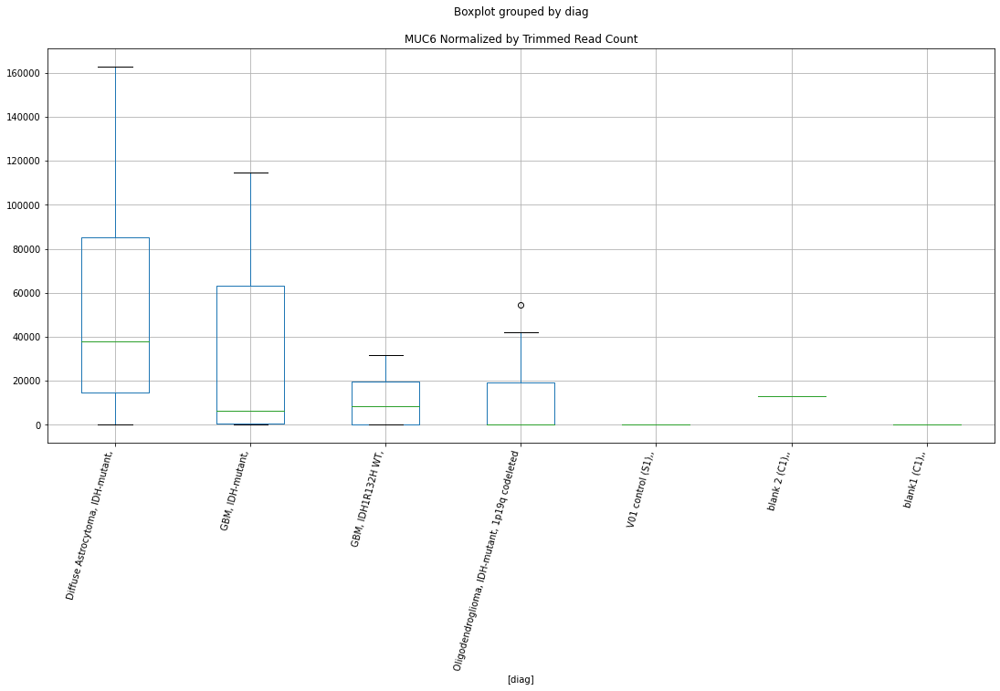

 p : 0.03737034273158469  ( t : 2.2476606525062923 ) :  D-plex  :  cutadapt2  :  NHEJ1
Control and blanks
76      757.61
340    6165.12
Name: NHEJ1, dtype: float64
208    38446.53
Name: NHEJ1, dtype: float64
472    128306.2
Name: NHEJ1, dtype: float64


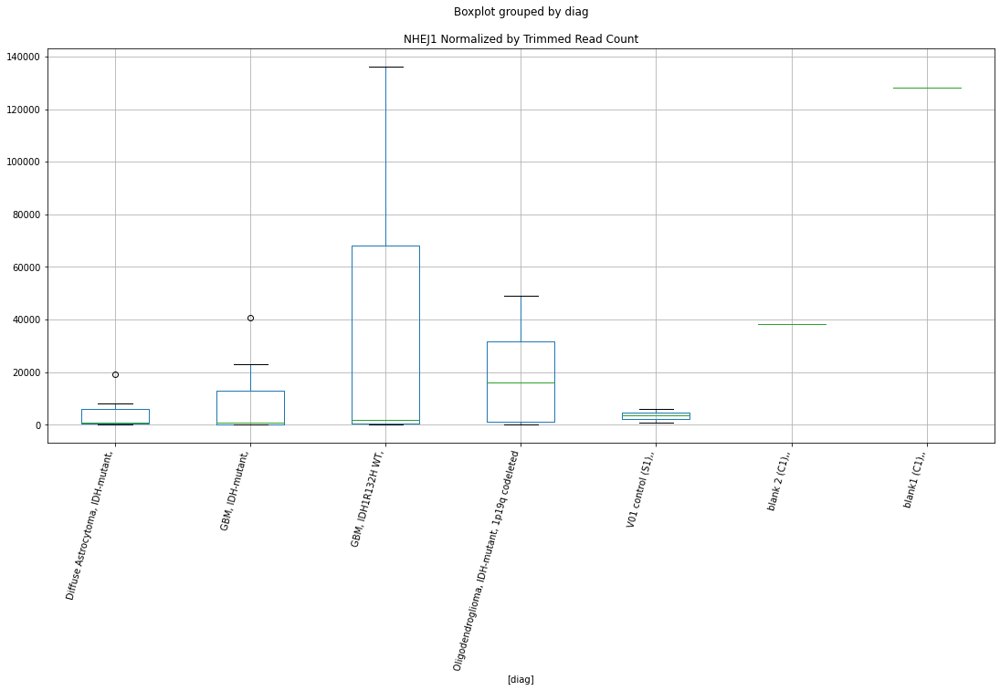

 p : 0.03743633798667072  ( t : 2.2467818586286232 ) :  Lexogen  :  cutadapt2  :  NBEAL1
Control and blanks
82     0.0
346    0.0
Name: NBEAL1, dtype: float64
214    0.0
Name: NBEAL1, dtype: float64
478    0.0
Name: NBEAL1, dtype: float64


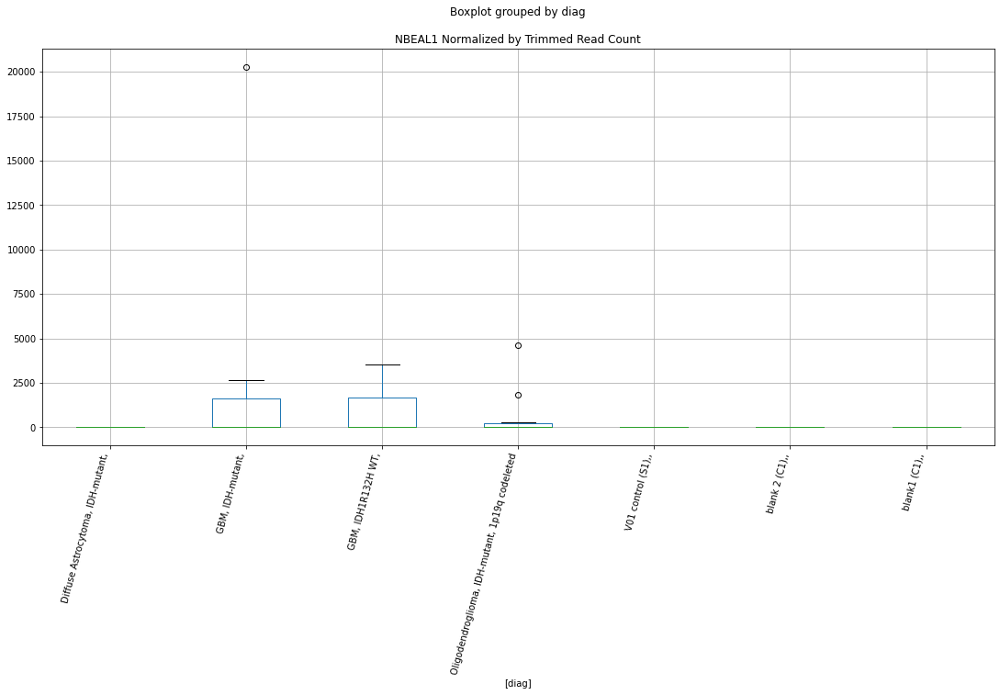

 p : 0.037473738410669345  ( t : 2.2462844682740313 ) :  Lexogen  :  bbduk2  :  MAP7D1
Control and blanks
79     0.0
343    0.0
Name: MAP7D1, dtype: float64
211    0.0
Name: MAP7D1, dtype: float64
475    0.0
Name: MAP7D1, dtype: float64


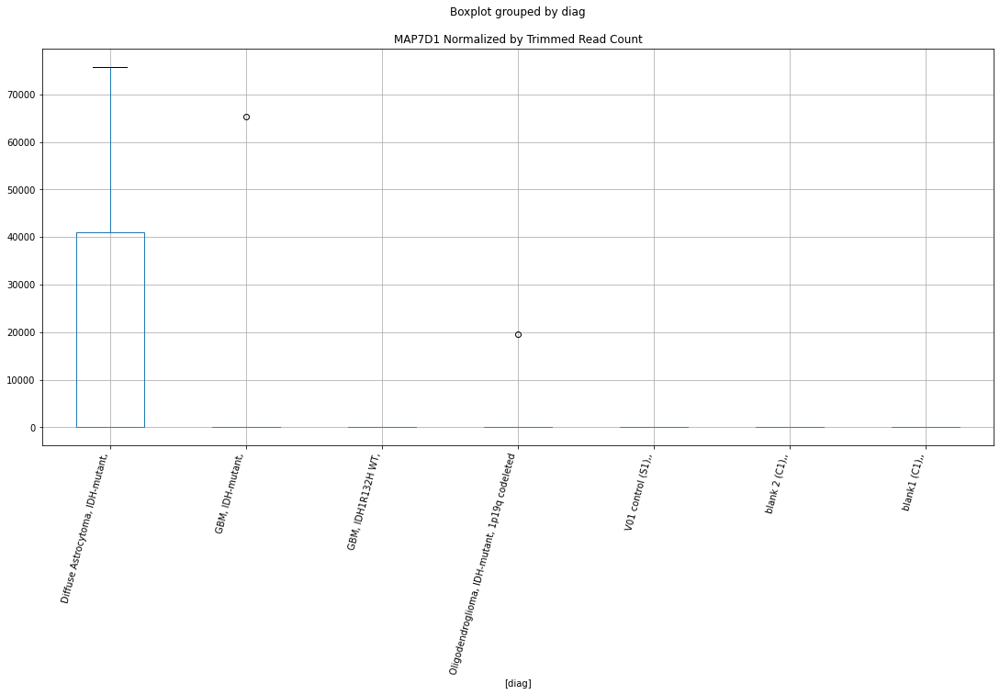

 p : 0.03747732999786752  ( t : 2.2462367276562656 ) :  Lexogen  :  bbduk2  :  NBEAL1
Control and blanks
79     0.0
343    0.0
Name: NBEAL1, dtype: float64
211    0.0
Name: NBEAL1, dtype: float64
475    0.0
Name: NBEAL1, dtype: float64


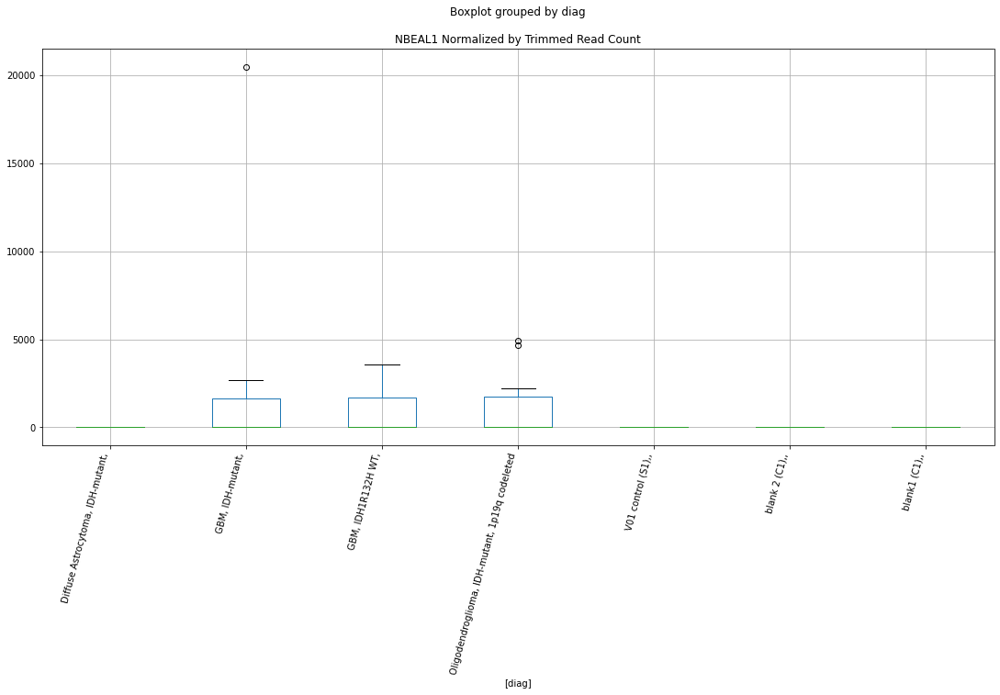

 p : 0.037679726591584674  ( t : 2.2435531988293596 ) :  Lexogen  :  bbduk2  :  NHSL2
Control and blanks
79     0.0
343    0.0
Name: NHSL2, dtype: float64
211    0.0
Name: NHSL2, dtype: float64
475    0.0
Name: NHSL2, dtype: float64


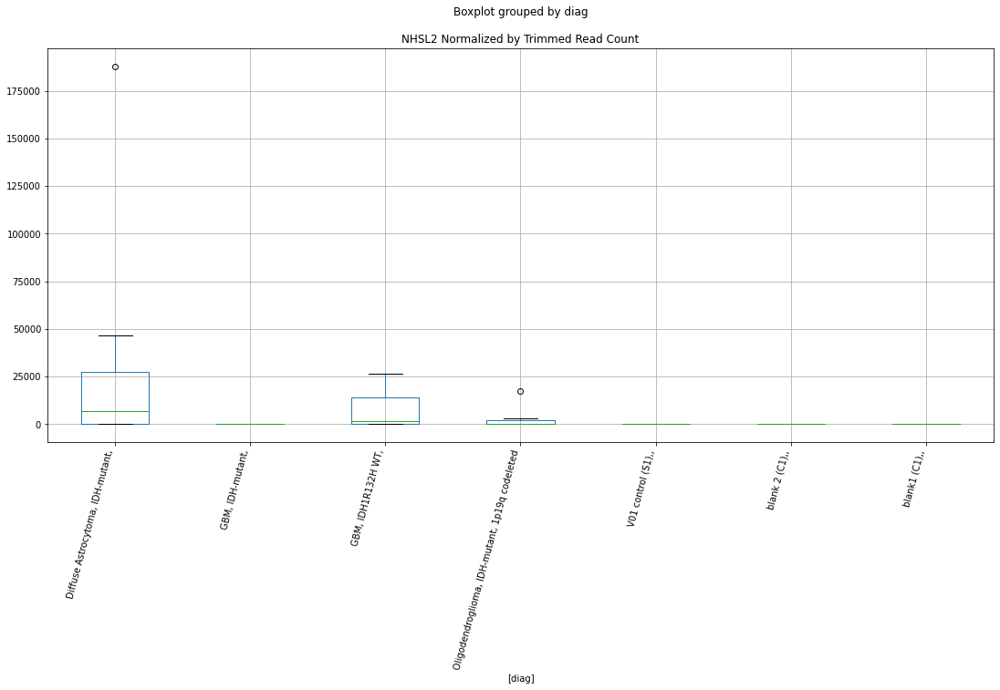

 p : 0.03775609662747108  ( t : 2.242544080073573 ) :  Lexogen  :  cutadapt2  :  NHSL2
Control and blanks
82     0.0
346    0.0
Name: NHSL2, dtype: float64
214    0.0
Name: NHSL2, dtype: float64
478    0.0
Name: NHSL2, dtype: float64


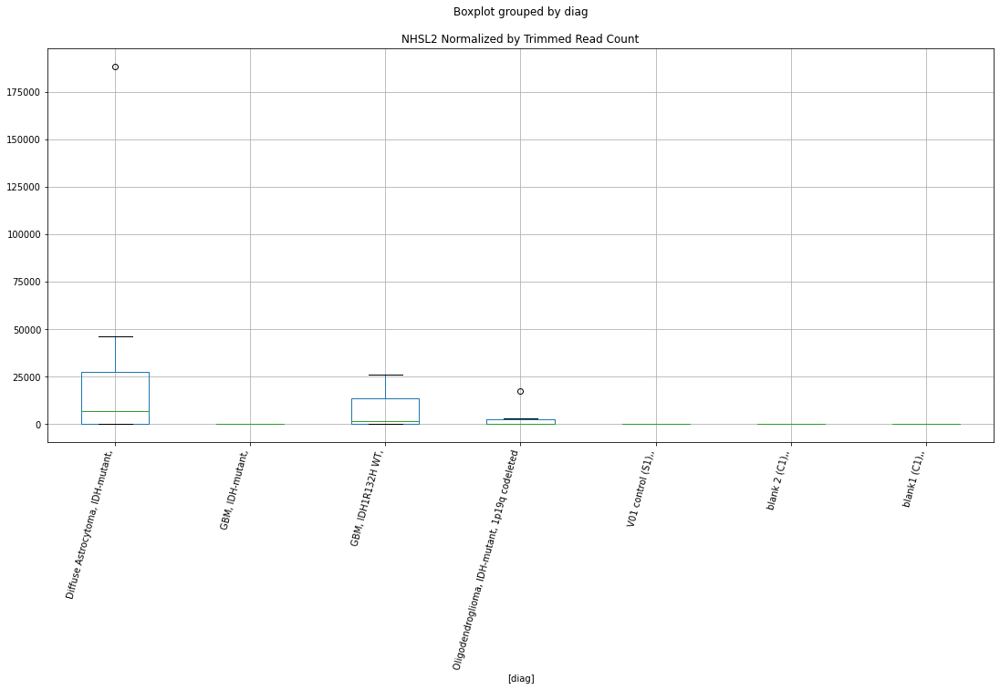

 p : 0.037762484687576  ( t : 2.242459756501163 ) :  D-plex  :  cutadapt2  :  NOC2LP2
Control and blanks
76     0.0
340    0.0
Name: NOC2LP2, dtype: float64
208    0.0
Name: NOC2LP2, dtype: float64
472    0.0
Name: NOC2LP2, dtype: float64


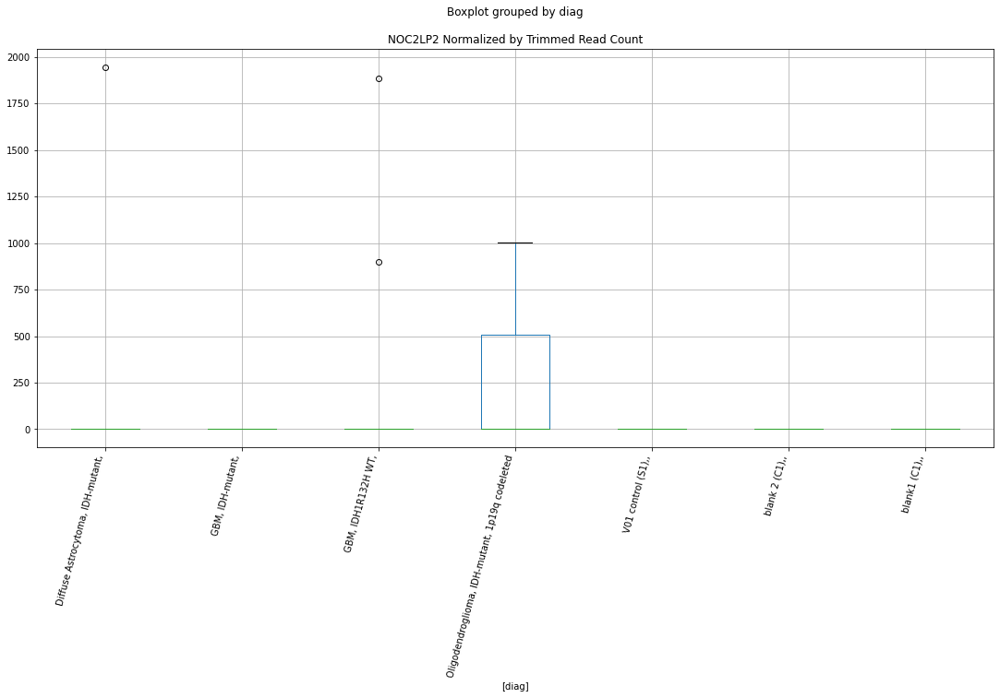

 p : 0.03788283140968171  ( t : 2.240873610815964 ) :  D-plex  :  cutadapt2  :  LOC646588
Control and blanks
76     0.0
340    0.0
Name: LOC646588, dtype: float64
208    1234.52
Name: LOC646588, dtype: float64
472    0.0
Name: LOC646588, dtype: float64


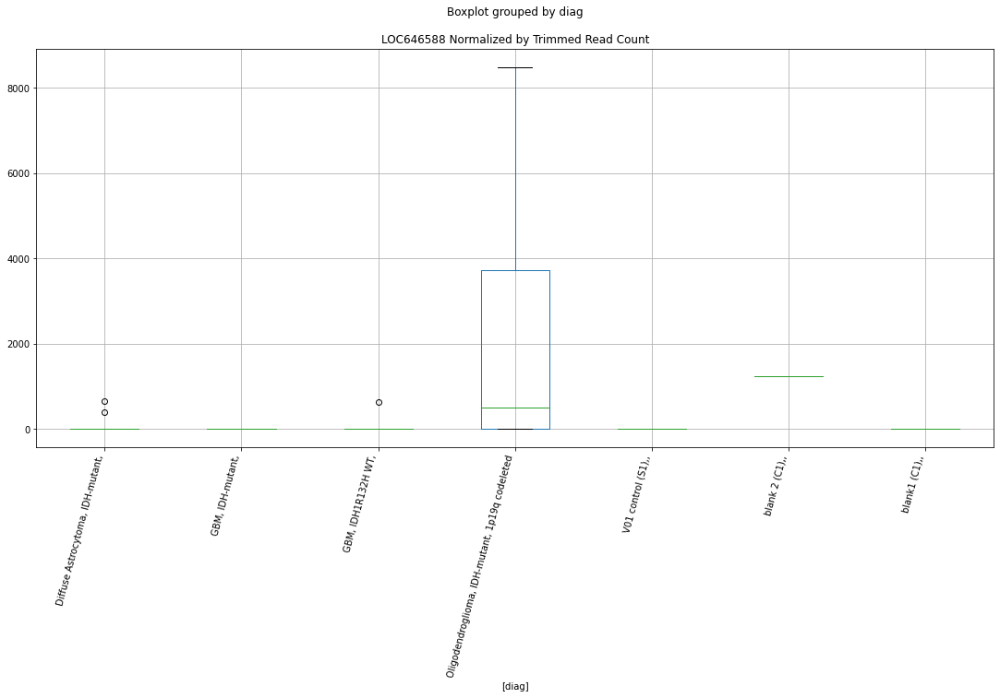

 p : 0.03815798198173758  ( t : 2.237264563676462 ) :  D-plex  :  bbduk2  :  NOC2LP2
Control and blanks
73     0.0
337    0.0
Name: NOC2LP2, dtype: float64
205    0.0
Name: NOC2LP2, dtype: float64
469    0.0
Name: NOC2LP2, dtype: float64


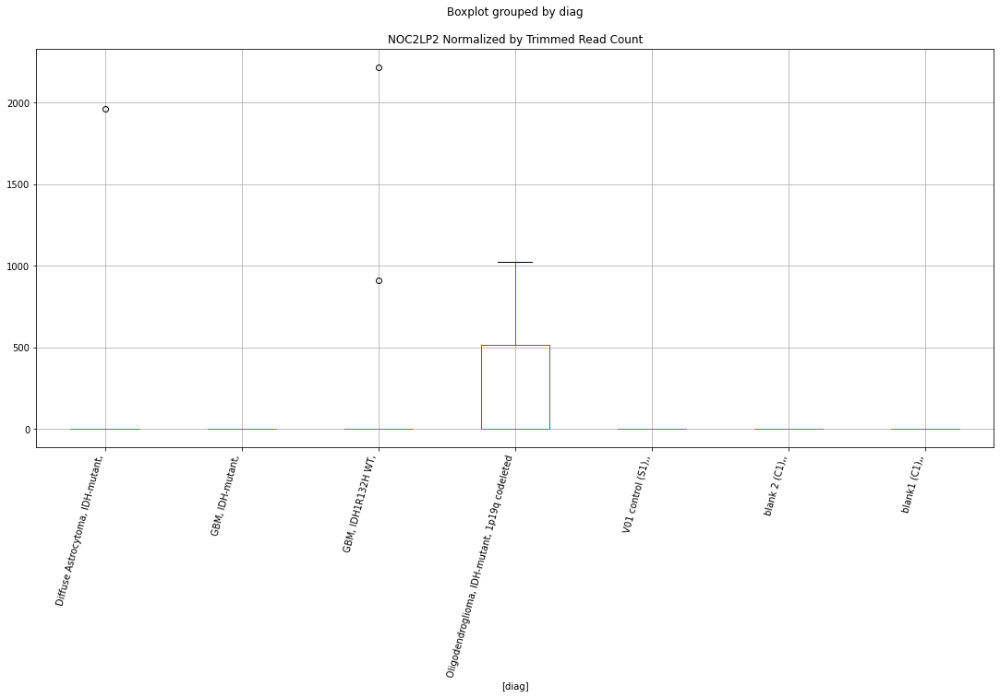

 p : 0.03825088695456271  ( t : 2.2360513799307182 ) :  Lexogen  :  bbduk2  :  MAF
Control and blanks
79          0.00
343    139065.88
Name: MAF, dtype: float64
211    10932.25
Name: MAF, dtype: float64
475    5748.38
Name: MAF, dtype: float64


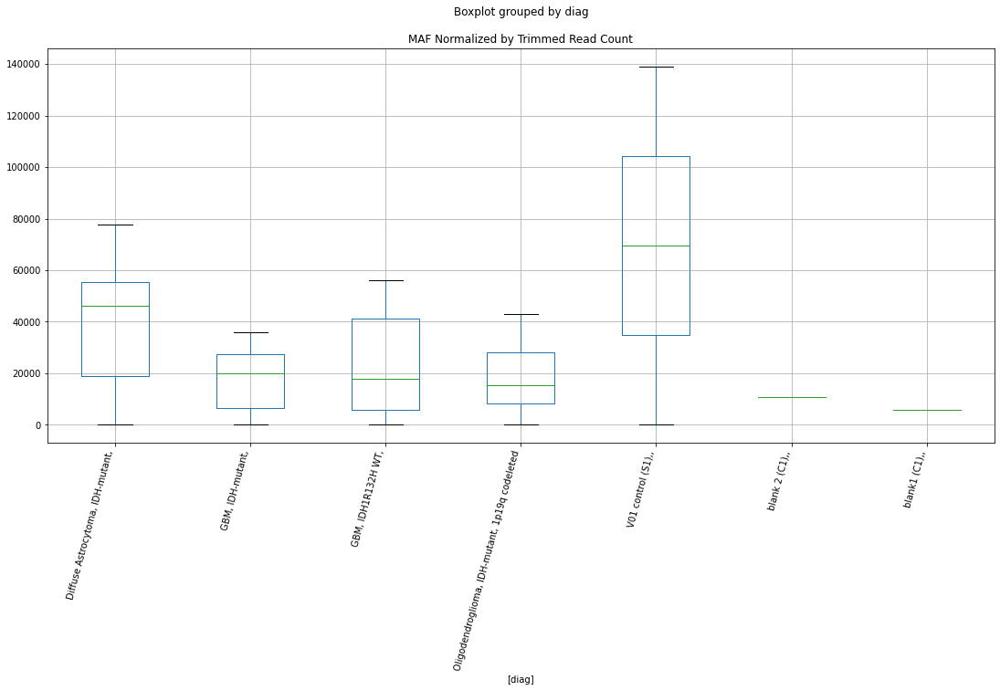

 p : 0.038376513879701604  ( t : 2.2344152137308244 ) :  D-plex  :  cutadapt2  :  MAGEA4
Control and blanks
76     0.0
340    0.0
Name: MAGEA4, dtype: float64
208    7407.13
Name: MAGEA4, dtype: float64
472    16182.76
Name: MAGEA4, dtype: float64


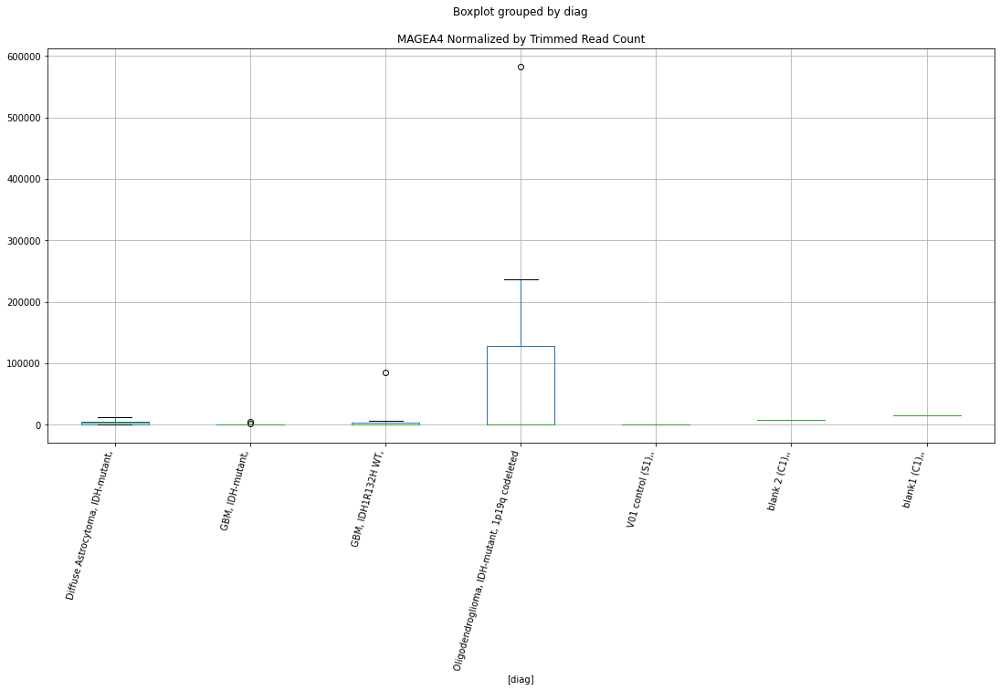

 p : 0.038401682739515886  ( t : 2.2340880078517094 ) :  Lexogen  :  cutadapt2  :  MAF
Control and blanks
82          0.00
346    139307.65
Name: MAF, dtype: float64
214    10849.06
Name: MAF, dtype: float64
478    5936.51
Name: MAF, dtype: float64


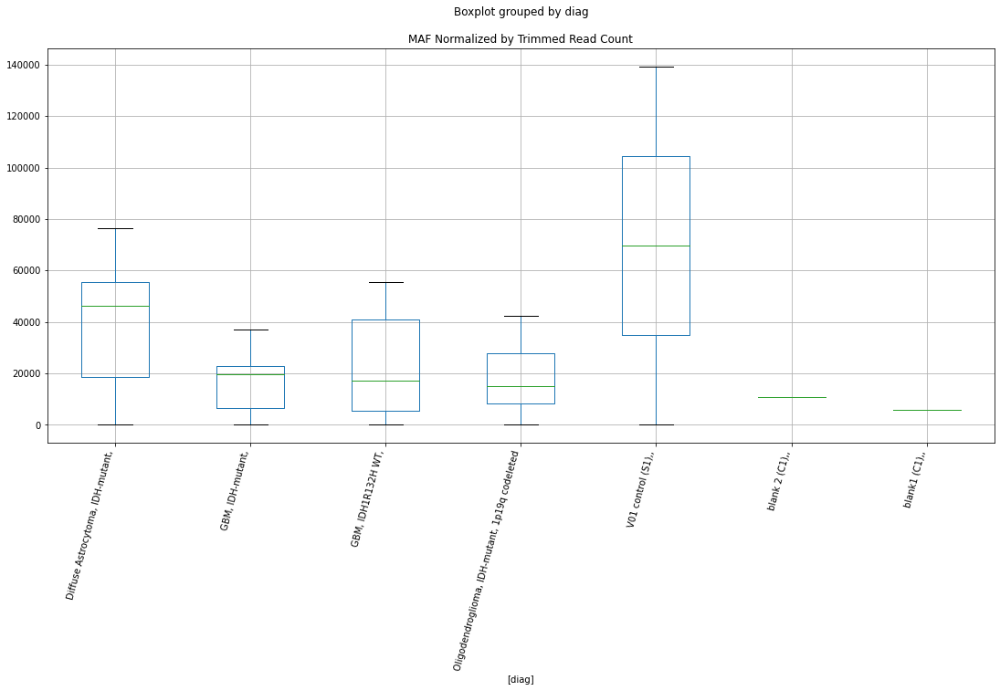

 p : 0.03842330241819962  ( t : 2.2338071005724673 ) :  Lexogen  :  bbduk2  :  LRRC70
Control and blanks
79     0.0
343    0.0
Name: LRRC70, dtype: float64
211    2459.76
Name: LRRC70, dtype: float64
475    239.52
Name: LRRC70, dtype: float64


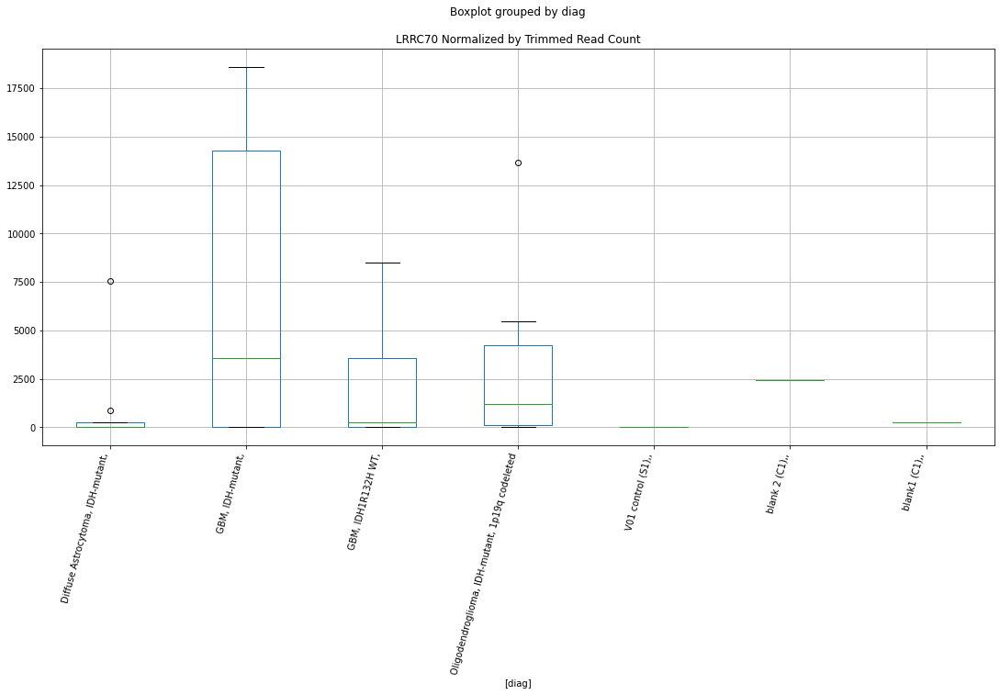

 p : 0.03845270176067633  ( t : 2.2334253447020753 ) :  D-plex  :  cutadapt2  :  LOC644189
Control and blanks
76     0.0
340    0.0
Name: LOC644189, dtype: float64
208    0.0
Name: LOC644189, dtype: float64
472    0.0
Name: LOC644189, dtype: float64


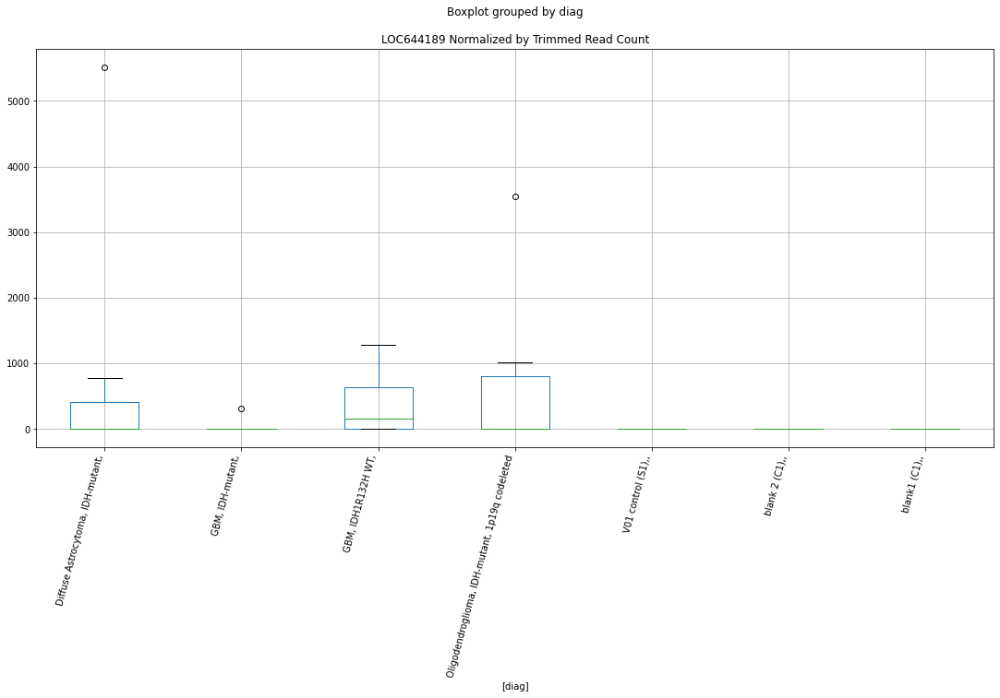

 p : 0.03858272157539129  ( t : 2.2317402314883314 ) :  D-plex  :  bbduk2  :  MAGEA4
Control and blanks
73     0.0
337    0.0
Name: MAGEA4, dtype: float64
205    7521.82
Name: MAGEA4, dtype: float64
469    16562.76
Name: MAGEA4, dtype: float64


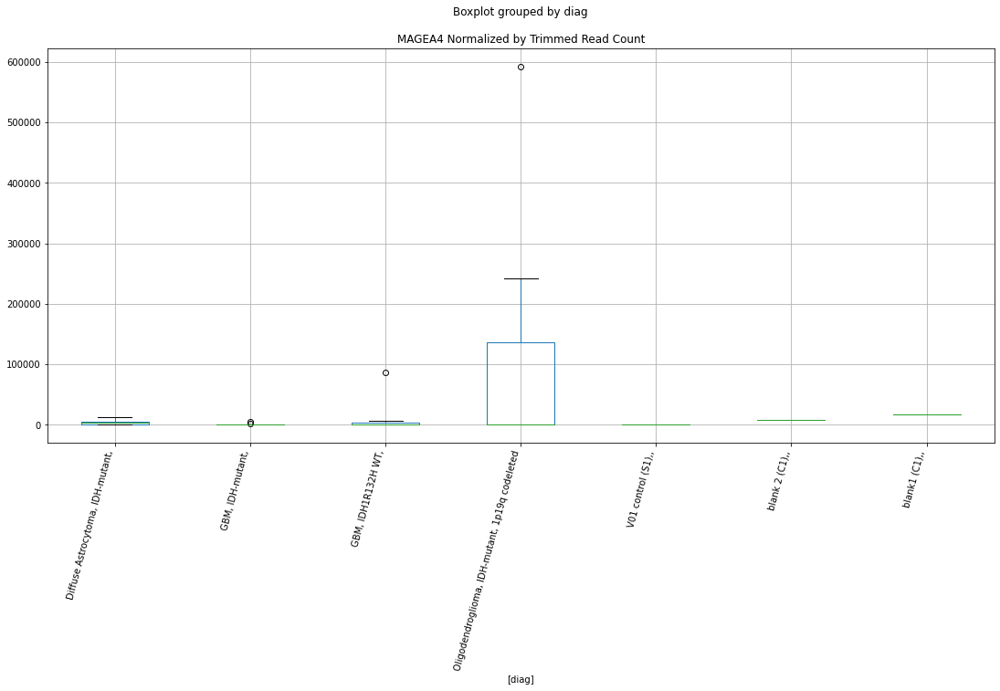

 p : 0.038635789033844854  ( t : 2.2310539571700434 ) :  Lexogen  :  bbduk2  :  NUP205
Control and blanks
79     0.0
343    0.0
Name: NUP205, dtype: float64
211    0.0
Name: NUP205, dtype: float64
475    0.0
Name: NUP205, dtype: float64


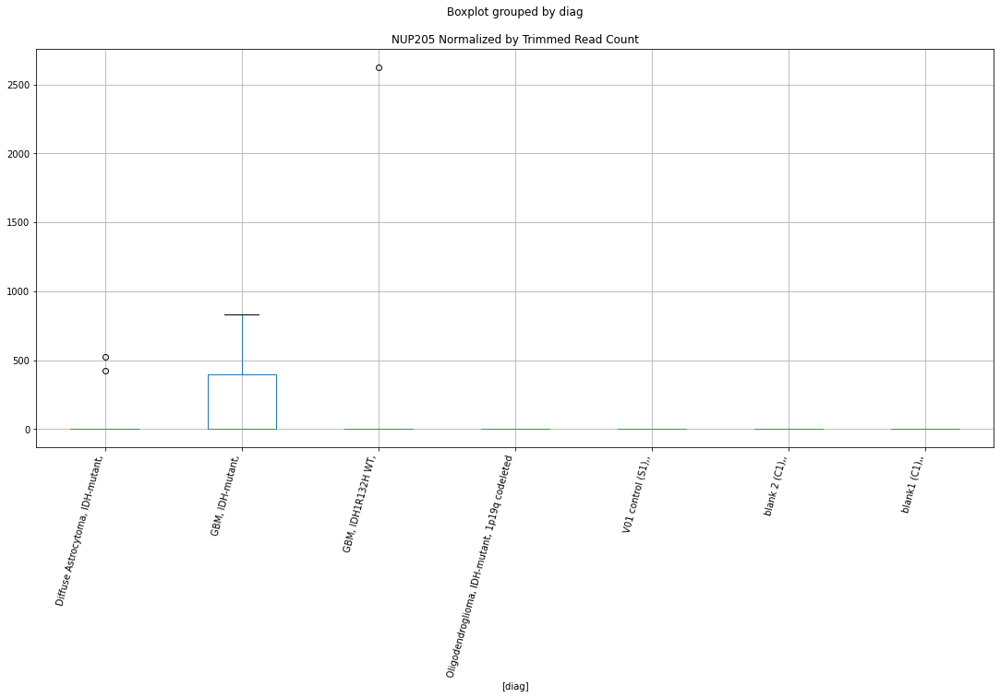

 p : 0.03869932886897182  ( t : 2.2302333942382075 ) :  D-plex  :  cutadapt2  :  MCCC2
Control and blanks
76     0.0
340    0.0
Name: MCCC2, dtype: float64
208    5290.81
Name: MCCC2, dtype: float64
472    1733.87
Name: MCCC2, dtype: float64


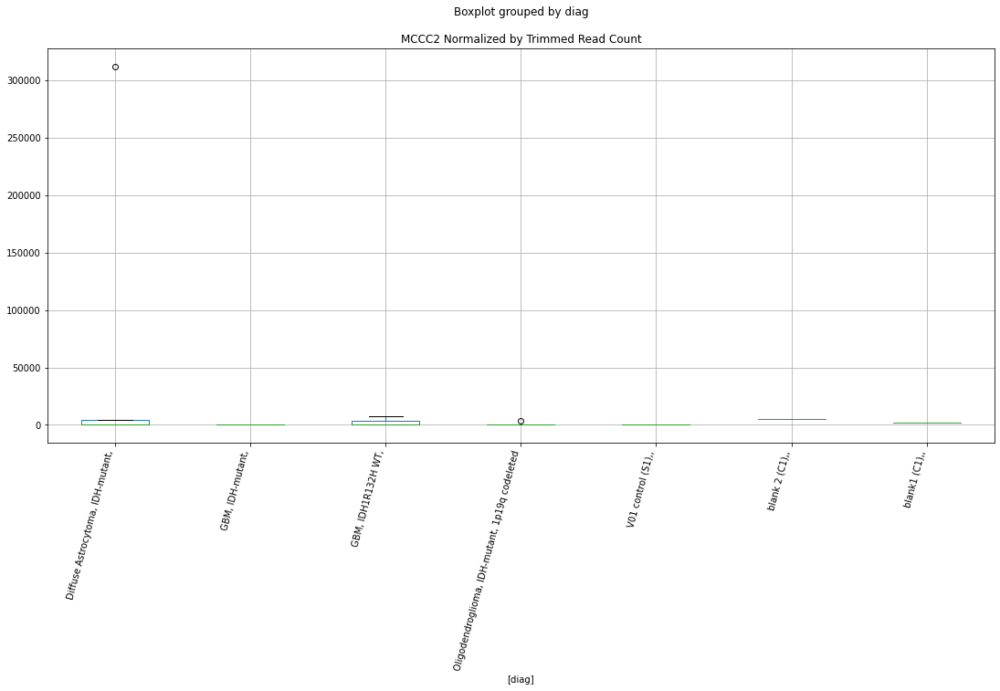

 p : 0.03879322481509897  ( t : 2.229023076980507 ) :  D-plex  :  bbduk2  :  LOC107987261
Control and blanks
73         0.0
337    12462.2
Name: LOC107987261, dtype: float64
205    1074.55
Name: LOC107987261, dtype: float64
469    0.0
Name: LOC107987261, dtype: float64


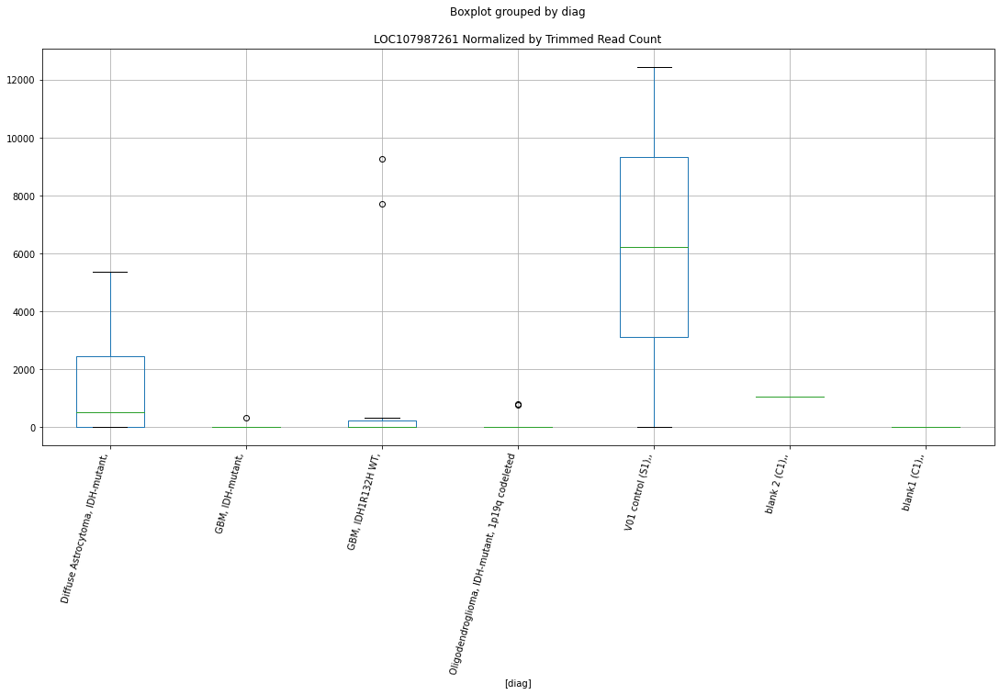

 p : 0.03884937821243414  ( t : 2.2283005492099677 ) :  Lexogen  :  cutadapt2  :  NT5DC2
Control and blanks
82     0.0
346    0.0
Name: NT5DC2, dtype: float64
214    0.0
Name: NT5DC2, dtype: float64
478    0.0
Name: NT5DC2, dtype: float64


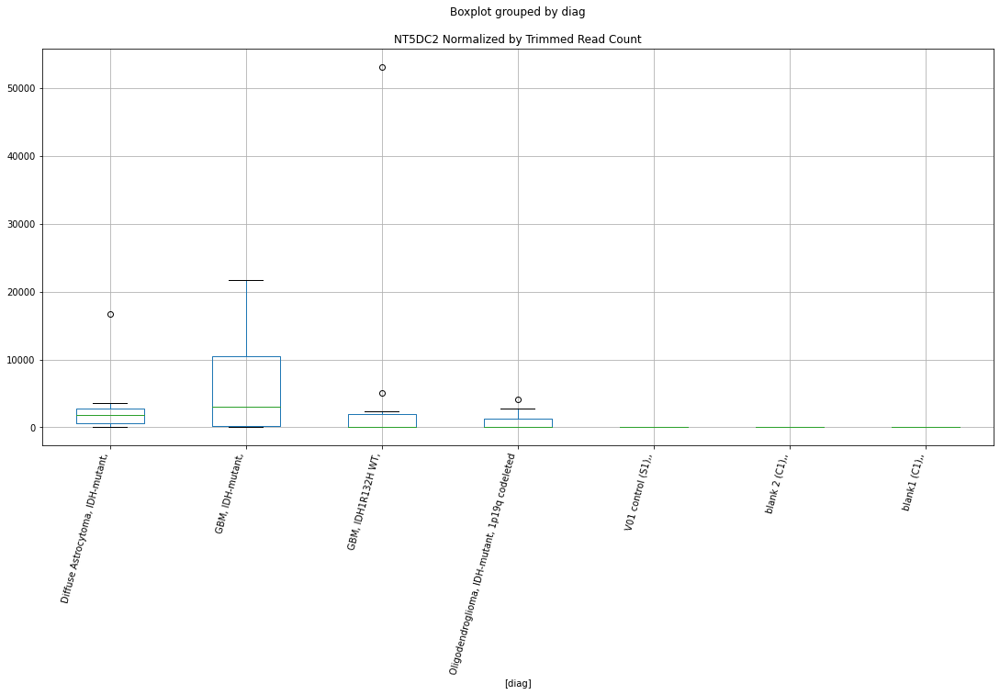

 p : 0.038868619725033166  ( t : 2.228053189215579 ) :  Lexogen  :  cutadapt2  :  MIR744
Control and blanks
82         0.00
346    37878.21
Name: MIR744, dtype: float64
214    0.0
Name: MIR744, dtype: float64
478    0.0
Name: MIR744, dtype: float64


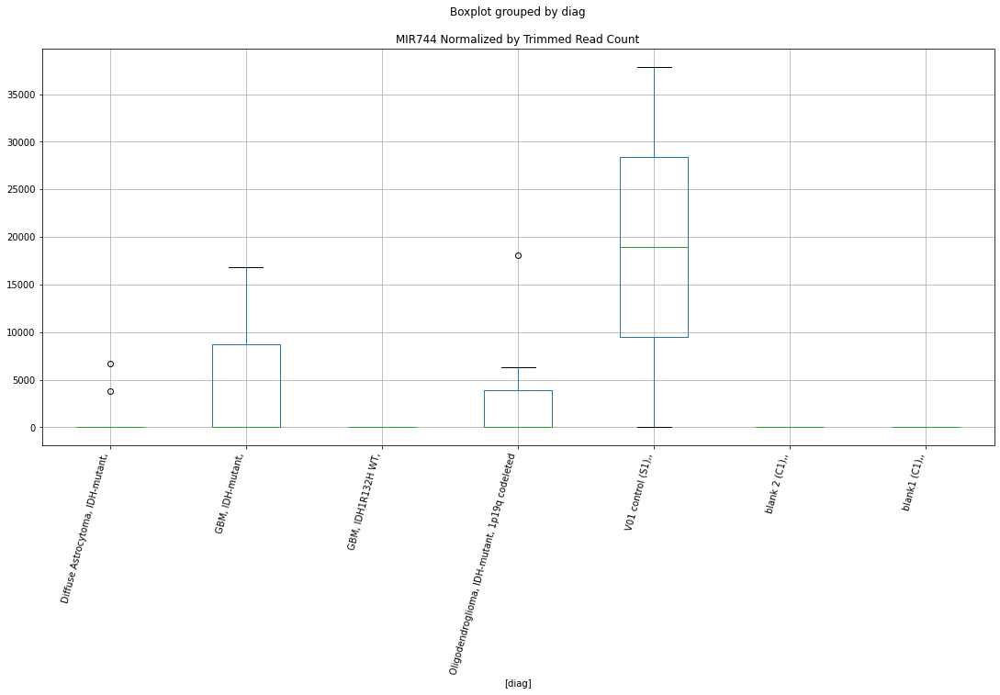

 p : 0.03889290218950345  ( t : 2.227741185976455 ) :  Lexogen  :  cutadapt2  :  MEGF8
Control and blanks
82     0.0
346    0.0
Name: MEGF8, dtype: float64
214    0.0
Name: MEGF8, dtype: float64
478    9023.5
Name: MEGF8, dtype: float64


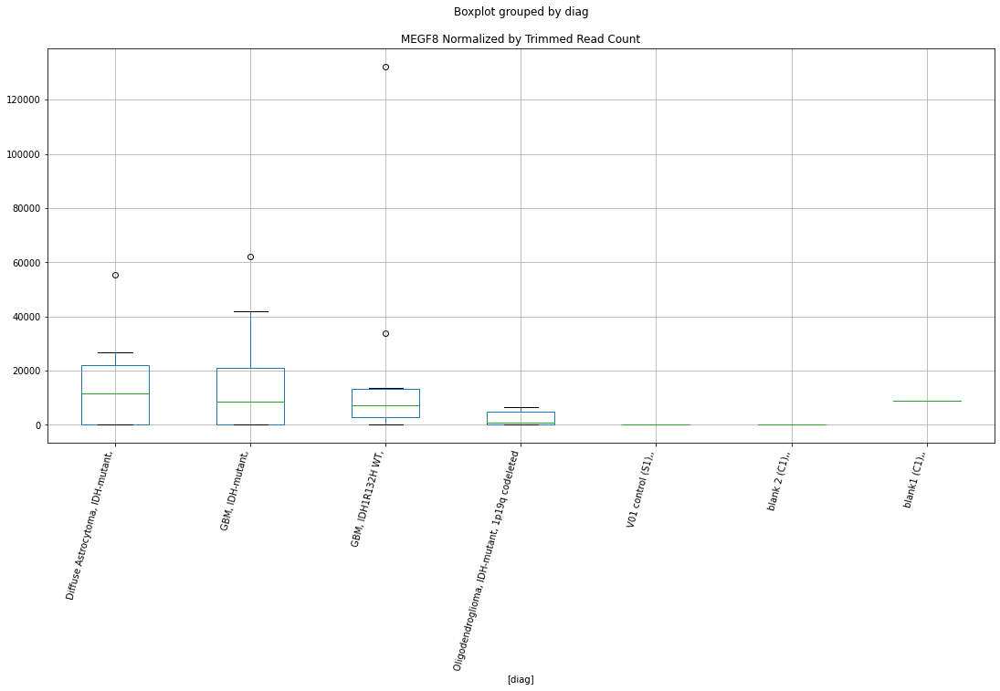

 p : 0.03889311185277354  ( t : 2.2277384928128505 ) :  Lexogen  :  bbduk2  :  MIR744
Control and blanks
79         0.00
343    37791.95
Name: MIR744, dtype: float64
211    0.0
Name: MIR744, dtype: float64
475    0.0
Name: MIR744, dtype: float64


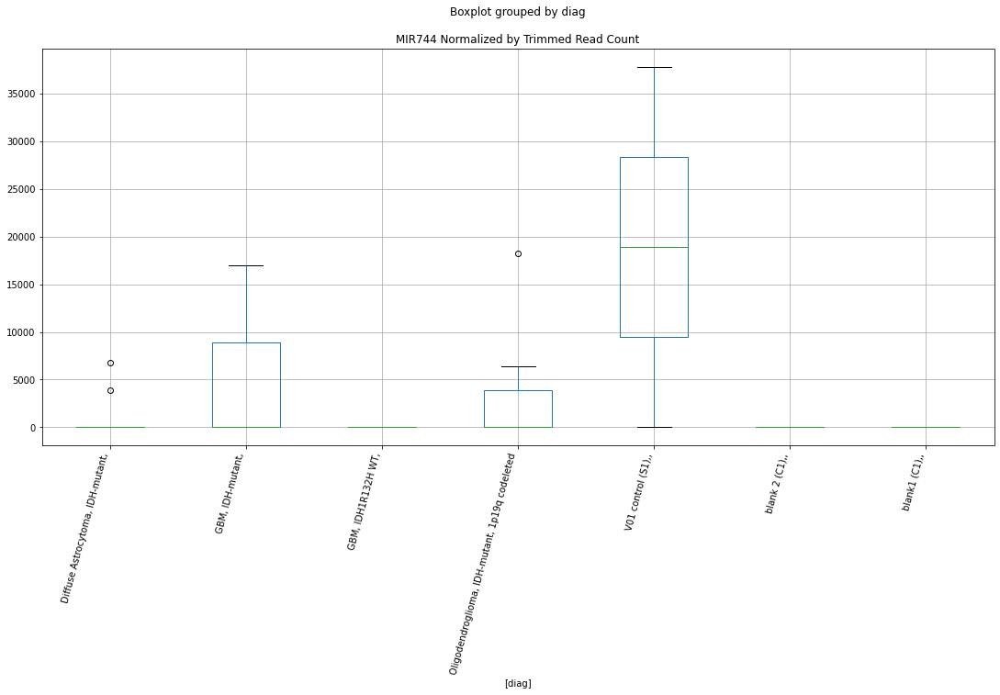

 p : 0.03908832711286273  ( t : 2.2252366989847157 ) :  D-plex  :  bbduk2  :  NEGR1
Control and blanks
73     773.01
337    890.16
Name: NEGR1, dtype: float64
205    1790.91
Name: NEGR1, dtype: float64
469    2366.11
Name: NEGR1, dtype: float64


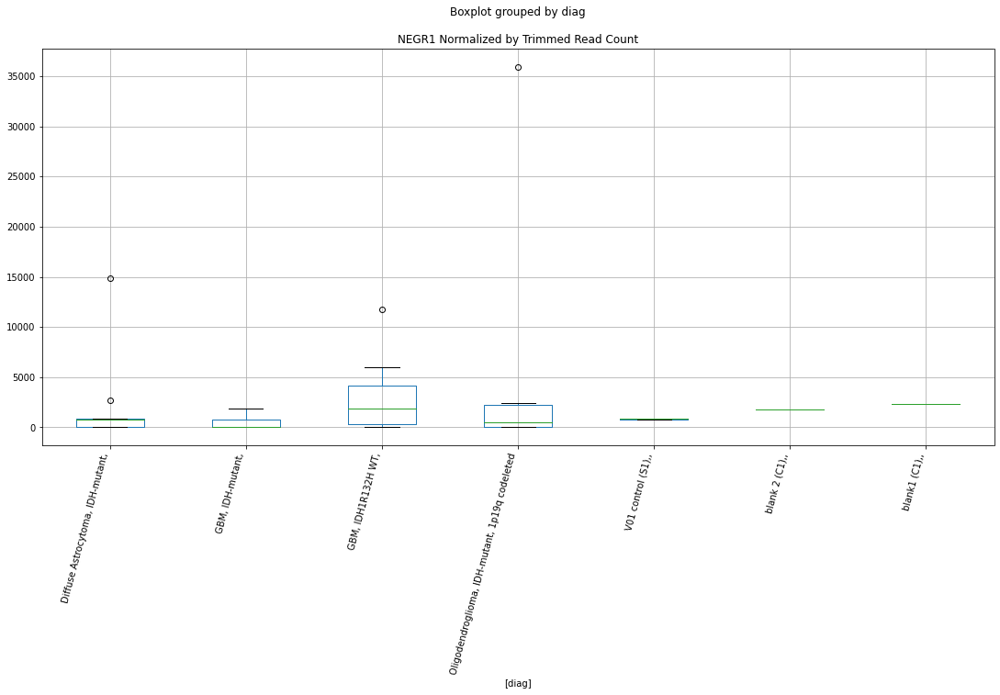

 p : 0.03915259277695895  ( t : 2.224415614728339 ) :  D-plex  :  cutadapt2  :  MICOS13
Control and blanks
76      1515.23
340    36990.75
Name: MICOS13, dtype: float64
208    1410.88
Name: MICOS13, dtype: float64
472    0.0
Name: MICOS13, dtype: float64


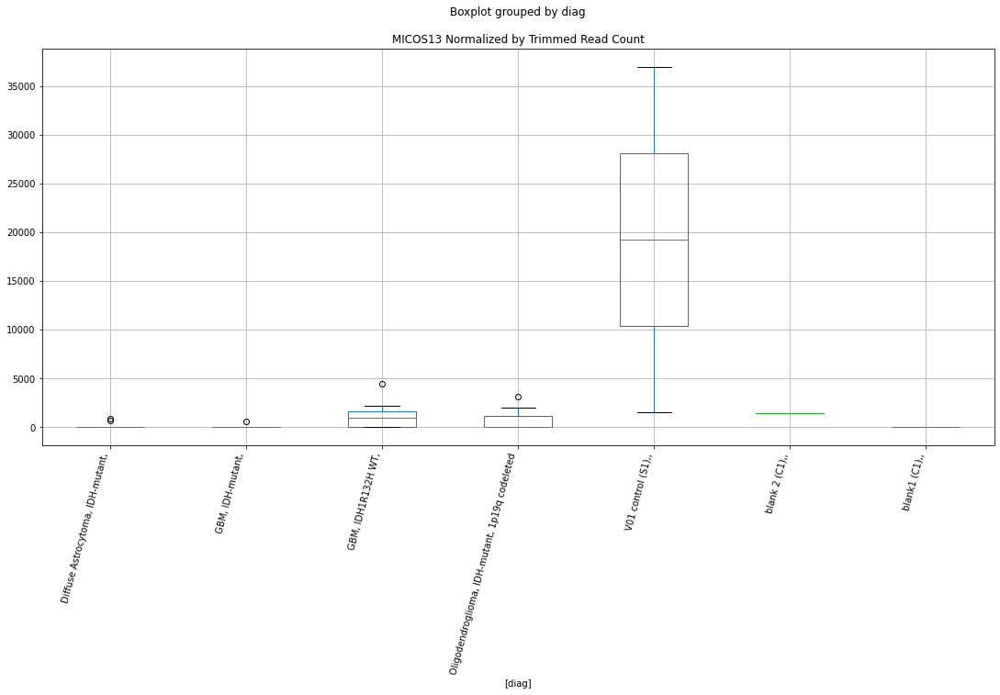

 p : 0.039280541388887744  ( t : 2.2227845785825693 ) :  D-plex  :  bbduk2  :  LRRC73
Control and blanks
73     0.0
337    0.0
Name: LRRC73, dtype: float64
205    0.0
Name: LRRC73, dtype: float64
469    591.53
Name: LRRC73, dtype: float64


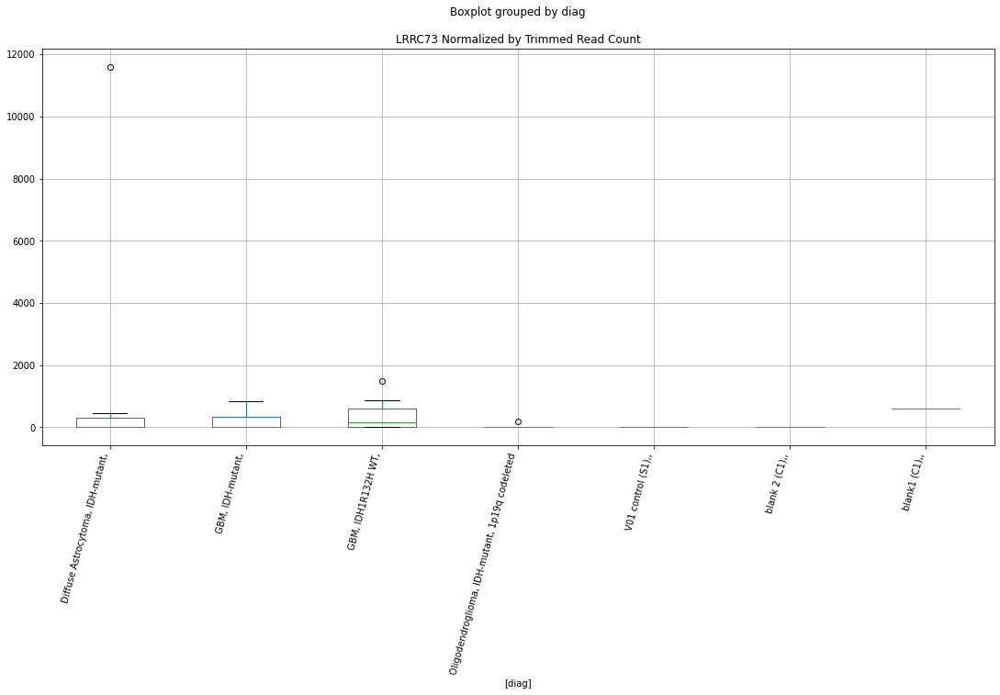

 p : 0.0392833899640424  ( t : 2.22274832180122 ) :  D-plex  :  cutadapt2  :  LRRC41
Control and blanks
76     0.0
340    0.0
Name: LRRC41, dtype: float64
208    1587.24
Name: LRRC41, dtype: float64
472    1733.87
Name: LRRC41, dtype: float64


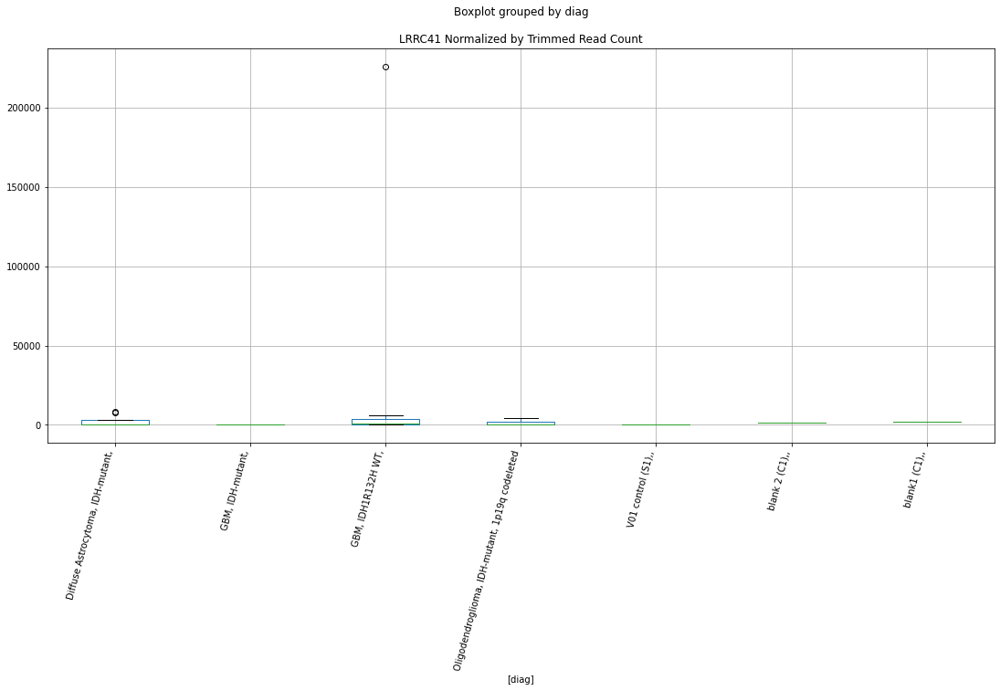

 p : 0.03930079974215415  ( t : 2.222526782008559 ) :  D-plex  :  cutadapt2  :  MYPOP
Control and blanks
76      6818.53
340    26421.96
Name: MYPOP, dtype: float64
208    10228.89
Name: MYPOP, dtype: float64
472    10981.16
Name: MYPOP, dtype: float64


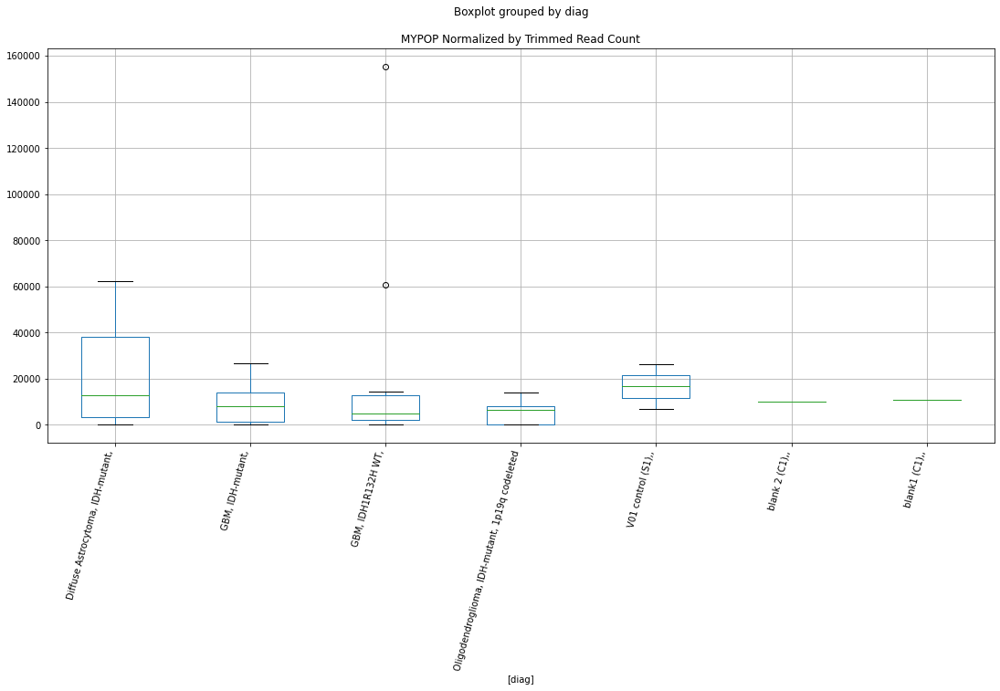

 p : 0.03932977387145936  ( t : 2.222158285782545 ) :  Lexogen  :  bbduk2  :  NUP98
Control and blanks
79     17167.19
343        0.00
Name: NUP98, dtype: float64
211    0.0
Name: NUP98, dtype: float64
475    0.0
Name: NUP98, dtype: float64


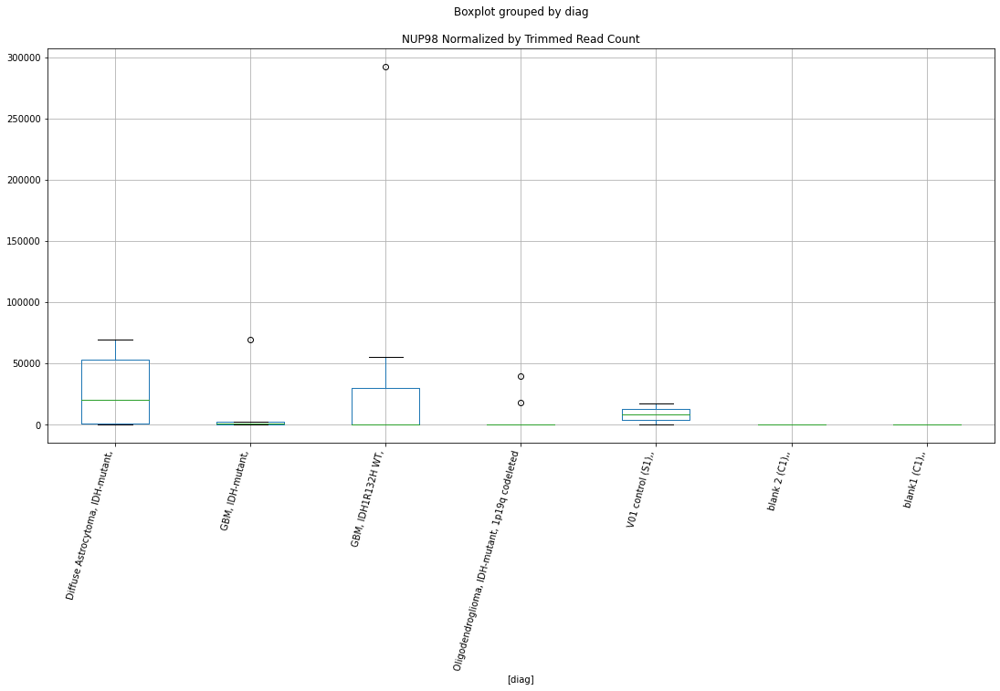

 p : 0.03936543458462813  ( t : 2.2217050916816765 ) :  D-plex  :  bbduk2  :  NR6A1
Control and blanks
73     0.0
337    0.0
Name: NR6A1, dtype: float64
205    1611.82
Name: NR6A1, dtype: float64
469    0.0
Name: NR6A1, dtype: float64


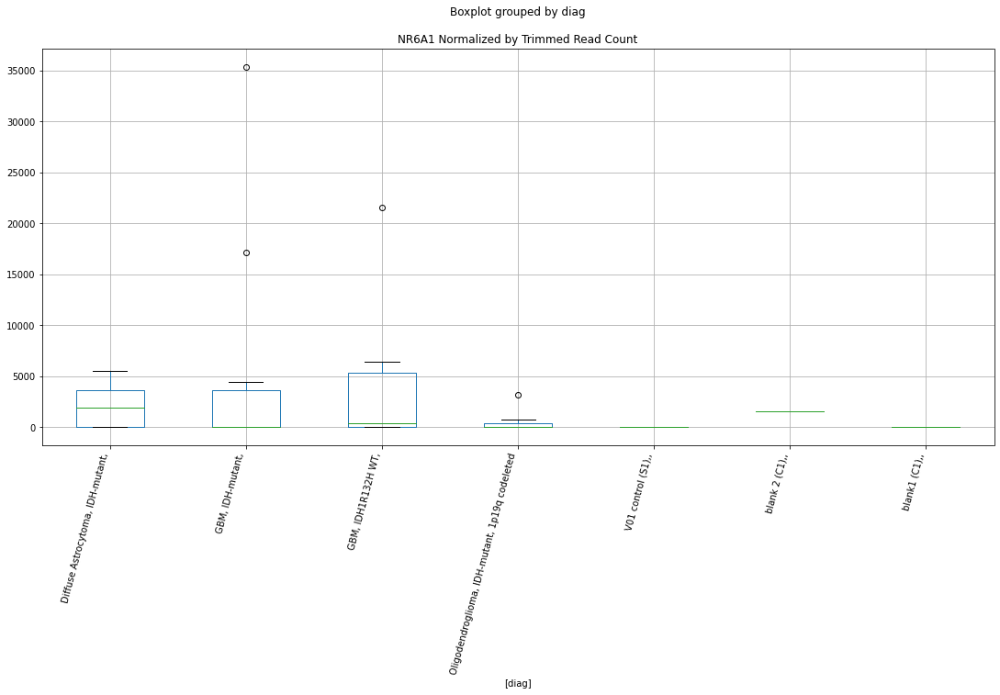

 p : 0.03946222899435721  ( t : 2.2204768820596272 ) :  D-plex  :  cutadapt2  :  LRRC73
Control and blanks
76     0.0
340    0.0
Name: LRRC73, dtype: float64
208    0.0
Name: LRRC73, dtype: float64
472    577.96
Name: LRRC73, dtype: float64


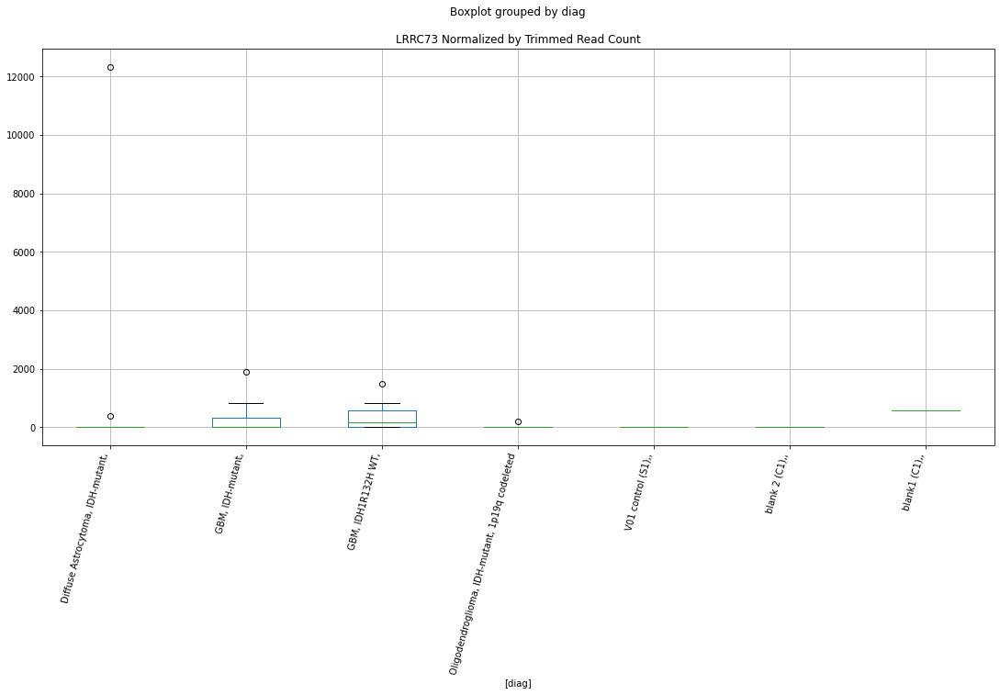

 p : 0.03949663462691286  ( t : 2.2200409819739284 ) :  D-plex  :  bbduk2  :  LPIN3
Control and blanks
73     0.0
337    0.0
Name: LPIN3, dtype: float64
205    6984.55
Name: LPIN3, dtype: float64
469    37266.22
Name: LPIN3, dtype: float64


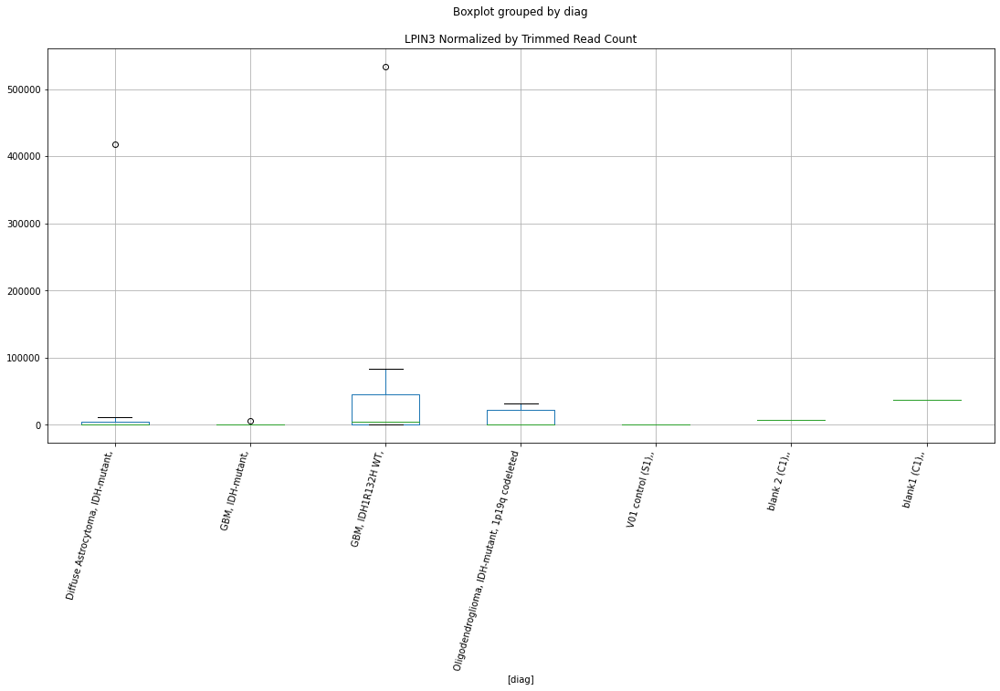

 p : 0.03950132928420641  ( t : 2.2199815303905632 ) :  Lexogen  :  bbduk2  :  MIR16-2
Control and blanks
79          0.00
343    171337.65
Name: MIR16-2, dtype: float64
211    1093.23
Name: MIR16-2, dtype: float64
475    479.03
Name: MIR16-2, dtype: float64


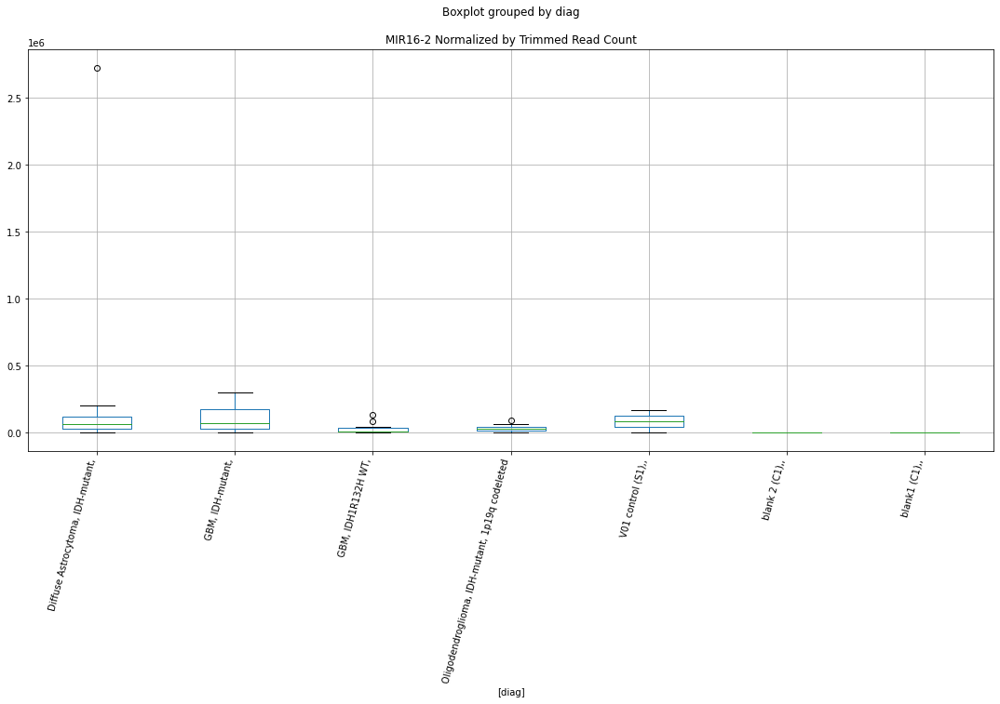

 p : 0.03954020615052205  ( t : 2.219489456346616 ) :  D-plex  :  cutadapt2  :  LOC112268467
Control and blanks
76     0.0
340    0.0
Name: LOC112268467, dtype: float64
208    176.36
Name: LOC112268467, dtype: float64
472    0.0
Name: LOC112268467, dtype: float64


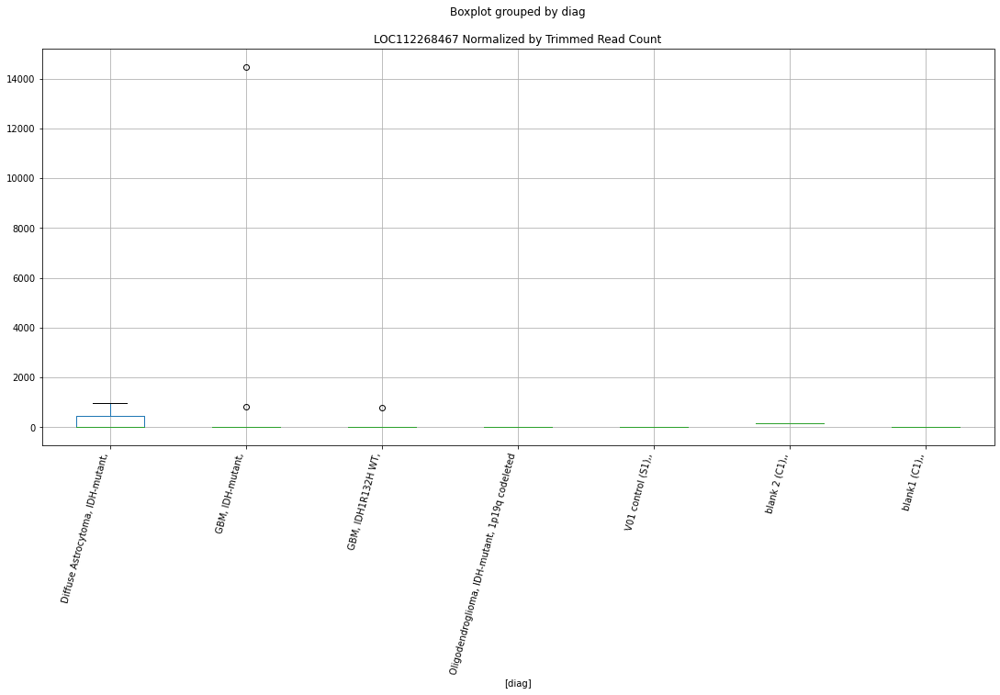

 p : 0.03956924764583352  ( t : 2.219122161416651 ) :  Lexogen  :  cutadapt2  :  MIR16-2
Control and blanks
82          0.00
346    170451.96
Name: MIR16-2, dtype: float64
214    1084.91
Name: MIR16-2, dtype: float64
478    474.92
Name: MIR16-2, dtype: float64


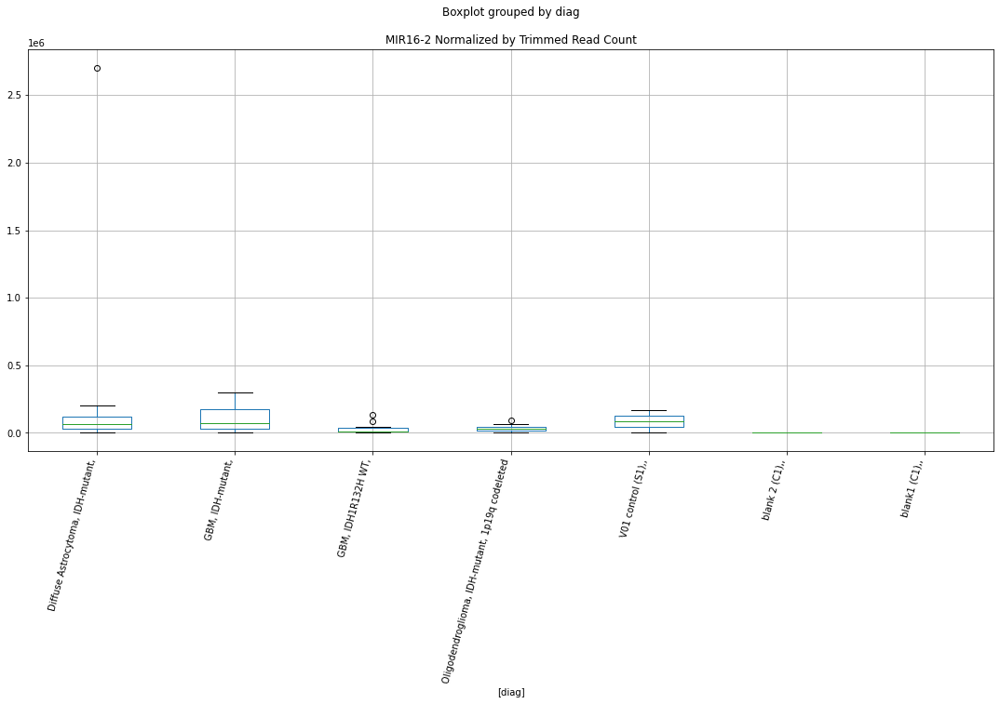

 p : 0.03957596849433666  ( t : 2.219037196537454 ) :  D-plex  :  bbduk2  :  LRRC41
Control and blanks
73     0.0
337    0.0
Name: LRRC41, dtype: float64
205    1611.82
Name: LRRC41, dtype: float64
469    1774.58
Name: LRRC41, dtype: float64


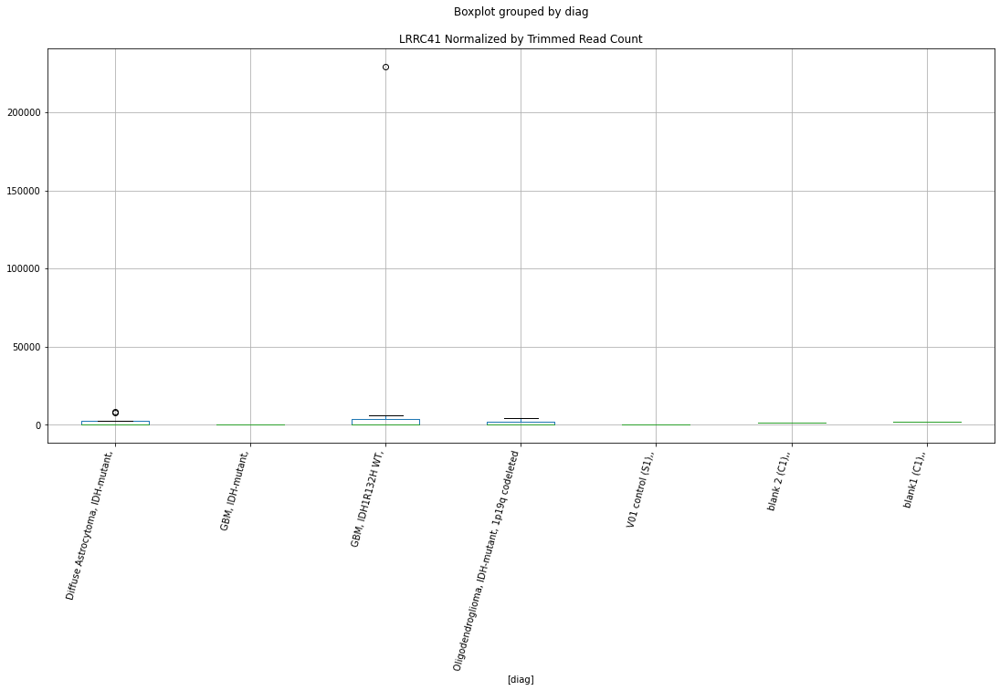

 p : 0.03961024124489727  ( t : 2.218604127231175 ) :  D-plex  :  bbduk2  :  MIR4435-2HG
Control and blanks
73     0.0
337    0.0
Name: MIR4435-2HG, dtype: float64
205    537.27
Name: MIR4435-2HG, dtype: float64
469    0.0
Name: MIR4435-2HG, dtype: float64


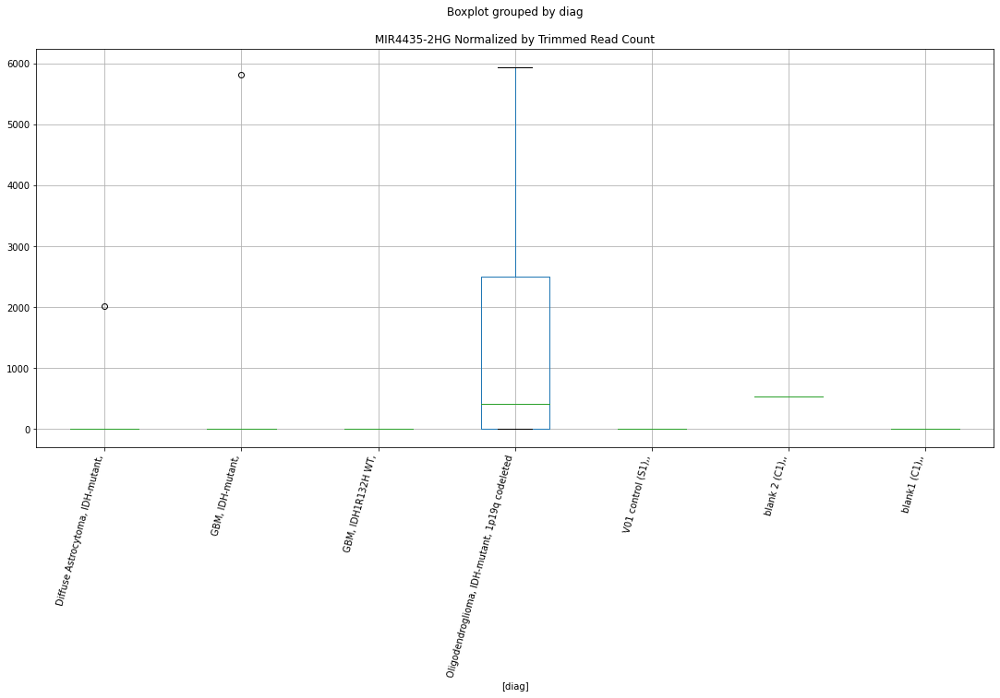

 p : 0.04001259998231722  ( t : 2.2135455518842355 ) :  D-plex  :  bbduk2  :  NPR3
Control and blanks
73     6957.08
337       0.00
Name: NPR3, dtype: float64
205    3940.0
Name: NPR3, dtype: float64
469    3549.16
Name: NPR3, dtype: float64


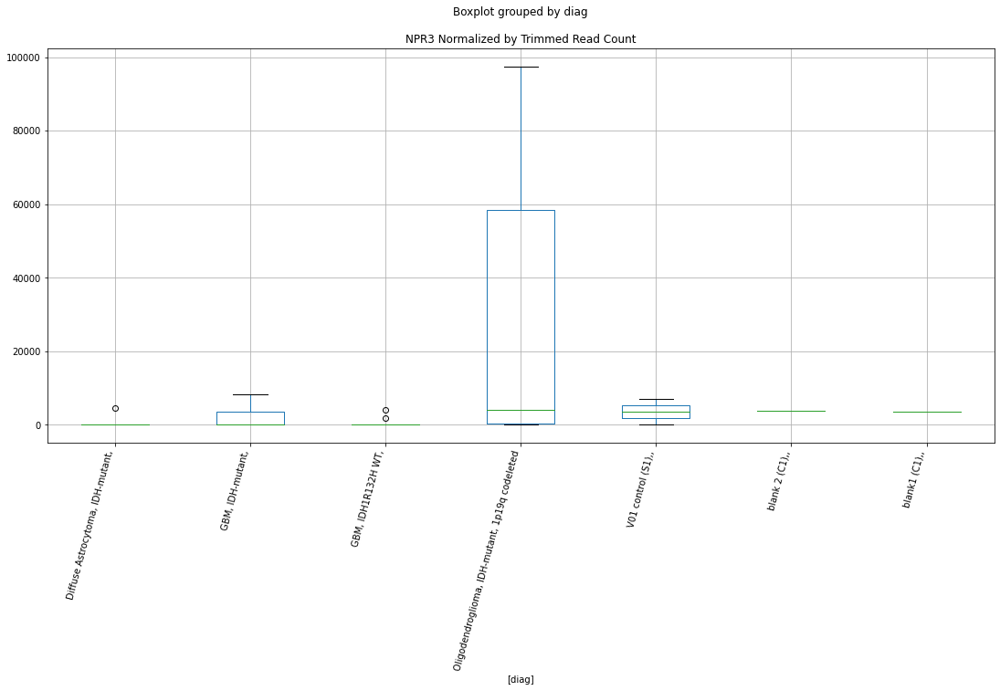

 p : 0.04007159744262531  ( t : 2.212807754470647 ) :  Lexogen  :  cutadapt2  :  NKPD1
Control and blanks
82     0.0
346    0.0
Name: NKPD1, dtype: float64
214    0.0
Name: NKPD1, dtype: float64
478    0.0
Name: NKPD1, dtype: float64


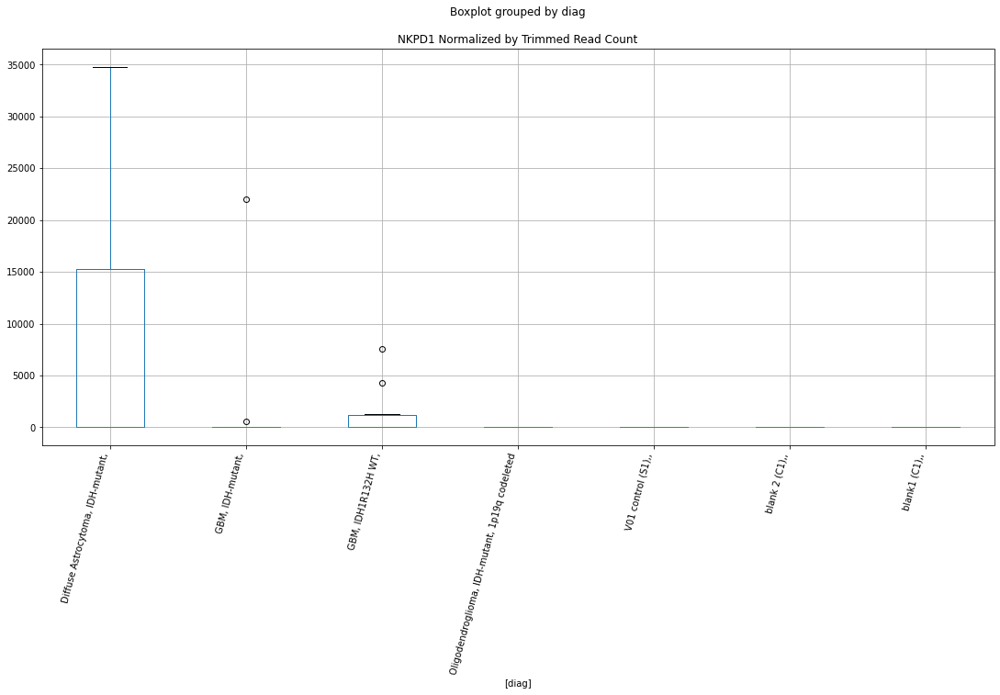

 p : 0.04011356880155891  ( t : 2.2122834861420255 ) :  Lexogen  :  bbduk2  :  MIR30A
Control and blanks
79     0.0
343    0.0
Name: MIR30A, dtype: float64
211    0.0
Name: MIR30A, dtype: float64
475    0.0
Name: MIR30A, dtype: float64


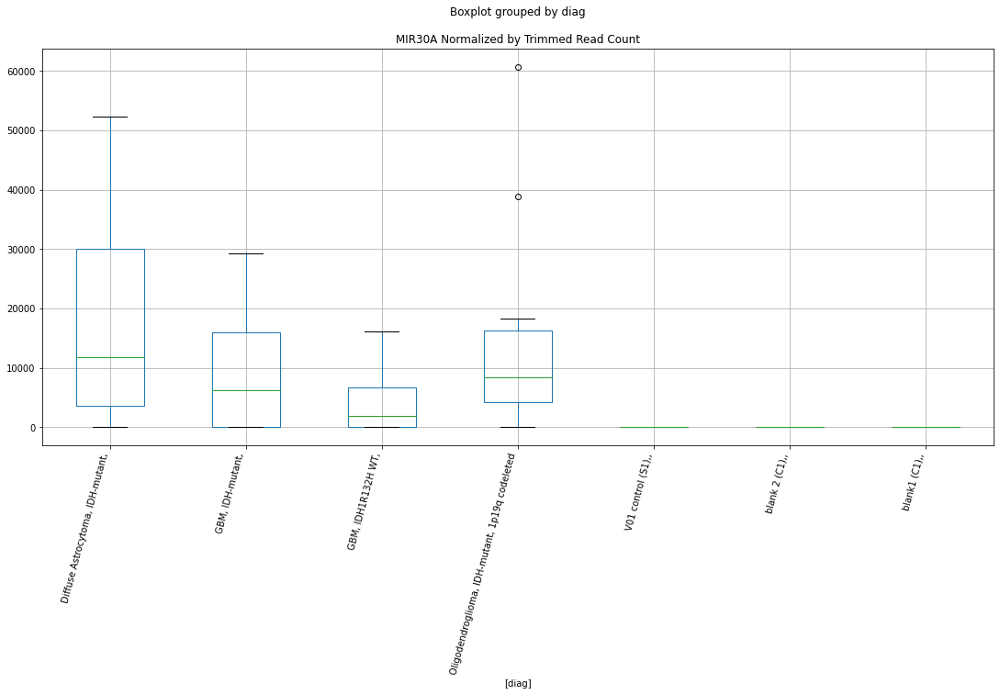

 p : 0.040117052618963124  ( t : 2.2122399921141502 ) :  Lexogen  :  bbduk2  :  NKPD1
Control and blanks
79     0.0
343    0.0
Name: NKPD1, dtype: float64
211    0.0
Name: NKPD1, dtype: float64
475    0.0
Name: NKPD1, dtype: float64


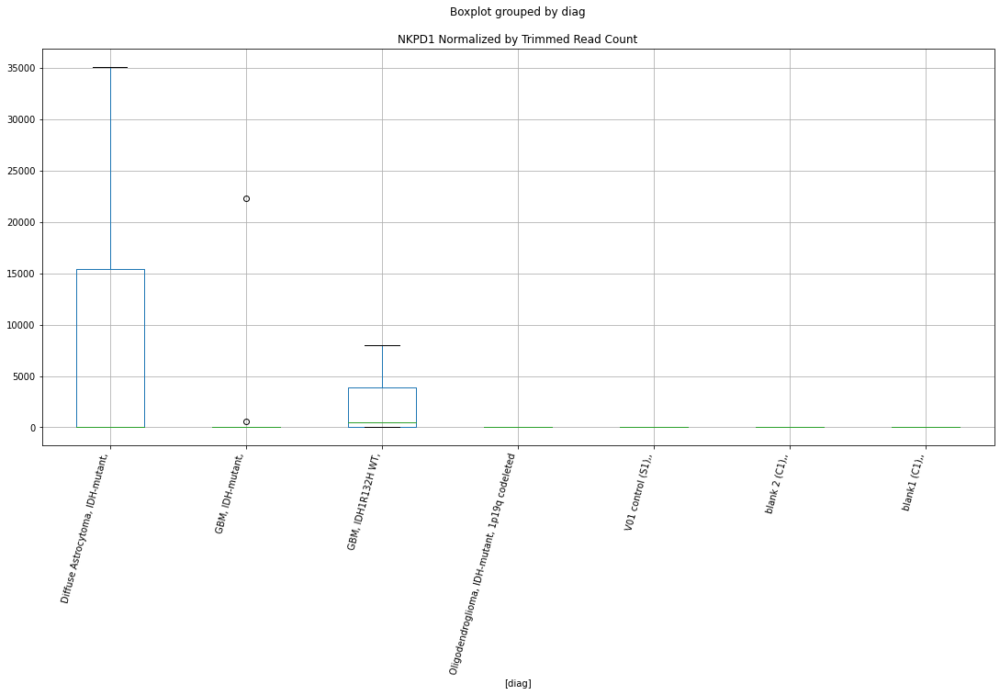

 p : 0.04012671236667676  ( t : 2.212119412298482 ) :  Lexogen  :  cutadapt2  :  NRDE2
Control and blanks
82       0.00
346    210.43
Name: NRDE2, dtype: float64
214    0.0
Name: NRDE2, dtype: float64
478    0.0
Name: NRDE2, dtype: float64


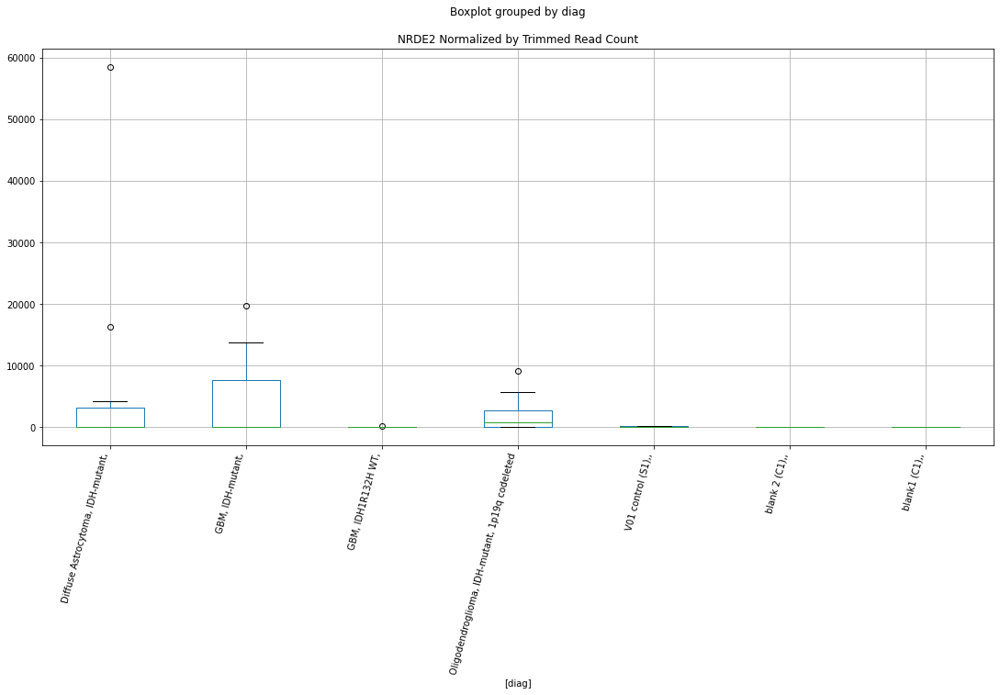

 p : 0.04015987305977752  ( t : 2.2117056800086385 ) :  Lexogen  :  bbduk2  :  MEGF8
Control and blanks
79     0.0
343    0.0
Name: MEGF8, dtype: float64
211    0.0
Name: MEGF8, dtype: float64
475    9101.6
Name: MEGF8, dtype: float64


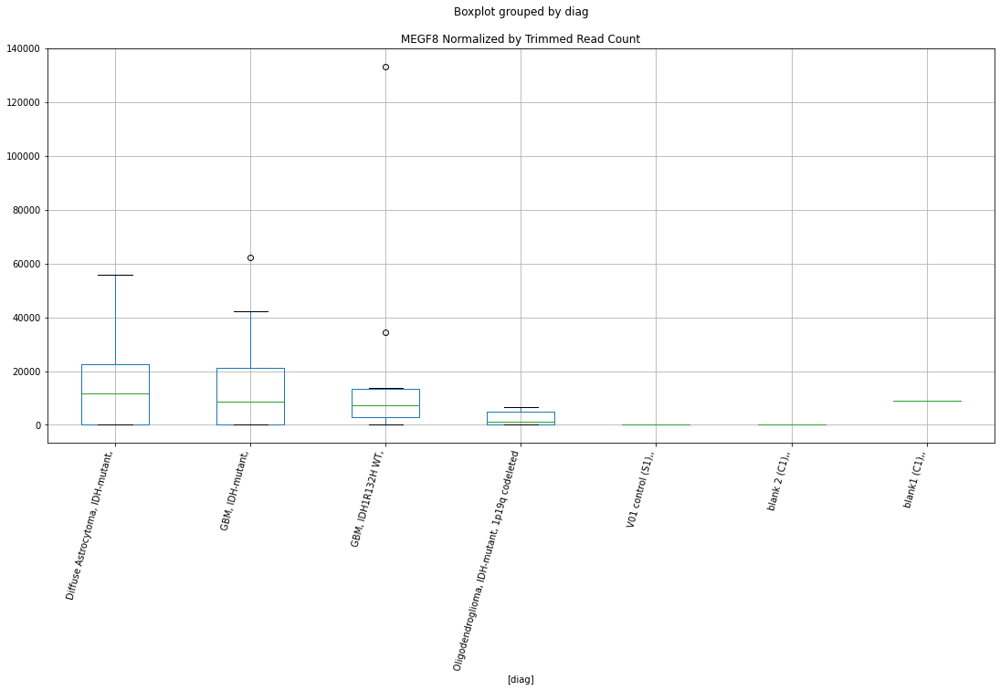

 p : 0.040232751933072936  ( t : 2.210797502982482 ) :  Lexogen  :  bbduk2  :  MAP2K6
Control and blanks
79     113017.30
343    116560.56
Name: MAP2K6, dtype: float64
211    12572.09
Name: MAP2K6, dtype: float64
475    4071.77
Name: MAP2K6, dtype: float64


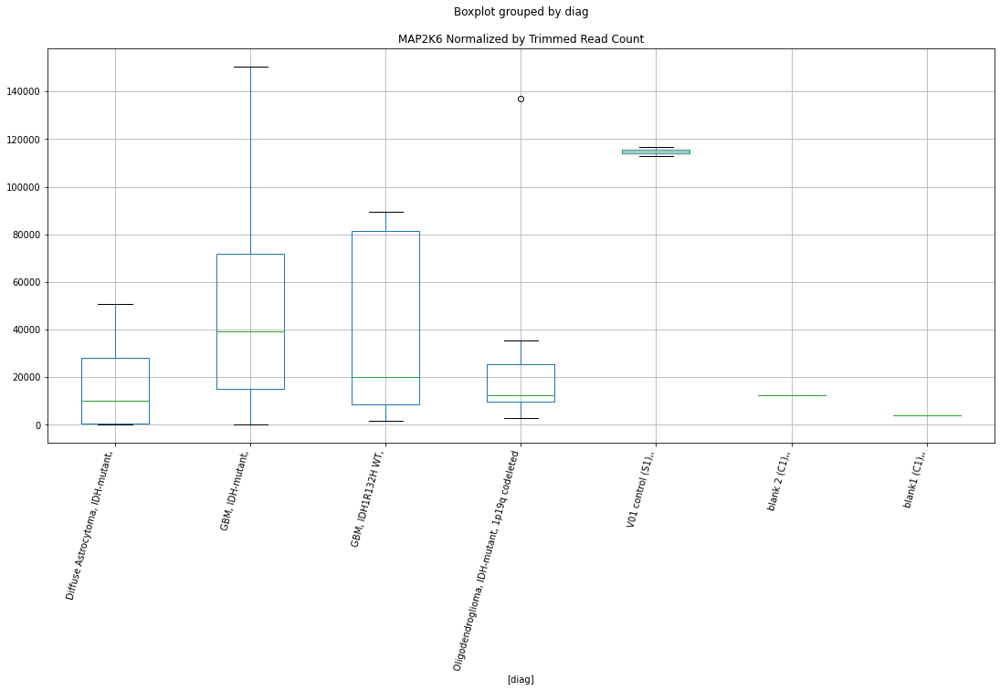

 p : 0.04029565950283478  ( t : 2.210014798329308 ) :  D-plex  :  cutadapt2  :  MCM2
Control and blanks
76     109096.45
340    226348.16
Name: MCM2, dtype: float64
208    21868.67
Name: MCM2, dtype: float64
472    356598.75
Name: MCM2, dtype: float64


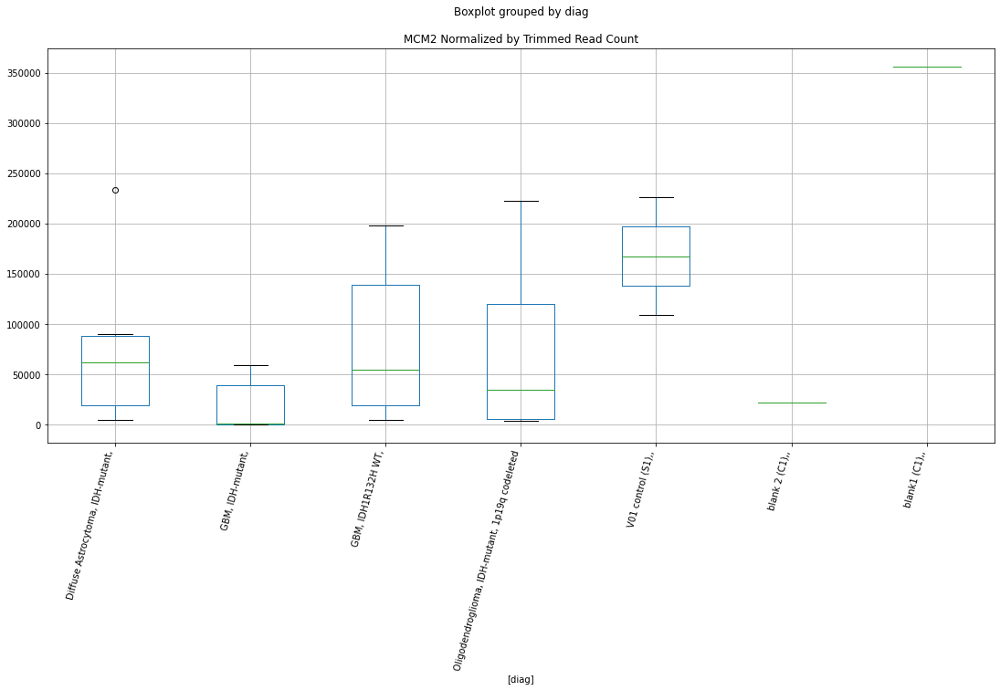

 p : 0.04035034556982862  ( t : 2.209335298902735 ) :  D-plex  :  cutadapt2  :  LOC107987258
Control and blanks
76     0.0
340    0.0
Name: LOC107987258, dtype: float64
208    705.44
Name: LOC107987258, dtype: float64
472    0.0
Name: LOC107987258, dtype: float64


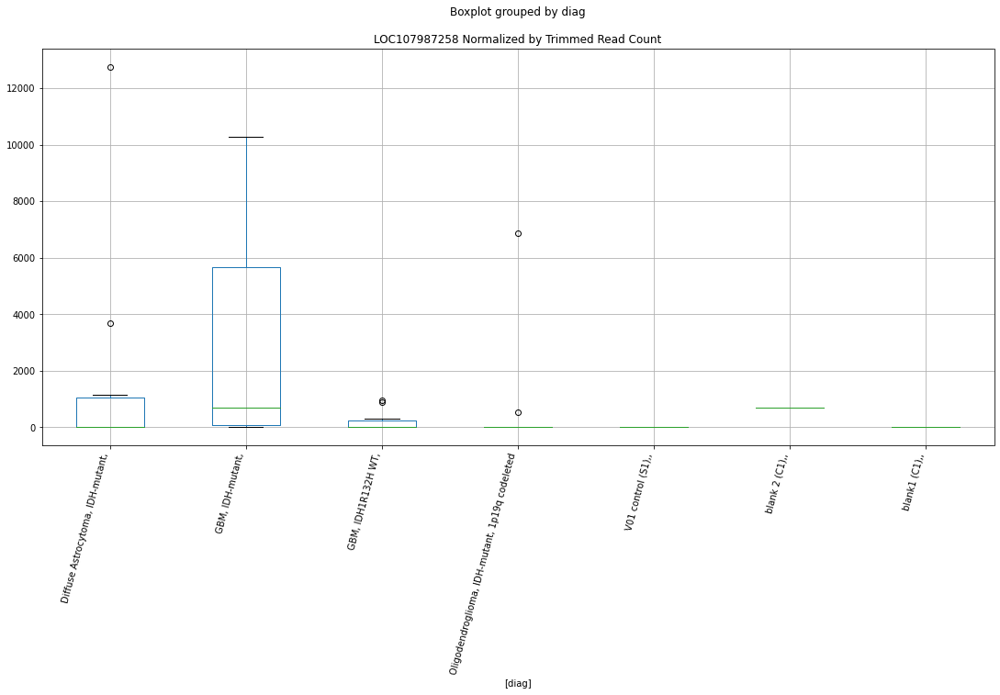

 p : 0.04041246066038019  ( t : 2.2085645165400725 ) :  D-plex  :  bbduk2  :  NRROS
Control and blanks
73     0.0
337    0.0
Name: NRROS, dtype: float64
205    179.09
Name: NRROS, dtype: float64
469    1183.05
Name: NRROS, dtype: float64


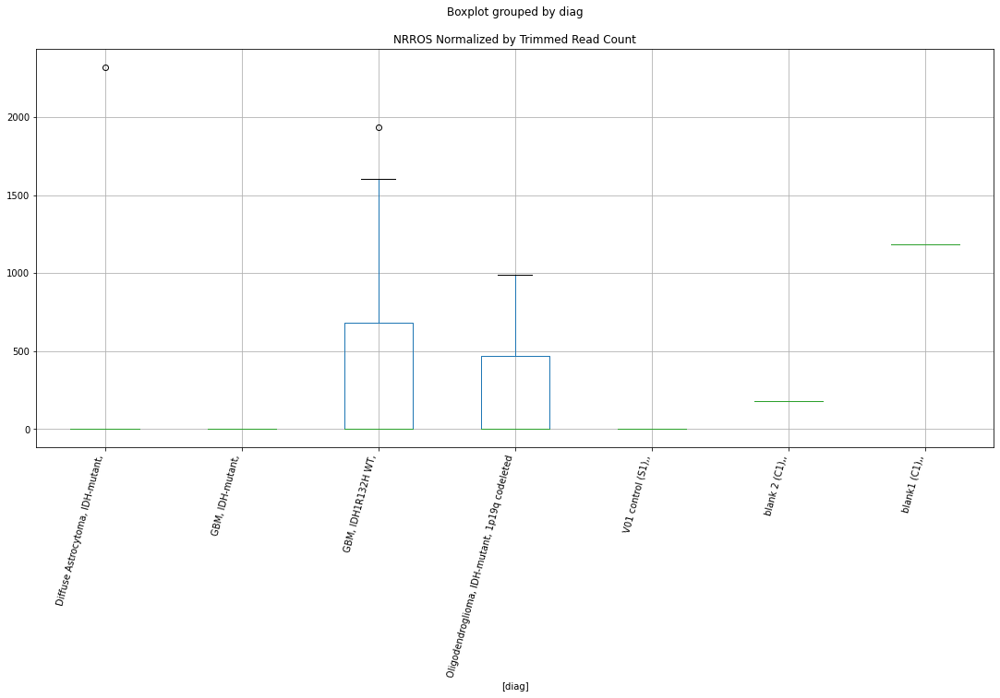

 p : 0.04042634953238662  ( t : 2.208392319353092 ) :  Lexogen  :  cutadapt2  :  MIR30A
Control and blanks
82     0.0
346    0.0
Name: MIR30A, dtype: float64
214    0.0
Name: MIR30A, dtype: float64
478    0.0
Name: MIR30A, dtype: float64


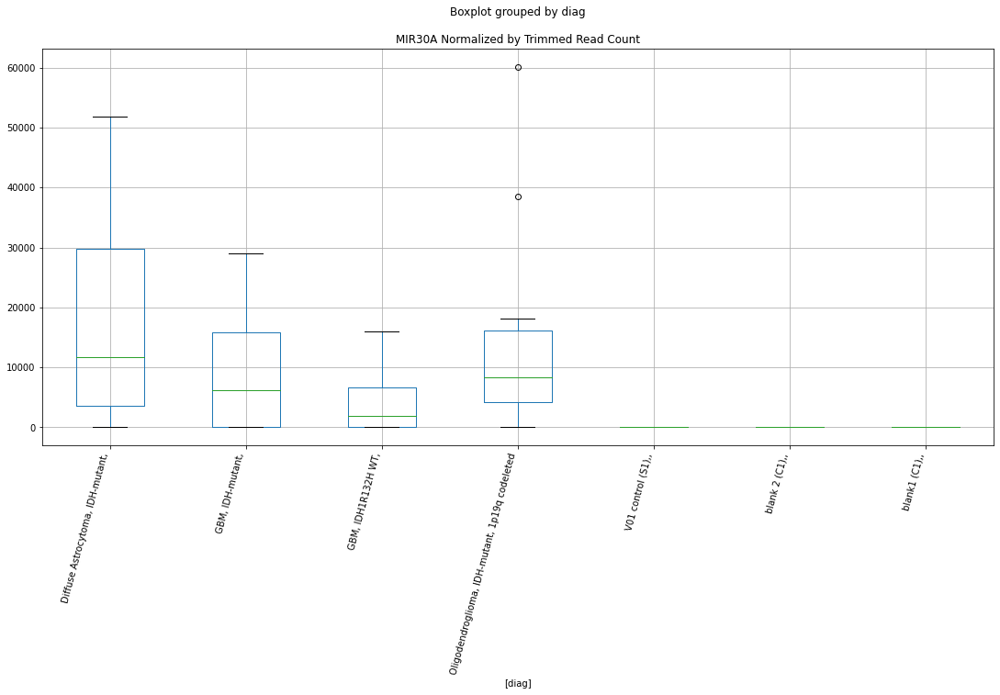

 p : 0.040521975313162206  ( t : 2.20720820445024 ) :  D-plex  :  bbduk2  :  NEXMIF
Control and blanks
73     0.0
337    0.0
Name: NEXMIF, dtype: float64
205    358.18
Name: NEXMIF, dtype: float64
469    591.53
Name: NEXMIF, dtype: float64


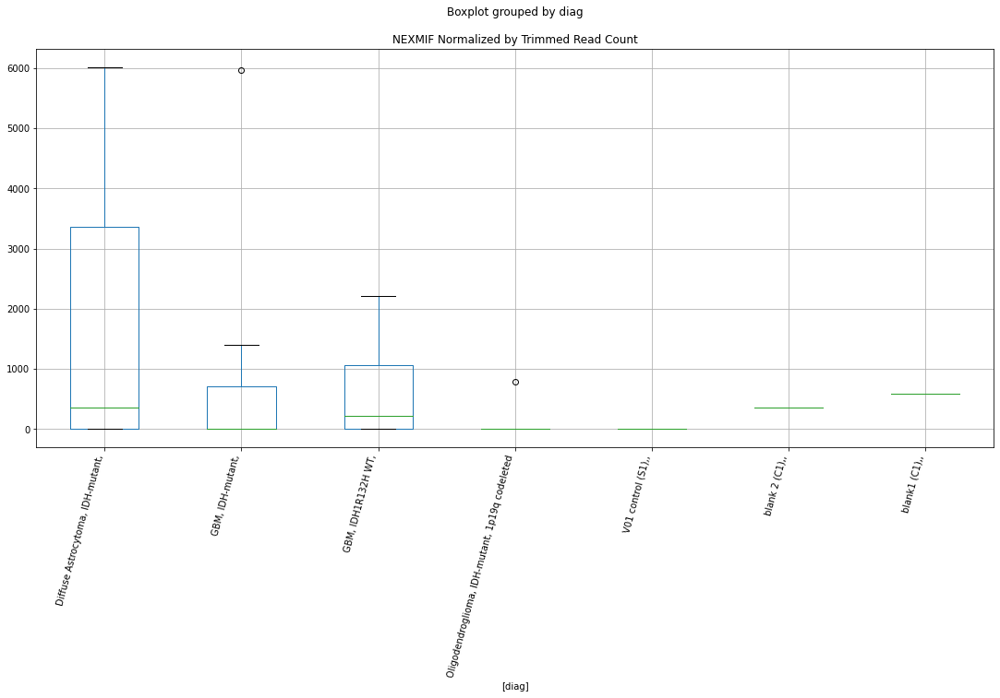

 p : 0.04054046272570493  ( t : 2.206979574811265 ) :  D-plex  :  cutadapt2  :  MRPL14
Control and blanks
76     0.0
340    0.0
Name: MRPL14, dtype: float64
208    16930.58
Name: MRPL14, dtype: float64
472    20806.41
Name: MRPL14, dtype: float64


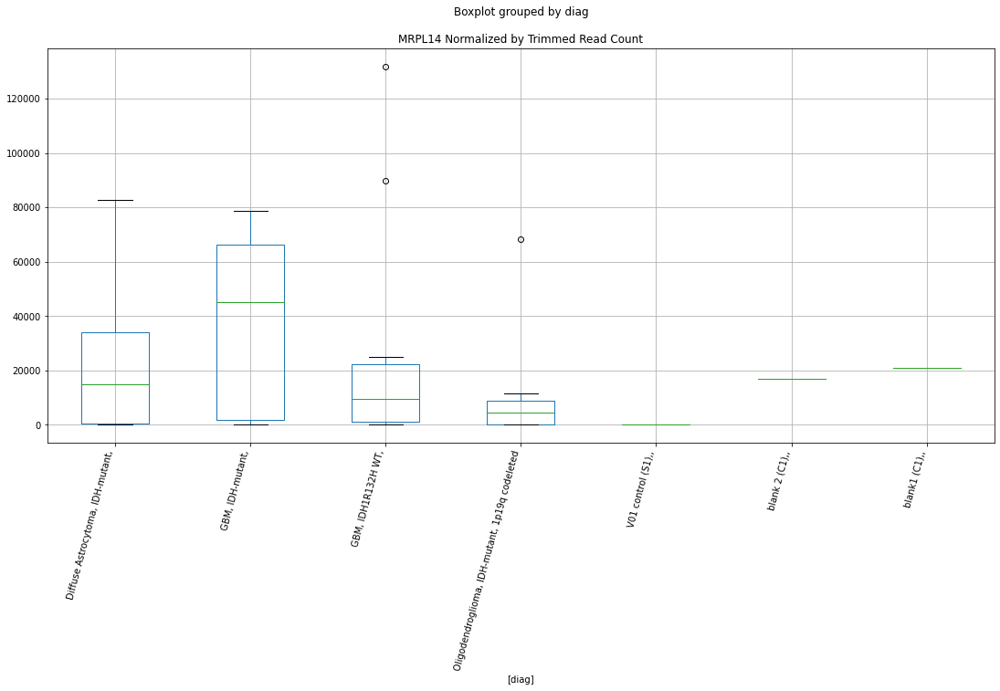

 p : 0.04063763299678515  ( t : 2.2057794650977436 ) :  D-plex  :  bbduk2  :  LRRC4
Control and blanks
73     0.0
337    0.0
Name: LRRC4, dtype: float64
205    5551.82
Name: LRRC4, dtype: float64
469    14196.66
Name: LRRC4, dtype: float64


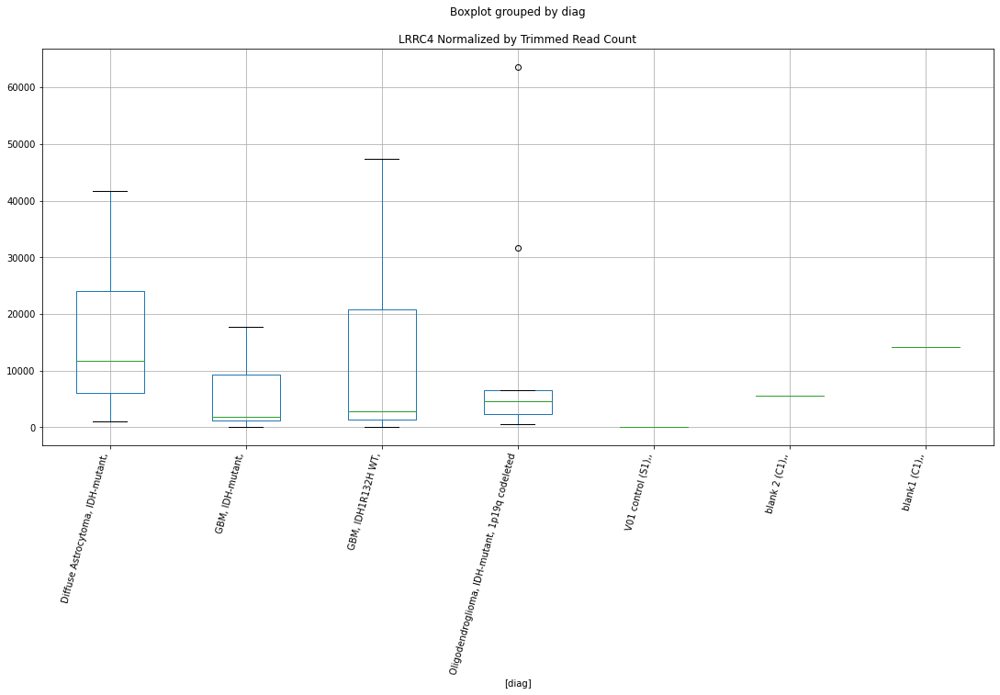

 p : 0.04072920305646542  ( t : 2.2046509321999177 ) :  D-plex  :  cutadapt2  :  MTAP
Control and blanks
76     0.0
340    0.0
Name: MTAP, dtype: float64
208    1410.88
Name: MTAP, dtype: float64
472    0.0
Name: MTAP, dtype: float64


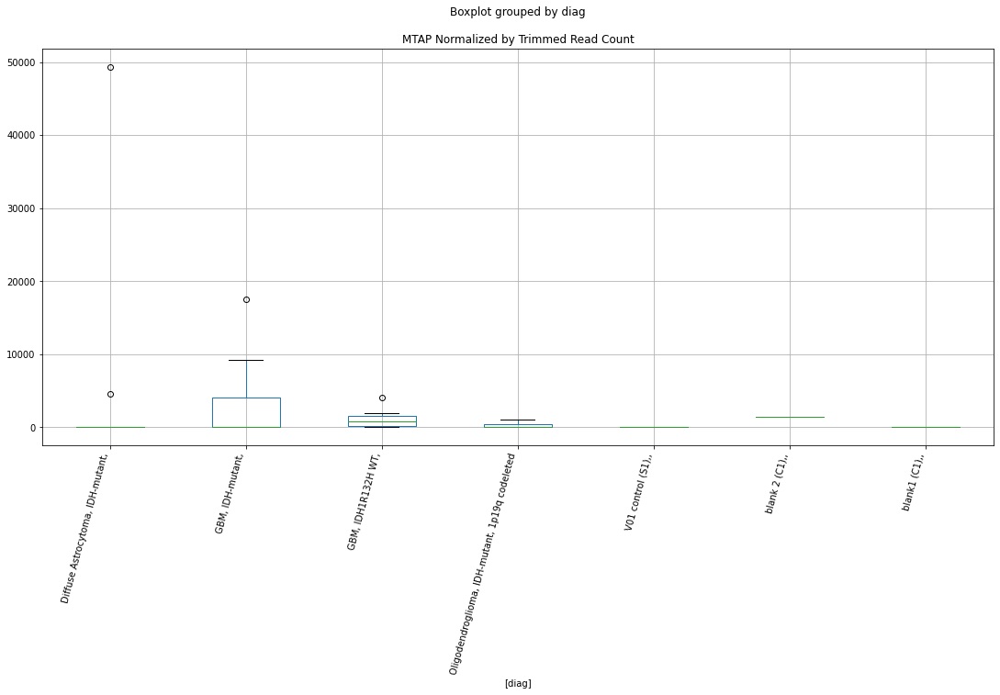

 p : 0.04077886941178862  ( t : 2.2040398060752207 ) :  D-plex  :  cutadapt2  :  MAP1S
Control and blanks
76     3030.46
340       0.00
Name: MAP1S, dtype: float64
208    7407.13
Name: MAP1S, dtype: float64
472    1155.91
Name: MAP1S, dtype: float64


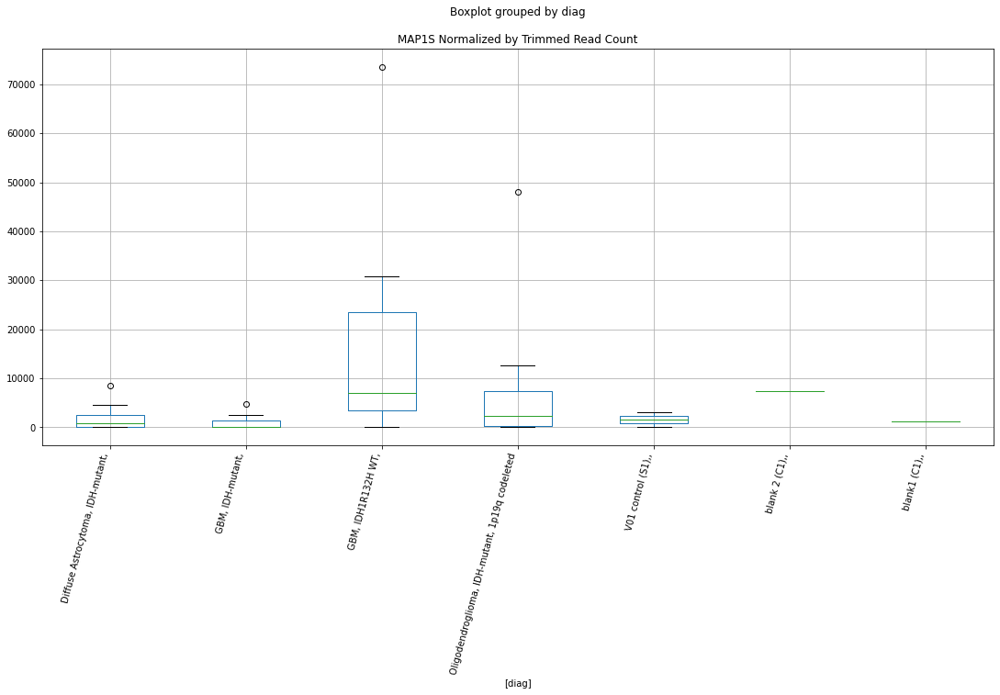

 p : 0.04080019842475258  ( t : 2.203777570336866 ) :  D-plex  :  bbduk2  :  LRRD1
Control and blanks
73      2319.03
337    14242.52
Name: LRRD1, dtype: float64
205    1611.82
Name: LRRD1, dtype: float64
469    4732.22
Name: LRRD1, dtype: float64


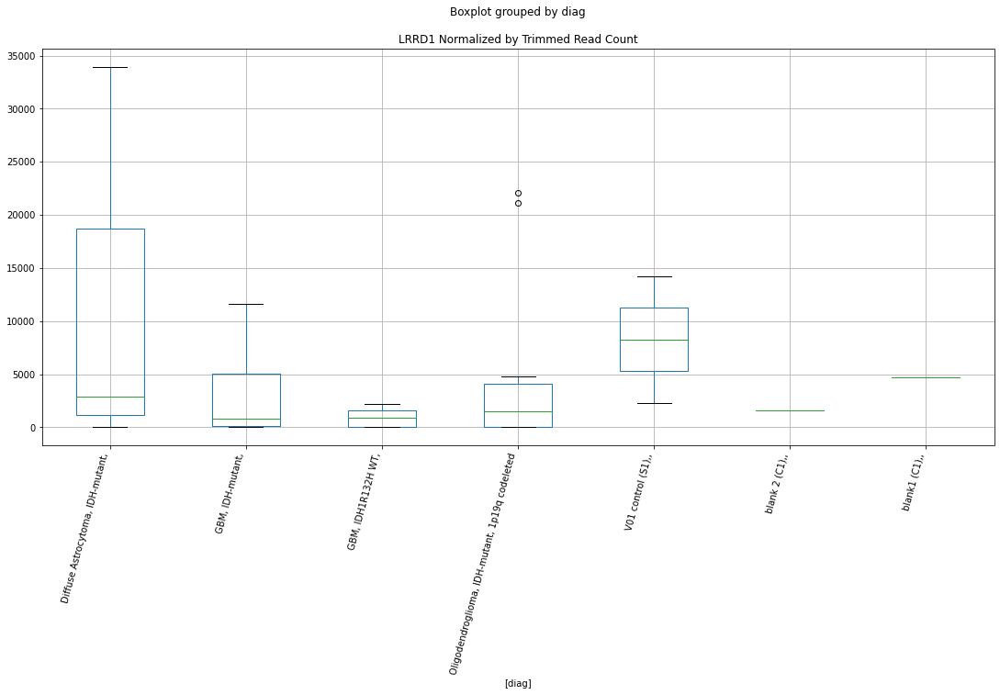

 p : 0.04089050126052814  ( t : 2.202668709466846 ) :  D-plex  :  cutadapt2  :  LOC107987261
Control and blanks
76         0.00
340    12330.25
Name: LOC107987261, dtype: float64
208    1058.16
Name: LOC107987261, dtype: float64
472    0.0
Name: LOC107987261, dtype: float64


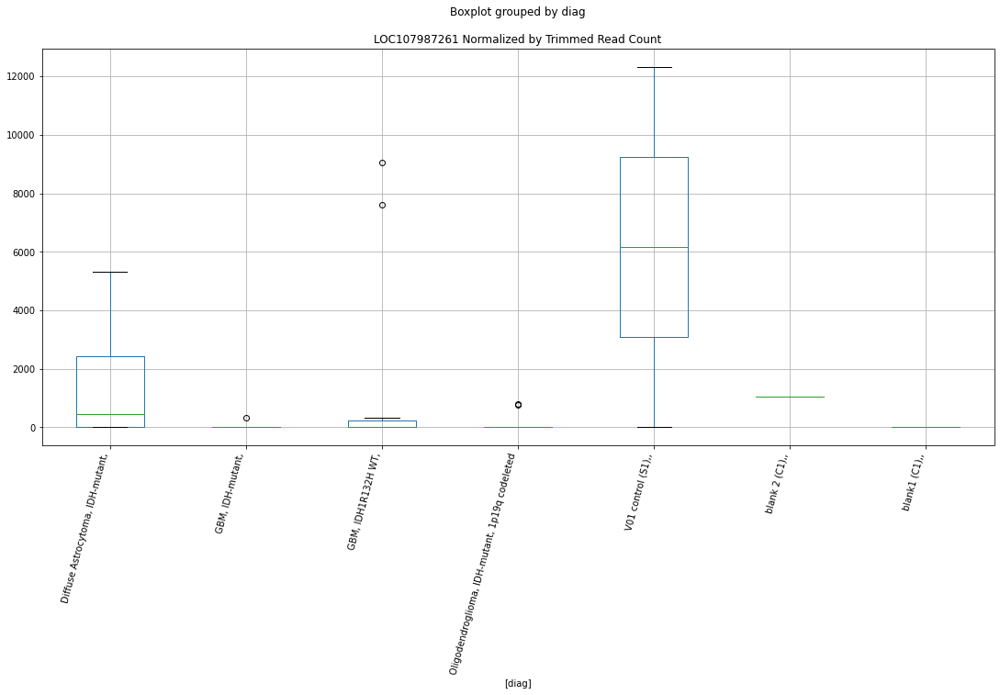

 p : 0.04093592187832585  ( t : 2.2021118234790618 ) :  D-plex  :  bbduk2  :  MRPL14
Control and blanks
73     0.0
337    0.0
Name: MRPL14, dtype: float64
205    17192.73
Name: MRPL14, dtype: float64
469    21294.98
Name: MRPL14, dtype: float64


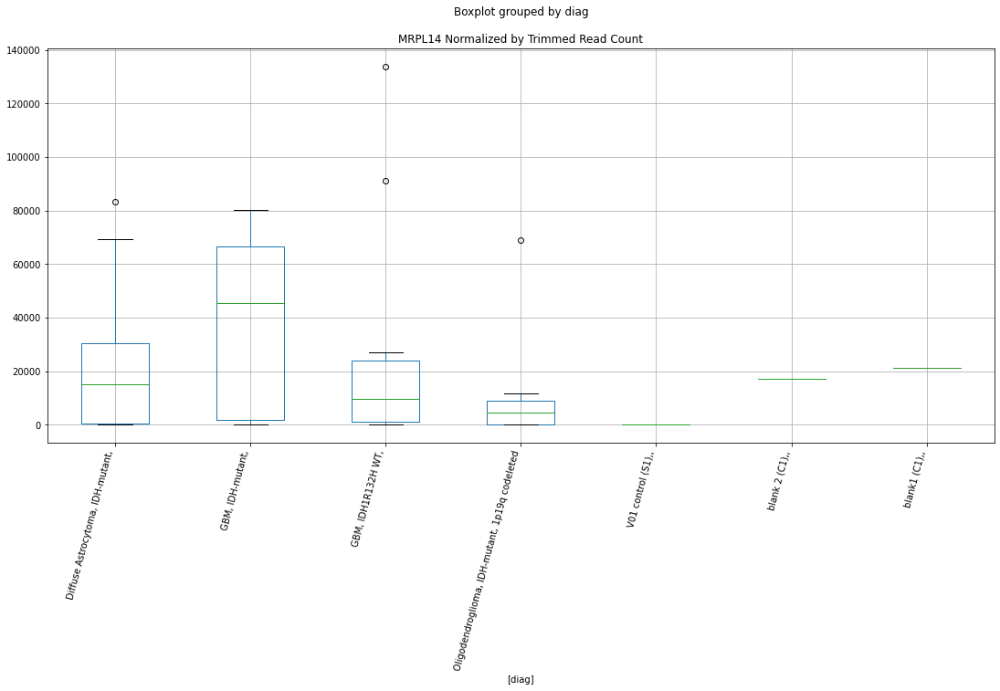

 p : 0.04098405864516794  ( t : 2.201522254927386 ) :  D-plex  :  cutadapt2  :  LOC112268313
Control and blanks
76     37880.71
340     2642.20
Name: LOC112268313, dtype: float64
208    6701.69
Name: LOC112268313, dtype: float64
472    7513.43
Name: LOC112268313, dtype: float64


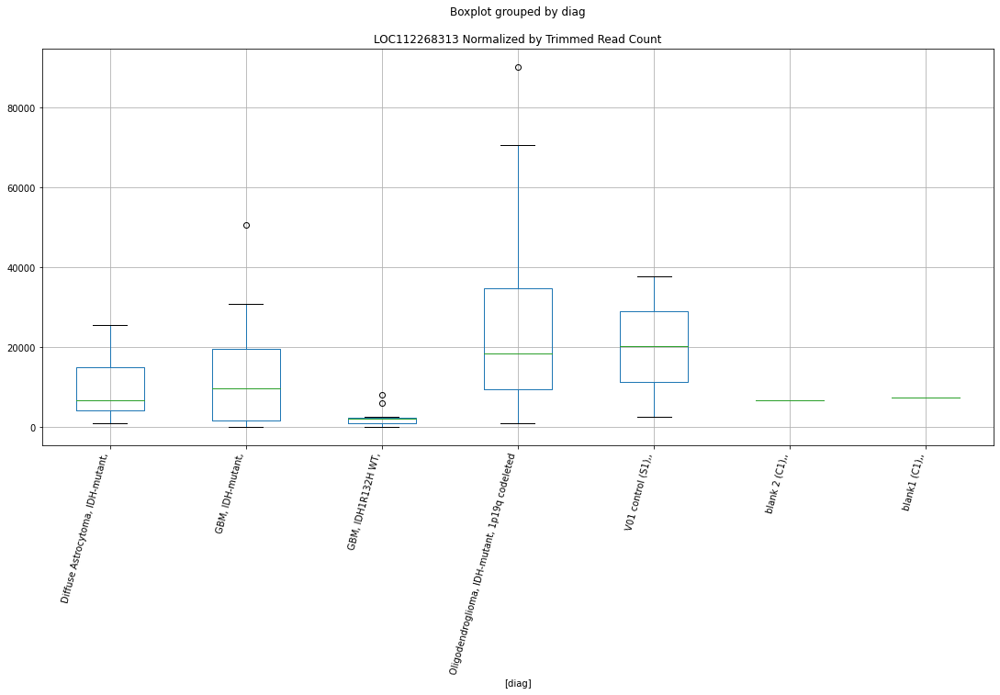

 p : 0.0410140130616256  ( t : 2.201155700776975 ) :  D-plex  :  bbduk2  :  NPR3
Control and blanks
73     6957.08
337       0.00
Name: NPR3, dtype: float64
205    3940.0
Name: NPR3, dtype: float64
469    3549.16
Name: NPR3, dtype: float64


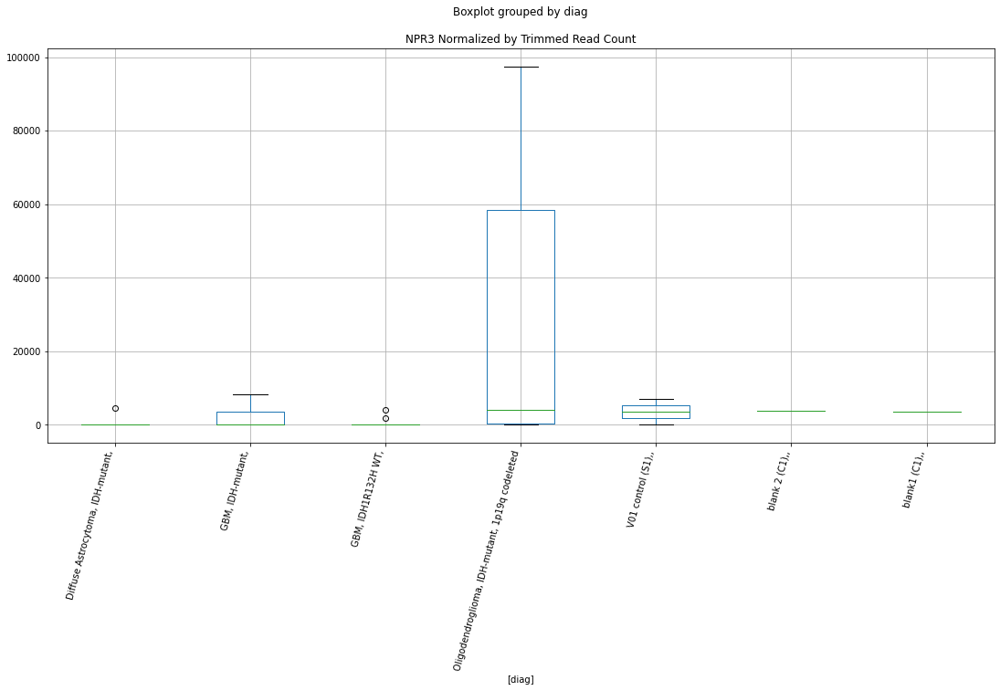

 p : 0.041088585304310685  ( t : 2.200244222311777 ) :  D-plex  :  cutadapt2  :  NUMA1
Control and blanks
76     30304.57
340    81027.36
Name: NUMA1, dtype: float64
208    149024.38
Name: NUMA1, dtype: float64
472    186679.74
Name: NUMA1, dtype: float64


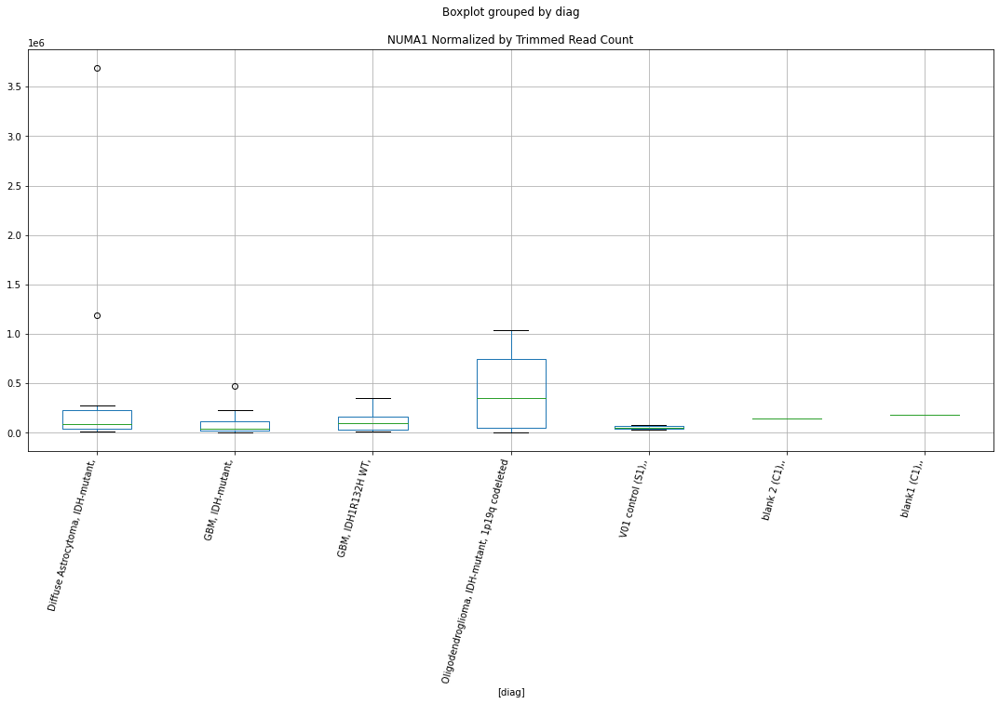

 p : 0.041116131928592606  ( t : 2.199907910824757 ) :  D-plex  :  cutadapt2  :  MYH15
Control and blanks
76     0.0
340    0.0
Name: MYH15, dtype: float64
208    1587.24
Name: MYH15, dtype: float64
472    0.0
Name: MYH15, dtype: float64


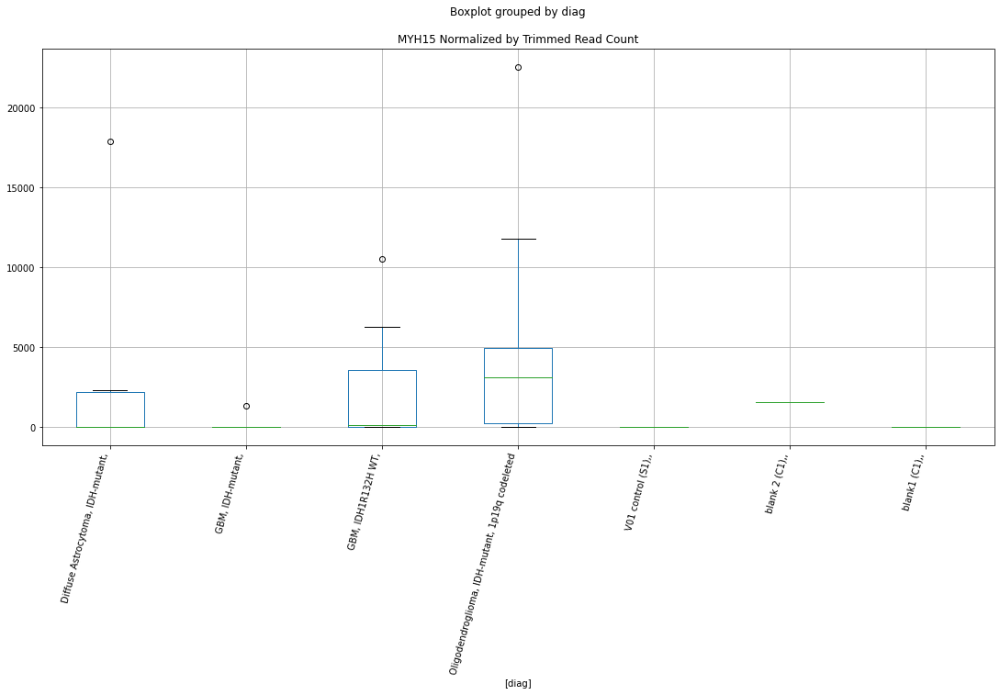

 p : 0.04112518629583787  ( t : 2.199797412965721 ) :  D-plex  :  cutadapt2  :  NEURL1B
Control and blanks
76     1515.23
340       0.00
Name: NEURL1B, dtype: float64
208    1939.96
Name: NEURL1B, dtype: float64
472    4623.65
Name: NEURL1B, dtype: float64


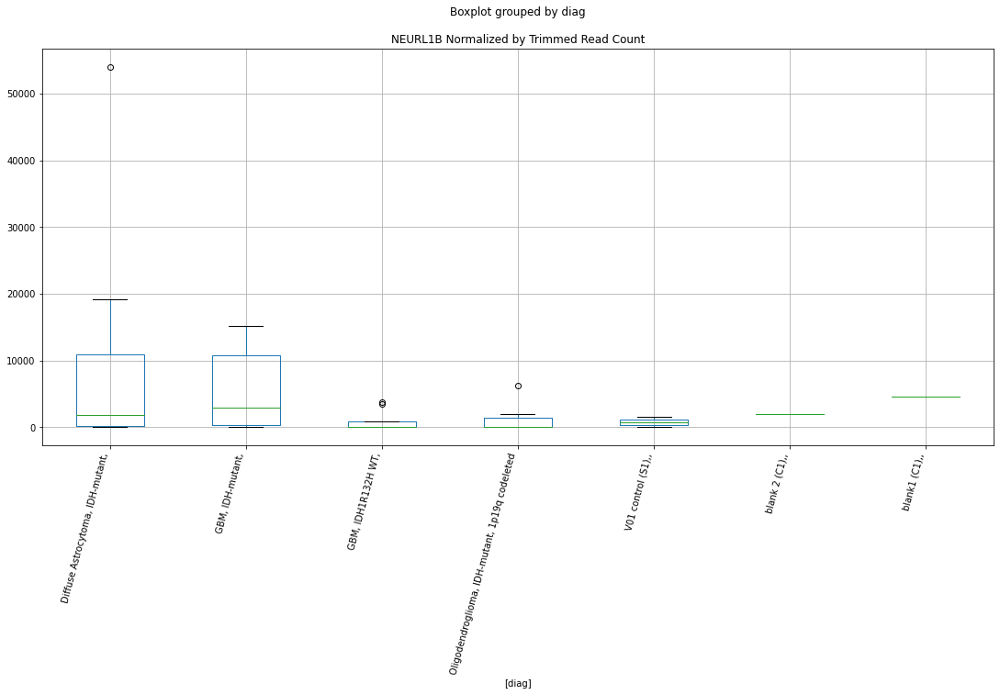

 p : 0.041155424961668886  ( t : 2.199428547592288 ) :  D-plex  :  cutadapt2  :  LRRC75A
Control and blanks
76     2272.84
340       0.00
Name: LRRC75A, dtype: float64
208    529.08
Name: LRRC75A, dtype: float64
472    2889.78
Name: LRRC75A, dtype: float64


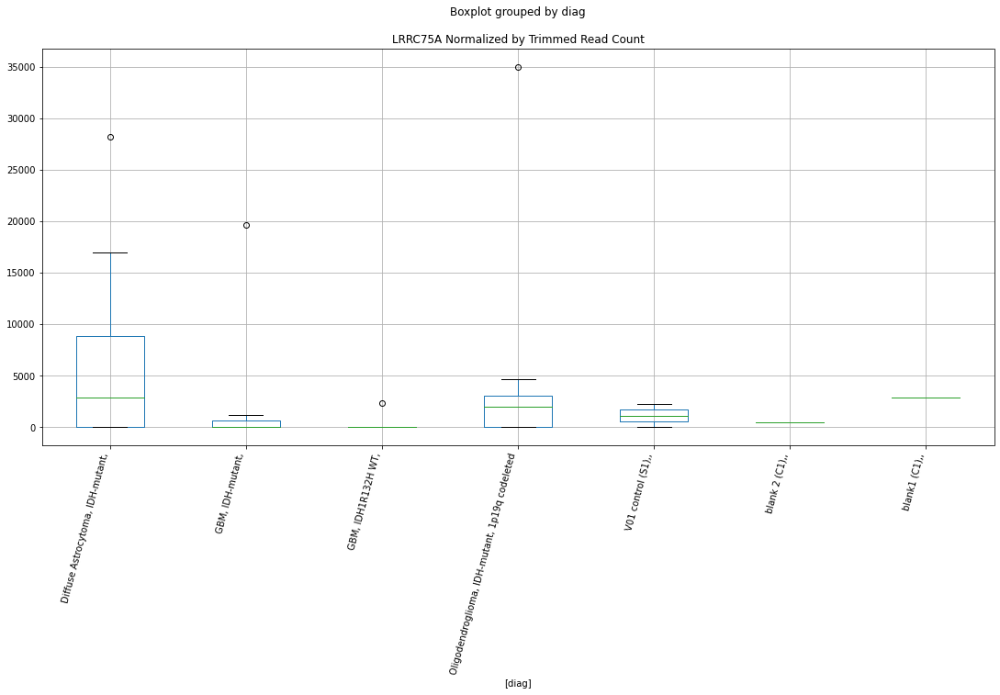

 p : 0.04116146686031378  ( t : 2.19935487552424 ) :  D-plex  :  bbduk2  :  MROH9
Control and blanks
73     0.0
337    0.0
Name: MROH9, dtype: float64
205    716.36
Name: MROH9, dtype: float64
469    0.0
Name: MROH9, dtype: float64


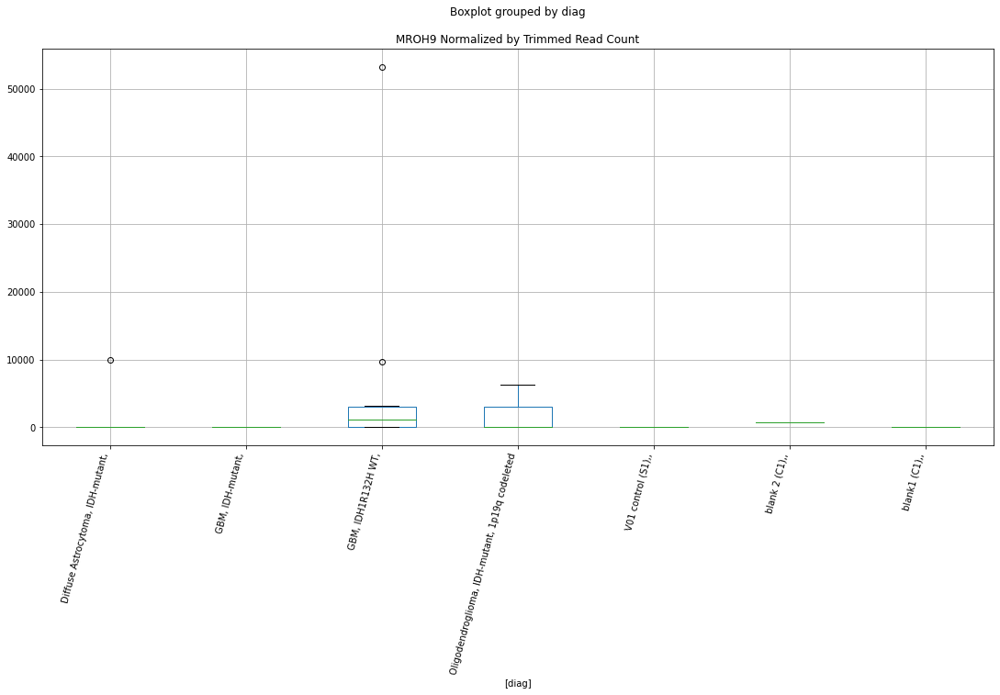

 p : 0.04119785716065182  ( t : 2.198911359248797 ) :  Lexogen  :  cutadapt2  :  MACROH2A2
Control and blanks
82       0.00
346    210.43
Name: MACROH2A2, dtype: float64
214    0.0
Name: MACROH2A2, dtype: float64
478    0.0
Name: MACROH2A2, dtype: float64


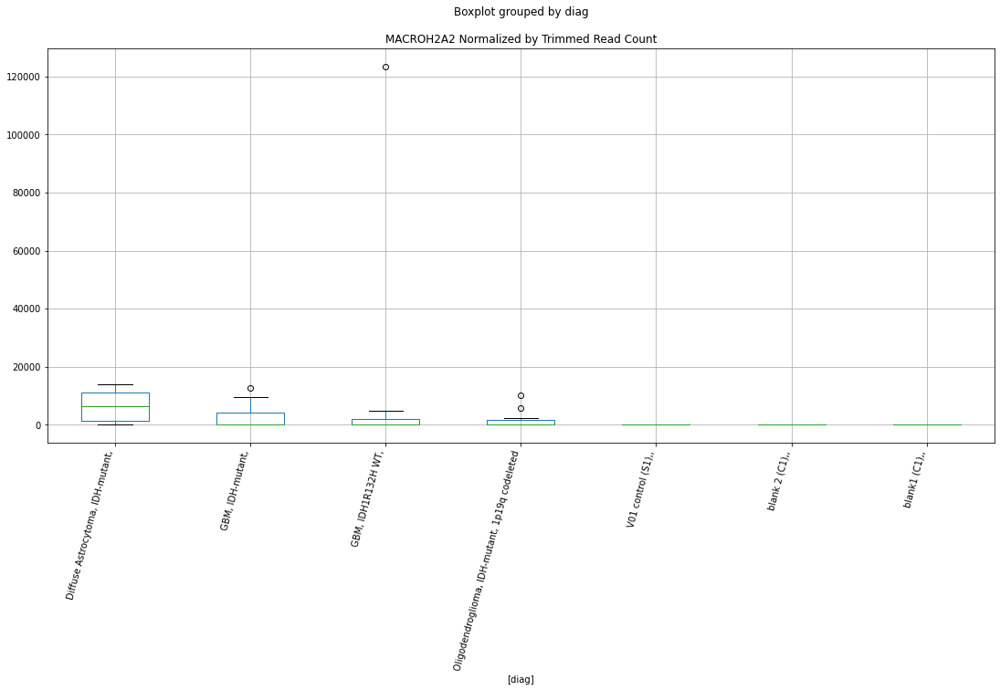

 p : 0.041326807011130416  ( t : 2.1973426398775993 ) :  D-plex  :  bbduk2  :  LOC107986930
Control and blanks
73     6184.07
337       0.00
Name: LOC107986930, dtype: float64
205    2328.18
Name: LOC107986930, dtype: float64
469    1774.58
Name: LOC107986930, dtype: float64


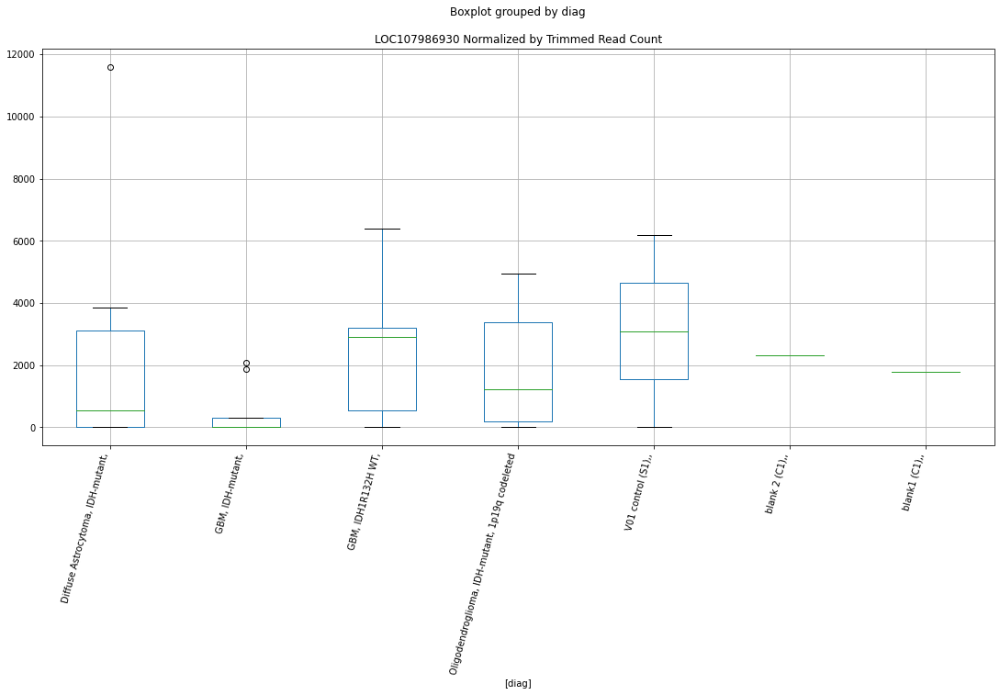

 p : 0.041389188159451695  ( t : 2.196585364023238 ) :  Lexogen  :  cutadapt2  :  LOC728196
Control and blanks
82     1420.05
346    1473.04
Name: LOC728196, dtype: float64
214    1084.91
Name: LOC728196, dtype: float64
478    3324.45
Name: LOC728196, dtype: float64


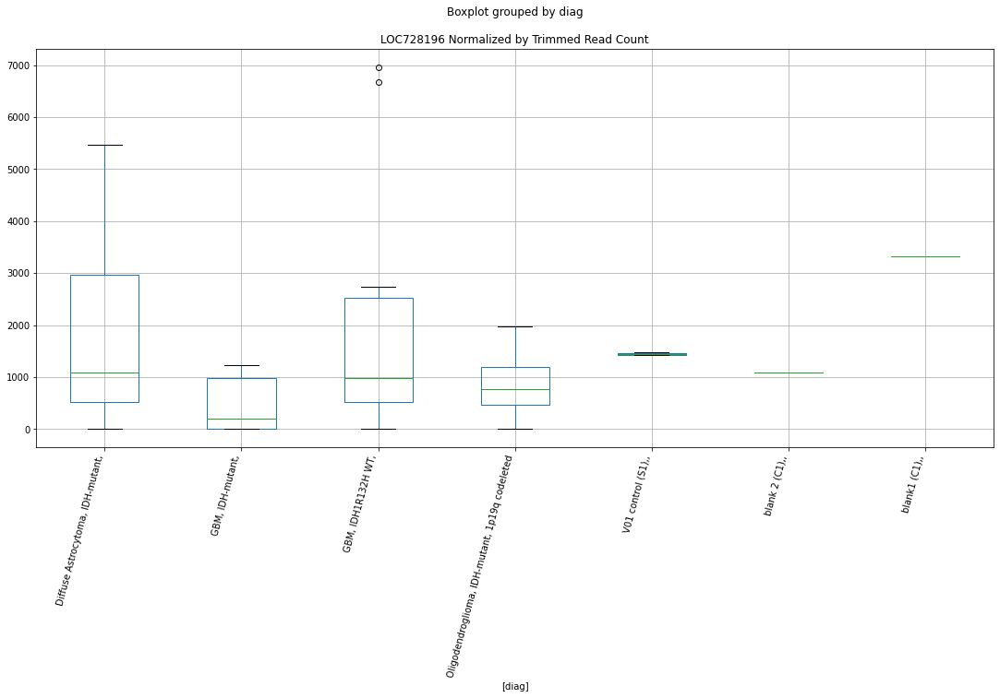

 p : 0.04140680508285095  ( t : 2.1963716931575763 ) :  Lexogen  :  cutadapt2  :  NEIL2
Control and blanks
82     0.0
346    0.0
Name: NEIL2, dtype: float64
214    0.0
Name: NEIL2, dtype: float64
478    0.0
Name: NEIL2, dtype: float64


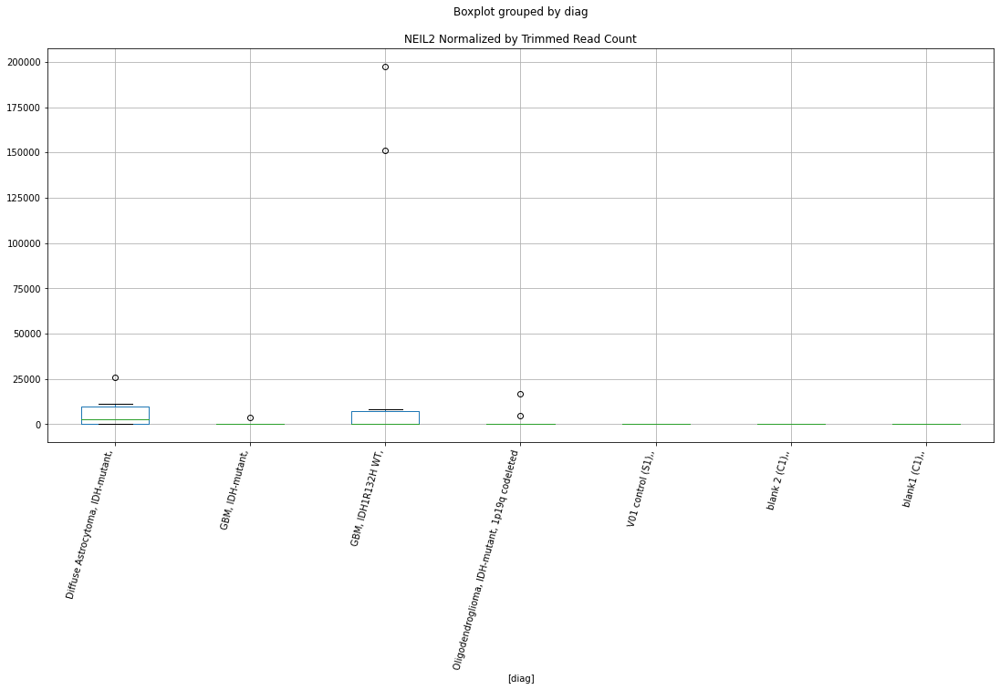

 p : 0.041487075017843766  ( t : 2.195399176201791 ) :  Lexogen  :  bbduk2  :  MACROH2A2
Control and blanks
79       0.00
343    212.31
Name: MACROH2A2, dtype: float64
211    0.0
Name: MACROH2A2, dtype: float64
475    0.0
Name: MACROH2A2, dtype: float64


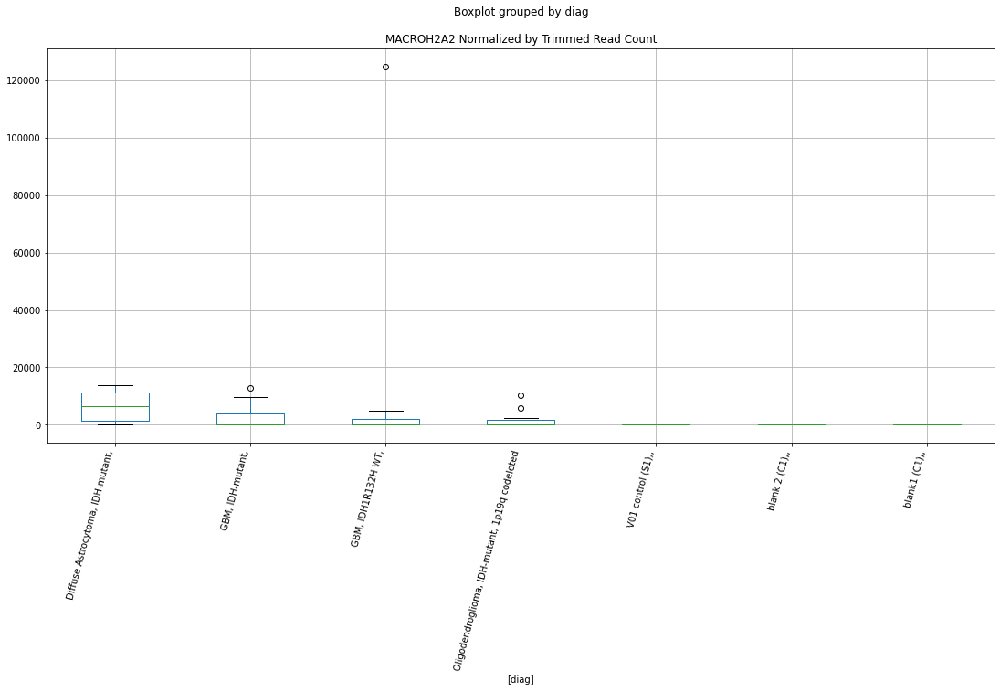

 p : 0.04164953236284847  ( t : 2.193436184937351 ) :  D-plex  :  cutadapt2  :  LOC112268261
Control and blanks
76     1515.23
340       0.00
Name: LOC112268261, dtype: float64
208    529.08
Name: LOC112268261, dtype: float64
472    0.0
Name: LOC112268261, dtype: float64


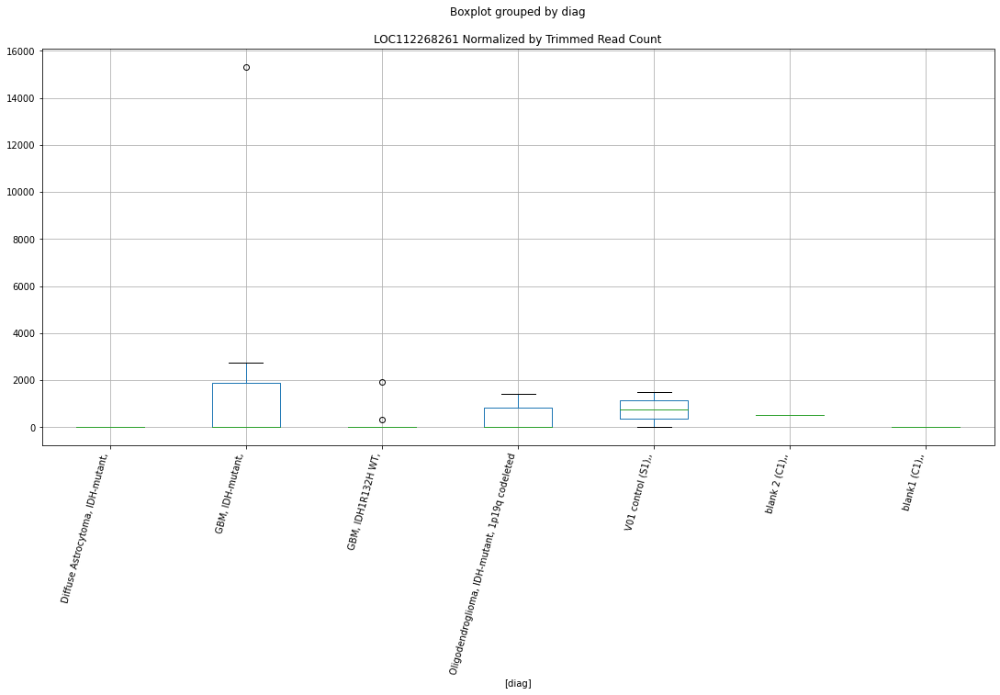

 p : 0.041707539475244304  ( t : 2.1927369804631605 ) :  D-plex  :  bbduk2  :  MYO5B
Control and blanks
73     0.0
337    0.0
Name: MYO5B, dtype: float64
205    895.45
Name: MYO5B, dtype: float64
469    0.0
Name: MYO5B, dtype: float64


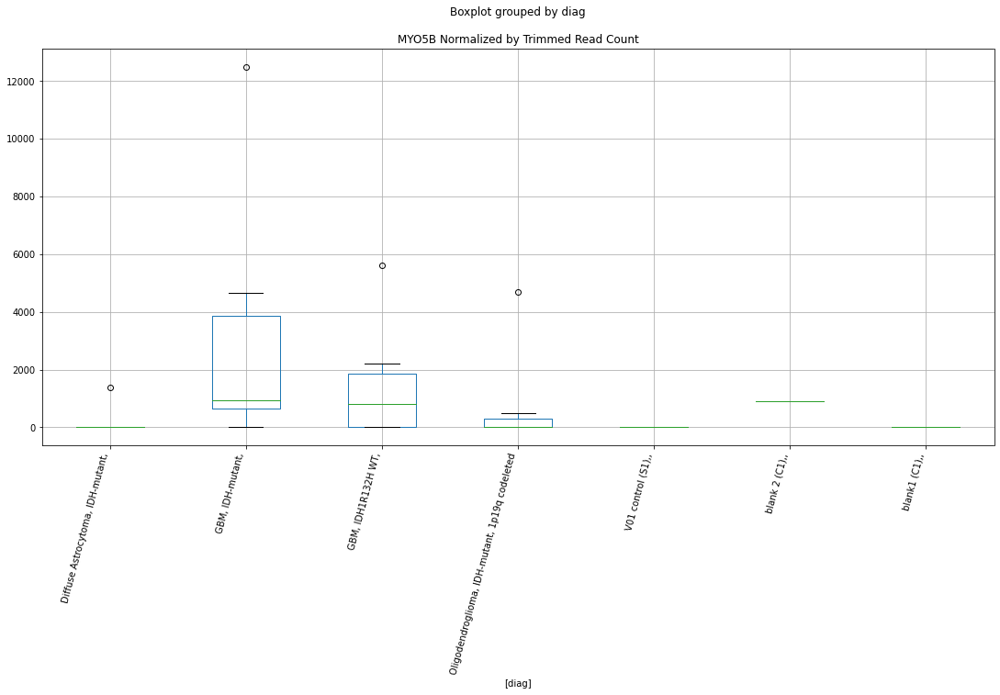

 p : 0.04232834755560762  ( t : 2.185309262603478 ) :  D-plex  :  cutadapt2  :  MIR92B
Control and blanks
76     0.0
340    0.0
Name: MIR92B, dtype: float64
208    529.08
Name: MIR92B, dtype: float64
472    0.0
Name: MIR92B, dtype: float64


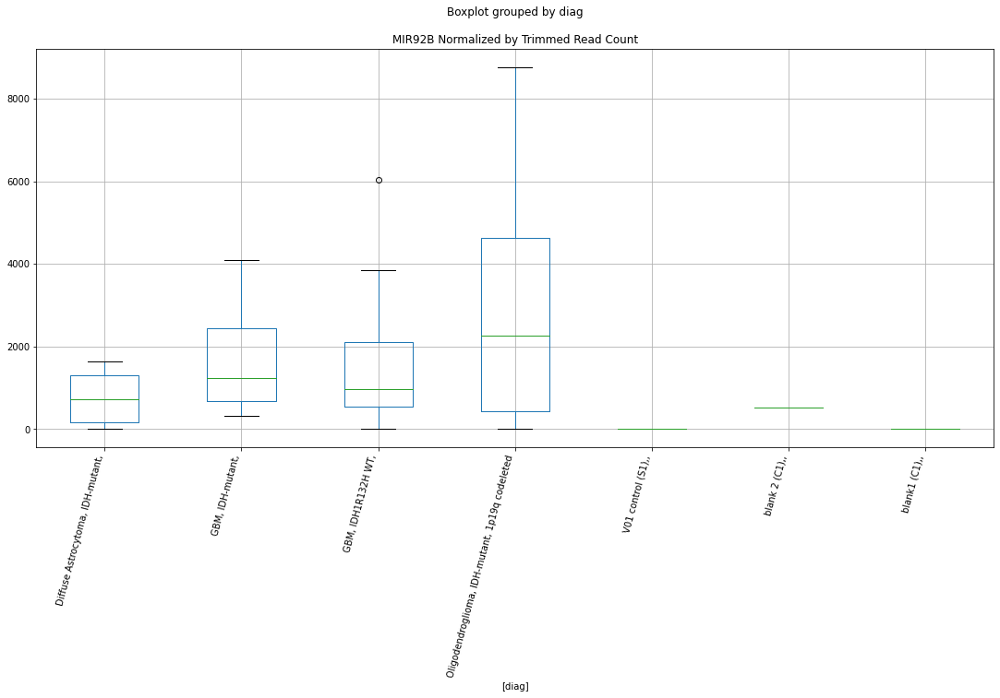

 p : 0.042358557571726005  ( t : 2.184950367192003 ) :  Lexogen  :  cutadapt2  :  MAP2K6
Control and blanks
82     105083.78
346    115318.12
Name: MAP2K6, dtype: float64
214    12476.42
Name: MAP2K6, dtype: float64
478    3561.91
Name: MAP2K6, dtype: float64


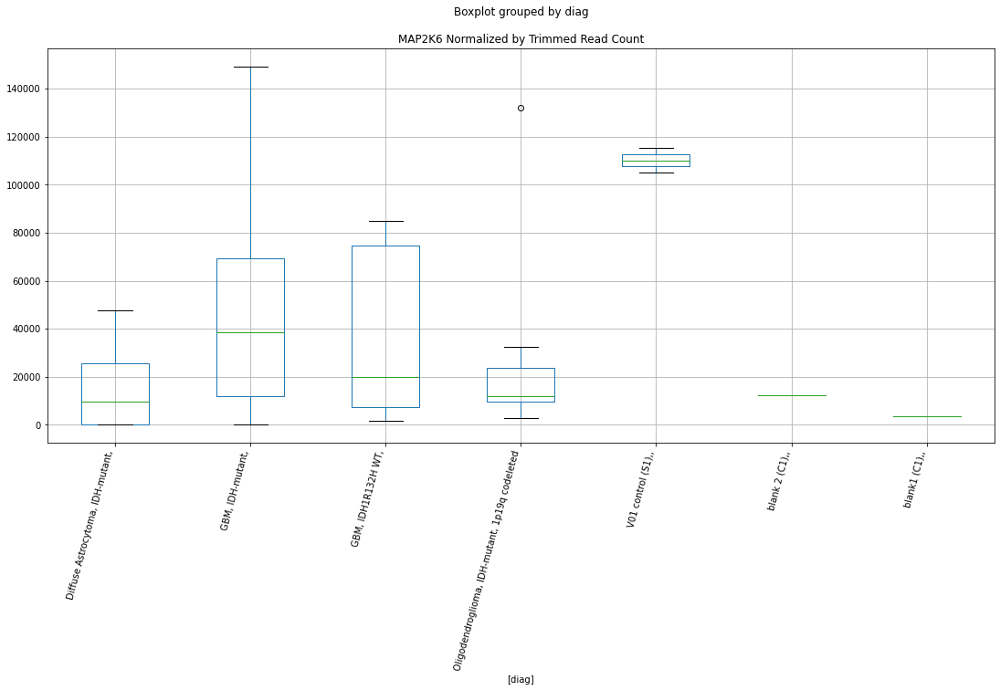

 p : 0.042489259069690595  ( t : 2.1834003309870327 ) :  D-plex  :  bbduk2  :  NUMA1
Control and blanks
73     30920.34
337    81894.47
Name: NUMA1, dtype: float64
205    151331.85
Name: NUMA1, dtype: float64
469    191063.32
Name: NUMA1, dtype: float64


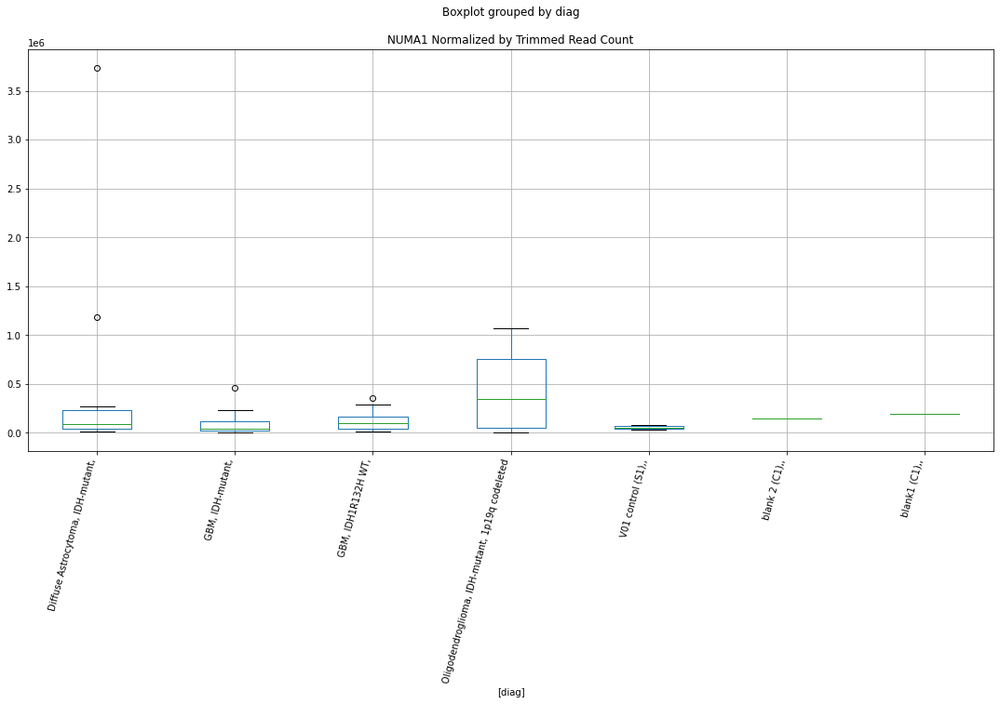

 p : 0.042502388870998144  ( t : 2.1832448616750115 ) :  D-plex  :  bbduk2  :  NTSR2
Control and blanks
73     0.0
337    0.0
Name: NTSR2, dtype: float64
205    0.0
Name: NTSR2, dtype: float64
469    2957.64
Name: NTSR2, dtype: float64


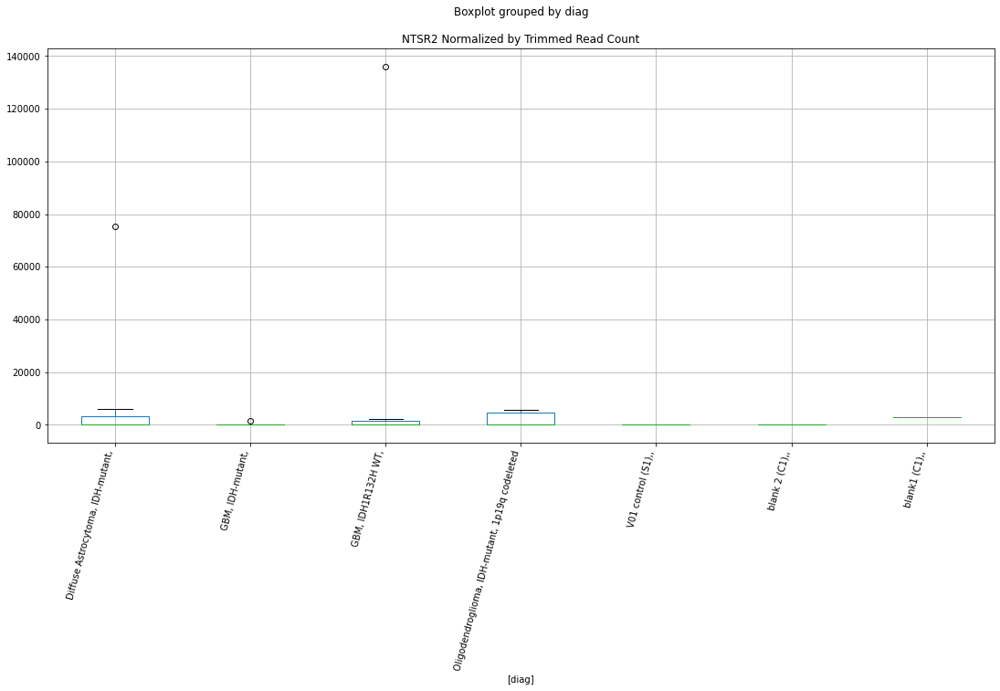

 p : 0.042562399899249946  ( t : 2.182534834217378 ) :  D-plex  :  cutadapt2  :  NTSR2
Control and blanks
76     0.0
340    0.0
Name: NTSR2, dtype: float64
208    0.0
Name: NTSR2, dtype: float64
472    2889.78
Name: NTSR2, dtype: float64


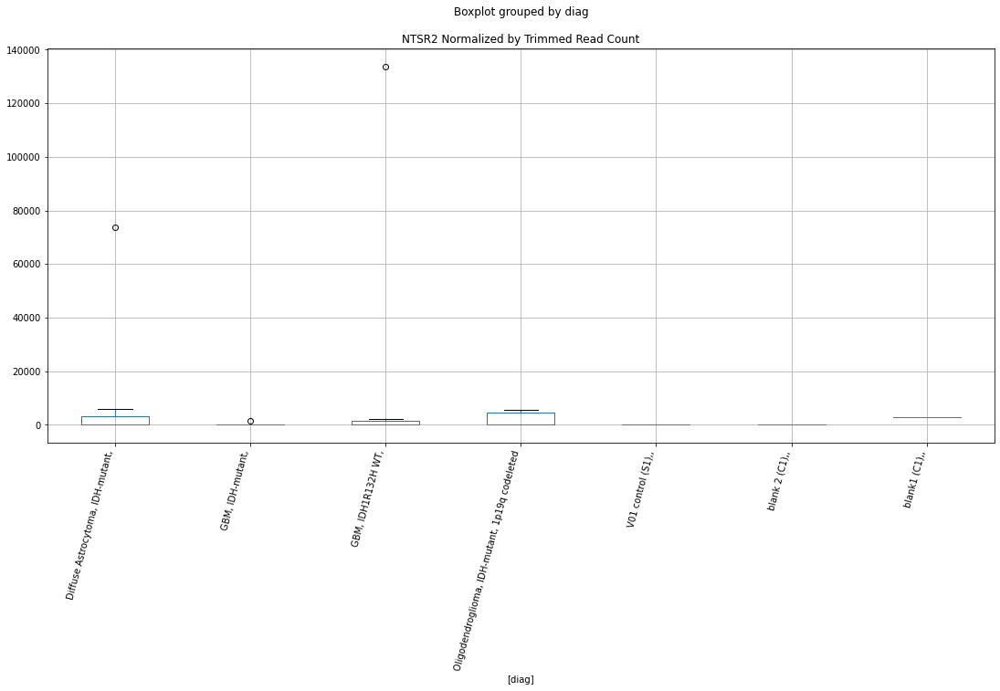

 p : 0.0425674715628594  ( t : 2.1824748703082335 ) :  Lexogen  :  bbduk2  :  NRDE2
Control and blanks
79       0.00
343    212.31
Name: NRDE2, dtype: float64
211    0.0
Name: NRDE2, dtype: float64
475    0.0
Name: NRDE2, dtype: float64


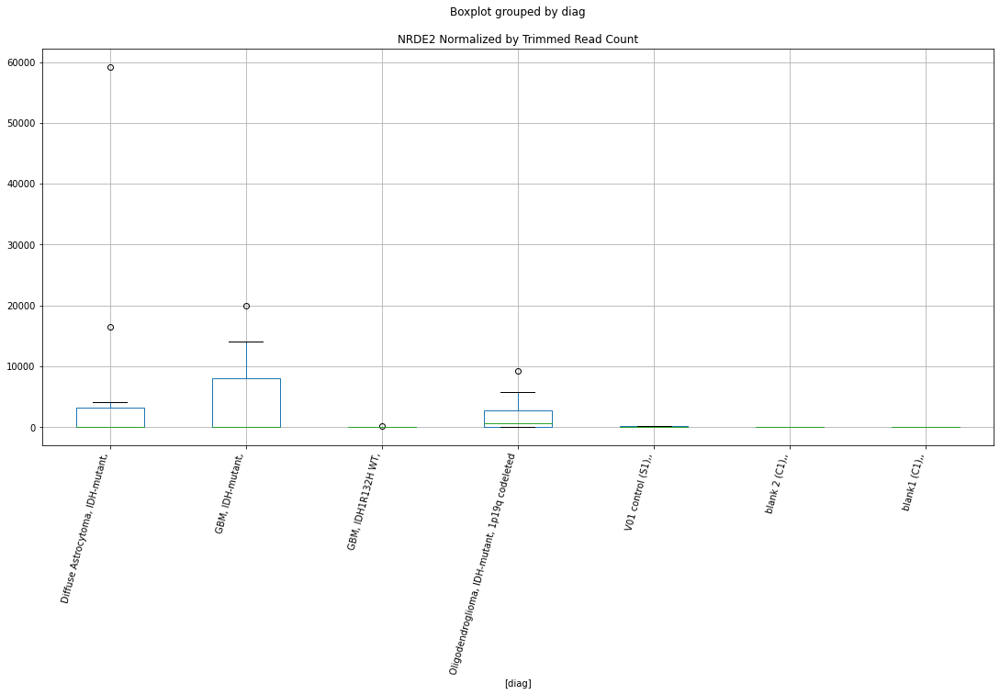

 p : 0.04257230701061759  ( t : 2.182417705354 ) :  Lexogen  :  bbduk2  :  NBEA
Control and blanks
79     0.0
343    0.0
Name: NBEA, dtype: float64
211    0.0
Name: NBEA, dtype: float64
475    0.0
Name: NBEA, dtype: float64


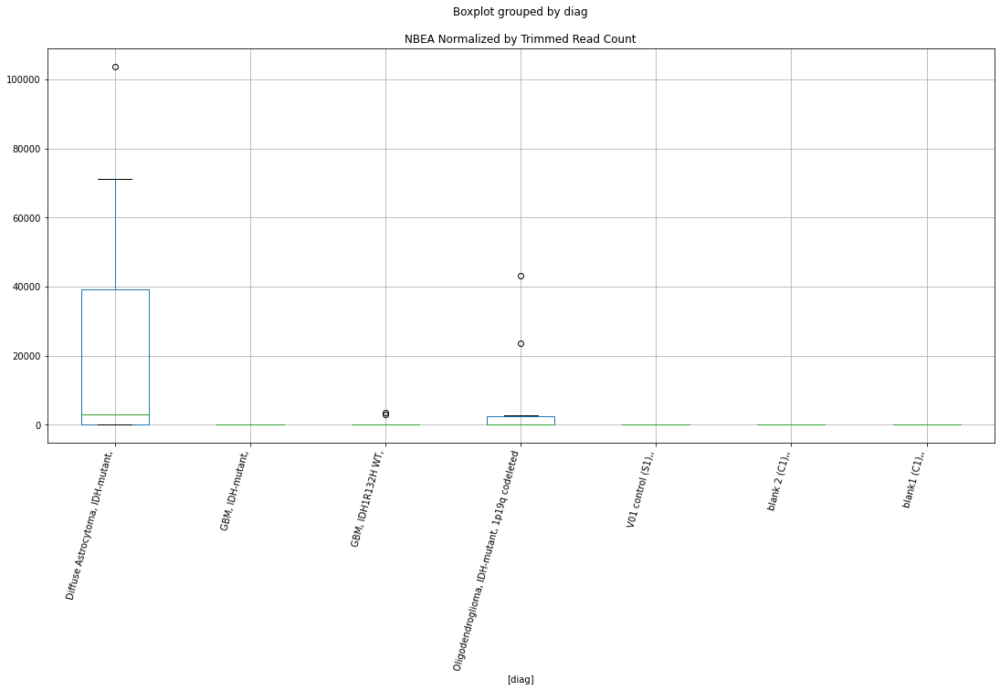

 p : 0.04261412747152321  ( t : 2.181923549561497 ) :  D-plex  :  bbduk2  :  LOC107987258
Control and blanks
73     0.0
337    0.0
Name: LOC107987258, dtype: float64
205    895.45
Name: LOC107987258, dtype: float64
469    0.0
Name: LOC107987258, dtype: float64


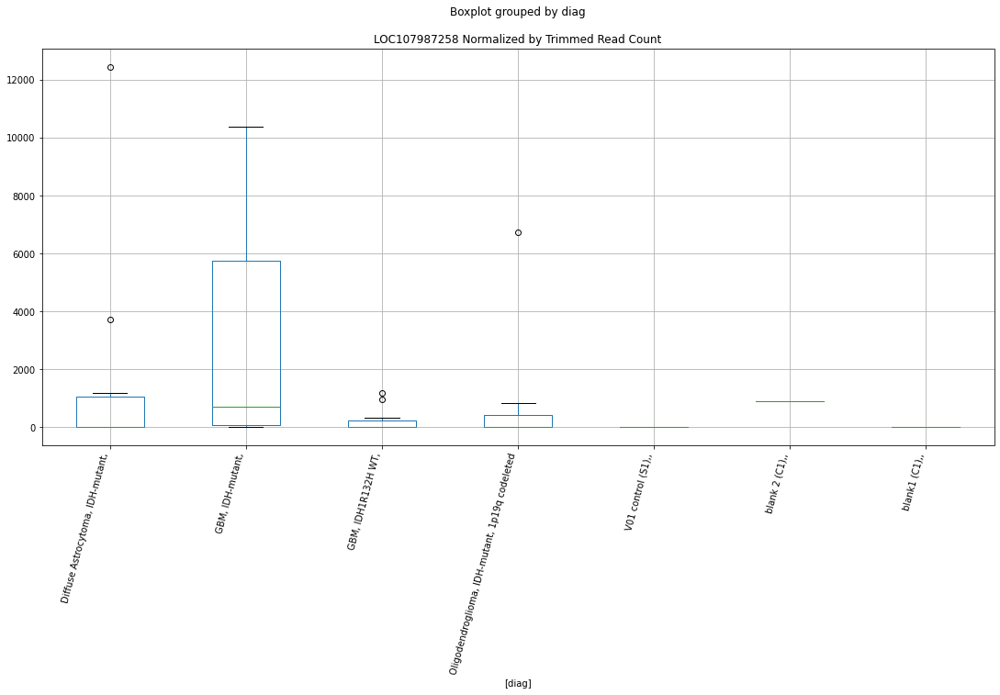

 p : 0.04265429921101227  ( t : 2.181449293713342 ) :  Lexogen  :  cutadapt2  :  MIR151A
Control and blanks
82         0.00
346    60184.27
Name: MIR151A, dtype: float64
214    0.0
Name: MIR151A, dtype: float64
478    237.46
Name: MIR151A, dtype: float64


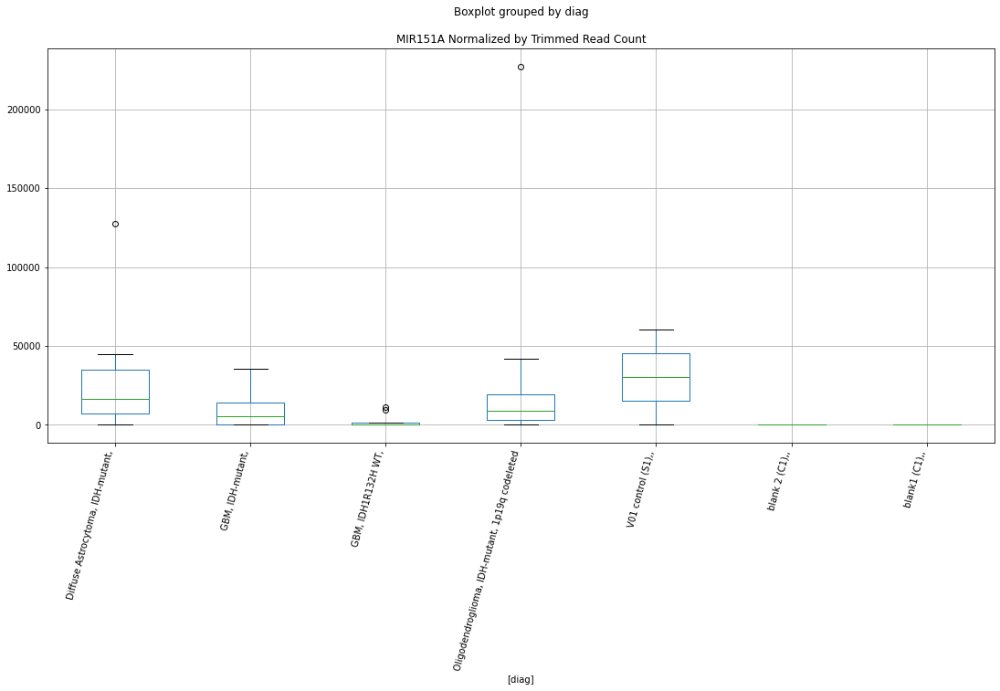

 p : 0.04265962188455799  ( t : 2.181386486502861 ) :  D-plex  :  cutadapt2  :  MCOLN2
Control and blanks
76     705338.83
340    166458.37
Name: MCOLN2, dtype: float64
208    64900.56
Name: MCOLN2, dtype: float64
472    2.24e+06
Name: MCOLN2, dtype: float64


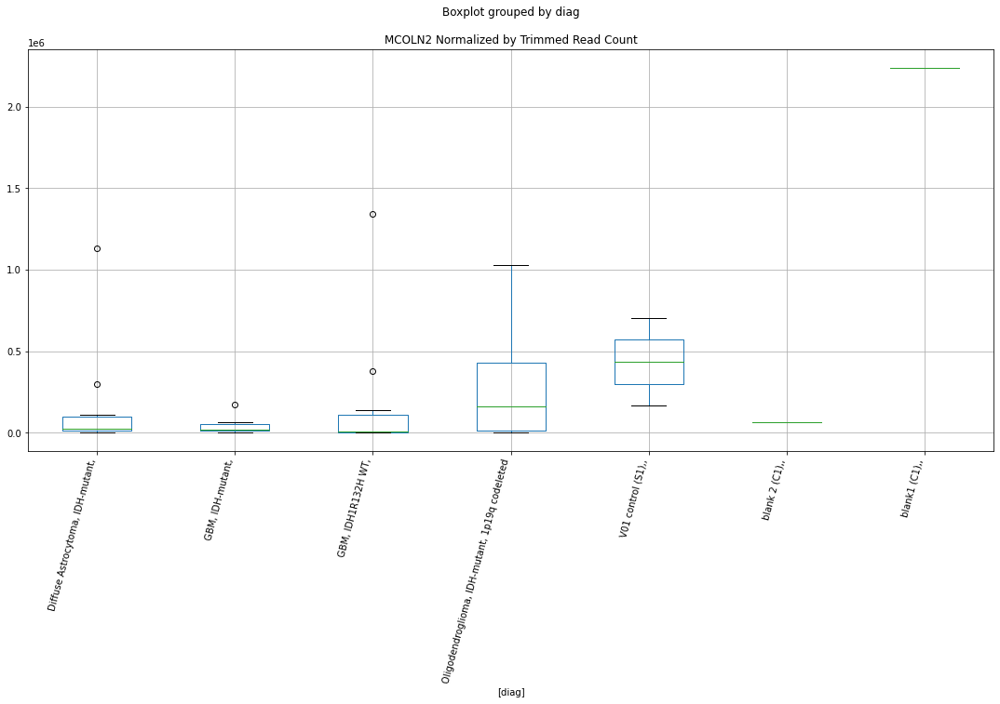

 p : 0.04266041554738422  ( t : 2.181377121947248 ) :  D-plex  :  bbduk2  :  LRRC8B
Control and blanks
73       3092.03
337    213637.74
Name: LRRC8B, dtype: float64
205    11461.82
Name: LRRC8B, dtype: float64
469    4732.22
Name: LRRC8B, dtype: float64


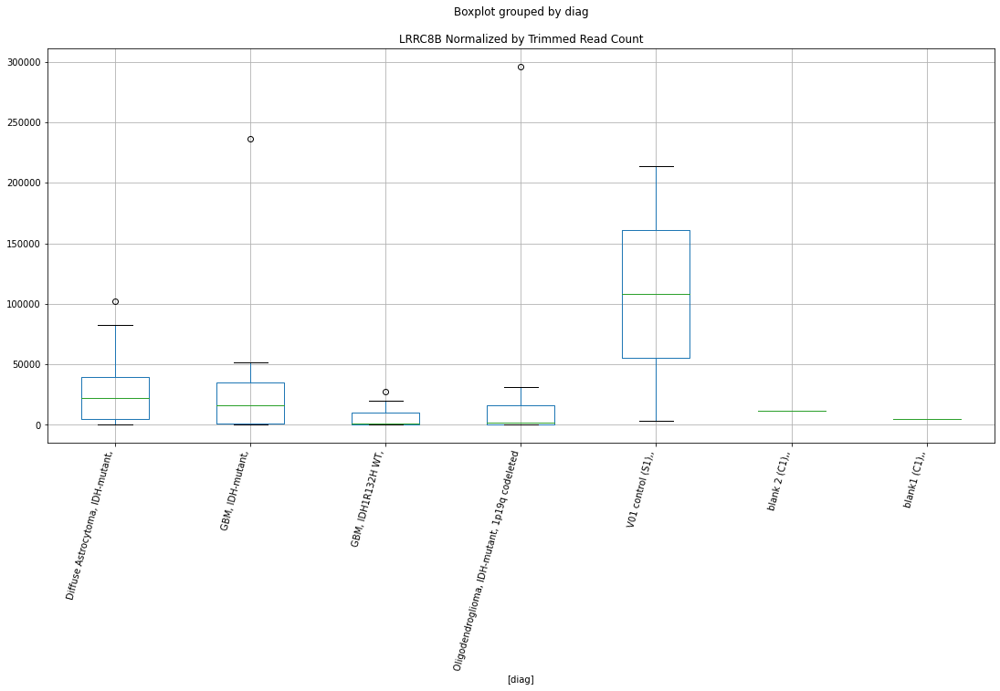

 p : 0.04273491086944888  ( t : 2.180498849827213 ) :  Lexogen  :  bbduk2  :  MIR151A
Control and blanks
79         0.00
343    60509.58
Name: MIR151A, dtype: float64
211    0.0
Name: MIR151A, dtype: float64
475    239.52
Name: MIR151A, dtype: float64


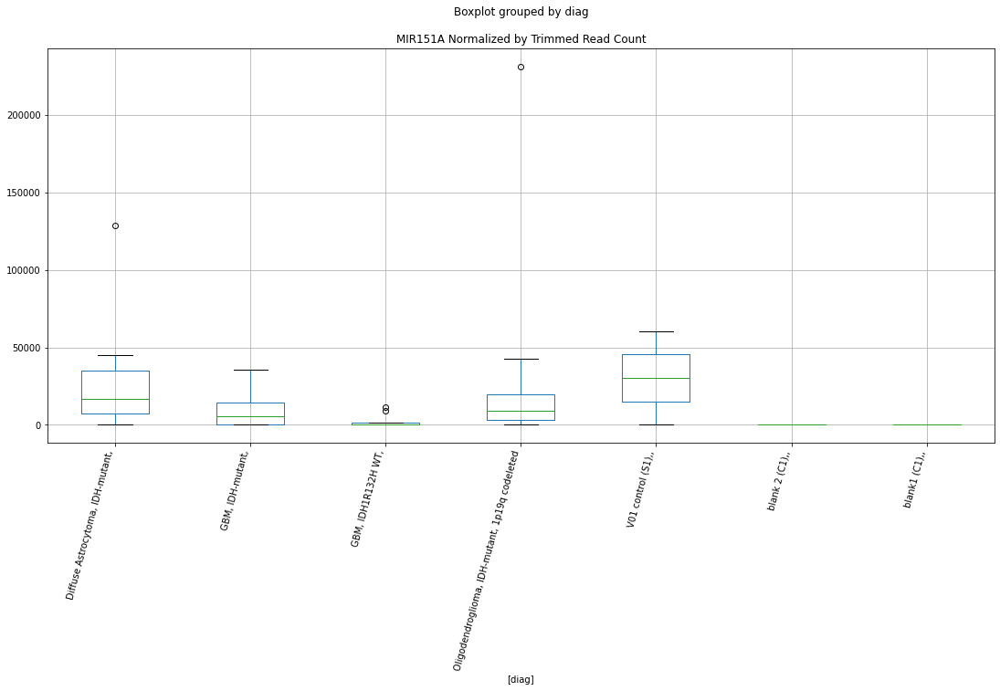

 p : 0.0427388357460621  ( t : 2.1804526159189033 ) :  Lexogen  :  bbduk2  :  MIR27B
Control and blanks
79         0.00
343    16985.15
Name: MIR27B, dtype: float64
211    0.0
Name: MIR27B, dtype: float64
475    0.0
Name: MIR27B, dtype: float64


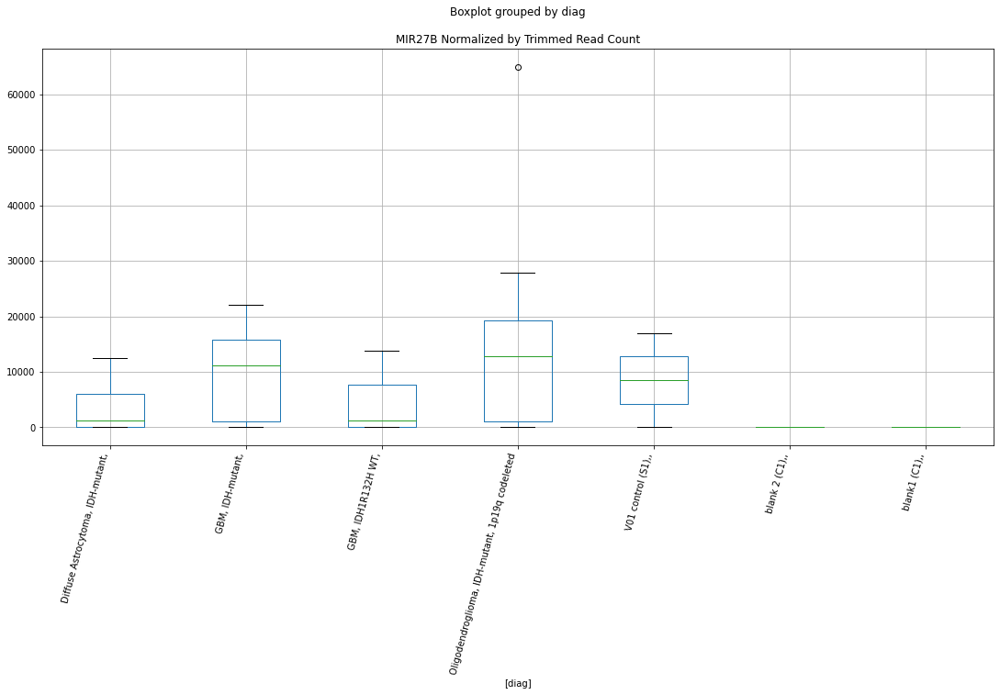

 p : 0.042741301509355865  ( t : 2.1804235719327756 ) :  Lexogen  :  bbduk2  :  LOC642361
Control and blanks
79     0.0
343    0.0
Name: LOC642361, dtype: float64
211    0.0
Name: LOC642361, dtype: float64
475    0.0
Name: LOC642361, dtype: float64


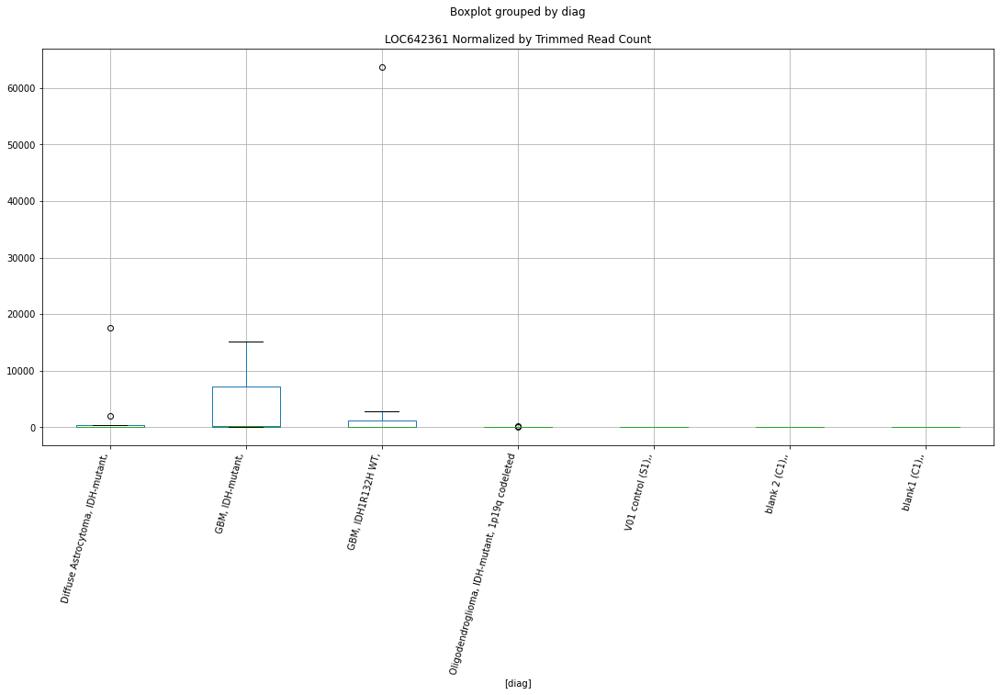

 p : 0.04276353596725172  ( t : 2.180161743754837 ) :  Lexogen  :  bbduk2  :  MIR451B
Control and blanks
79         0.00
343    45222.95
Name: MIR451B, dtype: float64
211    2459.76
Name: MIR451B, dtype: float64
475    239.52
Name: MIR451B, dtype: float64


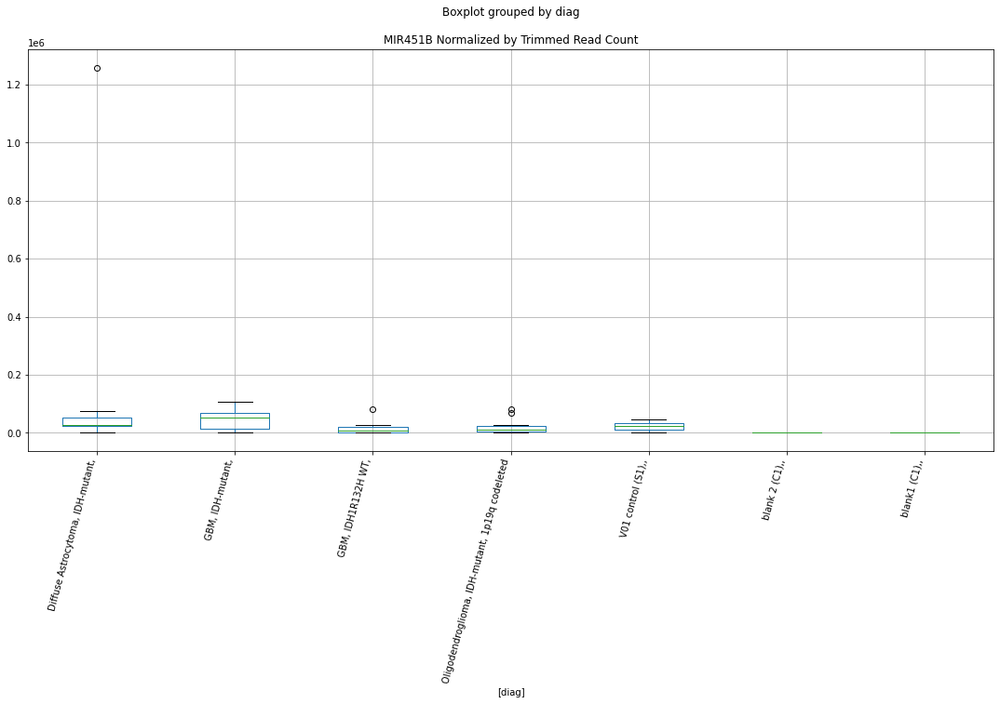

 p : 0.04276353596725172  ( t : 2.180161743754837 ) :  Lexogen  :  bbduk2  :  MIR451A
Control and blanks
79         0.00
343    45222.95
Name: MIR451A, dtype: float64
211    2459.76
Name: MIR451A, dtype: float64
475    239.52
Name: MIR451A, dtype: float64


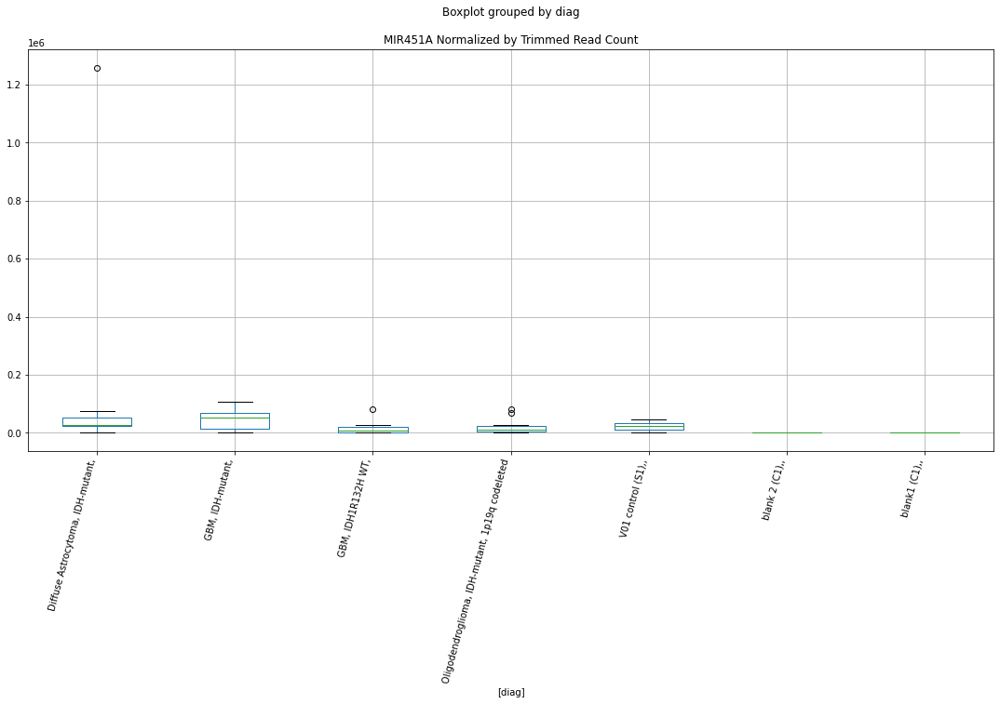

 p : 0.04280174952297664  ( t : 2.1797120405342483 ) :  D-plex  :  cutadapt2  :  LOC107986673
Control and blanks
76     0.0
340    0.0
Name: LOC107986673, dtype: float64
208    0.0
Name: LOC107986673, dtype: float64
472    577.96
Name: LOC107986673, dtype: float64


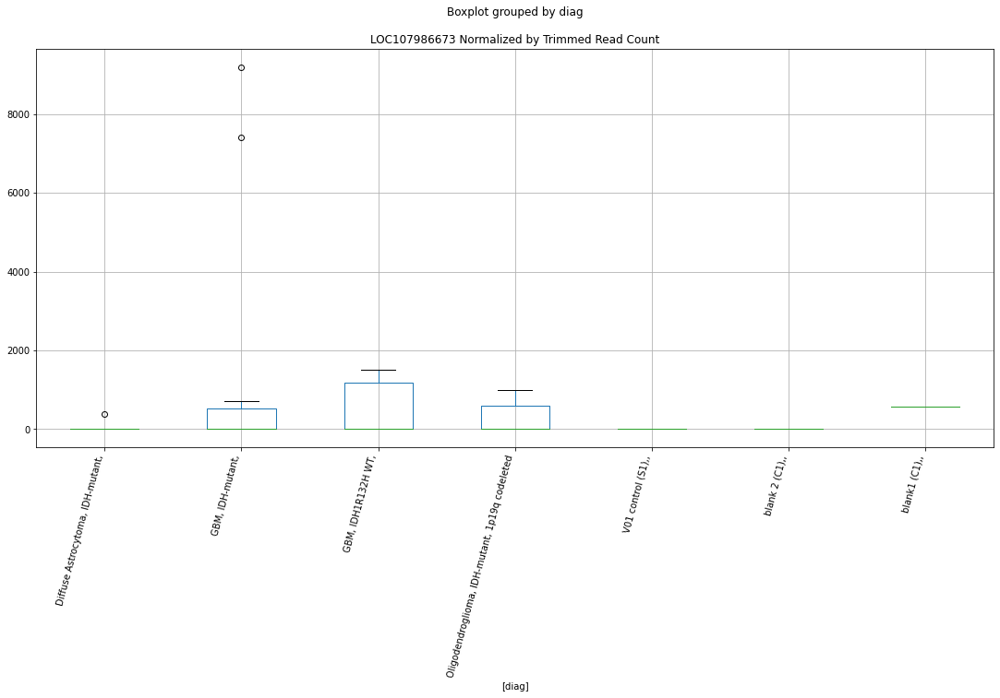

 p : 0.04293453202226836  ( t : 2.178152290382346 ) :  D-plex  :  cutadapt2  :  NRSN2
Control and blanks
76     757.61
340      0.00
Name: NRSN2, dtype: float64
208    1587.24
Name: NRSN2, dtype: float64
472    9825.25
Name: NRSN2, dtype: float64


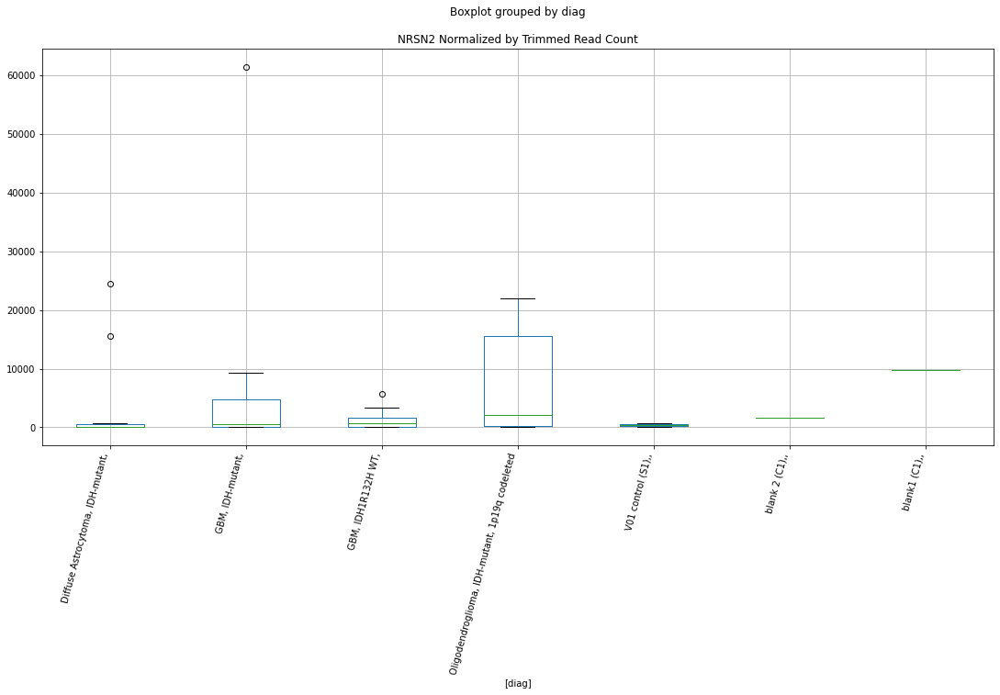

 p : 0.04302121303048161  ( t : 2.1771364615423336 ) :  Lexogen  :  cutadapt2  :  LOC642361
Control and blanks
82     0.0
346    0.0
Name: LOC642361, dtype: float64
214    0.0
Name: LOC642361, dtype: float64
478    0.0
Name: LOC642361, dtype: float64


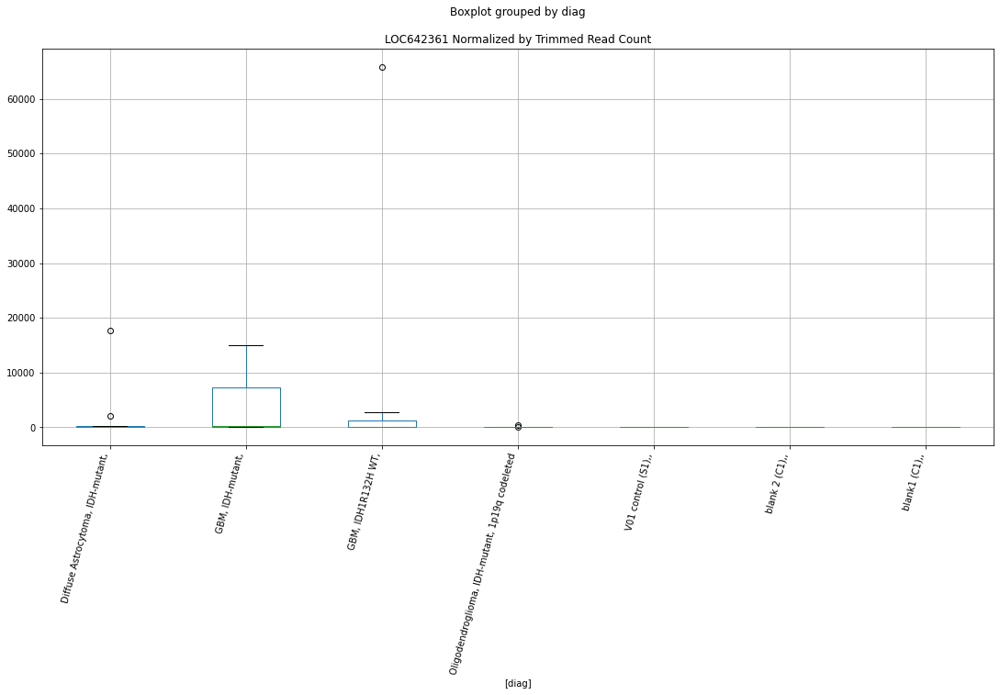

 p : 0.04306040628665298  ( t : 2.1766777649610947 ) :  D-plex  :  bbduk2  :  LOC112268112
Control and blanks
73     0.0
337    0.0
Name: LOC112268112, dtype: float64
205    1432.73
Name: LOC112268112, dtype: float64
469    1183.05
Name: LOC112268112, dtype: float64


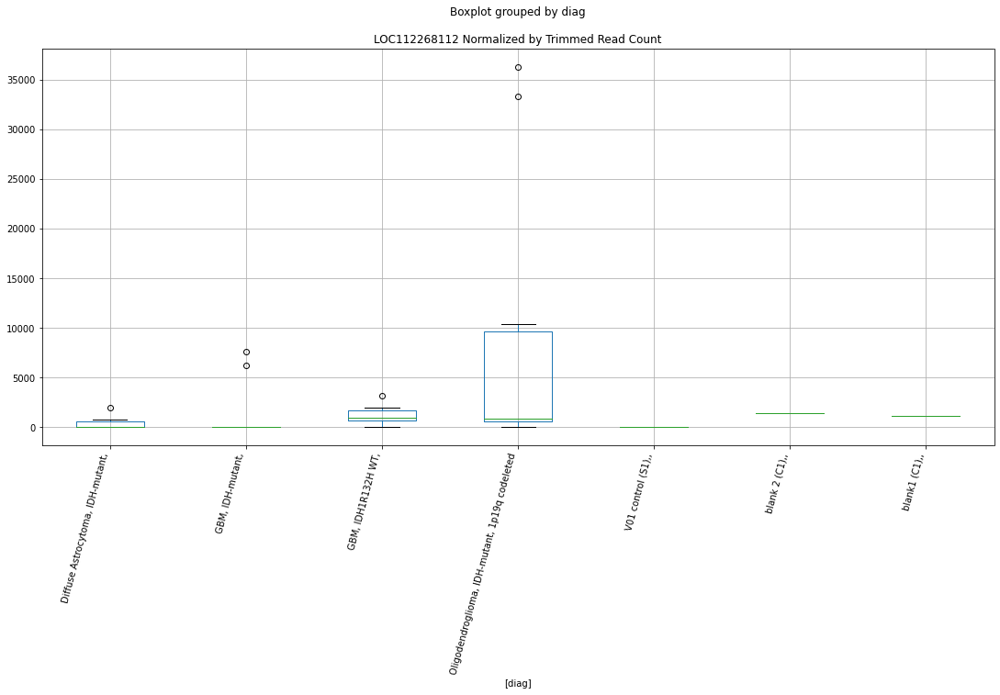

 p : 0.04306517301832912  ( t : 2.176622003816649 ) :  D-plex  :  cutadapt2  :  LRCH3
Control and blanks
76     0.0
340    0.0
Name: LRCH3, dtype: float64
208    6172.61
Name: LRCH3, dtype: float64
472    0.0
Name: LRCH3, dtype: float64


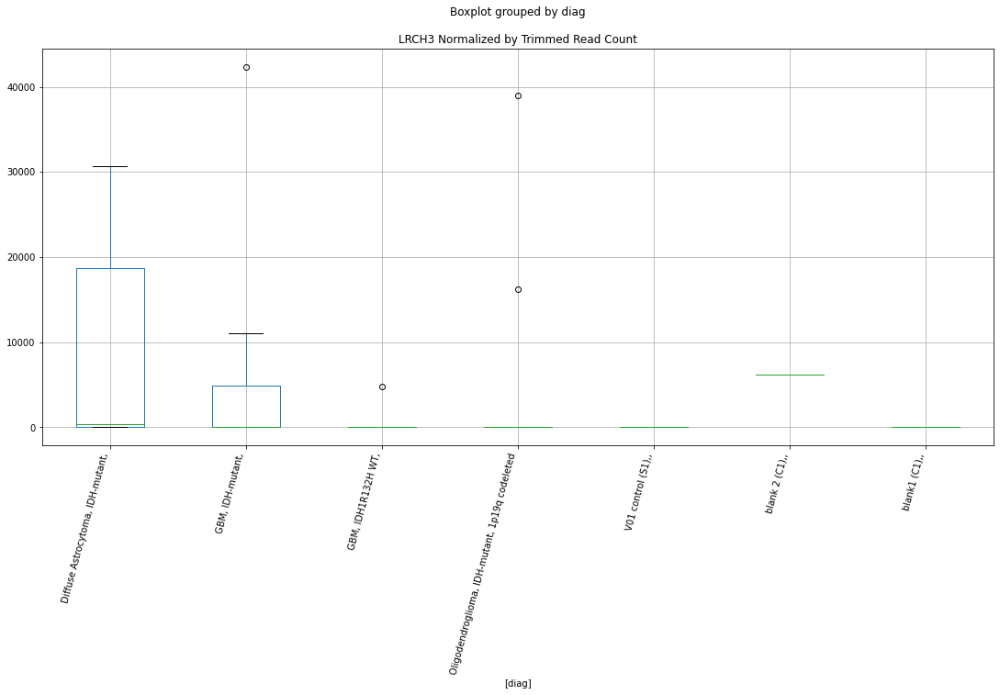

 p : 0.04307590836519404  ( t : 2.1764964426216897 ) :  Lexogen  :  cutadapt2  :  MIR451A
Control and blanks
82         0.00
346    44401.68
Name: MIR451A, dtype: float64
214    2712.26
Name: MIR451A, dtype: float64
478    237.46
Name: MIR451A, dtype: float64


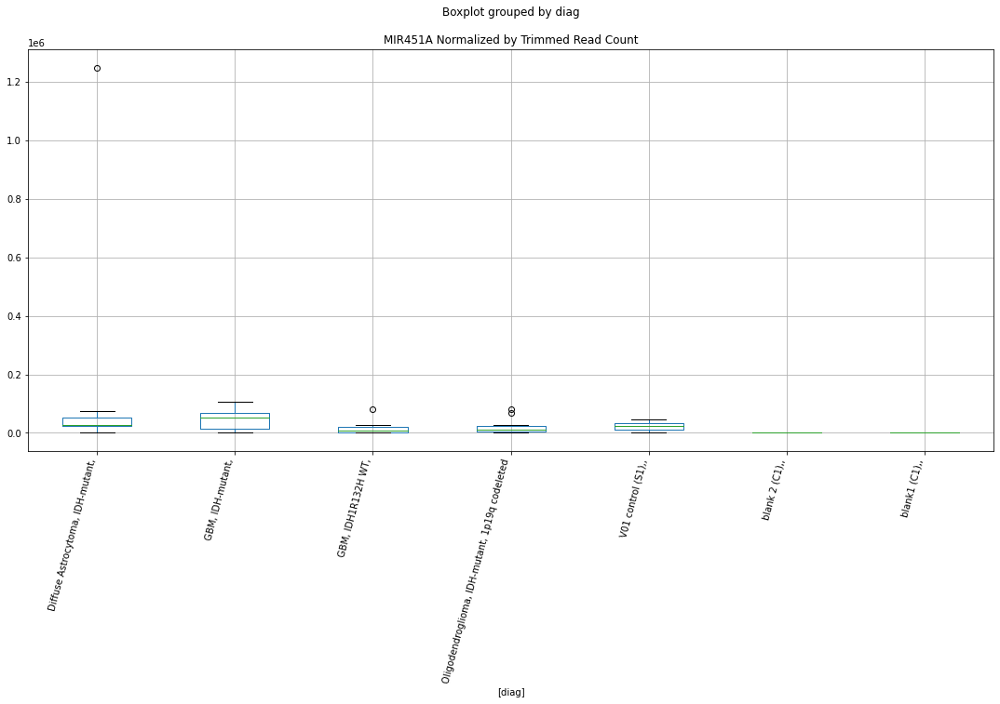

 p : 0.04307590836519404  ( t : 2.1764964426216897 ) :  Lexogen  :  cutadapt2  :  MIR451B
Control and blanks
82         0.00
346    44401.68
Name: MIR451B, dtype: float64
214    2712.26
Name: MIR451B, dtype: float64
478    237.46
Name: MIR451B, dtype: float64


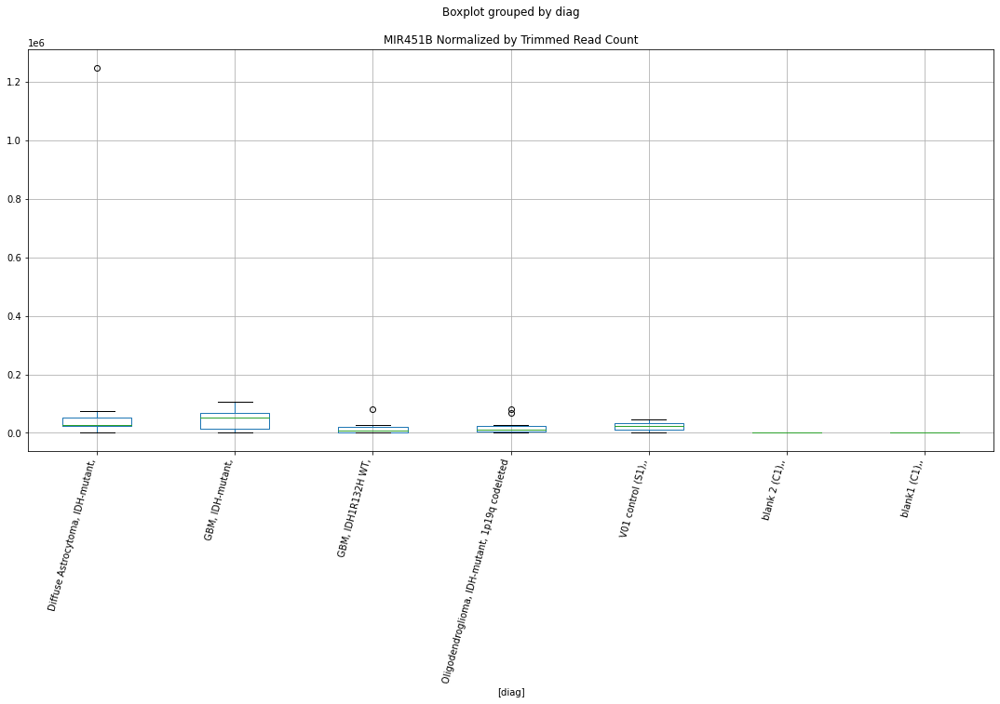

 p : 0.043389378635143645  ( t : 2.172842659381253 ) :  D-plex  :  cutadapt2  :  N4BP2
Control and blanks
76     0.0
340    0.0
Name: N4BP2, dtype: float64
208    19223.26
Name: N4BP2, dtype: float64
472    1733.87
Name: N4BP2, dtype: float64


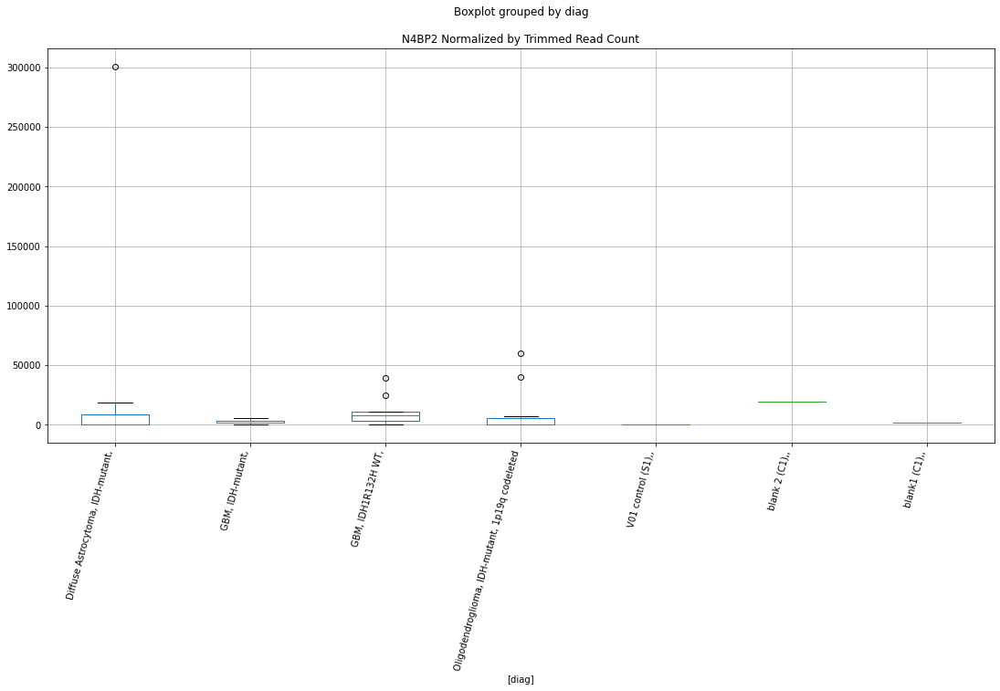

 p : 0.04345838267182466  ( t : 2.1720416021150895 ) :  D-plex  :  cutadapt2  :  MRPL48
Control and blanks
76     3030.46
340       0.00
Name: MRPL48, dtype: float64
208    5819.89
Name: MRPL48, dtype: float64
472    2889.78
Name: MRPL48, dtype: float64


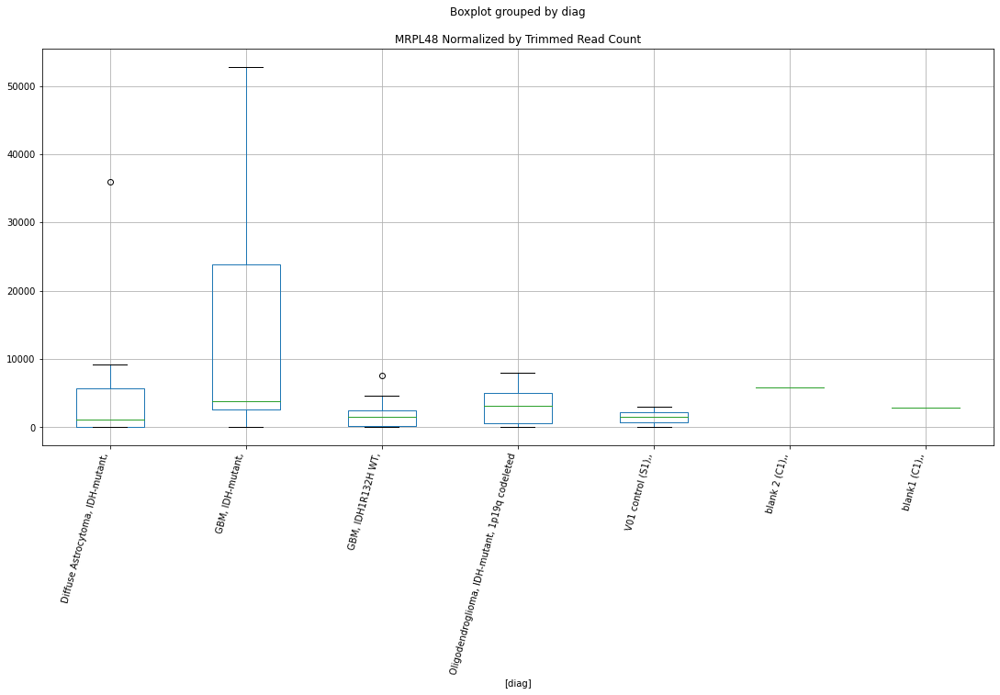

 p : 0.043586715726665407  ( t : 2.1705548960458723 ) :  Lexogen  :  bbduk2  :  MAF
Control and blanks
79          0.00
343    139065.88
Name: MAF, dtype: float64
211    10932.25
Name: MAF, dtype: float64
475    5748.38
Name: MAF, dtype: float64


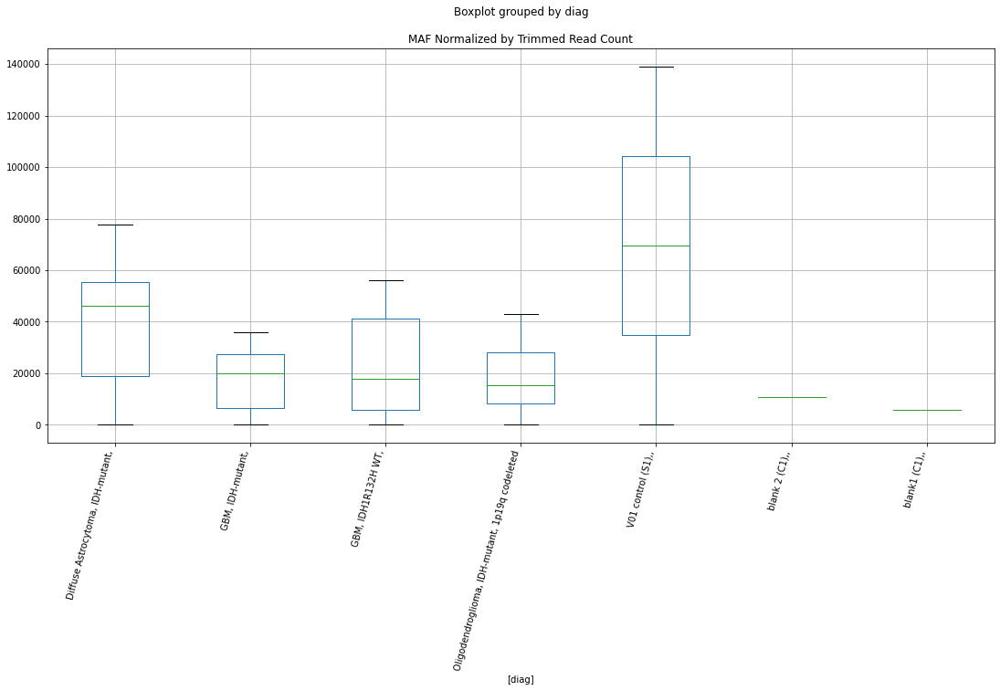

 p : 0.043588406822236976  ( t : 2.170535331901805 ) :  D-plex  :  bbduk2  :  OR4K17
Control and blanks
73     0.0
337    0.0
Name: OR4K17, dtype: float64
205    716.36
Name: OR4K17, dtype: float64
469    0.0
Name: OR4K17, dtype: float64


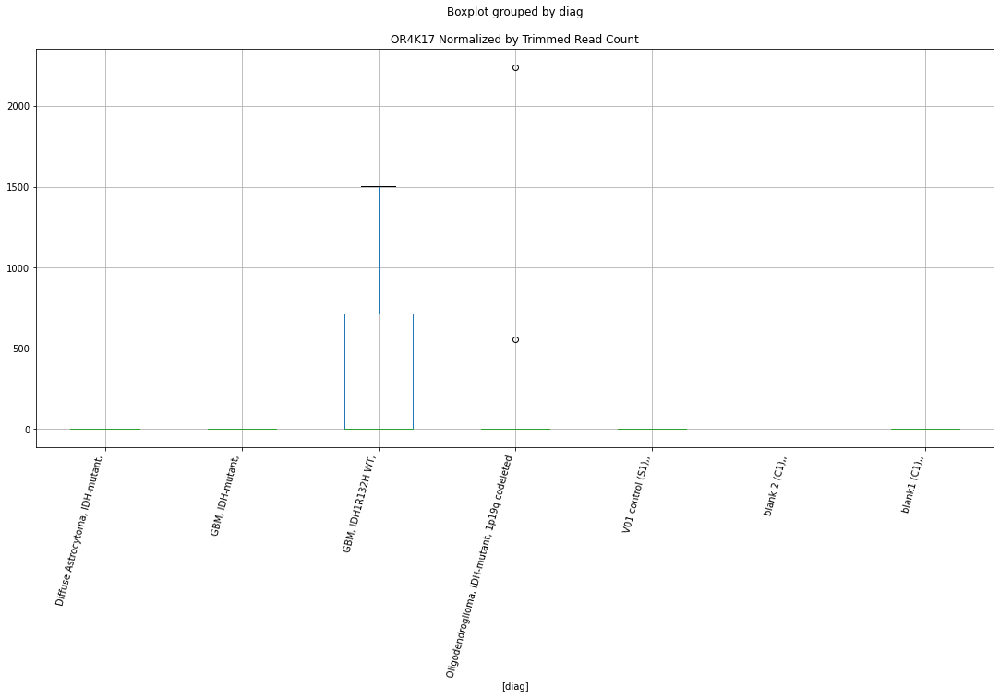

 p : 0.0436059202202649  ( t : 2.1703327617153065 ) :  D-plex  :  bbduk2  :  MAPK10
Control and blanks
73     0.0
337    0.0
Name: MAPK10, dtype: float64
205    6447.27
Name: MAPK10, dtype: float64
469    4732.22
Name: MAPK10, dtype: float64


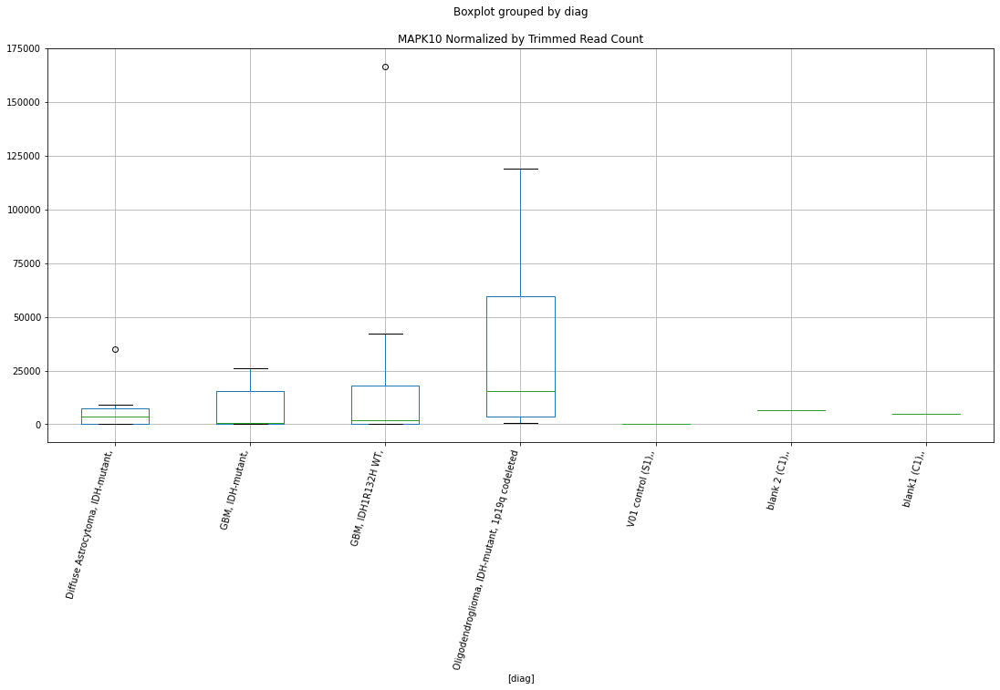

 p : 0.043626265283134624  ( t : 2.170097532354802 ) :  D-plex  :  cutadapt2  :  LOC112267875
Control and blanks
76     0.0
340    0.0
Name: LOC112267875, dtype: float64
208    1939.96
Name: LOC112267875, dtype: float64
472    1733.87
Name: LOC112267875, dtype: float64


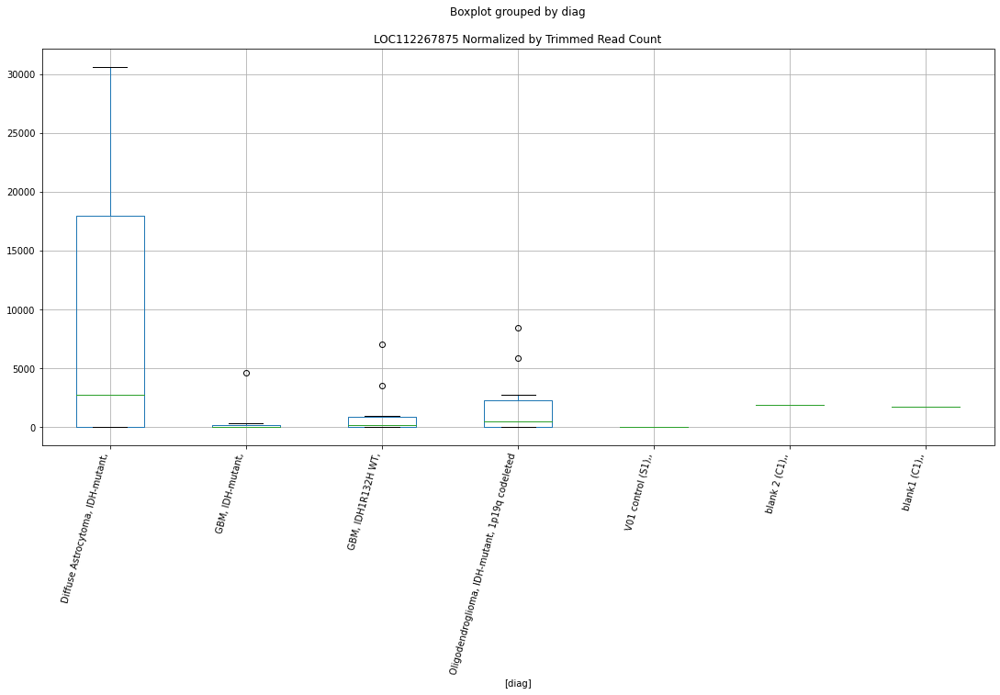

 p : 0.04386506921640518  ( t : 2.16734396678555 ) :  D-plex  :  cutadapt2  :  OR4K17
Control and blanks
76     0.0
340    0.0
Name: OR4K17, dtype: float64
208    529.08
Name: OR4K17, dtype: float64
472    0.0
Name: OR4K17, dtype: float64


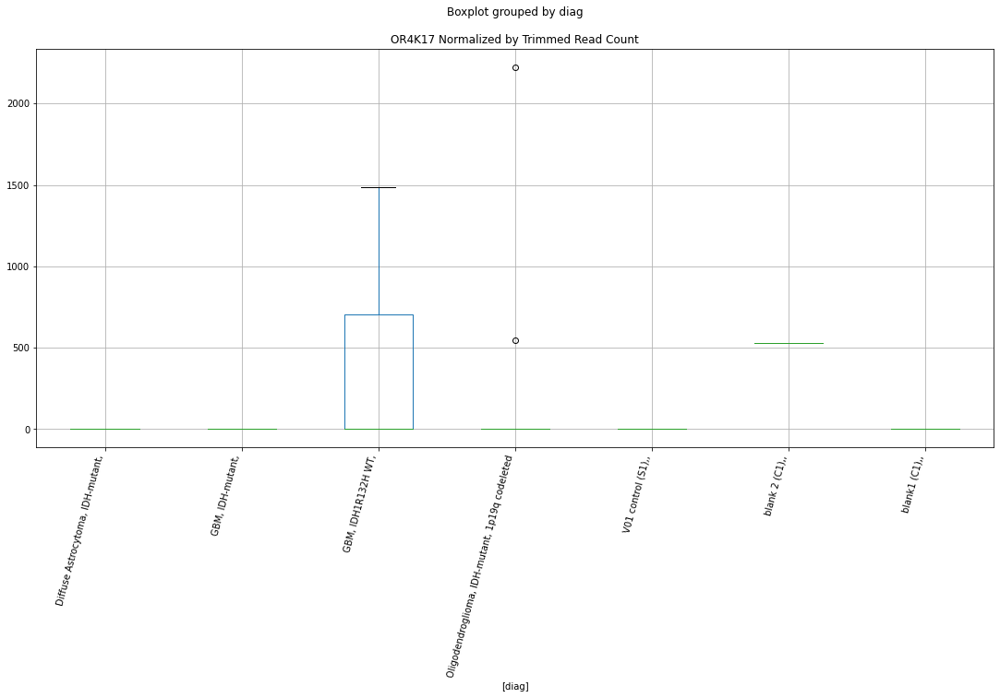

 p : 0.04396358832295839  ( t : 2.1662119736817935 ) :  D-plex  :  cutadapt2  :  NCAPG2
Control and blanks
76     10606.6
340        0.0
Name: NCAPG2, dtype: float64
208    7407.13
Name: NCAPG2, dtype: float64
472    23696.19
Name: NCAPG2, dtype: float64


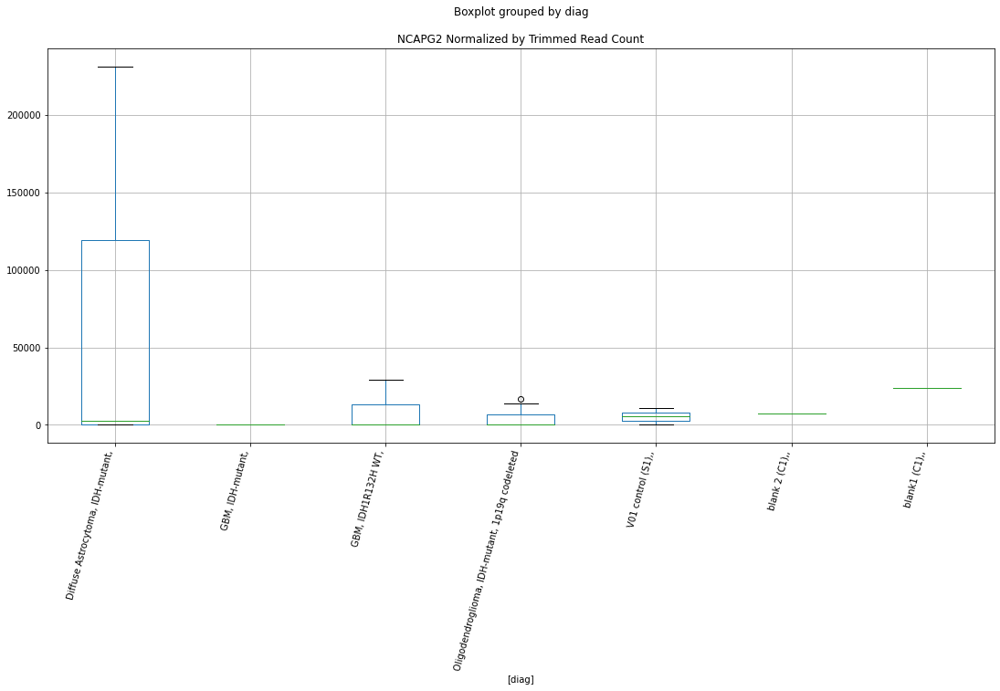

 p : 0.04398099353512459  ( t : 2.1660122276468936 ) :  D-plex  :  bbduk2  :  MYBPC3
Control and blanks
73     0.0
337    0.0
Name: MYBPC3, dtype: float64
205    537.27
Name: MYBPC3, dtype: float64
469    1183.05
Name: MYBPC3, dtype: float64


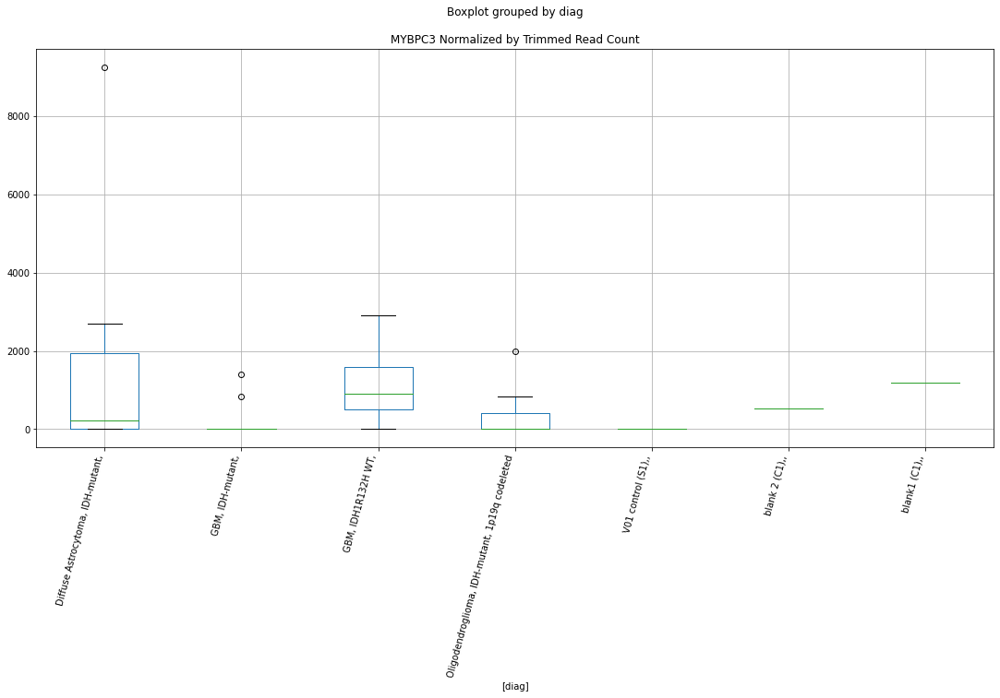

 p : 0.04398470741225384  ( t : 2.1659696157437716 ) :  D-plex  :  bbduk2  :  LOC107986655
Control and blanks
73     0.0
337    0.0
Name: LOC107986655, dtype: float64
205    1790.91
Name: LOC107986655, dtype: float64
469    0.0
Name: LOC107986655, dtype: float64


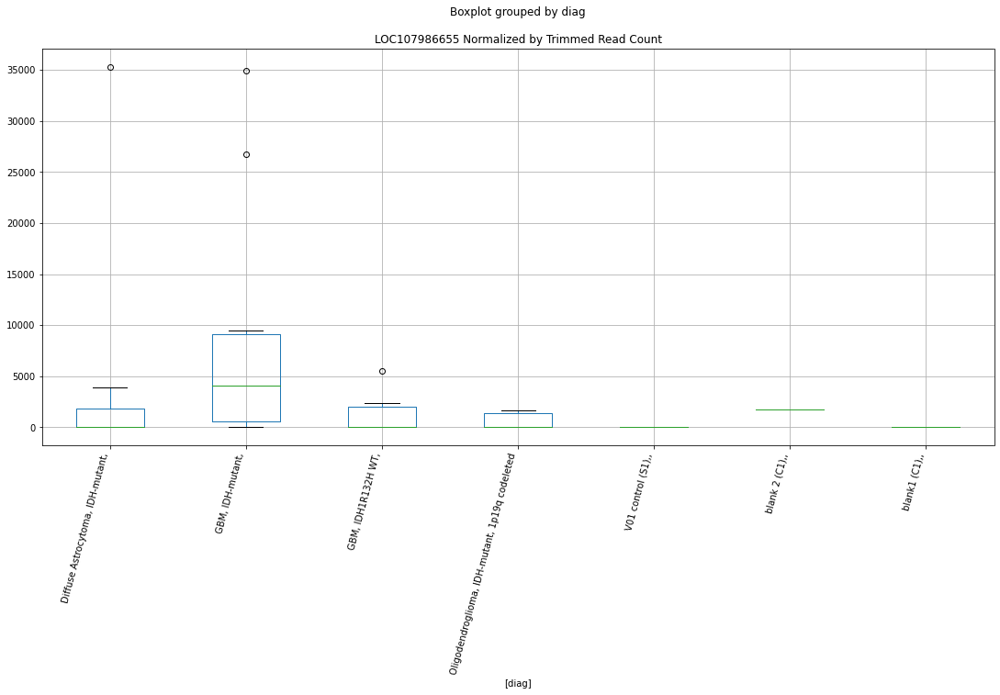

 p : 0.04400343698753756  ( t : 2.165754768426512 ) :  D-plex  :  bbduk2  :  NEK8
Control and blanks
73     30920.34
337        0.00
Name: NEK8, dtype: float64
205    1253.64
Name: NEK8, dtype: float64
469    1774.58
Name: NEK8, dtype: float64


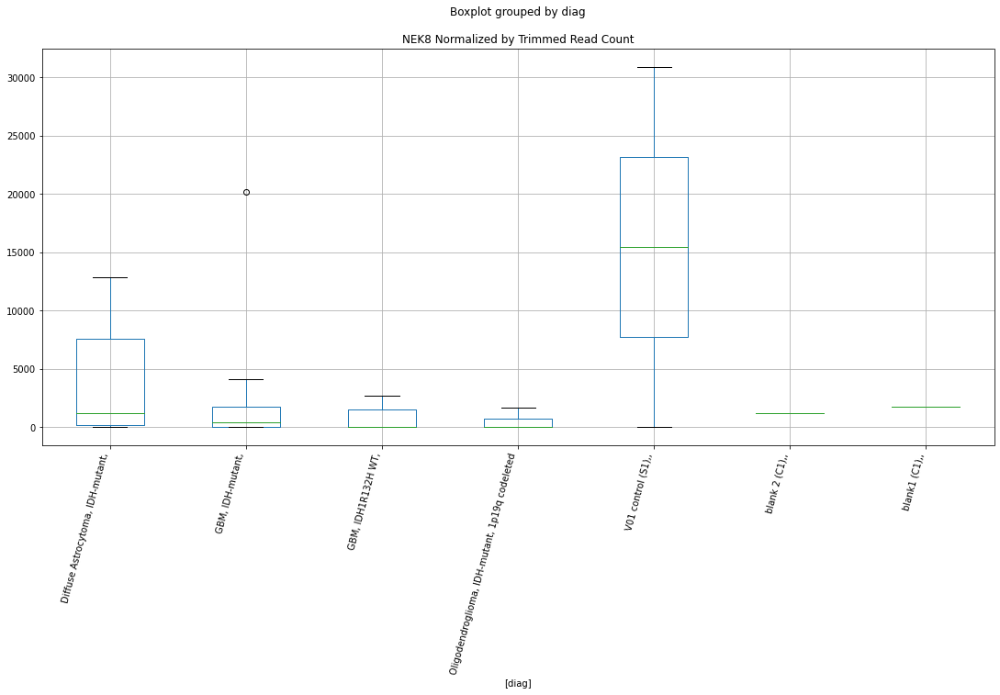

 p : 0.044034020354758736  ( t : 2.165404125877523 ) :  D-plex  :  bbduk2  :  LOC112267875
Control and blanks
73     0.0
337    0.0
Name: LOC112267875, dtype: float64
205    2328.18
Name: LOC112267875, dtype: float64
469    1774.58
Name: LOC112267875, dtype: float64


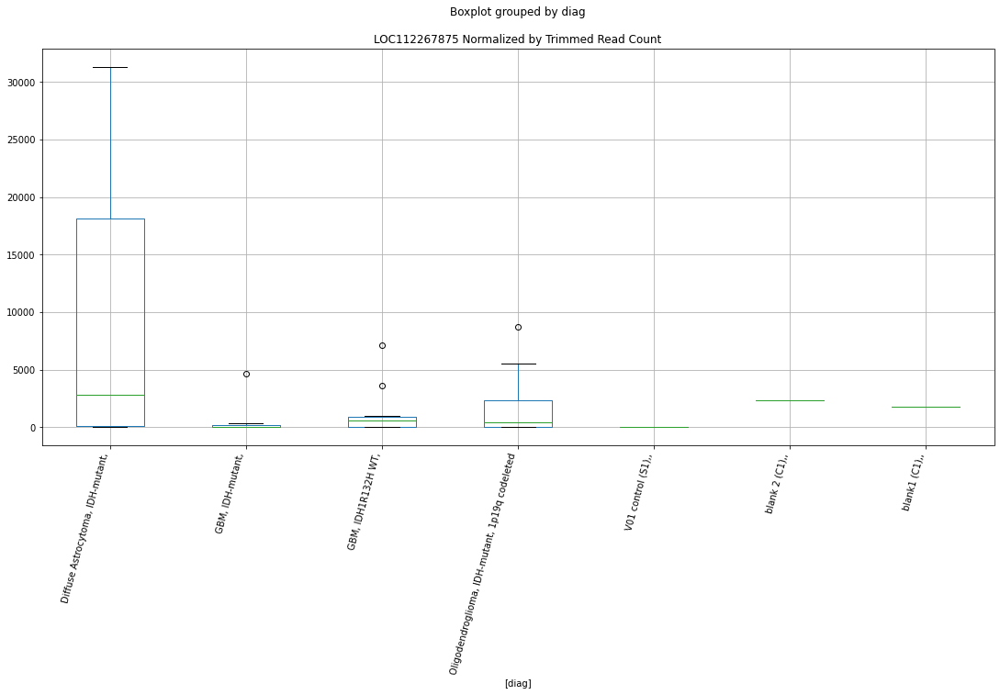

 p : 0.044178712053716  ( t : 2.163748230957089 ) :  D-plex  :  bbduk2  :  LVRN
Control and blanks
73     0.0
337    0.0
Name: LVRN, dtype: float64
205    0.0
Name: LVRN, dtype: float64
469    591.53
Name: LVRN, dtype: float64


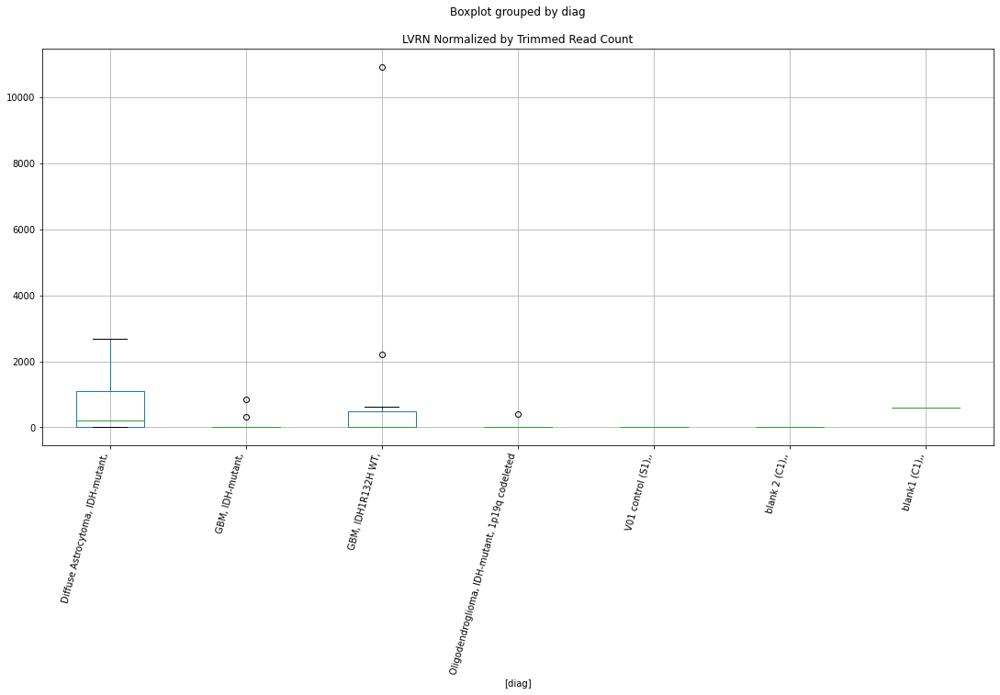

 p : 0.04418602303903624  ( t : 2.1636646936400434 ) :  Lexogen  :  bbduk2  :  MTX3
Control and blanks
79     108725.51
343         0.00
Name: MTX3, dtype: float64
211    9839.03
Name: MTX3, dtype: float64
475    0.0
Name: MTX3, dtype: float64


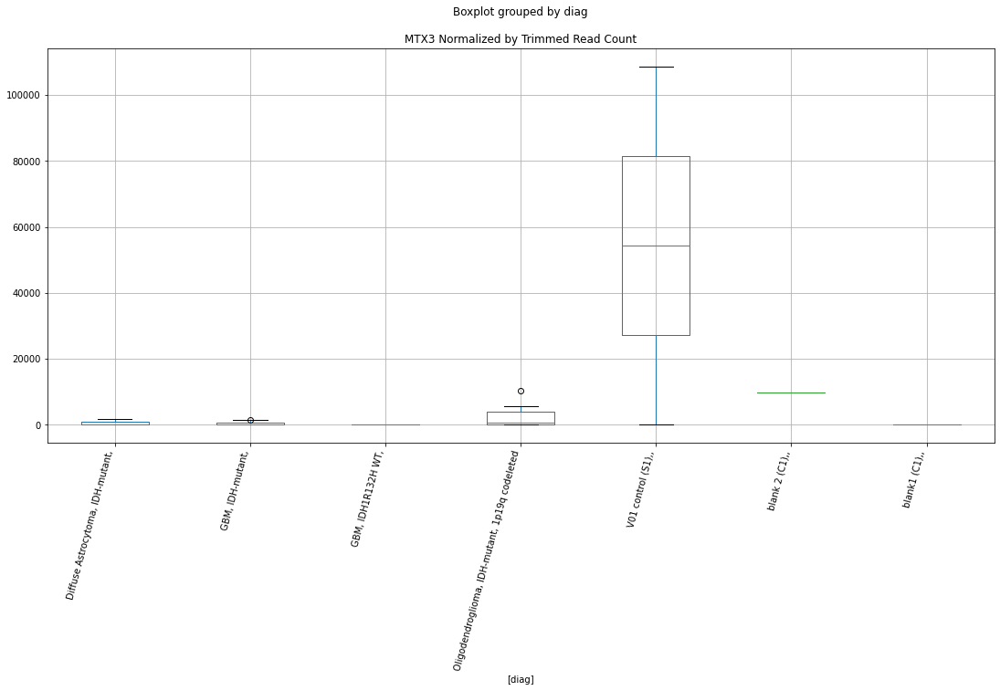

 p : 0.04421036607022425  ( t : 2.163386634644383 ) :  D-plex  :  bbduk2  :  LOC112267914
Control and blanks
73     0.0
337    0.0
Name: LOC112267914, dtype: float64
205    358.18
Name: LOC112267914, dtype: float64
469    0.0
Name: LOC112267914, dtype: float64


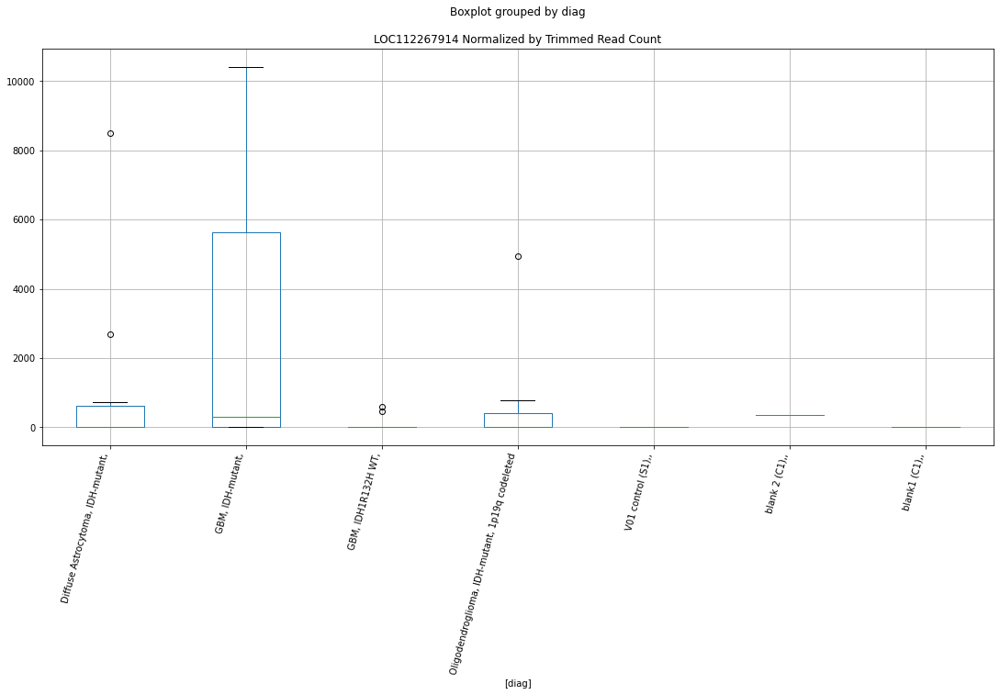

 p : 0.04430056402959137  ( t : 2.162357565469499 ) :  Lexogen  :  cutadapt2  :  MIR27B
Control and blanks
82         0.00
346    17255.63
Name: MIR27B, dtype: float64
214    0.0
Name: MIR27B, dtype: float64
478    0.0
Name: MIR27B, dtype: float64


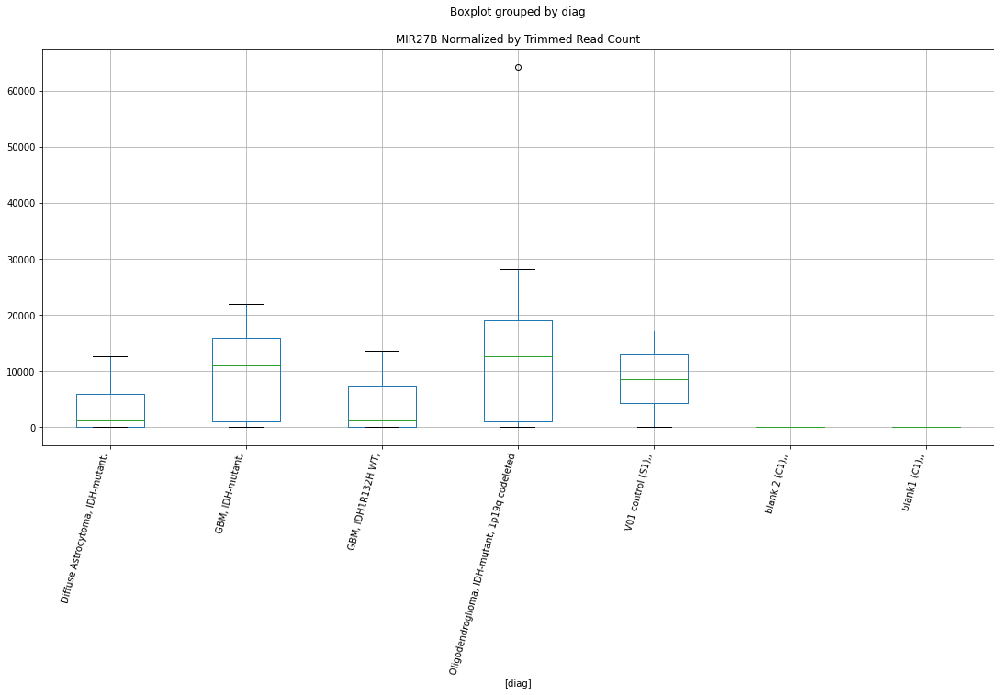

 p : 0.044356247406979986  ( t : 2.1617232299942004 ) :  Lexogen  :  cutadapt2  :  METRNL
Control and blanks
82       0.00
346    420.87
Name: METRNL, dtype: float64
214    0.0
Name: METRNL, dtype: float64
478    0.0
Name: METRNL, dtype: float64


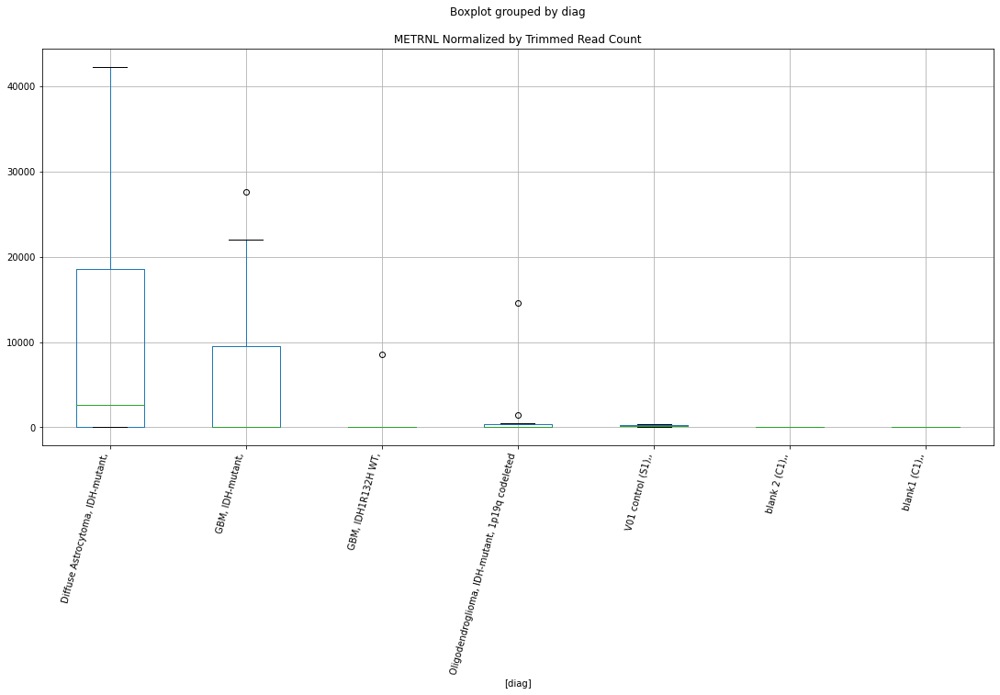

 p : 0.04454325666801872  ( t : 2.1595981709919783 ) :  D-plex  :  cutadapt2  :  MVP
Control and blanks
76     327289.34
340     17614.64
Name: MVP, dtype: float64
208    144615.38
Name: MVP, dtype: float64
472    83225.64
Name: MVP, dtype: float64


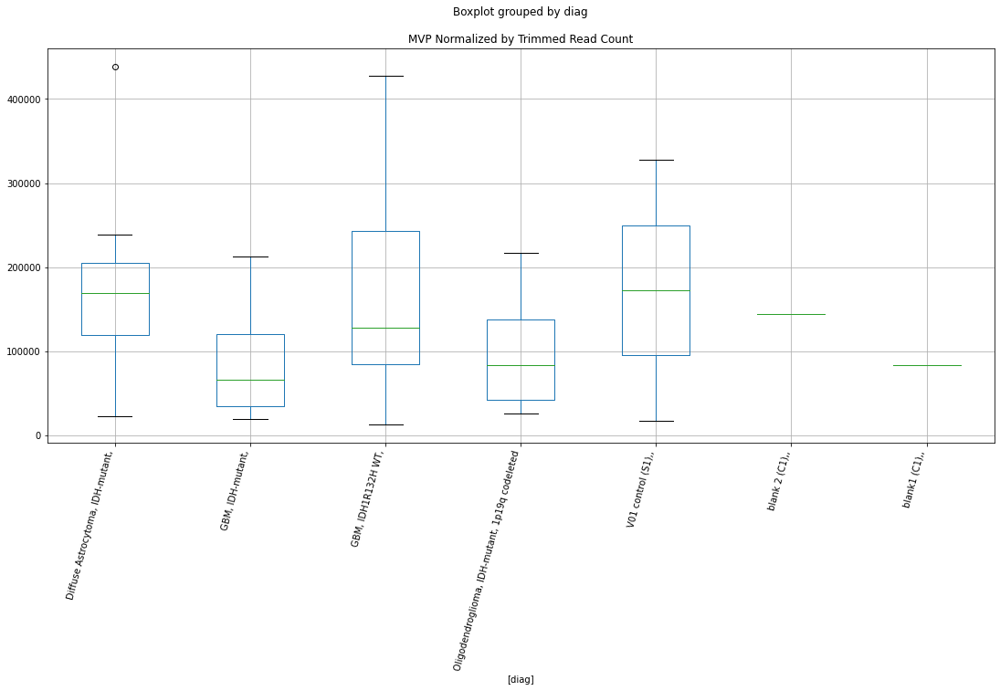

 p : 0.04456573994884776  ( t : 2.159343234504217 ) :  D-plex  :  cutadapt2  :  LRRC8B
Control and blanks
76       3030.46
340    211375.71
Name: LRRC8B, dtype: float64
208    11287.05
Name: LRRC8B, dtype: float64
472    4623.65
Name: LRRC8B, dtype: float64


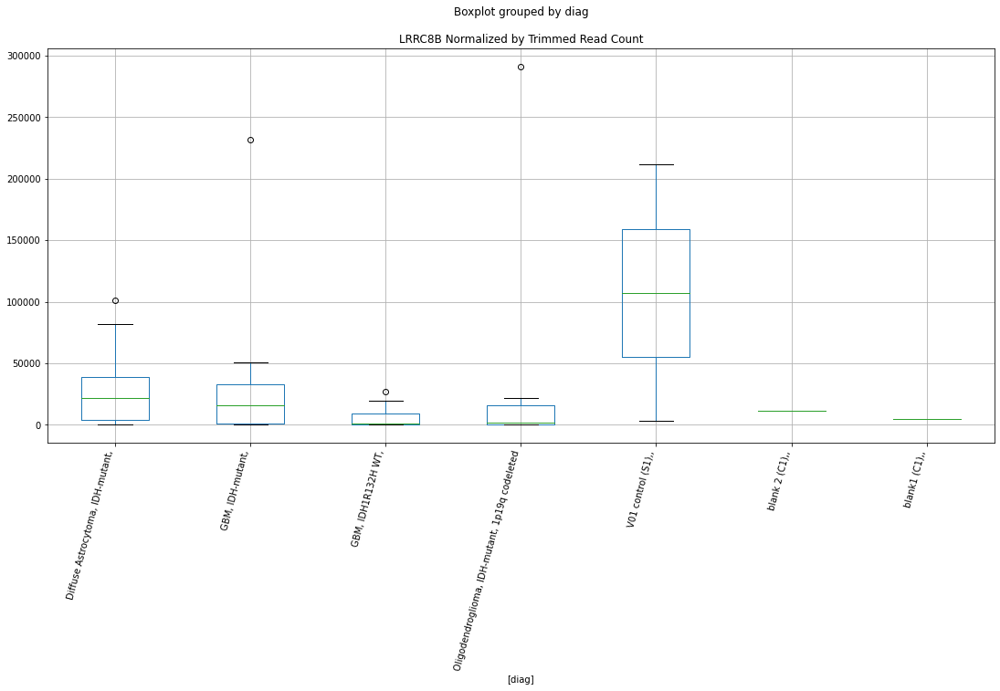

 p : 0.04457558082185029  ( t : 2.1592316864826326 ) :  Lexogen  :  bbduk2  :  LOX
Control and blanks
79     0.0
343    0.0
Name: LOX, dtype: float64
211    4919.51
Name: LOX, dtype: float64
475    0.0
Name: LOX, dtype: float64


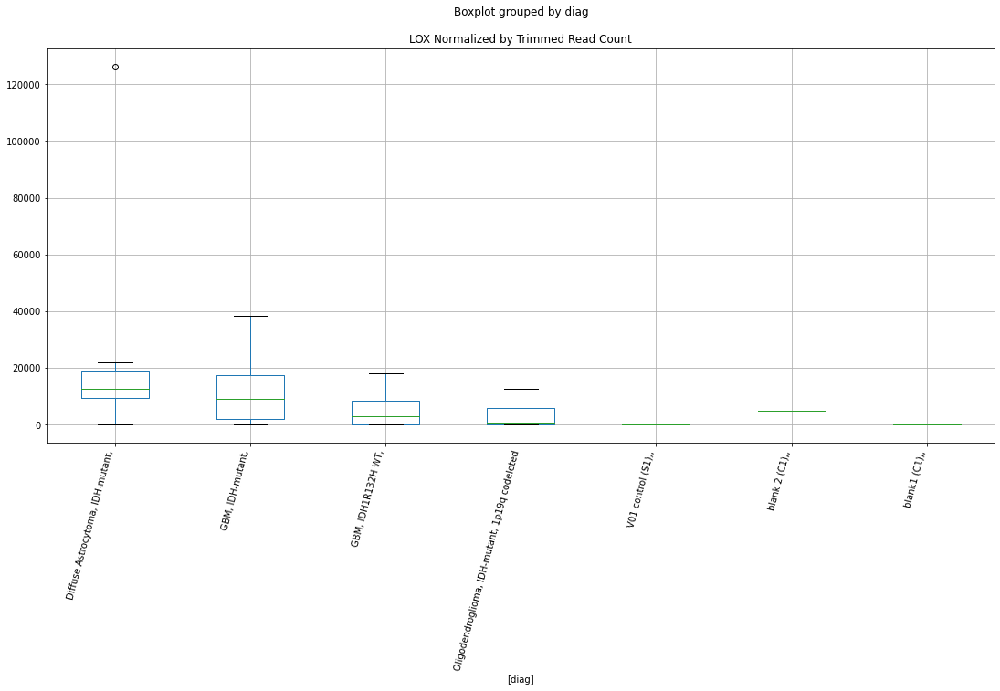

 p : 0.04464124363072535  ( t : 2.158487963022444 ) :  Lexogen  :  cutadapt2  :  NPTX2
Control and blanks
82     0.0
346    0.0
Name: NPTX2, dtype: float64
214    0.0
Name: NPTX2, dtype: float64
478    8548.58
Name: NPTX2, dtype: float64


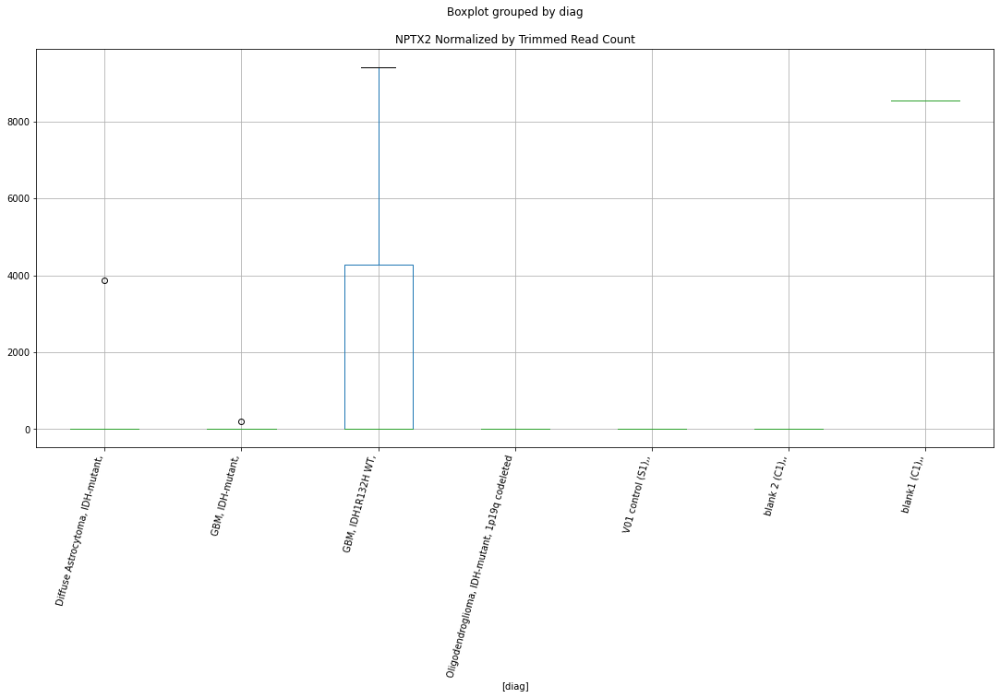

 p : 0.044645106928433265  ( t : 2.1584442369238324 ) :  D-plex  :  bbduk2  :  MAP1S
Control and blanks
73     3092.03
337       0.00
Name: MAP1S, dtype: float64
205    6805.46
Name: MAP1S, dtype: float64
469    1183.05
Name: MAP1S, dtype: float64


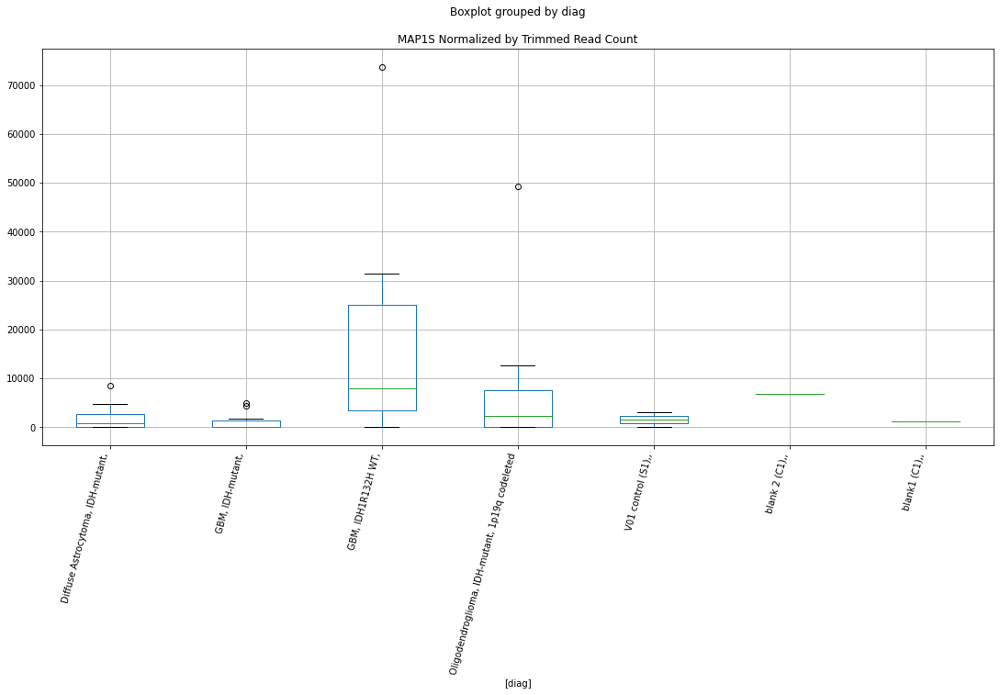

 p : 0.044656033806109115  ( t : 2.1583205815909774 ) :  Lexogen  :  bbduk2  :  LOC107986584
Control and blanks
79     0.0
343    0.0
Name: LOC107986584, dtype: float64
211    0.0
Name: LOC107986584, dtype: float64
475    0.0
Name: LOC107986584, dtype: float64


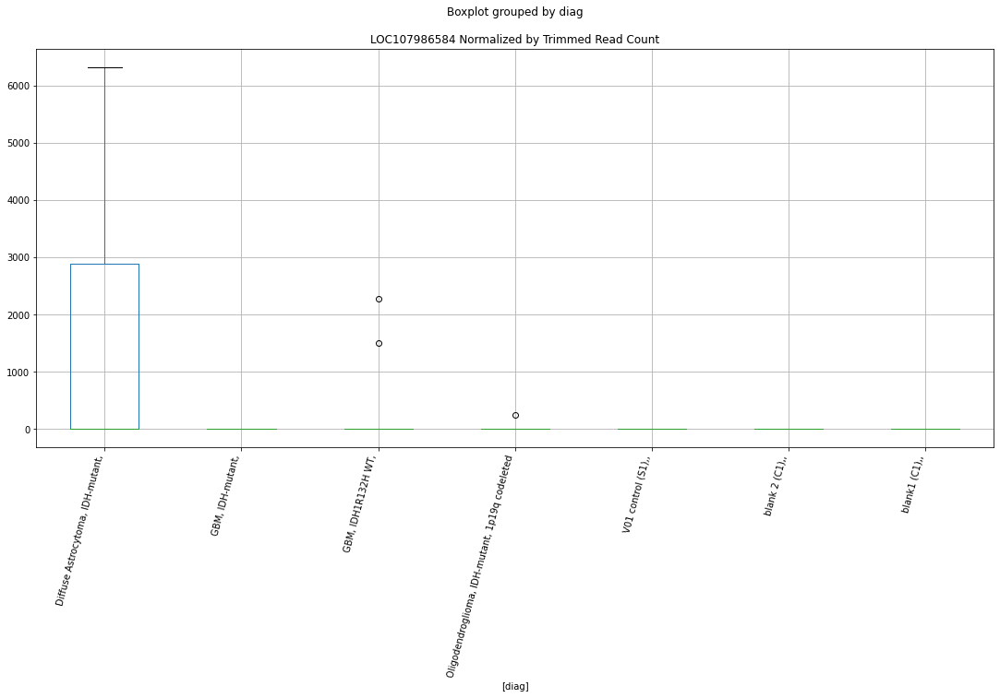

 p : 0.044682058890999084  ( t : 2.158026176968965 ) :  Lexogen  :  cutadapt2  :  LOC107986584
Control and blanks
82     0.0
346    0.0
Name: LOC107986584, dtype: float64
214    0.0
Name: LOC107986584, dtype: float64
478    0.0
Name: LOC107986584, dtype: float64


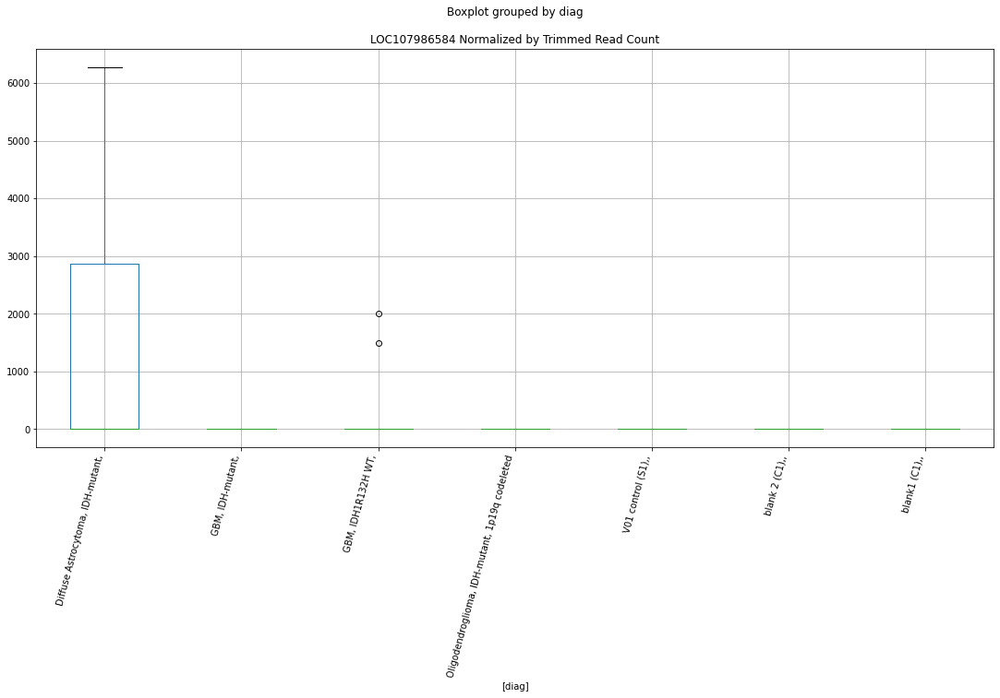

 p : 0.04470869412679541  ( t : 2.1577250324374417 ) :  D-plex  :  bbduk2  :  LOC112267865
Control and blanks
73       0.00
337    890.16
Name: LOC112267865, dtype: float64
205    1253.64
Name: LOC112267865, dtype: float64
469    3549.16
Name: LOC112267865, dtype: float64


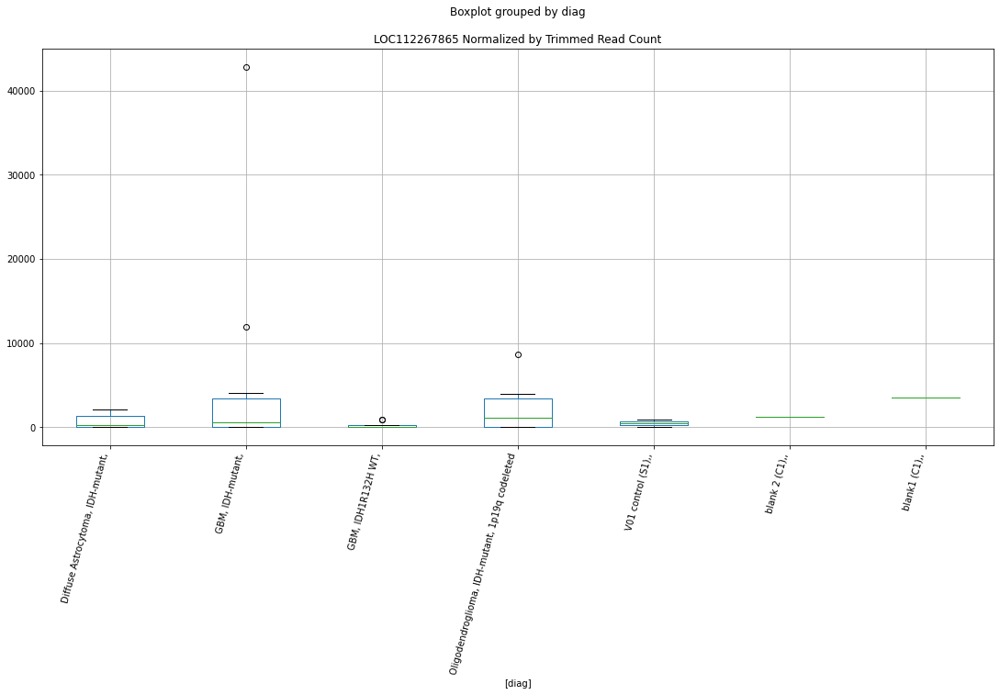

 p : 0.04472762351486076  ( t : 2.157511111830582 ) :  Lexogen  :  cutadapt2  :  LOC107986476
Control and blanks
82     0.0
346    0.0
Name: LOC107986476, dtype: float64
214    0.0
Name: LOC107986476, dtype: float64
478    0.0
Name: LOC107986476, dtype: float64


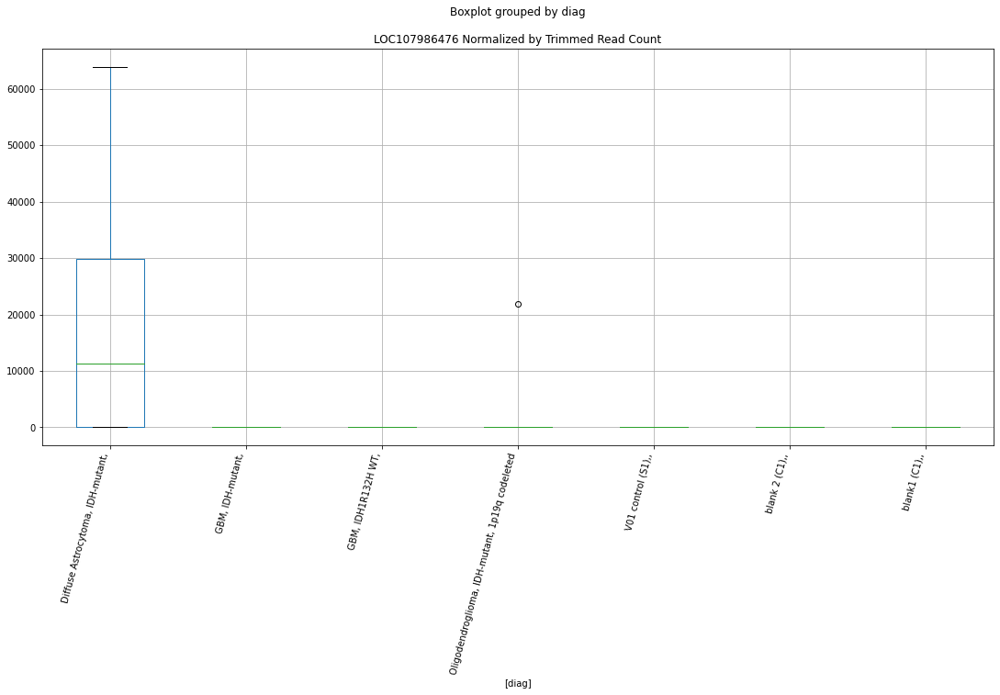

 p : 0.04476979145109358  ( t : 2.1570348703564965 ) :  D-plex  :  bbduk2  :  MLH3
Control and blanks
73     12368.13
337    55189.75
Name: MLH3, dtype: float64
205    27221.82
Name: MLH3, dtype: float64
469    18928.87
Name: MLH3, dtype: float64


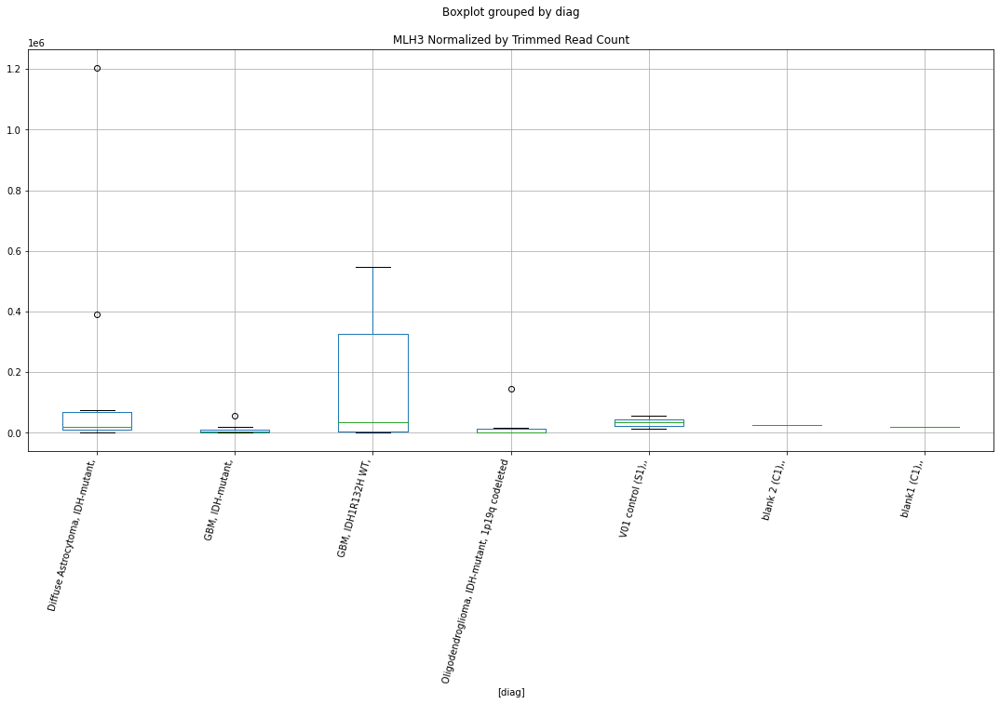

 p : 0.044788803204930894  ( t : 2.1568202871882107 ) :  D-plex  :  bbduk2  :  LOC107986382
Control and blanks
73     0.0
337    0.0
Name: LOC107986382, dtype: float64
205    358.18
Name: LOC107986382, dtype: float64
469    1774.58
Name: LOC107986382, dtype: float64


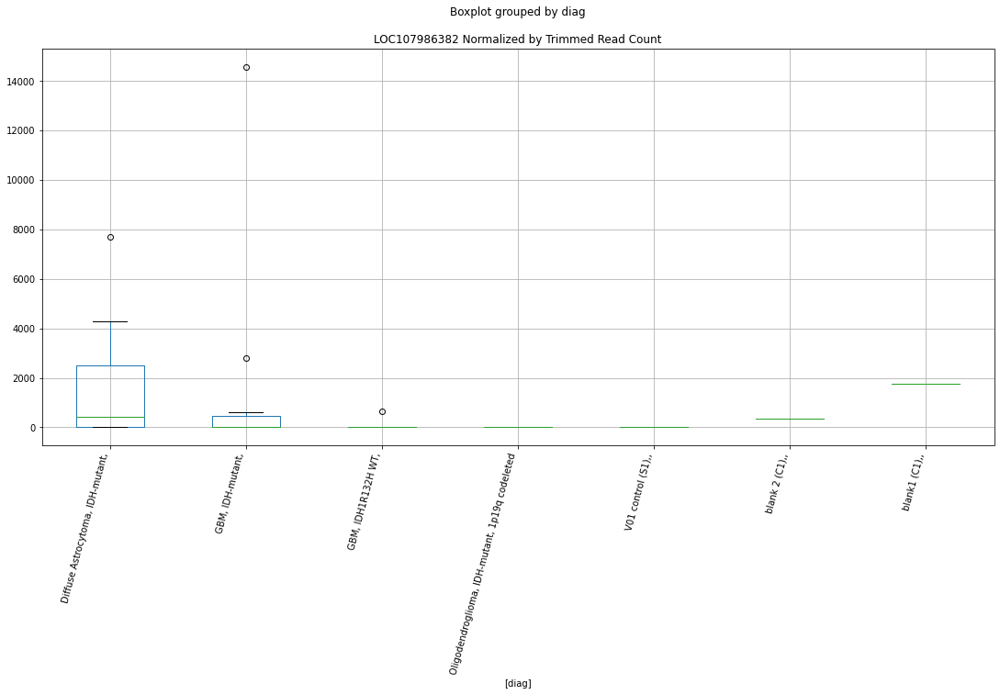

 p : 0.044798620792199075  ( t : 2.156709509977215 ) :  Lexogen  :  cutadapt2  :  LTBP3
Control and blanks
82     0.0
346    0.0
Name: LTBP3, dtype: float64
214    13018.87
Name: LTBP3, dtype: float64
478    0.0
Name: LTBP3, dtype: float64


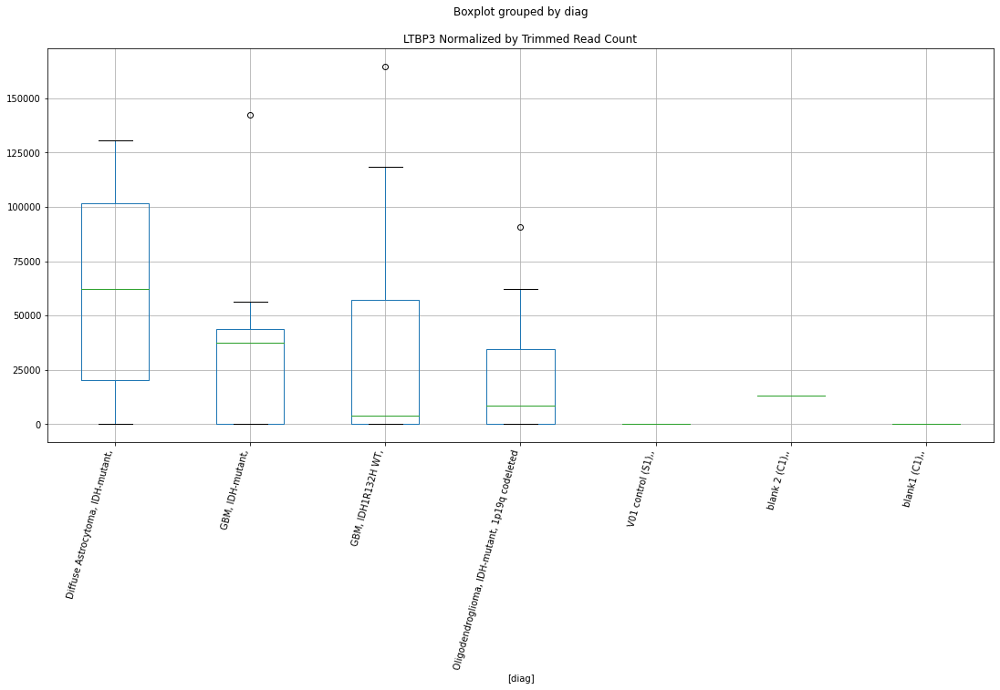

 p : 0.04480269565123674  ( t : 2.156663537630809 ) :  Lexogen  :  bbduk2  :  MEX3D
Control and blanks
79     0.0
343    0.0
Name: MEX3D, dtype: float64
211    0.0
Name: MEX3D, dtype: float64
475    0.0
Name: MEX3D, dtype: float64


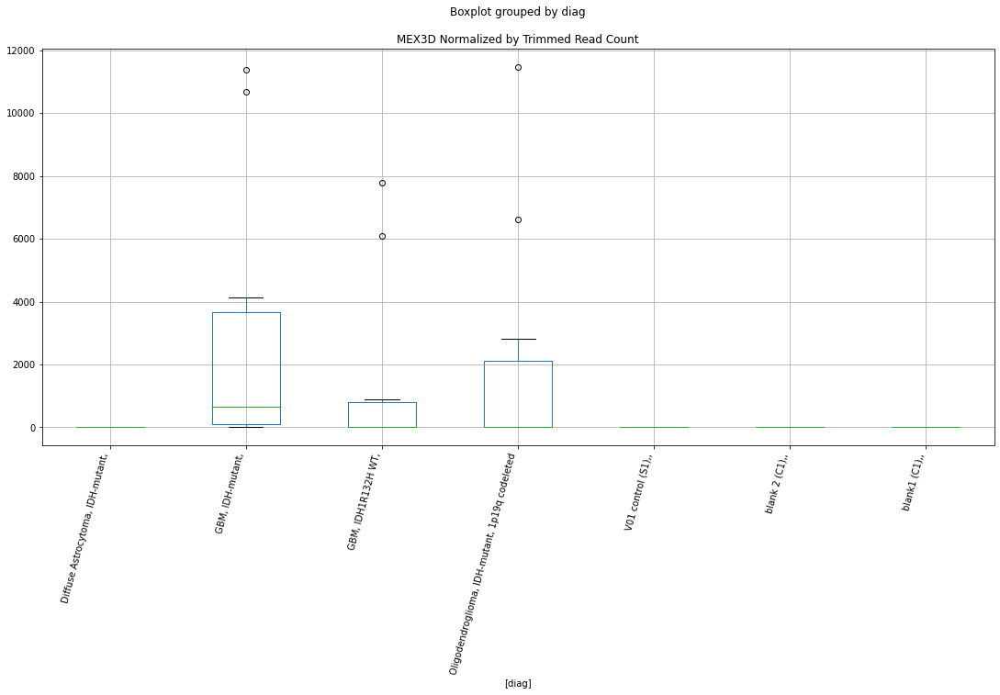

 p : 0.044858602238135856  ( t : 2.156033188185855 ) :  D-plex  :  bbduk2  :  MVP
Control and blanks
73     337031.66
337     17803.15
Name: MVP, dtype: float64
205    149003.67
Name: MVP, dtype: float64
469    85179.93
Name: MVP, dtype: float64


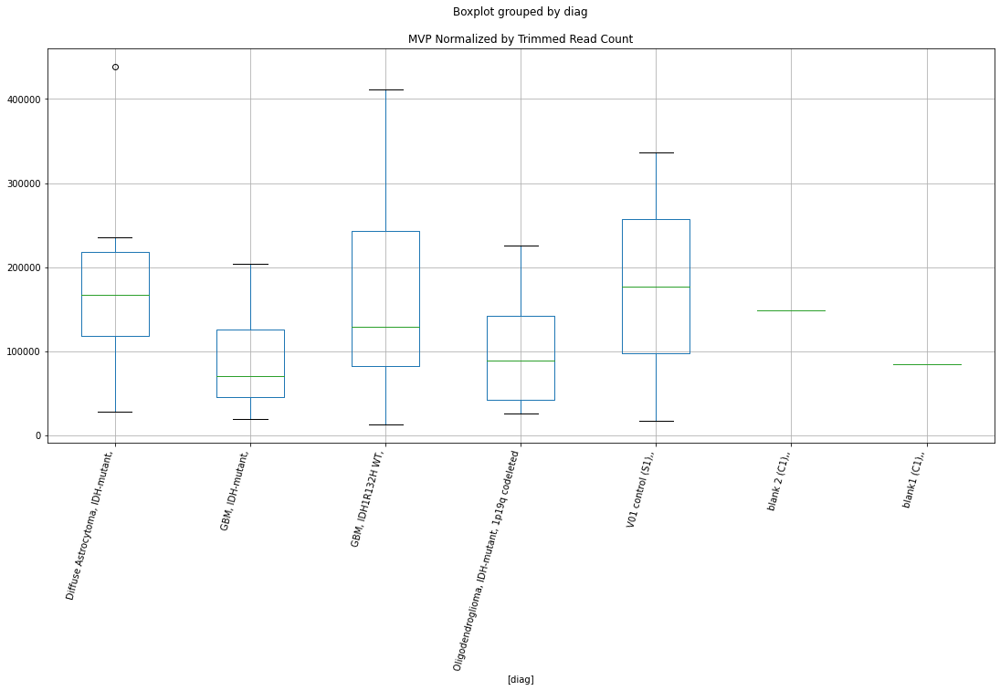

 p : 0.04490445642577178  ( t : 2.155516715950457 ) :  D-plex  :  cutadapt2  :  NME9
Control and blanks
76     540178.93
340     40513.68
Name: NME9, dtype: float64
208    1.63e+06
Name: NME9, dtype: float64
472    297069.3
Name: NME9, dtype: float64


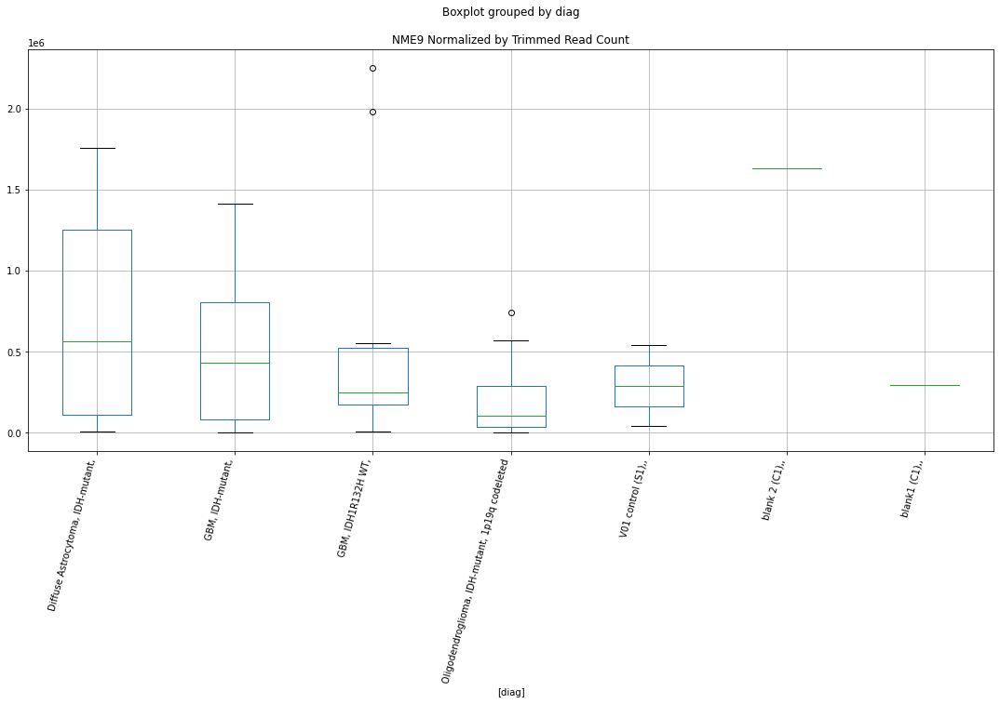

 p : 0.04500938763622711  ( t : 2.1543366496765217 ) :  D-plex  :  cutadapt2  :  LOC107986382
Control and blanks
76     0.0
340    0.0
Name: LOC107986382, dtype: float64
208    352.72
Name: LOC107986382, dtype: float64
472    1733.87
Name: LOC107986382, dtype: float64


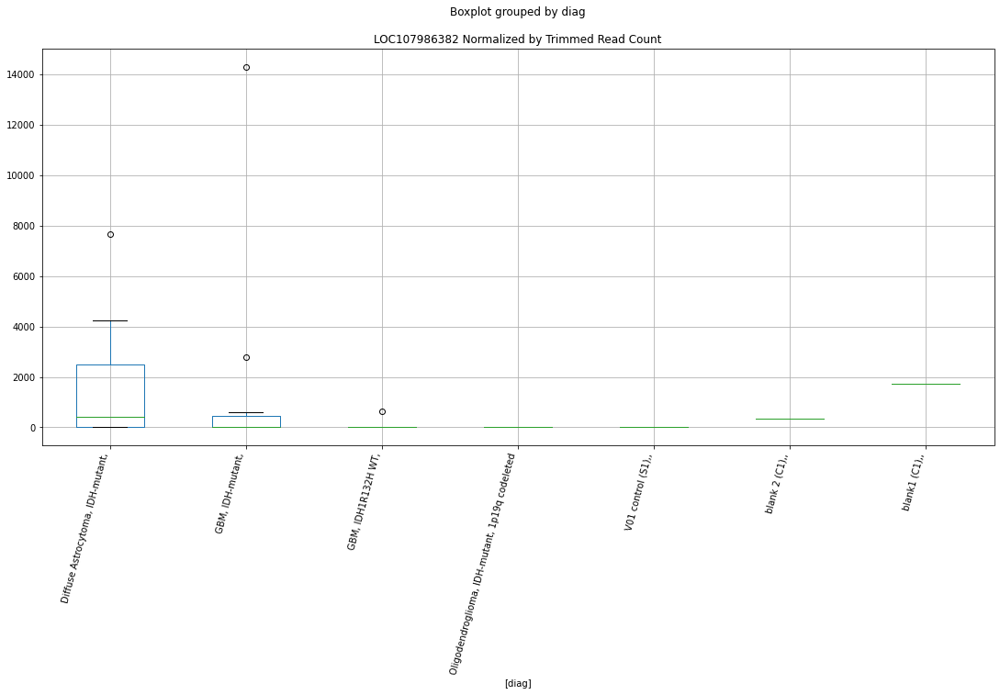

 p : 0.045089553224565725  ( t : 2.153436793322045 ) :  D-plex  :  bbduk2  :  MYO7A
Control and blanks
73      6184.07
337    42727.55
Name: MYO7A, dtype: float64
205    23102.73
Name: MYO7A, dtype: float64
469    14196.66
Name: MYO7A, dtype: float64


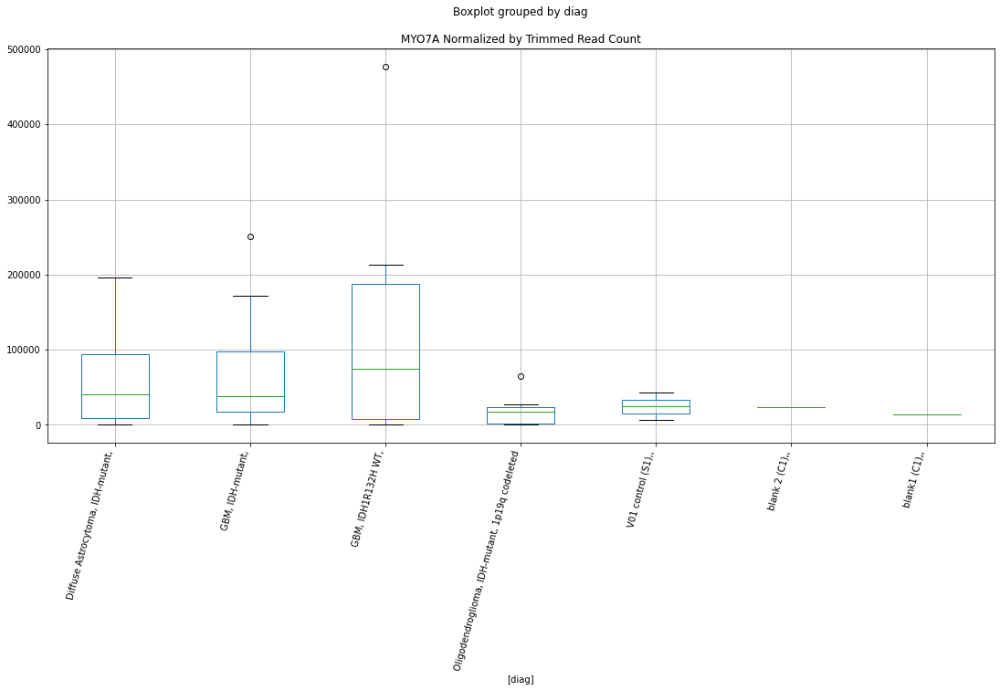

 p : 0.045129892667147356  ( t : 2.1529845372195395 ) :  D-plex  :  bbduk2  :  NKAIN1
Control and blanks
73     0.0
337    0.0
Name: NKAIN1, dtype: float64
205    1611.82
Name: NKAIN1, dtype: float64
469    3549.16
Name: NKAIN1, dtype: float64


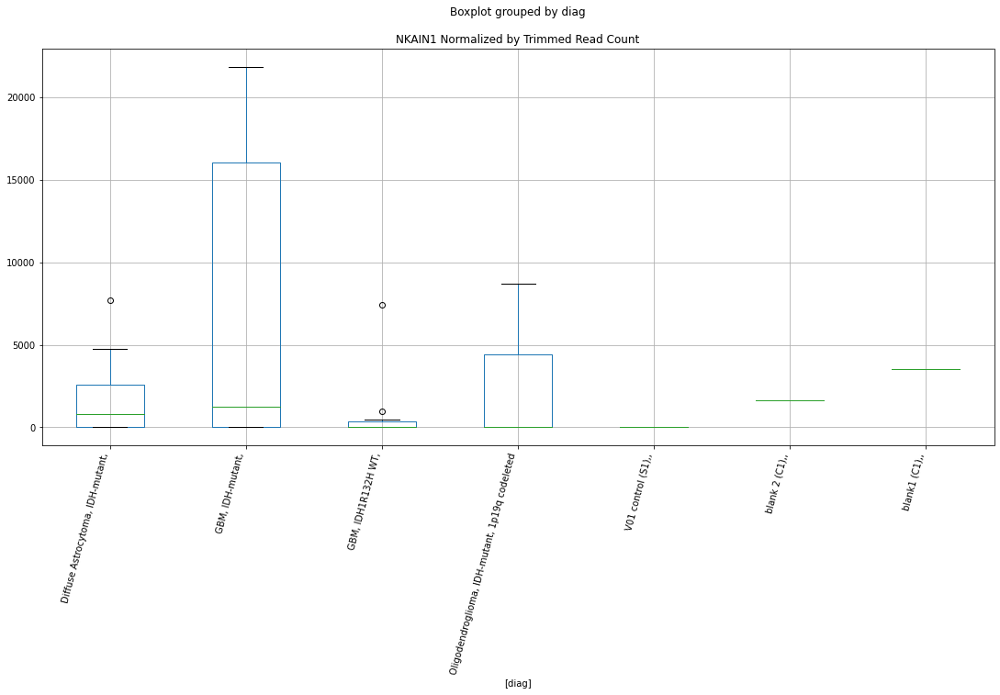

 p : 0.04517791783401925  ( t : 2.152446595978185 ) :  D-plex  :  cutadapt2  :  MKRN1
Control and blanks
76     3788.07
340       0.00
Name: MKRN1, dtype: float64
208    2469.04
Name: MKRN1, dtype: float64
472    10403.21
Name: MKRN1, dtype: float64


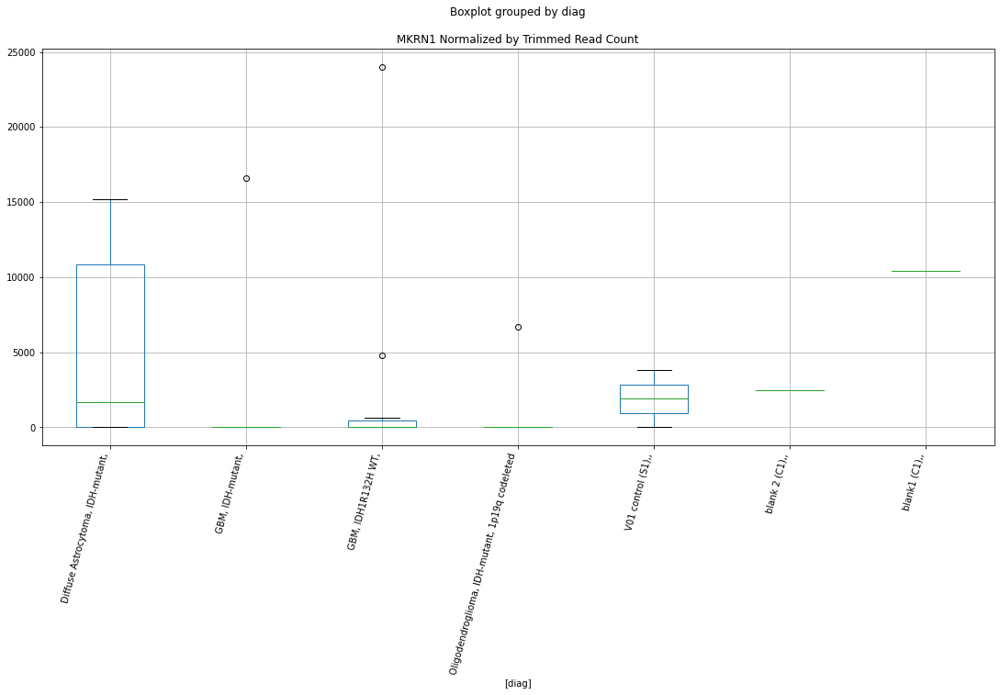

 p : 0.04521425199953692  ( t : 2.152039955577824 ) :  Lexogen  :  cutadapt2  :  MAML2
Control and blanks
82       0.00
346    210.43
Name: MAML2, dtype: float64
214    271.23
Name: MAML2, dtype: float64
478    11873.02
Name: MAML2, dtype: float64


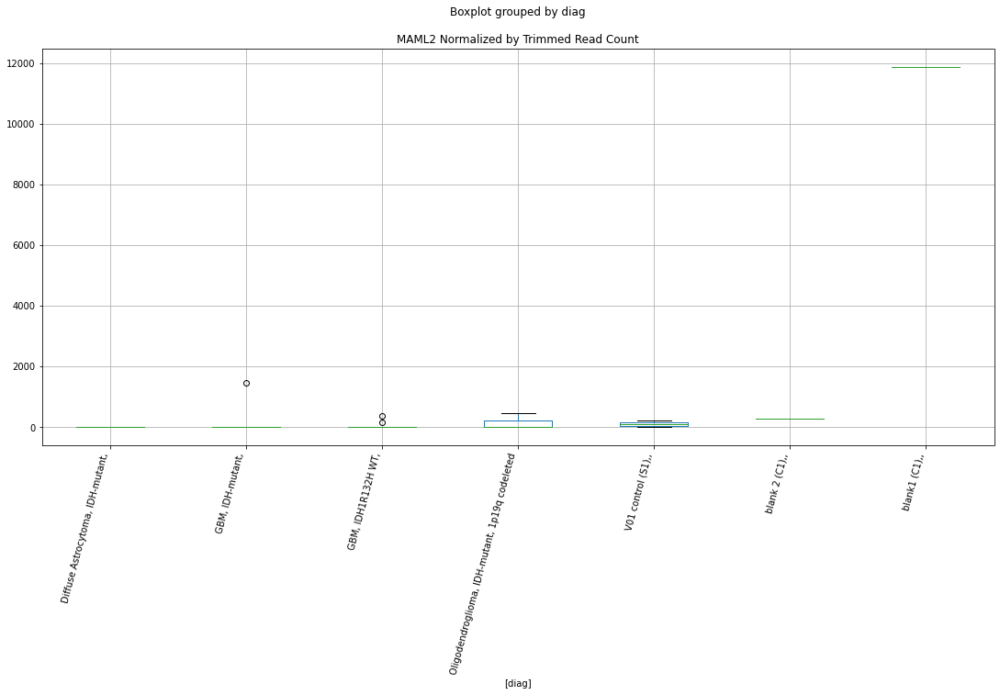

 p : 0.04541376998799506  ( t : 2.14981232186699 ) :  D-plex  :  bbduk2  :  NIM1K
Control and blanks
73     0.0
337    0.0
Name: NIM1K, dtype: float64
205    1253.64
Name: NIM1K, dtype: float64
469    0.0
Name: NIM1K, dtype: float64


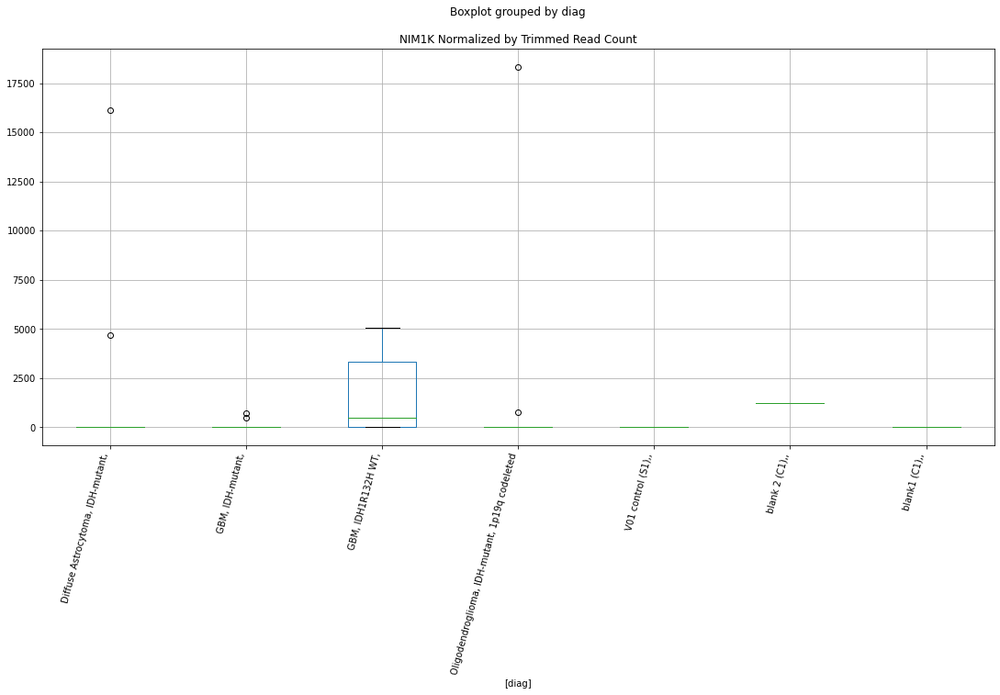

 p : 0.04543241355349074  ( t : 2.149604622130454 ) :  D-plex  :  cutadapt2  :  LRRC4
Control and blanks
76     0.0
340    0.0
Name: LRRC4, dtype: float64
208    5467.17
Name: LRRC4, dtype: float64
472    13870.94
Name: LRRC4, dtype: float64


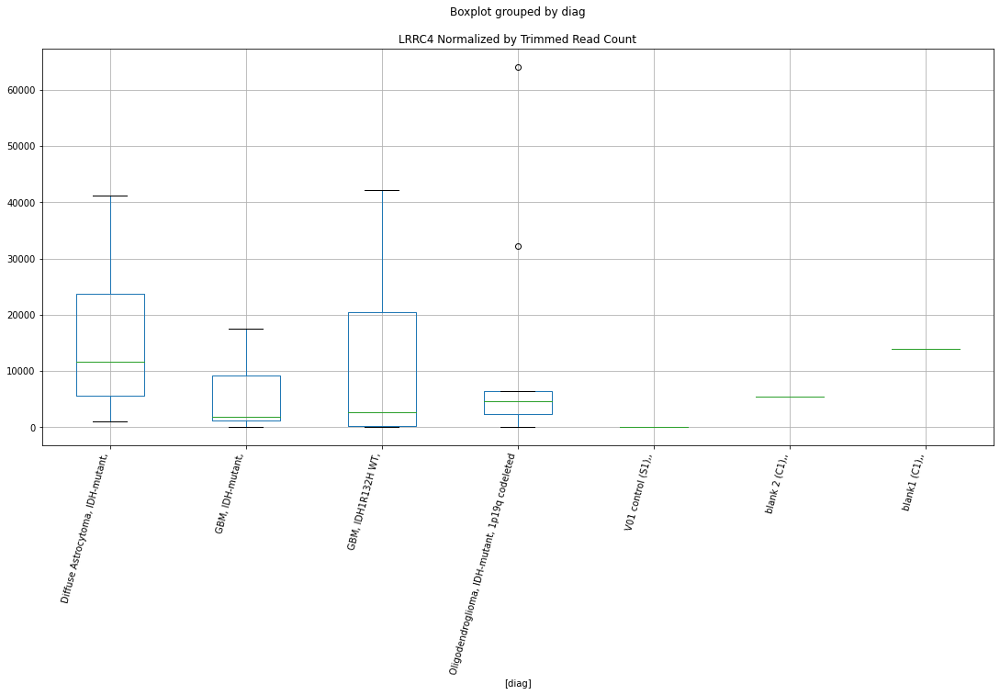

 p : 0.04543253162400133  ( t : 2.1496033070071676 ) :  D-plex  :  cutadapt2  :  NSMCE2
Control and blanks
76      757.61
340    1761.46
Name: NSMCE2, dtype: float64
208    705.44
Name: NSMCE2, dtype: float64
472    1155.91
Name: NSMCE2, dtype: float64


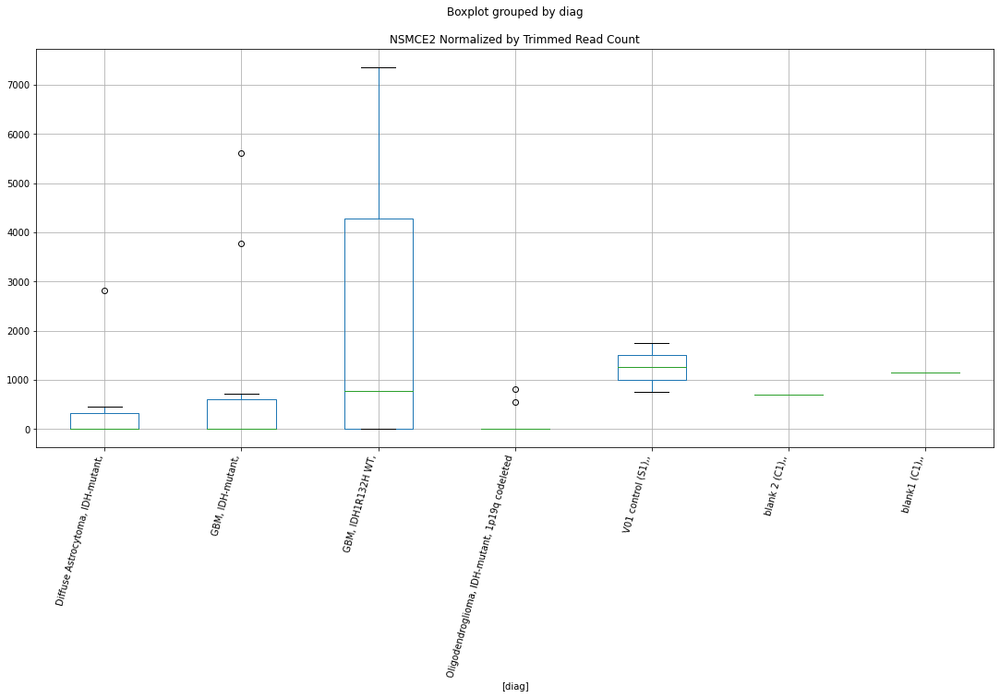

 p : 0.045462041173145576  ( t : 2.149274714048634 ) :  Lexogen  :  cutadapt2  :  MIR16-1
Control and blanks
82          0.00
346    170451.96
Name: MIR16-1, dtype: float64
214    813.68
Name: MIR16-1, dtype: float64
478    474.92
Name: MIR16-1, dtype: float64


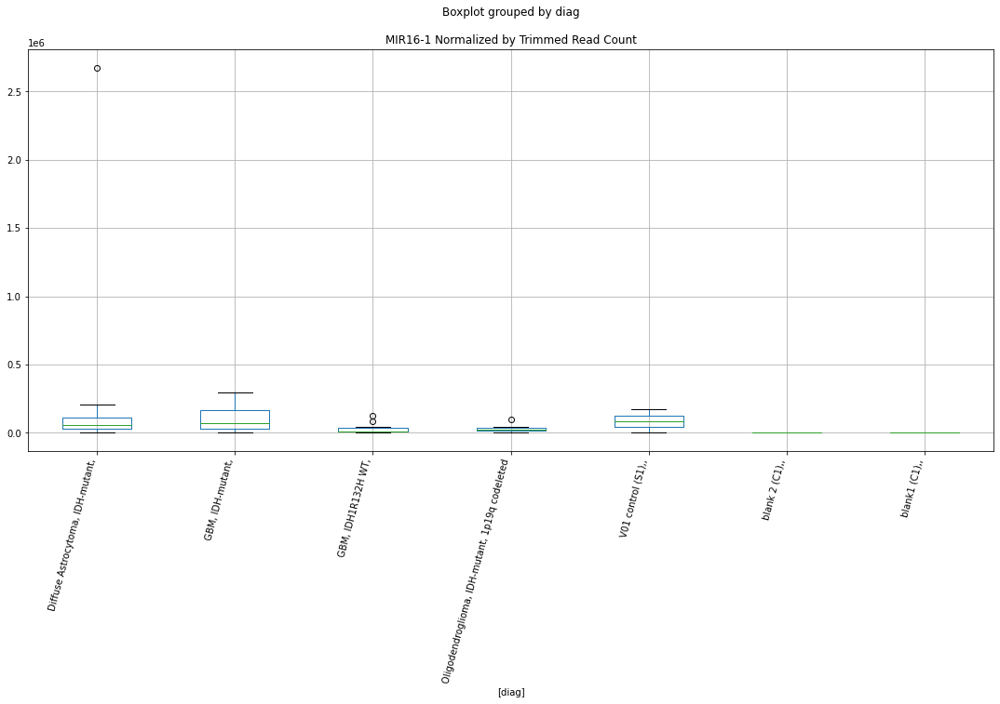

 p : 0.04548826164997347  ( t : 2.14898290883337 ) :  Lexogen  :  cutadapt2  :  NAXD
Control and blanks
82     39761.43
346        0.00
Name: NAXD, dtype: float64
214    0.0
Name: NAXD, dtype: float64
478    0.0
Name: NAXD, dtype: float64


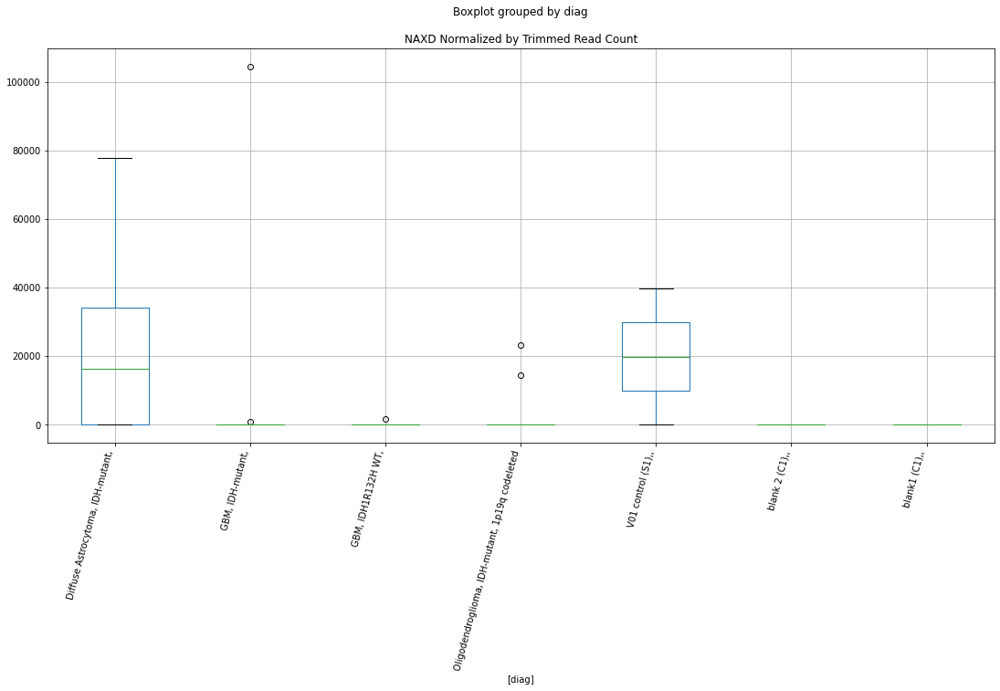

 p : 0.04554455235324459  ( t : 2.1483569736276724 ) :  D-plex  :  bbduk2  :  MCOLN2
Control and blanks
73     708848.70
337    168239.72
Name: MCOLN2, dtype: float64
205    66084.56
Name: MCOLN2, dtype: float64
469    2.28e+06
Name: MCOLN2, dtype: float64


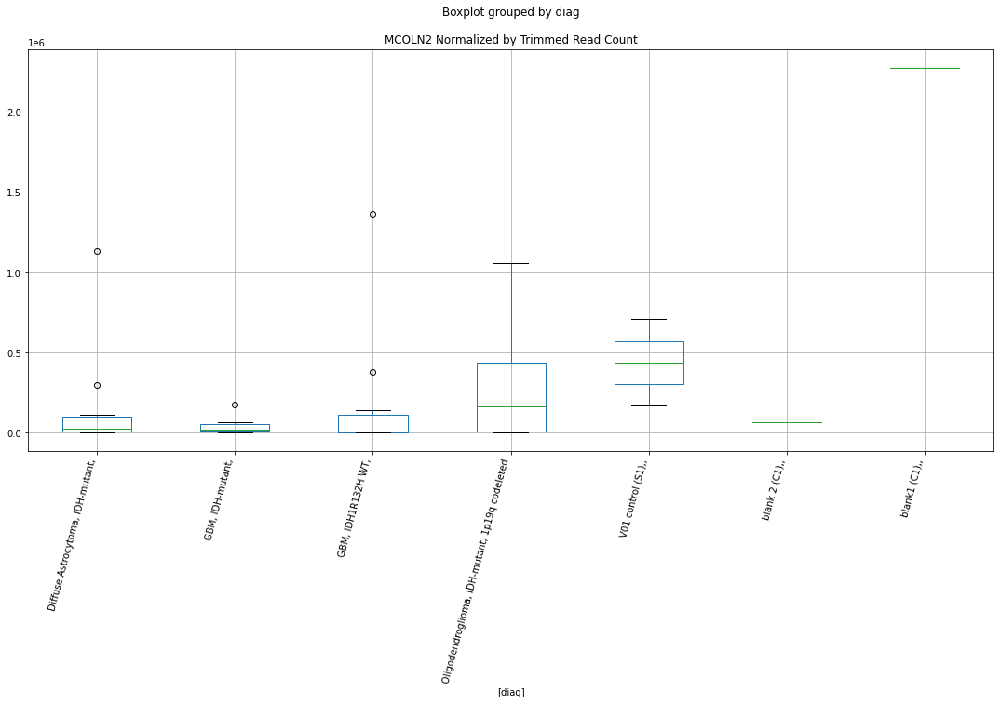

 p : 0.04556970982453868  ( t : 2.148077458817641 ) :  Lexogen  :  bbduk2  :  MIR16-1
Control and blanks
79          0.00
343    171337.65
Name: MIR16-1, dtype: float64
211    819.92
Name: MIR16-1, dtype: float64
475    479.03
Name: MIR16-1, dtype: float64


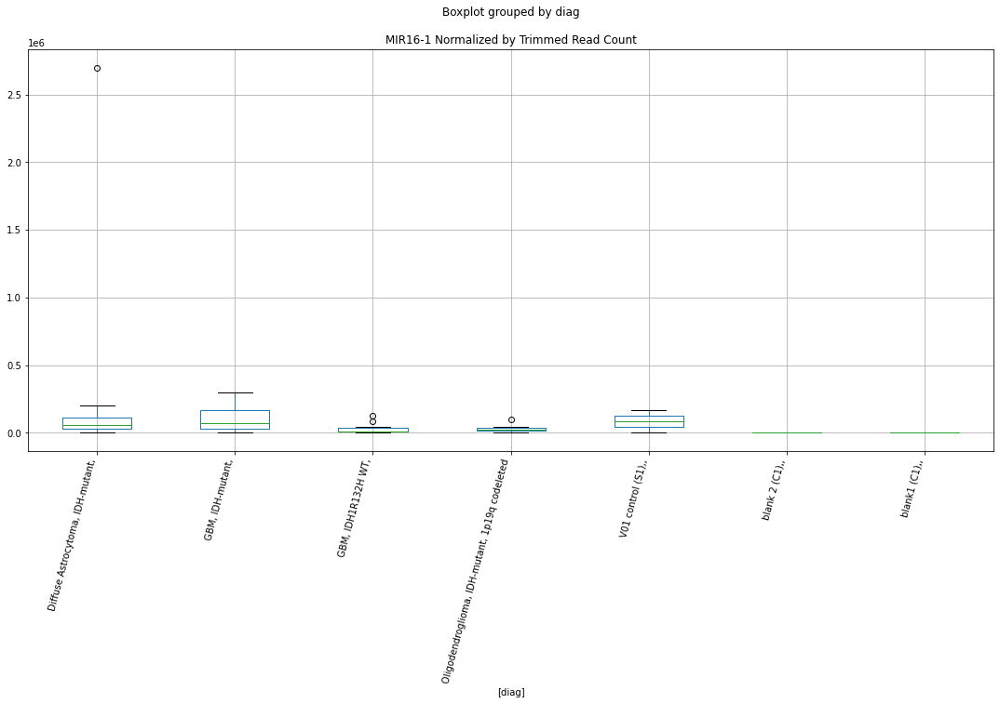

 p : 0.045597664635535176  ( t : 2.1477670291654256 ) :  D-plex  :  cutadapt2  :  NYAP1
Control and blanks
76     757.61
340    880.73
Name: NYAP1, dtype: float64
208    1763.6
Name: NYAP1, dtype: float64
472    577.96
Name: NYAP1, dtype: float64


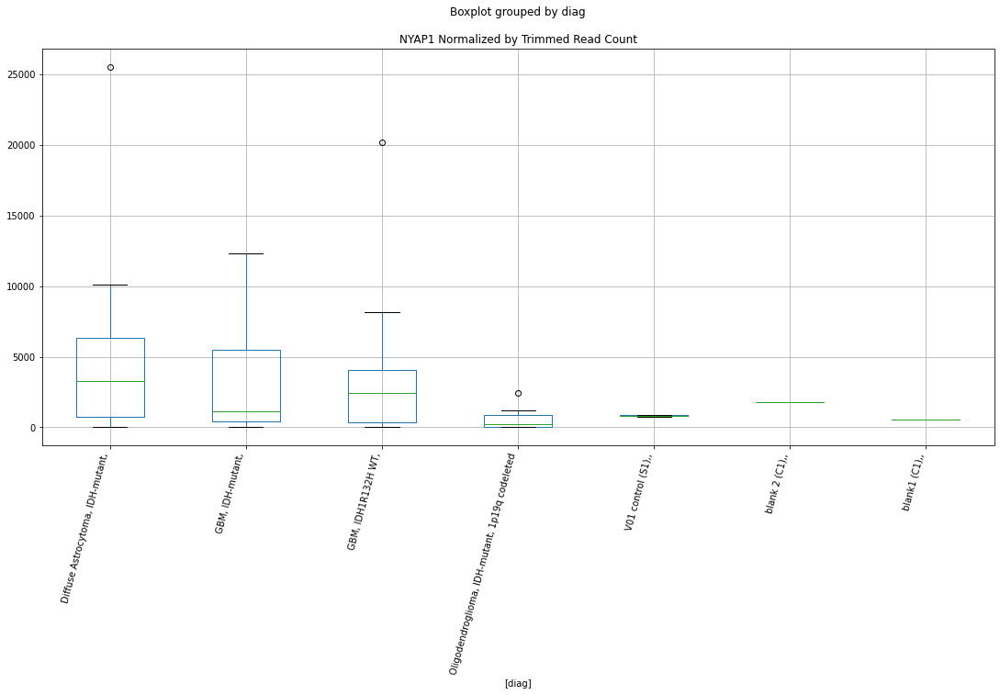

 p : 0.04562561591137553  ( t : 2.1474568125442306 ) :  Lexogen  :  bbduk2  :  NAXD
Control and blanks
79     40056.77
343        0.00
Name: NAXD, dtype: float64
211    0.0
Name: NAXD, dtype: float64
475    0.0
Name: NAXD, dtype: float64


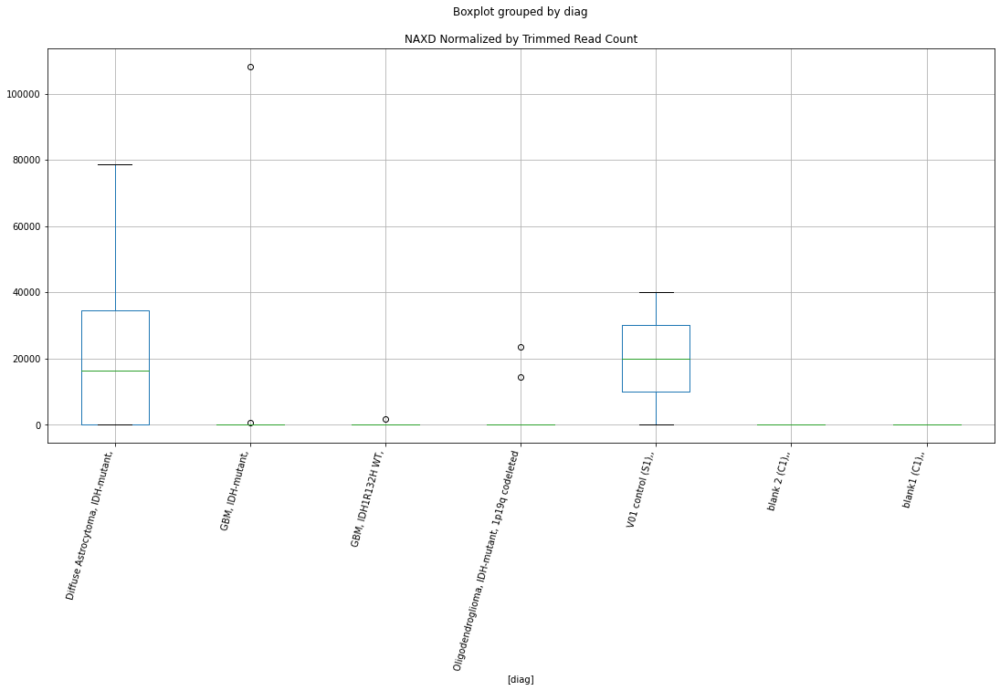

 p : 0.04562993157973153  ( t : 2.1474089306660256 ) :  D-plex  :  bbduk2  :  NIPA2
Control and blanks
73     30920.34
337        0.00
Name: NIPA2, dtype: float64
205    28654.55
Name: NIPA2, dtype: float64
469    0.0
Name: NIPA2, dtype: float64


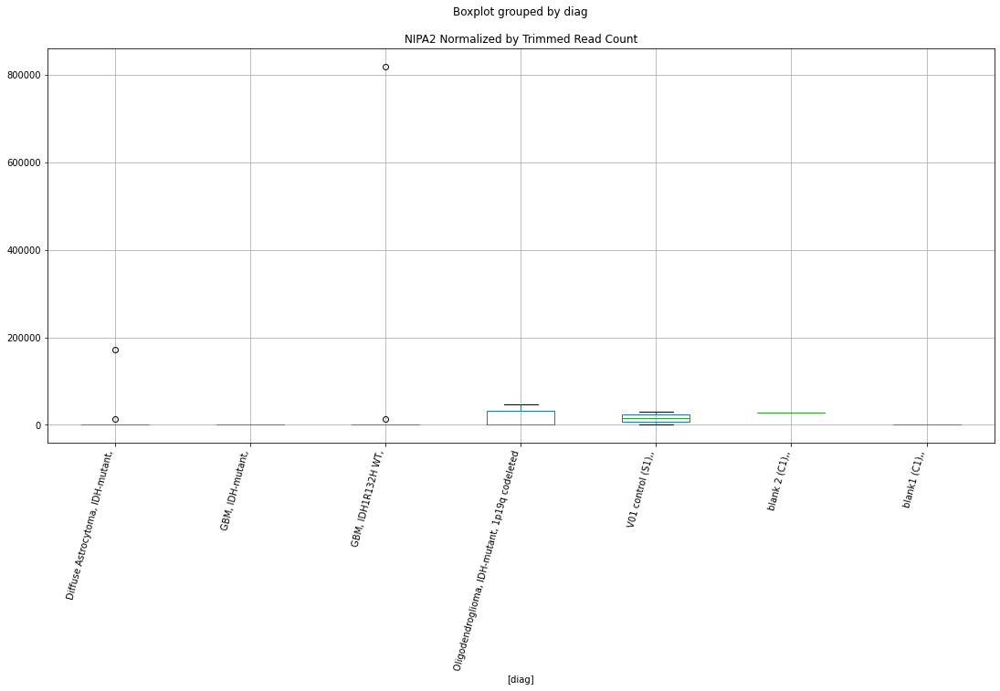

 p : 0.045630577156457415  ( t : 2.1474017684170907 ) :  D-plex  :  bbduk2  :  NME9
Control and blanks
73     551154.99
337     40947.23
Name: NME9, dtype: float64
205    1.65e+06
Name: NME9, dtype: float64
469    304045.04
Name: NME9, dtype: float64


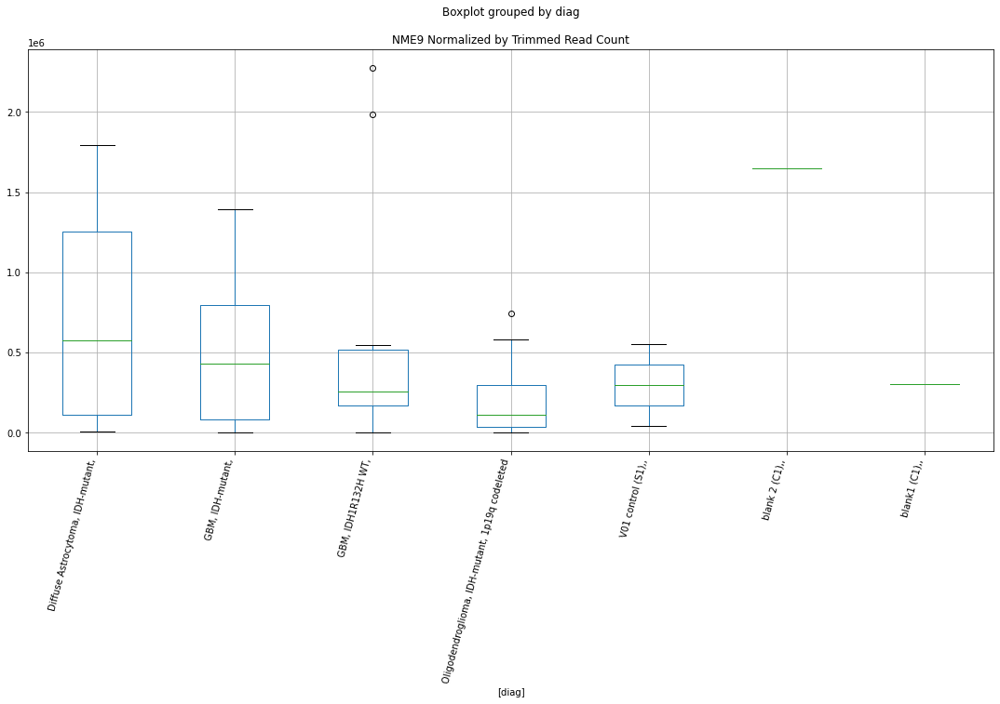

 p : 0.04568039972460685  ( t : 2.1468492988367434 ) :  D-plex  :  bbduk2  :  MRTFB
Control and blanks
73         0.00
337    16912.99
Name: MRTFB, dtype: float64
205    15580.91
Name: MRTFB, dtype: float64
469    2366.11
Name: MRTFB, dtype: float64


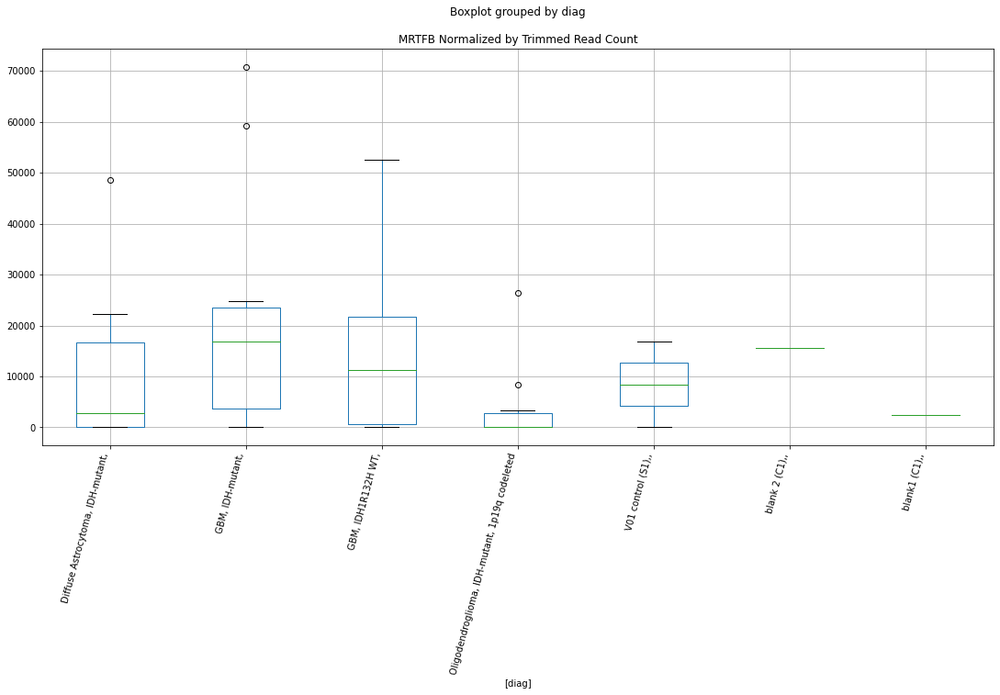

 p : 0.04592041643097048  ( t : 2.144195503254924 ) :  D-plex  :  cutadapt2  :  MLH3
Control and blanks
76     12121.83
340    54605.39
Name: MLH3, dtype: float64
208    29628.52
Name: MLH3, dtype: float64
472    18494.59
Name: MLH3, dtype: float64


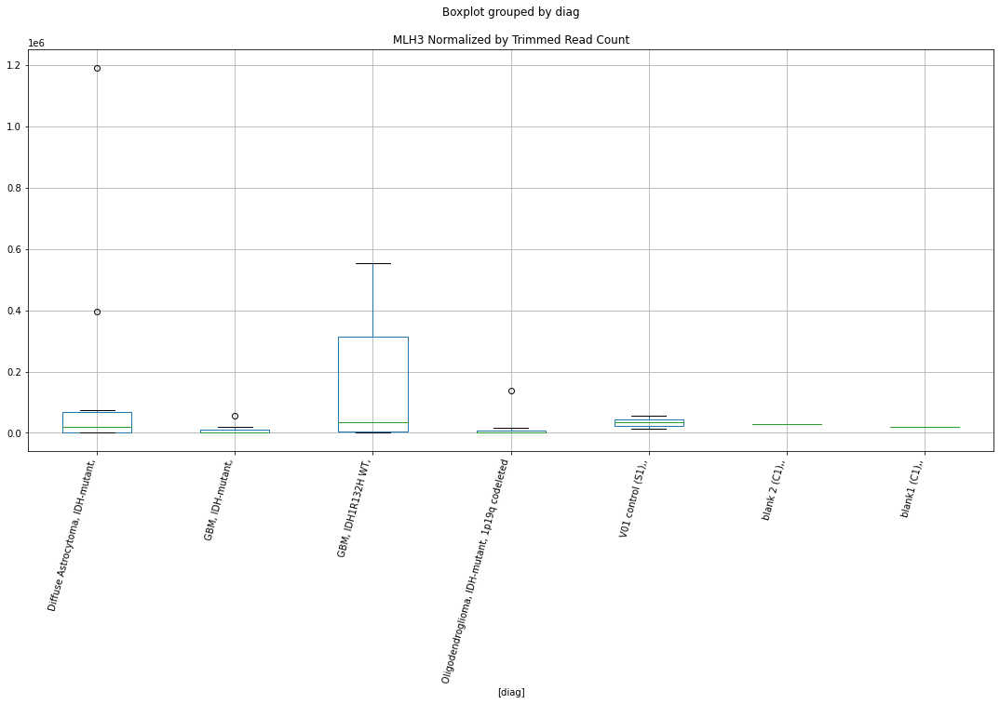

 p : 0.0459856930656824  ( t : 2.143475949409289 ) :  D-plex  :  cutadapt2  :  NPR3
Control and blanks
76     6818.53
340       0.00
Name: NPR3, dtype: float64
208    4938.09
Name: NPR3, dtype: float64
472    3467.74
Name: NPR3, dtype: float64


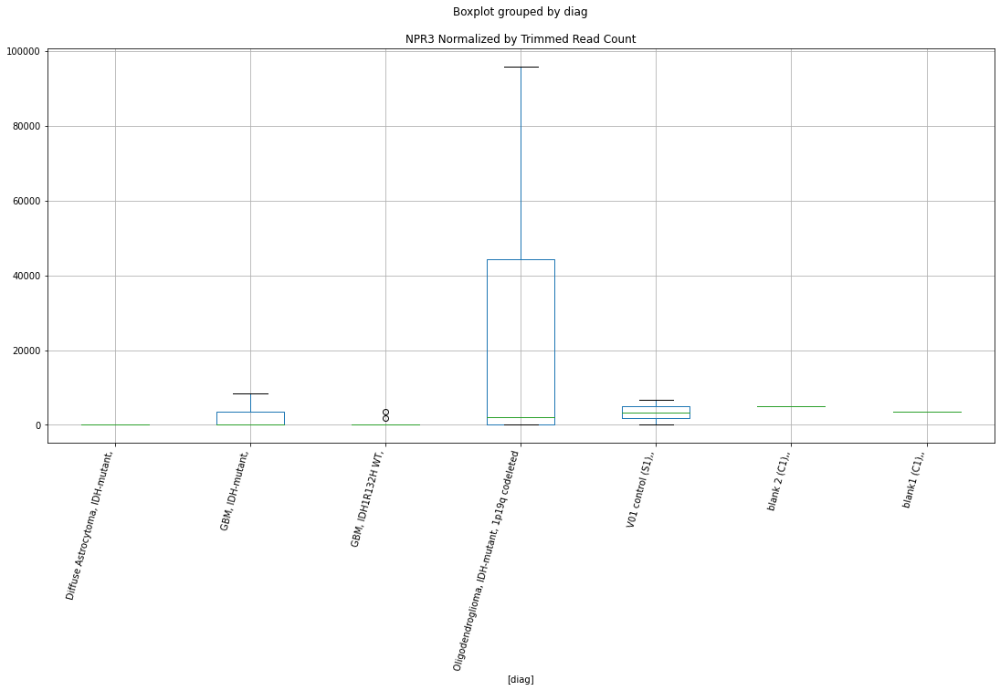

 p : 0.04599001370988722  ( t : 2.143428355235247 ) :  Lexogen  :  bbduk2  :  MYO1C
Control and blanks
79     0.0
343    0.0
Name: MYO1C, dtype: float64
211    0.0
Name: MYO1C, dtype: float64
475    0.0
Name: MYO1C, dtype: float64


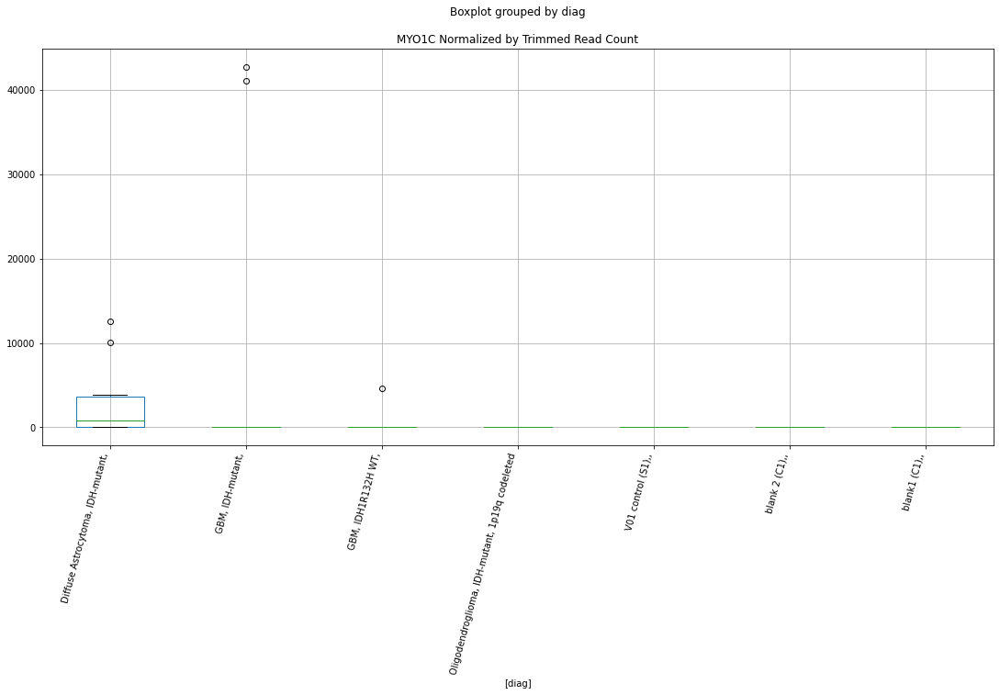

 p : 0.046003452090584554  ( t : 2.1432803504788485 ) :  D-plex  :  bbduk2  :  MXRA8
Control and blanks
73     21644.24
337        0.00
Name: MXRA8, dtype: float64
205    3760.91
Name: MXRA8, dtype: float64
469    4732.22
Name: MXRA8, dtype: float64


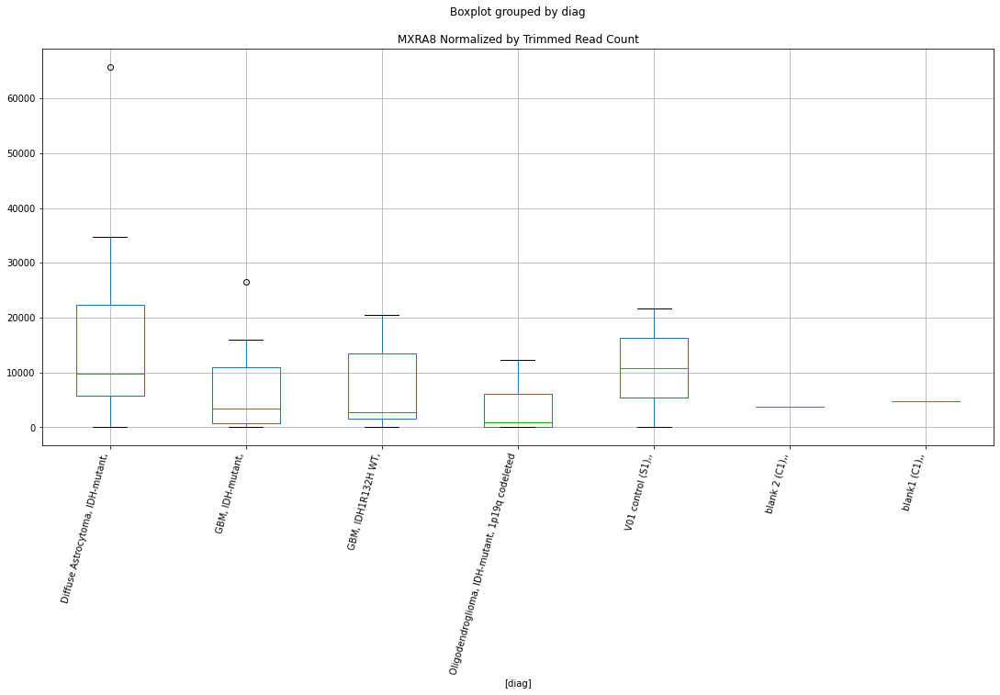

 p : 0.04603999289841878  ( t : 2.1428781046812375 ) :  Lexogen  :  bbduk2  :  LRRN1
Control and blanks
79     0.0
343    0.0
Name: LRRN1, dtype: float64
211    0.0
Name: LRRN1, dtype: float64
475    0.0
Name: LRRN1, dtype: float64


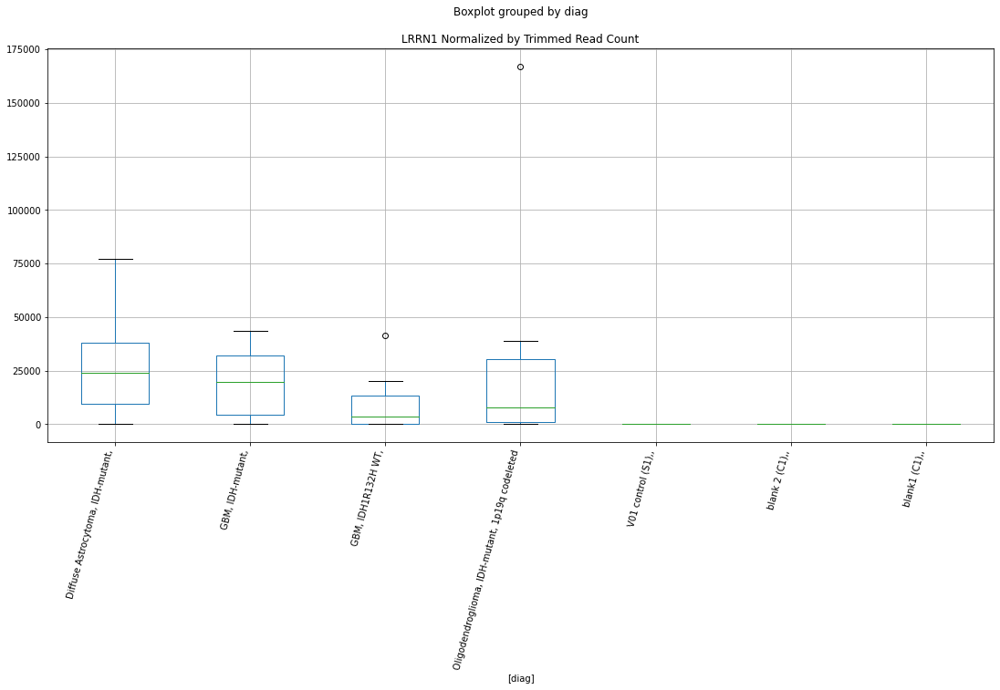

 p : 0.046069016824128055  ( t : 2.142558813325202 ) :  Lexogen  :  cutadapt2  :  OPLAH
Control and blanks
82     0.0
346    0.0
Name: OPLAH, dtype: float64
214    0.0
Name: OPLAH, dtype: float64
478    0.0
Name: OPLAH, dtype: float64


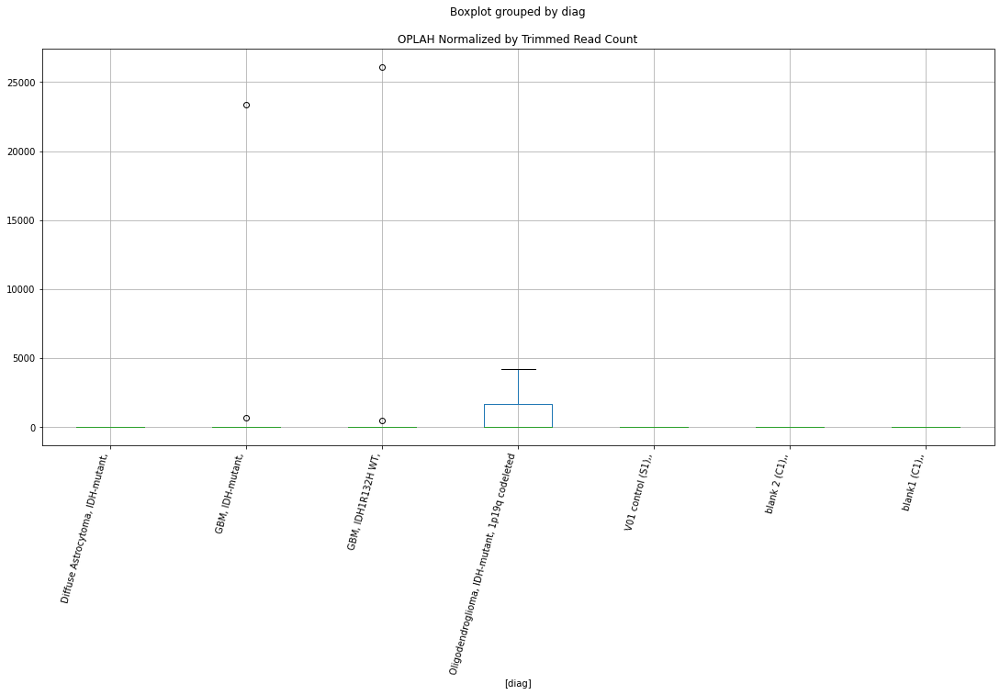

 p : 0.046093891385363746  ( t : 2.142285315122618 ) :  Lexogen  :  bbduk2  :  LOC107986924
Control and blanks
79       0.00
343    636.94
Name: LOC107986924, dtype: float64
211    273.31
Name: LOC107986924, dtype: float64
475    0.0
Name: LOC107986924, dtype: float64


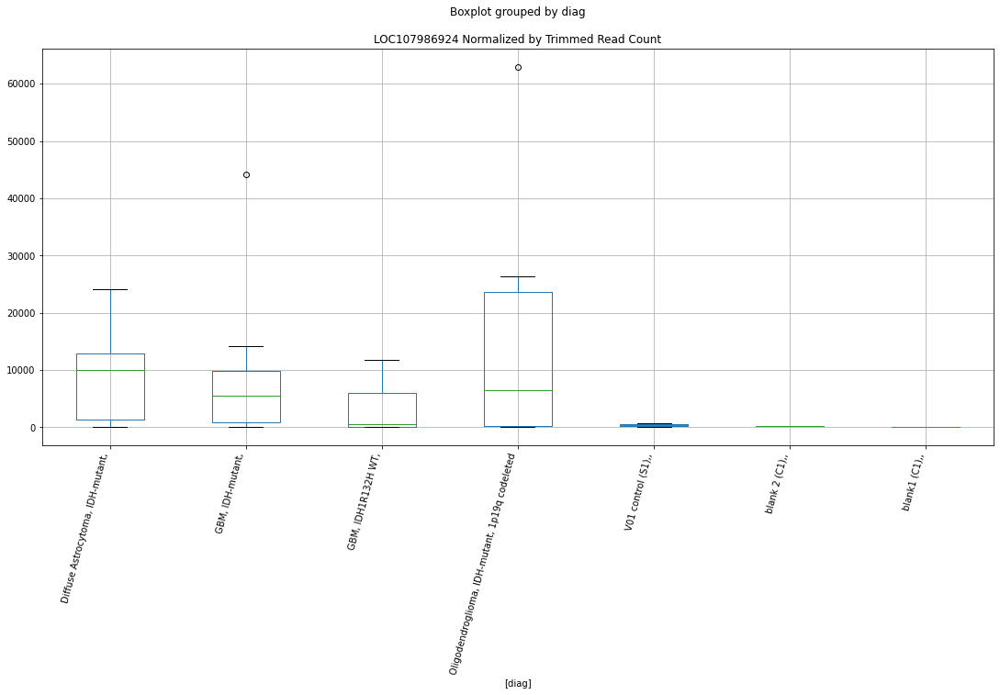

 p : 0.046098286982709055  ( t : 2.142236999115768 ) :  Lexogen  :  cutadapt2  :  MIR16-2
Control and blanks
82          0.00
346    170451.96
Name: MIR16-2, dtype: float64
214    1084.91
Name: MIR16-2, dtype: float64
478    474.92
Name: MIR16-2, dtype: float64


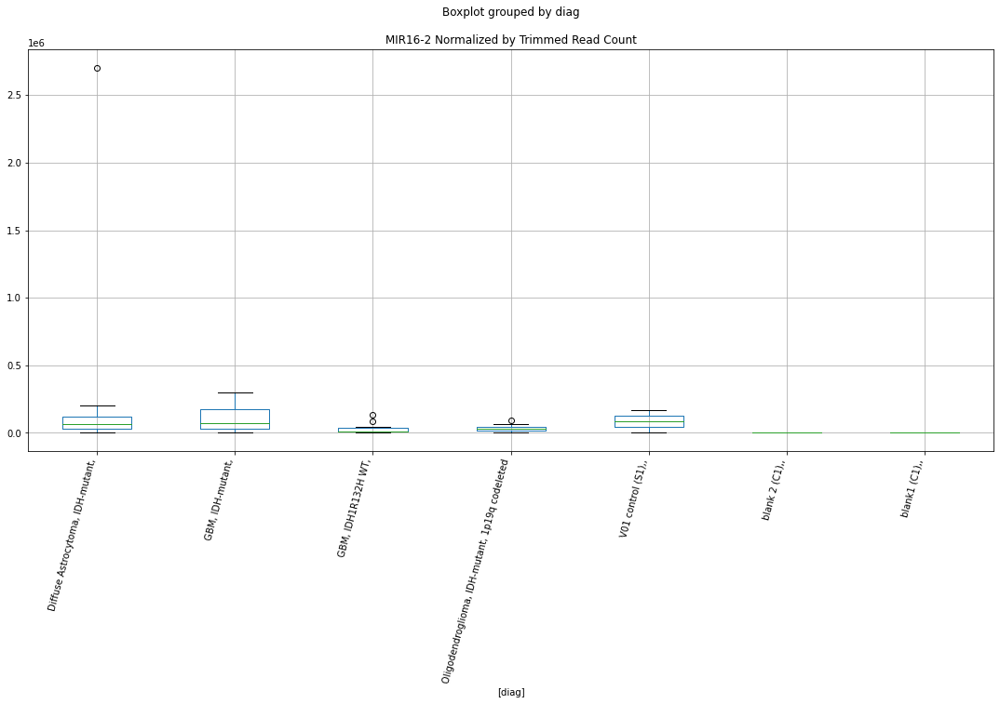

 p : 0.04610637514854753  ( t : 2.1421481057207137 ) :  Lexogen  :  cutadapt2  :  NBEA
Control and blanks
82     0.0
346    0.0
Name: NBEA, dtype: float64
214    0.0
Name: NBEA, dtype: float64
478    0.0
Name: NBEA, dtype: float64


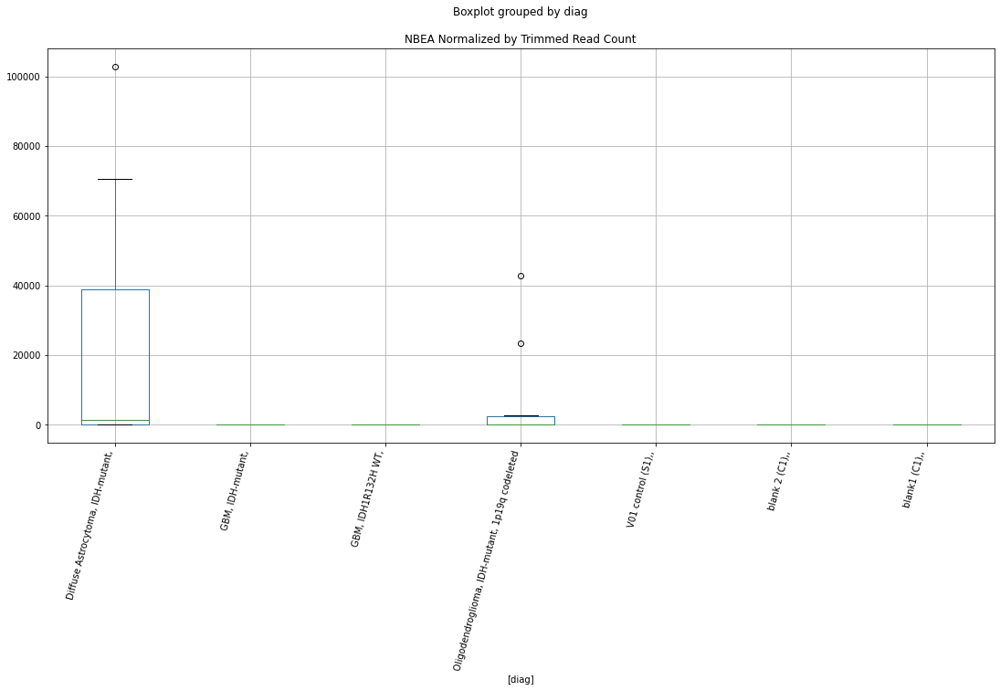

 p : 0.04617304140670397  ( t : 2.141415948634026 ) :  Lexogen  :  cutadapt2  :  MIR182
Control and blanks
82         0.00
346    12836.51
Name: MIR182, dtype: float64
214    0.0
Name: MIR182, dtype: float64
478    0.0
Name: MIR182, dtype: float64


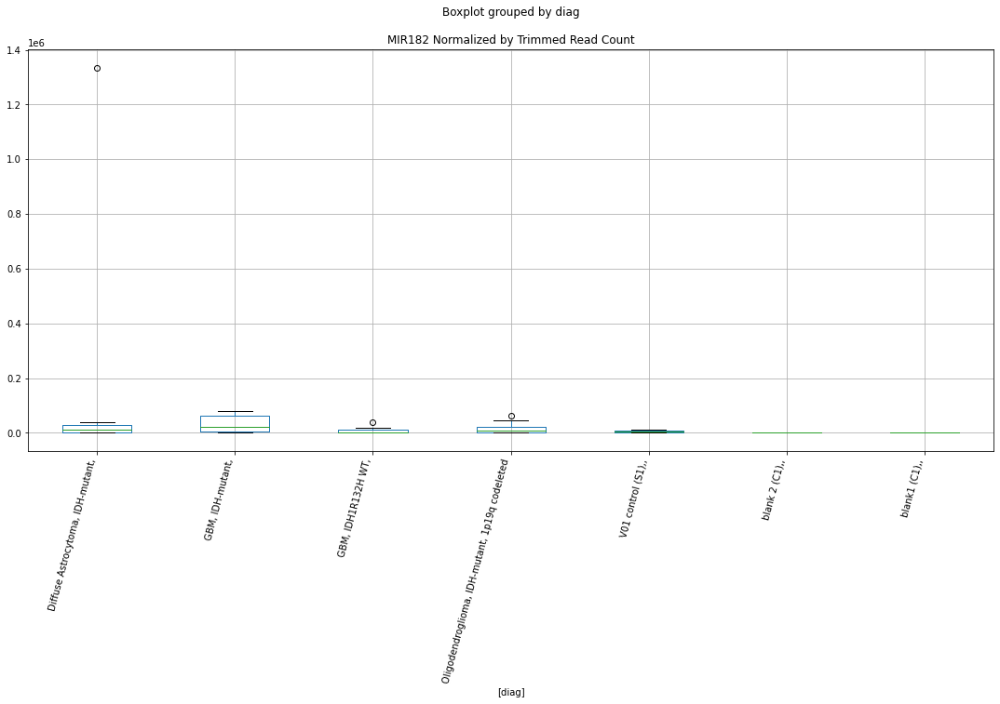

 p : 0.04617914779764791  ( t : 2.1413489339169733 ) :  D-plex  :  bbduk2  :  LOC643072
Control and blanks
73     1546.02
337       0.00
Name: LOC643072, dtype: float64
205    1432.73
Name: LOC643072, dtype: float64
469    1183.05
Name: LOC643072, dtype: float64


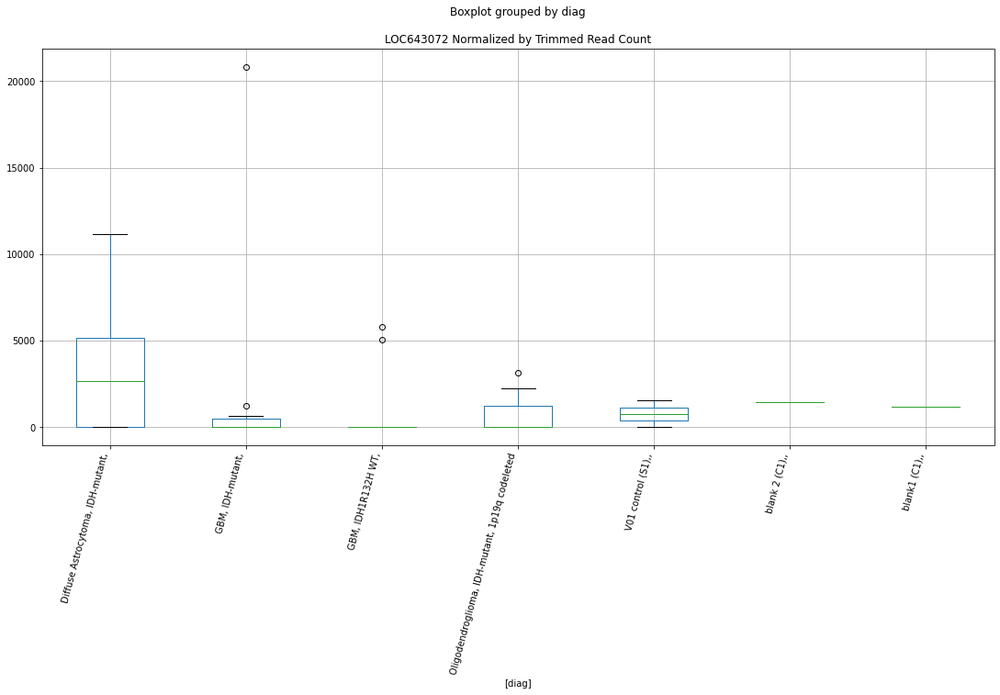

 p : 0.046221960830473016  ( t : 2.1408793084356548 ) :  Lexogen  :  bbduk2  :  MIR16-2
Control and blanks
79          0.00
343    171337.65
Name: MIR16-2, dtype: float64
211    1093.23
Name: MIR16-2, dtype: float64
475    479.03
Name: MIR16-2, dtype: float64


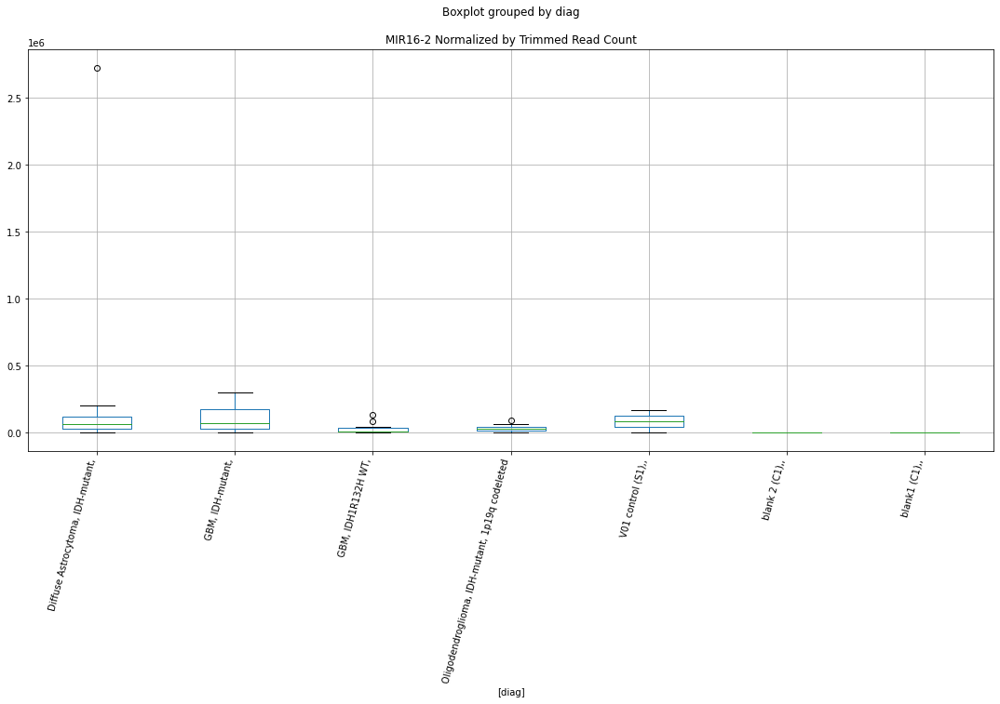

 p : 0.04623353059408736  ( t : 2.140752465332522 ) :  D-plex  :  cutadapt2  :  NKAIN1
Control and blanks
76     0.0
340    0.0
Name: NKAIN1, dtype: float64
208    1939.96
Name: NKAIN1, dtype: float64
472    4623.65
Name: NKAIN1, dtype: float64


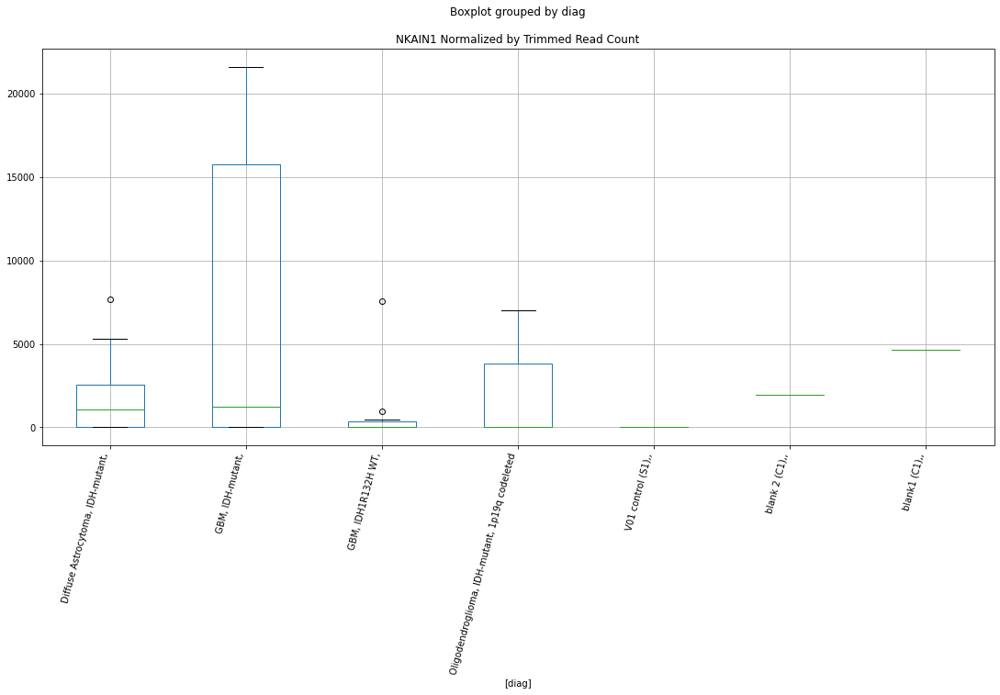

 p : 0.0462584266539868  ( t : 2.1404796199112583 ) :  D-plex  :  cutadapt2  :  LOC643072
Control and blanks
76     0.0
340    0.0
Name: LOC643072, dtype: float64
208    1410.88
Name: LOC643072, dtype: float64
472    1155.91
Name: LOC643072, dtype: float64


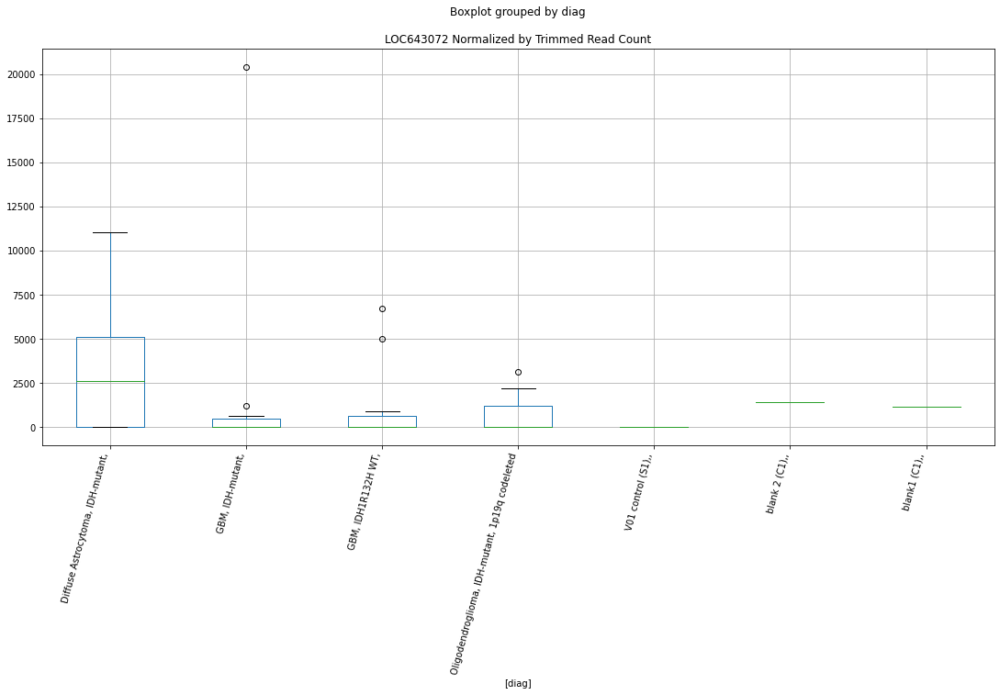

 p : 0.0462861472355663  ( t : 2.1401759771478317 ) :  Lexogen  :  cutadapt2  :  LOX
Control and blanks
82     0.0
346    0.0
Name: LOX, dtype: float64
214    4882.08
Name: LOX, dtype: float64
478    0.0
Name: LOX, dtype: float64


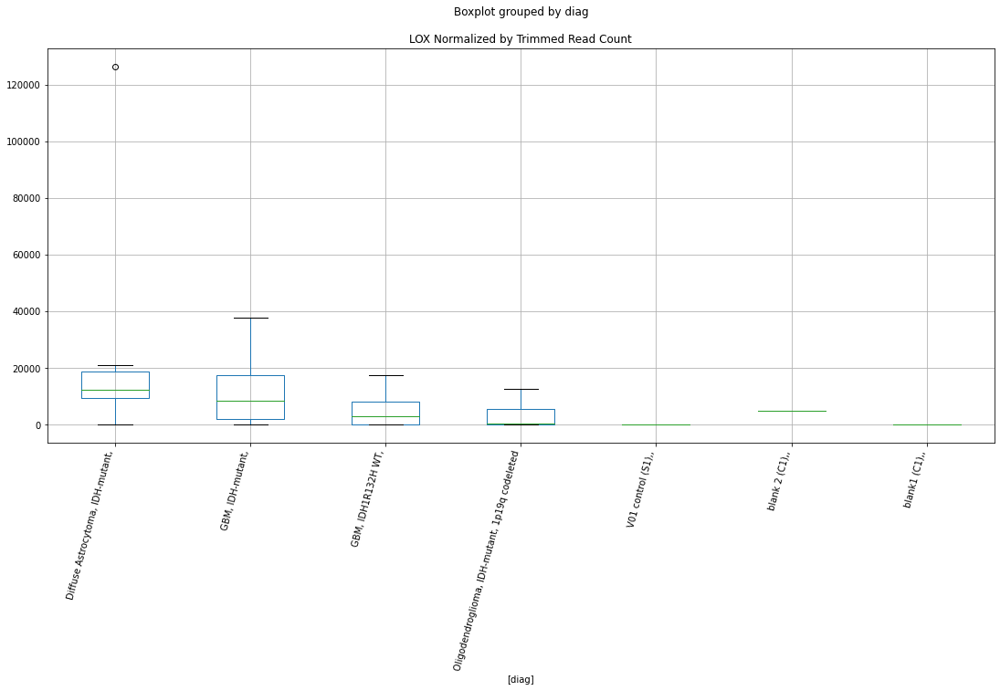

 p : 0.04632816440309701  ( t : 2.1397160502836847 ) :  Lexogen  :  cutadapt2  :  LRRN1
Control and blanks
82     0.0
346    0.0
Name: LRRN1, dtype: float64
214    0.0
Name: LRRN1, dtype: float64
478    0.0
Name: LRRN1, dtype: float64


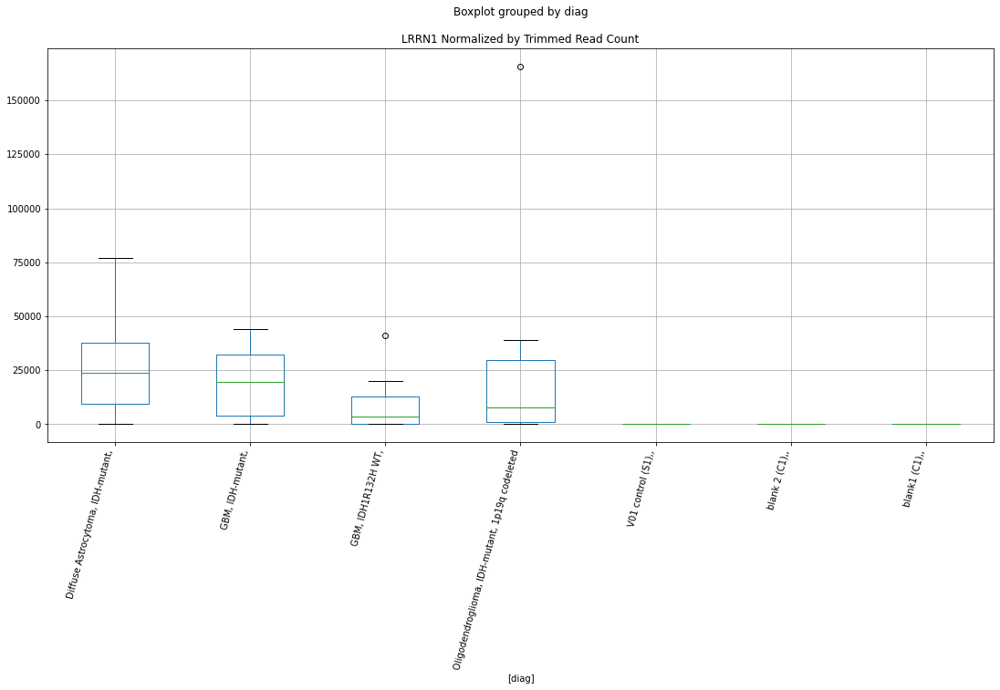

 p : 0.04633324515849554  ( t : 2.139660461300156 ) :  Lexogen  :  cutadapt2  :  NPTX2
Control and blanks
82     0.0
346    0.0
Name: NPTX2, dtype: float64
214    0.0
Name: NPTX2, dtype: float64
478    8548.58
Name: NPTX2, dtype: float64


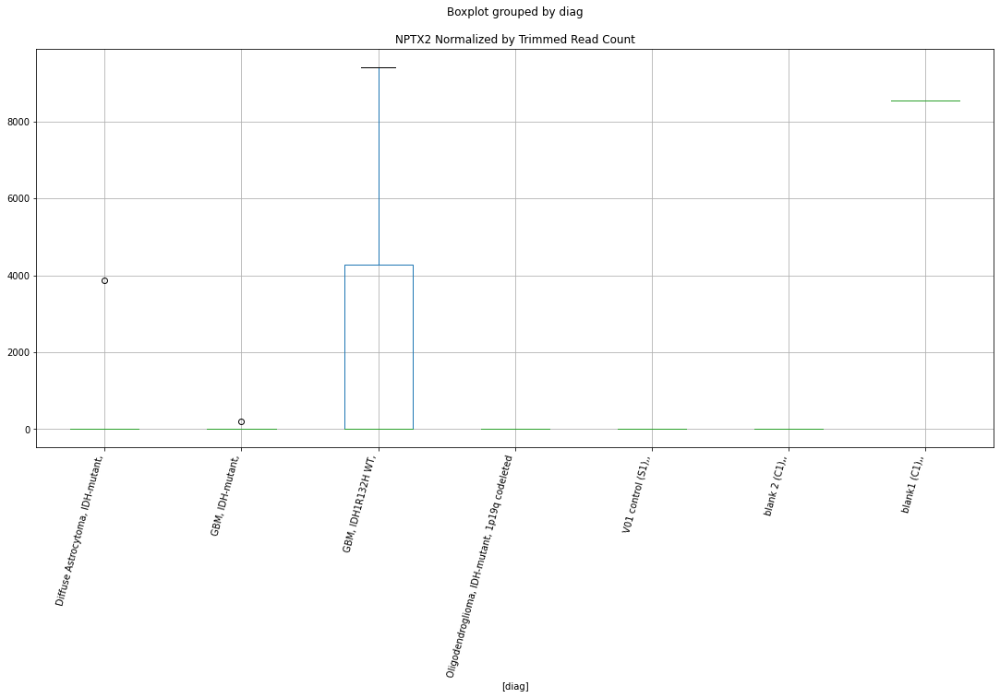

 p : 0.04634468394443623  ( t : 2.1395353289163377 ) :  Lexogen  :  bbduk2  :  LOC107986441
Control and blanks
79       0.00
343    849.26
Name: LOC107986441, dtype: float64
211    0.0
Name: LOC107986441, dtype: float64
475    0.0
Name: LOC107986441, dtype: float64


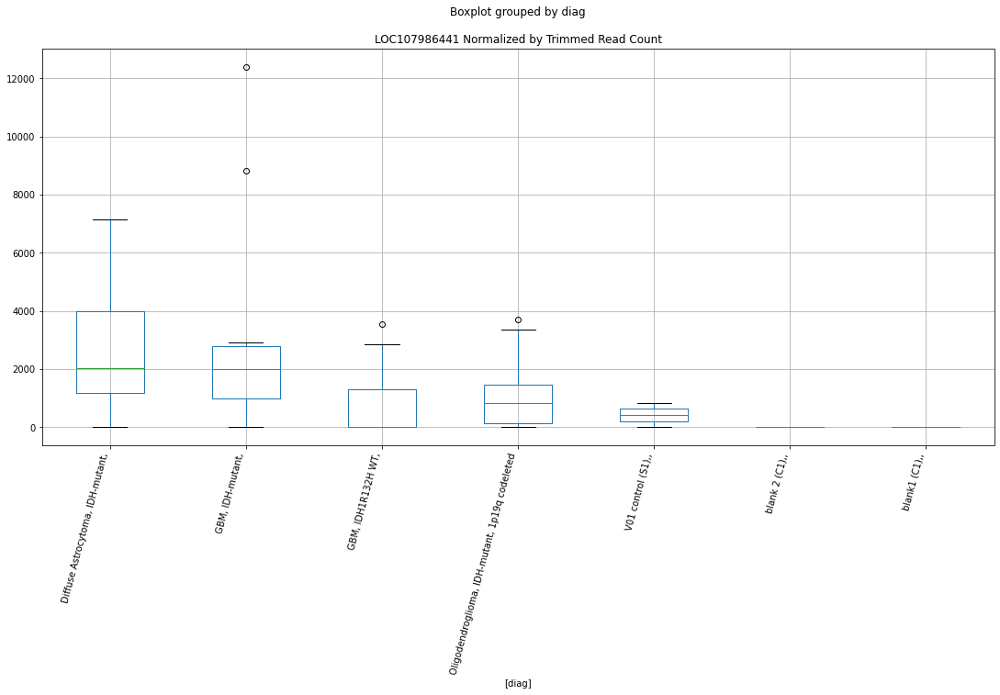

 p : 0.046360373355538116  ( t : 2.139363743482037 ) :  D-plex  :  bbduk2  :  NUB1
Control and blanks
73     0.0
337    0.0
Name: NUB1, dtype: float64
205    716.36
Name: NUB1, dtype: float64
469    0.0
Name: NUB1, dtype: float64


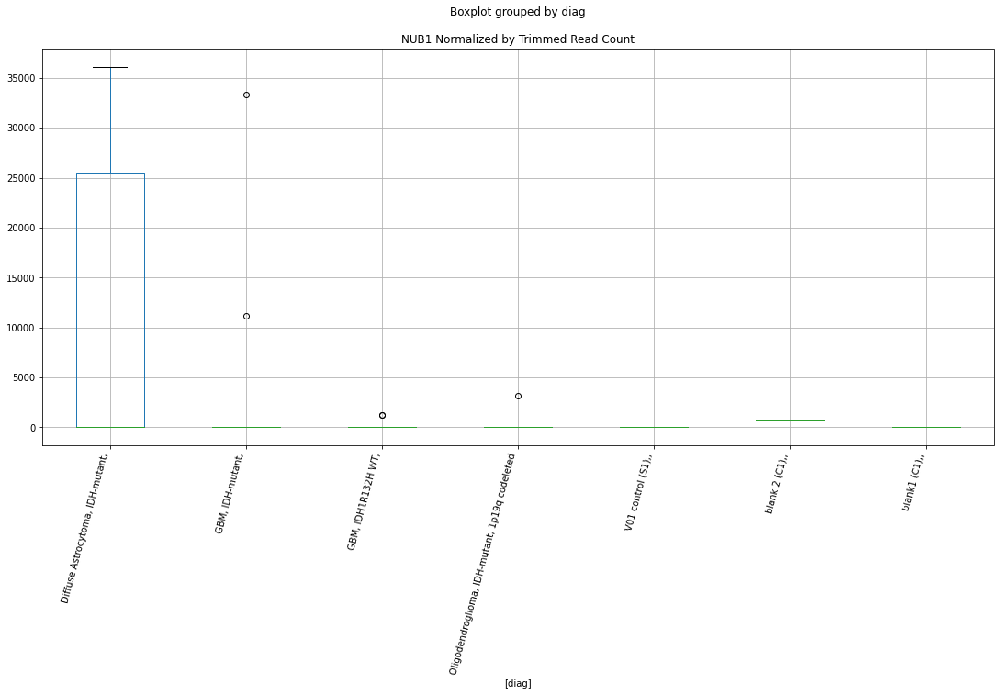

 p : 0.046430428165159986  ( t : 2.1385982431907538 ) :  D-plex  :  bbduk2  :  MCM2
Control and blanks
73     106675.16
337    225209.79
Name: MCM2, dtype: float64
205    22207.28
Name: MCM2, dtype: float64
469    363789.3
Name: MCM2, dtype: float64


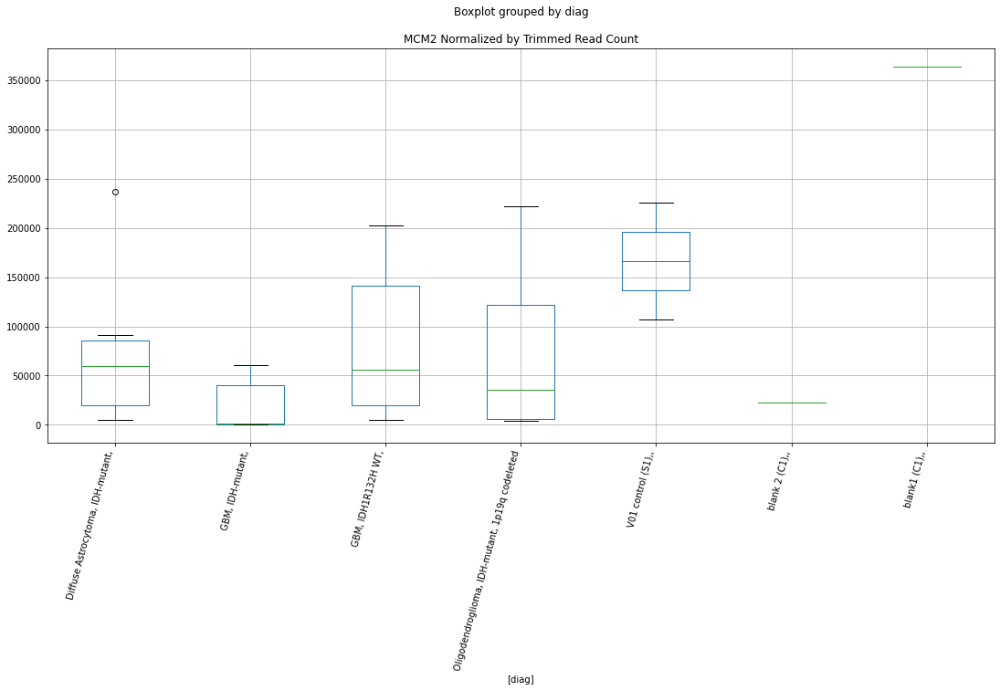

 p : 0.04645368995454071  ( t : 2.1383442909454535 ) :  D-plex  :  bbduk2  :  LOC107986206
Control and blanks
73     0.0
337    0.0
Name: LOC107986206, dtype: float64
205    179.09
Name: LOC107986206, dtype: float64
469    0.0
Name: LOC107986206, dtype: float64


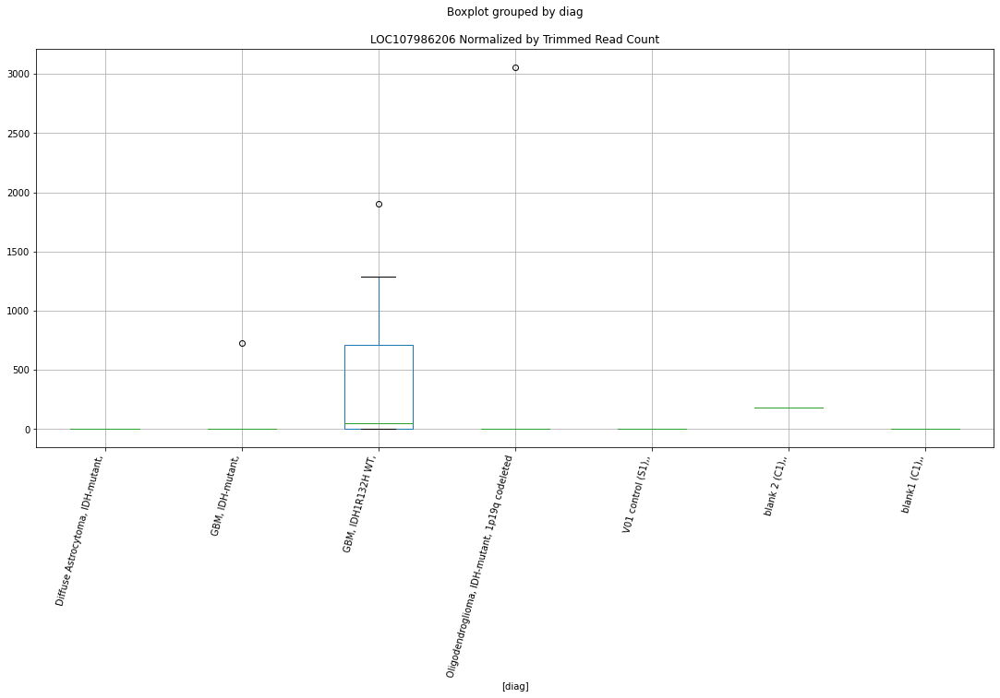

 p : 0.046485790735024735  ( t : 2.1379940326941718 ) :  Lexogen  :  bbduk2  :  NES
Control and blanks
79     0.0
343    0.0
Name: NES, dtype: float64
211    1366.53
Name: NES, dtype: float64
475    0.0
Name: NES, dtype: float64


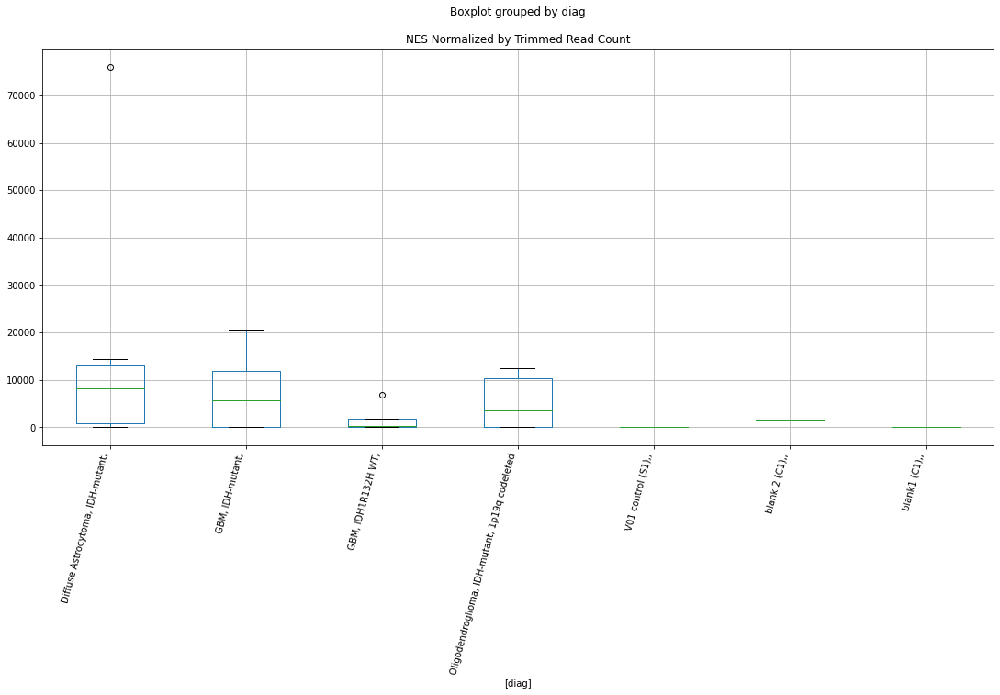

 p : 0.046500810615642846  ( t : 2.137830223465774 ) :  D-plex  :  bbduk2  :  MBD1
Control and blanks
73     75754.82
337        0.00
Name: MBD1, dtype: float64
205    17371.82
Name: MBD1, dtype: float64
469    0.0
Name: MBD1, dtype: float64


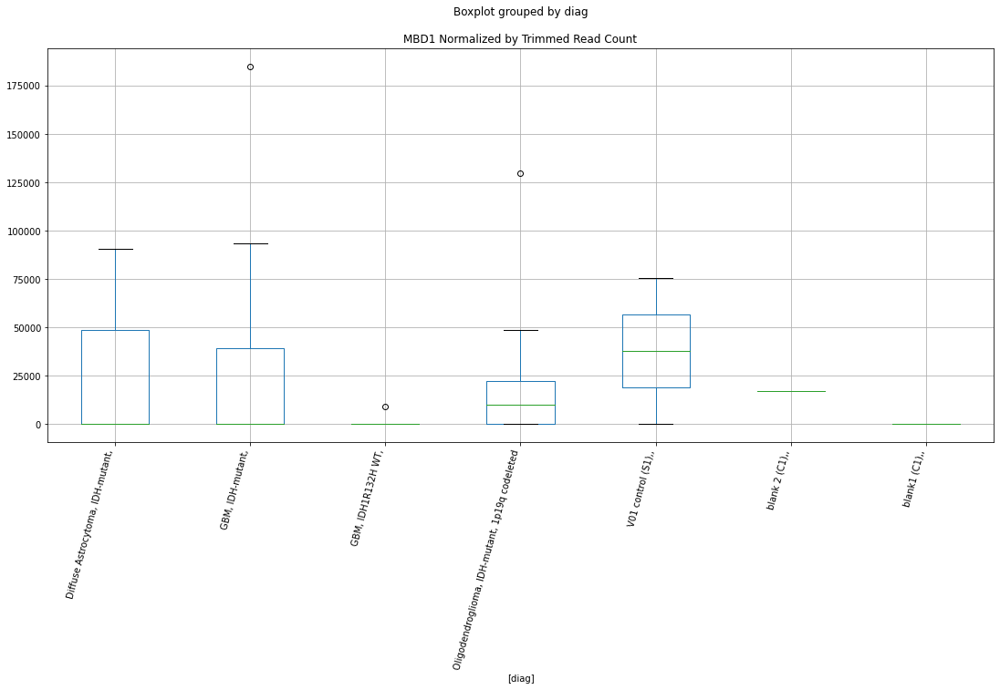

 p : 0.04650284439339891  ( t : 2.1378080464709095 ) :  D-plex  :  bbduk2  :  NUDT10
Control and blanks
73     0.0
337    0.0
Name: NUDT10, dtype: float64
205    358.18
Name: NUDT10, dtype: float64
469    5915.27
Name: NUDT10, dtype: float64


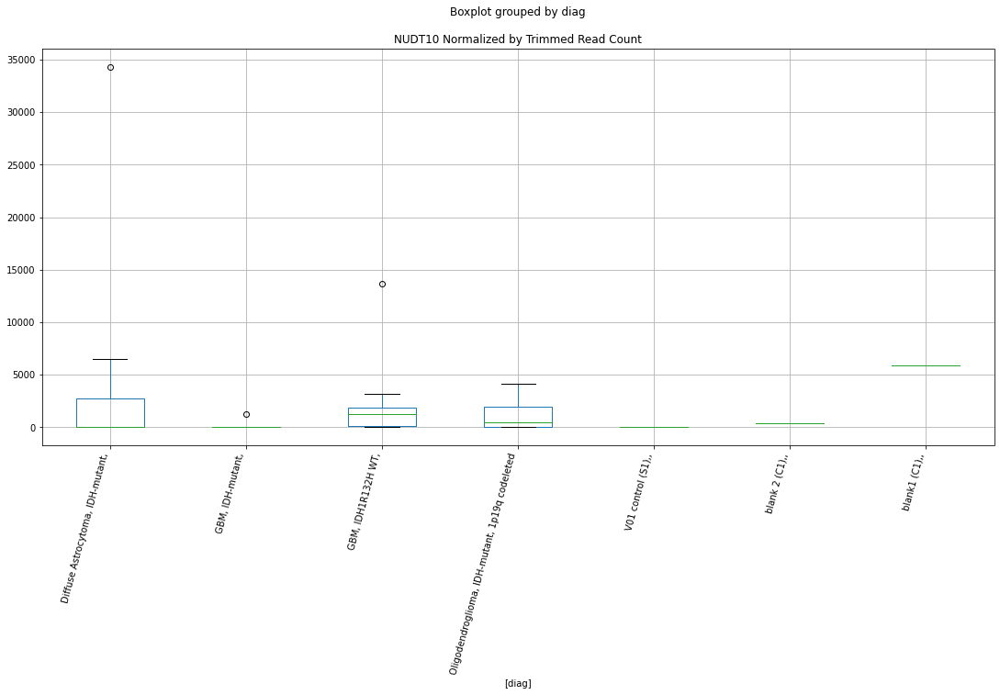

 p : 0.04661376184931413  ( t : 2.1365999036534897 ) :  D-plex  :  bbduk2  :  OPN1LW
Control and blanks
73     0.0
337    0.0
Name: OPN1LW, dtype: float64
205    0.0
Name: OPN1LW, dtype: float64
469    0.0
Name: OPN1LW, dtype: float64


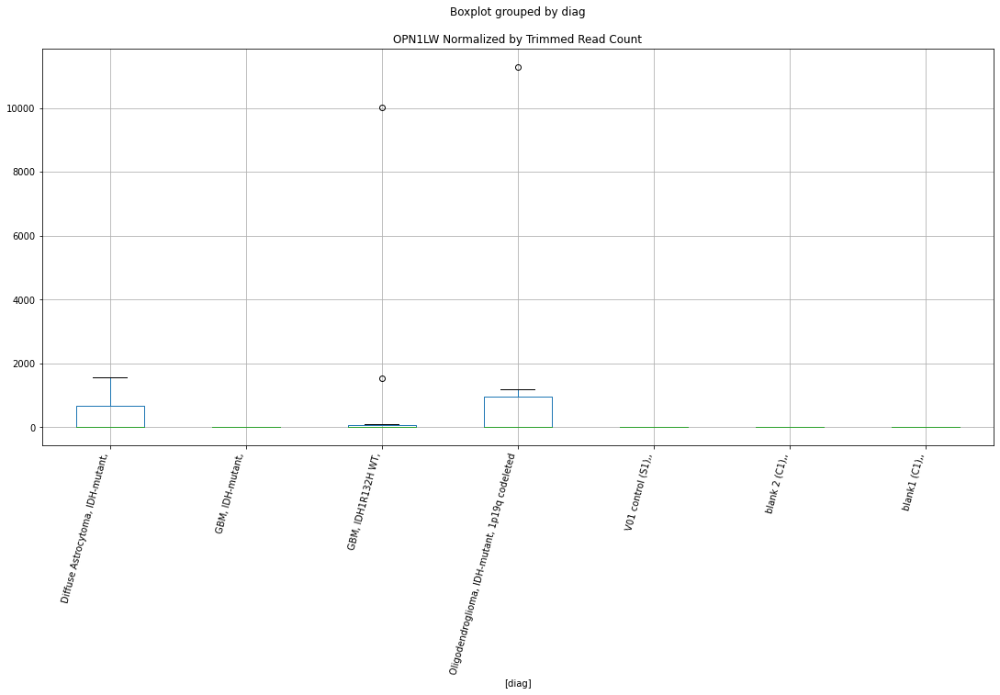

 p : 0.04661376184931413  ( t : 2.1365999036534897 ) :  D-plex  :  bbduk2  :  OPN1MW2
Control and blanks
73     0.0
337    0.0
Name: OPN1MW2, dtype: float64
205    0.0
Name: OPN1MW2, dtype: float64
469    0.0
Name: OPN1MW2, dtype: float64


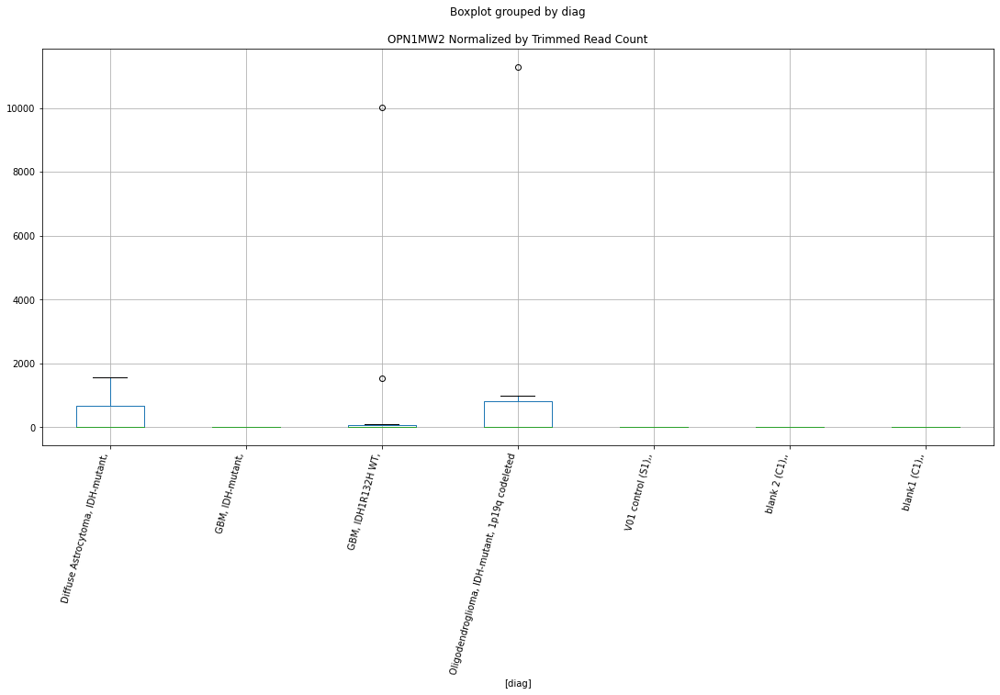

 p : 0.04661376184931413  ( t : 2.1365999036534897 ) :  D-plex  :  bbduk2  :  OPN1MW3
Control and blanks
73     0.0
337    0.0
Name: OPN1MW3, dtype: float64
205    0.0
Name: OPN1MW3, dtype: float64
469    0.0
Name: OPN1MW3, dtype: float64


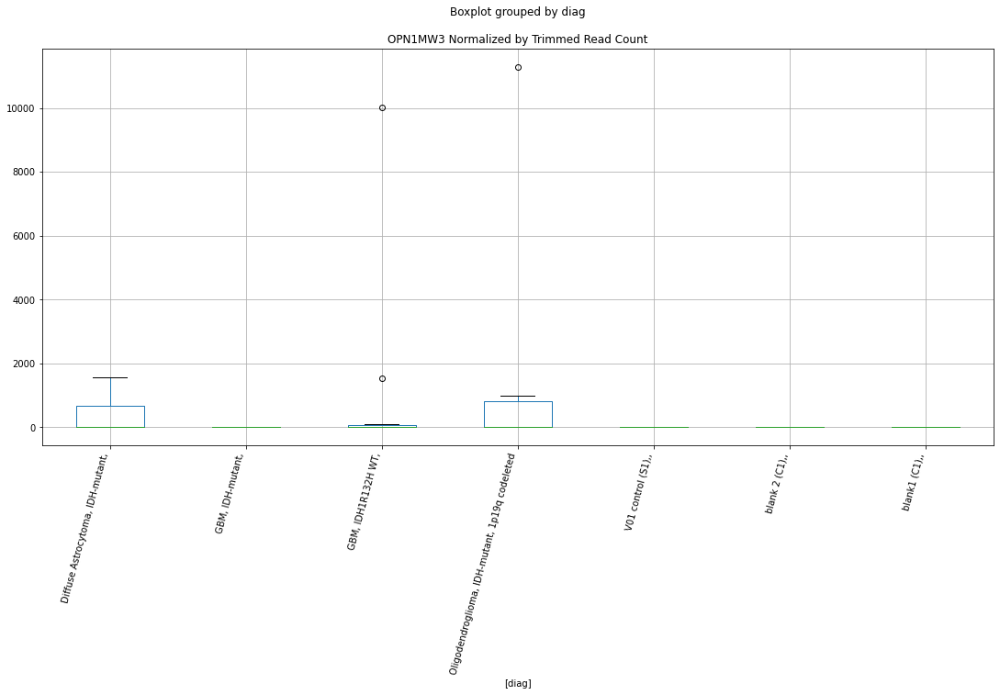

 p : 0.04664054828337072  ( t : 2.1363085318549793 ) :  Lexogen  :  bbduk2  :  MIR182
Control and blanks
79         0.00
343    12951.17
Name: MIR182, dtype: float64
211    0.0
Name: MIR182, dtype: float64
475    0.0
Name: MIR182, dtype: float64


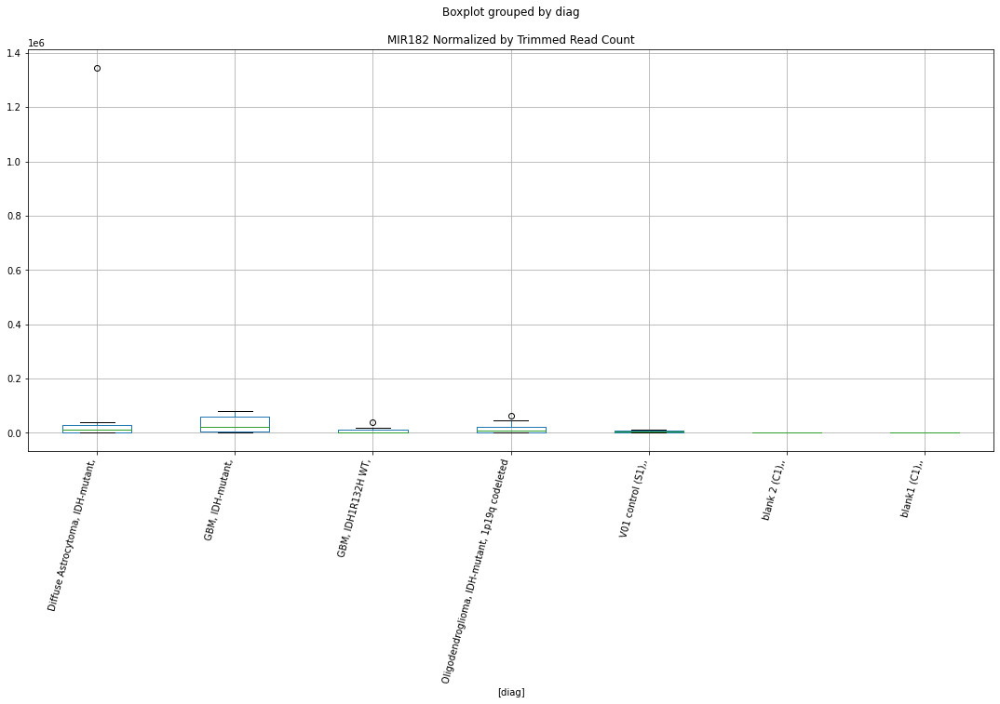

 p : 0.046691329166300526  ( t : 2.1357565771603495 ) :  Lexogen  :  cutadapt2  :  NES
Control and blanks
82     0.0
346    0.0
Name: NES, dtype: float64
214    1356.13
Name: NES, dtype: float64
478    0.0
Name: NES, dtype: float64


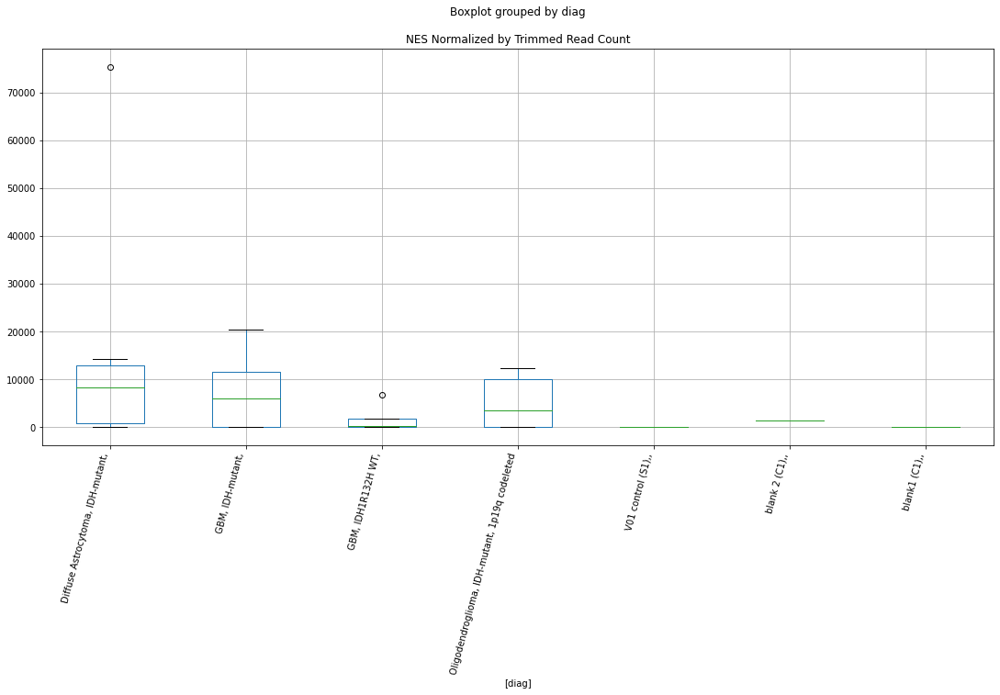

 p : 0.04669804895072226  ( t : 2.1356835785745365 ) :  Lexogen  :  bbduk2  :  MAP4K4
Control and blanks
79     0.0
343    0.0
Name: MAP4K4, dtype: float64
211    314302.28
Name: MAP4K4, dtype: float64
475    658668.28
Name: MAP4K4, dtype: float64


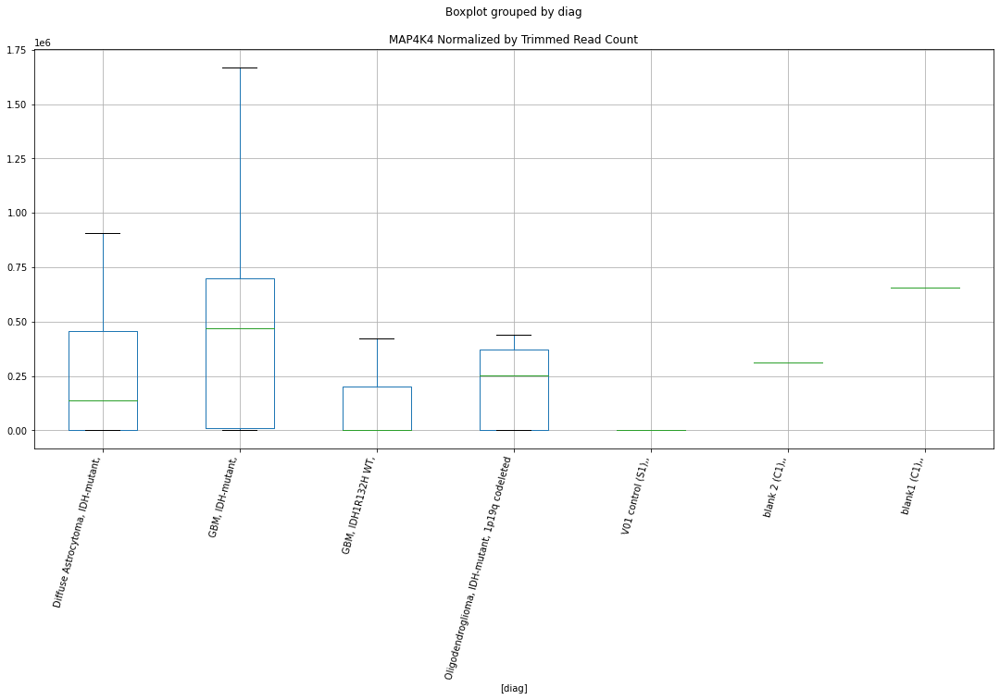

 p : 0.04675285219936072  ( t : 2.135088595629032 ) :  Lexogen  :  cutadapt2  :  MAST4
Control and blanks
82     0.0
346    0.0
Name: MAST4, dtype: float64
214    4339.62
Name: MAST4, dtype: float64
478    0.0
Name: MAST4, dtype: float64


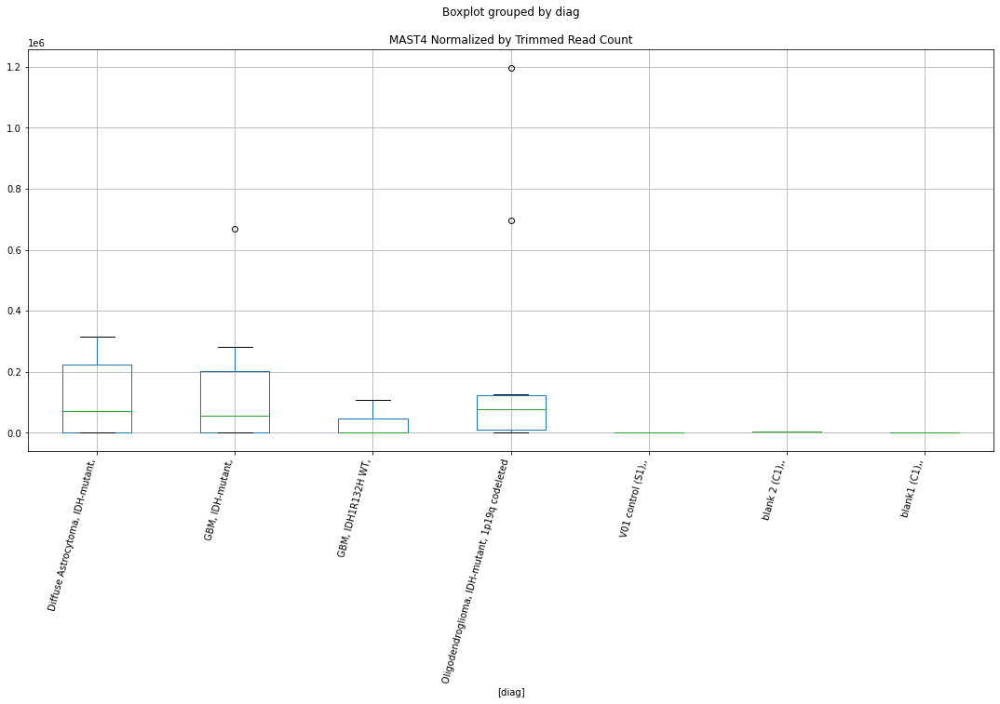

 p : 0.046843020756802196  ( t : 2.1341110449961036 ) :  Lexogen  :  cutadapt2  :  LOC107986924
Control and blanks
82       0.0
346    631.3
Name: LOC107986924, dtype: float64
214    271.23
Name: LOC107986924, dtype: float64
478    0.0
Name: LOC107986924, dtype: float64


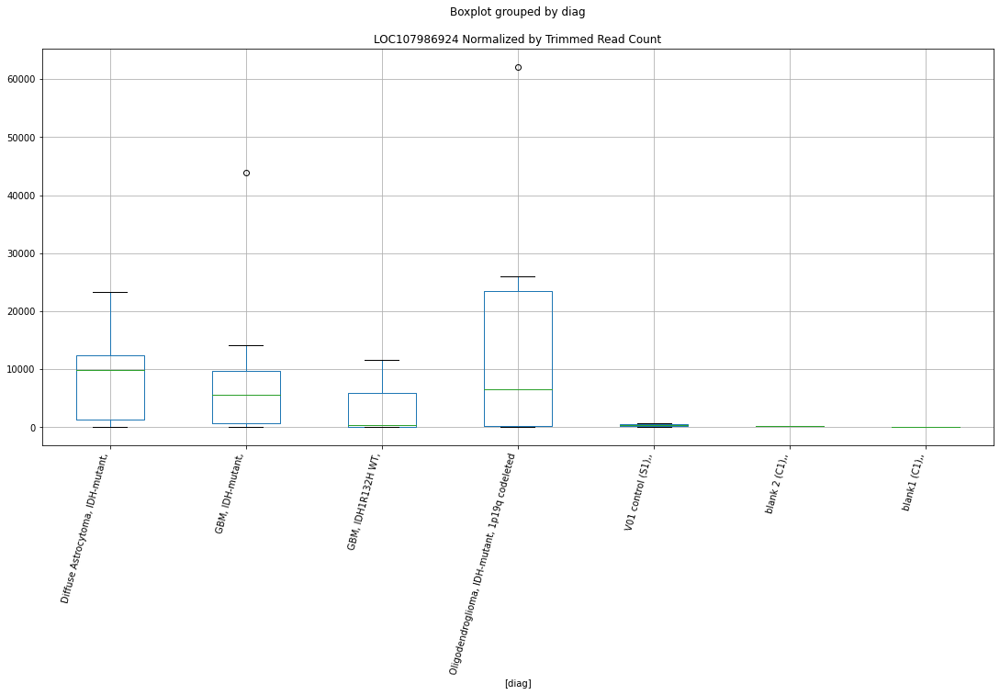

 p : 0.046845493200554936  ( t : 2.1340842645069493 ) :  D-plex  :  bbduk2  :  MKRN1
Control and blanks
73     3865.04
337       0.00
Name: MKRN1, dtype: float64
205    2507.27
Name: MKRN1, dtype: float64
469    10647.49
Name: MKRN1, dtype: float64


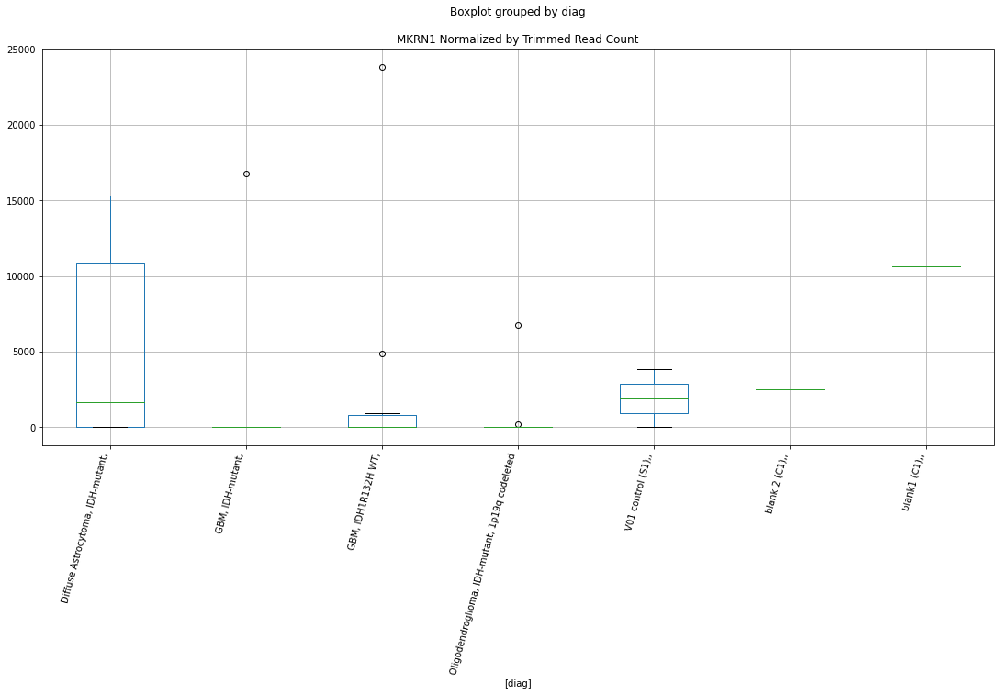

 p : 0.04687066479290812  ( t : 2.133811689576338 ) :  D-plex  :  cutadapt2  :  LOC375196
Control and blanks
76     0.0
340    0.0
Name: LOC375196, dtype: float64
208    1058.16
Name: LOC375196, dtype: float64
472    2311.82
Name: LOC375196, dtype: float64


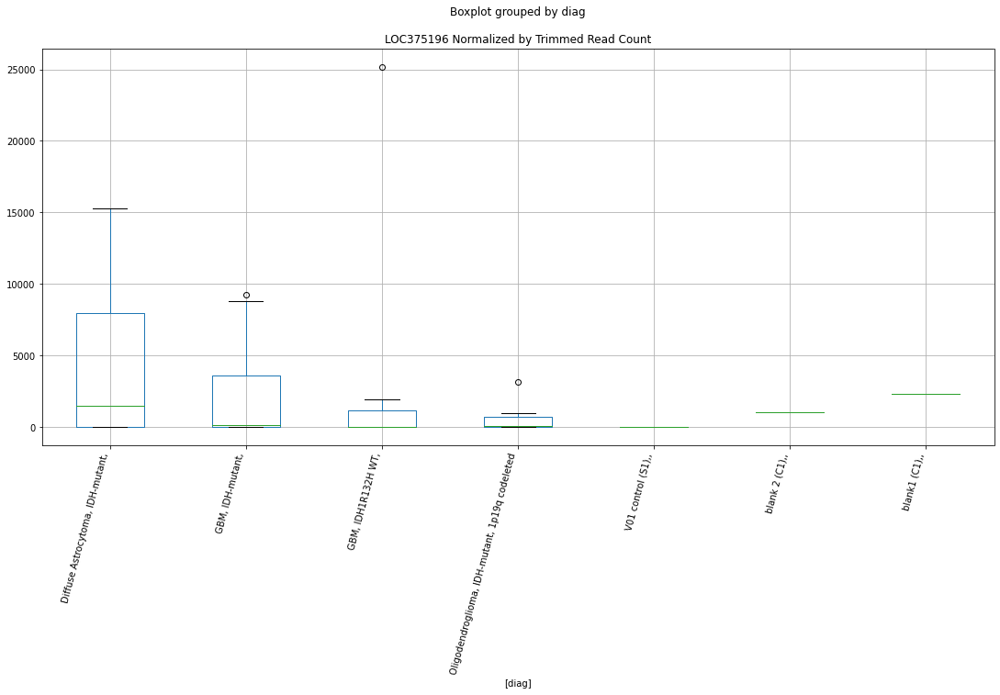

 p : 0.046871749728319693  ( t : 2.133799944167961 ) :  D-plex  :  bbduk2  :  LOC112268259
Control and blanks
73     773.01
337      0.00
Name: LOC112268259, dtype: float64
205    0.0
Name: LOC112268259, dtype: float64
469    0.0
Name: LOC112268259, dtype: float64


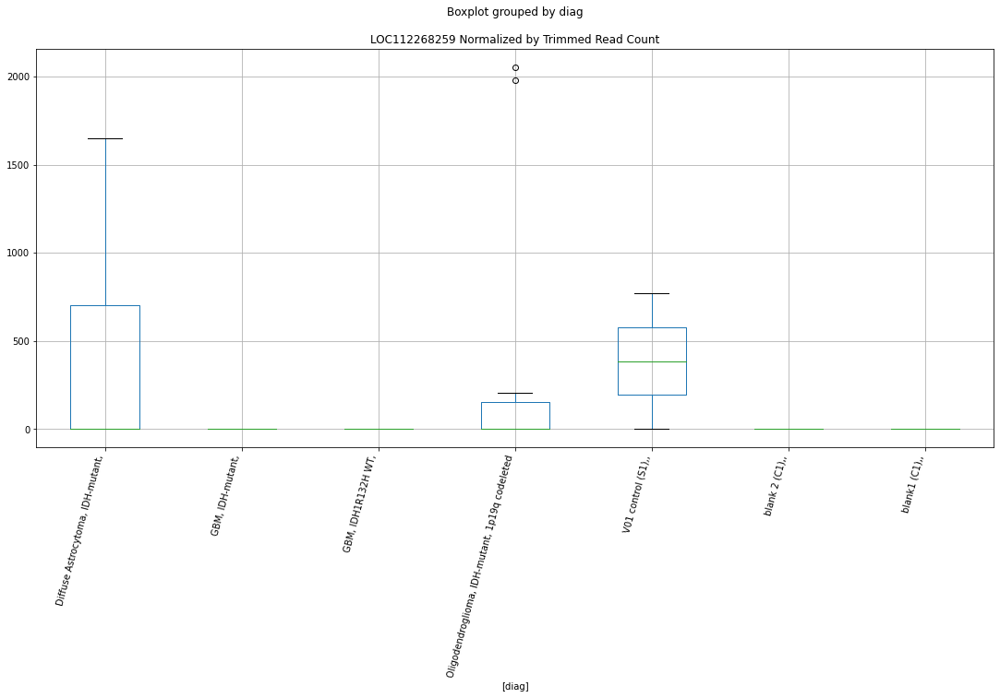

 p : 0.046893339415180375  ( t : 2.133566267808287 ) :  D-plex  :  bbduk2  :  NLRP11
Control and blanks
73     299927.26
337      5340.94
Name: NLRP11, dtype: float64
205    20058.19
Name: NLRP11, dtype: float64
469    23661.09
Name: NLRP11, dtype: float64


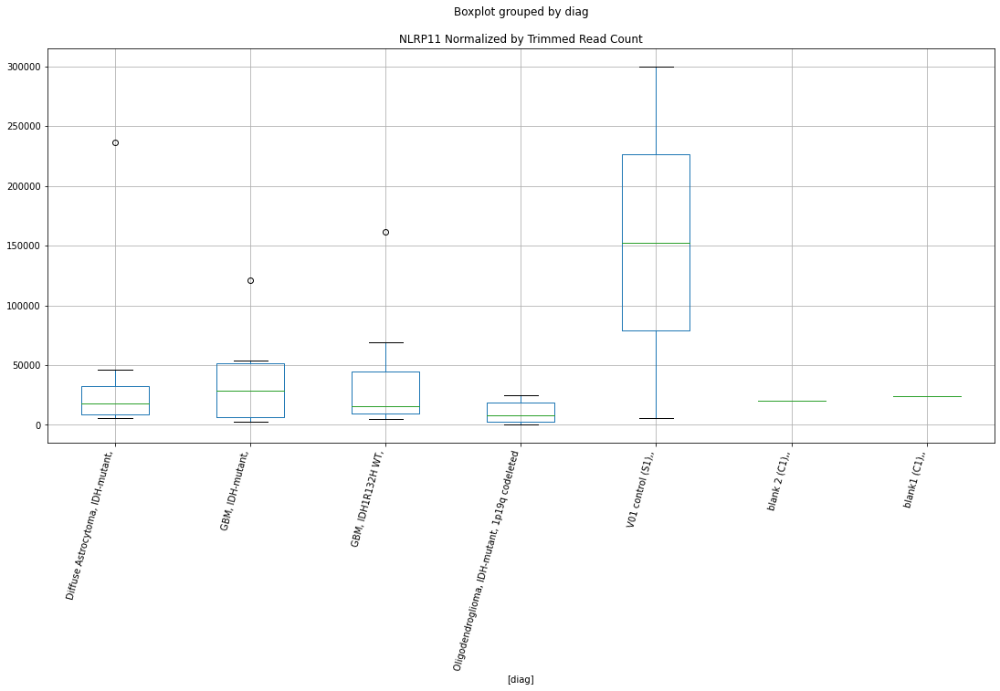

 p : 0.0469482049550908  ( t : 2.132972870929085 ) :  D-plex  :  cutadapt2  :  MYOM3
Control and blanks
76     0.0
340    0.0
Name: MYOM3, dtype: float64
208    2292.68
Name: MYOM3, dtype: float64
472    577.96
Name: MYOM3, dtype: float64


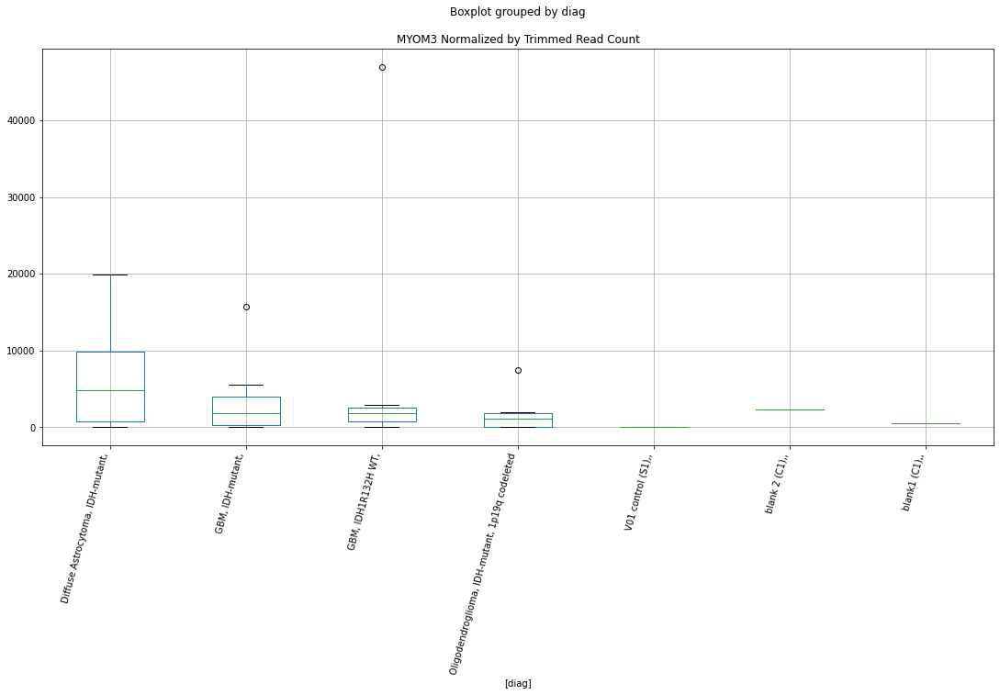

 p : 0.04695271321879373  ( t : 2.13292414004141 ) :  D-plex  :  cutadapt2  :  NOL4L
Control and blanks
76     148492.39
340         0.00
Name: NOL4L, dtype: float64
208    79538.46
Name: NOL4L, dtype: float64
472    102298.18
Name: NOL4L, dtype: float64


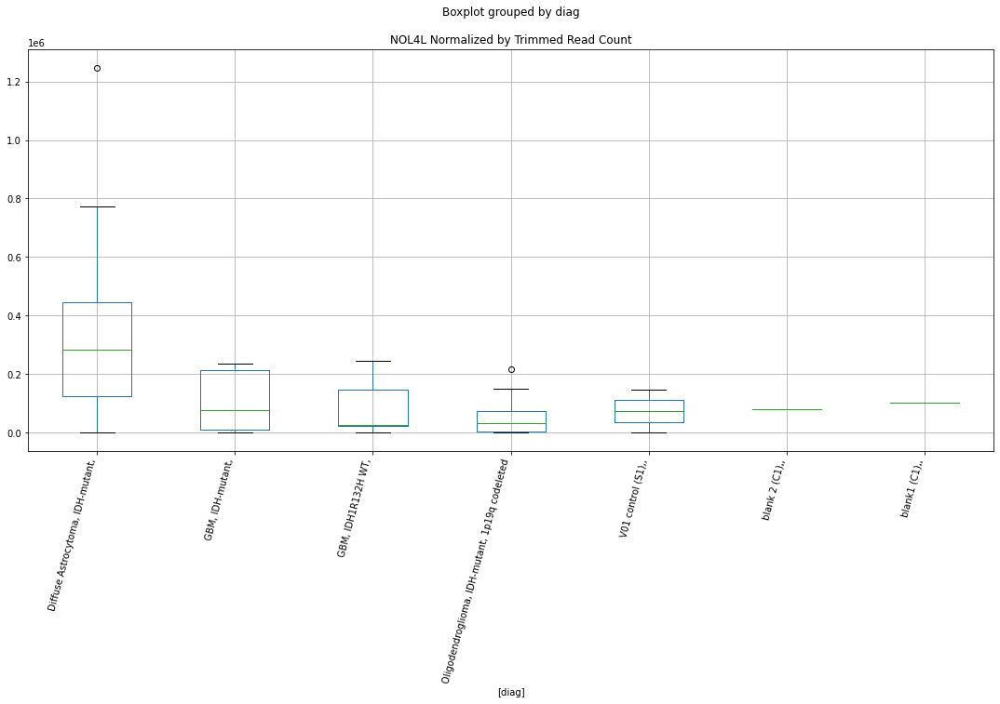

 p : 0.046978811556767704  ( t : 2.132642120771936 ) :  D-plex  :  bbduk2  :  NUDT11
Control and blanks
73     0.0
337    0.0
Name: NUDT11, dtype: float64
205    179.09
Name: NUDT11, dtype: float64
469    591.53
Name: NUDT11, dtype: float64


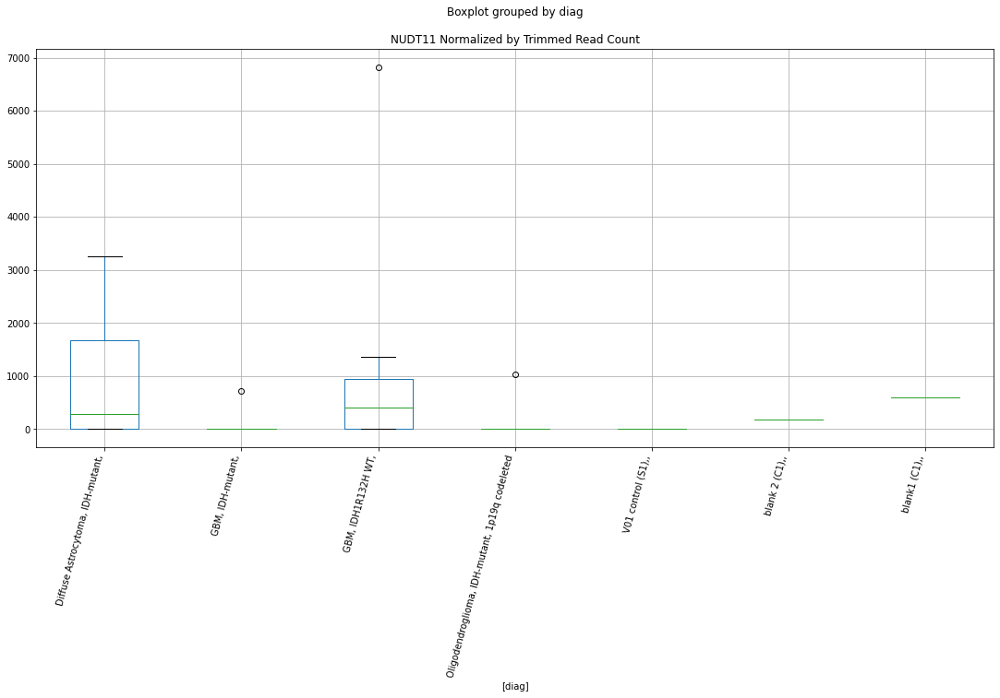

 p : 0.04698680562300626  ( t : 2.1325557652869693 ) :  D-plex  :  cutadapt2  :  OPN1LW
Control and blanks
76     0.0
340    0.0
Name: OPN1LW, dtype: float64
208    0.0
Name: OPN1LW, dtype: float64
472    0.0
Name: OPN1LW, dtype: float64


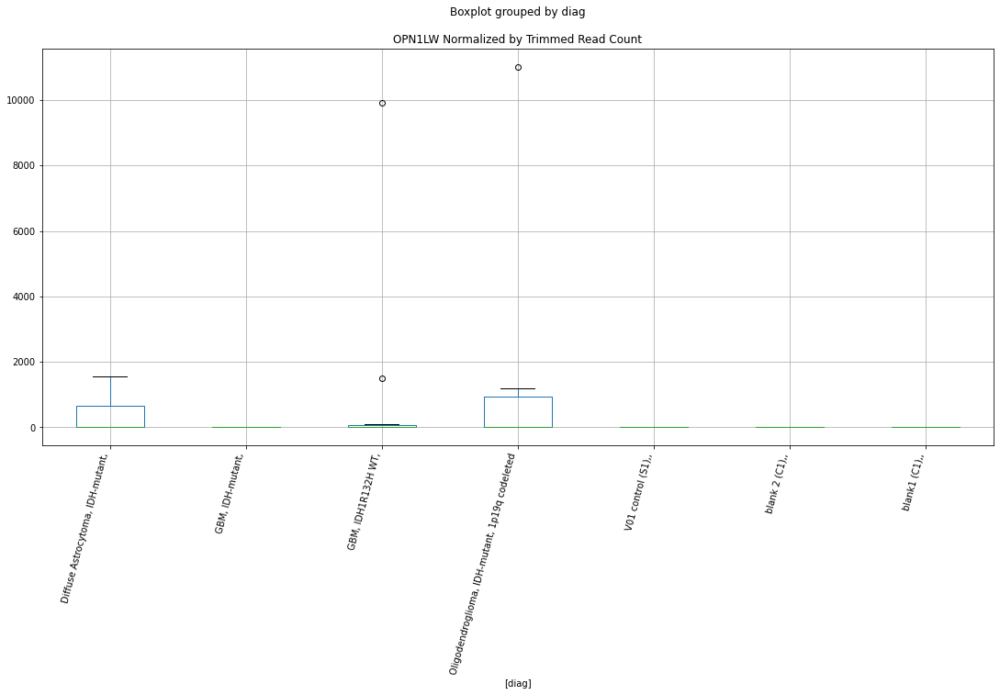

 p : 0.04698680562300626  ( t : 2.1325557652869693 ) :  D-plex  :  cutadapt2  :  OPN1MW3
Control and blanks
76     0.0
340    0.0
Name: OPN1MW3, dtype: float64
208    0.0
Name: OPN1MW3, dtype: float64
472    0.0
Name: OPN1MW3, dtype: float64


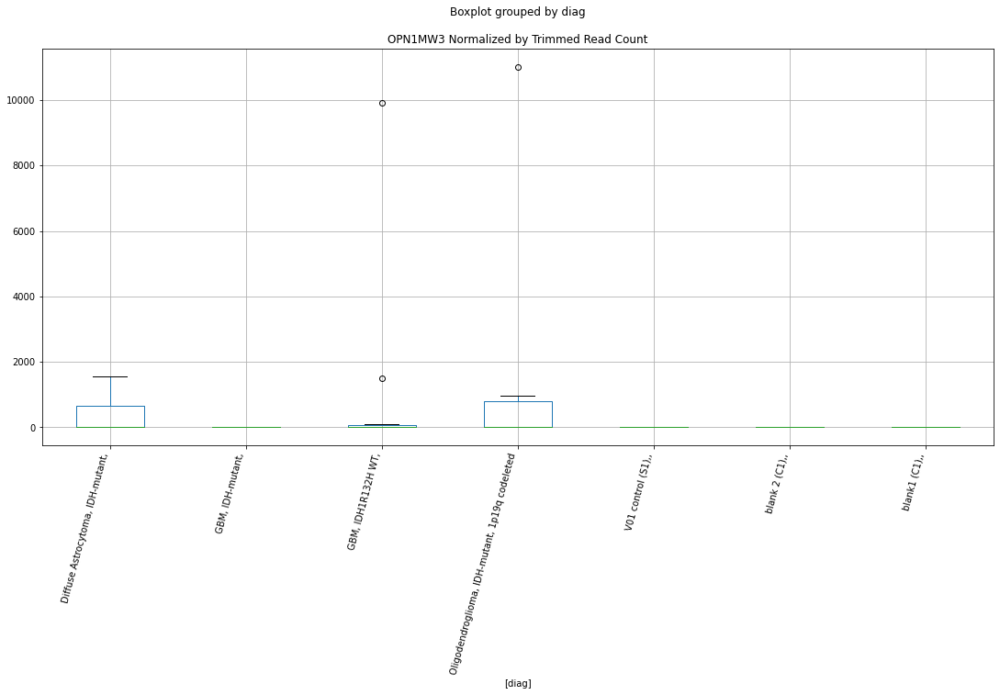

 p : 0.04698680562300626  ( t : 2.1325557652869693 ) :  D-plex  :  cutadapt2  :  OPN1MW2
Control and blanks
76     0.0
340    0.0
Name: OPN1MW2, dtype: float64
208    0.0
Name: OPN1MW2, dtype: float64
472    0.0
Name: OPN1MW2, dtype: float64


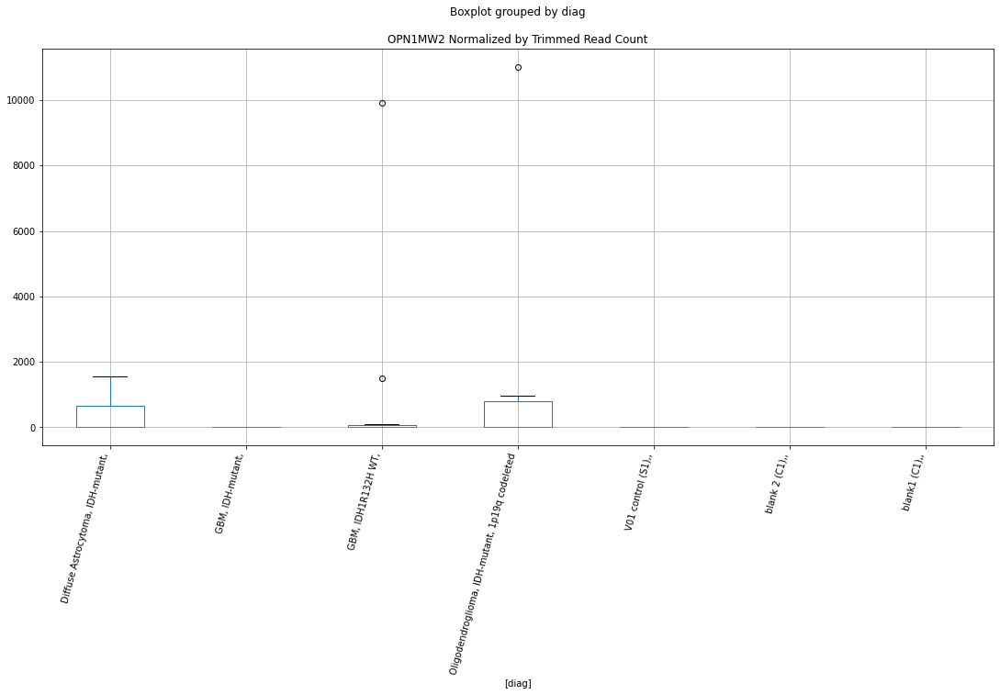

 p : 0.04699572430732762  ( t : 2.1324594374759416 ) :  D-plex  :  cutadapt2  :  ODF2
Control and blanks
76     0.0
340    0.0
Name: ODF2, dtype: float64
208    19046.9
Name: ODF2, dtype: float64
472    13292.98
Name: ODF2, dtype: float64


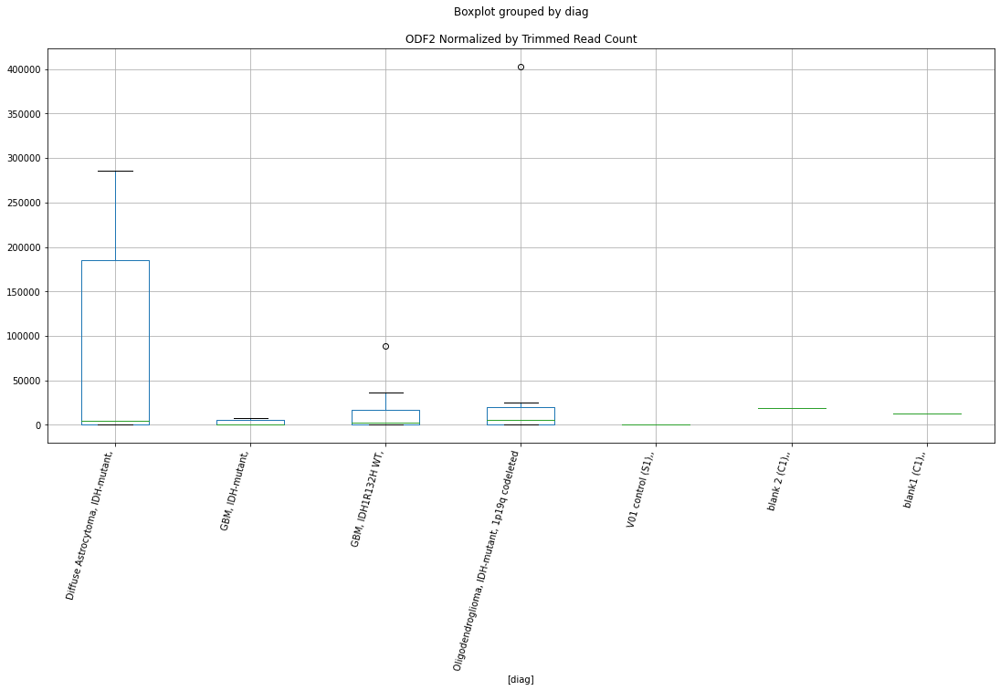

 p : 0.04705214685629896  ( t : 2.1318504219492236 ) :  D-plex  :  cutadapt2  :  NEK6
Control and blanks
76     0.0
340    0.0
Name: NEK6, dtype: float64
208    2645.4
Name: NEK6, dtype: float64
472    0.0
Name: NEK6, dtype: float64


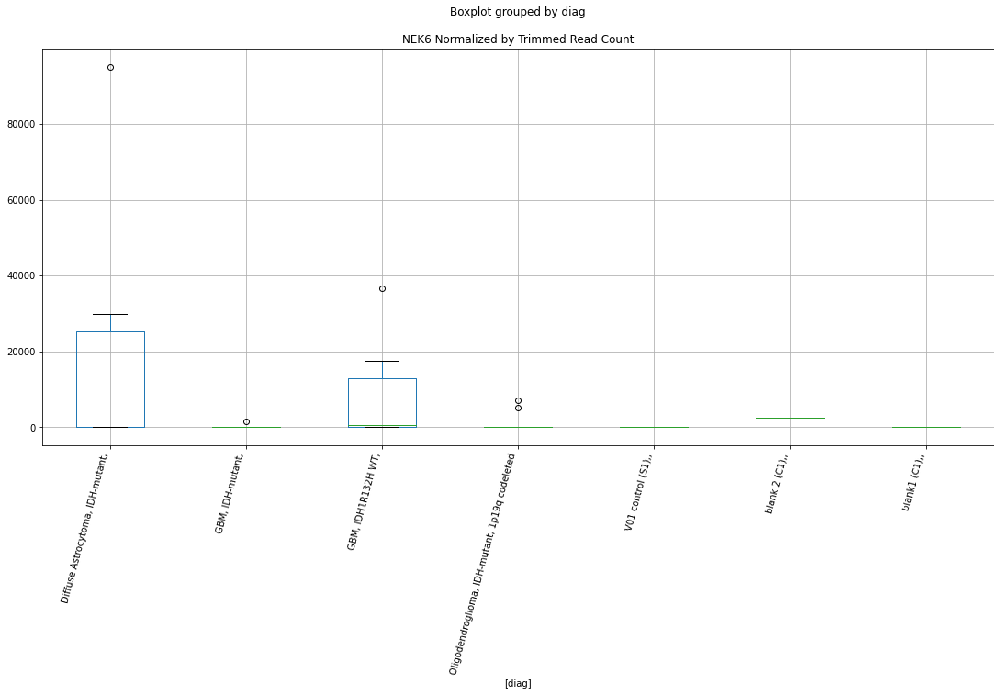

 p : 0.0471160377176029  ( t : 2.1311615982722563 ) :  Lexogen  :  bbduk2  :  OPA3
Control and blanks
79     0.0
343    0.0
Name: OPA3, dtype: float64
211    0.0
Name: OPA3, dtype: float64
475    0.0
Name: OPA3, dtype: float64


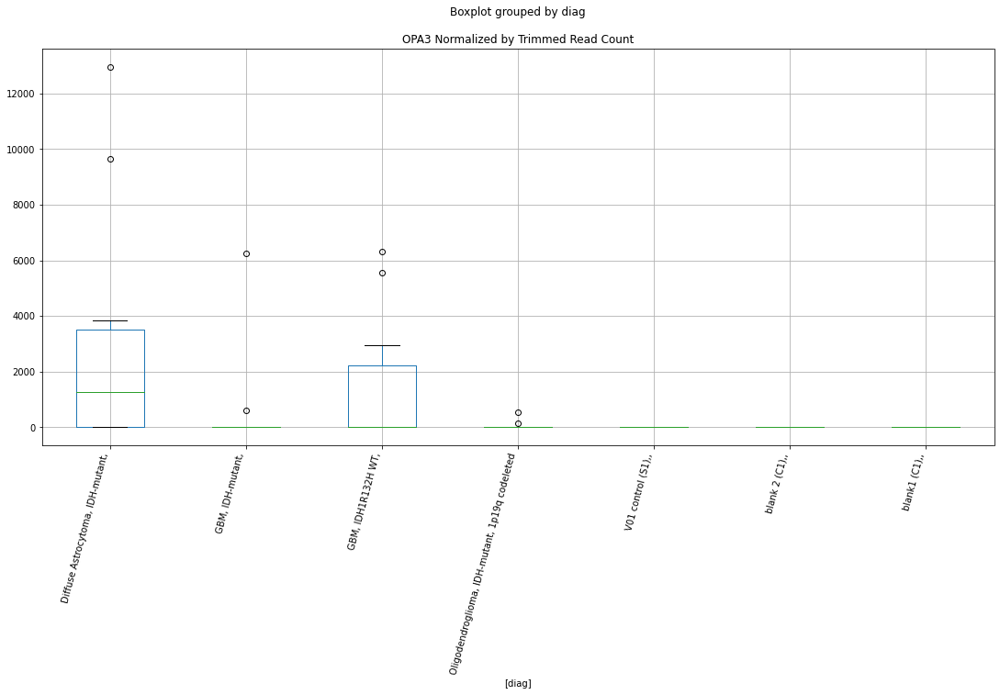

 p : 0.04718093886251208  ( t : 2.130462754009915 ) :  Lexogen  :  cutadapt2  :  LOC107987099
Control and blanks
82       0.00
346    210.43
Name: LOC107987099, dtype: float64
214    271.23
Name: LOC107987099, dtype: float64
478    237.46
Name: LOC107987099, dtype: float64


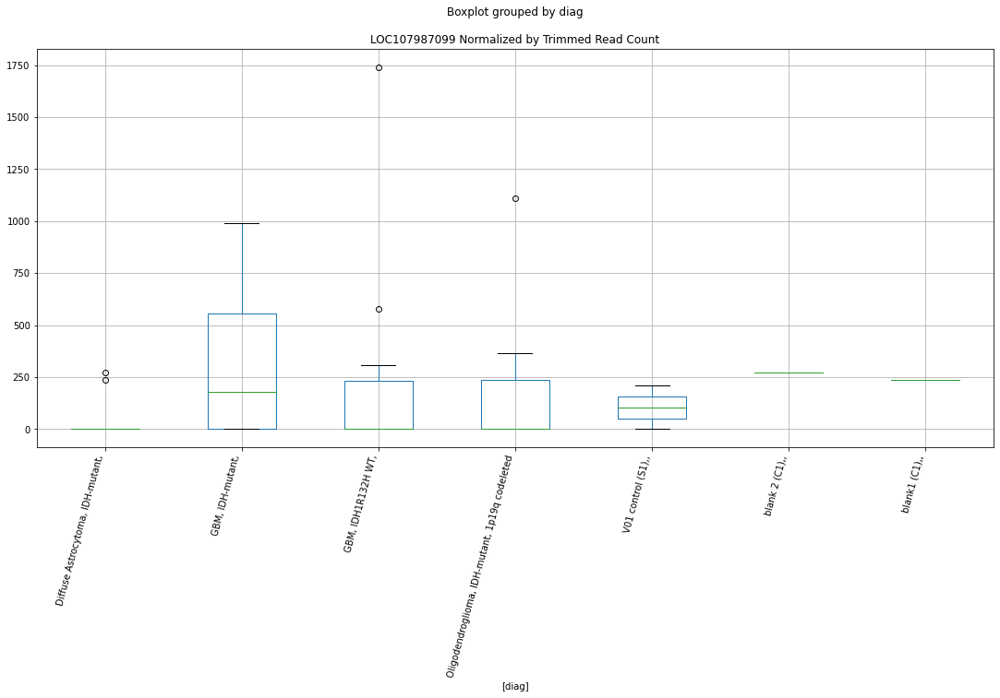

 p : 0.04725485086152354  ( t : 2.1296679491980575 ) :  D-plex  :  cutadapt2  :  NEK7
Control and blanks
76     0.0
340    0.0
Name: NEK7, dtype: float64
208    0.0
Name: NEK7, dtype: float64
472    8669.34
Name: NEK7, dtype: float64


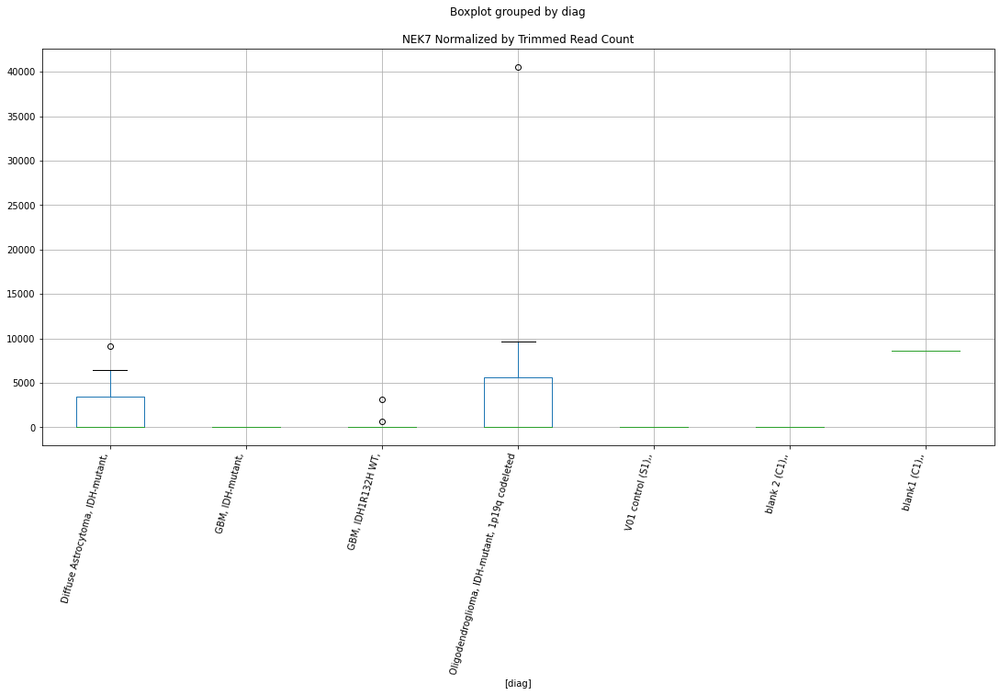

 p : 0.04726084387089146  ( t : 2.1296035536998126 ) :  D-plex  :  cutadapt2  :  NUDT11
Control and blanks
76     0.0
340    0.0
Name: NUDT11, dtype: float64
208    176.36
Name: NUDT11, dtype: float64
472    577.96
Name: NUDT11, dtype: float64


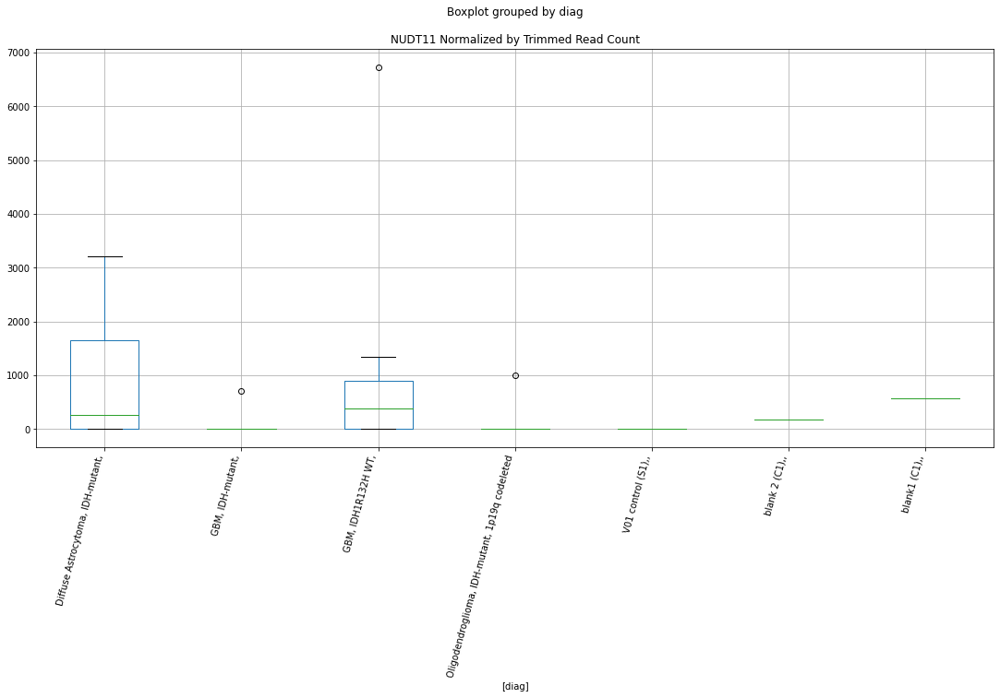

 p : 0.047416817885414006  ( t : 2.127930209785033 ) :  Lexogen  :  cutadapt2  :  LPAR2
Control and blanks
82     0.0
346    0.0
Name: LPAR2, dtype: float64
214    0.0
Name: LPAR2, dtype: float64
478    0.0
Name: LPAR2, dtype: float64


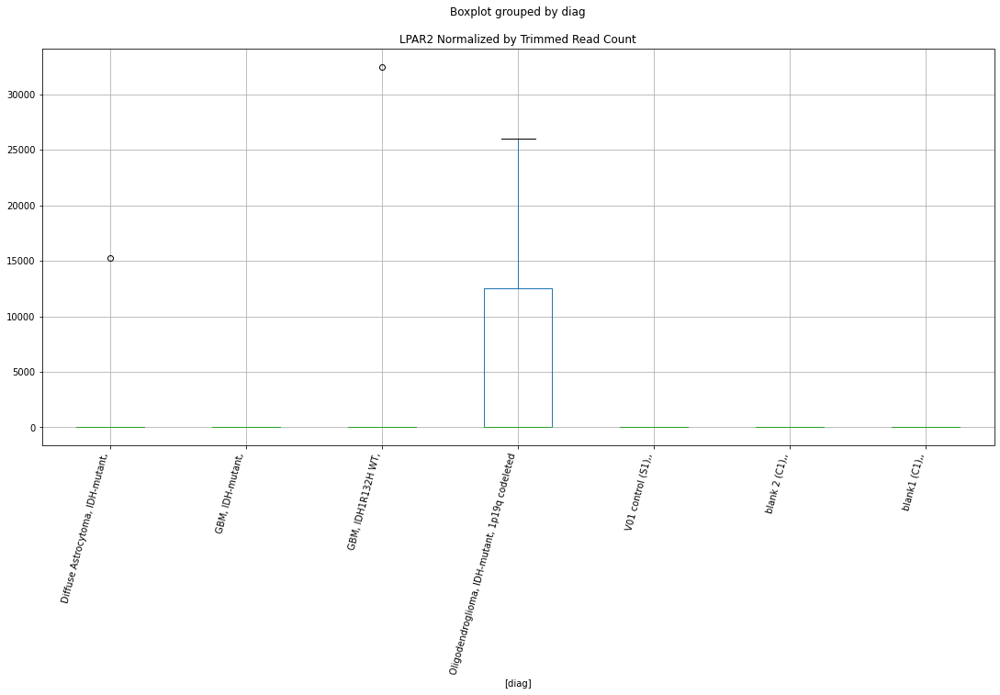

 p : 0.04743020859900781  ( t : 2.127786783507254 ) :  Lexogen  :  bbduk2  :  LPAR2
Control and blanks
79     0.0
343    0.0
Name: LPAR2, dtype: float64
211    0.0
Name: LPAR2, dtype: float64
475    0.0
Name: LPAR2, dtype: float64


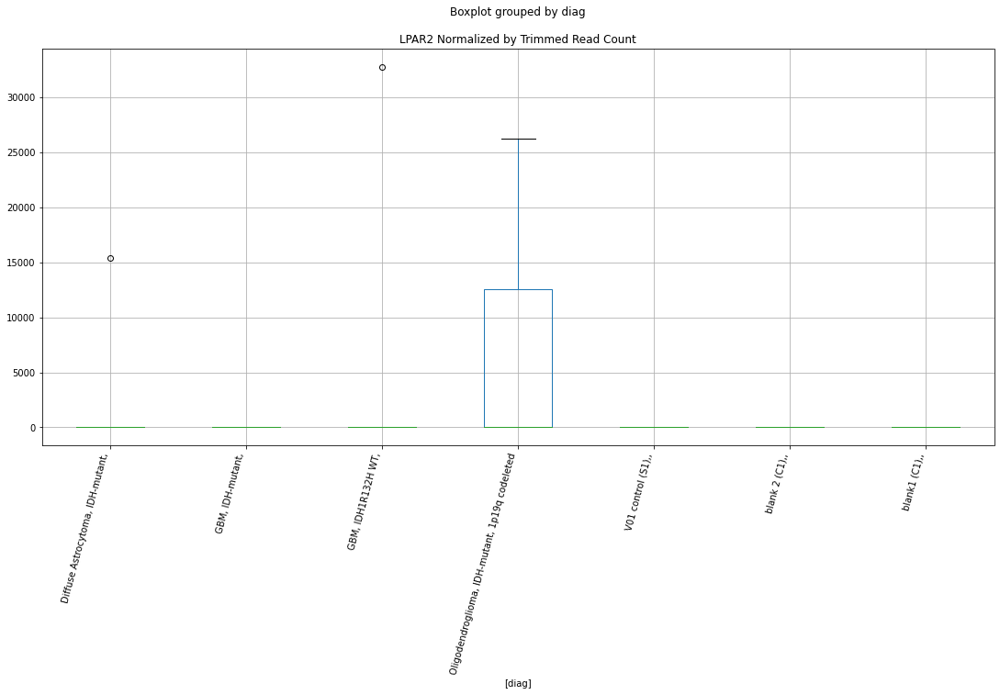

 p : 0.04746234229038715  ( t : 2.127442754023222 ) :  D-plex  :  cutadapt2  :  NSUN7
Control and blanks
76     0.0
340    0.0
Name: NSUN7, dtype: float64
208    2821.76
Name: NSUN7, dtype: float64
472    4623.65
Name: NSUN7, dtype: float64


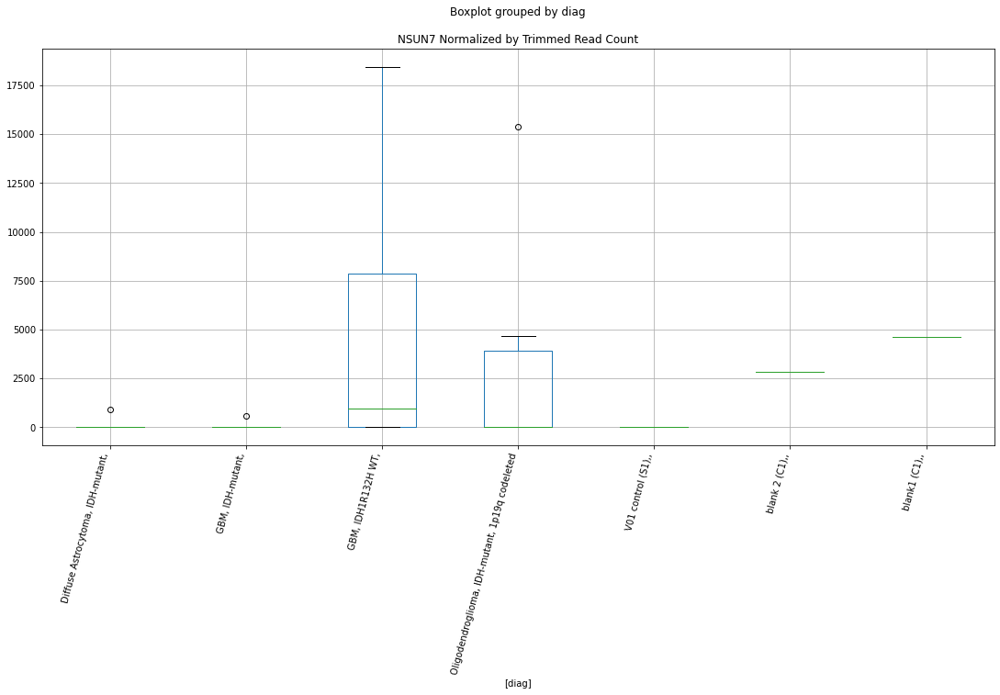

 p : 0.04751719059637019  ( t : 2.1268560276839885 ) :  D-plex  :  cutadapt2  :  LOC107986990
Control and blanks
76       757.61
340    37871.48
Name: LOC107986990, dtype: float64
208    705.44
Name: LOC107986990, dtype: float64
472    1155.91
Name: LOC107986990, dtype: float64


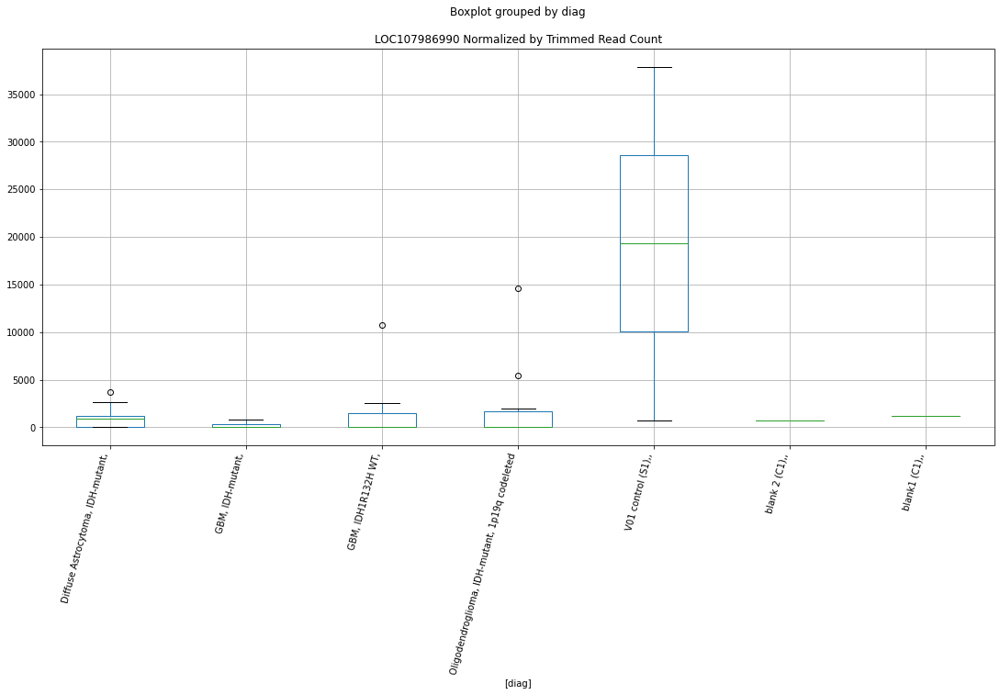

 p : 0.04757920266298658  ( t : 2.1261934118104264 ) :  D-plex  :  cutadapt2  :  LOC107987150
Control and blanks
76     0.0
340    0.0
Name: LOC107987150, dtype: float64
208    1939.96
Name: LOC107987150, dtype: float64
472    64153.1
Name: LOC107987150, dtype: float64


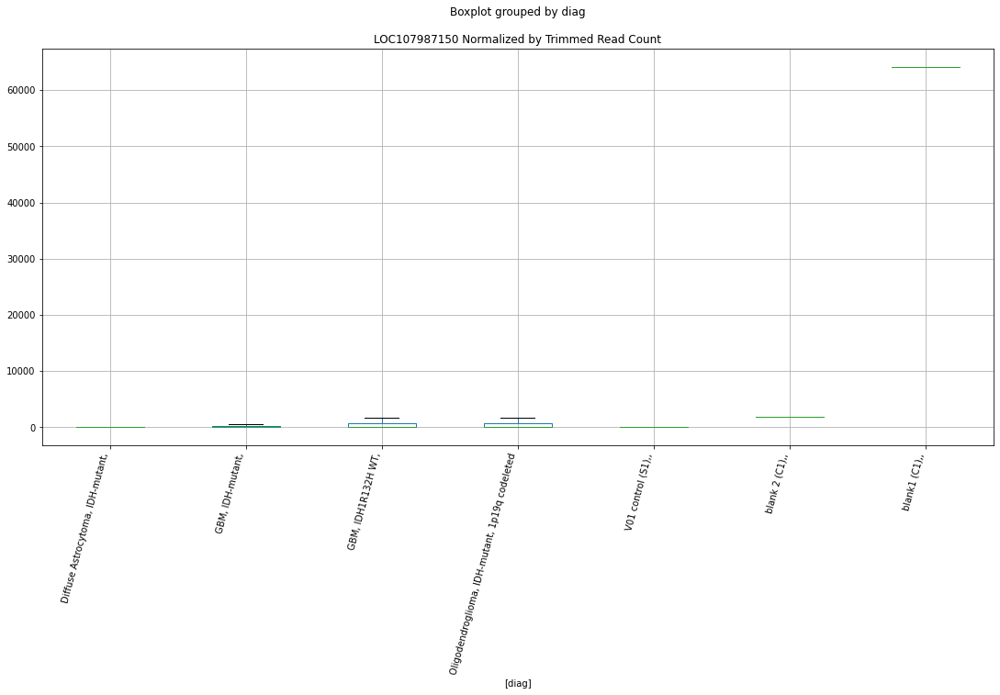

 p : 0.04767908120766343  ( t : 2.125127835253718 ) :  Lexogen  :  bbduk2  :  NBEA
Control and blanks
79     0.0
343    0.0
Name: NBEA, dtype: float64
211    0.0
Name: NBEA, dtype: float64
475    0.0
Name: NBEA, dtype: float64


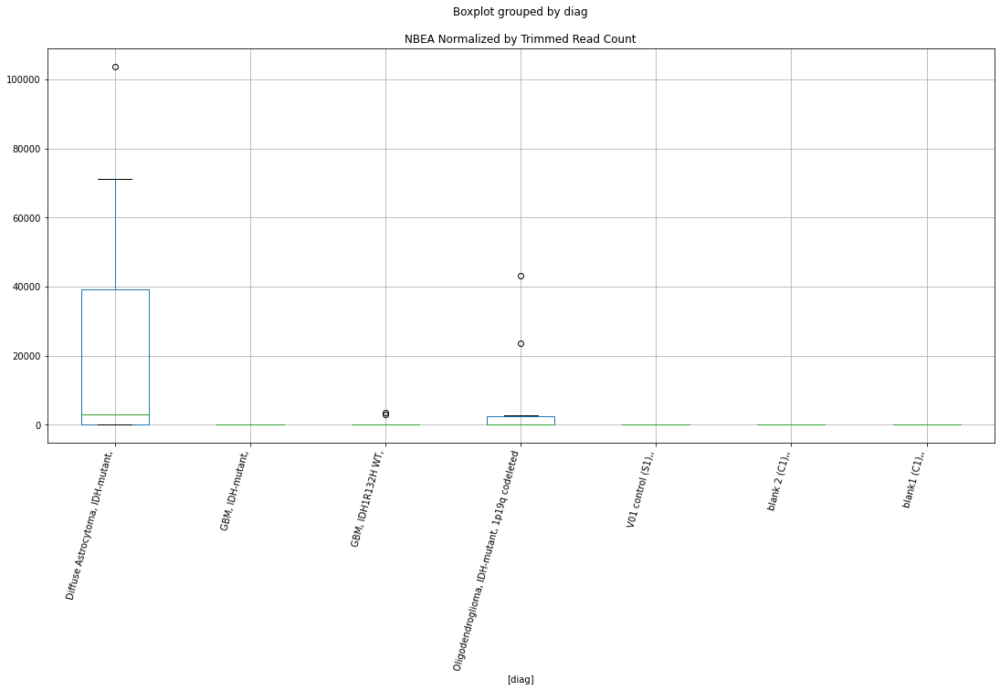

 p : 0.04776064297536936  ( t : 2.1242591831084847 ) :  D-plex  :  cutadapt2  :  LRRD1
Control and blanks
76      2272.84
340    13210.98
Name: LRRD1, dtype: float64
208    1587.24
Name: LRRD1, dtype: float64
472    4623.65
Name: LRRD1, dtype: float64


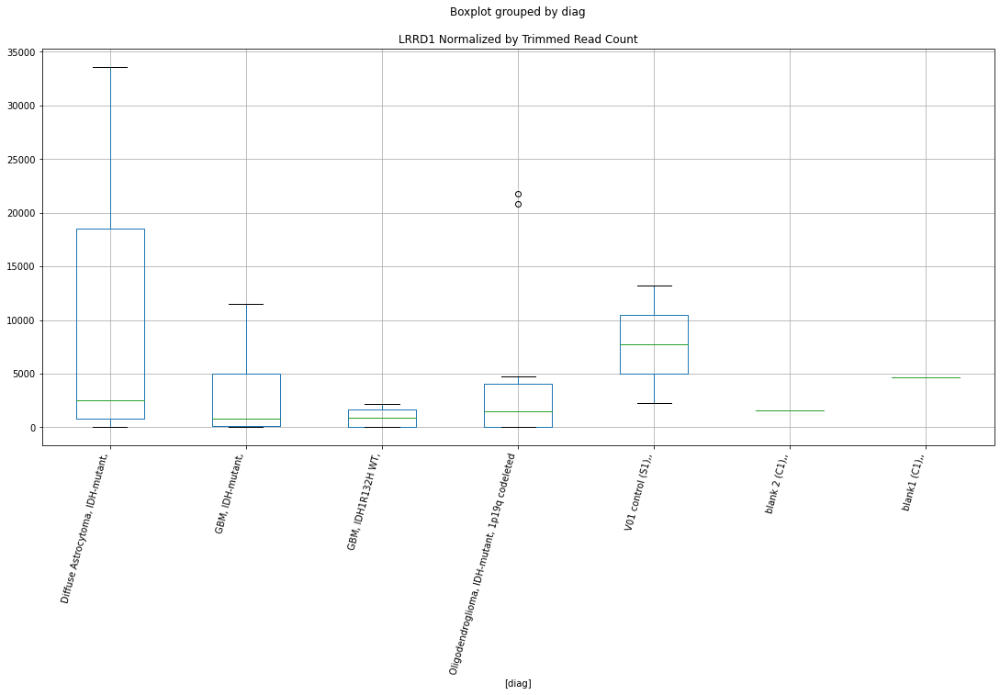

 p : 0.047810059536494434  ( t : 2.1237335424036266 ) :  Lexogen  :  bbduk2  :  LOC107986108
Control and blanks
79       0.00
343    212.31
Name: LOC107986108, dtype: float64
211    273.31
Name: LOC107986108, dtype: float64
475    239.52
Name: LOC107986108, dtype: float64


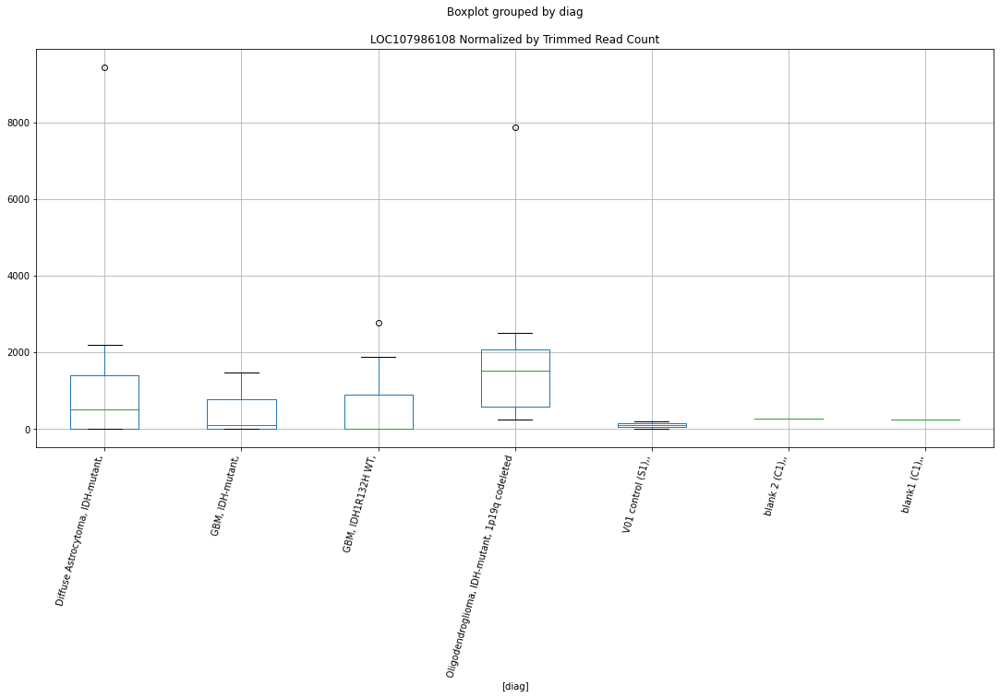

 p : 0.04782578513328371  ( t : 2.1235663741000743 ) :  D-plex  :  bbduk2  :  LOC107986261
Control and blanks
73        0.00
337    7121.26
Name: LOC107986261, dtype: float64
205    716.36
Name: LOC107986261, dtype: float64
469    3549.16
Name: LOC107986261, dtype: float64


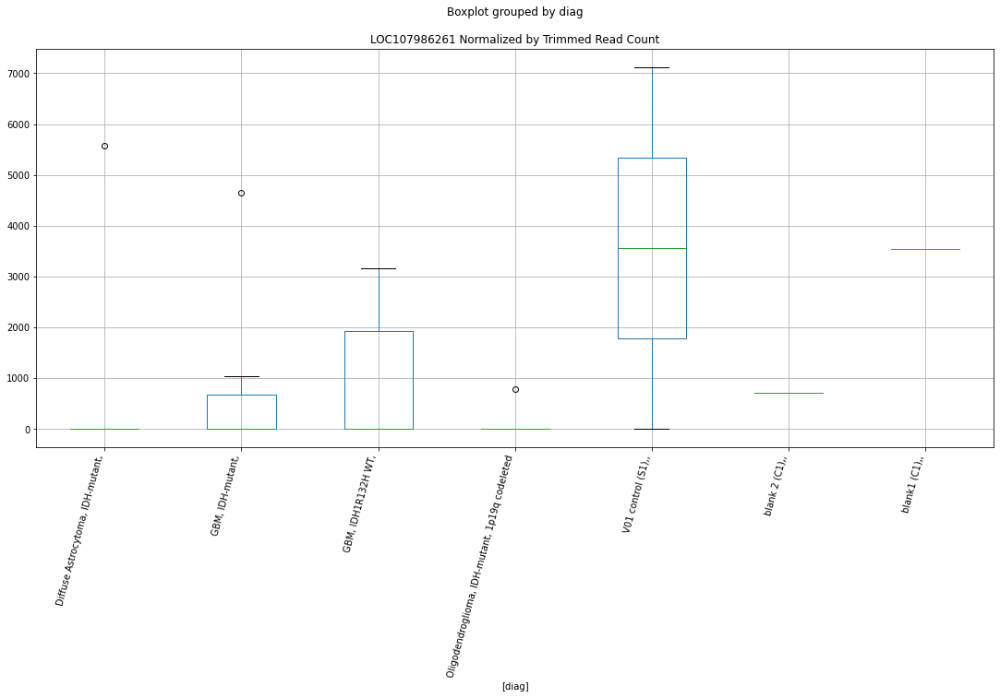

 p : 0.047863766115593655  ( t : 2.1231628301411414 ) :  D-plex  :  cutadapt2  :  MEF2B
Control and blanks
76     0.0
340    0.0
Name: MEF2B, dtype: float64
208    0.0
Name: MEF2B, dtype: float64
472    0.0
Name: MEF2B, dtype: float64


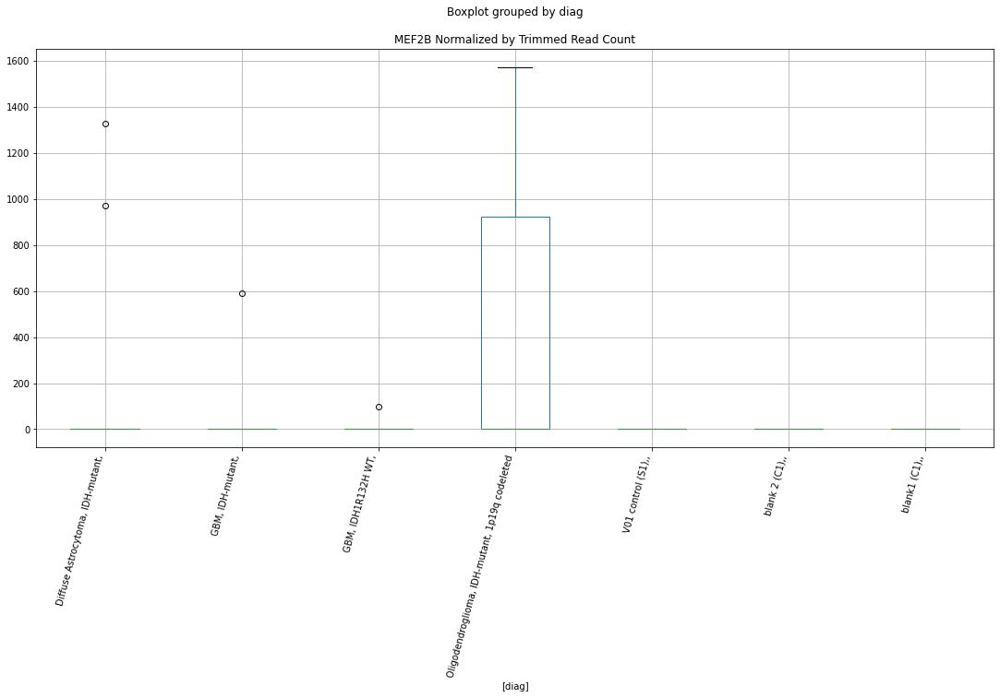

 p : 0.047880712701344766  ( t : 2.122982868567821 ) :  D-plex  :  bbduk2  :  LOC107987150
Control and blanks
73     0.0
337    0.0
Name: LOC107987150, dtype: float64
205    1790.91
Name: LOC107987150, dtype: float64
469    65068.0
Name: LOC107987150, dtype: float64


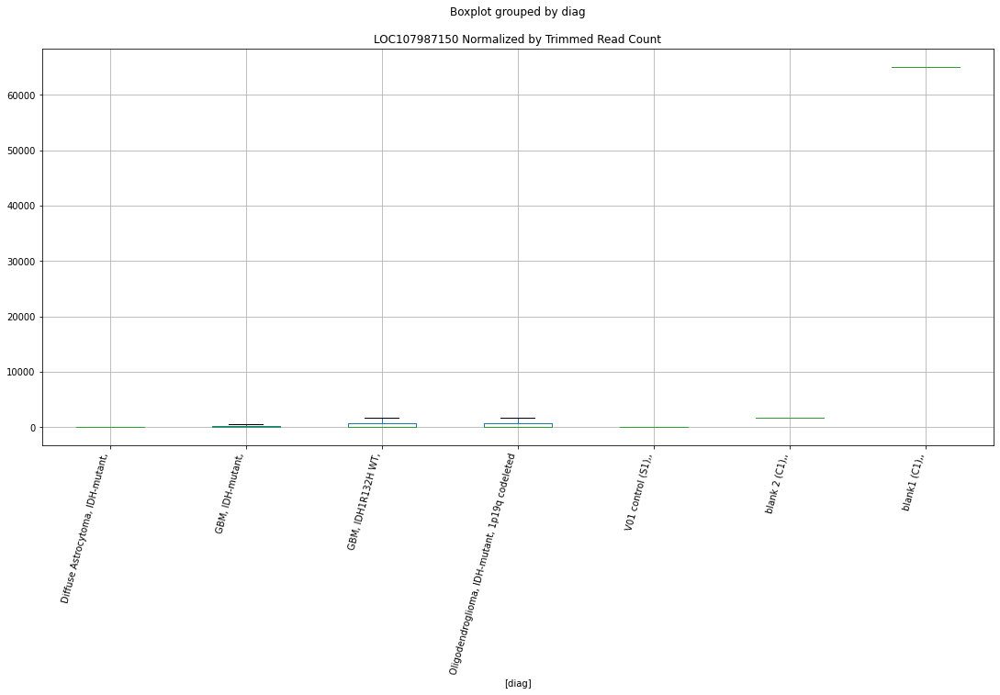

 p : 0.04788336355030275  ( t : 2.122954723547716 ) :  D-plex  :  bbduk2  :  LPCAT1
Control and blanks
73         0.00
337    32935.82
Name: LPCAT1, dtype: float64
205    1970.0
Name: LPCAT1, dtype: float64
469    3549.16
Name: LPCAT1, dtype: float64


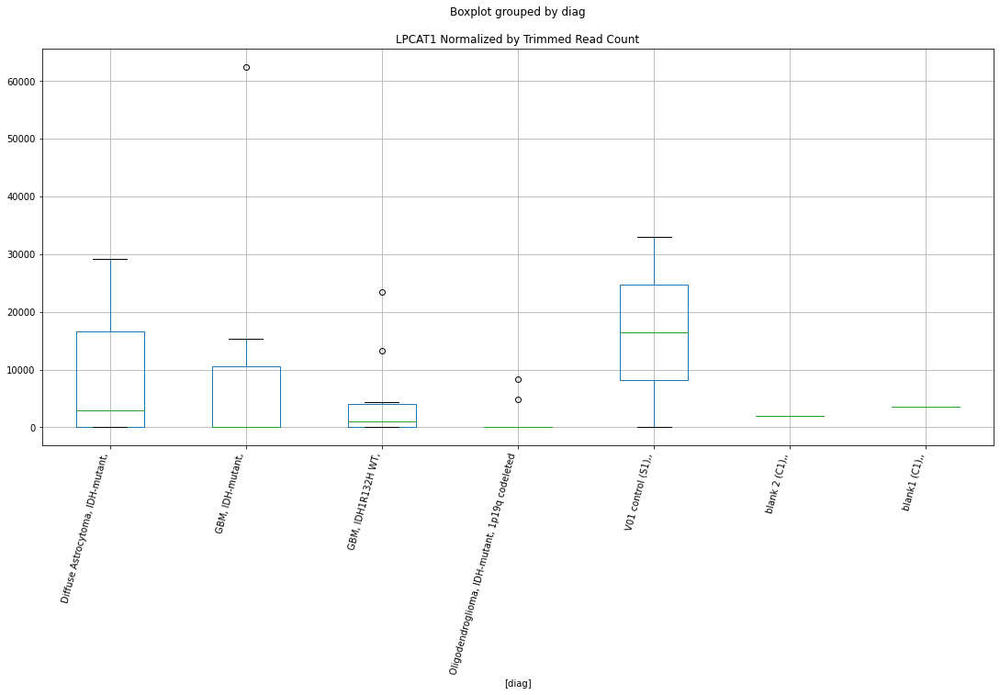

 p : 0.047902893968987025  ( t : 2.122747405791682 ) :  Lexogen  :  bbduk2  :  LOC107986584
Control and blanks
79     0.0
343    0.0
Name: LOC107986584, dtype: float64
211    0.0
Name: LOC107986584, dtype: float64
475    0.0
Name: LOC107986584, dtype: float64


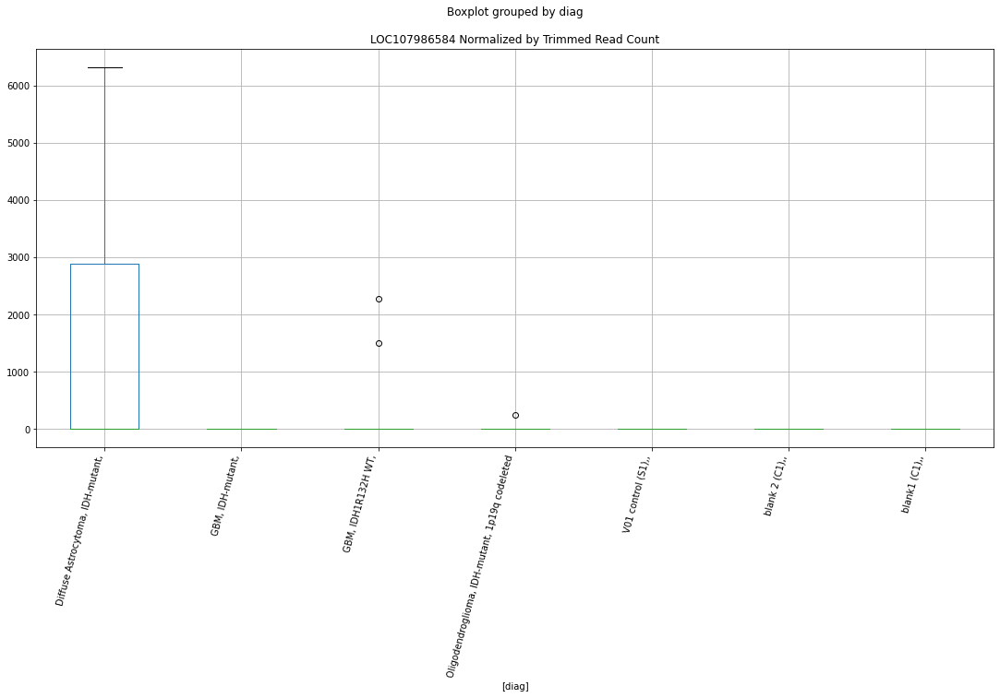

 p : 0.0479230805745344  ( t : 2.122533203451131 ) :  D-plex  :  bbduk2  :  NUB1
Control and blanks
73     0.0
337    0.0
Name: NUB1, dtype: float64
205    716.36
Name: NUB1, dtype: float64
469    0.0
Name: NUB1, dtype: float64


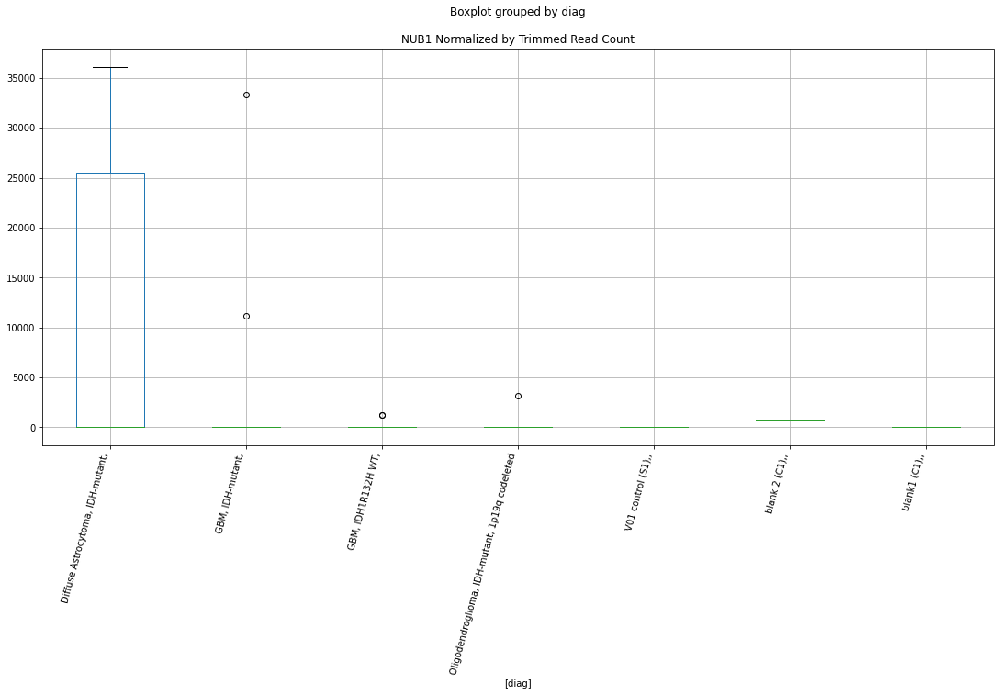

 p : 0.047960283790153185  ( t : 2.1221386512095513 ) :  Lexogen  :  bbduk2  :  MAST4
Control and blanks
79       0.00
343    212.31
Name: MAST4, dtype: float64
211    4372.9
Name: MAST4, dtype: float64
475    0.0
Name: MAST4, dtype: float64


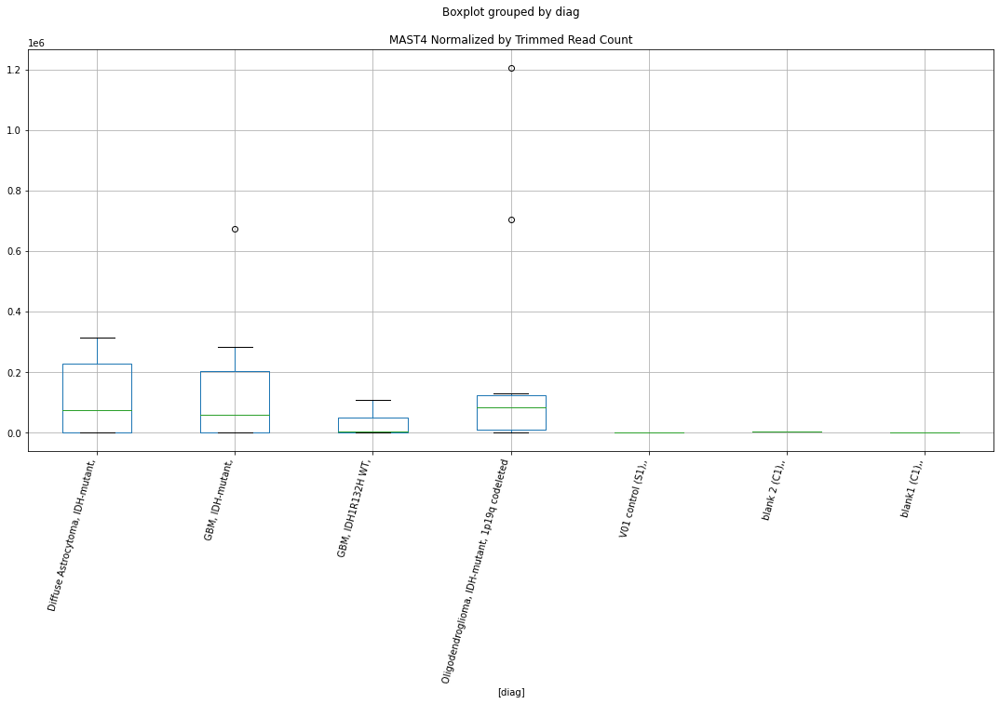

 p : 0.04805858609058003  ( t : 2.121097463367942 ) :  D-plex  :  bbduk2  :  NHEJ1
Control and blanks
73      773.01
337    6231.10
Name: NHEJ1, dtype: float64
205    38862.74
Name: NHEJ1, dtype: float64
469    127769.9
Name: NHEJ1, dtype: float64


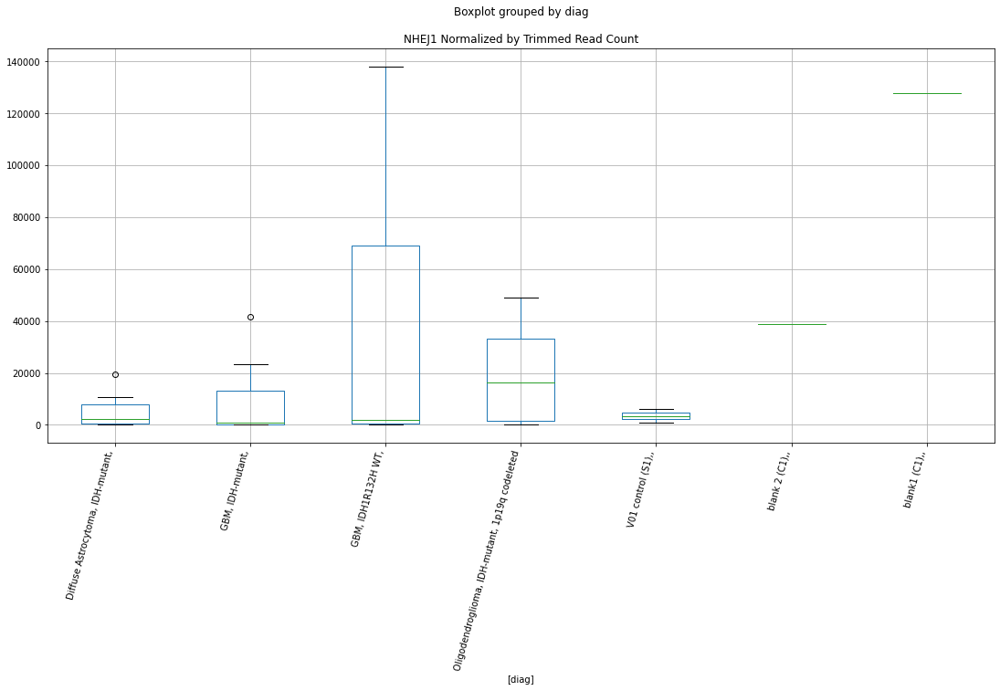

 p : 0.048100225747090504  ( t : 2.120657013719731 ) :  D-plex  :  cutadapt2  :  MSANTD4
Control and blanks
76     0.0
340    0.0
Name: MSANTD4, dtype: float64
208    0.0
Name: MSANTD4, dtype: float64
472    0.0
Name: MSANTD4, dtype: float64


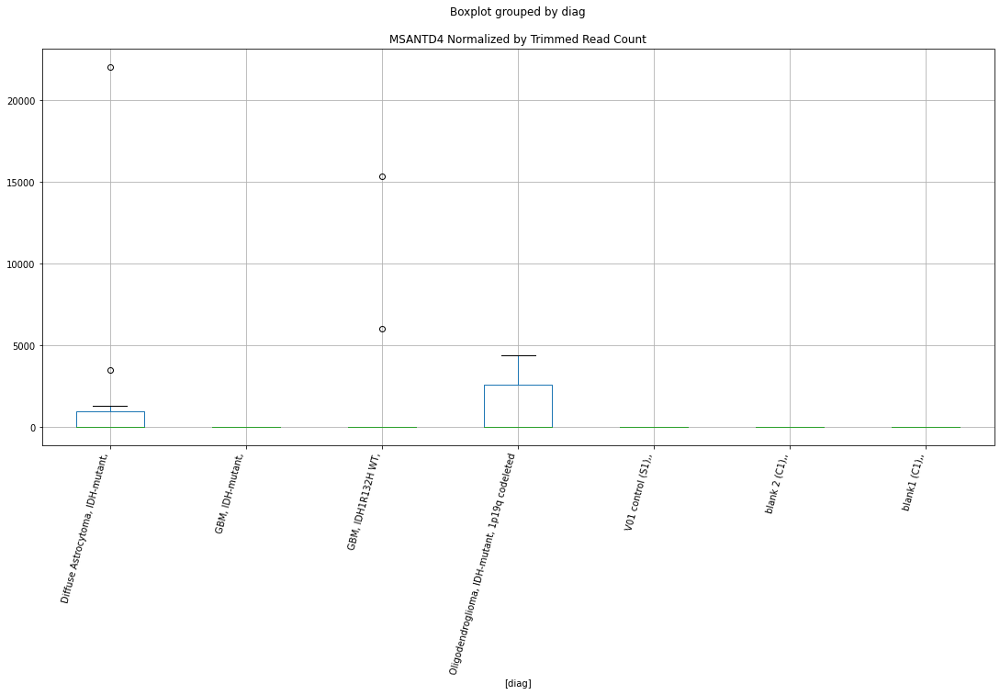

 p : 0.04817266972303666  ( t : 2.1198915538853496 ) :  Lexogen  :  bbduk2  :  MAP3K20
Control and blanks
79     0.0
343    0.0
Name: MAP3K20, dtype: float64
211    0.0
Name: MAP3K20, dtype: float64
475    239.52
Name: MAP3K20, dtype: float64


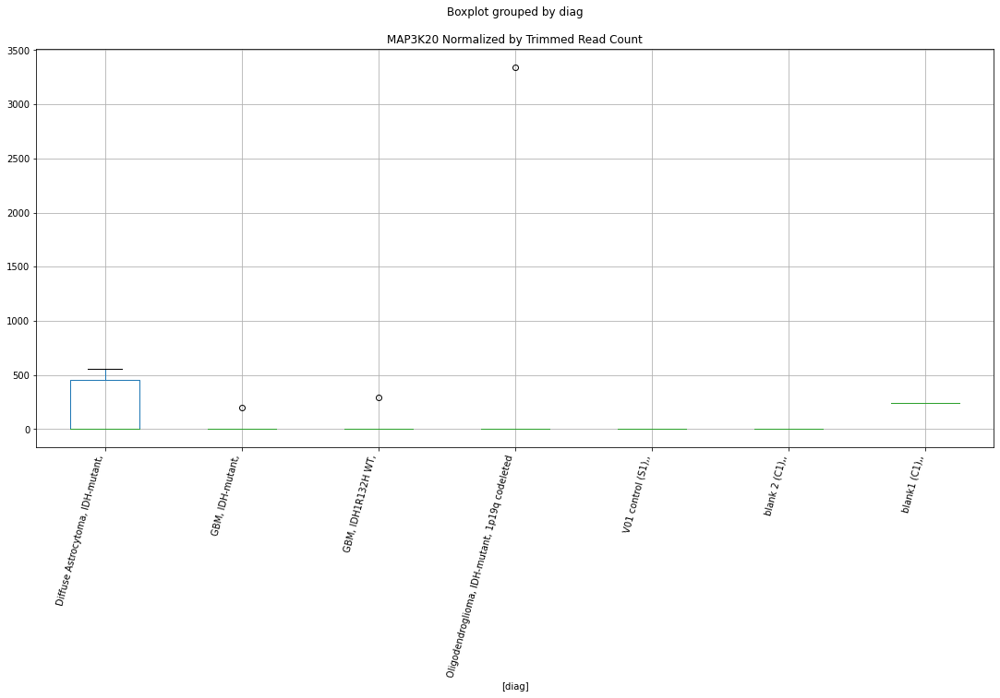

 p : 0.04831511944801739  ( t : 2.118389449826176 ) :  D-plex  :  cutadapt2  :  MAGEC2
Control and blanks
76     757.61
340      0.00
Name: MAGEC2, dtype: float64
208    1410.88
Name: MAGEC2, dtype: float64
472    3467.74
Name: MAGEC2, dtype: float64


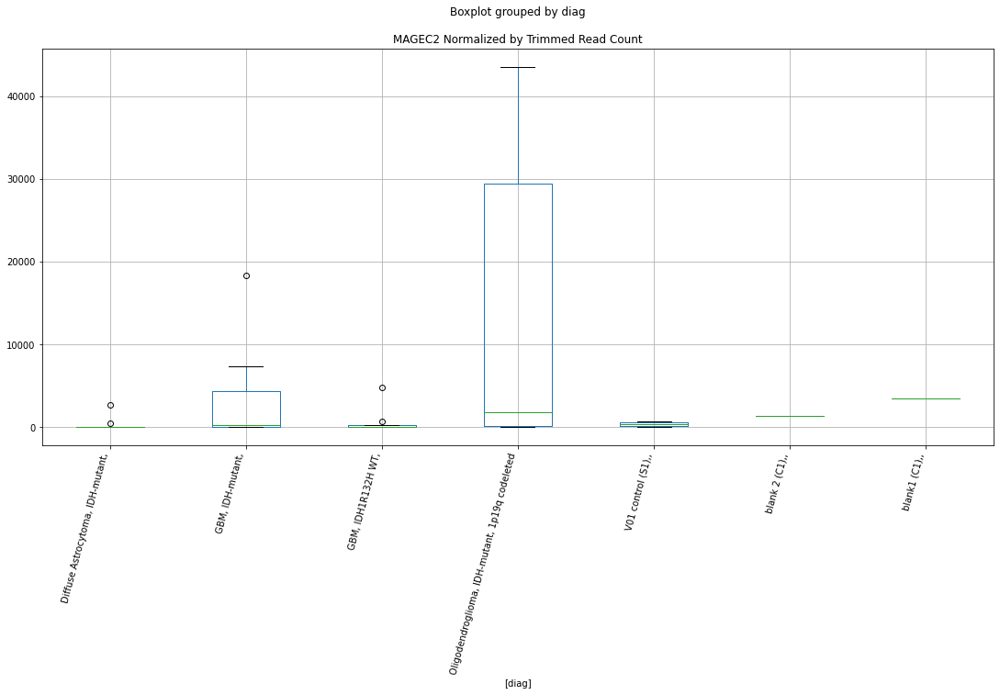

 p : 0.04833650354737927  ( t : 2.1181643070061824 ) :  D-plex  :  cutadapt2  :  NPC1L1
Control and blanks
76     0.0
340    0.0
Name: NPC1L1, dtype: float64
208    1058.16
Name: NPC1L1, dtype: float64
472    0.0
Name: NPC1L1, dtype: float64


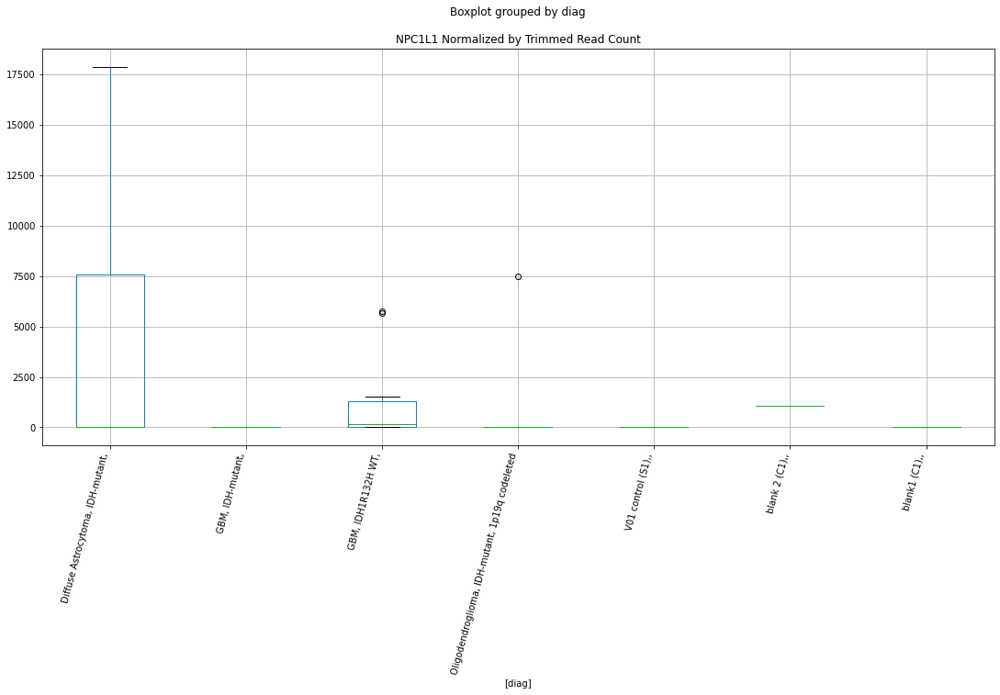

 p : 0.04835944367766239  ( t : 2.1179228823105434 ) :  D-plex  :  bbduk2  :  NPC1L1
Control and blanks
73     0.0
337    0.0
Name: NPC1L1, dtype: float64
205    1074.55
Name: NPC1L1, dtype: float64
469    0.0
Name: NPC1L1, dtype: float64


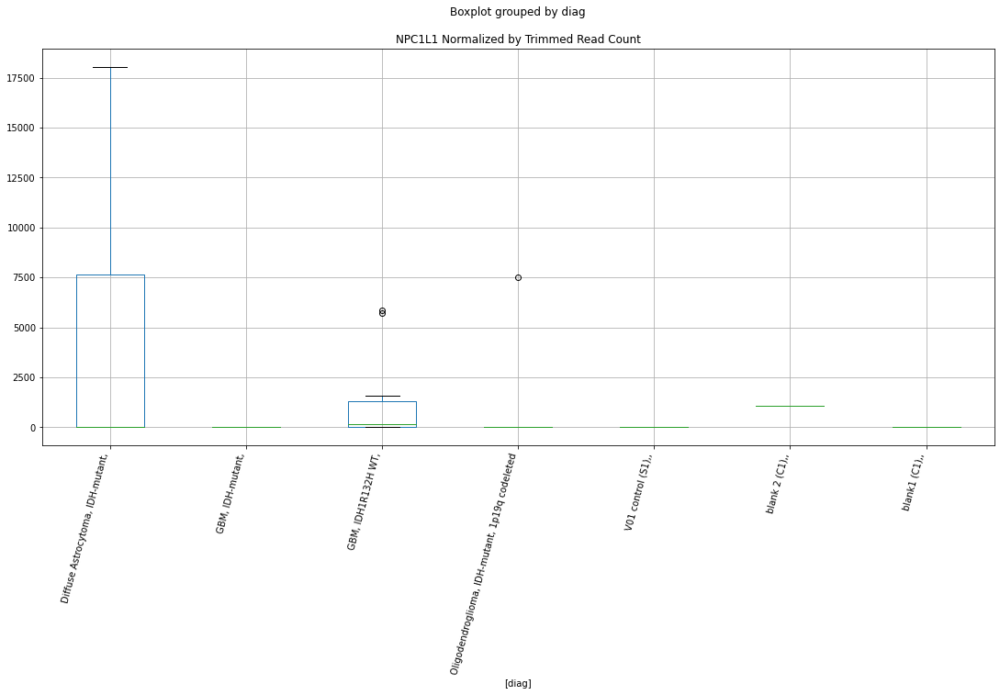

 p : 0.04840591688126755  ( t : 2.1174341121782003 ) :  D-plex  :  cutadapt2  :  LONRF2
Control and blanks
76     0.0
340    0.0
Name: LONRF2, dtype: float64
208    8994.37
Name: LONRF2, dtype: float64
472    5779.56
Name: LONRF2, dtype: float64


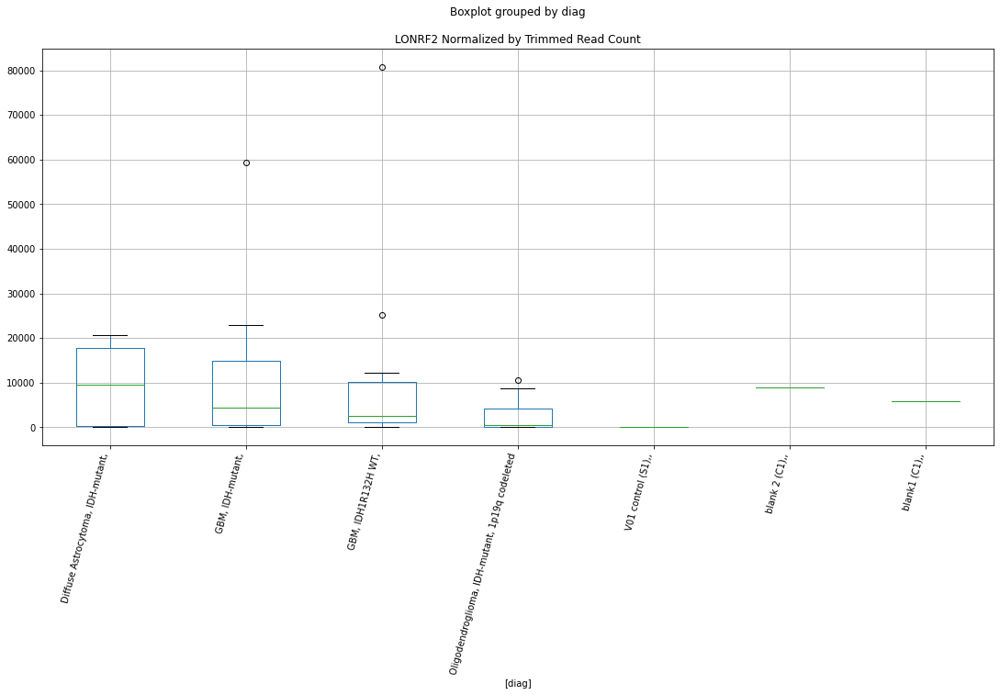

 p : 0.04844955067162882  ( t : 2.1169755936235455 ) :  D-plex  :  bbduk2  :  MAGEC2
Control and blanks
73     773.01
337      0.00
Name: MAGEC2, dtype: float64
205    1611.82
Name: MAGEC2, dtype: float64
469    3549.16
Name: MAGEC2, dtype: float64


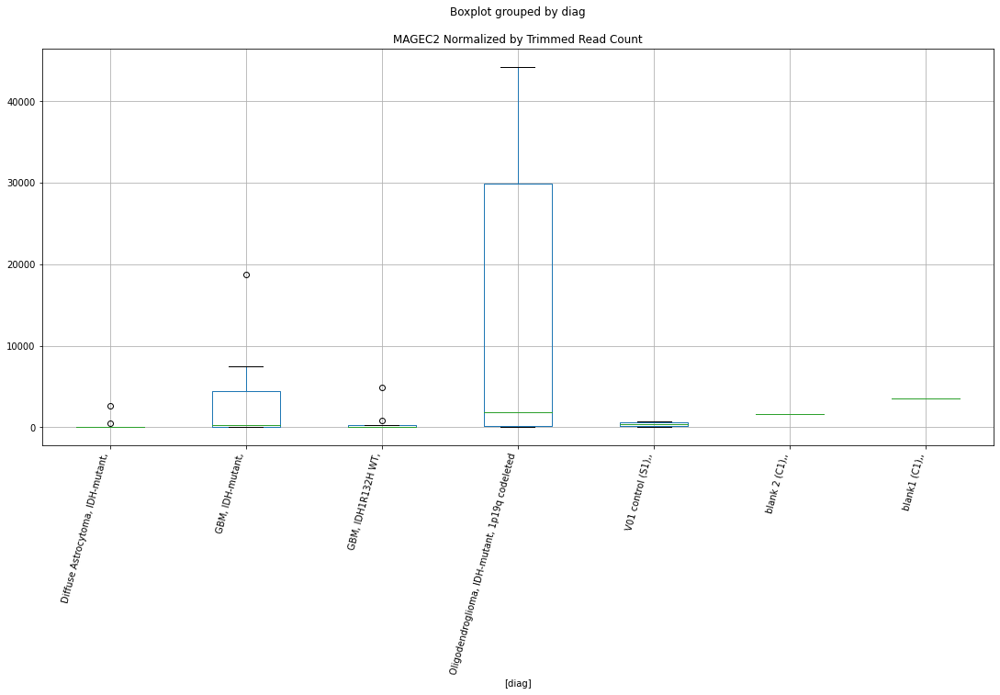

 p : 0.04855669340347543  ( t : 2.1158512948561605 ) :  D-plex  :  bbduk2  :  ODF2
Control and blanks
73     0.0
337    0.0
Name: ODF2, dtype: float64
205    19341.82
Name: ODF2, dtype: float64
469    13605.13
Name: ODF2, dtype: float64


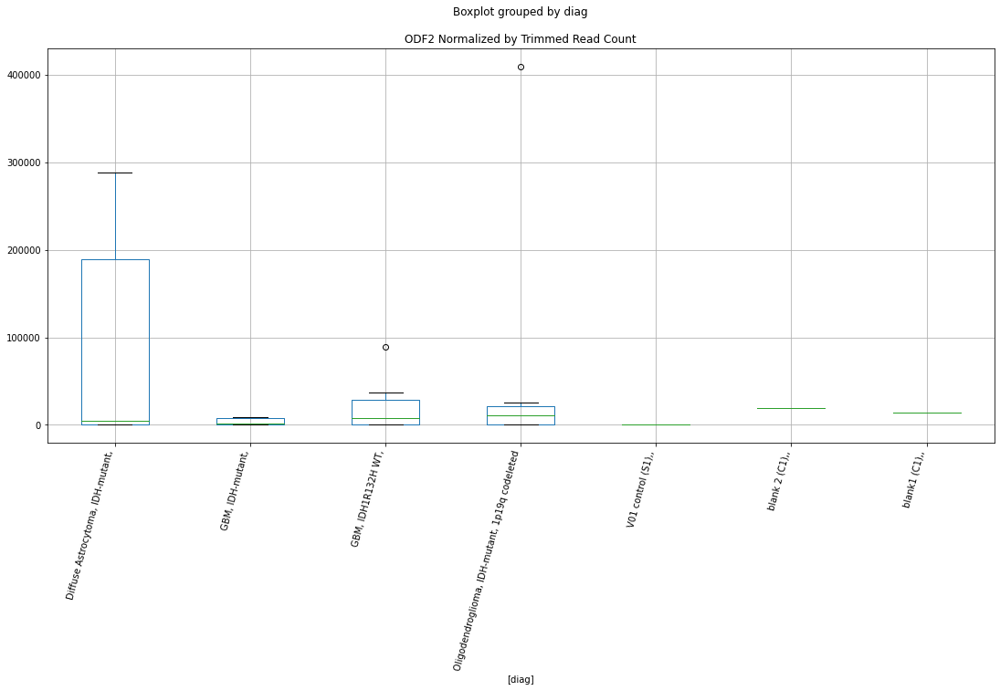

 p : 0.04872684279354868  ( t : 2.114070470524749 ) :  Lexogen  :  cutadapt2  :  MAP4K4
Control and blanks
82     0.0
346    0.0
Name: MAP4K4, dtype: float64
214    311910.42
Name: MAP4K4, dtype: float64
478    653016.33
Name: MAP4K4, dtype: float64


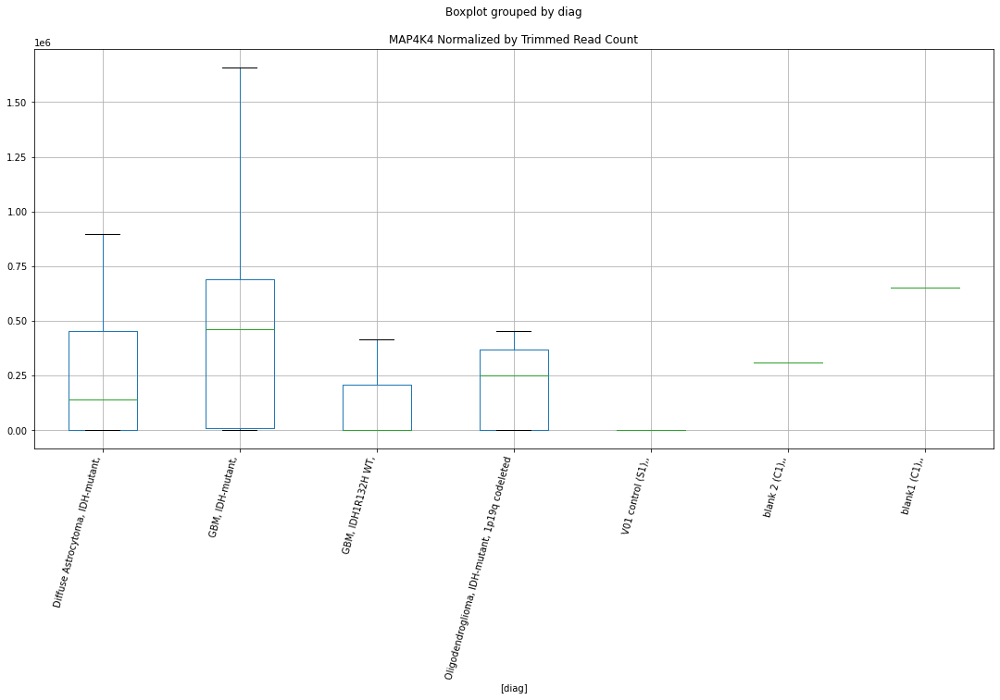

 p : 0.04874703857574679  ( t : 2.113859472575569 ) :  Lexogen  :  bbduk2  :  MSL2
Control and blanks
79     0.0
343    0.0
Name: MSL2, dtype: float64
211    0.0
Name: MSL2, dtype: float64
475    0.0
Name: MSL2, dtype: float64


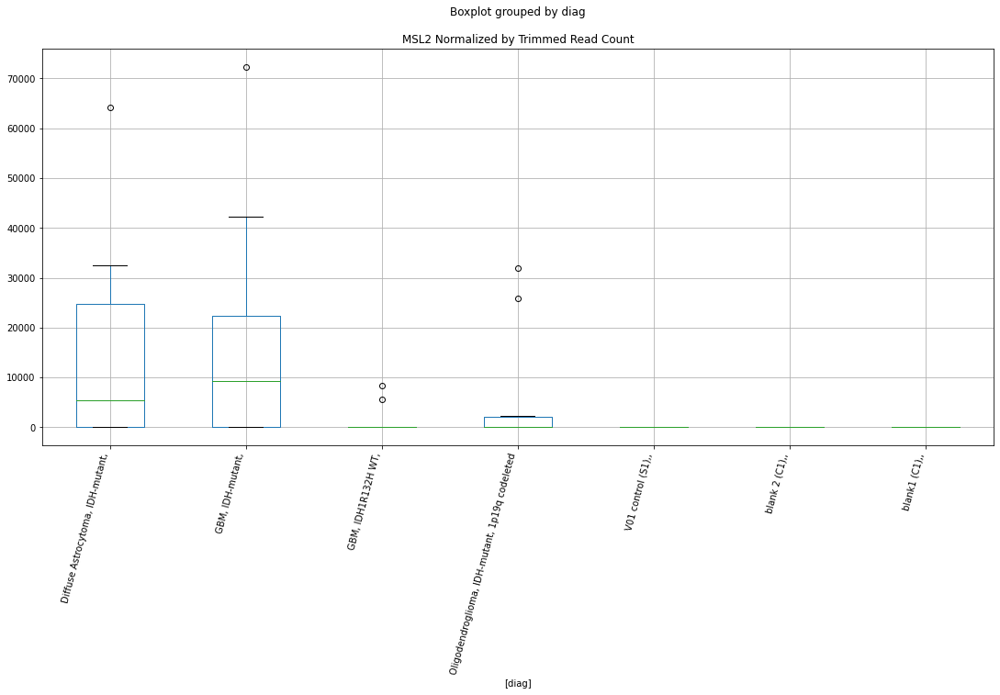

 p : 0.048832780021970106  ( t : 2.1129645631661256 ) :  Lexogen  :  bbduk2  :  MIR221
Control and blanks
79         0.00
343    17622.09
Name: MIR221, dtype: float64
211    0.0
Name: MIR221, dtype: float64
475    239.52
Name: MIR221, dtype: float64


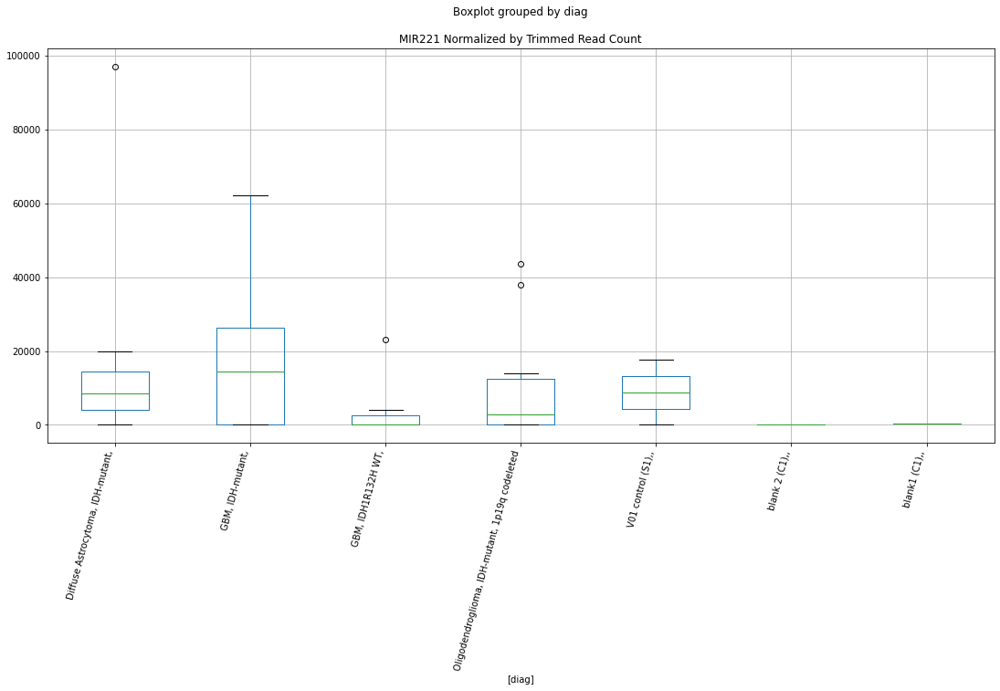

 p : 0.04897421087175277  ( t : 2.111491526753565 ) :  Lexogen  :  bbduk2  :  LRFN5
Control and blanks
79     0.0
343    0.0
Name: LRFN5, dtype: float64
211    0.0
Name: LRFN5, dtype: float64
475    0.0
Name: LRFN5, dtype: float64


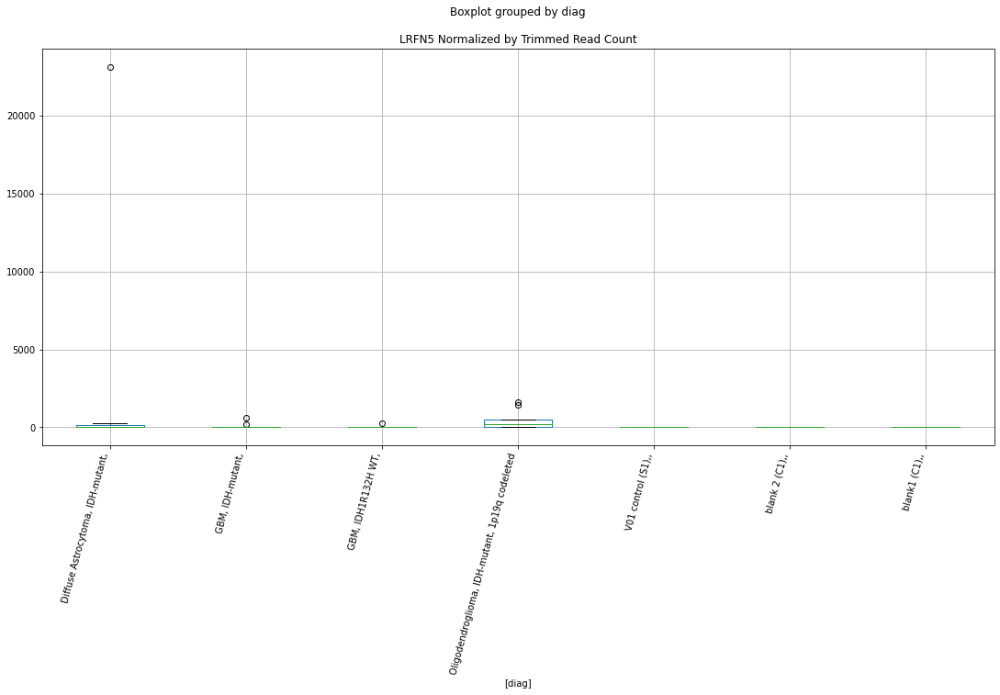

 p : 0.04901323900100664  ( t : 2.111085720899952 ) :  D-plex  :  cutadapt2  :  MYOM1
Control and blanks
76       6060.91
340    162054.71
Name: MYOM1, dtype: float64
208    7759.85
Name: MYOM1, dtype: float64
472    16182.76
Name: MYOM1, dtype: float64


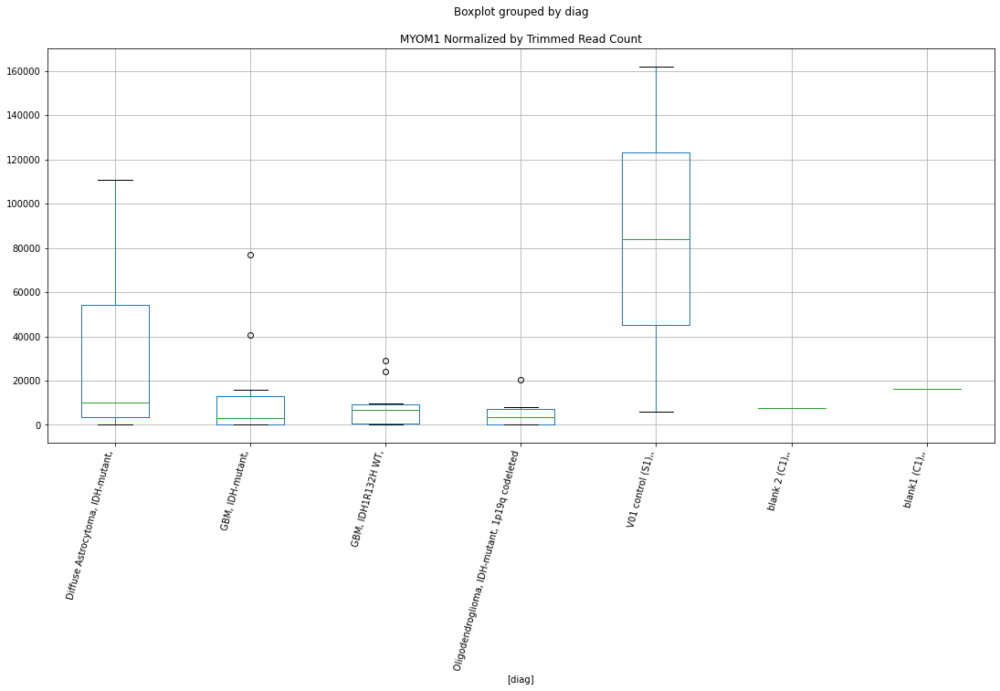

 p : 0.0490575526736648  ( t : 2.1106253134390665 ) :  D-plex  :  cutadapt2  :  NLRP11
Control and blanks
76     295469.54
340      5284.39
Name: NLRP11, dtype: float64
208    19752.34
Name: NLRP11, dtype: float64
472    23118.23
Name: NLRP11, dtype: float64


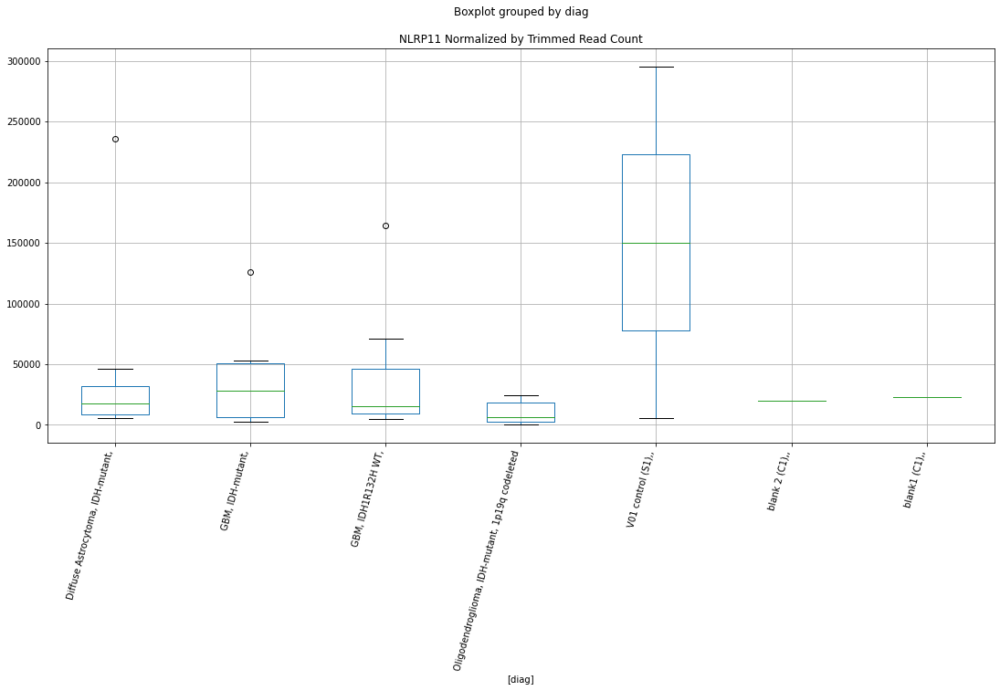

 p : 0.049120326612465515  ( t : 2.109973755922226 ) :  D-plex  :  cutadapt2  :  NSUN7
Control and blanks
76     0.0
340    0.0
Name: NSUN7, dtype: float64
208    2821.76
Name: NSUN7, dtype: float64
472    4623.65
Name: NSUN7, dtype: float64


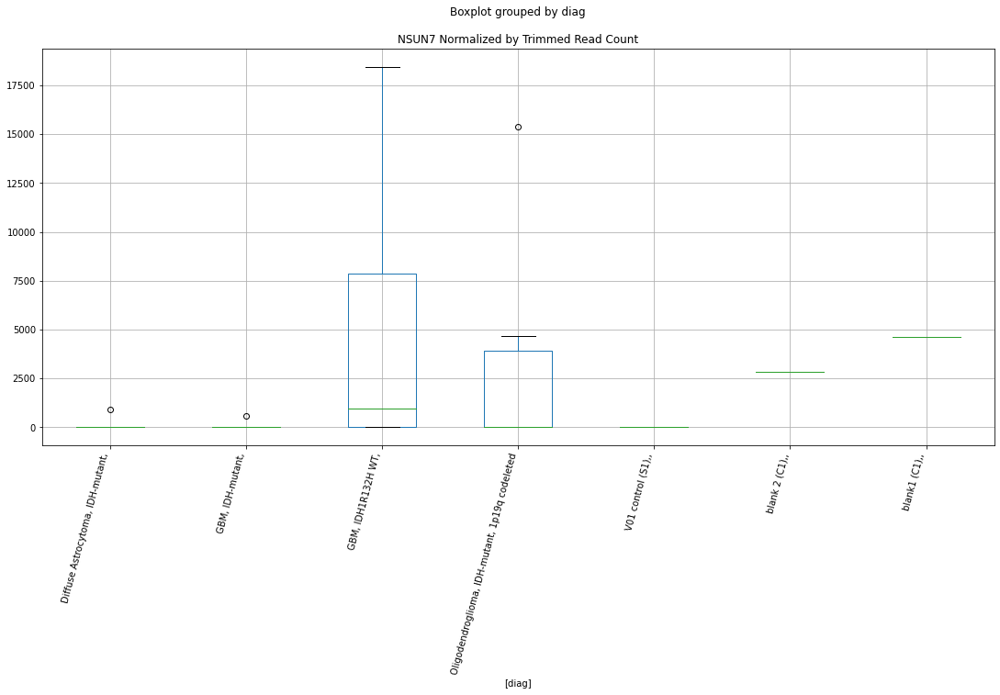

 p : 0.04915623547790879  ( t : 2.1096013830281084 ) :  D-plex  :  bbduk2  :  LOC375196
Control and blanks
73     0.0
337    0.0
Name: LOC375196, dtype: float64
205    1074.55
Name: LOC375196, dtype: float64
469    2366.11
Name: LOC375196, dtype: float64


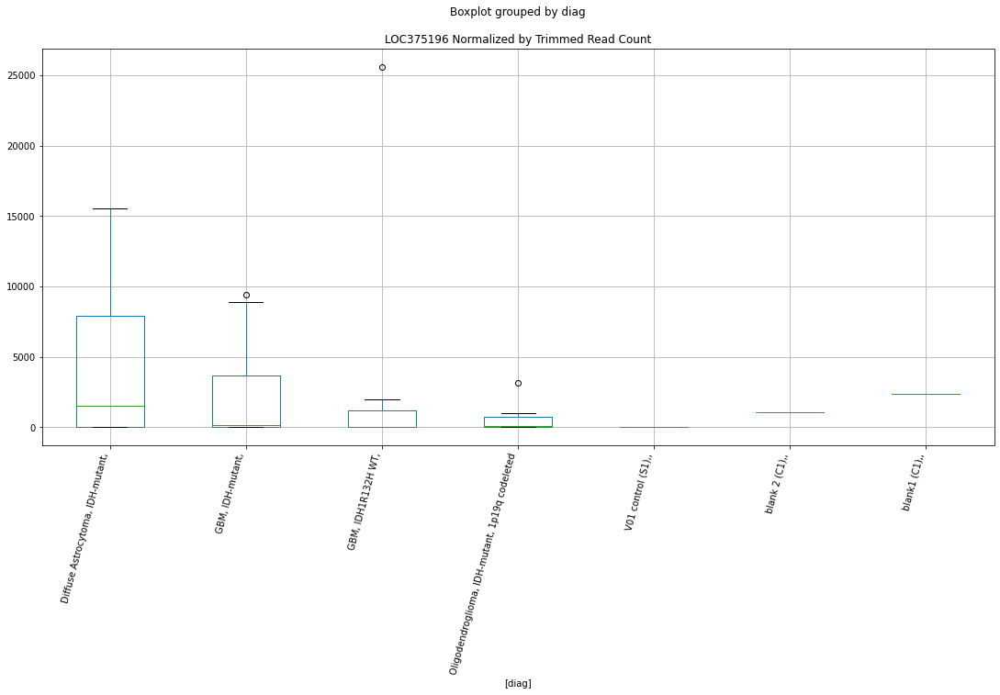

 p : 0.04915902499933085  ( t : 2.1095724662099102 ) :  D-plex  :  bbduk2  :  MEF2B
Control and blanks
73     0.0
337    0.0
Name: MEF2B, dtype: float64
205    0.0
Name: MEF2B, dtype: float64
469    0.0
Name: MEF2B, dtype: float64


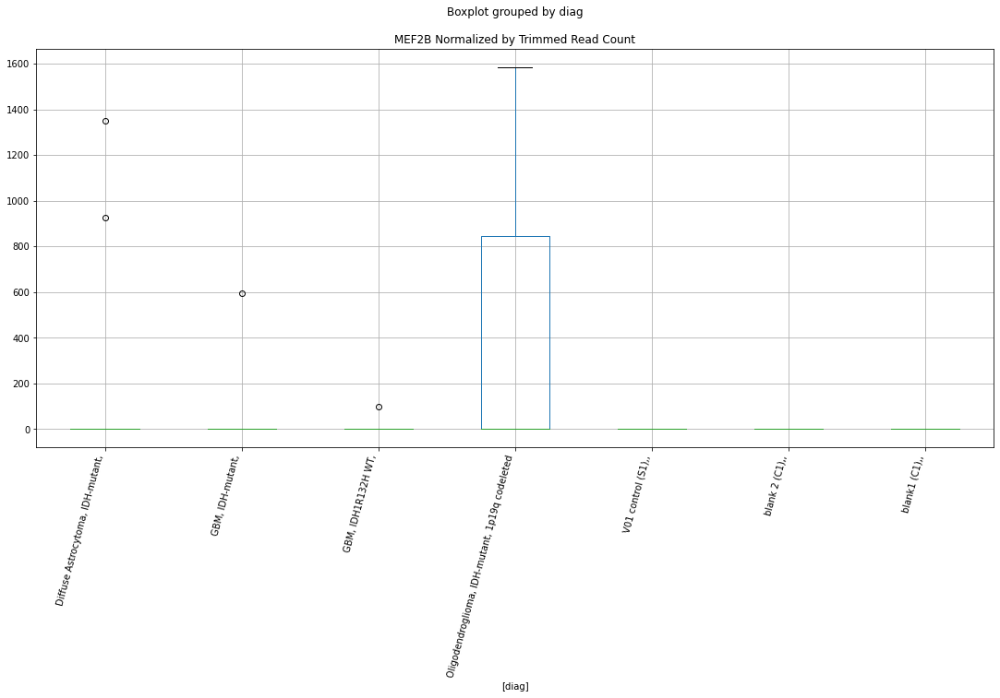

 p : 0.04936563429008799  ( t : 2.1074348456417726 ) :  D-plex  :  cutadapt2  :  MRPS5
Control and blanks
76     9091.37
340       0.00
Name: MRPS5, dtype: float64
208    0.0
Name: MRPS5, dtype: float64
472    6935.47
Name: MRPS5, dtype: float64


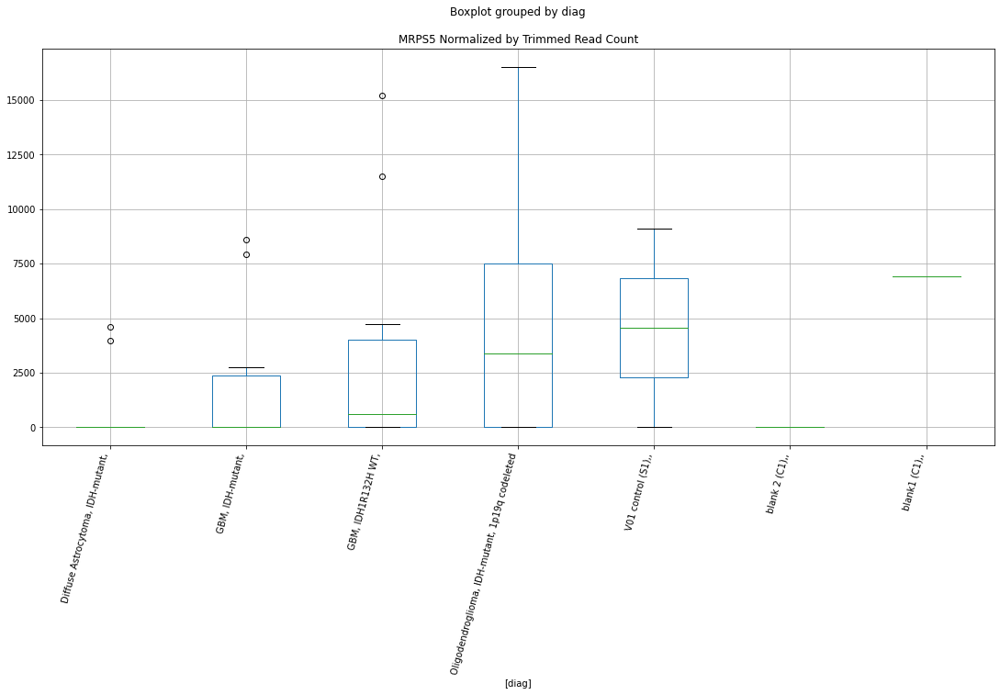

 p : 0.04949352832063236  ( t : 2.1061157029177098 ) :  D-plex  :  cutadapt2  :  OGFOD3
Control and blanks
76     0.0
340    0.0
Name: OGFOD3, dtype: float64
208    6172.61
Name: OGFOD3, dtype: float64
472    15604.81
Name: OGFOD3, dtype: float64


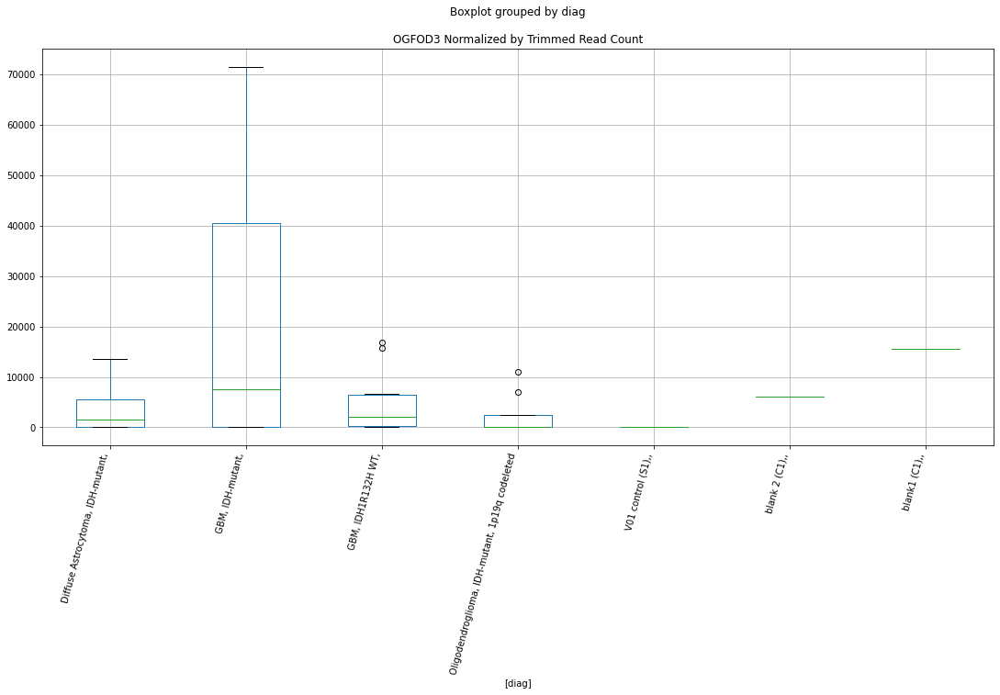

 p : 0.04949445610129305  ( t : 2.1061061448026432 ) :  D-plex  :  bbduk2  :  LOC107986777
Control and blanks
73     16233.18
337    12462.20
Name: LOC107986777, dtype: float64
205    102440.02
Name: LOC107986777, dtype: float64
469    99376.59
Name: LOC107986777, dtype: float64


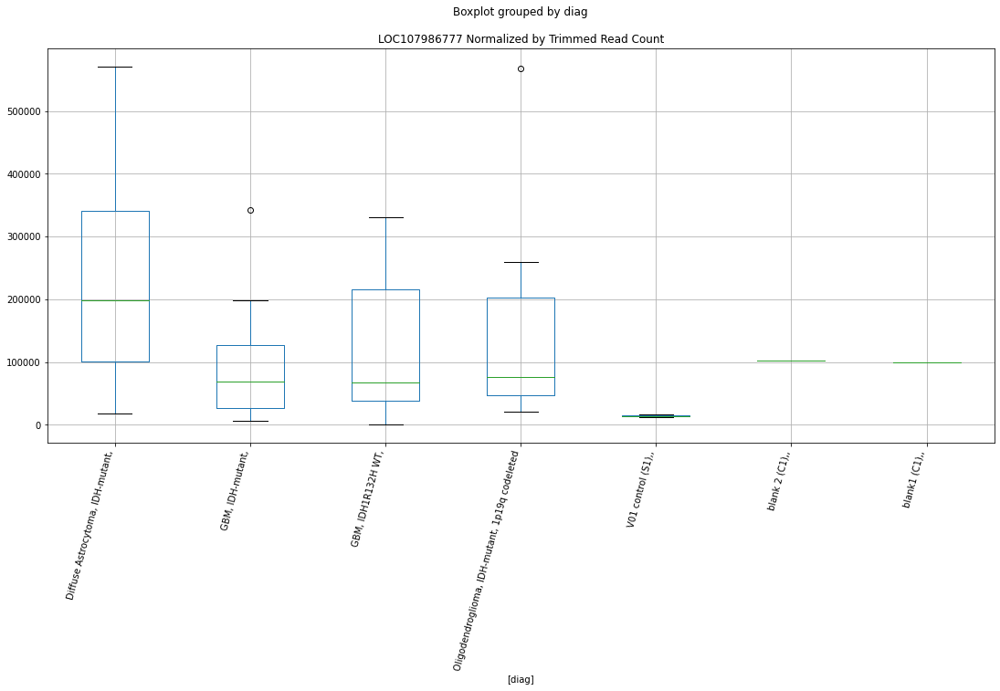

 p : 0.049497856242475984  ( t : 2.1060711175059126 ) :  D-plex  :  bbduk2  :  LOC107987011
Control and blanks
73     0.0
337    0.0
Name: LOC107987011, dtype: float64
205    358.18
Name: LOC107987011, dtype: float64
469    591.53
Name: LOC107987011, dtype: float64


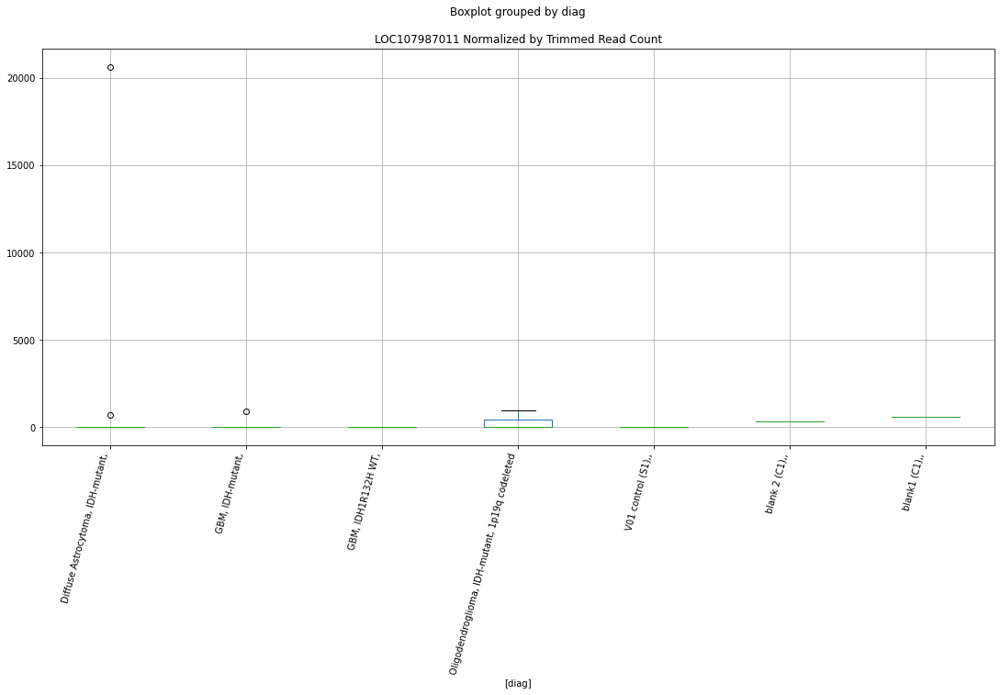

 p : 0.049504973610531265  ( t : 2.105997803468747 ) :  Lexogen  :  cutadapt2  :  NFKB1
Control and blanks
82     0.0
346    0.0
Name: NFKB1, dtype: float64
214    0.0
Name: NFKB1, dtype: float64
478    0.0
Name: NFKB1, dtype: float64


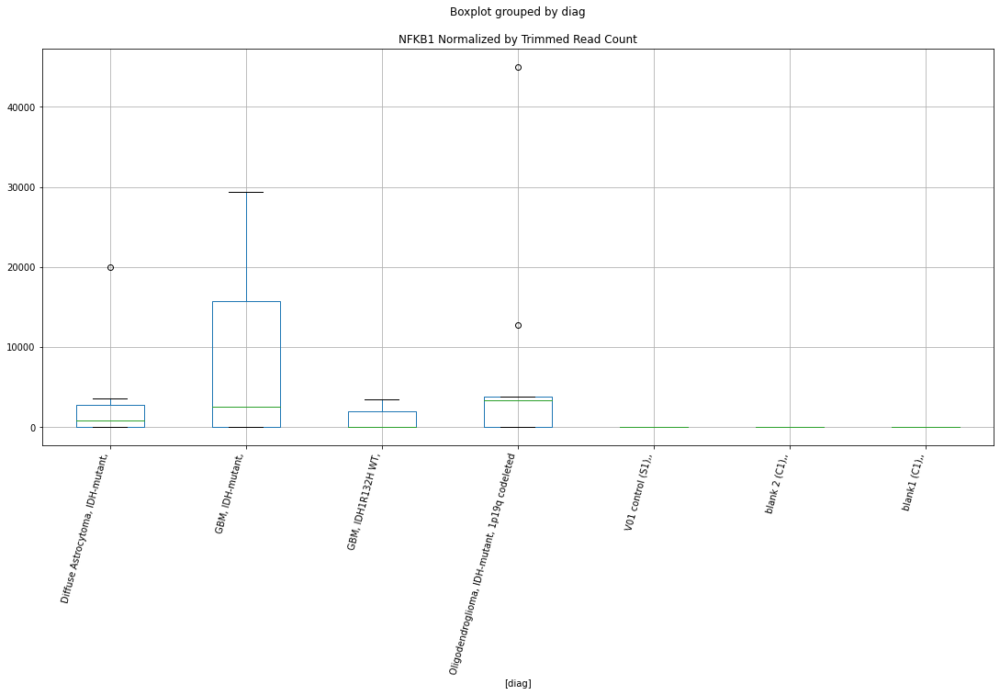

 p : 0.04954911003512505  ( t : 2.105543380297178 ) :  D-plex  :  bbduk2  :  LOC112268099
Control and blanks
73     1546.02
337       0.00
Name: LOC112268099, dtype: float64
205    895.45
Name: LOC112268099, dtype: float64
469    0.0
Name: LOC112268099, dtype: float64


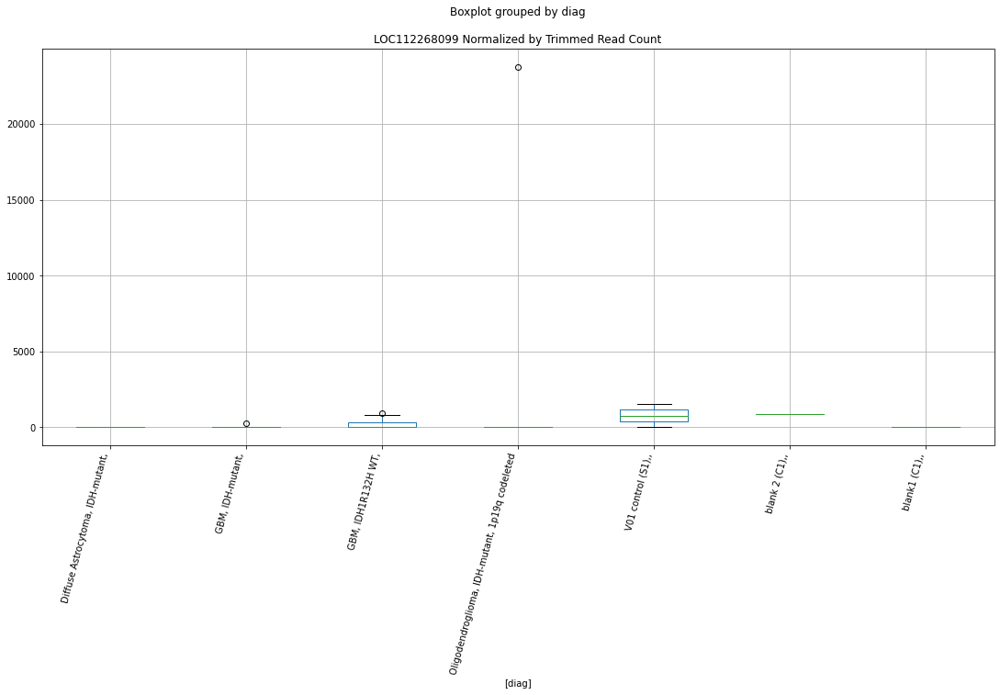

 p : 0.049571656520515296  ( t : 2.1053113865028643 ) :  Lexogen  :  bbduk2  :  LOC107987276
Control and blanks
79     0.0
343    0.0
Name: LOC107987276, dtype: float64
211    0.0
Name: LOC107987276, dtype: float64
475    239.52
Name: LOC107987276, dtype: float64


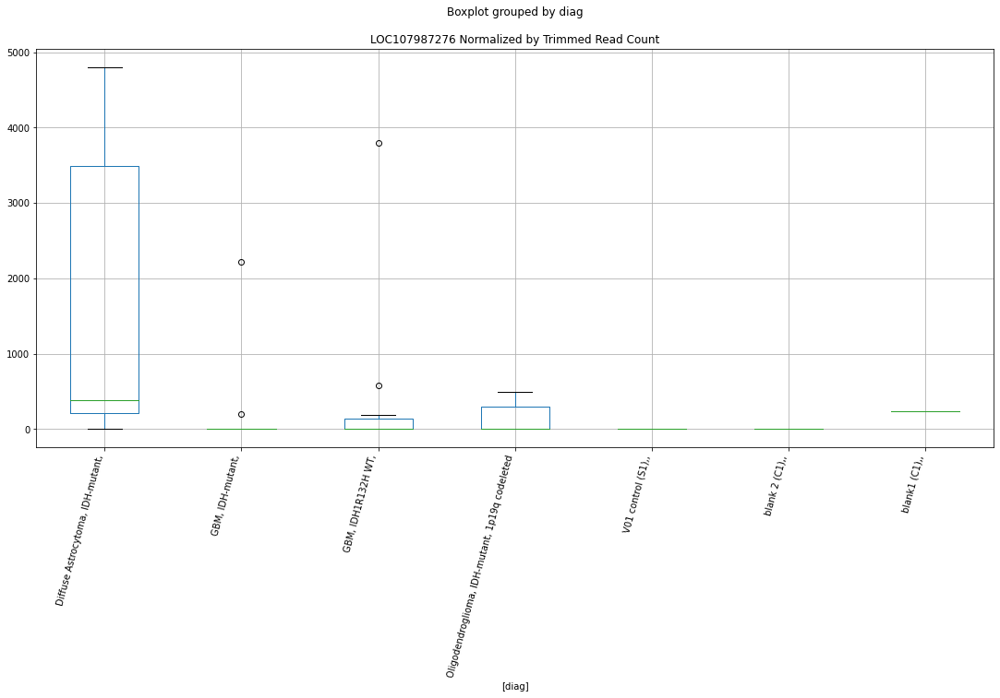

 p : 0.04986777823087491  ( t : 2.1022732914524616 ) :  D-plex  :  bbduk2  :  LOC107986699
Control and blanks
73     0.0
337    0.0
Name: LOC107986699, dtype: float64
205    358.18
Name: LOC107986699, dtype: float64
469    591.53
Name: LOC107986699, dtype: float64


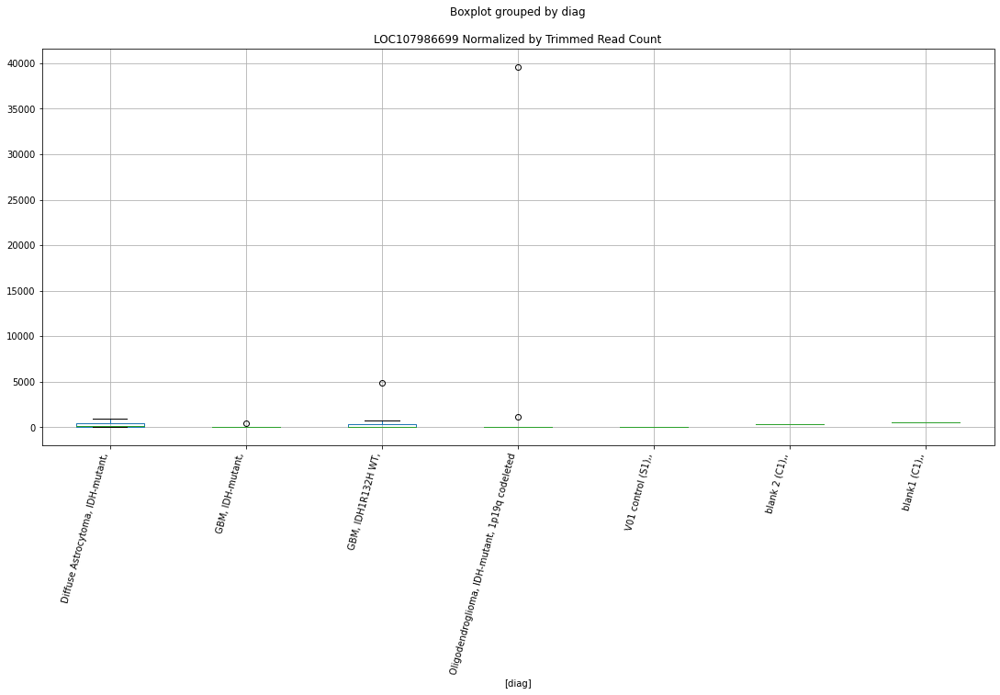

 p : 0.0499717232906306  ( t : 2.1012107431256672 ) :  Lexogen  :  cutadapt2  :  MSL2
Control and blanks
82     0.0
346    0.0
Name: MSL2, dtype: float64
214    0.0
Name: MSL2, dtype: float64
478    0.0
Name: MSL2, dtype: float64


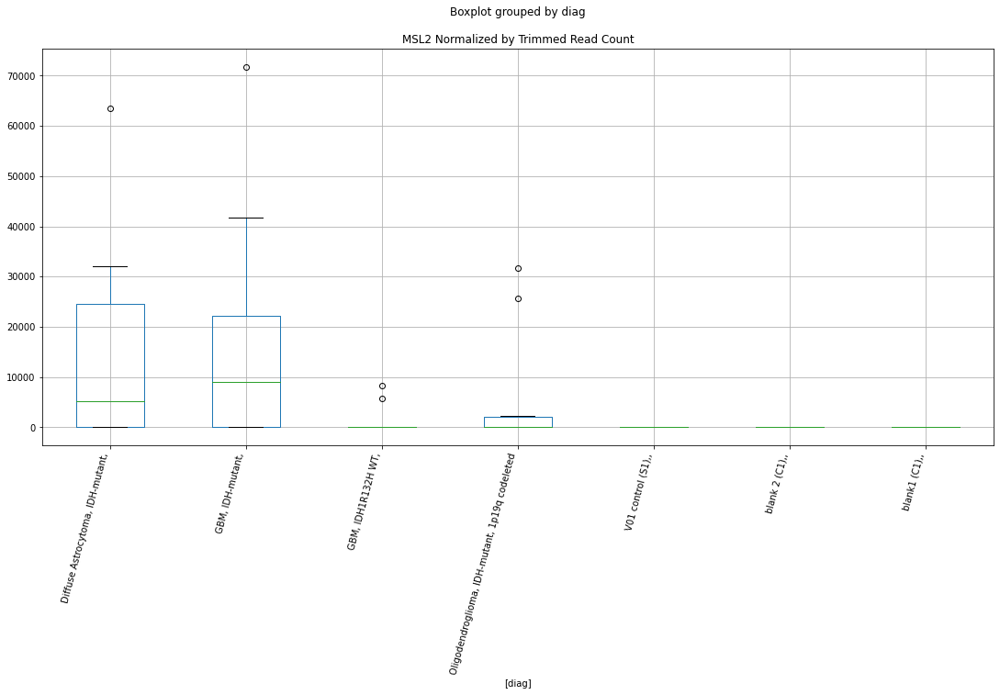

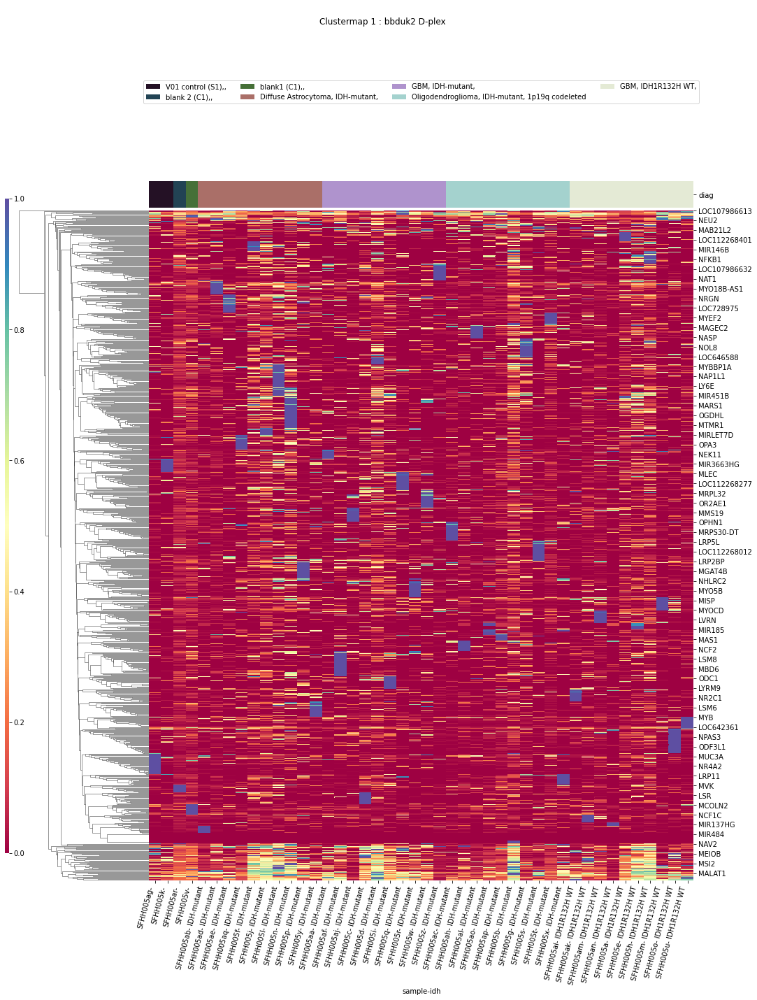

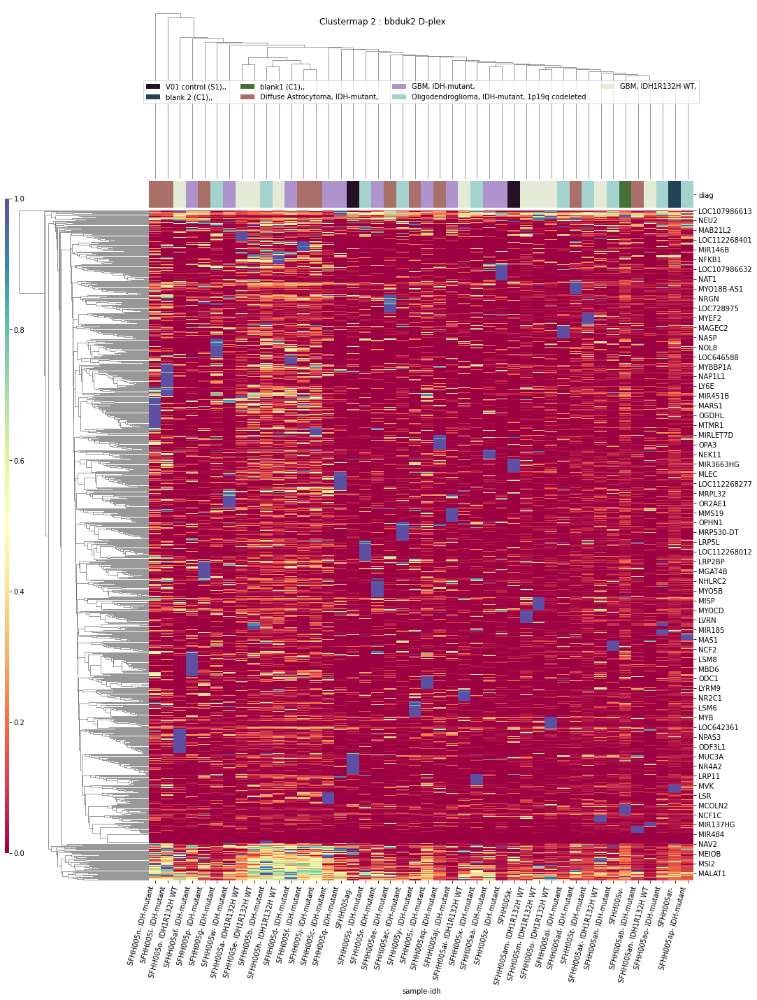

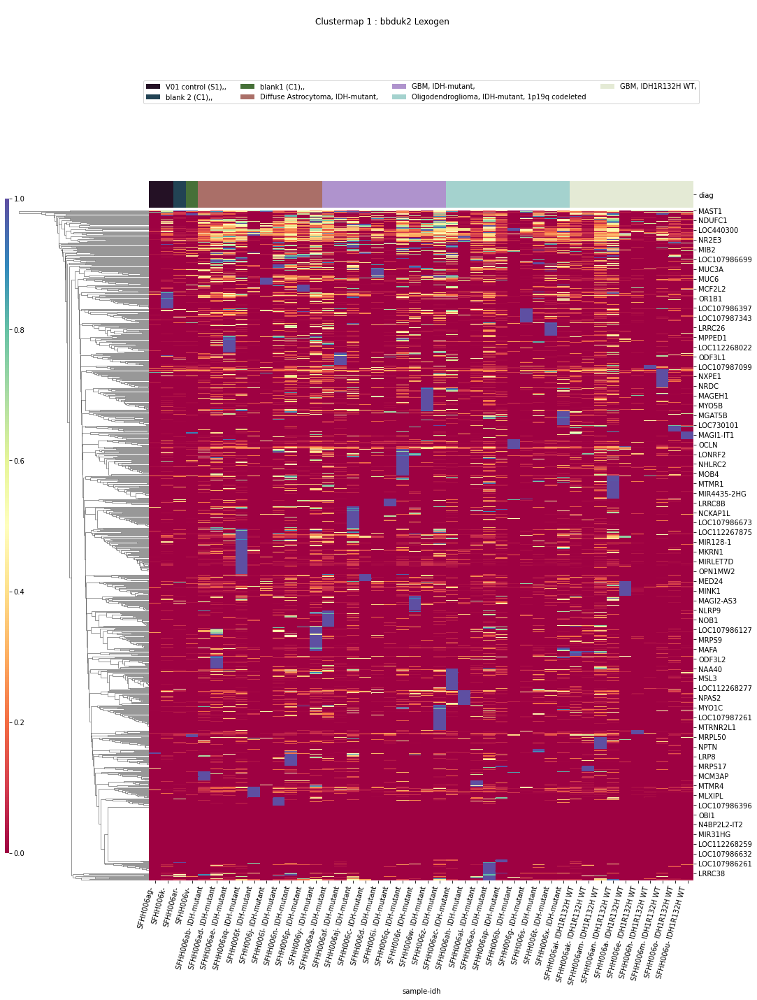

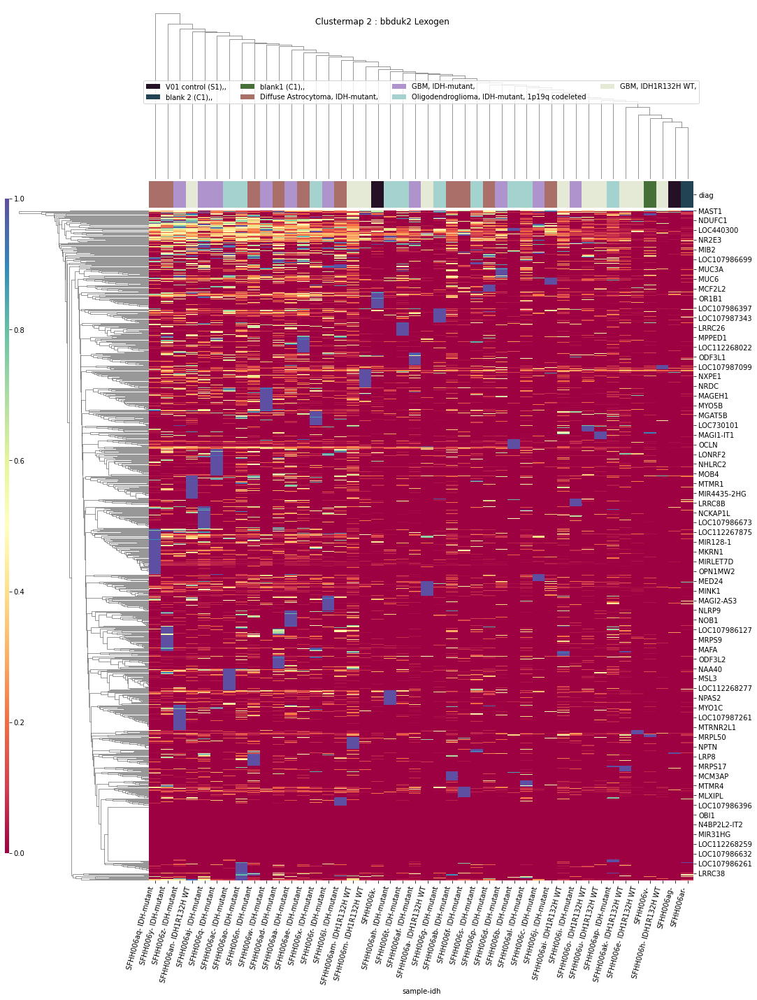

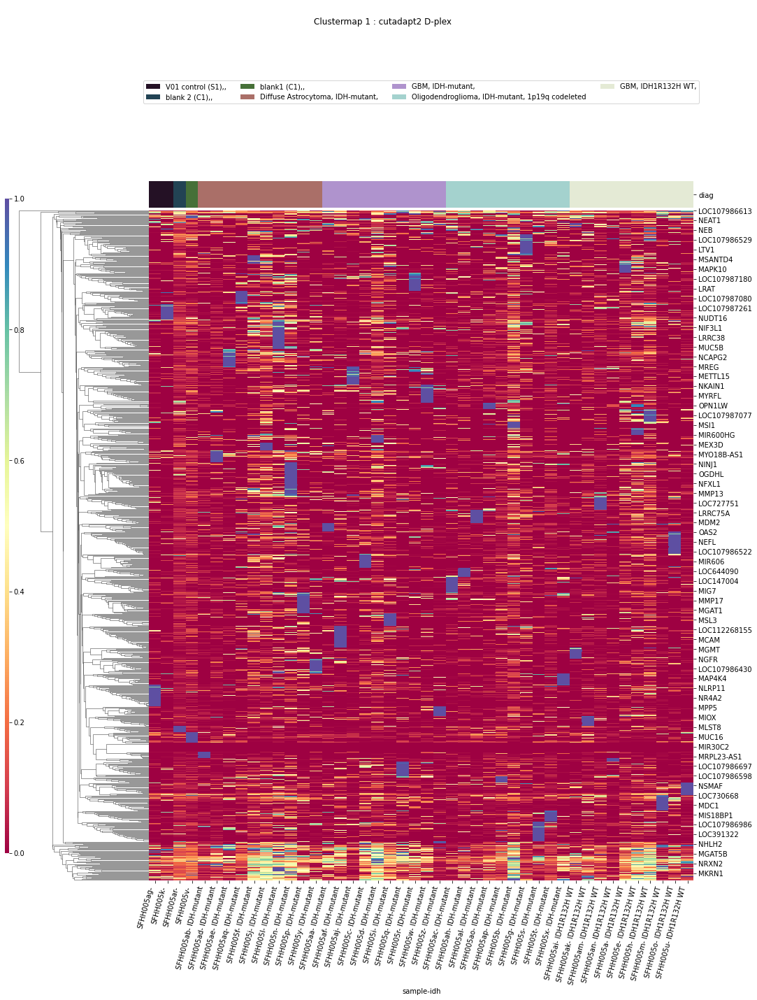

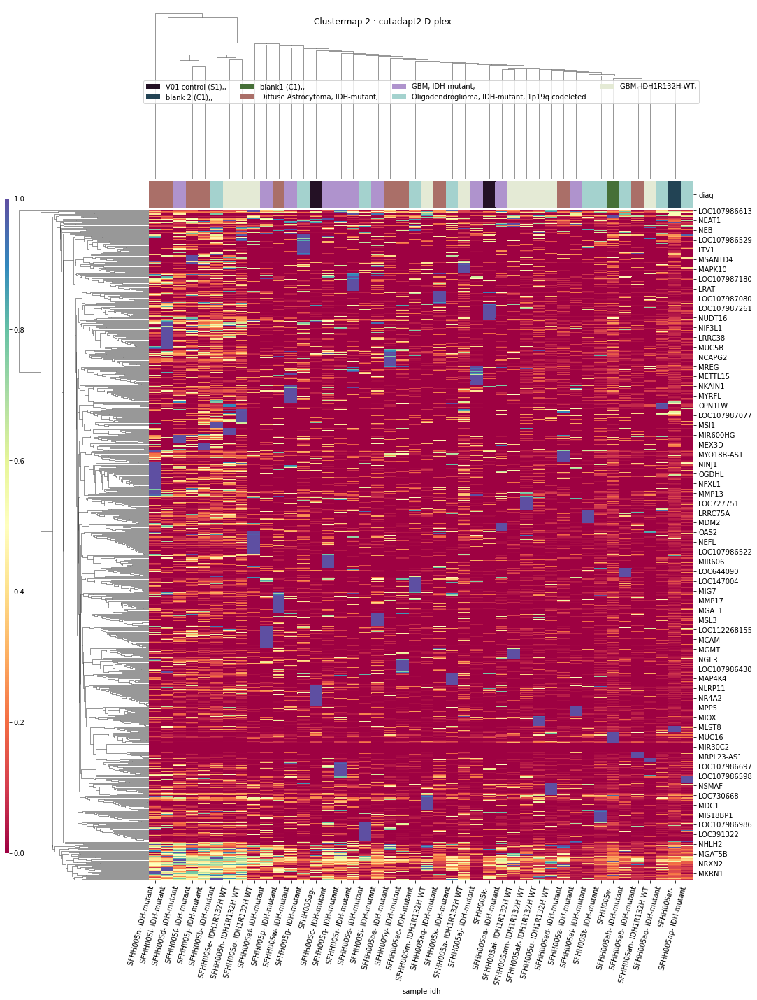

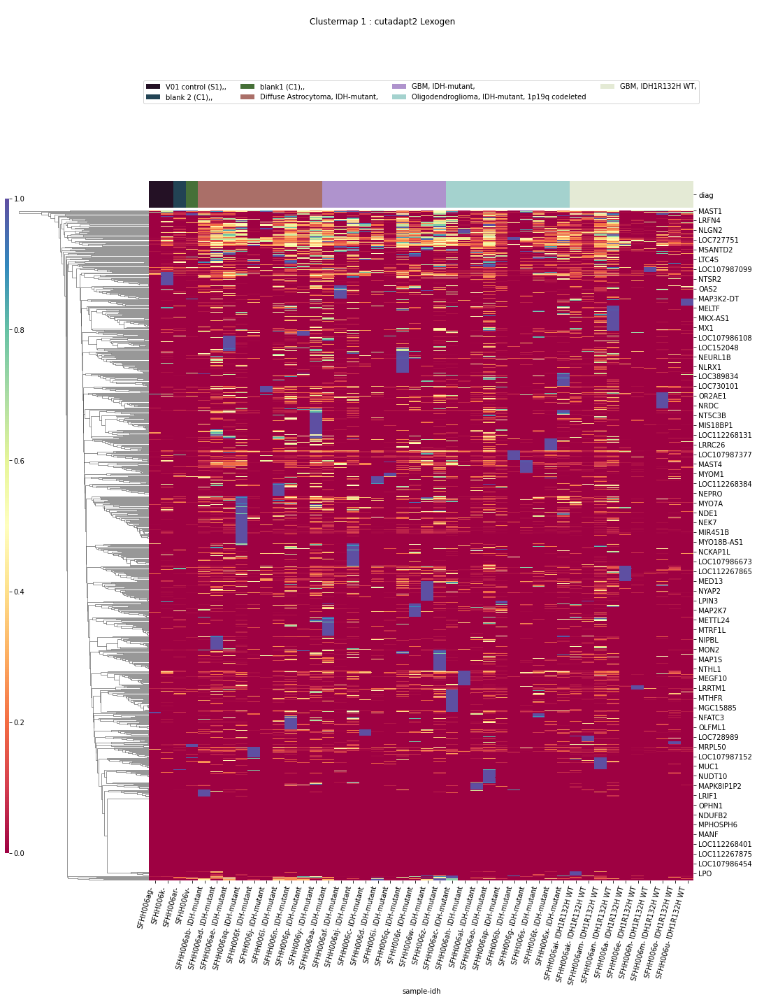

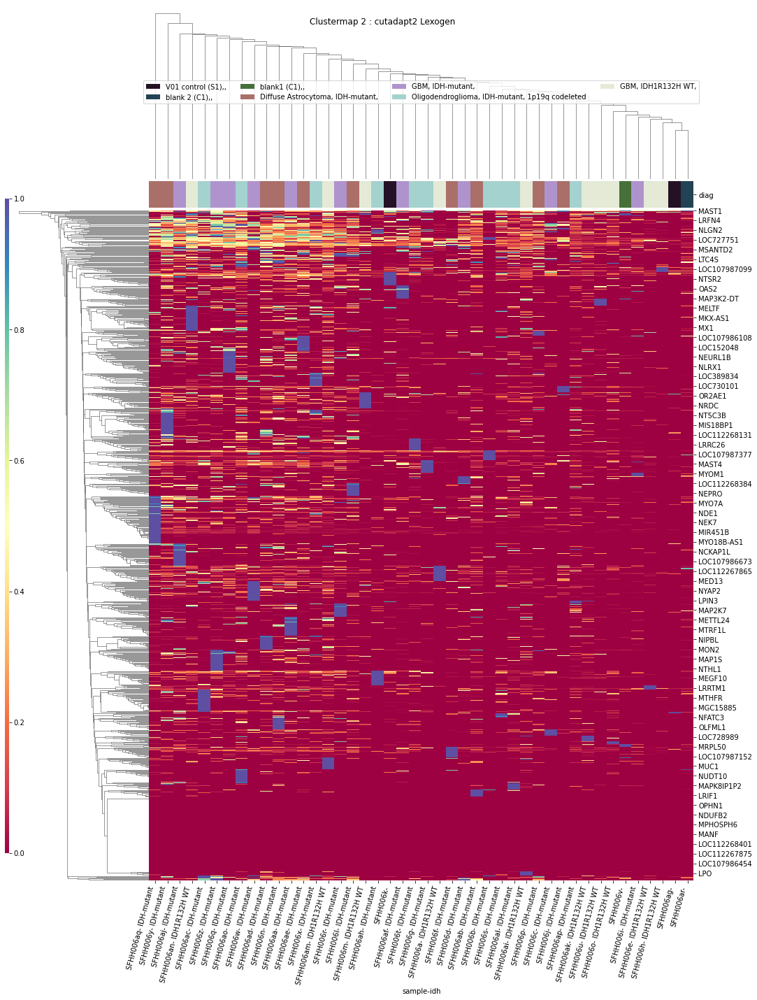

In [67]:
ttests_boxplots_and_heatmaps(dfn,elements,heat_p=0.1)

In [68]:
datetime.now().strftime("%H:%M:%S")

'11:42:13'

In [69]:
plt.rcParams["figure.figsize"] = [18.0,8.0]

In [70]:
pd.set_option('display.max_columns', default_max_columns)

In [71]:
pd.set_option('display.max_rows',default_max_rows)

In [72]:
pd.set_option('display.precision', default_precision)